# Watershed challenge
#### Solved by Fernanda de Oliveira Capela

Instructions:

As discussed, we will try to **predict extreme watershed events in Chile**. For this we count with a public and real dataset from meteorological stations. **Each row represents the measure of daily flux in a specific station**. This measure will be associated with **watershed's features (fixed) and daily temperature and precipitation measures** of nearby stations.

The file flux.csv contains all the data used for this challenge. This database was produced by us and synthesizes flux, temperature and precipitation data.

Note about the database: the stations which measure flux and the stations that measure temperature and precipitation are not located at the same place. For building this database, we took the watershed's upstream polygon and find the temperature and precipitation stations inside this polygon, and we calculated the average over that variables. In this way, every flux measure will be accompanied of a unique temperature and precipitation measure.

The database contains the following variables between others:

station_code: station code
station_name: name of the watershed
date: date of measurement
flux: water flux for that day
avg_precip: average precipitation for that day in that watershed
avg_max_temp: maximum average temperature for that day in that watershed

___

In [1]:
# !pip install folium

# Import packages

import folium
import datetime
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from folium.plugins import HeatMap
from sklearn.preprocessing import OneHotEncoder
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

import warnings
warnings.filterwarnings("ignore")

___

**1. Download the file flux.csv from github (compressed as flux.csv.zip).**

In [2]:
# Open .csv file in pandas dataframe to facilitate eda

df = pd.read_csv('/Users/fernanda/Downloads/flux.csv')
df.head()

,date,basin_id,flux,precip,temp_max,gauge_name,lat,lon,mean_elev,area_km2
0,1980-01-01,1001001,0.579,0.0,10.685653,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859
1,1980-01-02,1001001,0.543,0.0,11.470960,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859
2,1980-01-03,1001001,0.482,0.0,11.947457,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859
3,1980-01-04,1001001,0.459,0.0,12.424489,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859
4,1980-01-05,1001001,0.436,0.0,12.649203,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859


___

**2. Perform an EDA over flux.csv file.**

In [3]:
# Print some basic info about the dataset and check columns
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4180480 entries, 0 to 4180479
Data columns (total 10 columns):
 #   Column      Dtype  
---  ------      -----  
 0   date        object 
 1   basin_id    int64  
 2   flux        float64
 3   precip      float64
 4   temp_max    float64
 5   gauge_name  object 
 6   lat         float64
 7   lon         float64
 8   mean_elev   float64
 9   area_km2    float64
dtypes: float64(7), int64(1), object(2)
memory usage: 318.9+ MB


In [4]:
# Get description of numerical variables
df.describe()

,basin_id,flux,precip,temp_max,lat,lon,mean_elev,area_km2
count,4.180480e+06,4.180480e+06,4.175037e+06,4.175037e+06,4.180480e+06,4.180480e+06,4.180480e+06,4.180480e+06
mean,7.179757e+06,5.253340e+01,2.947445e+00,1.365728e+01,-3.569572e+01,-7.129595e+01,1.760129e+03,2.404876e+03
std,3.180965e+06,1.676027e+02,8.766749e+00,6.615037e+00,8.047659e+00,1.254339e+00,1.382121e+03,4.322051e+03
min,1.001001e+06,0.000000e+00,0.000000e+00,-1.160359e+01,-5.494690e+01,-7.366670e+01,1.181229e+02,1.789123e+01
25%,4.558001e+06,8.680000e-01,0.000000e+00,9.162867e+00,-3.915000e+01,-7.231670e+01,5.847012e+02,3.761001e+02
50%,7.350003e+06,5.171000e+00,0.000000e+00,1.321396e+01,-3.588420e+01,-7.137190e+01,1.195311e+03,8.205541e+02
75%,9.416001e+06,2.990000e+01,6.422626e-01,1.805745e+01,-3.126560e+01,-7.050670e+01,3.048161e+03,2.461610e+03
max,1.293000e+07,1.580500e+04,2.132120e+02,4.081117e+01,-1.784280e+01,-6.763920e+01,4.910152e+03,5.224367e+04


In [5]:
# Appears to be a very clean dataset. All ranges make sense in the context they appear
# and the only variables that show missing values are 'precip' and 'temp_max'. Since they
# are both numerical variables, and they follow a time oriented logic, I will fill
# the missing values with the average of the previous and the next non-missing values.
# In that way, we can keep the flow of events, not disrupt the timeseries, and not throw 
# away datapoints.

def fill_nan_with_mean_from_prev_and_next(df):
    try:
        s=df.isnull().cumsum()
        t1=df[(s==1).shift(-1).fillna(False)].stack().reset_index(level=0,drop=True)
        t2=df.lookup(s.idxmax()+1,s.idxmax().index)
        df.fillna(t1/(2**s)+t2*(1-0.5**s)*2/2, inplace=True)
    except KeyError: #if last row
        df.fillna(method='ffill', inplace=True)
    return df

fill_nan_with_mean_from_prev_and_next(df)
print("Missing values per variable after processing:")
df.isnull().sum()

Missing values per variable after processing:


date          0
basin_id      0
flux          0
precip        0
temp_max      0
gauge_name    0
lat           0
lon           0
mean_elev     0
area_km2      0
dtype: int64

In [6]:
# Check categorical columns
categoricals = [col for col in df.columns if df[col].dtype == 'O']
print("Number of Categorical Variables: {}".format(len(categoricals)))
print("Categorical Variables: ", categoricals)

Number of Categorical Variables: 2
Categorical Variables:  ['date', 'gauge_name']


In [7]:
# Check numerical columns
numericals = [col for col in df.columns if df[col].dtype != 'O']
print("Number of Numerical Variables: {}".format(len(numericals)))
print("Numerical Variables: ", numericals)

Number of Numerical Variables: 8
Numerical Variables:  ['basin_id', 'flux', 'precip', 'temp_max', 'lat', 'lon', 'mean_elev', 'area_km2']


In [8]:
# Count unique values for each categorical
for variable in categoricals:
    uniques = len(df[variable].unique())
    print("Number of unique values for '{}' is: {}".format(variable, uniques))

Number of unique values for 'date' is: 14768
Number of unique values for 'gauge_name' is: 503


In [9]:
# Confirma station names and ids are equivalent
print("There are %3d station IDs and %3d station names." % ( len(df['basin_id'].unique()), len(df['gauge_name'].unique()) ))
df.gauge_name.value_counts()

There are 503 station IDs and 503 station names.


Rio Aconcagua En Chacabuquito                   14670
Rio Cruces En Rucaco                            14649
Rio Choapa En Cuncumen                          14639
Rio Elqui En Algarrobal                         14634
Rio Cautin En Cajon                             14603
                                                ...  
Estero Chimbarongo En Santa Cruz                  328
Rio Chillan En Longitudinal                       302
Rio Pama Entrada Embalse Cogoti                   195
Estero Las Vegas Aguas Abajo Canal Las Vegas      195
Rio Blanco En Chaiten                             175
Name: gauge_name, Length: 503, dtype: int64

In [ ]:
# Plot heatmap of max temp using lat,lon

# Drop na values
data=df.dropna(subset=['temp_max'])

# center map using average coordinates
map_obj = folium.Map(location = [data.lat.mean(), data.lon.mean()], zoom_start = 4)
# set point_estimate as weight
lats_longs_weight = list(map(list, zip(data["lat"],
                                       data["lon"],
                                       data["temp_max"])))
HeatMap(lats_longs_weight).add_to(map_obj)
# plot
map_obj

<AxesSubplot:xlabel='flux', ylabel='precip'>

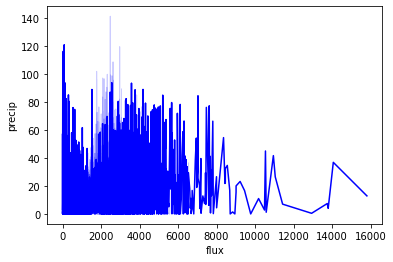

In [25]:
# Flux vs. Precipitation overview
sns.lineplot(data=df,x='flux',y='precip',color='blue')

<AxesSubplot:xlabel='flux', ylabel='temp_max'>

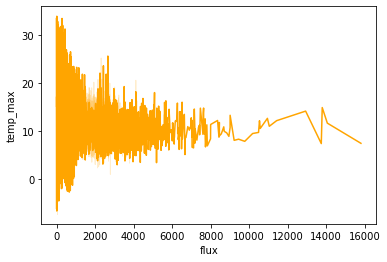

In [26]:
# Flux vs. Max Temperature overview
sns.lineplot(data=df,x='flux',y='temp_max',color='orange')

___

**3. Plot flux, temperature and precipitations:**

**a) Write a function that plot a time series of a specific variable (flux, temp, precip) from a station.**

In [15]:
# Changing date to datetime format

date_format = '%Y-%m-%d'
df.date = df.date.apply(lambda x: datetime.datetime.strptime(x, date_format))

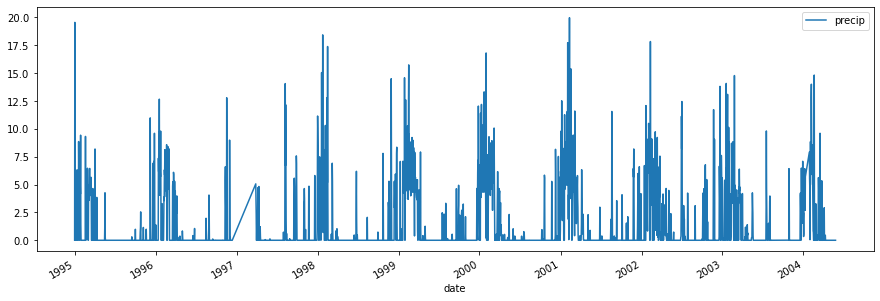

In [13]:
def plot_one_timeserie(cod_station, variable, min_date, max_date):
    
    min_date = datetime.datetime.strptime(min_date, date_format)
    max_date = datetime.datetime.strptime(max_date, date_format)
    
    data = df[df.basin_id == cod_station]
    data = data[(data.date >= min_date) & (data.date <= max_date)]
    
    data.plot(x='date', y=variable, figsize=(15, 5))
    return 

plot_one_timeserie(1001001, 'precip', '1995-01-01', '2005-01-01')

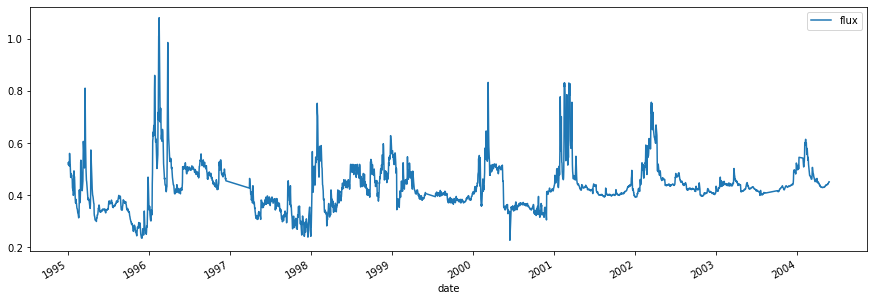

In [47]:
plot_one_timeserie(1001001, 'flux', '1995-01-01', '2005-01-01')

___

**b) Now write a function that plots the 3 variables at the same time. As the variables are in different scales, you can normalize before plotting them.**

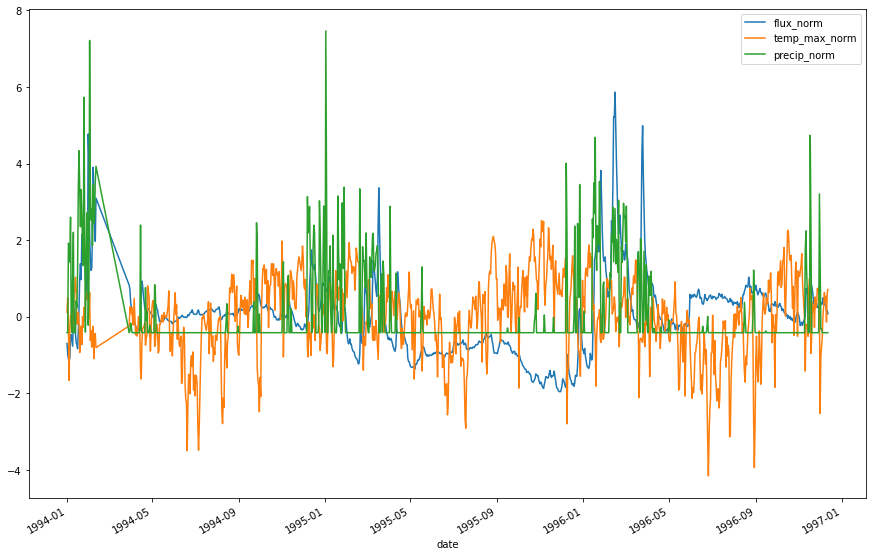

In [14]:
def plot_three_timeseries(cod_station, min_date, max_date):
    
    min_date = datetime.datetime.strptime(min_date, date_format)
    max_date = datetime.datetime.strptime(max_date, date_format)
    
    data = df[df.basin_id == cod_station]
    data = data[(data.date >= min_date) & (data.date <= max_date)]
    
    data['flux_norm'] = data.flux.apply(lambda x: (x-np.mean(data.flux))/np.std(data.flux))
    data['temp_max_norm'] = data.temp_max.apply(lambda x: (x-np.mean(data.temp_max))/np.std(data.temp_max))
    data['precip_norm'] = data.precip.apply(lambda x: (x-np.mean(data.precip))/np.std(data.precip))
    
    data.plot(x='date', y=['flux_norm', 'temp_max_norm', 'precip_norm'], figsize=(15, 10))
    
    return 

plot_three_timeseries(1001001, '1994-01-01', '1997-01-01')

___

**4. Create three variables called:**

*flux_extreme*

*temp_extreme*

*precip_extreme*

This variables should take the value of 1 when that variable in a specific day was extreme. Being extreme could be considered as being greater than expected. For example, a flux can be considered as extreme (value 1) when is over the 95 percentile of the flux distribution for that specific season, and takes the value 0 otherwise. Taking into account the seasonality of that variables is very important, because 25C could be considered as extreme in wintertime, but it’d be a normal temperature for summertime.

In [15]:
# Let's first add a season column based on the dates
def date_season(date):
    
    # get year of the date
    year = str(date.year)
    
    # set season ranges (same day/month, no matter what year)
    seasons = {'autumn': pd.date_range(start='21/03/'+year, end='20/06/'+year),
               'winter': pd.date_range(start='21/06/'+year, end='22/09/'+year),
               'spring': pd.date_range(start='23/09/'+year, end='20/12/'+year)}
             # 'summer': pd.date_range(start='21/12/'+year, end='20/03/'+year)
    
    # set season and return result
    if date in seasons['autumn']:
        return 'autumn'
    if date in seasons['winter']:
        return 'winter'
    if date in seasons['spring']:
        return 'spring'
    else:
        return 'summer'

# Apply season function to dataframe
df['season'] = df.date.map(date_season)
df.head()  

,date,basin_id,flux,precip,temp_max,gauge_name,lat,lon,mean_elev,area_km2,season
0,1980-01-01,1001001,0.579,0.0,10.685653,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859,summer
1,1980-01-02,1001001,0.543,0.0,11.470960,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859,summer
2,1980-01-03,1001001,0.482,0.0,11.947457,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859,summer
3,1980-01-04,1001001,0.459,0.0,12.424489,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859,summer
4,1980-01-05,1001001,0.436,0.0,12.649203,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859,summer


In [11]:
# If the function above is too slow to apply in such a big dataset, we can simplify and 
# use datetime.quarter and obtain immediate results for season. Since the line graph for 
# the timeseries shows a clear change between summer and winter but not so drastic for
# spring and autumn, we can define only "two seasons": winter (quarters 2 and 3) and 
# summer (quarters 1 and 4). 

df['season'] = df.date.dt.quarter
df['season'] = df.season.apply(lambda x: "summer" if x in [1, 4] else "winter")
df.head()

,date,basin_id,flux,precip,temp_max,gauge_name,lat,lon,mean_elev,area_km2,season
0,1980-01-01,1001001,0.579,0.0,10.685653,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859,summer
1,1980-01-02,1001001,0.543,0.0,11.470960,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859,summer
2,1980-01-03,1001001,0.482,0.0,11.947457,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859,summer
3,1980-01-04,1001001,0.459,0.0,12.424489,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859,summer
4,1980-01-05,1001001,0.436,0.0,12.649203,Rio Caquena En Nacimiento,-18.0769,-69.1961,4842.449328,49.711859,summer


In [12]:
# define threshold for 95 percentile for each group of each 
# one of the stations during summer and during winter.
thresh = df.groupby(["basin_id", "season"]).quantile(0.95)
thresh

date      flux    precip   temp_max      lat  \
basin_id season                                                               
1001001  summer 2003-10-14 06:00:00   0.74125  8.710868  13.189481 -18.0769   
         winter 2003-05-04 14:24:00   0.51500  2.265206  11.201032 -18.0769   
1001002  summer 2018-02-26 09:36:00   3.96400  7.777943  13.925727 -17.9942   
         winter 2017-09-18 07:12:00   1.57000  1.917063  11.993896 -17.9942   
1001003  summer 2018-02-02 18:00:00   1.31000  8.759492  13.717656 -18.0156   
...                             ...       ...       ...        ...      ...   
12876004 winter 2016-07-24 19:12:00   8.00800  5.986184  11.344384 -54.0411   
12878001 summer 2018-10-16 01:12:00  19.71000  5.515674  16.835789 -54.0181   
         winter 2018-05-16 04:48:00  20.60000  6.141443  10.508774 -54.0181   
12930001 summer 2019-11-12 14:24:00   1.65180  6.588843  16.124534 -54.9469   
         winter 2019-07-12 18:00:00   1.00000  4.726610  10.229783 -54.9469   

                     lon    mean_elev    area_km2  
basin_id season                                    
1001001  summer -69.1961  4842.449328   49.711859  
         winter -69.1961  4842.449328   49.711859  
1001002  summer -69.2550  4652.603986  467.556222  
         winter -69.2550  4652.603986  467.556222  
1001003  summer -69.2308  4774.097286  198.808235  
...                  ...          ...         ...  
12876004 winter -68.7975   270.395449   82.694910  
12878001 summer -68.6528   307.684261  468.926214  
         winter -68.6528   307.684261  468.926214  
12930001 summer -67.6392   520.849289   20.645617  
         winter -67.6392   520.849289   20.645617  

[1006 rows x 8 columns]

In [13]:
# Add threshold to original table
result = pd.merge(df, thresh, on=['basin_id', 'season'], how='left')

# Assign 1 to extreme values, else 0
flux_extreme = result.apply(lambda x: 1 if x['flux_x'] > x['flux_y'] else 0, axis=1)
temp_extreme = result.apply(lambda x: 1 if x['temp_max_x'] > x['temp_max_y'] else 0, axis=1)
precip_extreme = result.apply(lambda x: 1 if x['precip_x'] > x['precip_y'] else 0, axis=1)

# Add to dataframe
df["flux_extreme"] = flux_extreme
df["temp_extreme"] = temp_extreme
df["precip_extreme"] = precip_extreme

In [18]:
print("There are %3d extreme flux occurences, %3d extreme temperature days, and %3d extreme precipitation events in the dataset." % (flux_extreme.value_counts()[1], temp_extreme.value_counts()[1], precip_extreme.value_counts()[1]))

There are 207757 extreme flux occurences, 209899 extreme temperature days, and 208999 extreme precipitation events in the dataset.


**Do you consider this a good way of capturing extreme events? Or you would have used a different method? Which one?**

It all depends on the purpose of the event identification. This is a straight forward method, in which results can be easily interpreted and visually verified in the timeseries. There's a value in these types of methodologies. However, it is important to keep in mind the limitations. The threshdolds of 95 percentile depend on many variables that can slide the data in many ways and completely change the results. As said above, seasonality is an important aspect that can massively affect temperature and precipitation levels. So splitting the data into summer/winter vs. summer/autumn/winter/spring vs. monthly vs. etc. could result in different annotations. Another aspect is location, since the north of Chile has completely different characteristics from the south, elevation has influence, as well as proximity to mountains or desert, etc. Finally, there are the trends over time, since what was considered an extreme event in 1990 might not be labeled the same way nowadays if it is a very common event. 

A method like this one can be good for a overview of the events over the years. However, if it will be used as input for an alarm system, where people should evacuate in case of extreme events, a dynamic methos that considers a more recent definition of extreme might be better.

Studies in the field suggest the use of a set of statistical tests to verify patterns and its changes: [1] Mann-Kendall test for gradual changes, or distribution free cusum and ranksum for abrupt changes. [2] The generalized extreme value (GEV) is a generalization of three distributions: Gumbel, Fréchet and Weibull, and can assist in determining the best threshold for extreme event detection.

[1] doi: 10.1590/2318-0331.0318170134

[2] doi: 10.1016/j.proeng.2015.11.067


___

**5. Plot the variable flux_extreme. Are there any different behaviours among different watersheds?**

Yes, most of them keep extreme events under 50/year or 100/year, but a few hve peaks that can get over double that number.

<AxesSubplot:xlabel='year', ylabel='flux_extreme'>

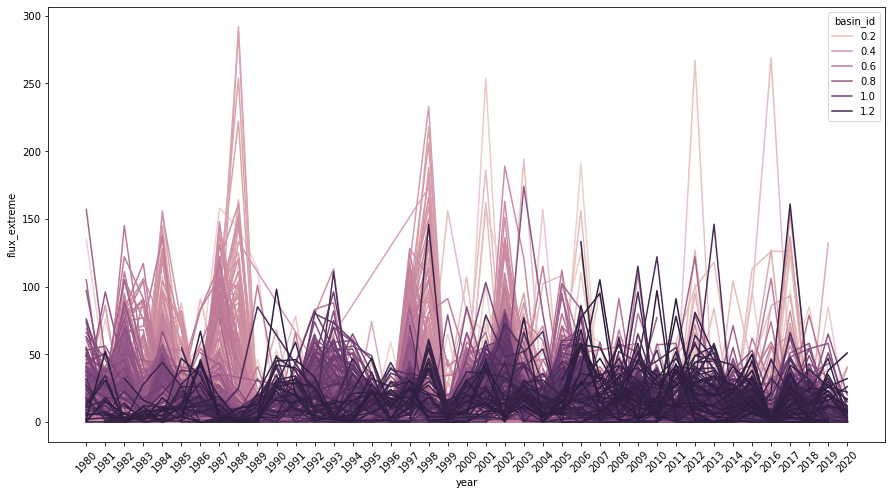

In [19]:
# Add year to group events
df['year'] = df.date.apply(lambda x: str(x.year))

# Group events by year and station
data = df.groupby(["year", "basin_id"])['flux_extreme'].sum().reset_index()

# Plot graph
plt.figure(figsize=(15,8))
plt.xticks(rotation=45)
sns.lineplot(data=data, x='year', y='flux_extreme', hue='basin_id')

___

**6. Plot the percentage of extreme events during time. Have they become more frequent?**

No, there were a couple of peaks around the year 1997 and 2002, but in general it is possible to see a very timid trend going down over the last 4 decades.

<AxesSubplot:xlabel='year'>

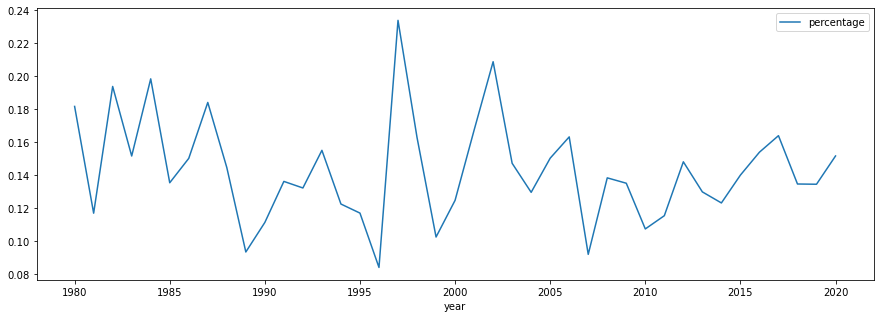

In [20]:
# by year (one event per day)
df['extreme_event'] = df.apply(lambda x: 1 if (x['flux_extreme']+x['temp_extreme']+x['precip_extreme']>0) else 0, axis=1)
data = df.groupby(['year'])['extreme_event'].agg(['sum','count']).reset_index()
data['percentage'] = data['sum']/data['count']
data.plot(x='year', y='percentage', figsize=(15, 5))

<AxesSubplot:xlabel='year'>

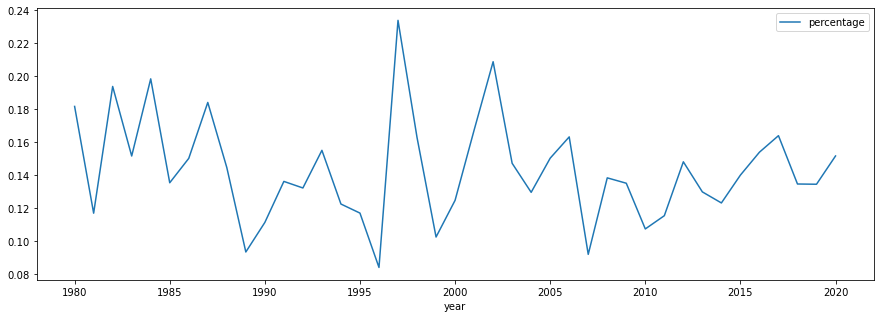

In [21]:
# by year (sum of events) -> didn't make much difference on trend
df['extreme_events'] = df['flux_extreme']+df['temp_extreme']+df['precip_extreme']
data = df.groupby(['year'])['extreme_event'].agg(['sum','count']).reset_index()
data['percentage'] = data['sum']/data['count']
data.plot(x='year', y='percentage', figsize=(15, 5))

<AxesSubplot:xlabel='yearseason'>

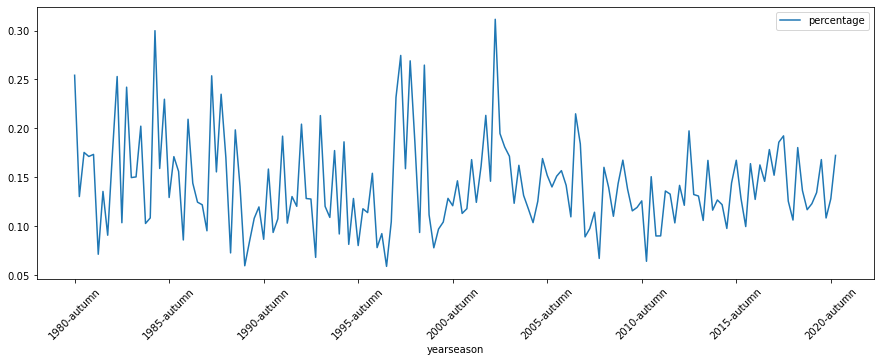

In [22]:
# by year-season
df['yearseason'] = df.apply(lambda x: str(x['date'].year)+"-"+str(x['season']), axis=1)
data = df.groupby(['yearseason'])['extreme_event'].agg(['sum','count']).reset_index()
data['percentage'] = data['sum']/data['count']
data.plot(x='yearseason', y='percentage', figsize=(15, 5), rot=45)

___

**7. Extreme flux prediction. Train one or many models (using your preferred algorithms) for estimating the probability of having an extreme flux. Feel free to create new features or use external variables. Some of the discussion we would like to see: Which data can be used and which cannot? Of course, we cannot use future data, but what about data from the same day? Or from the previous day?**

Everything depends on how you propose the model use. Make a proposal on how you would use the model in practice (for example, once trained, the model will predict next day probability). Depending on your proposal, set constraints about which variables you can or cannot use.

<AxesSubplot:>

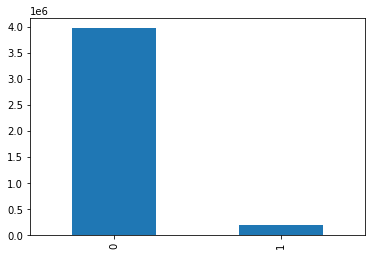

In [23]:
# Now I'm going to do some EDA with the prediction task in mind
# Target variable: flux_extreme (yes 1 or no 0) 

df['flux_extreme'].value_counts().plot(kind='bar') 

# Target data is imbalanced and this can affect model's performance. However, given 
# the chronology of the datapoints, balancing the dataset would mean losing important information
# about non-extreme days whithin the timeline. So I decided to keep it as it is.

In [31]:
# "Potential" feature variables: date, basin_id, flux, precip, temp_max, 
#                    gauge_name, lat, lon, mean_elev, area_km2, season.

# Gauge_name, lat, lon are redundant information about location, 
# so I'll only keep the station id (cause it's already a number). 
df_final = df.drop(['gauge_name','lat','lon'], axis = 1)

# Season and date are also redundant, but only if the model can 
# find these patterns from date by itself.
df_final['year'] = df_final['date'].dt.year
df_final['month'] = df_final['date'].dt.month
df_final['day'] = df_final['date'].dt.day
df_final = df_final.drop(['season', 'date'], axis = 1)
df_final

,basin_id,flux,precip,temp_max,mean_elev,area_km2,flux_extreme,temp_extreme,precip_extreme,year,month,day
0,1001001,0.579,0.000000,10.685653,4842.449328,49.711859,0,0,0,1980,1,1
1,1001001,0.543,0.000000,11.470960,4842.449328,49.711859,0,0,0,1980,1,2
2,1001001,0.482,0.000000,11.947457,4842.449328,49.711859,0,0,0,1980,1,3
3,1001001,0.459,0.000000,12.424489,4842.449328,49.711859,0,0,0,1980,1,4
4,1001001,0.436,0.000000,12.649203,4842.449328,49.711859,0,0,0,1980,1,5
...,...,...,...,...,...,...,...,...,...,...,...,...
4180475,12930001,0.375,0.983019,8.958469,520.849289,20.645617,0,0,0,2020,6,2
4180476,12930001,0.342,0.983019,8.958469,520.849289,20.645617,0,0,0,2020,6,3
4180477,12930001,0.325,0.983019,8.958469,520.849289,20.645617,0,0,0,2020,6,4
4180478,12930001,0.311,0.983019,8.958469,520.849289,20.645617,0,0,0,2020,6,5


<AxesSubplot:>

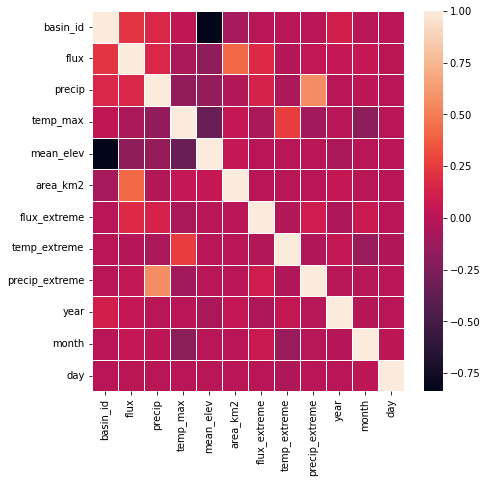

In [32]:
# Correlation matrix

plt.figure(figsize=(7,7))
sns.heatmap(df_final.corr(), linewidths=0.5)

<AxesSubplot:>

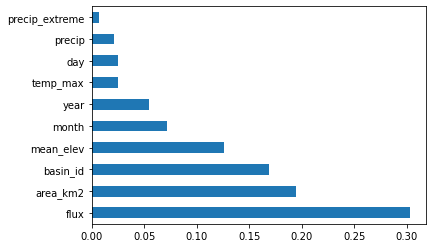

In [46]:
# Split target and features datasets
X = df_final.drop(['flux_extreme'],axis=1)
y = df_final['flux_extreme']

# Calculate feature importance
etr_model = ExtraTreesRegressor()
etr_model.fit(X,y)
etr_model.feature_importances_

# Visualize importances
feat_imp = pd.Series(etr_model.feature_importances_,index=X.columns)
feat_imp.nlargest(10).plot(kind='barh')

In [35]:
# Split train and test sets
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.2, random_state=1)
print("Size of Training set: {}".format(len(X_train)))
print("Size of Testing set: {}".format(len(X_test)))

Size of Training set: 3344384
Size of Testing set: 836096


In [36]:
# Normalize/scale numerical feature data 
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [37]:
# Build and train model

# LOGISTIC REGRESSION is a robust classification algorithm that returns the
# probability of a datapoint to be part of a certain category (flux_extreme or not).

# Solver: Stochastic Average Gradient Adjusted, good for large models
model_logreg = LogisticRegression(solver='saga', random_state=1) 
model_logreg.fit(X_train, y_train)

LogisticRegression(random_state=1, solver='saga')

In [38]:
# Once the model is trained, you can predict if other datapoints represent
# flux_extreme or not. 

y_pred = model_logreg.predict(X_test)
y_prob = model_logreg.predict_proba(X_test)
print("PREDICTION | PROBABILITY | REAL")
for i in list(zip(y_pred, y_prob, y_test)):
    print(i)

PREDICTION | PROBABILITY | REAL
(0, array([0.95906385, 0.04093615]), 0)
(0, array([0.9331544, 0.0668456]), 0)
(0, array([0.97217696, 0.02782304]), 0)
(0, array([0.97396627, 0.02603373]), 0)
(0, array([0.9853806, 0.0146194]), 0)
(0, array([0.98235585, 0.01764415]), 0)
(0, array([0.93236738, 0.06763262]), 0)
(0, array([0.98654178, 0.01345822]), 0)
(0, array([0.95118397, 0.04881603]), 0)
(0, array([0.94479943, 0.05520057]), 1)
(0, array([0.9536871, 0.0463129]), 0)
(0, array([0.92942897, 0.07057103]), 0)
(0, array([0.94650058, 0.05349942]), 0)
(0, array([0.91494692, 0.08505308]), 1)
(0, array([0.95492264, 0.04507736]), 0)
(0, array([0.93811967, 0.06188033]), 0)
(0, array([0.96407902, 0.03592098]), 0)
(0, array([0.96571129, 0.03428871]), 0)
(0, array([0.97044472, 0.02955528]), 0)
(0, array([0.95449923, 0.04550077]), 0)
(0, array([0.98295327, 0.01704673]), 0)
(0, array([0.93860631, 0.06139369]), 0)
(0, array([0.9558049, 0.0441951]), 0)
(0, array([0.98311121, 0.01688879]), 0)
(0, array([0.941

(0, array([0.98285553, 0.01714447]), 0)
(0, array([0.94031716, 0.05968284]), 0)
(0, array([0.93707629, 0.06292371]), 0)
(0, array([0.95853419, 0.04146581]), 0)
(0, array([0.99072704, 0.00927296]), 0)
(0, array([0.94348151, 0.05651849]), 0)
(0, array([0.95856219, 0.04143781]), 0)
(0, array([0.96133253, 0.03866747]), 0)
(0, array([0.97684987, 0.02315013]), 0)
(0, array([0.98427463, 0.01572537]), 0)
(0, array([0.97787745, 0.02212255]), 0)
(0, array([0.91166821, 0.08833179]), 0)
(0, array([0.90797752, 0.09202248]), 0)
(0, array([0.97399168, 0.02600832]), 0)
(0, array([0.95599327, 0.04400673]), 0)
(0, array([0.96175554, 0.03824446]), 0)
(0, array([0.96678671, 0.03321329]), 0)
(0, array([0.94252776, 0.05747224]), 0)
(0, array([0.97349588, 0.02650412]), 0)
(0, array([0.93759055, 0.06240945]), 0)
(0, array([0.94098128, 0.05901872]), 0)
(0, array([0.99434727, 0.00565273]), 0)
(0, array([0.90425012, 0.09574988]), 0)
(0, array([0.94081646, 0.05918354]), 1)
(0, array([0.98557988, 0.01442012]), 0)


(0, array([0.93929717, 0.06070283]), 0)
(0, array([0.93817028, 0.06182972]), 0)
(0, array([0.89977655, 0.10022345]), 0)
(0, array([0.98329153, 0.01670847]), 0)
(0, array([0.97660678, 0.02339322]), 0)
(0, array([0.94419592, 0.05580408]), 0)
(0, array([0.93295852, 0.06704148]), 0)
(0, array([0.94259681, 0.05740319]), 0)
(0, array([0.90628331, 0.09371669]), 0)
(0, array([0.96418081, 0.03581919]), 0)
(0, array([0.96158127, 0.03841873]), 0)
(0, array([0.98714637, 0.01285363]), 0)
(0, array([0.92128673, 0.07871327]), 0)
(0, array([0.7177758, 0.2822242]), 1)
(0, array([0.92317499, 0.07682501]), 1)
(0, array([0.96907145, 0.03092855]), 0)
(0, array([0.96867129, 0.03132871]), 0)
(0, array([0.943875, 0.056125]), 0)
(0, array([0.97405181, 0.02594819]), 0)
(0, array([0.99090017, 0.00909983]), 0)
(0, array([0.98375276, 0.01624724]), 0)
(0, array([0.97879421, 0.02120579]), 0)
(0, array([0.97721325, 0.02278675]), 0)
(0, array([0.93387052, 0.06612948]), 0)
(0, array([0.95779887, 0.04220113]), 0)
(0, ar

(0, array([0.87731255, 0.12268745]), 0)
(0, array([0.98454065, 0.01545935]), 0)
(0, array([0.98577273, 0.01422727]), 0)
(0, array([0.98185276, 0.01814724]), 0)
(0, array([0.96087447, 0.03912553]), 0)
(0, array([0.89759893, 0.10240107]), 0)
(0, array([0.95888445, 0.04111555]), 0)
(0, array([0.97560539, 0.02439461]), 0)
(0, array([0.92272355, 0.07727645]), 0)
(0, array([0.93210817, 0.06789183]), 0)
(0, array([0.94343147, 0.05656853]), 0)
(0, array([0.80457709, 0.19542291]), 0)
(0, array([0.96681848, 0.03318152]), 0)
(0, array([0.97251263, 0.02748737]), 0)
(0, array([0.88395575, 0.11604425]), 0)
(0, array([0.97655455, 0.02344545]), 0)
(0, array([0.96442805, 0.03557195]), 0)
(0, array([0.97327143, 0.02672857]), 0)
(0, array([0.97104833, 0.02895167]), 0)
(0, array([0.98227382, 0.01772618]), 0)
(0, array([0.96124856, 0.03875144]), 0)
(0, array([0.90941036, 0.09058964]), 0)
(0, array([0.87775962, 0.12224038]), 0)
(0, array([0.99007313, 0.00992687]), 0)
(0, array([0.93664029, 0.06335971]), 0)


(0, array([0.98513946, 0.01486054]), 0)
(0, array([0.63379194, 0.36620806]), 0)
(0, array([0.97519807, 0.02480193]), 0)
(0, array([0.95613212, 0.04386788]), 0)
(0, array([0.9551417, 0.0448583]), 0)
(0, array([0.91061354, 0.08938646]), 0)
(0, array([0.86582123, 0.13417877]), 0)
(0, array([0.95095608, 0.04904392]), 1)
(0, array([0.98351044, 0.01648956]), 0)
(0, array([0.9814252, 0.0185748]), 0)
(0, array([0.88543064, 0.11456936]), 0)
(0, array([0.94193396, 0.05806604]), 0)
(0, array([0.9448039, 0.0551961]), 0)
(0, array([0.6563615, 0.3436385]), 0)
(0, array([0.98044436, 0.01955564]), 0)
(0, array([0.94984798, 0.05015202]), 0)
(0, array([0.94207, 0.05793]), 0)
(0, array([0.9630806, 0.0369194]), 0)
(0, array([0.96897728, 0.03102272]), 0)
(0, array([0.9914663, 0.0085337]), 0)
(0, array([0.97018869, 0.02981131]), 1)
(0, array([0.94532044, 0.05467956]), 0)
(0, array([0.95729016, 0.04270984]), 0)
(0, array([0.95678879, 0.04321121]), 0)
(0, array([0.94539206, 0.05460794]), 0)
(0, array([0.96122

(0, array([0.94465188, 0.05534812]), 0)
(0, array([0.97168167, 0.02831833]), 1)
(0, array([0.9825353, 0.0174647]), 0)
(0, array([0.97806591, 0.02193409]), 0)
(0, array([0.98411058, 0.01588942]), 0)
(0, array([0.98190635, 0.01809365]), 0)
(0, array([0.98524501, 0.01475499]), 0)
(0, array([0.9772593, 0.0227407]), 0)
(0, array([0.96043789, 0.03956211]), 0)
(0, array([0.95317586, 0.04682414]), 0)
(0, array([0.91554423, 0.08445577]), 0)
(0, array([0.95406227, 0.04593773]), 0)
(0, array([0.74635067, 0.25364933]), 0)
(0, array([0.96277915, 0.03722085]), 0)
(0, array([0.96718368, 0.03281632]), 0)
(0, array([0.66295975, 0.33704025]), 1)
(0, array([0.9804642, 0.0195358]), 0)
(0, array([0.92333267, 0.07666733]), 0)
(0, array([0.95780326, 0.04219674]), 0)
(0, array([0.98545849, 0.01454151]), 0)
(0, array([0.97683722, 0.02316278]), 0)
(0, array([0.97519926, 0.02480074]), 0)
(0, array([0.95981308, 0.04018692]), 0)
(0, array([0.96432195, 0.03567805]), 0)
(0, array([0.94222761, 0.05777239]), 0)
(0, ar

(0, array([0.98217484, 0.01782516]), 0)
(0, array([0.94310367, 0.05689633]), 0)
(0, array([0.9498243, 0.0501757]), 0)
(0, array([0.95361974, 0.04638026]), 0)
(0, array([0.98002136, 0.01997864]), 0)
(0, array([0.96263892, 0.03736108]), 0)
(0, array([0.97696106, 0.02303894]), 0)
(0, array([0.96389671, 0.03610329]), 0)
(0, array([0.95499644, 0.04500356]), 0)
(0, array([0.96260063, 0.03739937]), 0)
(0, array([0.92604878, 0.07395122]), 0)
(0, array([0.60546144, 0.39453856]), 0)
(0, array([0.92899015, 0.07100985]), 0)
(0, array([0.93051242, 0.06948758]), 0)
(0, array([0.91785665, 0.08214335]), 0)
(0, array([0.96787728, 0.03212272]), 0)
(0, array([0.96193529, 0.03806471]), 0)
(0, array([0.96914087, 0.03085913]), 0)
(0, array([0.96097694, 0.03902306]), 0)
(0, array([0.95400001, 0.04599999]), 0)
(0, array([0.90934539, 0.09065461]), 0)
(0, array([0.96287959, 0.03712041]), 0)
(0, array([0.97980479, 0.02019521]), 0)
(0, array([0.88744765, 0.11255235]), 0)
(0, array([0.9763876, 0.0236124]), 0)
(0, 

(0, array([0.96755294, 0.03244706]), 0)
(0, array([0.93250762, 0.06749238]), 0)
(0, array([0.98015903, 0.01984097]), 0)
(0, array([0.8786905, 0.1213095]), 0)
(0, array([0.90295042, 0.09704958]), 0)
(0, array([0.97283712, 0.02716288]), 0)
(0, array([0.91931711, 0.08068289]), 0)
(0, array([0.95036839, 0.04963161]), 0)
(0, array([0.95663327, 0.04336673]), 0)
(0, array([9.99957775e-01, 4.22251653e-05]), 0)
(0, array([0.99602875, 0.00397125]), 0)
(0, array([0.96999098, 0.03000902]), 0)
(0, array([0.75201076, 0.24798924]), 0)
(0, array([0.94553059, 0.05446941]), 0)
(0, array([0.96496667, 0.03503333]), 0)
(0, array([0.95770586, 0.04229414]), 0)
(0, array([0.98106252, 0.01893748]), 0)
(0, array([0.94460334, 0.05539666]), 0)
(0, array([0.96492993, 0.03507007]), 0)
(0, array([0.98123226, 0.01876774]), 0)
(0, array([0.95236023, 0.04763977]), 0)
(0, array([0.96213379, 0.03786621]), 0)
(0, array([0.98757323, 0.01242677]), 0)
(0, array([0.94695046, 0.05304954]), 0)
(0, array([0.92620884, 0.07379116]

(0, array([0.99030363, 0.00969637]), 0)
(0, array([0.95577472, 0.04422528]), 0)
(0, array([0.98495406, 0.01504594]), 0)
(0, array([0.95207195, 0.04792805]), 0)
(0, array([0.93548809, 0.06451191]), 0)
(0, array([0.92386762, 0.07613238]), 0)
(0, array([0.95326316, 0.04673684]), 0)
(0, array([0.97381346, 0.02618654]), 0)
(0, array([0.97829836, 0.02170164]), 0)
(0, array([0.97861476, 0.02138524]), 0)
(0, array([0.98025151, 0.01974849]), 0)
(0, array([0.90415404, 0.09584596]), 0)
(0, array([0.87301638, 0.12698362]), 0)
(0, array([0.93857285, 0.06142715]), 0)
(0, array([0.95381993, 0.04618007]), 0)
(0, array([0.95532178, 0.04467822]), 0)
(0, array([0.98578579, 0.01421421]), 0)
(0, array([0.95679245, 0.04320755]), 0)
(0, array([0.96399254, 0.03600746]), 0)
(0, array([0.94753901, 0.05246099]), 0)
(0, array([0.8596212, 0.1403788]), 0)
(0, array([0.96337742, 0.03662258]), 0)
(0, array([0.95396204, 0.04603796]), 1)
(0, array([0.96290773, 0.03709227]), 0)
(0, array([0.93035135, 0.06964865]), 0)
(0

(0, array([0.60391991, 0.39608009]), 1)
(0, array([0.93708432, 0.06291568]), 0)
(0, array([0.94885276, 0.05114724]), 0)
(0, array([0.93244632, 0.06755368]), 0)
(0, array([0.95432535, 0.04567465]), 0)
(0, array([0.97563435, 0.02436565]), 0)
(0, array([0.95676698, 0.04323302]), 0)
(0, array([0.92944189, 0.07055811]), 0)
(0, array([0.96411972, 0.03588028]), 0)
(0, array([0.9103973, 0.0896027]), 0)
(0, array([0.97603827, 0.02396173]), 0)
(0, array([0.9752331, 0.0247669]), 0)
(0, array([0.97253294, 0.02746706]), 0)
(0, array([0.93191376, 0.06808624]), 0)
(0, array([0.94055897, 0.05944103]), 0)
(0, array([0.96753515, 0.03246485]), 0)
(0, array([0.96336224, 0.03663776]), 0)
(0, array([0.91815136, 0.08184864]), 0)
(0, array([0.98146042, 0.01853958]), 0)
(0, array([0.97911994, 0.02088006]), 0)
(0, array([0.95700069, 0.04299931]), 0)
(0, array([0.97775232, 0.02224768]), 0)
(0, array([0.92420422, 0.07579578]), 0)
(0, array([0.98191585, 0.01808415]), 0)
(0, array([0.9604979, 0.0395021]), 0)
(0, ar

(0, array([0.91924285, 0.08075715]), 0)
(0, array([0.961525, 0.038475]), 0)
(0, array([0.94410865, 0.05589135]), 0)
(0, array([0.86247879, 0.13752121]), 0)
(0, array([0.97603517, 0.02396483]), 0)
(0, array([0.92940439, 0.07059561]), 0)
(0, array([0.90879429, 0.09120571]), 0)
(0, array([0.97199555, 0.02800445]), 0)
(0, array([0.95819463, 0.04180537]), 0)
(0, array([0.96158982, 0.03841018]), 0)
(0, array([0.9453538, 0.0546462]), 0)
(0, array([0.93984906, 0.06015094]), 0)
(0, array([0.93321936, 0.06678064]), 0)
(0, array([0.98616377, 0.01383623]), 0)
(0, array([0.95883927, 0.04116073]), 0)
(0, array([0.9617981, 0.0382019]), 0)
(0, array([0.94636949, 0.05363051]), 0)
(0, array([0.97727095, 0.02272905]), 0)
(0, array([0.99210811, 0.00789189]), 0)
(0, array([0.92082885, 0.07917115]), 0)
(0, array([0.94116655, 0.05883345]), 0)
(0, array([0.98033032, 0.01966968]), 0)
(0, array([0.96519782, 0.03480218]), 0)
(0, array([0.94619287, 0.05380713]), 0)
(0, array([0.94766447, 0.05233553]), 0)
(0, arra

(0, array([0.98342749, 0.01657251]), 0)
(0, array([0.96877718, 0.03122282]), 0)
(0, array([0.95334974, 0.04665026]), 0)
(0, array([0.98475858, 0.01524142]), 0)
(0, array([0.95252801, 0.04747199]), 0)
(0, array([0.98057391, 0.01942609]), 0)
(0, array([0.96499983, 0.03500017]), 0)
(0, array([0.94964224, 0.05035776]), 0)
(0, array([0.99475396, 0.00524604]), 0)
(0, array([0.94583004, 0.05416996]), 0)
(0, array([0.94841596, 0.05158404]), 0)
(0, array([0.92292446, 0.07707554]), 0)
(0, array([0.96549118, 0.03450882]), 0)
(0, array([0.97679575, 0.02320425]), 0)
(0, array([0.98657626, 0.01342374]), 0)
(0, array([0.96778824, 0.03221176]), 0)
(0, array([0.93769025, 0.06230975]), 0)
(0, array([0.94773974, 0.05226026]), 0)
(0, array([0.98729404, 0.01270596]), 0)
(0, array([0.95390606, 0.04609394]), 0)
(0, array([0.97279171, 0.02720829]), 0)
(0, array([0.95673079, 0.04326921]), 0)
(0, array([0.93014875, 0.06985125]), 0)
(0, array([0.96952635, 0.03047365]), 0)
(0, array([0.96558963, 0.03441037]), 0)


(0, array([0.94893395, 0.05106605]), 1)
(0, array([0.98806213, 0.01193787]), 0)
(0, array([0.88361811, 0.11638189]), 0)
(0, array([0.9650784, 0.0349216]), 0)
(0, array([0.95616868, 0.04383132]), 0)
(0, array([0.97975162, 0.02024838]), 0)
(0, array([0.97428672, 0.02571328]), 0)
(0, array([0.95680617, 0.04319383]), 0)
(0, array([0.76785418, 0.23214582]), 1)
(0, array([0.97858932, 0.02141068]), 0)
(0, array([0.97653586, 0.02346414]), 0)
(0, array([0.91932203, 0.08067797]), 0)
(0, array([0.81886704, 0.18113296]), 0)
(0, array([0.9747706, 0.0252294]), 0)
(0, array([0.98576988, 0.01423012]), 0)
(0, array([0.95169504, 0.04830496]), 0)
(0, array([0.95635788, 0.04364212]), 0)
(0, array([0.97387209, 0.02612791]), 0)
(0, array([0.93456144, 0.06543856]), 0)
(0, array([0.97833233, 0.02166767]), 0)
(0, array([0.9657224, 0.0342776]), 0)
(0, array([0.98322633, 0.01677367]), 0)
(0, array([0.98062885, 0.01937115]), 1)
(0, array([0.97107043, 0.02892957]), 0)
(0, array([0.93511229, 0.06488771]), 0)
(0, ar

(0, array([0.96099354, 0.03900646]), 0)
(0, array([0.94656336, 0.05343664]), 0)
(0, array([0.97374294, 0.02625706]), 0)
(0, array([0.96072467, 0.03927533]), 0)
(0, array([0.97495841, 0.02504159]), 1)
(0, array([0.96368257, 0.03631743]), 0)
(0, array([0.96864143, 0.03135857]), 0)
(0, array([0.9695606, 0.0304394]), 0)
(0, array([0.96593752, 0.03406248]), 0)
(0, array([0.92837657, 0.07162343]), 0)
(0, array([0.98666098, 0.01333902]), 0)
(0, array([0.98400616, 0.01599384]), 0)
(0, array([0.99151617, 0.00848383]), 0)
(0, array([0.96324476, 0.03675524]), 0)
(0, array([0.97495696, 0.02504304]), 0)
(0, array([0.99565658, 0.00434342]), 0)
(0, array([0.95370309, 0.04629691]), 0)
(0, array([0.94833714, 0.05166286]), 0)
(0, array([0.96848514, 0.03151486]), 0)
(0, array([0.94125613, 0.05874387]), 0)
(0, array([0.96083789, 0.03916211]), 0)
(0, array([9.99953646e-01, 4.63544593e-05]), 0)
(0, array([0.97230479, 0.02769521]), 0)
(0, array([0.94738698, 0.05261302]), 0)
(0, array([0.95227627, 0.04772373]

(0, array([0.950448, 0.049552]), 0)
(0, array([0.96810986, 0.03189014]), 0)
(0, array([0.97301042, 0.02698958]), 0)
(0, array([0.94784784, 0.05215216]), 0)
(0, array([0.99739481, 0.00260519]), 0)
(0, array([0.94973288, 0.05026712]), 0)
(0, array([0.97783189, 0.02216811]), 0)
(0, array([0.97467128, 0.02532872]), 0)
(0, array([0.98483761, 0.01516239]), 0)
(0, array([0.91523927, 0.08476073]), 0)
(0, array([0.98287949, 0.01712051]), 0)
(0, array([0.91309957, 0.08690043]), 1)
(0, array([0.9373976, 0.0626024]), 0)
(0, array([0.98313379, 0.01686621]), 0)
(0, array([0.96452044, 0.03547956]), 0)
(0, array([0.96502251, 0.03497749]), 0)
(0, array([0.94395828, 0.05604172]), 0)
(0, array([0.93470779, 0.06529221]), 0)
(0, array([0.986701, 0.013299]), 0)
(0, array([0.96979784, 0.03020216]), 0)
(0, array([0.94518112, 0.05481888]), 0)
(0, array([0.95715551, 0.04284449]), 0)
(0, array([0.94226468, 0.05773532]), 0)
(0, array([0.97030459, 0.02969541]), 0)
(0, array([0.95004858, 0.04995142]), 0)
(0, array(

(0, array([0.96373269, 0.03626731]), 0)
(0, array([0.96105532, 0.03894468]), 0)
(0, array([0.97941795, 0.02058205]), 0)
(0, array([0.96078491, 0.03921509]), 0)
(0, array([0.97681167, 0.02318833]), 0)
(0, array([0.90069822, 0.09930178]), 1)
(0, array([0.91439012, 0.08560988]), 0)
(0, array([0.95450224, 0.04549776]), 0)
(0, array([0.94697281, 0.05302719]), 0)
(0, array([0.96766222, 0.03233778]), 0)
(0, array([0.96147441, 0.03852559]), 0)
(0, array([0.94991719, 0.05008281]), 0)
(0, array([0.9298298, 0.0701702]), 0)
(0, array([0.95648677, 0.04351323]), 0)
(0, array([0.9566343, 0.0433657]), 0)
(0, array([0.95284262, 0.04715738]), 0)
(0, array([0.96824687, 0.03175313]), 0)
(0, array([0.97184832, 0.02815168]), 0)
(0, array([0.97320501, 0.02679499]), 0)
(0, array([0.97343878, 0.02656122]), 0)
(0, array([0.95197663, 0.04802337]), 0)
(0, array([0.98521464, 0.01478536]), 0)
(0, array([0.96585362, 0.03414638]), 0)
(0, array([0.96572735, 0.03427265]), 0)
(0, array([0.96149963, 0.03850037]), 0)
(0, 

(0, array([0.97783252, 0.02216748]), 0)
(0, array([0.96260299, 0.03739701]), 0)
(0, array([0.97451315, 0.02548685]), 0)
(0, array([0.90314194, 0.09685806]), 1)
(0, array([0.9587128, 0.0412872]), 0)
(0, array([0.94473483, 0.05526517]), 0)
(0, array([0.96850503, 0.03149497]), 0)
(0, array([0.97823118, 0.02176882]), 0)
(0, array([0.95640648, 0.04359352]), 0)
(0, array([0.94890197, 0.05109803]), 0)
(0, array([0.95958806, 0.04041194]), 0)
(0, array([0.98755781, 0.01244219]), 0)
(0, array([0.81419014, 0.18580986]), 0)
(0, array([0.93379164, 0.06620836]), 0)
(0, array([0.86329011, 0.13670989]), 0)
(0, array([0.97805264, 0.02194736]), 0)
(0, array([0.95749457, 0.04250543]), 0)
(0, array([0.86402318, 0.13597682]), 0)
(0, array([0.92329187, 0.07670813]), 1)
(0, array([0.97792203, 0.02207797]), 0)
(0, array([0.97068348, 0.02931652]), 0)
(0, array([0.97478744, 0.02521256]), 0)
(0, array([0.94066663, 0.05933337]), 0)
(0, array([0.93502436, 0.06497564]), 0)
(0, array([0.90432007, 0.09567993]), 1)
(0

(0, array([0.96734399, 0.03265601]), 0)
(0, array([0.94987537, 0.05012463]), 0)
(0, array([0.94783241, 0.05216759]), 0)
(0, array([0.96578915, 0.03421085]), 0)
(0, array([0.96697148, 0.03302852]), 0)
(0, array([0.94191434, 0.05808566]), 0)
(0, array([0.97625905, 0.02374095]), 0)
(0, array([0.94777167, 0.05222833]), 0)
(0, array([0.98464715, 0.01535285]), 0)
(0, array([0.89022692, 0.10977308]), 0)
(0, array([0.96596338, 0.03403662]), 0)
(0, array([0.97559153, 0.02440847]), 0)
(0, array([0.9733899, 0.0266101]), 0)
(0, array([0.95521331, 0.04478669]), 0)
(0, array([0.9603992, 0.0396008]), 0)
(0, array([0.96688088, 0.03311912]), 0)
(0, array([0.9344227, 0.0655773]), 0)
(0, array([0.97328381, 0.02671619]), 0)
(0, array([0.98751798, 0.01248202]), 0)
(0, array([0.96262647, 0.03737353]), 0)
(0, array([0.92043619, 0.07956381]), 0)
(0, array([0.98729555, 0.01270445]), 0)
(0, array([0.97208157, 0.02791843]), 0)
(0, array([0.94376434, 0.05623566]), 0)
(0, array([0.86120458, 0.13879542]), 0)
(0, ar

(0, array([0.94824862, 0.05175138]), 0)
(0, array([0.9708264, 0.0291736]), 0)
(0, array([0.94583475, 0.05416525]), 0)
(0, array([0.97840846, 0.02159154]), 0)
(0, array([0.98126869, 0.01873131]), 0)
(0, array([0.98732729, 0.01267271]), 0)
(0, array([0.6487204, 0.3512796]), 1)
(0, array([0.92988198, 0.07011802]), 0)
(0, array([0.98856165, 0.01143835]), 0)
(0, array([0.97305256, 0.02694744]), 0)
(0, array([0.95108496, 0.04891504]), 0)
(0, array([0.96736412, 0.03263588]), 0)
(0, array([0.95774286, 0.04225714]), 0)
(0, array([0.90388558, 0.09611442]), 1)
(0, array([0.94673302, 0.05326698]), 0)
(0, array([0.93724349, 0.06275651]), 0)
(0, array([0.9619598, 0.0380402]), 0)
(0, array([0.98000804, 0.01999196]), 0)
(0, array([0.98533853, 0.01466147]), 0)
(0, array([0.97756722, 0.02243278]), 0)
(0, array([0.99514214, 0.00485786]), 0)
(0, array([0.94989085, 0.05010915]), 0)
(0, array([0.92849884, 0.07150116]), 0)
(0, array([0.93488633, 0.06511367]), 0)
(0, array([0.94063065, 0.05936935]), 0)
(0, ar

(0, array([0.98051287, 0.01948713]), 0)
(0, array([0.97915177, 0.02084823]), 0)
(0, array([0.96165946, 0.03834054]), 0)
(0, array([0.9507807, 0.0492193]), 1)
(0, array([0.98191641, 0.01808359]), 0)
(0, array([0.82708367, 0.17291633]), 0)
(0, array([0.97058509, 0.02941491]), 0)
(0, array([0.9437442, 0.0562558]), 0)
(0, array([0.93304453, 0.06695547]), 1)
(0, array([0.92719202, 0.07280798]), 0)
(0, array([0.97885444, 0.02114556]), 0)
(0, array([0.92820744, 0.07179256]), 0)
(0, array([0.97494234, 0.02505766]), 0)
(0, array([0.98040212, 0.01959788]), 0)
(0, array([0.94398434, 0.05601566]), 1)
(0, array([0.94360825, 0.05639175]), 0)
(1, array([0.23197471, 0.76802529]), 1)
(0, array([0.9350041, 0.0649959]), 0)
(0, array([0.92747921, 0.07252079]), 0)
(0, array([0.91217862, 0.08782138]), 0)
(0, array([0.95494159, 0.04505841]), 0)
(0, array([0.98328957, 0.01671043]), 0)
(0, array([0.89919854, 0.10080146]), 0)
(0, array([0.93341413, 0.06658587]), 0)
(0, array([0.97708399, 0.02291601]), 0)
(0, ar

(0, array([0.96432214, 0.03567786]), 0)
(0, array([0.98049745, 0.01950255]), 0)
(0, array([0.98388404, 0.01611596]), 0)
(0, array([0.9402344, 0.0597656]), 0)
(0, array([0.95935904, 0.04064096]), 0)
(0, array([0.95364288, 0.04635712]), 0)
(0, array([0.98617367, 0.01382633]), 0)
(0, array([0.93234736, 0.06765264]), 0)
(0, array([0.96682411, 0.03317589]), 0)
(0, array([0.98420428, 0.01579572]), 0)
(0, array([0.92939023, 0.07060977]), 0)
(0, array([0.96399914, 0.03600086]), 0)
(0, array([0.97536465, 0.02463535]), 0)
(0, array([0.98390052, 0.01609948]), 0)
(0, array([0.92321748, 0.07678252]), 0)
(0, array([0.98266188, 0.01733812]), 0)
(0, array([0.96836456, 0.03163544]), 0)
(0, array([0.96812214, 0.03187786]), 0)
(0, array([0.97387533, 0.02612467]), 0)
(0, array([0.98450877, 0.01549123]), 0)
(0, array([0.97031311, 0.02968689]), 0)
(0, array([0.95732201, 0.04267799]), 0)
(0, array([0.87700758, 0.12299242]), 0)
(0, array([0.95377769, 0.04622231]), 0)
(0, array([0.95891495, 0.04108505]), 0)
(0

(0, array([0.989992, 0.010008]), 0)
(0, array([0.95974344, 0.04025656]), 0)
(0, array([0.96359439, 0.03640561]), 0)
(0, array([0.9587851, 0.0412149]), 1)
(0, array([0.97805822, 0.02194178]), 0)
(0, array([0.97633449, 0.02366551]), 0)
(0, array([0.94552656, 0.05447344]), 0)
(0, array([0.92252319, 0.07747681]), 0)
(0, array([0.95019802, 0.04980198]), 0)
(0, array([0.9625049, 0.0374951]), 0)
(0, array([0.97356576, 0.02643424]), 0)
(0, array([0.88523719, 0.11476281]), 0)
(0, array([0.97112782, 0.02887218]), 0)
(0, array([0.93545487, 0.06454513]), 0)
(0, array([0.96814913, 0.03185087]), 0)
(0, array([0.98415781, 0.01584219]), 0)
(0, array([0.9752091, 0.0247909]), 0)
(0, array([0.96855757, 0.03144243]), 0)
(0, array([0.95380661, 0.04619339]), 0)
(0, array([0.99058471, 0.00941529]), 0)
(0, array([0.9743014, 0.0256986]), 0)
(0, array([0.97492272, 0.02507728]), 0)
(0, array([0.99081777, 0.00918223]), 0)
(0, array([0.95863243, 0.04136757]), 0)
(0, array([0.95429569, 0.04570431]), 0)
(0, array([0

(0, array([0.93558373, 0.06441627]), 0)
(0, array([0.97414913, 0.02585087]), 0)
(0, array([0.77634881, 0.22365119]), 0)
(0, array([0.89512977, 0.10487023]), 1)
(0, array([0.92577038, 0.07422962]), 0)
(0, array([0.96224394, 0.03775606]), 1)
(0, array([0.9797868, 0.0202132]), 0)
(0, array([0.97386878, 0.02613122]), 0)
(0, array([0.94894828, 0.05105172]), 0)
(0, array([0.92340868, 0.07659132]), 0)
(0, array([0.92406263, 0.07593737]), 0)
(0, array([0.93955648, 0.06044352]), 0)
(0, array([0.87926095, 0.12073905]), 1)
(0, array([0.94857733, 0.05142267]), 0)
(0, array([0.92929193, 0.07070807]), 0)
(0, array([0.96735777, 0.03264223]), 0)
(0, array([0.97043079, 0.02956921]), 0)
(0, array([0.98105764, 0.01894236]), 0)
(0, array([0.79420434, 0.20579566]), 0)
(0, array([0.95752751, 0.04247249]), 0)
(0, array([0.96783915, 0.03216085]), 0)
(0, array([0.97271758, 0.02728242]), 0)
(0, array([0.88599688, 0.11400312]), 1)
(0, array([0.94313416, 0.05686584]), 0)
(0, array([0.96520306, 0.03479694]), 0)
(0

(0, array([0.9656494, 0.0343506]), 0)
(0, array([0.98360003, 0.01639997]), 0)
(0, array([0.98644734, 0.01355266]), 0)
(0, array([0.95975466, 0.04024534]), 0)
(0, array([0.96060434, 0.03939566]), 0)
(0, array([0.89502891, 0.10497109]), 0)
(0, array([0.98675597, 0.01324403]), 0)
(0, array([0.98899073, 0.01100927]), 0)
(0, array([0.91610258, 0.08389742]), 0)
(0, array([0.9865083, 0.0134917]), 0)
(0, array([0.95327035, 0.04672965]), 0)
(0, array([0.91313005, 0.08686995]), 0)
(0, array([0.98243824, 0.01756176]), 0)
(0, array([0.94504899, 0.05495101]), 0)
(0, array([0.98067719, 0.01932281]), 0)
(0, array([0.93027856, 0.06972144]), 0)
(0, array([0.96822784, 0.03177216]), 0)
(0, array([0.97967445, 0.02032555]), 0)
(0, array([0.97352156, 0.02647844]), 0)
(0, array([0.98908932, 0.01091068]), 0)
(0, array([0.97794222, 0.02205778]), 0)
(0, array([0.96335113, 0.03664887]), 0)
(0, array([0.95964695, 0.04035305]), 0)
(0, array([0.96990745, 0.03009255]), 0)
(0, array([0.96441479, 0.03558521]), 0)
(0, 

(0, array([0.98832137, 0.01167863]), 0)
(0, array([0.98675694, 0.01324306]), 0)
(0, array([0.93286261, 0.06713739]), 0)
(0, array([0.97795987, 0.02204013]), 0)
(0, array([0.88514311, 0.11485689]), 0)
(0, array([0.95044326, 0.04955674]), 0)
(0, array([0.98860885, 0.01139115]), 0)
(0, array([0.97392025, 0.02607975]), 0)
(0, array([0.97695483, 0.02304517]), 0)
(0, array([0.94088868, 0.05911132]), 0)
(0, array([0.98537518, 0.01462482]), 0)
(0, array([0.97007135, 0.02992865]), 0)
(0, array([0.98029162, 0.01970838]), 0)
(0, array([0.9551489, 0.0448511]), 0)
(0, array([0.97524529, 0.02475471]), 0)
(0, array([0.94615019, 0.05384981]), 0)
(0, array([0.95868481, 0.04131519]), 0)
(0, array([0.97891813, 0.02108187]), 0)
(0, array([0.96859275, 0.03140725]), 0)
(0, array([0.94791259, 0.05208741]), 0)
(0, array([0.93724036, 0.06275964]), 0)
(0, array([0.98440965, 0.01559035]), 0)
(0, array([0.99620948, 0.00379052]), 0)
(0, array([0.90867071, 0.09132929]), 0)
(0, array([0.96315936, 0.03684064]), 0)
(0

(0, array([0.95593183, 0.04406817]), 0)
(0, array([0.98075362, 0.01924638]), 0)
(0, array([0.96670124, 0.03329876]), 0)
(0, array([0.96152817, 0.03847183]), 0)
(0, array([0.94725581, 0.05274419]), 0)
(0, array([0.95221827, 0.04778173]), 0)
(0, array([0.97164534, 0.02835466]), 0)
(0, array([0.9683872, 0.0316128]), 0)
(0, array([0.98700764, 0.01299236]), 0)
(0, array([0.97092122, 0.02907878]), 0)
(0, array([0.95579018, 0.04420982]), 0)
(0, array([0.98944192, 0.01055808]), 0)
(0, array([0.96418671, 0.03581329]), 0)
(0, array([0.99531136, 0.00468864]), 0)
(0, array([0.99384774, 0.00615226]), 0)
(0, array([0.90884314, 0.09115686]), 0)
(0, array([0.94014163, 0.05985837]), 0)
(0, array([0.97192909, 0.02807091]), 0)
(0, array([0.93222967, 0.06777033]), 0)
(0, array([0.97379316, 0.02620684]), 0)
(0, array([0.87465777, 0.12534223]), 0)
(0, array([0.84213616, 0.15786384]), 0)
(0, array([0.94705931, 0.05294069]), 0)
(0, array([0.94841096, 0.05158904]), 0)
(0, array([0.7324361, 0.2675639]), 0)
(0, 

(0, array([0.96912255, 0.03087745]), 0)
(0, array([0.97648611, 0.02351389]), 0)
(0, array([0.9755455, 0.0244545]), 0)
(0, array([0.94165938, 0.05834062]), 0)
(0, array([0.98108296, 0.01891704]), 0)
(0, array([0.95984283, 0.04015717]), 0)
(0, array([0.93634748, 0.06365252]), 0)
(0, array([0.96927988, 0.03072012]), 0)
(0, array([0.97224631, 0.02775369]), 0)
(0, array([0.97244833, 0.02755167]), 0)
(0, array([0.94534647, 0.05465353]), 0)
(0, array([0.96679486, 0.03320514]), 0)
(0, array([0.9867415, 0.0132585]), 0)
(0, array([0.99211988, 0.00788012]), 0)
(0, array([0.97615588, 0.02384412]), 0)
(0, array([0.99339591, 0.00660409]), 0)
(0, array([0.974919, 0.025081]), 0)
(0, array([0.98008533, 0.01991467]), 0)
(0, array([0.93362192, 0.06637808]), 0)
(0, array([0.9272114, 0.0727886]), 0)
(0, array([0.99293521, 0.00706479]), 0)
(0, array([0.98722275, 0.01277725]), 0)
(0, array([0.87712468, 0.12287532]), 1)
(0, array([0.97692297, 0.02307703]), 0)
(0, array([0.99008212, 0.00991788]), 0)
(0, array(

(0, array([0.91588858, 0.08411142]), 0)
(0, array([0.95837216, 0.04162784]), 0)
(0, array([0.94270218, 0.05729782]), 0)
(0, array([0.94550208, 0.05449792]), 0)
(0, array([0.88771608, 0.11228392]), 0)
(0, array([0.99286209, 0.00713791]), 0)
(0, array([0.99485651, 0.00514349]), 0)
(0, array([0.98260161, 0.01739839]), 0)
(0, array([0.94183763, 0.05816237]), 0)
(0, array([0.97059213, 0.02940787]), 0)
(0, array([0.98989788, 0.01010212]), 0)
(0, array([0.9859329, 0.0140671]), 0)
(0, array([0.97298062, 0.02701938]), 0)
(0, array([0.93398519, 0.06601481]), 0)
(0, array([0.98464224, 0.01535776]), 0)
(0, array([0.90116811, 0.09883189]), 0)
(0, array([0.93575552, 0.06424448]), 0)
(0, array([0.95742384, 0.04257616]), 0)
(0, array([0.95773649, 0.04226351]), 0)
(0, array([0.97396307, 0.02603693]), 0)
(0, array([0.91262884, 0.08737116]), 0)
(0, array([0.98812149, 0.01187851]), 0)
(0, array([0.95324424, 0.04675576]), 0)
(0, array([0.98534079, 0.01465921]), 0)
(0, array([0.92733713, 0.07266287]), 0)
(0

(0, array([0.98293847, 0.01706153]), 0)
(0, array([0.95603223, 0.04396777]), 0)
(0, array([0.97133799, 0.02866201]), 0)
(0, array([0.95554262, 0.04445738]), 0)
(0, array([0.95816638, 0.04183362]), 0)
(0, array([0.95381719, 0.04618281]), 0)
(0, array([0.97261234, 0.02738766]), 0)
(0, array([0.96365014, 0.03634986]), 0)
(0, array([0.99876973, 0.00123027]), 0)
(0, array([0.98268257, 0.01731743]), 0)
(0, array([0.94688269, 0.05311731]), 0)
(0, array([0.94946237, 0.05053763]), 1)
(0, array([0.97566805, 0.02433195]), 0)
(0, array([0.9180025, 0.0819975]), 0)
(0, array([0.95216545, 0.04783455]), 0)
(0, array([0.95382591, 0.04617409]), 0)
(0, array([0.98959576, 0.01040424]), 0)
(0, array([0.9854551, 0.0145449]), 0)
(0, array([0.95921605, 0.04078395]), 0)
(0, array([0.96069779, 0.03930221]), 0)
(0, array([0.98747154, 0.01252846]), 0)
(0, array([0.96200931, 0.03799069]), 0)
(0, array([0.96287561, 0.03712439]), 1)
(0, array([0.97002645, 0.02997355]), 0)
(0, array([0.98065873, 0.01934127]), 0)
(0, 

(0, array([0.96771601, 0.03228399]), 0)
(0, array([0.92370061, 0.07629939]), 0)
(0, array([0.94212435, 0.05787565]), 0)
(1, array([0.12776425, 0.87223575]), 1)
(0, array([0.97474411, 0.02525589]), 0)
(0, array([0.94142576, 0.05857424]), 0)
(0, array([0.98212464, 0.01787536]), 0)
(0, array([0.95331679, 0.04668321]), 0)
(0, array([0.96159273, 0.03840727]), 0)
(0, array([0.97764774, 0.02235226]), 0)
(0, array([0.96111079, 0.03888921]), 0)
(0, array([0.96236316, 0.03763684]), 0)
(0, array([0.96353291, 0.03646709]), 0)
(0, array([0.94177935, 0.05822065]), 0)
(0, array([0.95953476, 0.04046524]), 0)
(0, array([0.98331299, 0.01668701]), 0)
(0, array([0.95410997, 0.04589003]), 0)
(0, array([0.94698109, 0.05301891]), 0)
(0, array([0.98064323, 0.01935677]), 0)
(0, array([0.97389871, 0.02610129]), 0)
(0, array([0.98128656, 0.01871344]), 0)
(0, array([0.8441746, 0.1558254]), 0)
(0, array([0.96261111, 0.03738889]), 0)
(0, array([0.93184658, 0.06815342]), 0)
(0, array([0.98623826, 0.01376174]), 0)
(0

(0, array([0.97499171, 0.02500829]), 0)
(0, array([0.99595273, 0.00404727]), 0)
(0, array([0.99197864, 0.00802136]), 0)
(0, array([0.66550193, 0.33449807]), 0)
(0, array([0.96041846, 0.03958154]), 0)
(0, array([0.94577956, 0.05422044]), 0)
(0, array([0.9644289, 0.0355711]), 0)
(0, array([0.91910294, 0.08089706]), 0)
(0, array([0.89290601, 0.10709399]), 1)
(0, array([0.9097139, 0.0902861]), 0)
(0, array([0.98001014, 0.01998986]), 0)
(0, array([0.96559985, 0.03440015]), 0)
(0, array([0.97859177, 0.02140823]), 0)
(0, array([0.99290153, 0.00709847]), 0)
(0, array([0.76454521, 0.23545479]), 0)
(0, array([0.98099241, 0.01900759]), 0)
(0, array([0.96600863, 0.03399137]), 0)
(0, array([0.94993593, 0.05006407]), 0)
(0, array([0.96664611, 0.03335389]), 0)
(0, array([0.913449, 0.086551]), 0)
(0, array([0.9678154, 0.0321846]), 0)
(0, array([0.92822731, 0.07177269]), 0)
(0, array([0.95810969, 0.04189031]), 1)
(0, array([0.97747351, 0.02252649]), 0)
(0, array([0.9631138, 0.0368862]), 0)
(0, array([0

(0, array([0.95435543, 0.04564457]), 0)
(0, array([0.97315372, 0.02684628]), 0)
(0, array([0.97143858, 0.02856142]), 0)
(0, array([0.95674333, 0.04325667]), 0)
(0, array([0.95768453, 0.04231547]), 0)
(0, array([0.98349791, 0.01650209]), 0)
(0, array([0.97911149, 0.02088851]), 0)
(0, array([0.98495249, 0.01504751]), 0)
(0, array([0.9582959, 0.0417041]), 0)
(0, array([0.96157322, 0.03842678]), 0)
(0, array([0.96920843, 0.03079157]), 0)
(0, array([0.98112669, 0.01887331]), 0)
(0, array([0.97776407, 0.02223593]), 0)
(0, array([0.98713764, 0.01286236]), 0)
(0, array([0.97748234, 0.02251766]), 0)
(0, array([0.97460652, 0.02539348]), 0)
(0, array([0.93040443, 0.06959557]), 0)
(0, array([0.95170863, 0.04829137]), 0)
(0, array([0.98130937, 0.01869063]), 0)
(0, array([0.89415158, 0.10584842]), 0)
(0, array([0.93916042, 0.06083958]), 0)
(0, array([0.96890618, 0.03109382]), 0)
(0, array([0.93361346, 0.06638654]), 0)
(0, array([0.93799234, 0.06200766]), 0)
(0, array([0.96052931, 0.03947069]), 0)
(0

(0, array([0.95850689, 0.04149311]), 0)
(0, array([0.97403766, 0.02596234]), 0)
(0, array([0.94996356, 0.05003644]), 0)
(0, array([0.94459509, 0.05540491]), 0)
(0, array([0.95227953, 0.04772047]), 0)
(0, array([0.98035728, 0.01964272]), 0)
(0, array([0.94564329, 0.05435671]), 0)
(0, array([0.9538451, 0.0461549]), 0)
(0, array([0.92504425, 0.07495575]), 1)
(0, array([0.95318206, 0.04681794]), 0)
(0, array([0.97715985, 0.02284015]), 0)
(0, array([0.9595084, 0.0404916]), 0)
(0, array([0.96302863, 0.03697137]), 0)
(0, array([0.98846898, 0.01153102]), 0)
(0, array([0.93078248, 0.06921752]), 0)
(0, array([0.93033046, 0.06966954]), 0)
(0, array([0.97400666, 0.02599334]), 0)
(0, array([0.94591611, 0.05408389]), 0)
(0, array([0.97903099, 0.02096901]), 0)
(0, array([0.89516885, 0.10483115]), 0)
(0, array([0.93144154, 0.06855846]), 0)
(0, array([0.97711291, 0.02288709]), 0)
(0, array([0.90918385, 0.09081615]), 0)
(0, array([0.96903563, 0.03096437]), 0)
(0, array([0.9225498, 0.0774502]), 1)
(0, ar

(0, array([0.98580608, 0.01419392]), 0)
(0, array([0.95756015, 0.04243985]), 0)
(0, array([0.990142, 0.009858]), 0)
(0, array([0.95345394, 0.04654606]), 0)
(0, array([0.98692325, 0.01307675]), 0)
(0, array([0.96265346, 0.03734654]), 0)
(0, array([0.94429089, 0.05570911]), 0)
(0, array([0.97716248, 0.02283752]), 0)
(0, array([0.88545558, 0.11454442]), 0)
(0, array([0.94233095, 0.05766905]), 0)
(0, array([0.98141099, 0.01858901]), 0)
(0, array([0.98982154, 0.01017846]), 0)
(0, array([0.95745175, 0.04254825]), 0)
(0, array([0.92649321, 0.07350679]), 0)
(0, array([0.98978343, 0.01021657]), 0)
(0, array([0.95076162, 0.04923838]), 0)
(0, array([0.97648076, 0.02351924]), 0)
(0, array([0.95794139, 0.04205861]), 0)
(0, array([0.96754553, 0.03245447]), 0)
(0, array([0.98407037, 0.01592963]), 0)
(0, array([0.96585176, 0.03414824]), 0)
(0, array([0.94698243, 0.05301757]), 0)
(0, array([0.9766782, 0.0233218]), 0)
(0, array([0.96540786, 0.03459214]), 0)
(0, array([0.88249548, 0.11750452]), 0)
(0, ar

(0, array([0.9870353, 0.0129647]), 0)
(0, array([0.95371789, 0.04628211]), 0)
(0, array([0.97069361, 0.02930639]), 0)
(0, array([0.96976004, 0.03023996]), 0)
(0, array([0.98374103, 0.01625897]), 0)
(0, array([0.94373847, 0.05626153]), 0)
(0, array([0.93822821, 0.06177179]), 1)
(0, array([0.96091256, 0.03908744]), 0)
(0, array([0.91860552, 0.08139448]), 0)
(0, array([0.91682998, 0.08317002]), 1)
(0, array([0.92492647, 0.07507353]), 1)
(0, array([0.98453563, 0.01546437]), 0)
(0, array([0.76690879, 0.23309121]), 1)
(0, array([0.97734687, 0.02265313]), 0)
(0, array([0.94843789, 0.05156211]), 0)
(0, array([0.92971625, 0.07028375]), 0)
(0, array([0.76261544, 0.23738456]), 0)
(0, array([0.99542904, 0.00457096]), 0)
(0, array([0.92130734, 0.07869266]), 0)
(0, array([0.95045113, 0.04954887]), 1)
(0, array([0.94452438, 0.05547562]), 0)
(0, array([0.98690098, 0.01309902]), 0)
(0, array([0.96824291, 0.03175709]), 0)
(0, array([0.95271286, 0.04728714]), 0)
(0, array([9.99949495e-01, 5.05051103e-05]

(0, array([0.96071795, 0.03928205]), 0)
(0, array([0.97089381, 0.02910619]), 0)
(0, array([0.97194825, 0.02805175]), 0)
(0, array([0.95530596, 0.04469404]), 0)
(0, array([0.965142, 0.034858]), 0)
(0, array([0.95317163, 0.04682837]), 0)
(0, array([0.95808462, 0.04191538]), 0)
(0, array([0.95782201, 0.04217799]), 0)
(0, array([0.95945983, 0.04054017]), 0)
(0, array([0.65677366, 0.34322634]), 1)
(0, array([0.95766778, 0.04233222]), 0)
(0, array([0.91518307, 0.08481693]), 0)
(0, array([0.89901131, 0.10098869]), 0)
(0, array([0.98297755, 0.01702245]), 0)
(0, array([0.95844275, 0.04155725]), 0)
(0, array([0.99479379, 0.00520621]), 0)
(0, array([0.92519393, 0.07480607]), 0)
(0, array([0.97836588, 0.02163412]), 0)
(0, array([0.76489686, 0.23510314]), 0)
(0, array([0.97362659, 0.02637341]), 0)
(0, array([0.99816131, 0.00183869]), 0)
(0, array([0.87774749, 0.12225251]), 0)
(0, array([0.94461072, 0.05538928]), 0)
(0, array([0.97443724, 0.02556276]), 0)
(0, array([0.99756467, 0.00243533]), 0)
(0, 

(0, array([0.89235123, 0.10764877]), 0)
(0, array([0.96971402, 0.03028598]), 0)
(0, array([0.96211835, 0.03788165]), 0)
(0, array([0.97993033, 0.02006967]), 0)
(0, array([0.96448207, 0.03551793]), 0)
(0, array([0.93364849, 0.06635151]), 0)
(0, array([0.95219715, 0.04780285]), 0)
(0, array([0.97200633, 0.02799367]), 0)
(0, array([0.94561659, 0.05438341]), 0)
(0, array([0.95565126, 0.04434874]), 0)
(0, array([0.96307353, 0.03692647]), 0)
(0, array([0.94718124, 0.05281876]), 0)
(0, array([0.95059234, 0.04940766]), 0)
(0, array([0.96494014, 0.03505986]), 0)
(0, array([0.9590961, 0.0409039]), 0)
(0, array([0.96214438, 0.03785562]), 0)
(0, array([0.98583028, 0.01416972]), 0)
(0, array([0.85051922, 0.14948078]), 0)
(0, array([0.99201701, 0.00798299]), 0)
(0, array([0.90669357, 0.09330643]), 0)
(0, array([0.95102194, 0.04897806]), 0)
(0, array([0.95386422, 0.04613578]), 0)
(0, array([0.94920549, 0.05079451]), 0)
(0, array([0.91701446, 0.08298554]), 1)
(0, array([0.94694529, 0.05305471]), 0)
(0

(0, array([0.96451441, 0.03548559]), 0)
(0, array([0.95784226, 0.04215774]), 0)
(0, array([0.78053671, 0.21946329]), 0)
(0, array([0.97095207, 0.02904793]), 0)
(0, array([0.97384361, 0.02615639]), 0)
(0, array([0.95272289, 0.04727711]), 0)
(0, array([0.96095876, 0.03904124]), 0)
(0, array([0.9669552, 0.0330448]), 0)
(0, array([0.98709218, 0.01290782]), 0)
(0, array([0.93400293, 0.06599707]), 0)
(0, array([0.96726454, 0.03273546]), 0)
(0, array([0.93748119, 0.06251881]), 0)
(0, array([0.9654259, 0.0345741]), 0)
(0, array([0.92542759, 0.07457241]), 0)
(0, array([0.98789932, 0.01210068]), 0)
(0, array([0.92196977, 0.07803023]), 0)
(0, array([0.96336193, 0.03663807]), 0)
(0, array([0.99054918, 0.00945082]), 0)
(0, array([0.94693691, 0.05306309]), 0)
(0, array([0.79978139, 0.20021861]), 0)
(0, array([0.96953849, 0.03046151]), 0)
(1, array([0.44034179, 0.55965821]), 0)
(0, array([0.95432729, 0.04567271]), 0)
(0, array([0.94834463, 0.05165537]), 0)
(0, array([0.95825123, 0.04174877]), 0)
(0, 

(0, array([0.94829728, 0.05170272]), 0)
(0, array([0.98162217, 0.01837783]), 0)
(0, array([0.93549697, 0.06450303]), 0)
(0, array([0.97961026, 0.02038974]), 0)
(0, array([0.96747887, 0.03252113]), 0)
(0, array([0.90791, 0.09209]), 0)
(0, array([0.99821656, 0.00178344]), 0)
(0, array([0.94666181, 0.05333819]), 0)
(0, array([0.98575697, 0.01424303]), 0)
(0, array([0.98605468, 0.01394532]), 0)
(0, array([0.9319453, 0.0680547]), 0)
(0, array([0.89885184, 0.10114816]), 0)
(0, array([0.94013683, 0.05986317]), 0)
(0, array([0.97217956, 0.02782044]), 0)
(0, array([0.93973093, 0.06026907]), 0)
(0, array([0.97979236, 0.02020764]), 0)
(0, array([0.98590183, 0.01409817]), 0)
(0, array([0.98976052, 0.01023948]), 0)
(0, array([0.94201475, 0.05798525]), 0)
(0, array([0.96164446, 0.03835554]), 0)
(0, array([0.95769917, 0.04230083]), 0)
(0, array([0.87029314, 0.12970686]), 0)
(0, array([0.9752744, 0.0247256]), 0)
(0, array([0.96737127, 0.03262873]), 0)
(0, array([0.96004426, 0.03995574]), 0)
(0, array(

(0, array([0.98334559, 0.01665441]), 0)
(0, array([0.97115579, 0.02884421]), 0)
(0, array([0.96739363, 0.03260637]), 0)
(0, array([0.9388648, 0.0611352]), 0)
(0, array([0.9339729, 0.0660271]), 0)
(0, array([0.95796466, 0.04203534]), 0)
(0, array([0.95809193, 0.04190807]), 0)
(0, array([0.93817811, 0.06182189]), 0)
(0, array([0.96938284, 0.03061716]), 0)
(0, array([0.99638606, 0.00361394]), 0)
(0, array([0.94720016, 0.05279984]), 0)
(0, array([0.97775611, 0.02224389]), 0)
(0, array([0.91969505, 0.08030495]), 0)
(0, array([0.94490005, 0.05509995]), 1)
(0, array([0.9326903, 0.0673097]), 0)
(0, array([0.9613977, 0.0386023]), 0)
(0, array([0.9658381, 0.0341619]), 0)
(0, array([0.97201865, 0.02798135]), 0)
(0, array([0.96526574, 0.03473426]), 1)
(0, array([0.97706904, 0.02293096]), 0)
(0, array([0.97856268, 0.02143732]), 0)
(0, array([0.96859472, 0.03140528]), 0)
(0, array([0.95884036, 0.04115964]), 0)
(0, array([0.9588526, 0.0411474]), 0)
(0, array([0.96805497, 0.03194503]), 0)
(0, array([0

(0, array([0.96684269, 0.03315731]), 0)
(0, array([0.97616572, 0.02383428]), 0)
(0, array([0.83449507, 0.16550493]), 0)
(0, array([0.96258236, 0.03741764]), 0)
(0, array([0.98432225, 0.01567775]), 0)
(0, array([0.98563386, 0.01436614]), 0)
(0, array([0.94963272, 0.05036728]), 0)
(0, array([0.90970654, 0.09029346]), 0)
(0, array([0.98216138, 0.01783862]), 1)
(0, array([0.98125018, 0.01874982]), 0)
(0, array([0.92916446, 0.07083554]), 0)
(0, array([0.9863852, 0.0136148]), 0)
(0, array([0.98398324, 0.01601676]), 0)
(0, array([0.92448437, 0.07551563]), 0)
(0, array([0.9775356, 0.0224644]), 0)
(0, array([0.92867339, 0.07132661]), 0)
(0, array([0.96527519, 0.03472481]), 0)
(0, array([0.90002511, 0.09997489]), 0)
(0, array([0.92523218, 0.07476782]), 0)
(0, array([0.98468603, 0.01531397]), 0)
(0, array([0.9800925, 0.0199075]), 0)
(0, array([0.95557348, 0.04442652]), 0)
(0, array([0.98145199, 0.01854801]), 0)
(0, array([0.9602202, 0.0397798]), 0)
(0, array([0.92834154, 0.07165846]), 0)
(0, arra

(0, array([0.95843323, 0.04156677]), 0)
(0, array([0.93365246, 0.06634754]), 0)
(0, array([0.9618681, 0.0381319]), 0)
(0, array([0.96954786, 0.03045214]), 0)
(0, array([0.9872895, 0.0127105]), 0)
(0, array([0.94318252, 0.05681748]), 0)
(0, array([0.94099745, 0.05900255]), 0)
(0, array([0.90269071, 0.09730929]), 1)
(0, array([0.97689285, 0.02310715]), 0)
(0, array([0.97898244, 0.02101756]), 0)
(0, array([0.94688629, 0.05311371]), 0)
(0, array([0.96110445, 0.03889555]), 0)
(0, array([0.97420715, 0.02579285]), 1)
(0, array([0.98083451, 0.01916549]), 0)
(0, array([0.9845377, 0.0154623]), 0)
(0, array([0.97584896, 0.02415104]), 0)
(0, array([0.9897083, 0.0102917]), 0)
(0, array([0.96625916, 0.03374084]), 0)
(0, array([0.96189685, 0.03810315]), 0)
(0, array([0.98632973, 0.01367027]), 0)
(0, array([0.96474221, 0.03525779]), 0)
(0, array([0.92413021, 0.07586979]), 0)
(0, array([0.93573627, 0.06426373]), 0)
(0, array([0.9194967, 0.0805033]), 0)
(0, array([0.98853746, 0.01146254]), 0)
(0, array(

(0, array([0.97963019, 0.02036981]), 0)
(0, array([0.92216493, 0.07783507]), 0)
(0, array([0.96764063, 0.03235937]), 0)
(0, array([0.94286535, 0.05713465]), 0)
(0, array([0.96092568, 0.03907432]), 0)
(0, array([0.99621982, 0.00378018]), 0)
(0, array([0.94676802, 0.05323198]), 0)
(0, array([0.97980999, 0.02019001]), 0)
(0, array([0.99209376, 0.00790624]), 0)
(0, array([0.86454206, 0.13545794]), 1)
(0, array([0.98898771, 0.01101229]), 0)
(0, array([0.97067078, 0.02932922]), 0)
(0, array([0.93181075, 0.06818925]), 0)
(0, array([0.93676121, 0.06323879]), 0)
(0, array([0.96566933, 0.03433067]), 0)
(0, array([0.97924696, 0.02075304]), 0)
(0, array([0.98386684, 0.01613316]), 0)
(0, array([0.91279984, 0.08720016]), 0)
(0, array([0.98021889, 0.01978111]), 0)
(0, array([0.97985692, 0.02014308]), 0)
(0, array([0.95886254, 0.04113746]), 0)
(0, array([0.95143764, 0.04856236]), 0)
(0, array([0.93098129, 0.06901871]), 0)
(0, array([0.9615494, 0.0384506]), 0)
(0, array([0.98299662, 0.01700338]), 0)
(0

(0, array([0.96631642, 0.03368358]), 0)
(0, array([0.95526754, 0.04473246]), 0)
(0, array([0.91489353, 0.08510647]), 0)
(0, array([0.96525182, 0.03474818]), 0)
(0, array([0.97579934, 0.02420066]), 0)
(0, array([0.97248527, 0.02751473]), 0)
(0, array([0.94865503, 0.05134497]), 0)
(0, array([0.99068048, 0.00931952]), 0)
(0, array([0.92318846, 0.07681154]), 0)
(0, array([0.98207563, 0.01792437]), 0)
(0, array([0.96439053, 0.03560947]), 0)
(0, array([0.97045464, 0.02954536]), 0)
(0, array([0.9364652, 0.0635348]), 0)
(0, array([0.9046357, 0.0953643]), 0)
(0, array([0.97637164, 0.02362836]), 0)
(0, array([0.94324701, 0.05675299]), 0)
(0, array([0.93989342, 0.06010658]), 0)
(0, array([0.9187144, 0.0812856]), 0)
(0, array([0.97514734, 0.02485266]), 0)
(0, array([0.98726861, 0.01273139]), 0)
(0, array([0.97114174, 0.02885826]), 0)
(0, array([0.96300304, 0.03699696]), 0)
(0, array([0.98158349, 0.01841651]), 0)
(0, array([0.96460271, 0.03539729]), 0)
(0, array([0.95670161, 0.04329839]), 1)
(0, ar

(0, array([0.96318008, 0.03681992]), 0)
(0, array([0.98770826, 0.01229174]), 0)
(0, array([0.94920455, 0.05079545]), 0)
(0, array([0.98550312, 0.01449688]), 0)
(0, array([0.97638786, 0.02361214]), 0)
(0, array([0.97055414, 0.02944586]), 0)
(0, array([0.94162331, 0.05837669]), 0)
(0, array([0.9872079, 0.0127921]), 0)
(0, array([0.91199367, 0.08800633]), 0)
(0, array([0.94997469, 0.05002531]), 0)
(0, array([0.95230322, 0.04769678]), 0)
(0, array([0.83577894, 0.16422106]), 0)
(0, array([0.98548458, 0.01451542]), 0)
(0, array([0.98963265, 0.01036735]), 0)
(0, array([0.92186313, 0.07813687]), 0)
(0, array([0.88233587, 0.11766413]), 0)
(0, array([0.95911095, 0.04088905]), 0)
(0, array([0.92191886, 0.07808114]), 0)
(0, array([0.96419001, 0.03580999]), 0)
(0, array([0.96481775, 0.03518225]), 0)
(0, array([0.94672113, 0.05327887]), 0)
(0, array([0.91697304, 0.08302696]), 0)
(0, array([0.92310674, 0.07689326]), 0)
(0, array([0.9896418, 0.0103582]), 0)
(0, array([0.92696356, 0.07303644]), 0)
(0, 

(0, array([0.99377999, 0.00622001]), 0)
(0, array([0.92255228, 0.07744772]), 0)
(0, array([0.97784222, 0.02215778]), 0)
(0, array([0.93694473, 0.06305527]), 0)
(0, array([0.96221433, 0.03778567]), 0)
(0, array([0.91447743, 0.08552257]), 0)
(0, array([0.94132699, 0.05867301]), 0)
(0, array([0.96447229, 0.03552771]), 0)
(0, array([0.97331952, 0.02668048]), 0)
(0, array([0.96076738, 0.03923262]), 0)
(0, array([0.98255358, 0.01744642]), 0)
(0, array([0.9819138, 0.0180862]), 0)
(0, array([0.98459212, 0.01540788]), 0)
(0, array([0.97167474, 0.02832526]), 0)
(0, array([0.98902706, 0.01097294]), 0)
(0, array([0.91391136, 0.08608864]), 0)
(0, array([0.9797115, 0.0202885]), 0)
(0, array([0.92925397, 0.07074603]), 0)
(0, array([0.98982851, 0.01017149]), 0)
(0, array([0.97768287, 0.02231713]), 0)
(0, array([0.91198129, 0.08801871]), 0)
(0, array([0.97286188, 0.02713812]), 0)
(0, array([0.92813156, 0.07186844]), 0)
(0, array([0.96584182, 0.03415818]), 1)
(0, array([0.95315818, 0.04684182]), 0)
(0, 

(0, array([0.9744497, 0.0255503]), 1)
(0, array([0.97473325, 0.02526675]), 0)
(0, array([0.97505052, 0.02494948]), 0)
(0, array([0.94204637, 0.05795363]), 0)
(0, array([0.94562648, 0.05437352]), 0)
(0, array([0.94224155, 0.05775845]), 0)
(0, array([0.67604124, 0.32395876]), 1)
(0, array([0.94693999, 0.05306001]), 0)
(0, array([0.94852181, 0.05147819]), 0)
(0, array([0.92648529, 0.07351471]), 0)
(0, array([0.98307954, 0.01692046]), 0)
(0, array([0.96871258, 0.03128742]), 0)
(0, array([0.98531227, 0.01468773]), 0)
(0, array([0.95186789, 0.04813211]), 0)
(0, array([0.94305622, 0.05694378]), 0)
(0, array([0.97398266, 0.02601734]), 0)
(0, array([0.93560525, 0.06439475]), 0)
(0, array([0.88634948, 0.11365052]), 0)
(0, array([0.9268836, 0.0731164]), 0)
(0, array([0.92915182, 0.07084818]), 0)
(0, array([0.98476129, 0.01523871]), 0)
(0, array([0.97328502, 0.02671498]), 0)
(0, array([0.95913668, 0.04086332]), 0)
(0, array([0.97412175, 0.02587825]), 0)
(0, array([0.94799084, 0.05200916]), 0)
(0, 

(0, array([9.99957573e-01, 4.24274856e-05]), 0)
(0, array([0.89422453, 0.10577547]), 1)
(0, array([0.92909906, 0.07090094]), 0)
(0, array([0.98708222, 0.01291778]), 0)
(0, array([0.97110572, 0.02889428]), 0)
(0, array([0.96981993, 0.03018007]), 0)
(0, array([0.98847986, 0.01152014]), 0)
(0, array([0.95973238, 0.04026762]), 0)
(0, array([0.98829997, 0.01170003]), 0)
(0, array([0.98520275, 0.01479725]), 0)
(0, array([0.92501839, 0.07498161]), 0)
(0, array([0.95241738, 0.04758262]), 0)
(0, array([0.96629243, 0.03370757]), 0)
(0, array([0.98417095, 0.01582905]), 0)
(0, array([0.98165917, 0.01834083]), 0)
(0, array([0.84805199, 0.15194801]), 1)
(0, array([0.98076861, 0.01923139]), 0)
(0, array([0.96906147, 0.03093853]), 0)
(0, array([0.99003212, 0.00996788]), 0)
(0, array([0.9480953, 0.0519047]), 0)
(0, array([0.94806509, 0.05193491]), 0)
(0, array([0.94737832, 0.05262168]), 0)
(0, array([0.95235346, 0.04764654]), 0)
(0, array([0.99027078, 0.00972922]), 0)
(0, array([0.95770393, 0.04229607]

(0, array([0.96843151, 0.03156849]), 0)
(0, array([0.98319417, 0.01680583]), 0)
(0, array([0.8433017, 0.1566983]), 0)
(0, array([0.99048239, 0.00951761]), 0)
(0, array([0.92729624, 0.07270376]), 0)
(0, array([0.97072409, 0.02927591]), 0)
(0, array([0.94911533, 0.05088467]), 1)
(0, array([0.92777622, 0.07222378]), 0)
(0, array([0.94098132, 0.05901868]), 0)
(0, array([0.94451161, 0.05548839]), 0)
(0, array([0.91823626, 0.08176374]), 0)
(0, array([0.95729178, 0.04270822]), 0)
(0, array([0.9727362, 0.0272638]), 0)
(0, array([0.95968968, 0.04031032]), 0)
(0, array([0.94146516, 0.05853484]), 0)
(0, array([0.95269648, 0.04730352]), 0)
(0, array([0.97059061, 0.02940939]), 0)
(0, array([0.94874519, 0.05125481]), 0)
(0, array([0.97462924, 0.02537076]), 0)
(0, array([0.95999602, 0.04000398]), 0)
(0, array([0.8455383, 0.1544617]), 0)
(0, array([0.89725948, 0.10274052]), 0)
(0, array([0.97595296, 0.02404704]), 1)
(0, array([0.8884961, 0.1115039]), 0)
(0, array([0.9726082, 0.0273918]), 0)
(0, array(

(0, array([0.92701374, 0.07298626]), 0)
(0, array([0.98271542, 0.01728458]), 0)
(0, array([0.95867814, 0.04132186]), 0)
(0, array([0.99121895, 0.00878105]), 0)
(0, array([0.97417374, 0.02582626]), 0)
(0, array([0.97089177, 0.02910823]), 0)
(0, array([0.97599465, 0.02400535]), 0)
(0, array([0.96368891, 0.03631109]), 0)
(0, array([0.93274246, 0.06725754]), 0)
(0, array([0.96019125, 0.03980875]), 0)
(0, array([0.96716006, 0.03283994]), 0)
(0, array([0.96992618, 0.03007382]), 0)
(0, array([0.9711812, 0.0288188]), 0)
(0, array([0.95085263, 0.04914737]), 0)
(0, array([0.99212795, 0.00787205]), 0)
(0, array([0.94208014, 0.05791986]), 0)
(0, array([0.96571533, 0.03428467]), 0)
(0, array([0.92569159, 0.07430841]), 0)
(0, array([0.99586816, 0.00413184]), 0)
(0, array([0.97611491, 0.02388509]), 0)
(0, array([0.96435851, 0.03564149]), 0)
(0, array([0.9539963, 0.0460037]), 0)
(0, array([0.90330833, 0.09669167]), 0)
(0, array([0.92244782, 0.07755218]), 0)
(0, array([0.85389658, 0.14610342]), 1)
(0, 

(0, array([0.93419393, 0.06580607]), 0)
(0, array([0.93454086, 0.06545914]), 0)
(0, array([0.97203402, 0.02796598]), 1)
(0, array([0.95387148, 0.04612852]), 0)
(0, array([0.93458244, 0.06541756]), 0)
(0, array([0.97410552, 0.02589448]), 0)
(0, array([0.92909247, 0.07090753]), 0)
(0, array([0.96601976, 0.03398024]), 0)
(0, array([0.94826703, 0.05173297]), 0)
(0, array([0.98151024, 0.01848976]), 0)
(0, array([0.96634242, 0.03365758]), 0)
(0, array([0.9306096, 0.0693904]), 0)
(0, array([0.95910286, 0.04089714]), 0)
(0, array([0.99480054, 0.00519946]), 1)
(0, array([0.98889335, 0.01110665]), 0)
(0, array([0.97158924, 0.02841076]), 0)
(0, array([0.91563742, 0.08436258]), 0)
(0, array([0.92927253, 0.07072747]), 0)
(0, array([0.96966418, 0.03033582]), 0)
(0, array([0.94259248, 0.05740752]), 1)
(0, array([0.94379881, 0.05620119]), 0)
(0, array([0.99457968, 0.00542032]), 0)
(0, array([0.96921285, 0.03078715]), 0)
(0, array([0.95089423, 0.04910577]), 0)
(0, array([0.96503865, 0.03496135]), 0)
(0

(0, array([0.92810621, 0.07189379]), 0)
(0, array([0.92531995, 0.07468005]), 0)
(0, array([0.95867473, 0.04132527]), 0)
(0, array([0.98311167, 0.01688833]), 0)
(0, array([0.96080574, 0.03919426]), 0)
(0, array([0.94695683, 0.05304317]), 0)
(0, array([0.93684241, 0.06315759]), 0)
(0, array([0.92502673, 0.07497327]), 0)
(0, array([0.97437485, 0.02562515]), 0)
(0, array([0.93149041, 0.06850959]), 0)
(0, array([0.96711751, 0.03288249]), 0)
(0, array([0.98293205, 0.01706795]), 0)
(0, array([0.93876881, 0.06123119]), 0)
(0, array([0.99619435, 0.00380565]), 0)
(0, array([0.95528815, 0.04471185]), 0)
(0, array([0.95681986, 0.04318014]), 0)
(0, array([0.95549138, 0.04450862]), 0)
(0, array([0.85276825, 0.14723175]), 0)
(0, array([0.83063282, 0.16936718]), 0)
(0, array([0.98636839, 0.01363161]), 0)
(0, array([0.93820704, 0.06179296]), 0)
(0, array([0.93691536, 0.06308464]), 0)
(0, array([0.93620352, 0.06379648]), 0)
(0, array([0.97354381, 0.02645619]), 0)
(0, array([0.96335524, 0.03664476]), 0)


(0, array([0.83184518, 0.16815482]), 0)
(0, array([0.97908425, 0.02091575]), 0)
(0, array([0.92117111, 0.07882889]), 0)
(0, array([0.96704766, 0.03295234]), 0)
(0, array([0.97438503, 0.02561497]), 0)
(0, array([0.98025426, 0.01974574]), 0)
(0, array([0.97304844, 0.02695156]), 0)
(0, array([0.96023011, 0.03976989]), 0)
(0, array([0.9538698, 0.0461302]), 0)
(0, array([0.9624331, 0.0375669]), 0)
(0, array([0.99395491, 0.00604509]), 0)
(0, array([0.98797398, 0.01202602]), 0)
(0, array([0.97532837, 0.02467163]), 0)
(0, array([0.97270467, 0.02729533]), 0)
(0, array([0.94161674, 0.05838326]), 0)
(0, array([0.97885136, 0.02114864]), 0)
(0, array([0.98902549, 0.01097451]), 0)
(0, array([0.96717609, 0.03282391]), 0)
(0, array([0.96771588, 0.03228412]), 1)
(0, array([0.97669349, 0.02330651]), 0)
(0, array([0.97235333, 0.02764667]), 0)
(0, array([0.95298706, 0.04701294]), 0)
(0, array([0.9473186, 0.0526814]), 0)
(0, array([0.94490268, 0.05509732]), 0)
(0, array([0.90458702, 0.09541298]), 0)
(0, ar

(0, array([0.75731191, 0.24268809]), 0)
(0, array([0.9684305, 0.0315695]), 0)
(0, array([0.97874464, 0.02125536]), 0)
(0, array([0.95428285, 0.04571715]), 0)
(0, array([0.98410848, 0.01589152]), 0)
(0, array([0.83453943, 0.16546057]), 0)
(0, array([0.98613152, 0.01386848]), 0)
(0, array([0.93608786, 0.06391214]), 0)
(0, array([0.97769078, 0.02230922]), 0)
(0, array([0.94375766, 0.05624234]), 0)
(0, array([0.93300603, 0.06699397]), 0)
(0, array([0.92221762, 0.07778238]), 0)
(0, array([0.96620329, 0.03379671]), 0)
(0, array([0.98949282, 0.01050718]), 0)
(0, array([0.96191469, 0.03808531]), 0)
(0, array([0.9516208, 0.0483792]), 0)
(0, array([0.96778145, 0.03221855]), 0)
(0, array([0.9622205, 0.0377795]), 0)
(0, array([0.87655554, 0.12344446]), 0)
(0, array([0.97252174, 0.02747826]), 0)
(0, array([0.97478937, 0.02521063]), 0)
(0, array([0.95926818, 0.04073182]), 0)
(0, array([0.9681786, 0.0318214]), 0)
(0, array([0.99184322, 0.00815678]), 0)
(0, array([0.98443006, 0.01556994]), 0)
(0, arra

(0, array([0.93921644, 0.06078356]), 0)
(0, array([0.97630937, 0.02369063]), 0)
(0, array([0.96365111, 0.03634889]), 0)
(0, array([0.79214925, 0.20785075]), 0)
(0, array([0.99185241, 0.00814759]), 0)
(0, array([0.94780813, 0.05219187]), 0)
(0, array([0.96144234, 0.03855766]), 0)
(0, array([0.94910015, 0.05089985]), 0)
(0, array([0.9506754, 0.0493246]), 0)
(0, array([0.93564236, 0.06435764]), 1)
(0, array([0.81463723, 0.18536277]), 0)
(0, array([0.94973528, 0.05026472]), 0)
(0, array([0.98036019, 0.01963981]), 0)
(0, array([0.9519135, 0.0480865]), 0)
(0, array([0.98140648, 0.01859352]), 0)
(0, array([0.96076084, 0.03923916]), 0)
(0, array([0.96792409, 0.03207591]), 0)
(0, array([0.94870168, 0.05129832]), 0)
(0, array([0.96561546, 0.03438454]), 0)
(0, array([0.94290865, 0.05709135]), 0)
(0, array([0.98791561, 0.01208439]), 0)
(0, array([0.906379, 0.093621]), 0)
(0, array([0.97529281, 0.02470719]), 0)
(0, array([0.95948318, 0.04051682]), 0)
(0, array([0.98762341, 0.01237659]), 0)
(0, arra

(0, array([0.94139922, 0.05860078]), 0)
(0, array([0.90548701, 0.09451299]), 0)
(0, array([0.99236526, 0.00763474]), 0)
(0, array([0.96690969, 0.03309031]), 0)
(0, array([0.9585643, 0.0414357]), 0)
(0, array([0.9906627, 0.0093373]), 0)
(0, array([0.97627185, 0.02372815]), 0)
(0, array([0.94792287, 0.05207713]), 0)
(0, array([0.93907437, 0.06092563]), 0)
(0, array([0.95610848, 0.04389152]), 0)
(0, array([0.98127026, 0.01872974]), 0)
(0, array([0.94753701, 0.05246299]), 0)
(0, array([0.9755083, 0.0244917]), 0)
(0, array([0.97090555, 0.02909445]), 0)
(0, array([0.96455716, 0.03544284]), 0)
(0, array([0.80899872, 0.19100128]), 0)
(0, array([0.8310126, 0.1689874]), 1)
(0, array([0.932079, 0.067921]), 0)
(0, array([0.97048243, 0.02951757]), 0)
(0, array([0.9869122, 0.0130878]), 0)
(0, array([0.92672033, 0.07327967]), 0)
(0, array([0.97580692, 0.02419308]), 0)
(0, array([0.95141345, 0.04858655]), 0)
(0, array([0.97567109, 0.02432891]), 0)
(0, array([0.9549177, 0.0450823]), 0)
(0, array([0.968

(0, array([0.94637348, 0.05362652]), 0)
(0, array([0.94767047, 0.05232953]), 1)
(0, array([0.99066214, 0.00933786]), 0)
(0, array([0.972111, 0.027889]), 0)
(0, array([0.97918289, 0.02081711]), 0)
(0, array([0.97158705, 0.02841295]), 0)
(0, array([0.98515519, 0.01484481]), 0)
(0, array([0.92692511, 0.07307489]), 0)
(0, array([0.97751346, 0.02248654]), 0)
(0, array([0.97011402, 0.02988598]), 0)
(0, array([0.9544898, 0.0455102]), 0)
(0, array([0.98141399, 0.01858601]), 0)
(0, array([0.92584716, 0.07415284]), 0)
(0, array([0.96079941, 0.03920059]), 0)
(0, array([0.97635734, 0.02364266]), 0)
(0, array([0.95907567, 0.04092433]), 0)
(0, array([0.93707959, 0.06292041]), 0)
(0, array([0.9822543, 0.0177457]), 0)
(0, array([0.8946249, 0.1053751]), 0)
(0, array([0.96470961, 0.03529039]), 0)
(0, array([0.97688683, 0.02311317]), 0)
(0, array([0.94927775, 0.05072225]), 0)
(0, array([0.94076102, 0.05923898]), 0)
(0, array([0.99481109, 0.00518891]), 0)
(0, array([0.74704026, 0.25295974]), 0)
(0, array(

(0, array([0.98196776, 0.01803224]), 0)
(0, array([0.9630937, 0.0369063]), 0)
(0, array([0.97214192, 0.02785808]), 0)
(0, array([0.96719922, 0.03280078]), 0)
(0, array([0.93525024, 0.06474976]), 0)
(0, array([0.99095517, 0.00904483]), 0)
(0, array([0.9402464, 0.0597536]), 0)
(0, array([0.94718551, 0.05281449]), 0)
(0, array([0.98963369, 0.01036631]), 0)
(0, array([0.98312581, 0.01687419]), 0)
(0, array([0.9492221, 0.0507779]), 0)
(0, array([0.98082888, 0.01917112]), 0)
(0, array([0.94715532, 0.05284468]), 0)
(0, array([0.95802202, 0.04197798]), 0)
(0, array([0.97857362, 0.02142638]), 0)
(0, array([0.91978994, 0.08021006]), 1)
(0, array([0.94048816, 0.05951184]), 0)
(0, array([0.98464696, 0.01535304]), 0)
(0, array([0.96422928, 0.03577072]), 0)
(0, array([0.97342243, 0.02657757]), 0)
(0, array([0.96682706, 0.03317294]), 0)
(0, array([0.91826235, 0.08173765]), 0)
(0, array([0.98628028, 0.01371972]), 0)
(0, array([0.93692502, 0.06307498]), 0)
(0, array([0.95625573, 0.04374427]), 0)
(0, ar

(0, array([0.98790471, 0.01209529]), 0)
(0, array([0.98290519, 0.01709481]), 0)
(0, array([0.93078398, 0.06921602]), 0)
(0, array([0.95135192, 0.04864808]), 0)
(0, array([0.95374929, 0.04625071]), 0)
(0, array([0.98206323, 0.01793677]), 0)
(0, array([0.96075624, 0.03924376]), 0)
(0, array([0.98340919, 0.01659081]), 0)
(0, array([0.98564304, 0.01435696]), 0)
(0, array([0.96723641, 0.03276359]), 0)
(0, array([0.9207211, 0.0792789]), 0)
(0, array([0.95573429, 0.04426571]), 0)
(0, array([0.7792121, 0.2207879]), 1)
(0, array([0.95504516, 0.04495484]), 0)
(0, array([0.96269359, 0.03730641]), 0)
(0, array([0.95473831, 0.04526169]), 0)
(0, array([0.86947242, 0.13052758]), 1)
(0, array([0.9439763, 0.0560237]), 0)
(0, array([0.8904105, 0.1095895]), 1)
(0, array([0.94977048, 0.05022952]), 0)
(0, array([0.92898849, 0.07101151]), 0)
(0, array([0.95191258, 0.04808742]), 1)
(0, array([0.93972378, 0.06027622]), 0)
(0, array([0.94538249, 0.05461751]), 0)
(0, array([0.91327642, 0.08672358]), 0)
(0, arra

(0, array([0.98274056, 0.01725944]), 0)
(0, array([0.95995498, 0.04004502]), 0)
(0, array([0.93776994, 0.06223006]), 0)
(0, array([0.95310025, 0.04689975]), 0)
(0, array([0.9540975, 0.0459025]), 0)
(0, array([0.99480943, 0.00519057]), 0)
(0, array([0.97700896, 0.02299104]), 0)
(0, array([0.89444621, 0.10555379]), 0)
(0, array([0.98832861, 0.01167139]), 0)
(0, array([0.98772186, 0.01227814]), 0)
(0, array([0.9585269, 0.0414731]), 0)
(0, array([0.98034389, 0.01965611]), 0)
(0, array([0.92963996, 0.07036004]), 0)
(0, array([0.94062707, 0.05937293]), 1)
(0, array([0.94817647, 0.05182353]), 1)
(0, array([0.94490039, 0.05509961]), 0)
(0, array([0.88321168, 0.11678832]), 0)
(0, array([0.97453982, 0.02546018]), 0)
(0, array([0.97444054, 0.02555946]), 0)
(0, array([0.95651614, 0.04348386]), 0)
(0, array([0.96491956, 0.03508044]), 0)
(0, array([0.94758391, 0.05241609]), 0)
(0, array([0.97232489, 0.02767511]), 0)
(0, array([0.95952702, 0.04047298]), 0)
(0, array([0.98182, 0.01818]), 0)
(0, array(

(0, array([0.98799804, 0.01200196]), 0)
(0, array([0.95319517, 0.04680483]), 0)
(0, array([0.9747876, 0.0252124]), 0)
(0, array([0.92691941, 0.07308059]), 0)
(0, array([0.99801748, 0.00198252]), 0)
(0, array([0.90893926, 0.09106074]), 0)
(0, array([0.91248079, 0.08751921]), 0)
(0, array([0.90160647, 0.09839353]), 0)
(0, array([0.98201133, 0.01798867]), 0)
(0, array([0.96250486, 0.03749514]), 0)
(0, array([0.95723674, 0.04276326]), 0)
(0, array([0.94751435, 0.05248565]), 0)
(0, array([0.96265436, 0.03734564]), 0)
(0, array([0.92913863, 0.07086137]), 1)
(0, array([0.97450725, 0.02549275]), 0)
(0, array([0.98957204, 0.01042796]), 0)
(0, array([0.92978913, 0.07021087]), 0)
(0, array([0.96168662, 0.03831338]), 0)
(0, array([0.9822844, 0.0177156]), 0)
(0, array([0.90791879, 0.09208121]), 0)
(0, array([0.95432717, 0.04567283]), 0)
(0, array([0.96352544, 0.03647456]), 0)
(0, array([0.950932, 0.049068]), 0)
(0, array([0.6456293, 0.3543707]), 0)
(0, array([0.89852151, 0.10147849]), 0)
(0, array(

(0, array([0.99626688, 0.00373312]), 0)
(0, array([0.93763617, 0.06236383]), 0)
(0, array([0.93351184, 0.06648816]), 0)
(0, array([0.97564259, 0.02435741]), 0)
(0, array([0.94820499, 0.05179501]), 0)
(0, array([0.96336101, 0.03663899]), 0)
(0, array([0.9332465, 0.0667535]), 0)
(0, array([0.95033565, 0.04966435]), 0)
(0, array([0.97759525, 0.02240475]), 0)
(0, array([0.98673724, 0.01326276]), 0)
(0, array([0.96860846, 0.03139154]), 0)
(0, array([0.83176421, 0.16823579]), 0)
(0, array([0.9567666, 0.0432334]), 0)
(0, array([0.96937748, 0.03062252]), 0)
(0, array([0.95409154, 0.04590846]), 0)
(0, array([0.94230972, 0.05769028]), 0)
(0, array([0.95054537, 0.04945463]), 0)
(0, array([0.97551325, 0.02448675]), 0)
(0, array([0.92393403, 0.07606597]), 0)
(0, array([0.96730412, 0.03269588]), 0)
(0, array([0.94919986, 0.05080014]), 0)
(0, array([0.97338662, 0.02661338]), 0)
(0, array([0.95265574, 0.04734426]), 0)
(0, array([0.98863202, 0.01136798]), 0)
(0, array([0.93956279, 0.06043721]), 0)
(0, 

(0, array([0.92040648, 0.07959352]), 0)
(0, array([0.78181786, 0.21818214]), 0)
(0, array([0.97757038, 0.02242962]), 0)
(0, array([0.95872234, 0.04127766]), 0)
(0, array([0.93932477, 0.06067523]), 0)
(0, array([0.94446903, 0.05553097]), 0)
(0, array([0.99228575, 0.00771425]), 0)
(0, array([0.96449445, 0.03550555]), 0)
(0, array([0.94800503, 0.05199497]), 0)
(0, array([0.93718735, 0.06281265]), 0)
(0, array([0.95198946, 0.04801054]), 0)
(0, array([0.9099576, 0.0900424]), 0)
(0, array([0.9494477, 0.0505523]), 0)
(0, array([0.97223748, 0.02776252]), 0)
(0, array([0.94962865, 0.05037135]), 0)
(0, array([0.97720078, 0.02279922]), 0)
(0, array([0.95412536, 0.04587464]), 0)
(0, array([0.87813049, 0.12186951]), 0)
(0, array([0.90701814, 0.09298186]), 0)
(0, array([0.96927147, 0.03072853]), 0)
(0, array([0.95267917, 0.04732083]), 0)
(0, array([0.98693357, 0.01306643]), 0)
(0, array([0.95253359, 0.04746641]), 0)
(0, array([0.98367187, 0.01632813]), 0)
(0, array([0.93000825, 0.06999175]), 0)
(0, 

(0, array([0.9361123, 0.0638877]), 1)
(0, array([0.98671922, 0.01328078]), 0)
(0, array([0.95686042, 0.04313958]), 0)
(0, array([0.96348392, 0.03651608]), 0)
(0, array([0.98172635, 0.01827365]), 0)
(0, array([0.96099625, 0.03900375]), 0)
(0, array([0.92127947, 0.07872053]), 0)
(0, array([0.94336462, 0.05663538]), 0)
(0, array([0.95761295, 0.04238705]), 0)
(0, array([0.99078967, 0.00921033]), 0)
(0, array([0.91574223, 0.08425777]), 0)
(0, array([0.97460882, 0.02539118]), 0)
(0, array([0.97898326, 0.02101674]), 0)
(0, array([0.98638502, 0.01361498]), 0)
(0, array([0.87393277, 0.12606723]), 0)
(0, array([0.94557483, 0.05442517]), 0)
(0, array([0.93762261, 0.06237739]), 0)
(0, array([0.98071937, 0.01928063]), 0)
(0, array([0.98351252, 0.01648748]), 0)
(0, array([0.98014007, 0.01985993]), 0)
(0, array([0.95350158, 0.04649842]), 0)
(0, array([0.9187369, 0.0812631]), 0)
(0, array([0.96960608, 0.03039392]), 0)
(0, array([0.96190554, 0.03809446]), 0)
(0, array([0.93142712, 0.06857288]), 0)
(0, 

(0, array([0.98289461, 0.01710539]), 0)
(0, array([0.94519982, 0.05480018]), 0)
(0, array([0.98110439, 0.01889561]), 0)
(0, array([0.94880912, 0.05119088]), 0)
(0, array([0.97579275, 0.02420725]), 0)
(0, array([0.97028444, 0.02971556]), 0)
(0, array([0.98145121, 0.01854879]), 0)
(0, array([0.9532845, 0.0467155]), 0)
(0, array([0.94040164, 0.05959836]), 0)
(0, array([0.96735825, 0.03264175]), 0)
(0, array([0.94604417, 0.05395583]), 0)
(0, array([0.93832222, 0.06167778]), 0)
(0, array([0.97429092, 0.02570908]), 0)
(0, array([0.94175223, 0.05824777]), 0)
(0, array([0.9707788, 0.0292212]), 0)
(0, array([0.98403887, 0.01596113]), 0)
(0, array([0.95583032, 0.04416968]), 0)
(0, array([0.95613911, 0.04386089]), 0)
(0, array([0.95848815, 0.04151185]), 0)
(0, array([0.99554093, 0.00445907]), 0)
(0, array([0.96063464, 0.03936536]), 0)
(0, array([0.96708052, 0.03291948]), 0)
(0, array([0.99561973, 0.00438027]), 0)
(0, array([0.94760578, 0.05239422]), 0)
(0, array([0.90889739, 0.09110261]), 0)
(0, 

(0, array([0.87781877, 0.12218123]), 1)
(0, array([0.97049313, 0.02950687]), 0)
(0, array([0.97015295, 0.02984705]), 0)
(0, array([0.97628131, 0.02371869]), 0)
(0, array([0.98451151, 0.01548849]), 0)
(0, array([0.96926892, 0.03073108]), 0)
(0, array([0.95215556, 0.04784444]), 0)
(0, array([0.92494023, 0.07505977]), 0)
(0, array([0.95718416, 0.04281584]), 0)
(0, array([0.8874737, 0.1125263]), 0)
(0, array([0.98257222, 0.01742778]), 0)
(0, array([0.92937263, 0.07062737]), 0)
(0, array([0.92834234, 0.07165766]), 0)
(0, array([0.99577717, 0.00422283]), 0)
(0, array([0.99036034, 0.00963966]), 0)
(0, array([0.92817147, 0.07182853]), 0)
(0, array([0.9604437, 0.0395563]), 0)
(0, array([0.95665078, 0.04334922]), 0)
(0, array([0.96359584, 0.03640416]), 0)
(0, array([0.9225285, 0.0774715]), 0)
(0, array([0.9681041, 0.0318959]), 0)
(0, array([0.94273694, 0.05726306]), 0)
(0, array([0.97323986, 0.02676014]), 0)
(0, array([0.89030494, 0.10969506]), 0)
(0, array([0.942927, 0.057073]), 0)
(0, array([0

(0, array([0.96461121, 0.03538879]), 0)
(0, array([0.94920454, 0.05079546]), 0)
(0, array([0.90640329, 0.09359671]), 0)
(0, array([0.97127725, 0.02872275]), 0)
(0, array([0.94706309, 0.05293691]), 0)
(0, array([0.98338965, 0.01661035]), 0)
(0, array([0.9810175, 0.0189825]), 0)
(0, array([0.98705165, 0.01294835]), 0)
(0, array([0.95968794, 0.04031206]), 0)
(0, array([0.9794287, 0.0205713]), 1)
(0, array([0.9596406, 0.0403594]), 0)
(0, array([0.96847776, 0.03152224]), 0)
(0, array([0.93092706, 0.06907294]), 0)
(0, array([0.88457317, 0.11542683]), 0)
(0, array([0.95036141, 0.04963859]), 0)
(0, array([0.92294968, 0.07705032]), 0)
(0, array([0.97751736, 0.02248264]), 0)
(0, array([0.9870625, 0.0129375]), 0)
(1, array([0.39371701, 0.60628299]), 1)
(0, array([0.96504197, 0.03495803]), 0)
(0, array([0.95991068, 0.04008932]), 0)
(0, array([0.96576704, 0.03423296]), 0)
(0, array([0.96861078, 0.03138922]), 0)
(0, array([0.97652744, 0.02347256]), 0)
(0, array([0.95726732, 0.04273268]), 0)
(0, arra

(0, array([0.95363396, 0.04636604]), 0)
(0, array([0.663329, 0.336671]), 0)
(0, array([0.95965544, 0.04034456]), 0)
(0, array([0.92774074, 0.07225926]), 0)
(0, array([0.95125784, 0.04874216]), 0)
(0, array([0.97557038, 0.02442962]), 0)
(0, array([0.98296635, 0.01703365]), 0)
(0, array([0.85766221, 0.14233779]), 0)
(0, array([0.9253774, 0.0746226]), 0)
(0, array([0.97252659, 0.02747341]), 0)
(0, array([0.98417751, 0.01582249]), 0)
(0, array([0.96119614, 0.03880386]), 0)
(0, array([0.99156752, 0.00843248]), 0)
(0, array([0.95736769, 0.04263231]), 1)
(0, array([0.9410376, 0.0589624]), 0)
(0, array([0.96854941, 0.03145059]), 0)
(0, array([0.9196858, 0.0803142]), 0)
(0, array([0.97370027, 0.02629973]), 0)
(0, array([0.93372966, 0.06627034]), 0)
(0, array([0.9752162, 0.0247838]), 0)
(0, array([0.94665467, 0.05334533]), 0)
(0, array([0.94380023, 0.05619977]), 0)
(1, array([0.43533318, 0.56466682]), 1)
(0, array([0.95824633, 0.04175367]), 0)
(0, array([0.91981556, 0.08018444]), 0)
(0, array([0

(0, array([0.95764325, 0.04235675]), 0)
(0, array([0.92396536, 0.07603464]), 0)
(0, array([0.96555866, 0.03444134]), 0)
(0, array([0.98374605, 0.01625395]), 0)
(0, array([0.98588365, 0.01411635]), 0)
(0, array([0.89931061, 0.10068939]), 0)
(0, array([0.95354584, 0.04645416]), 0)
(0, array([0.9168365, 0.0831635]), 0)
(0, array([0.92302924, 0.07697076]), 0)
(0, array([0.96803195, 0.03196805]), 0)
(0, array([0.98201739, 0.01798261]), 0)
(0, array([0.98453821, 0.01546179]), 0)
(0, array([0.96035946, 0.03964054]), 0)
(0, array([0.91809997, 0.08190003]), 0)
(0, array([0.97811558, 0.02188442]), 0)
(0, array([0.96804874, 0.03195126]), 0)
(0, array([0.96401791, 0.03598209]), 0)
(0, array([0.965116, 0.034884]), 0)
(0, array([0.92532307, 0.07467693]), 0)
(0, array([0.97104101, 0.02895899]), 0)
(0, array([0.92364134, 0.07635866]), 0)
(0, array([0.88210462, 0.11789538]), 0)
(0, array([0.97885421, 0.02114579]), 0)
(0, array([0.96010741, 0.03989259]), 0)
(0, array([0.91608609, 0.08391391]), 0)
(0, ar

(0, array([0.98027854, 0.01972146]), 0)
(0, array([0.97309209, 0.02690791]), 0)
(0, array([0.93930634, 0.06069366]), 0)
(0, array([0.9128726, 0.0871274]), 0)
(0, array([0.97703392, 0.02296608]), 0)
(0, array([0.9344415, 0.0655585]), 0)
(0, array([0.97113314, 0.02886686]), 0)
(0, array([0.97082406, 0.02917594]), 0)
(0, array([0.95363461, 0.04636539]), 1)
(0, array([0.98609149, 0.01390851]), 0)
(0, array([0.97089281, 0.02910719]), 1)
(0, array([0.9444161, 0.0555839]), 0)
(0, array([0.95055704, 0.04944296]), 0)
(0, array([0.67817755, 0.32182245]), 0)
(0, array([0.95793107, 0.04206893]), 0)
(0, array([0.89301249, 0.10698751]), 0)
(0, array([0.96348585, 0.03651415]), 0)
(0, array([0.93056738, 0.06943262]), 0)
(0, array([0.98579328, 0.01420672]), 0)
(0, array([0.94059537, 0.05940463]), 0)
(0, array([0.98716656, 0.01283344]), 0)
(0, array([0.91230727, 0.08769273]), 0)
(0, array([0.94604204, 0.05395796]), 0)
(0, array([0.9761281, 0.0238719]), 0)
(0, array([0.95020931, 0.04979069]), 0)
(0, arra

(0, array([0.98347381, 0.01652619]), 0)
(0, array([0.97406661, 0.02593339]), 0)
(0, array([0.97504006, 0.02495994]), 0)
(0, array([0.98354105, 0.01645895]), 0)
(0, array([0.96354928, 0.03645072]), 0)
(0, array([0.93298013, 0.06701987]), 0)
(0, array([0.92073055, 0.07926945]), 0)
(0, array([0.92590366, 0.07409634]), 0)
(0, array([0.85457033, 0.14542967]), 0)
(0, array([0.96715118, 0.03284882]), 0)
(0, array([0.9443009, 0.0556991]), 0)
(0, array([0.92845011, 0.07154989]), 0)
(0, array([0.9969237, 0.0030763]), 0)
(0, array([0.92884316, 0.07115684]), 0)
(0, array([0.95668404, 0.04331596]), 0)
(0, array([0.96148197, 0.03851803]), 0)
(0, array([0.97331136, 0.02668864]), 0)
(0, array([0.97772655, 0.02227345]), 0)
(0, array([0.96985074, 0.03014926]), 0)
(0, array([0.98672893, 0.01327107]), 0)
(0, array([0.96926116, 0.03073884]), 0)
(0, array([0.9559119, 0.0440881]), 0)
(0, array([0.98700701, 0.01299299]), 0)
(0, array([0.9769013, 0.0230987]), 0)
(0, array([0.94120336, 0.05879664]), 0)
(0, arra

(0, array([0.96474818, 0.03525182]), 0)
(0, array([0.95307516, 0.04692484]), 0)
(0, array([0.96525831, 0.03474169]), 0)
(0, array([0.97215786, 0.02784214]), 0)
(0, array([0.95838183, 0.04161817]), 0)
(0, array([0.98640973, 0.01359027]), 0)
(0, array([0.93165053, 0.06834947]), 0)
(0, array([0.93648214, 0.06351786]), 0)
(0, array([0.94804175, 0.05195825]), 0)
(0, array([0.95609061, 0.04390939]), 0)
(0, array([0.98328629, 0.01671371]), 0)
(0, array([0.98349103, 0.01650897]), 0)
(0, array([0.94098558, 0.05901442]), 0)
(0, array([0.96995503, 0.03004497]), 0)
(0, array([0.9578308, 0.0421692]), 0)
(0, array([0.92428234, 0.07571766]), 0)
(0, array([0.98314617, 0.01685383]), 0)
(0, array([0.87893333, 0.12106667]), 0)
(0, array([0.95244668, 0.04755332]), 0)
(0, array([0.96912088, 0.03087912]), 0)
(0, array([0.95264501, 0.04735499]), 0)
(0, array([0.92211875, 0.07788125]), 1)
(0, array([0.94780161, 0.05219839]), 0)
(0, array([0.96911613, 0.03088387]), 0)
(0, array([0.93694135, 0.06305865]), 0)
(0

(0, array([0.96838546, 0.03161454]), 0)
(0, array([0.97565338, 0.02434662]), 0)
(0, array([0.98510785, 0.01489215]), 0)
(0, array([0.90559087, 0.09440913]), 0)
(0, array([0.97097866, 0.02902134]), 0)
(0, array([0.95926168, 0.04073832]), 0)
(0, array([0.99357578, 0.00642422]), 0)
(0, array([0.93673454, 0.06326546]), 0)
(0, array([0.984937, 0.015063]), 0)
(0, array([0.96367378, 0.03632622]), 0)
(0, array([0.95757155, 0.04242845]), 0)
(0, array([0.93476559, 0.06523441]), 0)
(0, array([0.95574061, 0.04425939]), 0)
(0, array([0.9212441, 0.0787559]), 0)
(0, array([0.92324629, 0.07675371]), 0)
(0, array([0.97737053, 0.02262947]), 0)
(0, array([0.98995418, 0.01004582]), 0)
(0, array([0.96361234, 0.03638766]), 0)
(0, array([0.97786703, 0.02213297]), 0)
(0, array([0.97194877, 0.02805123]), 0)
(0, array([0.97353801, 0.02646199]), 0)
(0, array([0.98825499, 0.01174501]), 0)
(0, array([0.9545208, 0.0454792]), 0)
(0, array([0.97966146, 0.02033854]), 0)
(0, array([0.97845767, 0.02154233]), 0)
(0, arra

(0, array([0.98449831, 0.01550169]), 0)
(0, array([0.96421064, 0.03578936]), 0)
(0, array([0.93845418, 0.06154582]), 0)
(0, array([0.95164471, 0.04835529]), 0)
(0, array([0.93719517, 0.06280483]), 0)
(0, array([0.97005035, 0.02994965]), 0)
(0, array([0.97666336, 0.02333664]), 0)
(0, array([0.98240767, 0.01759233]), 0)
(0, array([0.95794061, 0.04205939]), 0)
(0, array([0.97443092, 0.02556908]), 0)
(0, array([0.97503761, 0.02496239]), 0)
(0, array([0.97936746, 0.02063254]), 0)
(0, array([0.89161985, 0.10838015]), 0)
(0, array([0.92789315, 0.07210685]), 0)
(0, array([0.97136292, 0.02863708]), 0)
(0, array([0.97051524, 0.02948476]), 0)
(0, array([0.94258264, 0.05741736]), 0)
(0, array([0.90916147, 0.09083853]), 0)
(0, array([0.80134904, 0.19865096]), 0)
(0, array([0.96624596, 0.03375404]), 0)
(0, array([0.94383659, 0.05616341]), 0)
(0, array([0.96953469, 0.03046531]), 0)
(0, array([0.94812207, 0.05187793]), 1)
(0, array([0.96769646, 0.03230354]), 0)
(0, array([0.95167065, 0.04832935]), 1)


(0, array([0.93869585, 0.06130415]), 0)
(0, array([0.9461592, 0.0538408]), 1)
(0, array([0.98228333, 0.01771667]), 0)
(0, array([0.97166937, 0.02833063]), 0)
(0, array([0.92026231, 0.07973769]), 0)
(0, array([0.98174436, 0.01825564]), 0)
(0, array([0.93025903, 0.06974097]), 0)
(0, array([0.97464316, 0.02535684]), 0)
(0, array([0.9944338, 0.0055662]), 0)
(0, array([0.94916404, 0.05083596]), 1)
(0, array([0.95403707, 0.04596293]), 0)
(0, array([0.95657136, 0.04342864]), 0)
(0, array([0.98404745, 0.01595255]), 0)
(0, array([0.97848517, 0.02151483]), 0)
(0, array([0.96281334, 0.03718666]), 0)
(0, array([0.95251388, 0.04748612]), 0)
(0, array([0.93427765, 0.06572235]), 0)
(0, array([0.62441657, 0.37558343]), 0)
(0, array([0.96076636, 0.03923364]), 0)
(0, array([0.96879994, 0.03120006]), 0)
(0, array([0.96351974, 0.03648026]), 0)
(0, array([0.89509731, 0.10490269]), 0)
(0, array([0.98872576, 0.01127424]), 0)
(0, array([0.96514339, 0.03485661]), 0)
(0, array([0.97356947, 0.02643053]), 0)
(0, 

(0, array([0.93374452, 0.06625548]), 0)
(0, array([0.97083573, 0.02916427]), 0)
(0, array([0.96829588, 0.03170412]), 0)
(0, array([0.97115613, 0.02884387]), 0)
(0, array([0.93144824, 0.06855176]), 0)
(0, array([0.93116049, 0.06883951]), 0)
(0, array([0.93451475, 0.06548525]), 0)
(0, array([0.99554683, 0.00445317]), 0)
(0, array([0.96375146, 0.03624854]), 0)
(0, array([0.95917312, 0.04082688]), 1)
(0, array([0.97295189, 0.02704811]), 0)
(0, array([0.87951738, 0.12048262]), 0)
(0, array([0.96864628, 0.03135372]), 1)
(0, array([0.96967265, 0.03032735]), 0)
(0, array([0.89055558, 0.10944442]), 0)
(0, array([0.96194893, 0.03805107]), 0)
(0, array([0.95133298, 0.04866702]), 0)
(0, array([0.89192387, 0.10807613]), 0)
(0, array([0.97557306, 0.02442694]), 0)
(0, array([0.98280945, 0.01719055]), 0)
(0, array([0.92564789, 0.07435211]), 0)
(0, array([0.9482276, 0.0517724]), 1)
(0, array([0.96918876, 0.03081124]), 0)
(0, array([0.94550386, 0.05449614]), 0)
(0, array([0.91926582, 0.08073418]), 0)
(0

(0, array([0.96465228, 0.03534772]), 0)
(0, array([0.95110472, 0.04889528]), 0)
(0, array([0.98500677, 0.01499323]), 0)
(0, array([0.94899142, 0.05100858]), 0)
(0, array([0.98204171, 0.01795829]), 0)
(0, array([0.96622822, 0.03377178]), 0)
(0, array([0.96814219, 0.03185781]), 0)
(0, array([0.97261417, 0.02738583]), 0)
(0, array([0.95051508, 0.04948492]), 0)
(0, array([0.9386964, 0.0613036]), 0)
(0, array([0.9502692, 0.0497308]), 0)
(0, array([0.92265398, 0.07734602]), 1)
(0, array([0.98179054, 0.01820946]), 0)
(0, array([0.98482648, 0.01517352]), 0)
(0, array([0.94721573, 0.05278427]), 0)
(0, array([0.94792913, 0.05207087]), 0)
(0, array([0.96201138, 0.03798862]), 0)
(0, array([0.96113682, 0.03886318]), 0)
(0, array([0.96057944, 0.03942056]), 1)
(0, array([0.96415959, 0.03584041]), 0)
(0, array([0.9911552, 0.0088448]), 0)
(0, array([0.98121652, 0.01878348]), 0)
(0, array([0.97216235, 0.02783765]), 0)
(0, array([0.99147906, 0.00852094]), 0)
(0, array([0.90601281, 0.09398719]), 0)
(0, ar

(0, array([0.97903554, 0.02096446]), 0)
(0, array([0.88940861, 0.11059139]), 1)
(0, array([0.97633261, 0.02366739]), 0)
(0, array([0.94239509, 0.05760491]), 0)
(0, array([0.98254995, 0.01745005]), 0)
(0, array([0.96074569, 0.03925431]), 0)
(0, array([0.98030892, 0.01969108]), 0)
(0, array([0.93733946, 0.06266054]), 0)
(0, array([0.9813694, 0.0186306]), 0)
(0, array([0.98061942, 0.01938058]), 0)
(0, array([0.97971839, 0.02028161]), 0)
(0, array([0.95209447, 0.04790553]), 0)
(0, array([0.92314983, 0.07685017]), 0)
(0, array([0.9763016, 0.0236984]), 0)
(0, array([0.9612949, 0.0387051]), 0)
(0, array([0.96136038, 0.03863962]), 0)
(0, array([0.9134444, 0.0865556]), 0)
(0, array([0.97306312, 0.02693688]), 0)
(0, array([0.98458795, 0.01541205]), 0)
(0, array([0.9808687, 0.0191313]), 0)
(0, array([0.95636352, 0.04363648]), 1)
(0, array([0.98954752, 0.01045248]), 0)
(0, array([0.95830684, 0.04169316]), 0)
(0, array([0.92918798, 0.07081202]), 1)
(0, array([0.97159373, 0.02840627]), 0)
(0, array(

(0, array([0.95733441, 0.04266559]), 1)
(0, array([0.94768813, 0.05231187]), 0)
(0, array([0.95750882, 0.04249118]), 0)
(0, array([0.95780753, 0.04219247]), 0)
(0, array([0.91035298, 0.08964702]), 0)
(0, array([0.78652589, 0.21347411]), 0)
(0, array([0.94531796, 0.05468204]), 0)
(0, array([0.86544903, 0.13455097]), 0)
(0, array([0.91860488, 0.08139512]), 0)
(0, array([0.98334113, 0.01665887]), 0)
(0, array([0.97644516, 0.02355484]), 0)
(0, array([0.97464264, 0.02535736]), 0)
(0, array([0.97762163, 0.02237837]), 0)
(0, array([0.94965572, 0.05034428]), 0)
(0, array([0.97056539, 0.02943461]), 0)
(0, array([0.97875853, 0.02124147]), 0)
(0, array([0.98755366, 0.01244634]), 0)
(0, array([0.96610855, 0.03389145]), 0)
(0, array([0.9473451, 0.0526549]), 0)
(0, array([0.97613536, 0.02386464]), 0)
(0, array([0.96279808, 0.03720192]), 0)
(0, array([0.98143373, 0.01856627]), 0)
(0, array([0.9801735, 0.0198265]), 0)
(0, array([0.97589955, 0.02410045]), 0)
(0, array([0.98565581, 0.01434419]), 0)
(0, 

(0, array([0.94622685, 0.05377315]), 0)
(0, array([0.83371441, 0.16628559]), 0)
(0, array([0.96880185, 0.03119815]), 0)
(0, array([0.98511731, 0.01488269]), 0)
(0, array([0.99541514, 0.00458486]), 0)
(0, array([0.95442299, 0.04557701]), 0)
(0, array([0.98676268, 0.01323732]), 0)
(0, array([0.94483494, 0.05516506]), 0)
(0, array([0.74848929, 0.25151071]), 0)
(0, array([0.91934716, 0.08065284]), 1)
(0, array([0.93305709, 0.06694291]), 0)
(0, array([0.94412903, 0.05587097]), 0)
(0, array([0.94829967, 0.05170033]), 0)
(0, array([0.92216598, 0.07783402]), 1)
(0, array([0.93593793, 0.06406207]), 0)
(0, array([0.92714223, 0.07285777]), 0)
(0, array([0.94367151, 0.05632849]), 0)
(0, array([0.94820611, 0.05179389]), 0)
(0, array([0.95825973, 0.04174027]), 0)
(0, array([0.9709828, 0.0290172]), 0)
(0, array([0.96564396, 0.03435604]), 0)
(0, array([0.95294758, 0.04705242]), 0)
(0, array([0.95599141, 0.04400859]), 0)
(0, array([0.96040679, 0.03959321]), 0)
(0, array([0.9779304, 0.0220696]), 0)
(0, 

(0, array([0.95122504, 0.04877496]), 0)
(0, array([0.98338723, 0.01661277]), 0)
(0, array([0.76814712, 0.23185288]), 0)
(0, array([0.95244325, 0.04755675]), 0)
(0, array([0.948576, 0.051424]), 0)
(0, array([0.96986501, 0.03013499]), 0)
(0, array([0.93507078, 0.06492922]), 1)
(0, array([0.98871869, 0.01128131]), 0)
(0, array([0.94693628, 0.05306372]), 0)
(0, array([0.96788036, 0.03211964]), 0)
(0, array([0.95260041, 0.04739959]), 0)
(0, array([0.97270269, 0.02729731]), 0)
(0, array([0.95470878, 0.04529122]), 0)
(0, array([0.98664285, 0.01335715]), 0)
(0, array([0.98391309, 0.01608691]), 0)
(0, array([0.96111106, 0.03888894]), 0)
(0, array([0.96762973, 0.03237027]), 0)
(0, array([0.98977388, 0.01022612]), 0)
(0, array([0.95465497, 0.04534503]), 0)
(0, array([0.95821475, 0.04178525]), 0)
(0, array([0.95941503, 0.04058497]), 0)
(0, array([0.97657638, 0.02342362]), 0)
(0, array([0.95748365, 0.04251635]), 0)
(0, array([0.96232938, 0.03767062]), 0)
(0, array([0.90514782, 0.09485218]), 0)
(0, 

(0, array([0.94310811, 0.05689189]), 0)
(0, array([0.9947939, 0.0052061]), 0)
(0, array([0.93089589, 0.06910411]), 0)
(0, array([0.96521583, 0.03478417]), 0)
(0, array([0.92776495, 0.07223505]), 0)
(0, array([0.96839547, 0.03160453]), 0)
(0, array([0.9820709, 0.0179291]), 0)
(0, array([0.94941792, 0.05058208]), 0)
(0, array([0.96209939, 0.03790061]), 0)
(0, array([0.96880165, 0.03119835]), 0)
(0, array([0.91648718, 0.08351282]), 0)
(0, array([0.90346106, 0.09653894]), 0)
(0, array([0.98519007, 0.01480993]), 0)
(0, array([0.9514911, 0.0485089]), 0)
(0, array([0.98723514, 0.01276486]), 0)
(0, array([0.98781337, 0.01218663]), 0)
(0, array([0.95629337, 0.04370663]), 0)
(0, array([0.93560165, 0.06439835]), 0)
(0, array([0.88374098, 0.11625902]), 0)
(0, array([0.93354596, 0.06645404]), 0)
(0, array([0.9519363, 0.0480637]), 0)
(0, array([0.98844509, 0.01155491]), 0)
(0, array([0.96769367, 0.03230633]), 1)
(0, array([0.96702971, 0.03297029]), 0)
(0, array([0.968082, 0.031918]), 0)
(0, array([0

(0, array([0.96166666, 0.03833334]), 0)
(0, array([0.94227038, 0.05772962]), 0)
(0, array([0.9806144, 0.0193856]), 0)
(0, array([0.94354408, 0.05645592]), 0)
(0, array([0.9775266, 0.0224734]), 0)
(0, array([0.99623736, 0.00376264]), 0)
(0, array([0.95594924, 0.04405076]), 0)
(0, array([0.94828215, 0.05171785]), 1)
(0, array([0.94549251, 0.05450749]), 0)
(0, array([0.99438527, 0.00561473]), 0)
(0, array([0.9922915, 0.0077085]), 0)
(0, array([0.98654325, 0.01345675]), 0)
(0, array([0.98730851, 0.01269149]), 0)
(0, array([0.98287833, 0.01712167]), 0)
(0, array([0.9820734, 0.0179266]), 0)
(0, array([0.96705496, 0.03294504]), 0)
(0, array([0.97362752, 0.02637248]), 0)
(0, array([0.92488891, 0.07511109]), 0)
(0, array([0.98851612, 0.01148388]), 0)
(0, array([0.96691306, 0.03308694]), 0)
(0, array([0.9691154, 0.0308846]), 0)
(0, array([0.9876505, 0.0123495]), 0)
(0, array([0.96338748, 0.03661252]), 0)
(0, array([0.98219883, 0.01780117]), 0)
(0, array([0.85672242, 0.14327758]), 0)
(0, array([0

(0, array([0.98530847, 0.01469153]), 0)
(0, array([0.97852283, 0.02147717]), 0)
(0, array([0.96154012, 0.03845988]), 0)
(0, array([0.97376764, 0.02623236]), 0)
(0, array([0.89637039, 0.10362961]), 0)
(0, array([0.98733422, 0.01266578]), 0)
(0, array([0.98048487, 0.01951513]), 0)
(0, array([0.9732438, 0.0267562]), 0)
(0, array([0.98351639, 0.01648361]), 0)
(0, array([0.95853142, 0.04146858]), 0)
(0, array([0.99123373, 0.00876627]), 0)
(0, array([0.93635769, 0.06364231]), 0)
(0, array([0.9650536, 0.0349464]), 0)
(0, array([0.95289255, 0.04710745]), 0)
(0, array([0.98174314, 0.01825686]), 0)
(0, array([0.96250822, 0.03749178]), 0)
(0, array([0.96692924, 0.03307076]), 0)
(0, array([0.98739714, 0.01260286]), 0)
(0, array([0.95099509, 0.04900491]), 0)
(0, array([0.95394163, 0.04605837]), 0)
(0, array([0.95893843, 0.04106157]), 0)
(0, array([0.95611948, 0.04388052]), 0)
(0, array([0.920437, 0.079563]), 0)
(0, array([0.96836288, 0.03163712]), 0)
(0, array([0.94636902, 0.05363098]), 0)
(0, arra

(0, array([0.97191538, 0.02808462]), 0)
(0, array([0.94352971, 0.05647029]), 0)
(0, array([0.89881582, 0.10118418]), 0)
(0, array([0.86916575, 0.13083425]), 1)
(0, array([0.97788784, 0.02211216]), 0)
(0, array([0.95501042, 0.04498958]), 0)
(0, array([0.98979611, 0.01020389]), 0)
(0, array([0.9483779, 0.0516221]), 0)
(0, array([0.97796304, 0.02203696]), 0)
(0, array([0.94582455, 0.05417545]), 0)
(0, array([0.96415757, 0.03584243]), 0)
(0, array([0.96952648, 0.03047352]), 0)
(0, array([0.95601075, 0.04398925]), 0)
(0, array([0.9882614, 0.0117386]), 0)
(0, array([0.95236911, 0.04763089]), 0)
(0, array([0.79578718, 0.20421282]), 0)
(0, array([0.8912551, 0.1087449]), 0)
(0, array([0.98874921, 0.01125079]), 0)
(0, array([0.94727829, 0.05272171]), 0)
(0, array([0.92641515, 0.07358485]), 0)
(0, array([0.96698895, 0.03301105]), 0)
(0, array([0.95867343, 0.04132657]), 0)
(0, array([0.94243551, 0.05756449]), 0)
(0, array([0.97535887, 0.02464113]), 0)
(0, array([0.96332959, 0.03667041]), 0)
(0, ar

(0, array([0.94144743, 0.05855257]), 0)
(0, array([0.92341131, 0.07658869]), 0)
(0, array([0.96691174, 0.03308826]), 0)
(0, array([0.9785825, 0.0214175]), 0)
(0, array([0.99164553, 0.00835447]), 0)
(0, array([0.94489454, 0.05510546]), 0)
(0, array([0.95431841, 0.04568159]), 0)
(0, array([0.97583204, 0.02416796]), 0)
(0, array([0.95089471, 0.04910529]), 0)
(0, array([0.94417131, 0.05582869]), 0)
(0, array([0.89953831, 0.10046169]), 0)
(0, array([0.9801303, 0.0198697]), 0)
(0, array([0.96755402, 0.03244598]), 0)
(0, array([0.92789106, 0.07210894]), 0)
(0, array([0.94484486, 0.05515514]), 0)
(0, array([0.96474659, 0.03525341]), 0)
(0, array([0.96292513, 0.03707487]), 0)
(0, array([0.96295578, 0.03704422]), 0)
(0, array([0.99337251, 0.00662749]), 0)
(0, array([0.91693246, 0.08306754]), 0)
(0, array([0.94083856, 0.05916144]), 0)
(0, array([0.91583726, 0.08416274]), 0)
(0, array([0.97602579, 0.02397421]), 0)
(0, array([0.97076565, 0.02923435]), 0)
(0, array([0.97104678, 0.02895322]), 0)
(0, 

(0, array([0.97953202, 0.02046798]), 0)
(0, array([0.97184764, 0.02815236]), 0)
(0, array([0.98954291, 0.01045709]), 0)
(0, array([0.96975254, 0.03024746]), 0)
(0, array([0.9198146, 0.0801854]), 0)
(0, array([0.93840172, 0.06159828]), 0)
(0, array([0.96101876, 0.03898124]), 0)
(0, array([0.99138348, 0.00861652]), 0)
(0, array([0.89762011, 0.10237989]), 0)
(0, array([0.93392228, 0.06607772]), 0)
(0, array([0.98848557, 0.01151443]), 0)
(0, array([0.97065453, 0.02934547]), 0)
(0, array([0.94353476, 0.05646524]), 1)
(0, array([0.98208226, 0.01791774]), 0)
(0, array([0.98147463, 0.01852537]), 0)
(0, array([0.95331701, 0.04668299]), 0)
(0, array([0.90732572, 0.09267428]), 1)
(0, array([0.91107843, 0.08892157]), 0)
(0, array([0.95096608, 0.04903392]), 0)
(0, array([0.95477542, 0.04522458]), 0)
(0, array([0.9636614, 0.0363386]), 0)
(0, array([0.9948068, 0.0051932]), 0)
(0, array([0.98682957, 0.01317043]), 0)
(0, array([0.93098659, 0.06901341]), 0)
(0, array([0.97072186, 0.02927814]), 0)
(0, ar

(0, array([0.98495607, 0.01504393]), 0)
(0, array([0.93084078, 0.06915922]), 0)
(0, array([0.95072945, 0.04927055]), 0)
(0, array([0.9847251, 0.0152749]), 1)
(0, array([0.96259478, 0.03740522]), 0)
(0, array([0.89468667, 0.10531333]), 1)
(0, array([0.93592127, 0.06407873]), 0)
(0, array([0.92579244, 0.07420756]), 1)
(0, array([0.94333743, 0.05666257]), 0)
(0, array([0.95724575, 0.04275425]), 0)
(0, array([0.92629301, 0.07370699]), 0)
(0, array([0.96513952, 0.03486048]), 0)
(0, array([0.97023346, 0.02976654]), 1)
(0, array([0.96867827, 0.03132173]), 0)
(0, array([0.8543797, 0.1456203]), 0)
(0, array([0.96896258, 0.03103742]), 0)
(0, array([0.93480427, 0.06519573]), 1)
(0, array([0.94731316, 0.05268684]), 0)
(0, array([0.92760952, 0.07239048]), 0)
(0, array([0.97357075, 0.02642925]), 0)
(0, array([0.97978742, 0.02021258]), 0)
(0, array([0.92454382, 0.07545618]), 0)
(0, array([0.96092427, 0.03907573]), 0)
(0, array([0.98314174, 0.01685826]), 0)
(0, array([0.96571332, 0.03428668]), 0)
(0, 

(0, array([0.92174155, 0.07825845]), 0)
(0, array([0.9538899, 0.0461101]), 0)
(0, array([0.98457557, 0.01542443]), 0)
(0, array([0.95496816, 0.04503184]), 0)
(0, array([0.93917714, 0.06082286]), 1)
(0, array([0.94597663, 0.05402337]), 0)
(0, array([0.93259176, 0.06740824]), 0)
(0, array([0.95247666, 0.04752334]), 0)
(0, array([0.96300813, 0.03699187]), 0)
(0, array([0.9385537, 0.0614463]), 1)
(0, array([0.97506613, 0.02493387]), 0)
(0, array([0.9237034, 0.0762966]), 0)
(0, array([0.96068901, 0.03931099]), 0)
(0, array([0.94789629, 0.05210371]), 0)
(0, array([0.9542877, 0.0457123]), 0)
(0, array([0.9609221, 0.0390779]), 0)
(0, array([0.96730548, 0.03269452]), 0)
(0, array([0.94806928, 0.05193072]), 0)
(0, array([0.97952796, 0.02047204]), 0)
(0, array([0.96797059, 0.03202941]), 0)
(0, array([0.92868254, 0.07131746]), 0)
(0, array([0.93330274, 0.06669726]), 0)
(0, array([0.89500824, 0.10499176]), 0)
(0, array([0.95560162, 0.04439838]), 0)
(0, array([0.98677067, 0.01322933]), 0)
(0, array(

(0, array([0.97905684, 0.02094316]), 0)
(0, array([0.97618526, 0.02381474]), 0)
(0, array([0.97629698, 0.02370302]), 0)
(0, array([0.9812509, 0.0187491]), 0)
(0, array([0.89062731, 0.10937269]), 0)
(0, array([0.94121421, 0.05878579]), 0)
(0, array([0.98316551, 0.01683449]), 0)
(0, array([0.97764148, 0.02235852]), 0)
(0, array([0.93014893, 0.06985107]), 0)
(0, array([0.98689083, 0.01310917]), 0)
(0, array([0.98945509, 0.01054491]), 0)
(0, array([0.93887801, 0.06112199]), 0)
(0, array([0.95634602, 0.04365398]), 0)
(0, array([0.96706416, 0.03293584]), 0)
(0, array([0.97085301, 0.02914699]), 0)
(0, array([0.96350318, 0.03649682]), 0)
(0, array([0.94715428, 0.05284572]), 0)
(0, array([0.96080615, 0.03919385]), 0)
(0, array([0.94418038, 0.05581962]), 0)
(0, array([0.95263655, 0.04736345]), 0)
(0, array([0.97113233, 0.02886767]), 0)
(0, array([9.99187339e-01, 8.12661446e-04]), 0)
(0, array([0.94423896, 0.05576104]), 0)
(0, array([0.96515274, 0.03484726]), 0)
(0, array([0.93748289, 0.06251711]

(0, array([0.96174927, 0.03825073]), 0)
(0, array([0.96339825, 0.03660175]), 0)
(0, array([0.95493591, 0.04506409]), 0)
(0, array([0.94143566, 0.05856434]), 0)
(0, array([0.9493546, 0.0506454]), 0)
(0, array([0.92633907, 0.07366093]), 0)
(0, array([0.98291563, 0.01708437]), 0)
(0, array([0.96539775, 0.03460225]), 0)
(0, array([0.91607348, 0.08392652]), 0)
(0, array([0.90623959, 0.09376041]), 0)
(0, array([0.98432349, 0.01567651]), 0)
(0, array([0.93322406, 0.06677594]), 0)
(0, array([0.98422153, 0.01577847]), 0)
(0, array([0.9693754, 0.0306246]), 0)
(0, array([0.94443594, 0.05556406]), 0)
(0, array([0.98296171, 0.01703829]), 0)
(0, array([0.75768829, 0.24231171]), 1)
(0, array([0.79488787, 0.20511213]), 0)
(0, array([0.92884396, 0.07115604]), 0)
(0, array([0.98789633, 0.01210367]), 0)
(0, array([0.97966502, 0.02033498]), 0)
(0, array([0.964771, 0.035229]), 0)
(0, array([0.89652553, 0.10347447]), 1)
(0, array([0.99461862, 0.00538138]), 0)
(0, array([0.94411659, 0.05588341]), 0)
(0, arra

(0, array([0.97772962, 0.02227038]), 0)
(0, array([0.87399914, 0.12600086]), 0)
(0, array([0.94899116, 0.05100884]), 0)
(0, array([0.93379246, 0.06620754]), 0)
(0, array([0.95116099, 0.04883901]), 0)
(0, array([0.94163957, 0.05836043]), 0)
(0, array([0.96862848, 0.03137152]), 0)
(0, array([0.93959528, 0.06040472]), 0)
(0, array([0.95990583, 0.04009417]), 0)
(0, array([0.96467436, 0.03532564]), 0)
(0, array([0.96717107, 0.03282893]), 0)
(0, array([0.94069137, 0.05930863]), 0)
(0, array([0.93584334, 0.06415666]), 0)
(0, array([0.98972355, 0.01027645]), 0)
(0, array([0.95765397, 0.04234603]), 0)
(0, array([0.9802166, 0.0197834]), 1)
(0, array([0.96357512, 0.03642488]), 0)
(0, array([0.95025106, 0.04974894]), 0)
(0, array([0.96761119, 0.03238881]), 0)
(0, array([0.97275845, 0.02724155]), 0)
(0, array([0.98992874, 0.01007126]), 0)
(0, array([0.91821221, 0.08178779]), 0)
(0, array([0.94394703, 0.05605297]), 0)
(0, array([0.72429985, 0.27570015]), 0)
(0, array([0.98113231, 0.01886769]), 0)
(0

(0, array([0.89648988, 0.10351012]), 0)
(0, array([0.9399634, 0.0600366]), 0)
(0, array([0.98491388, 0.01508612]), 0)
(0, array([0.95672652, 0.04327348]), 0)
(0, array([0.97267781, 0.02732219]), 0)
(0, array([0.97818976, 0.02181024]), 0)
(0, array([0.97673939, 0.02326061]), 0)
(0, array([0.97119368, 0.02880632]), 0)
(0, array([0.97986327, 0.02013673]), 0)
(0, array([0.91141721, 0.08858279]), 0)
(0, array([0.94442247, 0.05557753]), 0)
(0, array([0.95970803, 0.04029197]), 0)
(0, array([0.8477701, 0.1522299]), 0)
(0, array([0.93876321, 0.06123679]), 0)
(0, array([0.98053026, 0.01946974]), 0)
(0, array([0.96859011, 0.03140989]), 0)
(0, array([0.94774273, 0.05225727]), 0)
(0, array([0.96875507, 0.03124493]), 0)
(0, array([0.94649712, 0.05350288]), 0)
(0, array([0.96528836, 0.03471164]), 0)
(0, array([0.95920093, 0.04079907]), 0)
(0, array([0.96934948, 0.03065052]), 0)
(0, array([0.96760238, 0.03239762]), 0)
(0, array([0.97621935, 0.02378065]), 0)
(0, array([0.97729505, 0.02270495]), 0)
(0, 

(0, array([0.94929343, 0.05070657]), 0)
(0, array([0.93643082, 0.06356918]), 0)
(0, array([0.99082711, 0.00917289]), 0)
(0, array([0.96141036, 0.03858964]), 0)
(0, array([0.95511953, 0.04488047]), 0)
(0, array([0.95320959, 0.04679041]), 0)
(0, array([0.9506607, 0.0493393]), 0)
(0, array([0.96325532, 0.03674468]), 0)
(0, array([0.95006553, 0.04993447]), 0)
(0, array([0.99160787, 0.00839213]), 0)
(0, array([0.98549706, 0.01450294]), 0)
(0, array([0.97591638, 0.02408362]), 0)
(0, array([0.98749897, 0.01250103]), 0)
(0, array([0.98168204, 0.01831796]), 0)
(0, array([0.98825059, 0.01174941]), 0)
(0, array([0.98054562, 0.01945438]), 0)
(0, array([0.98701555, 0.01298445]), 0)
(0, array([0.98168052, 0.01831948]), 0)
(0, array([0.99414172, 0.00585828]), 0)
(0, array([0.95558596, 0.04441404]), 0)
(0, array([0.98388071, 0.01611929]), 0)
(0, array([0.95499916, 0.04500084]), 0)
(0, array([0.93662192, 0.06337808]), 0)
(0, array([0.94119278, 0.05880722]), 0)
(1, array([0.40685785, 0.59314215]), 0)
(0

(0, array([0.9393628, 0.0606372]), 0)
(0, array([0.97942762, 0.02057238]), 0)
(0, array([0.98673422, 0.01326578]), 0)
(0, array([0.94234833, 0.05765167]), 0)
(0, array([0.98258759, 0.01741241]), 0)
(0, array([0.98498955, 0.01501045]), 0)
(0, array([0.97367608, 0.02632392]), 0)
(1, array([0.0880745, 0.9119255]), 0)
(0, array([0.89946887, 0.10053113]), 0)
(0, array([0.97669964, 0.02330036]), 0)
(0, array([0.97751902, 0.02248098]), 0)
(0, array([0.96118379, 0.03881621]), 0)
(0, array([0.94110992, 0.05889008]), 0)
(0, array([0.97126583, 0.02873417]), 0)
(0, array([0.93551312, 0.06448688]), 0)
(0, array([0.98146651, 0.01853349]), 0)
(0, array([0.97589021, 0.02410979]), 0)
(0, array([0.93898989, 0.06101011]), 0)
(0, array([0.92784417, 0.07215583]), 0)
(0, array([0.95522896, 0.04477104]), 0)
(0, array([0.96200633, 0.03799367]), 0)
(0, array([0.94462479, 0.05537521]), 0)
(0, array([0.97903961, 0.02096039]), 0)
(0, array([0.97896916, 0.02103084]), 0)
(0, array([0.89881858, 0.10118142]), 0)
(0, 

(0, array([0.94211391, 0.05788609]), 0)
(0, array([0.95446265, 0.04553735]), 0)
(0, array([0.97629706, 0.02370294]), 0)
(0, array([0.98556348, 0.01443652]), 0)
(0, array([0.95881737, 0.04118263]), 0)
(0, array([0.94319071, 0.05680929]), 0)
(0, array([0.95636217, 0.04363783]), 0)
(0, array([0.94569908, 0.05430092]), 0)
(0, array([0.95799606, 0.04200394]), 0)
(0, array([0.96031886, 0.03968114]), 0)
(0, array([0.9558901, 0.0441099]), 0)
(0, array([0.98118637, 0.01881363]), 0)
(0, array([0.98701379, 0.01298621]), 0)
(0, array([0.97609918, 0.02390082]), 0)
(0, array([0.9813236, 0.0186764]), 0)
(0, array([0.89697008, 0.10302992]), 1)
(0, array([0.9586141, 0.0413859]), 0)
(0, array([0.95913093, 0.04086907]), 0)
(0, array([0.9556955, 0.0443045]), 0)
(0, array([0.93837511, 0.06162489]), 0)
(0, array([0.94307092, 0.05692908]), 0)
(0, array([0.99082331, 0.00917669]), 0)
(0, array([0.92708033, 0.07291967]), 0)
(0, array([0.97018599, 0.02981401]), 0)
(0, array([0.94606096, 0.05393904]), 0)
(0, arra

(0, array([0.96823274, 0.03176726]), 0)
(0, array([0.97778276, 0.02221724]), 0)
(0, array([0.94256667, 0.05743333]), 1)
(0, array([0.935581, 0.064419]), 0)
(0, array([0.93701706, 0.06298294]), 0)
(0, array([0.9833949, 0.0166051]), 0)
(0, array([0.94799003, 0.05200997]), 0)
(0, array([0.95698375, 0.04301625]), 0)
(0, array([0.97728873, 0.02271127]), 0)
(0, array([0.97291923, 0.02708077]), 0)
(0, array([0.59756166, 0.40243834]), 1)
(0, array([0.94721644, 0.05278356]), 0)
(0, array([0.98147318, 0.01852682]), 0)
(0, array([0.80418465, 0.19581535]), 0)
(0, array([0.98585671, 0.01414329]), 0)
(0, array([0.96982799, 0.03017201]), 0)
(0, array([0.99503821, 0.00496179]), 0)
(0, array([0.96729156, 0.03270844]), 0)
(0, array([0.98518163, 0.01481837]), 0)
(0, array([0.98631476, 0.01368524]), 0)
(0, array([0.95468994, 0.04531006]), 0)
(0, array([0.97708036, 0.02291964]), 0)
(0, array([0.98555926, 0.01444074]), 0)
(0, array([0.94077901, 0.05922099]), 1)
(0, array([0.93126927, 0.06873073]), 0)
(0, ar

(0, array([0.9196885, 0.0803115]), 0)
(0, array([0.88351993, 0.11648007]), 0)
(0, array([0.96583498, 0.03416502]), 0)
(0, array([0.98843661, 0.01156339]), 0)
(0, array([0.9401325, 0.0598675]), 0)
(0, array([0.96993627, 0.03006373]), 0)
(0, array([0.96813109, 0.03186891]), 0)
(0, array([0.95199273, 0.04800727]), 0)
(0, array([0.94671605, 0.05328395]), 0)
(0, array([0.95748283, 0.04251717]), 0)
(0, array([0.97278238, 0.02721762]), 0)
(0, array([0.95745193, 0.04254807]), 0)
(0, array([0.96558446, 0.03441554]), 0)
(0, array([0.98881991, 0.01118009]), 0)
(0, array([0.96656793, 0.03343207]), 0)
(0, array([0.97900076, 0.02099924]), 0)
(0, array([0.9413512, 0.0586488]), 0)
(0, array([0.98540904, 0.01459096]), 0)
(0, array([0.97319315, 0.02680685]), 0)
(0, array([0.94127039, 0.05872961]), 0)
(0, array([0.91656688, 0.08343312]), 0)
(0, array([0.90950701, 0.09049299]), 0)
(0, array([0.98931257, 0.01068743]), 1)
(0, array([0.96738891, 0.03261109]), 0)
(0, array([0.98396292, 0.01603708]), 0)
(0, ar

(0, array([0.96034231, 0.03965769]), 0)
(0, array([0.93813374, 0.06186626]), 0)
(0, array([0.91353508, 0.08646492]), 0)
(0, array([0.97479979, 0.02520021]), 0)
(0, array([0.82642953, 0.17357047]), 0)
(0, array([0.97740557, 0.02259443]), 0)
(0, array([0.9790945, 0.0209055]), 0)
(0, array([0.98773637, 0.01226363]), 0)
(0, array([0.97261034, 0.02738966]), 0)
(1, array([0.06727102, 0.93272898]), 1)
(0, array([0.93740205, 0.06259795]), 0)
(0, array([0.93579524, 0.06420476]), 0)
(0, array([0.9349534, 0.0650466]), 0)
(0, array([0.93438231, 0.06561769]), 0)
(0, array([0.97732532, 0.02267468]), 0)
(0, array([0.98210997, 0.01789003]), 0)
(0, array([0.98148859, 0.01851141]), 0)
(0, array([0.99049439, 0.00950561]), 0)
(0, array([0.93600886, 0.06399114]), 0)
(0, array([0.92099262, 0.07900738]), 0)
(0, array([0.94263176, 0.05736824]), 0)
(0, array([0.98016774, 0.01983226]), 0)
(0, array([0.93195267, 0.06804733]), 1)
(0, array([0.98614132, 0.01385868]), 0)
(0, array([0.71475675, 0.28524325]), 0)
(0, 

(0, array([0.91669649, 0.08330351]), 0)
(0, array([0.98136296, 0.01863704]), 0)
(0, array([0.9799329, 0.0200671]), 0)
(0, array([0.96118827, 0.03881173]), 0)
(0, array([0.99341189, 0.00658811]), 0)
(0, array([0.95660968, 0.04339032]), 0)
(0, array([0.95767364, 0.04232636]), 0)
(0, array([0.98710094, 0.01289906]), 0)
(0, array([0.93340013, 0.06659987]), 0)
(0, array([0.92937956, 0.07062044]), 0)
(0, array([0.88242616, 0.11757384]), 0)
(0, array([0.94838877, 0.05161123]), 0)
(0, array([0.98545332, 0.01454668]), 0)
(0, array([0.92095731, 0.07904269]), 0)
(0, array([0.93025011, 0.06974989]), 0)
(0, array([0.9477503, 0.0522497]), 0)
(0, array([0.96243123, 0.03756877]), 0)
(0, array([0.96805889, 0.03194111]), 1)
(0, array([0.96511306, 0.03488694]), 0)
(0, array([0.97479454, 0.02520546]), 1)
(0, array([0.97762362, 0.02237638]), 0)
(0, array([0.93157329, 0.06842671]), 0)
(0, array([0.95981753, 0.04018247]), 0)
(0, array([0.98316455, 0.01683545]), 0)
(0, array([0.91426595, 0.08573405]), 0)
(0, 

(0, array([0.96557118, 0.03442882]), 0)
(0, array([0.91973912, 0.08026088]), 0)
(0, array([0.96719963, 0.03280037]), 0)
(0, array([0.96821662, 0.03178338]), 0)
(0, array([0.90865935, 0.09134065]), 0)
(0, array([0.95726601, 0.04273399]), 0)
(0, array([0.88293786, 0.11706214]), 0)
(0, array([0.90608608, 0.09391392]), 0)
(0, array([0.95825316, 0.04174684]), 1)
(0, array([0.93550071, 0.06449929]), 0)
(0, array([0.82730721, 0.17269279]), 1)
(0, array([0.91876553, 0.08123447]), 0)
(0, array([0.96819055, 0.03180945]), 0)
(0, array([0.98953904, 0.01046096]), 0)
(0, array([0.94793011, 0.05206989]), 0)
(0, array([0.97694542, 0.02305458]), 0)
(0, array([0.91680229, 0.08319771]), 0)
(0, array([0.92193633, 0.07806367]), 1)
(0, array([0.96841191, 0.03158809]), 0)
(0, array([0.99508573, 0.00491427]), 0)
(0, array([0.92360132, 0.07639868]), 0)
(0, array([0.97899138, 0.02100862]), 0)
(0, array([0.95644851, 0.04355149]), 0)
(0, array([0.96581955, 0.03418045]), 1)
(0, array([0.93298879, 0.06701121]), 0)


(0, array([0.96492435, 0.03507565]), 0)
(0, array([0.9619776, 0.0380224]), 0)
(0, array([0.97415507, 0.02584493]), 0)
(0, array([0.9838881, 0.0161119]), 0)
(0, array([0.98004, 0.01996]), 0)
(0, array([0.90680747, 0.09319253]), 1)
(0, array([0.97254666, 0.02745334]), 0)
(0, array([0.96487872, 0.03512128]), 0)
(0, array([0.90464498, 0.09535502]), 0)
(0, array([0.97636732, 0.02363268]), 0)
(0, array([0.93445239, 0.06554761]), 0)
(0, array([0.98560758, 0.01439242]), 0)
(0, array([0.95292797, 0.04707203]), 0)
(0, array([0.97261606, 0.02738394]), 0)
(0, array([0.91173292, 0.08826708]), 1)
(0, array([0.92198359, 0.07801641]), 0)
(0, array([0.98215591, 0.01784409]), 0)
(0, array([0.92307706, 0.07692294]), 0)
(0, array([0.93941435, 0.06058565]), 0)
(0, array([0.97694715, 0.02305285]), 0)
(0, array([0.98563271, 0.01436729]), 0)
(1, array([0.32058184, 0.67941816]), 1)
(0, array([0.96538781, 0.03461219]), 0)
(0, array([0.93806323, 0.06193677]), 0)
(0, array([0.98131233, 0.01868767]), 0)
(0, array(

(0, array([0.9934431, 0.0065569]), 0)
(0, array([0.98639931, 0.01360069]), 0)
(0, array([0.95369336, 0.04630664]), 0)
(0, array([0.98026828, 0.01973172]), 0)
(0, array([0.98754538, 0.01245462]), 0)
(0, array([0.98178434, 0.01821566]), 0)
(0, array([0.92445609, 0.07554391]), 0)
(0, array([0.94962728, 0.05037272]), 0)
(0, array([0.96080458, 0.03919542]), 0)
(0, array([0.9657228, 0.0342772]), 0)
(0, array([0.99052963, 0.00947037]), 0)
(0, array([0.93233819, 0.06766181]), 0)
(0, array([0.96904026, 0.03095974]), 0)
(0, array([0.94902393, 0.05097607]), 0)
(0, array([0.85711105, 0.14288895]), 1)
(0, array([0.93106975, 0.06893025]), 0)
(0, array([0.96579304, 0.03420696]), 0)
(0, array([0.97613395, 0.02386605]), 0)
(0, array([0.95996625, 0.04003375]), 1)
(0, array([0.90619094, 0.09380906]), 1)
(0, array([0.97751962, 0.02248038]), 0)
(0, array([0.97636203, 0.02363797]), 0)
(0, array([0.95300675, 0.04699325]), 0)
(0, array([0.96261827, 0.03738173]), 0)
(0, array([0.97188346, 0.02811654]), 0)
(0, 

(0, array([0.94953173, 0.05046827]), 0)
(0, array([0.91616275, 0.08383725]), 1)
(0, array([0.98086702, 0.01913298]), 0)
(0, array([0.96214978, 0.03785022]), 0)
(0, array([0.93238855, 0.06761145]), 0)
(0, array([0.98379654, 0.01620346]), 0)
(0, array([0.96752157, 0.03247843]), 0)
(0, array([0.95692076, 0.04307924]), 0)
(0, array([0.98578583, 0.01421417]), 0)
(0, array([0.93301239, 0.06698761]), 0)
(0, array([0.97208697, 0.02791303]), 0)
(0, array([0.82576274, 0.17423726]), 0)
(0, array([0.97505159, 0.02494841]), 0)
(0, array([0.97256467, 0.02743533]), 0)
(0, array([0.98222591, 0.01777409]), 0)
(0, array([0.9852725, 0.0147275]), 0)
(0, array([0.93798958, 0.06201042]), 0)
(0, array([0.94748979, 0.05251021]), 0)
(0, array([0.98413328, 0.01586672]), 0)
(0, array([0.9470353, 0.0529647]), 0)
(0, array([0.94551016, 0.05448984]), 1)
(0, array([0.91301065, 0.08698935]), 0)
(0, array([0.97107322, 0.02892678]), 0)
(0, array([0.9855461, 0.0144539]), 0)
(0, array([0.9774948, 0.0225052]), 0)
(0, arra

(0, array([0.96083439, 0.03916561]), 0)
(0, array([0.98062216, 0.01937784]), 0)
(0, array([0.96616723, 0.03383277]), 0)
(0, array([0.92988643, 0.07011357]), 0)
(0, array([0.94010064, 0.05989936]), 0)
(0, array([0.95810899, 0.04189101]), 0)
(0, array([0.98376601, 0.01623399]), 0)
(0, array([0.91520484, 0.08479516]), 0)
(1, array([0.03809472, 0.96190528]), 1)
(0, array([0.95855122, 0.04144878]), 1)
(0, array([0.99553845, 0.00446155]), 0)
(0, array([0.96712245, 0.03287755]), 0)
(0, array([0.79604543, 0.20395457]), 1)
(0, array([0.96892919, 0.03107081]), 0)
(0, array([0.91429647, 0.08570353]), 0)
(0, array([0.95046637, 0.04953363]), 0)
(0, array([0.97242636, 0.02757364]), 0)
(0, array([0.97526921, 0.02473079]), 0)
(0, array([0.96536511, 0.03463489]), 0)
(0, array([0.98373958, 0.01626042]), 0)
(0, array([0.98066372, 0.01933628]), 0)
(0, array([0.97408843, 0.02591157]), 0)
(0, array([0.89184071, 0.10815929]), 0)
(0, array([0.96707184, 0.03292816]), 0)
(0, array([0.96908358, 0.03091642]), 0)


(0, array([0.97815932, 0.02184068]), 0)
(0, array([0.94950528, 0.05049472]), 1)
(0, array([0.94689166, 0.05310834]), 0)
(0, array([0.968679, 0.031321]), 0)
(0, array([0.92476245, 0.07523755]), 0)
(0, array([0.97392923, 0.02607077]), 0)
(0, array([0.96780491, 0.03219509]), 0)
(0, array([0.92401151, 0.07598849]), 0)
(0, array([9.99957932e-01, 4.20681189e-05]), 0)
(0, array([0.96572002, 0.03427998]), 0)
(0, array([0.9348582, 0.0651418]), 1)
(0, array([0.94035886, 0.05964114]), 0)
(1, array([0.16520736, 0.83479264]), 1)
(0, array([0.95147918, 0.04852082]), 0)
(0, array([0.9484425, 0.0515575]), 0)
(0, array([0.95622203, 0.04377797]), 0)
(0, array([0.96812475, 0.03187525]), 0)
(0, array([0.98224371, 0.01775629]), 0)
(0, array([0.97912971, 0.02087029]), 0)
(0, array([0.98483014, 0.01516986]), 0)
(0, array([0.96335884, 0.03664116]), 0)
(0, array([0.98092146, 0.01907854]), 0)
(0, array([0.92293544, 0.07706456]), 0)
(0, array([0.95673729, 0.04326271]), 0)
(0, array([0.91319254, 0.08680746]), 0)


(0, array([0.96848648, 0.03151352]), 0)
(0, array([0.98702506, 0.01297494]), 0)
(0, array([0.93555721, 0.06444279]), 0)
(0, array([0.92974256, 0.07025744]), 0)
(0, array([0.92798253, 0.07201747]), 0)
(0, array([0.9718373, 0.0281627]), 0)
(0, array([0.93057804, 0.06942196]), 0)
(0, array([0.96946664, 0.03053336]), 0)
(0, array([0.96007641, 0.03992359]), 0)
(0, array([0.95064686, 0.04935314]), 0)
(0, array([0.96185434, 0.03814566]), 0)
(0, array([0.92696128, 0.07303872]), 0)
(0, array([0.93284357, 0.06715643]), 0)
(0, array([0.97925857, 0.02074143]), 0)
(0, array([0.93200616, 0.06799384]), 0)
(0, array([0.94374257, 0.05625743]), 0)
(0, array([0.95342783, 0.04657217]), 0)
(0, array([0.98120416, 0.01879584]), 0)
(0, array([0.98066055, 0.01933945]), 0)
(0, array([0.91710977, 0.08289023]), 0)
(0, array([0.95958338, 0.04041662]), 0)
(0, array([0.95220394, 0.04779606]), 0)
(0, array([0.93862372, 0.06137628]), 0)
(0, array([0.98177398, 0.01822602]), 0)
(0, array([0.98339506, 0.01660494]), 0)
(0

(0, array([0.97687834, 0.02312166]), 0)
(0, array([0.97574519, 0.02425481]), 0)
(0, array([0.98047401, 0.01952599]), 0)
(0, array([0.99303498, 0.00696502]), 0)
(0, array([0.96138545, 0.03861455]), 0)
(0, array([0.96280138, 0.03719862]), 0)
(0, array([0.94437369, 0.05562631]), 0)
(0, array([0.90117531, 0.09882469]), 0)
(0, array([0.93837698, 0.06162302]), 0)
(0, array([0.97400423, 0.02599577]), 0)
(0, array([0.97700766, 0.02299234]), 0)
(0, array([0.98517482, 0.01482518]), 0)
(0, array([0.96249363, 0.03750637]), 0)
(0, array([0.96037867, 0.03962133]), 0)
(0, array([0.92233145, 0.07766855]), 0)
(0, array([0.94358725, 0.05641275]), 0)
(0, array([0.99017281, 0.00982719]), 0)
(0, array([0.9620058, 0.0379942]), 0)
(0, array([0.98336355, 0.01663645]), 0)
(0, array([0.9706462, 0.0293538]), 0)
(0, array([0.95983772, 0.04016228]), 0)
(0, array([0.97376041, 0.02623959]), 0)
(0, array([0.92558304, 0.07441696]), 0)
(0, array([0.91076283, 0.08923717]), 0)
(0, array([0.984709, 0.015291]), 0)
(0, arra

(0, array([0.92695785, 0.07304215]), 0)
(0, array([0.95376168, 0.04623832]), 0)
(0, array([0.97369817, 0.02630183]), 0)
(0, array([0.98760206, 0.01239794]), 0)
(0, array([0.95150211, 0.04849789]), 0)
(0, array([0.95576611, 0.04423389]), 0)
(0, array([0.94064428, 0.05935572]), 0)
(0, array([0.94636845, 0.05363155]), 0)
(0, array([0.95081707, 0.04918293]), 0)
(0, array([0.95046077, 0.04953923]), 0)
(0, array([0.99567254, 0.00432746]), 0)
(0, array([0.97400304, 0.02599696]), 0)
(0, array([0.94709598, 0.05290402]), 0)
(0, array([0.87607783, 0.12392217]), 0)
(0, array([0.96725762, 0.03274238]), 0)
(0, array([0.98459523, 0.01540477]), 0)
(0, array([0.97836009, 0.02163991]), 0)
(0, array([0.94127652, 0.05872348]), 1)
(0, array([0.81866359, 0.18133641]), 0)
(0, array([0.97376027, 0.02623973]), 0)
(0, array([0.97246532, 0.02753468]), 0)
(0, array([0.87999801, 0.12000199]), 0)
(0, array([0.95974785, 0.04025215]), 0)
(0, array([0.94926125, 0.05073875]), 0)
(0, array([0.94069808, 0.05930192]), 0)


(0, array([0.9742754, 0.0257246]), 0)
(0, array([0.90323881, 0.09676119]), 0)
(0, array([0.9870623, 0.0129377]), 0)
(0, array([0.97941666, 0.02058334]), 0)
(0, array([0.99455551, 0.00544449]), 0)
(0, array([0.98879162, 0.01120838]), 0)
(0, array([0.89083713, 0.10916287]), 0)
(0, array([0.9896447, 0.0103553]), 0)
(0, array([0.9730454, 0.0269546]), 0)
(0, array([0.97419566, 0.02580434]), 0)
(0, array([0.92262534, 0.07737466]), 1)
(0, array([0.95674587, 0.04325413]), 0)
(0, array([0.98353411, 0.01646589]), 0)
(0, array([0.95665375, 0.04334625]), 0)
(0, array([0.94054904, 0.05945096]), 0)
(0, array([0.97795966, 0.02204034]), 1)
(0, array([0.93912704, 0.06087296]), 0)
(0, array([0.95214763, 0.04785237]), 0)
(0, array([0.93460976, 0.06539024]), 0)
(0, array([0.95715423, 0.04284577]), 0)
(0, array([0.95932552, 0.04067448]), 0)
(0, array([0.9448127, 0.0551873]), 0)
(0, array([0.95972531, 0.04027469]), 0)
(0, array([0.93802199, 0.06197801]), 0)
(0, array([0.94519303, 0.05480697]), 0)
(0, array(

(0, array([0.95695025, 0.04304975]), 0)
(0, array([0.98061718, 0.01938282]), 0)
(0, array([0.97232413, 0.02767587]), 0)
(0, array([0.95846603, 0.04153397]), 0)
(0, array([0.97006619, 0.02993381]), 0)
(0, array([0.92609659, 0.07390341]), 1)
(0, array([0.91943298, 0.08056702]), 0)
(0, array([0.9919471, 0.0080529]), 0)
(0, array([0.94927245, 0.05072755]), 0)
(0, array([0.96939595, 0.03060405]), 0)
(0, array([0.96778895, 0.03221105]), 0)
(0, array([0.96252191, 0.03747809]), 0)
(0, array([0.87377804, 0.12622196]), 1)
(0, array([0.96326882, 0.03673118]), 0)
(0, array([0.97742963, 0.02257037]), 0)
(0, array([0.95988875, 0.04011125]), 0)
(0, array([0.95311395, 0.04688605]), 0)
(0, array([0.93043367, 0.06956633]), 0)
(0, array([0.91120076, 0.08879924]), 0)
(0, array([0.9469029, 0.0530971]), 0)
(0, array([0.94581279, 0.05418721]), 0)
(0, array([0.91756901, 0.08243099]), 0)
(0, array([0.97692345, 0.02307655]), 0)
(0, array([0.96851652, 0.03148348]), 0)
(0, array([0.98416844, 0.01583156]), 0)
(0, 

(0, array([0.96400081, 0.03599919]), 0)
(0, array([0.97358246, 0.02641754]), 0)
(0, array([0.94995409, 0.05004591]), 0)
(0, array([0.98817455, 0.01182545]), 0)
(0, array([0.93384181, 0.06615819]), 0)
(0, array([0.97019915, 0.02980085]), 0)
(0, array([0.95139005, 0.04860995]), 0)
(0, array([0.97472761, 0.02527239]), 0)
(0, array([0.95162367, 0.04837633]), 0)
(0, array([0.95169903, 0.04830097]), 0)
(0, array([0.96603829, 0.03396171]), 0)
(0, array([0.96925576, 0.03074424]), 0)
(0, array([0.98391978, 0.01608022]), 0)
(0, array([0.96252359, 0.03747641]), 1)
(0, array([0.95307145, 0.04692855]), 0)
(0, array([0.98060565, 0.01939435]), 0)
(0, array([0.98008893, 0.01991107]), 0)
(0, array([0.98068269, 0.01931731]), 0)
(0, array([0.98161516, 0.01838484]), 0)
(0, array([0.96747899, 0.03252101]), 0)
(0, array([0.95171464, 0.04828536]), 0)
(0, array([0.9835033, 0.0164967]), 0)
(0, array([0.97223044, 0.02776956]), 0)
(0, array([0.96369855, 0.03630145]), 0)
(0, array([0.98193306, 0.01806694]), 0)
(0

(0, array([0.98059637, 0.01940363]), 0)
(0, array([0.94823265, 0.05176735]), 0)
(0, array([0.98283078, 0.01716922]), 0)
(0, array([0.95696214, 0.04303786]), 0)
(0, array([0.98342823, 0.01657177]), 0)
(0, array([0.96518806, 0.03481194]), 0)
(0, array([0.97234554, 0.02765446]), 0)
(0, array([0.96340788, 0.03659212]), 0)
(0, array([0.99084884, 0.00915116]), 0)
(0, array([0.96281297, 0.03718703]), 0)
(0, array([0.98184828, 0.01815172]), 0)
(0, array([0.98628549, 0.01371451]), 1)
(0, array([0.97151755, 0.02848245]), 0)
(0, array([0.98236894, 0.01763106]), 0)
(0, array([0.95270598, 0.04729402]), 0)
(0, array([0.94303627, 0.05696373]), 0)
(0, array([0.90719378, 0.09280622]), 0)
(0, array([0.97188976, 0.02811024]), 0)
(0, array([0.98516708, 0.01483292]), 0)
(0, array([0.98007383, 0.01992617]), 0)
(0, array([0.98558665, 0.01441335]), 0)
(0, array([0.90063515, 0.09936485]), 0)
(0, array([0.93637849, 0.06362151]), 0)
(0, array([0.94135119, 0.05864881]), 0)
(0, array([0.76258195, 0.23741805]), 0)


(0, array([0.94362419, 0.05637581]), 0)
(0, array([0.97774476, 0.02225524]), 0)
(0, array([0.97760146, 0.02239854]), 0)
(0, array([0.9324154, 0.0675846]), 0)
(0, array([0.98742132, 0.01257868]), 0)
(0, array([0.97167867, 0.02832133]), 0)
(0, array([0.98274072, 0.01725928]), 0)
(0, array([0.93339342, 0.06660658]), 1)
(0, array([0.96323549, 0.03676451]), 0)
(0, array([0.97253693, 0.02746307]), 0)
(0, array([0.97354767, 0.02645233]), 0)
(0, array([0.94309761, 0.05690239]), 0)
(0, array([0.92606902, 0.07393098]), 0)
(0, array([0.96465184, 0.03534816]), 0)
(0, array([0.95119179, 0.04880821]), 0)
(0, array([0.90752314, 0.09247686]), 0)
(0, array([0.96906786, 0.03093214]), 0)
(0, array([0.97051633, 0.02948367]), 0)
(0, array([0.97061197, 0.02938803]), 0)
(0, array([0.92258026, 0.07741974]), 0)
(0, array([0.99089158, 0.00910842]), 0)
(0, array([0.96404606, 0.03595394]), 0)
(0, array([0.98552513, 0.01447487]), 0)
(0, array([0.98199243, 0.01800757]), 0)
(0, array([0.95254404, 0.04745596]), 0)
(0

(0, array([0.946062, 0.053938]), 0)
(0, array([0.95151756, 0.04848244]), 1)
(0, array([0.98103379, 0.01896621]), 0)
(0, array([0.94609374, 0.05390626]), 0)
(0, array([0.94537695, 0.05462305]), 0)
(0, array([0.97834713, 0.02165287]), 0)
(0, array([0.91829359, 0.08170641]), 0)
(0, array([0.87564164, 0.12435836]), 1)
(0, array([0.91975541, 0.08024459]), 0)
(0, array([0.94662476, 0.05337524]), 0)
(0, array([0.97893432, 0.02106568]), 0)
(0, array([0.92069742, 0.07930258]), 0)
(0, array([0.6895029, 0.3104971]), 1)
(0, array([0.98424813, 0.01575187]), 0)
(0, array([0.97317823, 0.02682177]), 0)
(0, array([0.92127409, 0.07872591]), 0)
(0, array([0.96746254, 0.03253746]), 0)
(0, array([0.96253748, 0.03746252]), 0)
(0, array([0.93607335, 0.06392665]), 0)
(0, array([0.96411543, 0.03588457]), 0)
(0, array([0.97535565, 0.02464435]), 0)
(0, array([0.92297566, 0.07702434]), 1)
(0, array([0.9152624, 0.0847376]), 1)
(0, array([0.98365899, 0.01634101]), 0)
(0, array([0.96909333, 0.03090667]), 0)
(0, arra

(0, array([0.96295373, 0.03704627]), 0)
(0, array([0.93467328, 0.06532672]), 0)
(0, array([0.95864274, 0.04135726]), 0)
(0, array([0.95630275, 0.04369725]), 0)
(0, array([0.95677433, 0.04322567]), 0)
(0, array([0.91783213, 0.08216787]), 0)
(0, array([0.93586681, 0.06413319]), 0)
(0, array([0.95643871, 0.04356129]), 0)
(0, array([0.94186148, 0.05813852]), 0)
(0, array([0.92419144, 0.07580856]), 1)
(0, array([0.96820795, 0.03179205]), 0)
(0, array([0.95807537, 0.04192463]), 0)
(0, array([0.95435454, 0.04564546]), 0)
(0, array([0.95139509, 0.04860491]), 0)
(0, array([0.92419219, 0.07580781]), 0)
(0, array([0.99214267, 0.00785733]), 0)
(0, array([0.91178219, 0.08821781]), 0)
(0, array([0.94032273, 0.05967727]), 0)
(0, array([0.98951725, 0.01048275]), 0)
(0, array([0.97105335, 0.02894665]), 0)
(0, array([0.96313, 0.03687]), 0)
(0, array([0.99206593, 0.00793407]), 0)
(0, array([0.94088444, 0.05911556]), 0)
(0, array([0.96416531, 0.03583469]), 0)
(0, array([0.95511558, 0.04488442]), 0)
(0, ar

(0, array([0.95551457, 0.04448543]), 0)
(0, array([0.82894018, 0.17105982]), 0)
(0, array([0.95214312, 0.04785688]), 0)
(0, array([0.95814683, 0.04185317]), 0)
(0, array([0.96207735, 0.03792265]), 0)
(0, array([0.93249756, 0.06750244]), 0)
(0, array([0.98585609, 0.01414391]), 0)
(0, array([0.97601908, 0.02398092]), 0)
(0, array([0.92370551, 0.07629449]), 0)
(0, array([0.93927203, 0.06072797]), 0)
(0, array([0.96335669, 0.03664331]), 0)
(0, array([0.9232587, 0.0767413]), 0)
(0, array([0.90055185, 0.09944815]), 1)
(0, array([0.92807431, 0.07192569]), 0)
(0, array([0.91081448, 0.08918552]), 1)
(0, array([0.9495458, 0.0504542]), 1)
(0, array([0.98047687, 0.01952313]), 0)
(0, array([0.98657101, 0.01342899]), 0)
(0, array([0.96671273, 0.03328727]), 0)
(0, array([0.93130271, 0.06869729]), 0)
(0, array([0.94575787, 0.05424213]), 0)
(0, array([0.97871632, 0.02128368]), 0)
(0, array([0.95445275, 0.04554725]), 0)
(0, array([0.94780759, 0.05219241]), 0)
(0, array([0.92856776, 0.07143224]), 1)
(0, 

(0, array([0.95008556, 0.04991444]), 0)
(0, array([0.88841558, 0.11158442]), 1)
(0, array([0.96704689, 0.03295311]), 0)
(0, array([0.94103172, 0.05896828]), 0)
(0, array([0.94742656, 0.05257344]), 0)
(0, array([0.95175227, 0.04824773]), 0)
(0, array([0.89358328, 0.10641672]), 0)
(0, array([0.95309125, 0.04690875]), 0)
(0, array([0.93705586, 0.06294414]), 0)
(0, array([0.93932438, 0.06067562]), 0)
(0, array([0.97497233, 0.02502767]), 0)
(0, array([0.9427916, 0.0572084]), 0)
(0, array([0.94503425, 0.05496575]), 0)
(0, array([0.64096011, 0.35903989]), 1)
(0, array([0.9713218, 0.0286782]), 0)
(0, array([0.94235225, 0.05764775]), 0)
(0, array([0.97713526, 0.02286474]), 0)
(0, array([0.92878526, 0.07121474]), 0)
(0, array([0.96504917, 0.03495083]), 0)
(0, array([0.95213802, 0.04786198]), 0)
(0, array([0.98673228, 0.01326772]), 0)
(0, array([0.77944614, 0.22055386]), 0)
(0, array([0.92510088, 0.07489912]), 0)
(0, array([0.97804796, 0.02195204]), 0)
(0, array([0.94628518, 0.05371482]), 0)
(0, 

(0, array([0.98207063, 0.01792937]), 0)
(0, array([0.99154238, 0.00845762]), 0)
(0, array([0.93771073, 0.06228927]), 0)
(0, array([0.98899234, 0.01100766]), 0)
(0, array([0.93107867, 0.06892133]), 0)
(0, array([0.98683609, 0.01316391]), 0)
(0, array([0.94625462, 0.05374538]), 0)
(0, array([0.97970165, 0.02029835]), 0)
(0, array([0.96089656, 0.03910344]), 0)
(0, array([0.95959126, 0.04040874]), 0)
(0, array([0.97695754, 0.02304246]), 0)
(0, array([0.98330976, 0.01669024]), 0)
(0, array([0.96379958, 0.03620042]), 0)
(0, array([0.95797279, 0.04202721]), 0)
(0, array([0.96092828, 0.03907172]), 0)
(0, array([0.95905437, 0.04094563]), 0)
(0, array([0.96401975, 0.03598025]), 0)
(0, array([0.98165948, 0.01834052]), 0)
(0, array([0.90491913, 0.09508087]), 1)
(0, array([0.93495995, 0.06504005]), 0)
(0, array([0.93561961, 0.06438039]), 0)
(0, array([0.9323353, 0.0676647]), 0)
(0, array([0.98642057, 0.01357943]), 0)
(1, array([0.28068121, 0.71931879]), 0)
(0, array([0.9772654, 0.0227346]), 0)
(0, 

(0, array([0.96629288, 0.03370712]), 0)
(0, array([0.96757777, 0.03242223]), 0)
(0, array([0.93717362, 0.06282638]), 0)
(0, array([0.94076431, 0.05923569]), 0)
(0, array([0.94261057, 0.05738943]), 0)
(0, array([0.96005329, 0.03994671]), 0)
(0, array([0.98935296, 0.01064704]), 0)
(0, array([0.9474795, 0.0525205]), 0)
(0, array([0.93949645, 0.06050355]), 0)
(0, array([0.98469372, 0.01530628]), 0)
(0, array([0.99471659, 0.00528341]), 0)
(0, array([0.98555701, 0.01444299]), 0)
(0, array([0.92244791, 0.07755209]), 0)
(0, array([0.97397609, 0.02602391]), 0)
(0, array([0.84247272, 0.15752728]), 0)
(0, array([0.90549596, 0.09450404]), 0)
(0, array([0.88609135, 0.11390865]), 0)
(0, array([0.78454685, 0.21545315]), 0)
(0, array([0.98621468, 0.01378532]), 0)
(0, array([0.96353952, 0.03646048]), 0)
(0, array([0.95722791, 0.04277209]), 0)
(0, array([0.98427492, 0.01572508]), 0)
(0, array([0.95276301, 0.04723699]), 1)
(0, array([0.94730521, 0.05269479]), 0)
(0, array([0.97057304, 0.02942696]), 0)
(0

(0, array([0.98406209, 0.01593791]), 0)
(0, array([0.95689584, 0.04310416]), 0)
(0, array([0.94008849, 0.05991151]), 0)
(0, array([0.98011685, 0.01988315]), 0)
(0, array([0.94291315, 0.05708685]), 0)
(0, array([0.98584444, 0.01415556]), 0)
(0, array([0.95794736, 0.04205264]), 0)
(0, array([0.98908661, 0.01091339]), 0)
(0, array([0.94591496, 0.05408504]), 0)
(0, array([0.94371807, 0.05628193]), 0)
(0, array([0.97504401, 0.02495599]), 0)
(0, array([0.94517326, 0.05482674]), 0)
(0, array([0.97378994, 0.02621006]), 0)
(0, array([0.96189515, 0.03810485]), 0)
(0, array([0.94229405, 0.05770595]), 0)
(0, array([0.91939713, 0.08060287]), 0)
(0, array([0.9397479, 0.0602521]), 0)
(0, array([0.96697287, 0.03302713]), 0)
(0, array([0.98642748, 0.01357252]), 0)
(0, array([0.95771365, 0.04228635]), 0)
(0, array([0.93563658, 0.06436342]), 0)
(0, array([0.96920266, 0.03079734]), 1)
(0, array([0.91261206, 0.08738794]), 0)
(0, array([0.94884478, 0.05115522]), 0)
(0, array([0.96803813, 0.03196187]), 0)
(0

(0, array([0.97929081, 0.02070919]), 0)
(0, array([0.97556104, 0.02443896]), 0)
(0, array([0.95847081, 0.04152919]), 0)
(0, array([0.94556722, 0.05443278]), 0)
(0, array([0.9667819, 0.0332181]), 0)
(0, array([0.9827136, 0.0172864]), 0)
(0, array([0.97680052, 0.02319948]), 0)
(0, array([0.96565167, 0.03434833]), 0)
(0, array([0.97264611, 0.02735389]), 0)
(0, array([0.98454629, 0.01545371]), 0)
(0, array([0.93893142, 0.06106858]), 0)
(0, array([0.9332343, 0.0667657]), 0)
(0, array([0.9896324, 0.0103676]), 0)
(0, array([0.9670168, 0.0329832]), 0)
(0, array([0.95282955, 0.04717045]), 0)
(0, array([0.9593887, 0.0406113]), 0)
(0, array([0.98389536, 0.01610464]), 0)
(0, array([0.9724934, 0.0275066]), 0)
(0, array([0.92716013, 0.07283987]), 0)
(0, array([0.94506478, 0.05493522]), 0)
(0, array([0.94910623, 0.05089377]), 0)
(0, array([0.96945079, 0.03054921]), 0)
(0, array([0.97575136, 0.02424864]), 0)
(0, array([0.96028878, 0.03971122]), 0)
(0, array([0.98473709, 0.01526291]), 0)
(0, array([0.9

(0, array([0.96626413, 0.03373587]), 0)
(0, array([0.99341225, 0.00658775]), 0)
(0, array([0.95261654, 0.04738346]), 0)
(0, array([0.99055264, 0.00944736]), 0)
(0, array([0.95695558, 0.04304442]), 0)
(0, array([0.95267694, 0.04732306]), 0)
(0, array([0.98619106, 0.01380894]), 0)
(0, array([0.96810299, 0.03189701]), 0)
(0, array([0.98492364, 0.01507636]), 0)
(0, array([0.92807613, 0.07192387]), 0)
(0, array([0.97756917, 0.02243083]), 1)
(0, array([0.98246749, 0.01753251]), 0)
(0, array([0.98160515, 0.01839485]), 0)
(0, array([0.95052019, 0.04947981]), 0)
(0, array([0.98291506, 0.01708494]), 0)
(0, array([0.97152369, 0.02847631]), 0)
(0, array([0.95968476, 0.04031524]), 0)
(0, array([0.96290539, 0.03709461]), 0)
(0, array([0.97698651, 0.02301349]), 0)
(0, array([0.94547501, 0.05452499]), 0)
(0, array([0.9660682, 0.0339318]), 0)
(0, array([0.9766349, 0.0233651]), 0)
(0, array([0.98065645, 0.01934355]), 0)
(0, array([0.9178721, 0.0821279]), 0)
(0, array([0.95100935, 0.04899065]), 0)
(0, ar

(0, array([0.93002625, 0.06997375]), 0)
(0, array([0.98910594, 0.01089406]), 0)
(0, array([0.95227736, 0.04772264]), 0)
(0, array([0.9690638, 0.0309362]), 0)
(0, array([0.94776538, 0.05223462]), 0)
(0, array([0.94834739, 0.05165261]), 0)
(0, array([0.97823007, 0.02176993]), 0)
(0, array([0.97807041, 0.02192959]), 0)
(0, array([0.95624487, 0.04375513]), 0)
(0, array([0.96742128, 0.03257872]), 0)
(0, array([0.98854894, 0.01145106]), 0)
(0, array([0.93705791, 0.06294209]), 0)
(0, array([0.71558184, 0.28441816]), 0)
(0, array([0.95442128, 0.04557872]), 1)
(0, array([0.97304459, 0.02695541]), 0)
(0, array([0.64250933, 0.35749067]), 0)
(0, array([0.96820571, 0.03179429]), 0)
(0, array([0.98766879, 0.01233121]), 0)
(0, array([0.805828, 0.194172]), 1)
(0, array([0.96528613, 0.03471387]), 0)
(0, array([0.96047856, 0.03952144]), 0)
(0, array([0.8771015, 0.1228985]), 0)
(0, array([0.98669711, 0.01330289]), 0)
(0, array([0.98152732, 0.01847268]), 0)
(0, array([0.96349024, 0.03650976]), 0)
(0, arra

(0, array([0.93895554, 0.06104446]), 1)
(0, array([0.94746699, 0.05253301]), 0)
(0, array([0.94381901, 0.05618099]), 0)
(0, array([0.94509074, 0.05490926]), 0)
(0, array([0.96411397, 0.03588603]), 0)
(0, array([0.89231796, 0.10768204]), 1)
(0, array([0.97538129, 0.02461871]), 0)
(0, array([0.91227192, 0.08772808]), 0)
(0, array([0.95693423, 0.04306577]), 0)
(0, array([0.98718254, 0.01281746]), 0)
(0, array([0.98087089, 0.01912911]), 0)
(0, array([0.95407562, 0.04592438]), 0)
(0, array([0.97733052, 0.02266948]), 0)
(0, array([0.97054154, 0.02945846]), 0)
(0, array([0.97418208, 0.02581792]), 0)
(0, array([0.95140247, 0.04859753]), 0)
(0, array([0.94624746, 0.05375254]), 0)
(0, array([0.94290068, 0.05709932]), 0)
(0, array([0.94236237, 0.05763763]), 0)
(0, array([0.98518882, 0.01481118]), 0)
(0, array([0.95131825, 0.04868175]), 0)
(0, array([0.96882808, 0.03117192]), 0)
(0, array([0.9688656, 0.0311344]), 0)
(0, array([0.98586287, 0.01413713]), 0)
(0, array([0.98384455, 0.01615545]), 0)
(0

(0, array([0.98939319, 0.01060681]), 0)
(0, array([0.92294926, 0.07705074]), 0)
(0, array([0.98613077, 0.01386923]), 0)
(0, array([0.94746693, 0.05253307]), 0)
(0, array([0.98262948, 0.01737052]), 0)
(0, array([0.96812769, 0.03187231]), 0)
(0, array([0.97610776, 0.02389224]), 0)
(0, array([0.94624427, 0.05375573]), 0)
(0, array([0.96632114, 0.03367886]), 0)
(0, array([0.99736304, 0.00263696]), 0)
(0, array([0.94825545, 0.05174455]), 0)
(0, array([0.94520753, 0.05479247]), 0)
(0, array([0.9245526, 0.0754474]), 0)
(0, array([0.95890346, 0.04109654]), 0)
(0, array([0.96497559, 0.03502441]), 0)
(0, array([0.95566607, 0.04433393]), 1)
(0, array([0.97335715, 0.02664285]), 0)
(0, array([0.96722521, 0.03277479]), 0)
(0, array([0.94892275, 0.05107725]), 0)
(0, array([0.95625272, 0.04374728]), 0)
(0, array([0.96606131, 0.03393869]), 0)
(0, array([0.9839501, 0.0160499]), 0)
(0, array([0.93797574, 0.06202426]), 0)
(0, array([0.97531278, 0.02468722]), 0)
(0, array([0.98652881, 0.01347119]), 0)
(0, 

(0, array([0.93527626, 0.06472374]), 0)
(0, array([0.98304786, 0.01695214]), 0)
(0, array([0.92948778, 0.07051222]), 0)
(0, array([0.97417204, 0.02582796]), 0)
(0, array([0.95303403, 0.04696597]), 0)
(0, array([0.96881345, 0.03118655]), 0)
(0, array([0.95413142, 0.04586858]), 1)
(0, array([0.92726453, 0.07273547]), 0)
(0, array([0.96339304, 0.03660696]), 0)
(0, array([0.87070882, 0.12929118]), 1)
(0, array([0.980639, 0.019361]), 0)
(0, array([0.96114957, 0.03885043]), 0)
(0, array([0.9459796, 0.0540204]), 0)
(0, array([0.9800452, 0.0199548]), 0)
(0, array([0.97524889, 0.02475111]), 0)
(0, array([0.97936944, 0.02063056]), 0)
(0, array([0.92803923, 0.07196077]), 0)
(0, array([0.96239654, 0.03760346]), 0)
(0, array([0.92518891, 0.07481109]), 0)
(0, array([0.86817679, 0.13182321]), 0)
(0, array([0.98729205, 0.01270795]), 0)
(0, array([0.94038556, 0.05961444]), 0)
(0, array([0.96218996, 0.03781004]), 0)
(0, array([0.91915489, 0.08084511]), 0)
(0, array([0.96396287, 0.03603713]), 0)
(0, arra

(0, array([0.97918707, 0.02081293]), 0)
(0, array([0.95642265, 0.04357735]), 0)
(0, array([0.99868451, 0.00131549]), 0)
(0, array([0.98732602, 0.01267398]), 0)
(0, array([0.93645847, 0.06354153]), 0)
(0, array([0.99426918, 0.00573082]), 0)
(0, array([0.95601384, 0.04398616]), 0)
(0, array([0.96078723, 0.03921277]), 0)
(0, array([0.90770212, 0.09229788]), 0)
(0, array([0.98958664, 0.01041336]), 0)
(0, array([0.9605581, 0.0394419]), 0)
(0, array([0.97141832, 0.02858168]), 0)
(0, array([0.93297148, 0.06702852]), 0)
(0, array([0.9622991, 0.0377009]), 0)
(0, array([0.87639052, 0.12360948]), 0)
(0, array([0.92278925, 0.07721075]), 0)
(0, array([0.96256269, 0.03743731]), 0)
(0, array([0.98515138, 0.01484862]), 0)
(0, array([0.9631371, 0.0368629]), 0)
(0, array([0.96314385, 0.03685615]), 0)
(0, array([0.97695929, 0.02304071]), 0)
(0, array([0.94698691, 0.05301309]), 0)
(0, array([0.95239778, 0.04760222]), 0)
(0, array([0.92475761, 0.07524239]), 0)
(0, array([0.8167922, 0.1832078]), 1)
(0, arra

(0, array([0.9816047, 0.0183953]), 0)
(0, array([0.96280991, 0.03719009]), 0)
(0, array([0.9328171, 0.0671829]), 0)
(0, array([0.96364966, 0.03635034]), 0)
(0, array([0.94654686, 0.05345314]), 0)
(0, array([0.97941079, 0.02058921]), 0)
(0, array([0.96043488, 0.03956512]), 0)
(0, array([0.92882698, 0.07117302]), 0)
(0, array([0.96770315, 0.03229685]), 0)
(0, array([0.83173149, 0.16826851]), 0)
(0, array([0.96936689, 0.03063311]), 0)
(0, array([0.97936811, 0.02063189]), 0)
(0, array([0.96089769, 0.03910231]), 0)
(0, array([0.98005799, 0.01994201]), 0)
(0, array([0.9696978, 0.0303022]), 0)
(0, array([0.98576399, 0.01423601]), 0)
(0, array([9.99962216e-01, 3.77838948e-05]), 0)
(0, array([0.95524229, 0.04475771]), 0)
(0, array([0.97927554, 0.02072446]), 0)
(0, array([0.93876537, 0.06123463]), 1)
(0, array([0.94816047, 0.05183953]), 0)
(0, array([0.92166118, 0.07833882]), 0)
(0, array([0.93860313, 0.06139687]), 0)
(0, array([0.96331794, 0.03668206]), 0)
(0, array([0.95883054, 0.04116946]), 0

(0, array([0.97608917, 0.02391083]), 0)
(0, array([0.9839891, 0.0160109]), 0)
(0, array([0.92367317, 0.07632683]), 0)
(0, array([0.96322764, 0.03677236]), 0)
(0, array([0.96617159, 0.03382841]), 0)
(0, array([0.96125293, 0.03874707]), 0)
(0, array([0.97089772, 0.02910228]), 0)
(0, array([0.93788311, 0.06211689]), 0)
(0, array([0.89916766, 0.10083234]), 0)
(0, array([0.98053613, 0.01946387]), 0)
(0, array([0.93925994, 0.06074006]), 0)
(0, array([0.97178414, 0.02821586]), 0)
(0, array([0.93886519, 0.06113481]), 0)
(0, array([0.95040264, 0.04959736]), 0)
(0, array([0.95613849, 0.04386151]), 0)
(0, array([0.97279476, 0.02720524]), 0)
(0, array([0.92456773, 0.07543227]), 0)
(0, array([0.91483201, 0.08516799]), 0)
(0, array([0.97971224, 0.02028776]), 0)
(0, array([0.96237323, 0.03762677]), 0)
(0, array([0.97717096, 0.02282904]), 0)
(0, array([0.97376948, 0.02623052]), 0)
(0, array([0.96439823, 0.03560177]), 0)
(0, array([0.95566472, 0.04433528]), 0)
(0, array([0.91646457, 0.08353543]), 0)
(0

(0, array([0.97579001, 0.02420999]), 0)
(0, array([0.9753017, 0.0246983]), 0)
(0, array([0.92739594, 0.07260406]), 0)
(0, array([0.98627737, 0.01372263]), 0)
(0, array([0.97630054, 0.02369946]), 0)
(0, array([0.98631618, 0.01368382]), 0)
(0, array([0.95628181, 0.04371819]), 0)
(0, array([0.95814645, 0.04185355]), 0)
(0, array([0.98179572, 0.01820428]), 0)
(0, array([0.9178057, 0.0821943]), 0)
(0, array([0.96059168, 0.03940832]), 0)
(0, array([0.91328832, 0.08671168]), 0)
(0, array([0.96905057, 0.03094943]), 0)
(0, array([0.97473549, 0.02526451]), 0)
(0, array([0.99465084, 0.00534916]), 0)
(0, array([0.99110933, 0.00889067]), 0)
(0, array([0.99425057, 0.00574943]), 0)
(0, array([0.97942532, 0.02057468]), 0)
(0, array([0.95715941, 0.04284059]), 0)
(0, array([0.96210502, 0.03789498]), 0)
(0, array([0.94572002, 0.05427998]), 0)
(0, array([0.93088292, 0.06911708]), 1)
(0, array([0.96910172, 0.03089828]), 0)
(0, array([0.96427281, 0.03572719]), 0)
(0, array([0.97236879, 0.02763121]), 0)
(0, 

(0, array([0.94352953, 0.05647047]), 0)
(0, array([0.69494962, 0.30505038]), 0)
(0, array([0.98352291, 0.01647709]), 0)
(0, array([0.97051255, 0.02948745]), 0)
(0, array([0.59082858, 0.40917142]), 0)
(0, array([0.92208846, 0.07791154]), 0)
(0, array([0.9349527, 0.0650473]), 0)
(0, array([0.96373085, 0.03626915]), 0)
(0, array([0.95425597, 0.04574403]), 0)
(0, array([0.99043, 0.00957]), 0)
(0, array([0.94841268, 0.05158732]), 0)
(0, array([0.98347991, 0.01652009]), 0)
(0, array([0.99674617, 0.00325383]), 0)
(0, array([0.97746796, 0.02253204]), 0)
(0, array([0.96323605, 0.03676395]), 0)
(0, array([0.98423705, 0.01576295]), 0)
(0, array([0.97010166, 0.02989834]), 0)
(0, array([0.96623912, 0.03376088]), 0)
(0, array([0.99171944, 0.00828056]), 0)
(0, array([0.93256027, 0.06743973]), 0)
(0, array([0.88892165, 0.11107835]), 0)
(0, array([0.989599, 0.010401]), 0)
(0, array([0.96797307, 0.03202693]), 0)
(0, array([0.9787942, 0.0212058]), 0)
(0, array([0.92746636, 0.07253364]), 0)
(0, array([0.9

(0, array([0.93387108, 0.06612892]), 0)
(0, array([0.94245499, 0.05754501]), 0)
(0, array([0.97086615, 0.02913385]), 0)
(0, array([0.95045836, 0.04954164]), 0)
(0, array([0.98140483, 0.01859517]), 0)
(0, array([0.89491862, 0.10508138]), 1)
(0, array([0.82973207, 0.17026793]), 0)
(0, array([0.93963791, 0.06036209]), 0)
(0, array([0.958698, 0.041302]), 0)
(0, array([0.93525287, 0.06474713]), 0)
(0, array([0.98428969, 0.01571031]), 0)
(0, array([0.94047136, 0.05952864]), 0)
(0, array([0.93166766, 0.06833234]), 0)
(0, array([0.96712062, 0.03287938]), 0)
(0, array([0.98584882, 0.01415118]), 0)
(0, array([0.99647032, 0.00352968]), 0)
(0, array([0.93069159, 0.06930841]), 0)
(0, array([0.98913141, 0.01086859]), 0)
(0, array([0.92617227, 0.07382773]), 0)
(0, array([0.95478955, 0.04521045]), 0)
(0, array([0.97871765, 0.02128235]), 0)
(0, array([0.97556882, 0.02443118]), 0)
(0, array([0.95018528, 0.04981472]), 0)
(0, array([0.94811079, 0.05188921]), 0)
(0, array([0.98051328, 0.01948672]), 0)
(0, 

(0, array([0.92645122, 0.07354878]), 0)
(0, array([0.97886802, 0.02113198]), 0)
(0, array([0.96174189, 0.03825811]), 0)
(0, array([0.99050922, 0.00949078]), 0)
(0, array([0.98231029, 0.01768971]), 0)
(0, array([0.93335659, 0.06664341]), 0)
(0, array([0.94382906, 0.05617094]), 0)
(0, array([0.99040236, 0.00959764]), 0)
(0, array([0.97374272, 0.02625728]), 0)
(0, array([0.96994817, 0.03005183]), 0)
(0, array([0.97920572, 0.02079428]), 0)
(0, array([0.92281827, 0.07718173]), 0)
(0, array([0.95813703, 0.04186297]), 0)
(0, array([0.98733931, 0.01266069]), 0)
(0, array([0.98165182, 0.01834818]), 0)
(0, array([0.98818503, 0.01181497]), 0)
(0, array([0.97131504, 0.02868496]), 0)
(0, array([0.93786884, 0.06213116]), 0)
(0, array([0.92054239, 0.07945761]), 0)
(0, array([0.94717378, 0.05282622]), 0)
(0, array([0.98771997, 0.01228003]), 0)
(0, array([0.99082379, 0.00917621]), 0)
(0, array([0.97311641, 0.02688359]), 0)
(0, array([0.92564754, 0.07435246]), 0)
(0, array([0.98057496, 0.01942504]), 0)


(0, array([0.85813289, 0.14186711]), 0)
(0, array([0.96170019, 0.03829981]), 0)
(0, array([0.93992814, 0.06007186]), 0)
(0, array([0.9665756, 0.0334244]), 0)
(0, array([0.910013, 0.089987]), 0)
(0, array([0.95649046, 0.04350954]), 0)
(0, array([0.94558749, 0.05441251]), 0)
(0, array([0.94518051, 0.05481949]), 0)
(0, array([0.97588156, 0.02411844]), 0)
(0, array([0.90940303, 0.09059697]), 0)
(0, array([0.98186161, 0.01813839]), 0)
(0, array([0.94253819, 0.05746181]), 0)
(0, array([0.93376841, 0.06623159]), 0)
(0, array([0.92346006, 0.07653994]), 0)
(0, array([0.99238834, 0.00761166]), 0)
(0, array([0.94494804, 0.05505196]), 0)
(0, array([0.93610343, 0.06389657]), 0)
(0, array([0.98089246, 0.01910754]), 0)
(0, array([0.9605691, 0.0394309]), 0)
(0, array([0.98775596, 0.01224404]), 0)
(0, array([0.93568205, 0.06431795]), 0)
(0, array([0.94852553, 0.05147447]), 0)
(0, array([0.88777126, 0.11222874]), 0)
(0, array([0.93985379, 0.06014621]), 0)
(0, array([0.95698176, 0.04301824]), 0)
(0, arra

(0, array([0.95502635, 0.04497365]), 1)
(0, array([0.97801329, 0.02198671]), 0)
(0, array([0.61003131, 0.38996869]), 1)
(0, array([0.98650266, 0.01349734]), 0)
(0, array([0.98629701, 0.01370299]), 0)
(0, array([0.97629524, 0.02370476]), 0)
(0, array([0.97972647, 0.02027353]), 0)
(0, array([0.97426337, 0.02573663]), 0)
(0, array([0.97391956, 0.02608044]), 0)
(0, array([0.9636804, 0.0363196]), 0)
(0, array([0.98053787, 0.01946213]), 0)
(0, array([0.9689244, 0.0310756]), 0)
(0, array([0.96172848, 0.03827152]), 0)
(0, array([0.98427832, 0.01572168]), 0)
(0, array([0.98016325, 0.01983675]), 0)
(0, array([0.89323007, 0.10676993]), 0)
(0, array([0.97823631, 0.02176369]), 0)
(0, array([0.9567291, 0.0432709]), 0)
(0, array([0.95910989, 0.04089011]), 0)
(0, array([0.89900278, 0.10099722]), 0)
(0, array([0.95483224, 0.04516776]), 0)
(0, array([0.92311431, 0.07688569]), 0)
(0, array([0.9803561, 0.0196439]), 0)
(0, array([0.97275782, 0.02724218]), 0)
(0, array([0.9265515, 0.0734485]), 1)
(0, array(

(0, array([0.95185933, 0.04814067]), 0)
(0, array([0.97407734, 0.02592266]), 0)
(0, array([0.94449859, 0.05550141]), 0)
(0, array([0.9337747, 0.0662253]), 0)
(0, array([0.98082368, 0.01917632]), 0)
(0, array([0.97717007, 0.02282993]), 0)
(0, array([0.98540114, 0.01459886]), 0)
(0, array([0.97252217, 0.02747783]), 0)
(0, array([0.95387495, 0.04612505]), 0)
(0, array([0.95676698, 0.04323302]), 0)
(0, array([0.92261581, 0.07738419]), 0)
(0, array([0.99074597, 0.00925403]), 0)
(0, array([0.96674828, 0.03325172]), 0)
(0, array([0.98312942, 0.01687058]), 0)
(0, array([0.95451281, 0.04548719]), 0)
(0, array([0.93928877, 0.06071123]), 0)
(0, array([0.97893126, 0.02106874]), 0)
(0, array([0.98434203, 0.01565797]), 0)
(0, array([0.96873169, 0.03126831]), 0)
(0, array([0.97607693, 0.02392307]), 0)
(0, array([0.97776242, 0.02223758]), 0)
(0, array([0.97792142, 0.02207858]), 0)
(0, array([0.96997727, 0.03002273]), 0)
(0, array([0.95470414, 0.04529586]), 0)
(0, array([0.98341926, 0.01658074]), 0)
(0

(0, array([0.94641003, 0.05358997]), 0)
(0, array([0.92692836, 0.07307164]), 0)
(0, array([0.96760155, 0.03239845]), 0)
(0, array([0.96705408, 0.03294592]), 0)
(0, array([0.93996859, 0.06003141]), 0)
(0, array([0.8679271, 0.1320729]), 0)
(0, array([0.96989887, 0.03010113]), 0)
(0, array([0.98505953, 0.01494047]), 0)
(0, array([0.93625304, 0.06374696]), 0)
(0, array([0.94747707, 0.05252293]), 0)
(0, array([0.98570431, 0.01429569]), 0)
(0, array([0.95969599, 0.04030401]), 0)
(0, array([0.94978397, 0.05021603]), 0)
(0, array([0.93817466, 0.06182534]), 0)
(0, array([0.96253852, 0.03746148]), 0)
(0, array([0.97471736, 0.02528264]), 1)
(0, array([0.98226323, 0.01773677]), 0)
(0, array([0.97361767, 0.02638233]), 0)
(0, array([0.97561193, 0.02438807]), 0)
(0, array([0.94720346, 0.05279654]), 0)
(1, array([0.28231156, 0.71768844]), 0)
(0, array([0.94152148, 0.05847852]), 1)
(0, array([0.98516476, 0.01483524]), 0)
(0, array([0.96618655, 0.03381345]), 0)
(0, array([0.95344377, 0.04655623]), 0)
(0

(0, array([0.9800555, 0.0199445]), 0)
(0, array([0.98135571, 0.01864429]), 0)
(0, array([0.98948503, 0.01051497]), 0)
(0, array([0.96490175, 0.03509825]), 0)
(0, array([0.97315917, 0.02684083]), 0)
(0, array([0.95581284, 0.04418716]), 0)
(0, array([0.9899151, 0.0100849]), 0)
(0, array([0.9757666, 0.0242334]), 0)
(0, array([0.96873848, 0.03126152]), 0)
(0, array([0.94886418, 0.05113582]), 0)
(0, array([0.97708748, 0.02291252]), 0)
(0, array([0.93740783, 0.06259217]), 0)
(0, array([0.98352618, 0.01647382]), 0)
(0, array([0.92262705, 0.07737295]), 0)
(0, array([0.95002817, 0.04997183]), 0)
(0, array([0.9359158, 0.0640842]), 0)
(0, array([0.98835105, 0.01164895]), 0)
(0, array([0.95180438, 0.04819562]), 0)
(0, array([0.98726729, 0.01273271]), 0)
(0, array([0.97888101, 0.02111899]), 0)
(0, array([0.96379495, 0.03620505]), 0)
(0, array([0.97123615, 0.02876385]), 0)
(0, array([0.90709305, 0.09290695]), 1)
(0, array([0.96631052, 0.03368948]), 0)
(0, array([0.91737775, 0.08262225]), 0)
(0, arra

(0, array([0.98751687, 0.01248313]), 0)
(0, array([0.98520627, 0.01479373]), 0)
(0, array([0.98608631, 0.01391369]), 0)
(0, array([0.95179153, 0.04820847]), 0)
(0, array([0.96108725, 0.03891275]), 0)
(0, array([0.98470261, 0.01529739]), 0)
(0, array([0.97654086, 0.02345914]), 0)
(0, array([0.9920226, 0.0079774]), 0)
(0, array([0.95284215, 0.04715785]), 0)
(0, array([0.96319552, 0.03680448]), 0)
(0, array([0.93490805, 0.06509195]), 0)
(0, array([0.98770039, 0.01229961]), 0)
(0, array([0.87299844, 0.12700156]), 0)
(0, array([0.96816666, 0.03183334]), 0)
(0, array([0.90933323, 0.09066677]), 0)
(0, array([0.96515793, 0.03484207]), 1)
(0, array([0.95164677, 0.04835323]), 0)
(0, array([0.97809973, 0.02190027]), 0)
(0, array([0.95578197, 0.04421803]), 0)
(0, array([0.97946396, 0.02053604]), 0)
(0, array([0.98097623, 0.01902377]), 0)
(0, array([0.97787722, 0.02212278]), 0)
(0, array([0.98387173, 0.01612827]), 0)
(0, array([0.97018625, 0.02981375]), 0)
(0, array([0.94019256, 0.05980744]), 0)
(0

(0, array([0.9221048, 0.0778952]), 0)
(0, array([0.93377976, 0.06622024]), 0)
(0, array([0.93479231, 0.06520769]), 0)
(0, array([0.92212187, 0.07787813]), 0)
(0, array([0.94997622, 0.05002378]), 0)
(0, array([0.98898721, 0.01101279]), 0)
(0, array([0.95880518, 0.04119482]), 0)
(0, array([0.85257974, 0.14742026]), 0)
(0, array([0.9754509, 0.0245491]), 0)
(0, array([0.97898333, 0.02101667]), 0)
(0, array([0.89544753, 0.10455247]), 0)
(0, array([0.89528255, 0.10471745]), 0)
(0, array([0.94835222, 0.05164778]), 0)
(0, array([0.96605619, 0.03394381]), 0)
(0, array([0.96616294, 0.03383706]), 0)
(0, array([0.93448106, 0.06551894]), 0)
(0, array([0.98123861, 0.01876139]), 0)
(0, array([0.94068955, 0.05931045]), 0)
(0, array([0.9613277, 0.0386723]), 0)
(0, array([0.90505915, 0.09494085]), 0)
(0, array([0.96385637, 0.03614363]), 0)
(0, array([0.9366673, 0.0633327]), 0)
(0, array([0.91483297, 0.08516703]), 0)
(0, array([0.98133563, 0.01866437]), 0)
(0, array([0.97100663, 0.02899337]), 0)
(0, arra

(0, array([0.96683844, 0.03316156]), 0)
(0, array([0.9543305, 0.0456695]), 0)
(0, array([0.965459, 0.034541]), 0)
(0, array([0.85845285, 0.14154715]), 1)
(0, array([0.93385806, 0.06614194]), 0)
(0, array([0.96687954, 0.03312046]), 0)
(0, array([0.98760813, 0.01239187]), 0)
(0, array([9.99939027e-01, 6.09734131e-05]), 0)
(0, array([0.97272871, 0.02727129]), 0)
(0, array([0.98244488, 0.01755512]), 0)
(0, array([0.95861693, 0.04138307]), 0)
(0, array([0.97642183, 0.02357817]), 0)
(0, array([0.91942175, 0.08057825]), 0)
(0, array([0.99266634, 0.00733366]), 0)
(0, array([0.95049207, 0.04950793]), 0)
(0, array([0.9770242, 0.0229758]), 0)
(0, array([0.96124754, 0.03875246]), 0)
(0, array([0.97488284, 0.02511716]), 0)
(0, array([0.97760237, 0.02239763]), 0)
(0, array([0.9383037, 0.0616963]), 0)
(0, array([0.98086672, 0.01913328]), 0)
(0, array([0.97382621, 0.02617379]), 0)
(0, array([0.96543882, 0.03456118]), 0)
(0, array([0.93405389, 0.06594611]), 0)
(0, array([0.97046781, 0.02953219]), 0)
(0

(0, array([0.91194374, 0.08805626]), 0)
(0, array([0.96958951, 0.03041049]), 0)
(0, array([0.9506501, 0.0493499]), 1)
(0, array([0.94519634, 0.05480366]), 1)
(0, array([0.96137446, 0.03862554]), 0)
(0, array([9.99948991e-01, 5.10091238e-05]), 0)
(0, array([0.80713158, 0.19286842]), 0)
(0, array([0.94127696, 0.05872304]), 0)
(0, array([0.72717692, 0.27282308]), 0)
(0, array([0.97841182, 0.02158818]), 0)
(0, array([0.97742114, 0.02257886]), 0)
(0, array([0.95130359, 0.04869641]), 0)
(0, array([0.96914825, 0.03085175]), 0)
(0, array([0.94964348, 0.05035652]), 0)
(0, array([0.94769613, 0.05230387]), 0)
(0, array([0.92665595, 0.07334405]), 0)
(0, array([0.91872394, 0.08127606]), 0)
(0, array([0.97947391, 0.02052609]), 0)
(0, array([0.96340816, 0.03659184]), 0)
(0, array([0.94110224, 0.05889776]), 1)
(0, array([0.91867689, 0.08132311]), 0)
(0, array([0.9449364, 0.0550636]), 0)
(0, array([0.98021639, 0.01978361]), 0)
(0, array([0.96616771, 0.03383229]), 0)
(0, array([0.96099579, 0.03900421]),

(0, array([0.95365784, 0.04634216]), 0)
(0, array([0.95587776, 0.04412224]), 0)
(0, array([0.94626077, 0.05373923]), 0)
(0, array([0.9729837, 0.0270163]), 0)
(0, array([0.97023683, 0.02976317]), 0)
(0, array([0.98618259, 0.01381741]), 0)
(0, array([0.96330129, 0.03669871]), 0)
(0, array([0.99103286, 0.00896714]), 0)
(0, array([0.91376813, 0.08623187]), 0)
(0, array([0.96154326, 0.03845674]), 0)
(0, array([0.9590275, 0.0409725]), 1)
(0, array([0.96159774, 0.03840226]), 0)
(0, array([0.93978149, 0.06021851]), 0)
(0, array([0.98290383, 0.01709617]), 0)
(0, array([0.98866389, 0.01133611]), 0)
(0, array([0.97947153, 0.02052847]), 0)
(0, array([0.9851694, 0.0148306]), 0)
(0, array([0.97030035, 0.02969965]), 0)
(0, array([0.97305961, 0.02694039]), 0)
(0, array([0.98034462, 0.01965538]), 0)
(0, array([0.95308298, 0.04691702]), 0)
(0, array([0.9510252, 0.0489748]), 0)
(0, array([0.97732265, 0.02267735]), 0)
(0, array([0.96068062, 0.03931938]), 0)
(0, array([0.92653259, 0.07346741]), 0)
(0, arra

(0, array([0.97389549, 0.02610451]), 0)
(0, array([0.96316393, 0.03683607]), 0)
(0, array([0.80707354, 0.19292646]), 0)
(0, array([0.92154848, 0.07845152]), 0)
(0, array([0.96869509, 0.03130491]), 0)
(0, array([0.99225385, 0.00774615]), 0)
(0, array([0.9542752, 0.0457248]), 0)
(0, array([0.98125502, 0.01874498]), 0)
(0, array([0.95404618, 0.04595382]), 1)
(0, array([0.97893804, 0.02106196]), 0)
(0, array([0.97867135, 0.02132865]), 0)
(0, array([0.97734536, 0.02265464]), 0)
(0, array([0.94419872, 0.05580128]), 0)
(0, array([0.96996765, 0.03003235]), 0)
(0, array([0.97243111, 0.02756889]), 0)
(0, array([0.97802183, 0.02197817]), 0)
(0, array([0.92113013, 0.07886987]), 1)
(0, array([0.94461385, 0.05538615]), 0)
(0, array([0.95213382, 0.04786618]), 0)
(0, array([0.66678121, 0.33321879]), 0)
(0, array([0.96857853, 0.03142147]), 0)
(0, array([0.95343677, 0.04656323]), 0)
(0, array([0.97278689, 0.02721311]), 0)
(0, array([0.93466825, 0.06533175]), 0)
(0, array([0.96063507, 0.03936493]), 0)
(0

(0, array([0.97271504, 0.02728496]), 0)
(0, array([0.98868939, 0.01131061]), 0)
(0, array([0.98236486, 0.01763514]), 0)
(0, array([0.9789401, 0.0210599]), 0)
(0, array([0.97082992, 0.02917008]), 0)
(0, array([0.95330866, 0.04669134]), 0)
(0, array([0.92972758, 0.07027242]), 0)
(0, array([0.97086128, 0.02913872]), 0)
(0, array([0.9600217, 0.0399783]), 0)
(0, array([0.97681615, 0.02318385]), 0)
(0, array([0.97424515, 0.02575485]), 0)
(0, array([0.9754579, 0.0245421]), 0)
(0, array([0.95251757, 0.04748243]), 0)
(0, array([0.997225, 0.002775]), 0)
(0, array([0.98094986, 0.01905014]), 0)
(0, array([0.95722706, 0.04277294]), 0)
(0, array([0.95540937, 0.04459063]), 0)
(0, array([0.91450618, 0.08549382]), 0)
(0, array([0.96849951, 0.03150049]), 0)
(0, array([0.9741654, 0.0258346]), 0)
(0, array([0.98674857, 0.01325143]), 0)
(0, array([0.95573727, 0.04426273]), 0)
(0, array([0.96805166, 0.03194834]), 0)
(0, array([0.98316258, 0.01683742]), 0)
(0, array([0.95757671, 0.04242329]), 0)
(0, array([0

(0, array([0.95059165, 0.04940835]), 0)
(0, array([0.98102163, 0.01897837]), 0)
(0, array([0.97168317, 0.02831683]), 0)
(0, array([0.96127179, 0.03872821]), 0)
(0, array([0.96258732, 0.03741268]), 0)
(0, array([0.95073643, 0.04926357]), 0)
(0, array([0.96747655, 0.03252345]), 0)
(0, array([0.94669302, 0.05330698]), 0)
(0, array([0.96162322, 0.03837678]), 0)
(0, array([0.96682345, 0.03317655]), 0)
(0, array([0.98072839, 0.01927161]), 0)
(0, array([0.92959754, 0.07040246]), 0)
(0, array([0.98705263, 0.01294737]), 0)
(0, array([0.95070254, 0.04929746]), 0)
(0, array([0.89584863, 0.10415137]), 0)
(0, array([0.93793791, 0.06206209]), 0)
(0, array([0.97266129, 0.02733871]), 0)
(0, array([0.93810614, 0.06189386]), 0)
(0, array([0.99320419, 0.00679581]), 0)
(0, array([0.98515877, 0.01484123]), 0)
(0, array([0.95873938, 0.04126062]), 1)
(0, array([0.9776252, 0.0223748]), 0)
(0, array([0.993822, 0.006178]), 0)
(0, array([0.9938479, 0.0061521]), 0)
(0, array([0.96827686, 0.03172314]), 0)
(0, arra

(0, array([0.9239653, 0.0760347]), 0)
(0, array([0.98551358, 0.01448642]), 0)
(0, array([0.963916, 0.036084]), 0)
(0, array([0.97531769, 0.02468231]), 0)
(0, array([0.96877923, 0.03122077]), 0)
(0, array([0.94555866, 0.05444134]), 0)
(0, array([0.95577316, 0.04422684]), 0)
(0, array([0.96467982, 0.03532018]), 0)
(0, array([0.93578533, 0.06421467]), 0)
(0, array([0.9773242, 0.0226758]), 0)
(0, array([0.94762088, 0.05237912]), 0)
(0, array([0.93380552, 0.06619448]), 1)
(0, array([0.94965873, 0.05034127]), 0)
(0, array([0.9379328, 0.0620672]), 0)
(0, array([0.93136372, 0.06863628]), 0)
(0, array([0.82982067, 0.17017933]), 0)
(0, array([0.97531983, 0.02468017]), 0)
(0, array([0.96400922, 0.03599078]), 0)
(0, array([0.9724358, 0.0275642]), 0)
(0, array([0.96105491, 0.03894509]), 0)
(0, array([0.95513525, 0.04486475]), 0)
(0, array([0.97985277, 0.02014723]), 0)
(0, array([0.96563024, 0.03436976]), 0)
(0, array([0.92873619, 0.07126381]), 0)
(0, array([0.96841084, 0.03158916]), 0)
(0, array([0

(0, array([0.97772322, 0.02227678]), 0)
(0, array([0.94882169, 0.05117831]), 0)
(0, array([0.97658505, 0.02341495]), 0)
(0, array([0.96408321, 0.03591679]), 0)
(0, array([0.95116882, 0.04883118]), 0)
(0, array([0.95364255, 0.04635745]), 0)
(0, array([0.96866241, 0.03133759]), 0)
(0, array([0.99294237, 0.00705763]), 0)
(0, array([0.93281883, 0.06718117]), 0)
(0, array([0.92910296, 0.07089704]), 0)
(0, array([0.96660323, 0.03339677]), 0)
(0, array([0.95093184, 0.04906816]), 0)
(0, array([0.95878584, 0.04121416]), 0)
(0, array([0.94580883, 0.05419117]), 0)
(0, array([0.8638949, 0.1361051]), 0)
(0, array([0.80447835, 0.19552165]), 0)
(0, array([0.92040677, 0.07959323]), 0)
(0, array([0.90649844, 0.09350156]), 0)
(0, array([0.9675008, 0.0324992]), 0)
(0, array([0.9475522, 0.0524478]), 0)
(0, array([0.98054829, 0.01945171]), 0)
(0, array([0.81685094, 0.18314906]), 0)
(0, array([0.94448872, 0.05551128]), 0)
(0, array([0.91538003, 0.08461997]), 0)
(0, array([0.94730674, 0.05269326]), 0)
(0, ar

(0, array([0.94140624, 0.05859376]), 0)
(0, array([0.93262107, 0.06737893]), 0)
(0, array([0.94889435, 0.05110565]), 1)
(0, array([0.93667759, 0.06332241]), 0)
(0, array([0.98084091, 0.01915909]), 0)
(0, array([0.98947296, 0.01052704]), 0)
(0, array([0.97901955, 0.02098045]), 0)
(0, array([0.97696313, 0.02303687]), 0)
(0, array([0.90405902, 0.09594098]), 0)
(0, array([0.91549255, 0.08450745]), 1)
(0, array([0.95512893, 0.04487107]), 0)
(0, array([0.9643224, 0.0356776]), 0)
(0, array([0.97980371, 0.02019629]), 0)
(0, array([0.9871959, 0.0128041]), 0)
(0, array([0.97106686, 0.02893314]), 0)
(0, array([0.98518283, 0.01481717]), 0)
(0, array([0.93233834, 0.06766166]), 0)
(0, array([0.91161682, 0.08838318]), 0)
(0, array([0.97455602, 0.02544398]), 0)
(0, array([0.98080218, 0.01919782]), 1)
(0, array([0.99047598, 0.00952402]), 0)
(0, array([0.98421182, 0.01578818]), 0)
(0, array([0.99663529, 0.00336471]), 0)
(0, array([0.9718894, 0.0281106]), 0)
(0, array([0.98026983, 0.01973017]), 0)
(0, ar

(0, array([0.9878671, 0.0121329]), 0)
(0, array([0.93203831, 0.06796169]), 0)
(0, array([0.98228617, 0.01771383]), 0)
(0, array([0.96528221, 0.03471779]), 1)
(0, array([0.97859495, 0.02140505]), 0)
(0, array([0.9150143, 0.0849857]), 0)
(0, array([0.9024225, 0.0975775]), 0)
(0, array([0.91514231, 0.08485769]), 0)
(0, array([0.98291245, 0.01708755]), 0)
(0, array([0.9804812, 0.0195188]), 0)
(0, array([0.98519117, 0.01480883]), 0)
(0, array([0.97961409, 0.02038591]), 0)
(0, array([0.95457203, 0.04542797]), 0)
(0, array([0.97337886, 0.02662114]), 0)
(0, array([0.95530678, 0.04469322]), 0)
(0, array([0.93943216, 0.06056784]), 0)
(0, array([0.97721128, 0.02278872]), 0)
(0, array([0.89448145, 0.10551855]), 0)
(0, array([0.94222089, 0.05777911]), 0)
(0, array([0.94924802, 0.05075198]), 0)
(0, array([0.9539604, 0.0460396]), 0)
(0, array([0.96047215, 0.03952785]), 1)
(0, array([0.98135651, 0.01864349]), 0)
(0, array([0.94934378, 0.05065622]), 0)
(0, array([0.93298804, 0.06701196]), 0)
(0, array(

(0, array([0.98029974, 0.01970026]), 0)
(0, array([0.97324633, 0.02675367]), 0)
(0, array([0.96201322, 0.03798678]), 0)
(0, array([0.9779165, 0.0220835]), 0)
(0, array([0.95743365, 0.04256635]), 0)
(0, array([0.93116278, 0.06883722]), 0)
(0, array([0.97370267, 0.02629733]), 0)
(0, array([0.82931099, 0.17068901]), 0)
(0, array([0.96375572, 0.03624428]), 0)
(0, array([0.9746127, 0.0253873]), 0)
(0, array([0.9230523, 0.0769477]), 0)
(0, array([0.96999326, 0.03000674]), 0)
(0, array([0.95982174, 0.04017826]), 0)
(0, array([0.96002202, 0.03997798]), 0)
(0, array([0.96782094, 0.03217906]), 0)
(0, array([0.95206166, 0.04793834]), 0)
(0, array([0.94916199, 0.05083801]), 0)
(0, array([0.97781898, 0.02218102]), 0)
(0, array([0.93780996, 0.06219004]), 0)
(0, array([0.95382271, 0.04617729]), 0)
(0, array([0.95655385, 0.04344615]), 0)
(0, array([0.99192003, 0.00807997]), 0)
(0, array([0.97423046, 0.02576954]), 0)
(0, array([0.95090113, 0.04909887]), 0)
(0, array([0.93519265, 0.06480735]), 1)
(0, ar

(0, array([0.9391707, 0.0608293]), 0)
(0, array([0.90093165, 0.09906835]), 0)
(0, array([0.98526275, 0.01473725]), 0)
(0, array([0.97847425, 0.02152575]), 0)
(0, array([0.97681697, 0.02318303]), 0)
(0, array([0.97681104, 0.02318896]), 0)
(0, array([0.92186329, 0.07813671]), 0)
(0, array([0.88292205, 0.11707795]), 0)
(0, array([0.93346695, 0.06653305]), 0)
(0, array([0.96177923, 0.03822077]), 0)
(0, array([0.94148559, 0.05851441]), 0)
(0, array([0.94210823, 0.05789177]), 0)
(0, array([0.90641688, 0.09358312]), 0)
(0, array([0.95573599, 0.04426401]), 0)
(0, array([0.94934451, 0.05065549]), 0)
(0, array([0.99661429, 0.00338571]), 0)
(0, array([0.95307112, 0.04692888]), 0)
(0, array([0.9605186, 0.0394814]), 0)
(0, array([0.9445205, 0.0554795]), 1)
(0, array([0.94069549, 0.05930451]), 0)
(0, array([0.97439953, 0.02560047]), 0)
(0, array([0.93321396, 0.06678604]), 0)
(0, array([0.97542498, 0.02457502]), 0)
(0, array([0.99638121, 0.00361879]), 0)
(0, array([0.9305231, 0.0694769]), 0)
(0, arra

(0, array([0.97431004, 0.02568996]), 0)
(0, array([0.96562419, 0.03437581]), 0)
(0, array([0.99344595, 0.00655405]), 0)
(0, array([0.97769744, 0.02230256]), 0)
(0, array([0.9814291, 0.0185709]), 0)
(0, array([0.98642885, 0.01357115]), 0)
(0, array([0.96384486, 0.03615514]), 0)
(0, array([0.8652466, 0.1347534]), 0)
(0, array([0.96593232, 0.03406768]), 0)
(0, array([0.92211201, 0.07788799]), 1)
(0, array([0.96586914, 0.03413086]), 0)
(1, array([0.36072223, 0.63927777]), 1)
(0, array([0.93610057, 0.06389943]), 0)
(0, array([0.94985504, 0.05014496]), 1)
(0, array([0.97508618, 0.02491382]), 0)
(0, array([0.9370903, 0.0629097]), 0)
(0, array([0.97586443, 0.02413557]), 0)
(0, array([0.96260655, 0.03739345]), 0)
(0, array([0.96298234, 0.03701766]), 0)
(0, array([0.98844071, 0.01155929]), 0)
(0, array([0.9686226, 0.0313774]), 0)
(0, array([0.95983892, 0.04016108]), 0)
(0, array([0.94823198, 0.05176802]), 0)
(0, array([0.98721902, 0.01278098]), 0)
(0, array([0.93242729, 0.06757271]), 0)
(0, arra

(0, array([0.89574796, 0.10425204]), 0)
(0, array([0.97374229, 0.02625771]), 0)
(0, array([0.94894867, 0.05105133]), 0)
(0, array([0.91354081, 0.08645919]), 0)
(0, array([0.924188, 0.075812]), 0)
(0, array([0.93002963, 0.06997037]), 0)
(0, array([0.97103862, 0.02896138]), 0)
(0, array([0.93412402, 0.06587598]), 0)
(0, array([0.98503311, 0.01496689]), 0)
(0, array([0.97382687, 0.02617313]), 0)
(0, array([0.93230561, 0.06769439]), 0)
(0, array([0.99005047, 0.00994953]), 0)
(0, array([0.95509195, 0.04490805]), 0)
(0, array([0.94969939, 0.05030061]), 0)
(0, array([0.96333786, 0.03666214]), 0)
(0, array([0.96053782, 0.03946218]), 0)
(0, array([0.97405578, 0.02594422]), 0)
(0, array([0.95216329, 0.04783671]), 0)
(0, array([0.97202018, 0.02797982]), 0)
(0, array([0.96187687, 0.03812313]), 0)
(0, array([0.96355693, 0.03644307]), 1)
(0, array([0.9747161, 0.0252839]), 0)
(0, array([0.97673025, 0.02326975]), 0)
(0, array([0.97990143, 0.02009857]), 0)
(0, array([0.98368562, 0.01631438]), 0)
(0, ar

(0, array([0.92101154, 0.07898846]), 0)
(0, array([0.98765204, 0.01234796]), 0)
(0, array([0.94611434, 0.05388566]), 0)
(0, array([0.94489135, 0.05510865]), 0)
(0, array([0.95324846, 0.04675154]), 0)
(0, array([0.95558834, 0.04441166]), 0)
(0, array([0.86505965, 0.13494035]), 0)
(0, array([0.90356072, 0.09643928]), 0)
(0, array([0.94035888, 0.05964112]), 0)
(0, array([0.94987001, 0.05012999]), 0)
(0, array([0.97726635, 0.02273365]), 0)
(0, array([0.96791071, 0.03208929]), 0)
(0, array([0.93052439, 0.06947561]), 0)
(0, array([0.97447334, 0.02552666]), 0)
(0, array([0.9457416, 0.0542584]), 0)
(0, array([0.96974371, 0.03025629]), 0)
(0, array([0.97867133, 0.02132867]), 0)
(0, array([0.97537312, 0.02462688]), 0)
(0, array([0.94820929, 0.05179071]), 0)
(0, array([0.94469273, 0.05530727]), 0)
(0, array([0.98416674, 0.01583326]), 0)
(0, array([0.9600901, 0.0399099]), 0)
(0, array([0.98502997, 0.01497003]), 0)
(0, array([0.98349824, 0.01650176]), 0)
(0, array([0.83268311, 0.16731689]), 0)
(0, 

(0, array([0.89950604, 0.10049396]), 0)
(0, array([0.91924036, 0.08075964]), 0)
(0, array([0.94500865, 0.05499135]), 0)
(0, array([0.94870877, 0.05129123]), 0)
(0, array([0.98080181, 0.01919819]), 0)
(0, array([0.96185924, 0.03814076]), 0)
(0, array([0.95093901, 0.04906099]), 0)
(0, array([0.9676389, 0.0323611]), 0)
(0, array([0.940394, 0.059606]), 0)
(0, array([0.97324355, 0.02675645]), 0)
(0, array([0.95572037, 0.04427963]), 0)
(0, array([0.93471955, 0.06528045]), 0)
(0, array([0.97636064, 0.02363936]), 0)
(0, array([0.8840013, 0.1159987]), 0)
(0, array([0.94604716, 0.05395284]), 0)
(0, array([0.98043057, 0.01956943]), 0)
(0, array([0.98694725, 0.01305275]), 0)
(0, array([0.97376318, 0.02623682]), 0)
(0, array([0.97975704, 0.02024296]), 0)
(0, array([0.98117689, 0.01882311]), 0)
(0, array([0.98097749, 0.01902251]), 0)
(0, array([0.99870198, 0.00129802]), 0)
(0, array([0.91575802, 0.08424198]), 0)
(0, array([0.94349544, 0.05650456]), 0)
(0, array([0.98127398, 0.01872602]), 0)
(0, arra

(0, array([0.95942488, 0.04057512]), 0)
(0, array([0.87857732, 0.12142268]), 1)
(0, array([0.95268322, 0.04731678]), 0)
(0, array([0.97626334, 0.02373666]), 0)
(0, array([0.95634048, 0.04365952]), 0)
(0, array([0.95474587, 0.04525413]), 0)
(0, array([0.9788061, 0.0211939]), 0)
(0, array([0.97940816, 0.02059184]), 0)
(0, array([0.97833283, 0.02166717]), 0)
(0, array([0.94750188, 0.05249812]), 0)
(0, array([0.98074658, 0.01925342]), 0)
(0, array([0.91897243, 0.08102757]), 0)
(0, array([0.84066747, 0.15933253]), 1)
(0, array([0.91818337, 0.08181663]), 0)
(0, array([0.96026475, 0.03973525]), 0)
(0, array([0.97832888, 0.02167112]), 0)
(0, array([0.93146986, 0.06853014]), 0)
(0, array([0.96985746, 0.03014254]), 0)
(0, array([0.96411591, 0.03588409]), 0)
(0, array([0.95343378, 0.04656622]), 0)
(0, array([0.91377675, 0.08622325]), 0)
(0, array([0.96439121, 0.03560879]), 0)
(0, array([0.97396051, 0.02603949]), 0)
(0, array([0.9183423, 0.0816577]), 1)
(0, array([0.94705403, 0.05294597]), 0)
(0, 

(0, array([0.95258489, 0.04741511]), 0)
(0, array([0.97658728, 0.02341272]), 0)
(0, array([0.97656173, 0.02343827]), 0)
(0, array([0.86395835, 0.13604165]), 0)
(0, array([0.95248979, 0.04751021]), 0)
(0, array([0.87369246, 0.12630754]), 0)
(0, array([0.97157, 0.02843]), 0)
(0, array([0.92478834, 0.07521166]), 0)
(0, array([0.95996531, 0.04003469]), 0)
(0, array([0.93066527, 0.06933473]), 0)
(0, array([0.90787002, 0.09212998]), 0)
(0, array([0.96139957, 0.03860043]), 0)
(0, array([0.98817151, 0.01182849]), 0)
(0, array([0.97915171, 0.02084829]), 0)
(0, array([0.91766063, 0.08233937]), 0)
(0, array([0.97863734, 0.02136266]), 0)
(0, array([0.96077304, 0.03922696]), 0)
(0, array([0.96432788, 0.03567212]), 0)
(0, array([0.97633425, 0.02366575]), 0)
(0, array([0.95375653, 0.04624347]), 0)
(0, array([0.9519255, 0.0480745]), 0)
(0, array([0.95388701, 0.04611299]), 1)
(0, array([0.98347378, 0.01652622]), 0)
(0, array([0.97675869, 0.02324131]), 0)
(0, array([9.99954592e-01, 4.54078786e-05]), 0)


(0, array([0.97935334, 0.02064666]), 0)
(0, array([0.98194519, 0.01805481]), 0)
(0, array([0.94393214, 0.05606786]), 0)
(0, array([0.96550895, 0.03449105]), 0)
(0, array([0.98190593, 0.01809407]), 0)
(0, array([0.98519401, 0.01480599]), 0)
(0, array([0.98627425, 0.01372575]), 0)
(0, array([0.93673941, 0.06326059]), 0)
(0, array([0.61301129, 0.38698871]), 1)
(0, array([0.94378888, 0.05621112]), 0)
(0, array([0.95609869, 0.04390131]), 0)
(0, array([0.9765302, 0.0234698]), 0)
(0, array([0.9357517, 0.0642483]), 0)
(0, array([0.97003061, 0.02996939]), 0)
(0, array([0.89332887, 0.10667113]), 0)
(0, array([0.86662978, 0.13337022]), 0)
(0, array([0.97098702, 0.02901298]), 0)
(0, array([0.94135691, 0.05864309]), 0)
(0, array([0.91119026, 0.08880974]), 0)
(0, array([0.98704011, 0.01295989]), 0)
(0, array([0.96607736, 0.03392264]), 0)
(0, array([0.96659662, 0.03340338]), 0)
(0, array([0.94586145, 0.05413855]), 0)
(0, array([0.93202535, 0.06797465]), 0)
(0, array([0.97034037, 0.02965963]), 0)
(0, 

(0, array([9.99969931e-01, 3.00692723e-05]), 0)
(0, array([0.96523073, 0.03476927]), 0)
(0, array([0.85865993, 0.14134007]), 0)
(0, array([0.97916821, 0.02083179]), 0)
(0, array([0.96593058, 0.03406942]), 0)
(0, array([0.96378265, 0.03621735]), 0)
(0, array([0.96242512, 0.03757488]), 1)
(0, array([0.93617499, 0.06382501]), 0)
(0, array([0.95064416, 0.04935584]), 0)
(0, array([0.97587568, 0.02412432]), 0)
(0, array([0.96248711, 0.03751289]), 0)
(0, array([0.98676198, 0.01323802]), 0)
(0, array([0.98235758, 0.01764242]), 0)
(0, array([0.90453291, 0.09546709]), 0)
(0, array([0.94258748, 0.05741252]), 0)
(0, array([0.93771155, 0.06228845]), 0)
(0, array([0.95196731, 0.04803269]), 0)
(0, array([0.88638861, 0.11361139]), 0)
(0, array([0.73587804, 0.26412196]), 0)
(0, array([0.97007645, 0.02992355]), 0)
(0, array([0.97955715, 0.02044285]), 0)
(0, array([0.97947963, 0.02052037]), 0)
(0, array([0.97558767, 0.02441233]), 0)
(0, array([0.95528814, 0.04471186]), 0)
(0, array([0.94847703, 0.0515229

(0, array([0.980422, 0.019578]), 0)
(0, array([0.99190864, 0.00809136]), 0)
(0, array([0.97340251, 0.02659749]), 0)
(0, array([0.97841249, 0.02158751]), 0)
(0, array([0.9518204, 0.0481796]), 0)
(0, array([0.93364575, 0.06635425]), 0)
(0, array([0.95818444, 0.04181556]), 0)
(0, array([0.88491144, 0.11508856]), 0)
(0, array([0.95157256, 0.04842744]), 0)
(0, array([0.97925512, 0.02074488]), 0)
(0, array([0.58097838, 0.41902162]), 0)
(0, array([0.90911858, 0.09088142]), 0)
(0, array([0.95176721, 0.04823279]), 0)
(0, array([0.98277606, 0.01722394]), 0)
(0, array([0.95818583, 0.04181417]), 0)
(0, array([0.95035283, 0.04964717]), 0)
(0, array([0.97237669, 0.02762331]), 0)
(0, array([0.97604729, 0.02395271]), 0)
(0, array([0.94000562, 0.05999438]), 0)
(0, array([0.95815394, 0.04184606]), 0)
(0, array([0.95121765, 0.04878235]), 0)
(0, array([0.99349371, 0.00650629]), 0)
(0, array([0.96612181, 0.03387819]), 0)
(0, array([0.98145589, 0.01854411]), 0)
(0, array([0.96320007, 0.03679993]), 1)
(0, ar

(0, array([0.95416297, 0.04583703]), 1)
(0, array([0.96193994, 0.03806006]), 0)
(0, array([0.93996734, 0.06003266]), 0)
(0, array([0.98164389, 0.01835611]), 0)
(0, array([0.98977774, 0.01022226]), 0)
(0, array([0.98561592, 0.01438408]), 0)
(0, array([0.96547121, 0.03452879]), 0)
(0, array([0.99223148, 0.00776852]), 0)
(0, array([0.94880895, 0.05119105]), 0)
(0, array([0.96262008, 0.03737992]), 0)
(1, array([0.26951901, 0.73048099]), 1)
(0, array([0.94099944, 0.05900056]), 0)
(0, array([0.96792467, 0.03207533]), 0)
(0, array([0.97504305, 0.02495695]), 0)
(0, array([0.95097887, 0.04902113]), 0)
(0, array([0.91939764, 0.08060236]), 0)
(0, array([0.97062506, 0.02937494]), 0)
(0, array([0.95226216, 0.04773784]), 1)
(0, array([0.96035819, 0.03964181]), 0)
(0, array([0.96449551, 0.03550449]), 0)
(0, array([0.90768501, 0.09231499]), 0)
(0, array([0.99296815, 0.00703185]), 0)
(0, array([0.91683578, 0.08316422]), 0)
(0, array([0.94815184, 0.05184816]), 0)
(0, array([0.96432971, 0.03567029]), 0)


(0, array([0.96448722, 0.03551278]), 0)
(0, array([0.95759728, 0.04240272]), 0)
(0, array([0.9899508, 0.0100492]), 0)
(0, array([0.97026433, 0.02973567]), 0)
(0, array([0.98027161, 0.01972839]), 0)
(0, array([0.97800496, 0.02199504]), 0)
(0, array([0.98744577, 0.01255423]), 0)
(0, array([0.93491044, 0.06508956]), 0)
(0, array([0.87907302, 0.12092698]), 0)
(0, array([0.9831738, 0.0168262]), 0)
(0, array([0.96198898, 0.03801102]), 0)
(0, array([0.96202344, 0.03797656]), 0)
(0, array([0.92160474, 0.07839526]), 0)
(0, array([0.92172992, 0.07827008]), 0)
(0, array([0.96982351, 0.03017649]), 0)
(0, array([0.9522082, 0.0477918]), 0)
(0, array([0.98374248, 0.01625752]), 0)
(0, array([0.96234547, 0.03765453]), 1)
(0, array([0.98529185, 0.01470815]), 0)
(0, array([0.98582321, 0.01417679]), 0)
(0, array([0.94172579, 0.05827421]), 0)
(0, array([0.97764595, 0.02235405]), 0)
(0, array([0.98843541, 0.01156459]), 0)
(0, array([0.98810059, 0.01189941]), 0)
(0, array([0.91489443, 0.08510557]), 0)
(0, ar

(0, array([0.94868318, 0.05131682]), 0)
(0, array([0.88772433, 0.11227567]), 0)
(0, array([0.96111044, 0.03888956]), 0)
(0, array([0.71802598, 0.28197402]), 0)
(0, array([0.95846433, 0.04153567]), 0)
(0, array([0.99280523, 0.00719477]), 0)
(0, array([0.91112685, 0.08887315]), 0)
(0, array([0.9283963, 0.0716037]), 0)
(0, array([0.98718942, 0.01281058]), 0)
(0, array([0.96002929, 0.03997071]), 0)
(0, array([0.97747568, 0.02252432]), 0)
(0, array([0.96092847, 0.03907153]), 0)
(0, array([0.96429866, 0.03570134]), 0)
(0, array([0.99113207, 0.00886793]), 0)
(0, array([0.97891568, 0.02108432]), 0)
(0, array([0.94376988, 0.05623012]), 0)
(0, array([0.95555086, 0.04444914]), 0)
(0, array([0.96777578, 0.03222422]), 0)
(0, array([0.94904036, 0.05095964]), 0)
(0, array([0.97452939, 0.02547061]), 0)
(0, array([0.96447348, 0.03552652]), 0)
(0, array([0.94761176, 0.05238824]), 0)
(0, array([0.91495875, 0.08504125]), 0)
(0, array([0.98000064, 0.01999936]), 0)
(0, array([0.93568598, 0.06431402]), 0)
(0

(0, array([0.97960706, 0.02039294]), 0)
(0, array([0.97349778, 0.02650222]), 0)
(0, array([0.91800523, 0.08199477]), 0)
(0, array([0.94675199, 0.05324801]), 0)
(0, array([0.95001295, 0.04998705]), 0)
(0, array([0.94735507, 0.05264493]), 0)
(0, array([0.98687778, 0.01312222]), 0)
(0, array([0.94119294, 0.05880706]), 0)
(1, array([0.10686801, 0.89313199]), 1)
(0, array([0.98330132, 0.01669868]), 0)
(0, array([0.9529412, 0.0470588]), 0)
(0, array([0.92255812, 0.07744188]), 0)
(0, array([0.96607326, 0.03392674]), 0)
(0, array([0.96614491, 0.03385509]), 0)
(0, array([0.97059176, 0.02940824]), 0)
(0, array([0.98850603, 0.01149397]), 0)
(0, array([0.9986648, 0.0013352]), 0)
(0, array([0.97327316, 0.02672684]), 0)
(0, array([0.94064137, 0.05935863]), 0)
(0, array([0.9358319, 0.0641681]), 0)
(0, array([0.94785536, 0.05214464]), 0)
(0, array([0.96895197, 0.03104803]), 0)
(0, array([0.9839863, 0.0160137]), 0)
(0, array([0.98869429, 0.01130571]), 0)
(0, array([0.98249547, 0.01750453]), 0)
(0, arra

(0, array([0.9466555, 0.0533445]), 0)
(0, array([0.93630579, 0.06369421]), 0)
(0, array([0.9513339, 0.0486661]), 0)
(0, array([0.96951607, 0.03048393]), 0)
(0, array([0.90238182, 0.09761818]), 0)
(0, array([0.94553442, 0.05446558]), 0)
(0, array([0.97258177, 0.02741823]), 0)
(0, array([0.94398919, 0.05601081]), 1)
(0, array([0.97282898, 0.02717102]), 0)
(0, array([0.93697301, 0.06302699]), 0)
(0, array([0.96087867, 0.03912133]), 0)
(0, array([0.98736878, 0.01263122]), 0)
(0, array([0.99043512, 0.00956488]), 0)
(0, array([0.94802158, 0.05197842]), 0)
(0, array([0.96713223, 0.03286777]), 0)
(0, array([0.9731626, 0.0268374]), 0)
(0, array([0.98414879, 0.01585121]), 0)
(0, array([0.90482925, 0.09517075]), 0)
(0, array([0.9472729, 0.0527271]), 0)
(0, array([0.98747964, 0.01252036]), 0)
(0, array([0.95973873, 0.04026127]), 0)
(0, array([0.97160109, 0.02839891]), 0)
(0, array([0.96388031, 0.03611969]), 0)
(0, array([0.93092911, 0.06907089]), 0)
(0, array([0.9318794, 0.0681206]), 0)
(0, array(

(0, array([0.97943085, 0.02056915]), 0)
(0, array([0.85377994, 0.14622006]), 1)
(0, array([0.96649678, 0.03350322]), 0)
(0, array([0.96647047, 0.03352953]), 0)
(0, array([0.98747444, 0.01252556]), 0)
(0, array([0.94959231, 0.05040769]), 0)
(0, array([0.98587942, 0.01412058]), 0)
(0, array([0.95009916, 0.04990084]), 0)
(0, array([0.96559991, 0.03440009]), 0)
(0, array([0.95684874, 0.04315126]), 0)
(0, array([0.92140893, 0.07859107]), 0)
(0, array([0.96057078, 0.03942922]), 0)
(0, array([0.75506851, 0.24493149]), 0)
(0, array([0.91456752, 0.08543248]), 0)
(0, array([0.95020198, 0.04979802]), 0)
(0, array([0.93822328, 0.06177672]), 0)
(0, array([0.9647462, 0.0352538]), 0)
(0, array([0.96826505, 0.03173495]), 0)
(0, array([0.95428477, 0.04571523]), 0)
(0, array([0.96415184, 0.03584816]), 0)
(0, array([0.98912001, 0.01087999]), 0)
(0, array([0.96138262, 0.03861738]), 0)
(0, array([0.97530157, 0.02469843]), 0)
(0, array([0.97534016, 0.02465984]), 0)
(0, array([0.9786488, 0.0213512]), 0)
(0, 

(0, array([0.98845454, 0.01154546]), 0)
(0, array([0.9918232, 0.0081768]), 0)
(0, array([0.96357739, 0.03642261]), 0)
(0, array([0.9863567, 0.0136433]), 0)
(0, array([0.85095313, 0.14904687]), 0)
(0, array([0.99217127, 0.00782873]), 0)
(0, array([0.95794543, 0.04205457]), 0)
(0, array([0.9224837, 0.0775163]), 0)
(0, array([0.9880477, 0.0119523]), 0)
(0, array([0.96962848, 0.03037152]), 0)
(0, array([0.97781509, 0.02218491]), 0)
(0, array([0.92164444, 0.07835556]), 0)
(0, array([0.96550455, 0.03449545]), 0)
(0, array([0.9268368, 0.0731632]), 0)
(0, array([0.92458741, 0.07541259]), 0)
(0, array([0.95825005, 0.04174995]), 0)
(0, array([0.96485708, 0.03514292]), 0)
(0, array([0.93030434, 0.06969566]), 0)
(0, array([0.91670165, 0.08329835]), 0)
(0, array([0.94701781, 0.05298219]), 1)
(0, array([0.98166064, 0.01833936]), 0)
(0, array([0.9759142, 0.0240858]), 0)
(0, array([0.91798021, 0.08201979]), 0)
(0, array([0.95026818, 0.04973182]), 0)
(0, array([0.95167049, 0.04832951]), 0)
(0, array([0

(0, array([0.93309463, 0.06690537]), 0)
(0, array([0.97491819, 0.02508181]), 0)
(0, array([0.95146951, 0.04853049]), 1)
(0, array([0.94275202, 0.05724798]), 0)
(0, array([0.9557963, 0.0442037]), 0)
(0, array([0.94660686, 0.05339314]), 0)
(0, array([0.96519695, 0.03480305]), 0)
(0, array([0.92922828, 0.07077172]), 0)
(0, array([0.9849786, 0.0150214]), 0)
(0, array([0.93736259, 0.06263741]), 0)
(0, array([0.96506345, 0.03493655]), 0)
(0, array([0.98666686, 0.01333314]), 0)
(0, array([0.9722638, 0.0277362]), 0)
(0, array([0.95469941, 0.04530059]), 0)
(0, array([0.94933767, 0.05066233]), 0)
(0, array([0.97848084, 0.02151916]), 0)
(0, array([0.9618649, 0.0381351]), 0)
(0, array([0.96800208, 0.03199792]), 0)
(0, array([0.95785839, 0.04214161]), 0)
(0, array([0.73815299, 0.26184701]), 0)
(0, array([0.92739303, 0.07260697]), 0)
(0, array([0.98729745, 0.01270255]), 0)
(0, array([0.92510251, 0.07489749]), 1)
(0, array([0.90317961, 0.09682039]), 1)
(0, array([0.93961182, 0.06038818]), 0)
(0, arra

(0, array([0.96636673, 0.03363327]), 0)
(0, array([0.9563077, 0.0436923]), 0)
(0, array([0.98248783, 0.01751217]), 0)
(0, array([0.96752542, 0.03247458]), 0)
(0, array([0.91503783, 0.08496217]), 0)
(0, array([0.92931039, 0.07068961]), 0)
(0, array([0.97611676, 0.02388324]), 0)
(0, array([0.96663261, 0.03336739]), 0)
(0, array([0.95772542, 0.04227458]), 0)
(0, array([0.97933249, 0.02066751]), 0)
(0, array([0.92157399, 0.07842601]), 0)
(0, array([0.94480678, 0.05519322]), 0)
(0, array([0.95536278, 0.04463722]), 0)
(0, array([0.97244389, 0.02755611]), 0)
(0, array([0.94671658, 0.05328342]), 0)
(0, array([0.95965288, 0.04034712]), 0)
(0, array([0.98868304, 0.01131696]), 0)
(0, array([0.92893407, 0.07106593]), 0)
(0, array([0.93271748, 0.06728252]), 0)
(0, array([0.71943259, 0.28056741]), 0)
(0, array([0.98677139, 0.01322861]), 0)
(0, array([0.86821989, 0.13178011]), 0)
(0, array([0.91362953, 0.08637047]), 0)
(0, array([0.985682, 0.014318]), 0)
(0, array([0.9620848, 0.0379152]), 0)
(0, arra

(0, array([0.94097744, 0.05902256]), 0)
(0, array([0.9284596, 0.0715404]), 0)
(0, array([0.96778925, 0.03221075]), 0)
(0, array([0.90723806, 0.09276194]), 0)
(0, array([0.97496635, 0.02503365]), 0)
(0, array([0.9625078, 0.0374922]), 1)
(0, array([0.93545418, 0.06454582]), 0)
(0, array([0.94369711, 0.05630289]), 0)
(0, array([0.98506087, 0.01493913]), 1)
(0, array([0.96451821, 0.03548179]), 0)
(0, array([0.96127226, 0.03872774]), 0)
(0, array([0.93963889, 0.06036111]), 0)
(0, array([0.91373707, 0.08626293]), 0)
(0, array([0.96050309, 0.03949691]), 0)
(0, array([0.94518754, 0.05481246]), 0)
(0, array([0.97444679, 0.02555321]), 0)
(0, array([0.94717359, 0.05282641]), 0)
(0, array([0.95500092, 0.04499908]), 0)
(0, array([0.89784371, 0.10215629]), 0)
(0, array([0.96083167, 0.03916833]), 0)
(0, array([0.94117637, 0.05882363]), 0)
(0, array([0.92978091, 0.07021909]), 0)
(0, array([0.99276814, 0.00723186]), 0)
(0, array([0.97841926, 0.02158074]), 0)
(0, array([0.97226921, 0.02773079]), 0)
(0, 

(0, array([0.87915191, 0.12084809]), 1)
(0, array([0.98266667, 0.01733333]), 0)
(0, array([0.97163635, 0.02836365]), 0)
(0, array([0.96159304, 0.03840696]), 0)
(0, array([0.95954967, 0.04045033]), 0)
(0, array([0.96474341, 0.03525659]), 0)
(0, array([0.96976622, 0.03023378]), 0)
(0, array([0.9580055, 0.0419945]), 0)
(0, array([0.96090985, 0.03909015]), 0)
(0, array([0.95244507, 0.04755493]), 0)
(0, array([0.95342769, 0.04657231]), 0)
(0, array([0.97664805, 0.02335195]), 0)
(0, array([0.94250366, 0.05749634]), 0)
(0, array([0.95980636, 0.04019364]), 0)
(0, array([0.97075181, 0.02924819]), 0)
(0, array([0.97828077, 0.02171923]), 0)
(0, array([0.9868755, 0.0131245]), 0)
(0, array([0.95555284, 0.04444716]), 0)
(0, array([0.9989116, 0.0010884]), 0)
(0, array([0.98367811, 0.01632189]), 0)
(0, array([0.97003895, 0.02996105]), 0)
(0, array([0.97461356, 0.02538644]), 0)
(0, array([0.88851685, 0.11148315]), 0)
(0, array([0.95869316, 0.04130684]), 0)
(0, array([0.97588417, 0.02411583]), 0)
(0, ar

(0, array([0.92694744, 0.07305256]), 0)
(0, array([0.98545167, 0.01454833]), 0)
(0, array([0.9239744, 0.0760256]), 0)
(0, array([0.96576573, 0.03423427]), 0)
(0, array([0.91812905, 0.08187095]), 0)
(0, array([0.97783509, 0.02216491]), 0)
(0, array([0.93851084, 0.06148916]), 0)
(0, array([0.93615777, 0.06384223]), 0)
(0, array([0.98819569, 0.01180431]), 0)
(0, array([0.99095563, 0.00904437]), 0)
(0, array([0.9808604, 0.0191396]), 0)
(0, array([0.96492563, 0.03507437]), 0)
(0, array([0.97196441, 0.02803559]), 0)
(0, array([0.9869001, 0.0130999]), 0)
(0, array([0.94437126, 0.05562874]), 0)
(0, array([0.9842539, 0.0157461]), 0)
(0, array([0.9589959, 0.0410041]), 0)
(0, array([0.94935509, 0.05064491]), 0)
(0, array([0.9802702, 0.0197298]), 0)
(0, array([0.93648365, 0.06351635]), 0)
(0, array([0.94451128, 0.05548872]), 0)
(0, array([0.94291792, 0.05708208]), 0)
(0, array([0.95244837, 0.04755163]), 0)
(0, array([0.98400574, 0.01599426]), 0)
(0, array([0.92584763, 0.07415237]), 0)
(0, array([0

(0, array([0.96204053, 0.03795947]), 0)
(0, array([0.95838733, 0.04161267]), 0)
(0, array([0.98254538, 0.01745462]), 0)
(0, array([0.97341696, 0.02658304]), 0)
(0, array([0.93171758, 0.06828242]), 1)
(0, array([0.97055922, 0.02944078]), 1)
(0, array([0.97859208, 0.02140792]), 0)
(0, array([0.98453464, 0.01546536]), 0)
(0, array([0.97992534, 0.02007466]), 0)
(0, array([0.91894616, 0.08105384]), 0)
(0, array([0.92860543, 0.07139457]), 0)
(0, array([0.97921821, 0.02078179]), 0)
(0, array([0.96805594, 0.03194406]), 0)
(0, array([0.95751264, 0.04248736]), 0)
(0, array([0.99080989, 0.00919011]), 0)
(0, array([0.98560891, 0.01439109]), 0)
(0, array([0.95969623, 0.04030377]), 0)
(0, array([0.94952329, 0.05047671]), 0)
(0, array([0.82519157, 0.17480843]), 1)
(0, array([0.97899024, 0.02100976]), 0)
(0, array([0.96806937, 0.03193063]), 0)
(0, array([0.97423281, 0.02576719]), 0)
(0, array([0.9692378, 0.0307622]), 0)
(0, array([0.98805556, 0.01194444]), 0)
(0, array([0.95976691, 0.04023309]), 0)
(0

(0, array([0.91288878, 0.08711122]), 0)
(0, array([0.93159608, 0.06840392]), 0)
(0, array([0.9746058, 0.0253942]), 0)
(0, array([0.97533644, 0.02466356]), 0)
(0, array([0.96934516, 0.03065484]), 0)
(0, array([0.61705875, 0.38294125]), 0)
(0, array([0.97515792, 0.02484208]), 0)
(0, array([0.94125707, 0.05874293]), 0)
(0, array([0.94851656, 0.05148344]), 0)
(0, array([0.9834806, 0.0165194]), 0)
(0, array([0.94610621, 0.05389379]), 0)
(0, array([0.98290903, 0.01709097]), 0)
(0, array([0.95690411, 0.04309589]), 0)
(0, array([0.97606864, 0.02393136]), 0)
(0, array([0.94512054, 0.05487946]), 1)
(0, array([0.93553103, 0.06446897]), 0)
(0, array([0.97677945, 0.02322055]), 0)
(0, array([0.95380426, 0.04619574]), 0)
(0, array([0.98361384, 0.01638616]), 0)
(0, array([0.96485468, 0.03514532]), 0)
(0, array([0.89554858, 0.10445142]), 1)
(0, array([0.97969118, 0.02030882]), 0)
(0, array([0.8988555, 0.1011445]), 0)
(0, array([0.93365041, 0.06634959]), 0)
(0, array([0.98788113, 0.01211887]), 0)
(0, ar

(0, array([0.94811354, 0.05188646]), 0)
(0, array([0.98626501, 0.01373499]), 0)
(0, array([0.98446805, 0.01553195]), 0)
(0, array([0.96249124, 0.03750876]), 0)
(0, array([0.96925489, 0.03074511]), 0)
(0, array([0.98007179, 0.01992821]), 0)
(0, array([0.96133234, 0.03866766]), 1)
(0, array([0.91585749, 0.08414251]), 0)
(0, array([0.92643581, 0.07356419]), 0)
(0, array([0.95615826, 0.04384174]), 0)
(0, array([0.98691551, 0.01308449]), 0)
(0, array([0.99602278, 0.00397722]), 0)
(0, array([0.9383255, 0.0616745]), 0)
(0, array([0.99882682, 0.00117318]), 0)
(0, array([0.95716832, 0.04283168]), 0)
(0, array([0.98414359, 0.01585641]), 0)
(0, array([0.944698, 0.055302]), 0)
(0, array([0.98555, 0.01445]), 0)
(0, array([0.96284591, 0.03715409]), 0)
(0, array([0.96472255, 0.03527745]), 0)
(0, array([0.94452687, 0.05547313]), 0)
(0, array([0.94754908, 0.05245092]), 0)
(0, array([0.87757192, 0.12242808]), 0)
(0, array([0.96961277, 0.03038723]), 0)
(1, array([0.4299378, 0.5700622]), 0)
(0, array([0.9

(0, array([0.93654439, 0.06345561]), 0)
(0, array([0.96744088, 0.03255912]), 0)
(0, array([0.97675036, 0.02324964]), 0)
(0, array([0.96680583, 0.03319417]), 0)
(0, array([0.95842505, 0.04157495]), 0)
(0, array([0.93716344, 0.06283656]), 0)
(0, array([0.96702436, 0.03297564]), 0)
(0, array([0.91277372, 0.08722628]), 0)
(0, array([0.98386946, 0.01613054]), 0)
(0, array([0.93954106, 0.06045894]), 0)
(0, array([0.98364333, 0.01635667]), 0)
(0, array([0.9483393, 0.0516607]), 0)
(0, array([0.94927325, 0.05072675]), 0)
(0, array([0.98812939, 0.01187061]), 0)
(0, array([0.58042936, 0.41957064]), 1)
(0, array([0.96057936, 0.03942064]), 1)
(0, array([0.9621546, 0.0378454]), 0)
(0, array([0.93935073, 0.06064927]), 0)
(0, array([0.98960964, 0.01039036]), 0)
(0, array([0.96450828, 0.03549172]), 0)
(0, array([0.98896948, 0.01103052]), 0)
(0, array([0.96464933, 0.03535067]), 0)
(0, array([0.985997, 0.014003]), 0)
(0, array([0.96219327, 0.03780673]), 0)
(0, array([0.94214626, 0.05785374]), 0)
(0, arra

(0, array([0.82301353, 0.17698647]), 1)
(0, array([0.99347771, 0.00652229]), 0)
(0, array([0.96344667, 0.03655333]), 0)
(0, array([0.9672961, 0.0327039]), 0)
(0, array([0.97195262, 0.02804738]), 0)
(0, array([0.93598544, 0.06401456]), 0)
(0, array([0.94847757, 0.05152243]), 0)
(0, array([0.95119351, 0.04880649]), 0)
(0, array([0.93784915, 0.06215085]), 0)
(0, array([0.91793575, 0.08206425]), 0)
(0, array([0.98716307, 0.01283693]), 0)
(0, array([0.94374501, 0.05625499]), 0)
(0, array([0.97641708, 0.02358292]), 0)
(0, array([0.98231537, 0.01768463]), 0)
(0, array([0.96537246, 0.03462754]), 0)
(0, array([0.92762261, 0.07237739]), 0)
(0, array([0.74175297, 0.25824703]), 0)
(0, array([0.95909943, 0.04090057]), 0)
(0, array([0.96475896, 0.03524104]), 0)
(0, array([0.92703236, 0.07296764]), 0)
(0, array([0.93475225, 0.06524775]), 0)
(0, array([0.92112457, 0.07887543]), 0)
(0, array([0.98004113, 0.01995887]), 0)
(0, array([0.96993443, 0.03006557]), 0)
(0, array([0.91650494, 0.08349506]), 0)
(0

(0, array([0.90387644, 0.09612356]), 0)
(0, array([0.94555094, 0.05444906]), 0)
(0, array([0.97484729, 0.02515271]), 1)
(0, array([0.91665425, 0.08334575]), 0)
(0, array([0.96464041, 0.03535959]), 0)
(0, array([0.96688818, 0.03311182]), 0)
(0, array([0.95890272, 0.04109728]), 0)
(0, array([0.93529332, 0.06470668]), 0)
(0, array([0.94783585, 0.05216415]), 0)
(0, array([0.9464739, 0.0535261]), 0)
(0, array([0.97328909, 0.02671091]), 0)
(0, array([0.97524504, 0.02475496]), 0)
(0, array([0.95748982, 0.04251018]), 0)
(0, array([0.98241031, 0.01758969]), 0)
(0, array([0.90283866, 0.09716134]), 0)
(0, array([0.97221335, 0.02778665]), 0)
(0, array([0.96446018, 0.03553982]), 0)
(0, array([0.96361003, 0.03638997]), 0)
(0, array([0.96039719, 0.03960281]), 0)
(0, array([0.95482301, 0.04517699]), 0)
(0, array([0.9559801, 0.0440199]), 0)
(0, array([0.9824172, 0.0175828]), 0)
(0, array([0.98159671, 0.01840329]), 0)
(0, array([0.99030625, 0.00969375]), 0)
(0, array([0.98056122, 0.01943878]), 0)
(0, ar

(0, array([0.96835204, 0.03164796]), 0)
(0, array([0.98520397, 0.01479603]), 0)
(0, array([0.96019261, 0.03980739]), 0)
(0, array([0.90429334, 0.09570666]), 0)
(0, array([0.93628391, 0.06371609]), 0)
(0, array([0.97804915, 0.02195085]), 0)
(0, array([0.98696004, 0.01303996]), 0)
(0, array([0.96827568, 0.03172432]), 0)
(0, array([0.92386367, 0.07613633]), 0)
(0, array([0.92824915, 0.07175085]), 0)
(0, array([0.97545164, 0.02454836]), 0)
(0, array([0.95754455, 0.04245545]), 0)
(0, array([0.94591884, 0.05408116]), 0)
(0, array([0.94601457, 0.05398543]), 0)
(0, array([0.9488374, 0.0511626]), 1)
(0, array([0.90894847, 0.09105153]), 0)
(0, array([0.9710857, 0.0289143]), 0)
(0, array([0.95860095, 0.04139905]), 0)
(0, array([0.98299987, 0.01700013]), 0)
(0, array([0.94981772, 0.05018228]), 0)
(0, array([0.97157161, 0.02842839]), 0)
(0, array([0.95829033, 0.04170967]), 0)
(0, array([0.95799075, 0.04200925]), 0)
(0, array([0.95743971, 0.04256029]), 0)
(0, array([0.92895542, 0.07104458]), 0)
(0, 

(0, array([0.9621217, 0.0378783]), 0)
(0, array([0.92973448, 0.07026552]), 0)
(0, array([0.79853455, 0.20146545]), 0)
(0, array([0.97827071, 0.02172929]), 0)
(0, array([0.97729007, 0.02270993]), 0)
(0, array([0.97007767, 0.02992233]), 0)
(0, array([0.97152817, 0.02847183]), 0)
(0, array([0.95443925, 0.04556075]), 0)
(0, array([0.94671166, 0.05328834]), 0)
(0, array([0.93017639, 0.06982361]), 0)
(0, array([0.94732689, 0.05267311]), 0)
(0, array([0.9717073, 0.0282927]), 0)
(0, array([0.99339399, 0.00660601]), 0)
(0, array([0.94705749, 0.05294251]), 0)
(0, array([0.97870873, 0.02129127]), 0)
(0, array([0.97681279, 0.02318721]), 0)
(0, array([0.99723589, 0.00276411]), 0)
(0, array([0.90133445, 0.09866555]), 0)
(0, array([0.98192067, 0.01807933]), 0)
(0, array([0.95347877, 0.04652123]), 0)
(0, array([0.96538851, 0.03461149]), 0)
(0, array([0.95924434, 0.04075566]), 0)
(0, array([0.97190858, 0.02809142]), 0)
(0, array([0.9605909, 0.0394091]), 0)
(0, array([0.98559866, 0.01440134]), 0)
(0, ar

(0, array([0.81795421, 0.18204579]), 0)
(0, array([0.99797654, 0.00202346]), 0)
(0, array([0.92830327, 0.07169673]), 0)
(0, array([0.96139964, 0.03860036]), 0)
(0, array([0.85469687, 0.14530313]), 0)
(0, array([0.96919308, 0.03080692]), 0)
(0, array([0.93542612, 0.06457388]), 0)
(0, array([0.87077026, 0.12922974]), 0)
(0, array([0.91062043, 0.08937957]), 0)
(0, array([0.91781582, 0.08218418]), 0)
(0, array([0.9649506, 0.0350494]), 0)
(0, array([0.96475, 0.03525]), 0)
(0, array([0.9785988, 0.0214012]), 0)
(0, array([0.94694131, 0.05305869]), 0)
(0, array([0.92952726, 0.07047274]), 0)
(0, array([0.96482249, 0.03517751]), 0)
(0, array([0.99481821, 0.00518179]), 0)
(0, array([0.88733268, 0.11266732]), 0)
(0, array([0.96466637, 0.03533363]), 0)
(0, array([0.93393262, 0.06606738]), 0)
(0, array([0.88923299, 0.11076701]), 0)
(0, array([0.96373589, 0.03626411]), 0)
(0, array([0.96334283, 0.03665717]), 0)
(0, array([0.93597606, 0.06402394]), 0)
(0, array([0.93931924, 0.06068076]), 0)
(0, array(

(0, array([0.98258922, 0.01741078]), 0)
(0, array([0.93200221, 0.06799779]), 0)
(0, array([0.98650484, 0.01349516]), 0)
(0, array([0.93767471, 0.06232529]), 0)
(0, array([0.95177672, 0.04822328]), 0)
(0, array([0.96759429, 0.03240571]), 0)
(0, array([0.94494711, 0.05505289]), 0)
(0, array([0.9544222, 0.0455778]), 0)
(0, array([0.97004937, 0.02995063]), 0)
(0, array([0.95176057, 0.04823943]), 0)
(0, array([0.95256208, 0.04743792]), 0)
(0, array([0.96459117, 0.03540883]), 0)
(0, array([0.96688699, 0.03311301]), 0)
(0, array([0.99100079, 0.00899921]), 0)
(0, array([0.93771463, 0.06228537]), 0)
(0, array([0.98796609, 0.01203391]), 0)
(0, array([0.94230632, 0.05769368]), 0)
(0, array([0.94685856, 0.05314144]), 0)
(0, array([0.96652938, 0.03347062]), 0)
(0, array([0.95724714, 0.04275286]), 0)
(0, array([0.96002635, 0.03997365]), 0)
(0, array([0.94490952, 0.05509048]), 0)
(0, array([0.93955094, 0.06044906]), 0)
(0, array([0.97568983, 0.02431017]), 0)
(0, array([0.98126368, 0.01873632]), 0)
(0

(0, array([0.94587836, 0.05412164]), 0)
(0, array([0.97263885, 0.02736115]), 0)
(0, array([0.66496234, 0.33503766]), 1)
(0, array([0.9548335, 0.0451665]), 0)
(0, array([0.96107607, 0.03892393]), 0)
(0, array([0.93851266, 0.06148734]), 0)
(0, array([0.97529713, 0.02470287]), 1)
(0, array([0.96851701, 0.03148299]), 0)
(0, array([0.88280085, 0.11719915]), 0)
(0, array([0.98468137, 0.01531863]), 0)
(0, array([0.97704779, 0.02295221]), 0)
(0, array([0.9870492, 0.0129508]), 0)
(0, array([0.96646441, 0.03353559]), 0)
(0, array([0.96347429, 0.03652571]), 0)
(0, array([0.93503355, 0.06496645]), 0)
(0, array([0.9617856, 0.0382144]), 1)
(0, array([0.97364513, 0.02635487]), 0)
(0, array([0.96051608, 0.03948392]), 0)
(0, array([0.94445706, 0.05554294]), 0)
(0, array([0.94130386, 0.05869614]), 0)
(0, array([0.98738543, 0.01261457]), 0)
(0, array([0.95709871, 0.04290129]), 0)
(0, array([0.94499749, 0.05500251]), 0)
(0, array([0.95502314, 0.04497686]), 0)
(0, array([0.94872371, 0.05127629]), 0)
(0, ar

(0, array([0.9583205, 0.0416795]), 0)
(0, array([0.9776922, 0.0223078]), 0)
(0, array([0.96823611, 0.03176389]), 0)
(0, array([0.94571552, 0.05428448]), 0)
(0, array([0.97614711, 0.02385289]), 0)
(0, array([0.96395023, 0.03604977]), 0)
(0, array([0.91879508, 0.08120492]), 0)
(0, array([0.98211654, 0.01788346]), 0)
(0, array([0.98137058, 0.01862942]), 0)
(0, array([0.97231144, 0.02768856]), 0)
(0, array([0.95806057, 0.04193943]), 0)
(0, array([0.97425134, 0.02574866]), 0)
(0, array([0.99813546, 0.00186454]), 0)
(0, array([0.95575089, 0.04424911]), 0)
(0, array([0.88746041, 0.11253959]), 0)
(0, array([0.94708572, 0.05291428]), 0)
(0, array([0.98348831, 0.01651169]), 0)
(0, array([0.88293035, 0.11706965]), 0)
(0, array([0.95103884, 0.04896116]), 0)
(0, array([0.97923516, 0.02076484]), 0)
(0, array([0.83071616, 0.16928384]), 0)
(0, array([0.95072462, 0.04927538]), 0)
(0, array([0.96534037, 0.03465963]), 0)
(0, array([0.94372152, 0.05627848]), 0)
(0, array([0.94320137, 0.05679863]), 0)
(0, 

(0, array([0.95759641, 0.04240359]), 0)
(0, array([0.98043518, 0.01956482]), 1)
(0, array([0.94045374, 0.05954626]), 0)
(0, array([0.97609431, 0.02390569]), 0)
(0, array([0.9707882, 0.0292118]), 0)
(0, array([0.93877697, 0.06122303]), 0)
(0, array([0.95845261, 0.04154739]), 0)
(0, array([0.88306181, 0.11693819]), 0)
(0, array([0.97566012, 0.02433988]), 0)
(0, array([0.95365133, 0.04634867]), 1)
(0, array([0.92726597, 0.07273403]), 0)
(0, array([0.9722891, 0.0277109]), 0)
(0, array([0.94702448, 0.05297552]), 0)
(0, array([0.96519069, 0.03480931]), 0)
(0, array([0.96939487, 0.03060513]), 0)
(0, array([0.946478, 0.053522]), 0)
(0, array([0.9203525, 0.0796475]), 1)
(0, array([0.97235257, 0.02764743]), 0)
(0, array([0.94956939, 0.05043061]), 1)
(0, array([0.97512448, 0.02487552]), 0)
(0, array([0.99110748, 0.00889252]), 0)
(0, array([0.97213247, 0.02786753]), 0)
(0, array([0.96041156, 0.03958844]), 0)
(0, array([0.97202681, 0.02797319]), 1)
(0, array([0.9578686, 0.0421314]), 0)
(0, array([0

(0, array([0.95757384, 0.04242616]), 0)
(0, array([0.94309771, 0.05690229]), 0)
(0, array([0.96407762, 0.03592238]), 0)
(0, array([0.98810866, 0.01189134]), 0)
(0, array([0.96424856, 0.03575144]), 0)
(0, array([0.95392914, 0.04607086]), 0)
(0, array([0.94293513, 0.05706487]), 0)
(0, array([0.99086054, 0.00913946]), 0)
(0, array([0.97833593, 0.02166407]), 0)
(0, array([0.9876042, 0.0123958]), 0)
(0, array([0.95462532, 0.04537468]), 0)
(0, array([0.9830628, 0.0169372]), 0)
(0, array([0.95125985, 0.04874015]), 0)
(0, array([0.96130757, 0.03869243]), 0)
(0, array([0.9650249, 0.0349751]), 0)
(0, array([0.97080923, 0.02919077]), 0)
(0, array([0.96273202, 0.03726798]), 1)
(0, array([0.99079021, 0.00920979]), 0)
(0, array([0.95008983, 0.04991017]), 0)
(0, array([0.96368746, 0.03631254]), 0)
(0, array([0.9717659, 0.0282341]), 0)
(0, array([0.95341071, 0.04658929]), 0)
(0, array([0.93085899, 0.06914101]), 0)
(0, array([0.96170992, 0.03829008]), 0)
(0, array([0.94351869, 0.05648131]), 0)
(0, arra

(0, array([0.97796642, 0.02203358]), 0)
(0, array([0.99164627, 0.00835373]), 0)
(0, array([0.95644017, 0.04355983]), 0)
(0, array([0.94784396, 0.05215604]), 0)
(0, array([0.94526669, 0.05473331]), 0)
(0, array([0.96610417, 0.03389583]), 0)
(0, array([0.97018163, 0.02981837]), 0)
(0, array([0.96691181, 0.03308819]), 0)
(0, array([0.96267234, 0.03732766]), 0)
(0, array([0.96678486, 0.03321514]), 0)
(0, array([0.98872232, 0.01127768]), 0)
(0, array([0.93061537, 0.06938463]), 0)
(0, array([0.80402369, 0.19597631]), 1)
(0, array([0.9600923, 0.0399077]), 0)
(0, array([0.96851438, 0.03148562]), 0)
(0, array([0.96135299, 0.03864701]), 0)
(0, array([0.94975927, 0.05024073]), 0)
(0, array([0.90358079, 0.09641921]), 0)
(0, array([0.95527213, 0.04472787]), 0)
(0, array([0.96750946, 0.03249054]), 0)
(0, array([0.9695036, 0.0304964]), 0)
(0, array([0.98456801, 0.01543199]), 0)
(0, array([0.96360723, 0.03639277]), 0)
(0, array([0.97932078, 0.02067922]), 0)
(0, array([0.99013044, 0.00986956]), 0)
(0, 

(0, array([0.99665176, 0.00334824]), 0)
(0, array([0.97815331, 0.02184669]), 0)
(0, array([0.95351898, 0.04648102]), 0)
(0, array([0.97780377, 0.02219623]), 0)
(0, array([0.97354319, 0.02645681]), 0)
(0, array([0.99178527, 0.00821473]), 0)
(0, array([0.98296149, 0.01703851]), 0)
(0, array([0.95563789, 0.04436211]), 0)
(0, array([0.98035188, 0.01964812]), 0)
(0, array([0.62685415, 0.37314585]), 0)
(0, array([0.96458452, 0.03541548]), 0)
(0, array([0.97368171, 0.02631829]), 0)
(0, array([0.93021202, 0.06978798]), 0)
(0, array([0.9233555, 0.0766445]), 0)
(0, array([0.98253121, 0.01746879]), 0)
(0, array([0.97341176, 0.02658824]), 0)
(0, array([0.96658685, 0.03341315]), 0)
(0, array([0.97034021, 0.02965979]), 0)
(0, array([0.96978322, 0.03021678]), 1)
(0, array([0.91695248, 0.08304752]), 0)
(0, array([0.98336124, 0.01663876]), 0)
(0, array([0.94664039, 0.05335961]), 0)
(0, array([0.98432731, 0.01567269]), 0)
(0, array([0.99752879, 0.00247121]), 0)
(0, array([0.95531981, 0.04468019]), 0)
(0

(0, array([0.97994852, 0.02005148]), 0)
(0, array([0.96172942, 0.03827058]), 0)
(0, array([0.965022, 0.034978]), 0)
(0, array([0.94915769, 0.05084231]), 0)
(0, array([0.90487071, 0.09512929]), 0)
(0, array([0.92249698, 0.07750302]), 0)
(0, array([0.97071727, 0.02928273]), 0)
(0, array([0.95332263, 0.04667737]), 0)
(0, array([0.95894295, 0.04105705]), 0)
(0, array([0.95529534, 0.04470466]), 0)
(0, array([0.93419229, 0.06580771]), 0)
(0, array([0.97467018, 0.02532982]), 0)
(0, array([0.96040365, 0.03959635]), 0)
(0, array([0.76622824, 0.23377176]), 1)
(0, array([0.94878383, 0.05121617]), 0)
(0, array([0.97632943, 0.02367057]), 0)
(0, array([0.88802955, 0.11197045]), 1)
(0, array([0.98115864, 0.01884136]), 0)
(0, array([0.98063567, 0.01936433]), 0)
(0, array([0.99726459, 0.00273541]), 0)
(0, array([0.98117405, 0.01882595]), 0)
(0, array([0.99029701, 0.00970299]), 0)
(0, array([0.90550359, 0.09449641]), 0)
(0, array([0.80197519, 0.19802481]), 1)
(0, array([0.96612218, 0.03387782]), 0)
(0, 

(0, array([0.94555508, 0.05444492]), 0)
(0, array([0.95595282, 0.04404718]), 0)
(0, array([0.9417633, 0.0582367]), 0)
(0, array([0.98070563, 0.01929437]), 0)
(0, array([0.92886628, 0.07113372]), 0)
(0, array([0.975251, 0.024749]), 0)
(0, array([0.92729504, 0.07270496]), 0)
(0, array([0.97535236, 0.02464764]), 0)
(0, array([0.91557682, 0.08442318]), 0)
(0, array([0.95036672, 0.04963328]), 0)
(0, array([0.97096084, 0.02903916]), 0)
(0, array([0.97982212, 0.02017788]), 0)
(0, array([0.94173063, 0.05826937]), 0)
(0, array([0.96973904, 0.03026096]), 0)
(0, array([0.94708115, 0.05291885]), 0)
(0, array([0.97793393, 0.02206607]), 0)
(0, array([0.93590287, 0.06409713]), 0)
(0, array([0.97597716, 0.02402284]), 0)
(0, array([0.9338291, 0.0661709]), 0)
(0, array([0.94798575, 0.05201425]), 0)
(0, array([0.9608644, 0.0391356]), 0)
(0, array([0.91835557, 0.08164443]), 0)
(0, array([0.95682812, 0.04317188]), 0)
(0, array([0.94838906, 0.05161094]), 0)
(0, array([0.98360998, 0.01639002]), 0)
(0, array(

(0, array([0.95205549, 0.04794451]), 0)
(0, array([0.95181198, 0.04818802]), 0)
(0, array([0.96993962, 0.03006038]), 0)
(0, array([0.97031222, 0.02968778]), 0)
(0, array([0.90342829, 0.09657171]), 0)
(0, array([0.95392867, 0.04607133]), 0)
(0, array([0.95152629, 0.04847371]), 0)
(0, array([0.98753927, 0.01246073]), 0)
(0, array([0.93579219, 0.06420781]), 0)
(0, array([0.98301569, 0.01698431]), 0)
(0, array([0.98978076, 0.01021924]), 0)
(0, array([0.98547198, 0.01452802]), 0)
(0, array([0.94076571, 0.05923429]), 0)
(0, array([0.86683503, 0.13316497]), 0)
(0, array([0.92530573, 0.07469427]), 0)
(0, array([0.91271741, 0.08728259]), 0)
(0, array([0.96861065, 0.03138935]), 0)
(0, array([0.97611212, 0.02388788]), 0)
(0, array([0.96725344, 0.03274656]), 0)
(0, array([0.97987942, 0.02012058]), 0)
(0, array([0.97213673, 0.02786327]), 0)
(0, array([0.89044265, 0.10955735]), 0)
(0, array([0.93765505, 0.06234495]), 0)
(0, array([0.9771861, 0.0228139]), 0)
(0, array([0.95575118, 0.04424882]), 0)
(0

(0, array([0.96923109, 0.03076891]), 0)
(0, array([0.99010243, 0.00989757]), 0)
(0, array([0.98305128, 0.01694872]), 0)
(0, array([0.87379479, 0.12620521]), 0)
(0, array([0.98864115, 0.01135885]), 0)
(0, array([0.98353656, 0.01646344]), 0)
(0, array([0.93551892, 0.06448108]), 0)
(0, array([0.95039455, 0.04960545]), 0)
(0, array([0.986518, 0.013482]), 0)
(0, array([0.99803725, 0.00196275]), 0)
(0, array([0.9768861, 0.0231139]), 0)
(0, array([0.95427632, 0.04572368]), 0)
(0, array([0.96949991, 0.03050009]), 0)
(0, array([0.98261487, 0.01738513]), 0)
(0, array([0.95684523, 0.04315477]), 1)
(0, array([0.97254592, 0.02745408]), 0)
(0, array([0.96755329, 0.03244671]), 0)
(0, array([0.82692525, 0.17307475]), 0)
(0, array([0.98425945, 0.01574055]), 0)
(0, array([0.98244863, 0.01755137]), 0)
(0, array([0.97872595, 0.02127405]), 0)
(0, array([0.84652371, 0.15347629]), 0)
(0, array([0.95598277, 0.04401723]), 0)
(0, array([0.97651095, 0.02348905]), 0)
(0, array([0.98507962, 0.01492038]), 0)
(0, ar

(0, array([0.9471967, 0.0528033]), 0)
(0, array([0.96394466, 0.03605534]), 0)
(0, array([0.95283202, 0.04716798]), 0)
(0, array([0.94374632, 0.05625368]), 0)
(0, array([0.96836983, 0.03163017]), 0)
(0, array([0.94670798, 0.05329202]), 1)
(0, array([0.94103747, 0.05896253]), 0)
(0, array([0.93495657, 0.06504343]), 0)
(0, array([0.95062482, 0.04937518]), 0)
(0, array([0.98881121, 0.01118879]), 0)
(0, array([0.93772046, 0.06227954]), 0)
(0, array([0.94345365, 0.05654635]), 0)
(0, array([0.94763046, 0.05236954]), 0)
(0, array([0.94804117, 0.05195883]), 1)
(0, array([0.93203165, 0.06796835]), 0)
(0, array([0.96740435, 0.03259565]), 0)
(0, array([0.96116461, 0.03883539]), 1)
(0, array([0.91759572, 0.08240428]), 0)
(0, array([0.98699378, 0.01300622]), 0)
(0, array([0.96214142, 0.03785858]), 0)
(0, array([0.94248191, 0.05751809]), 0)
(0, array([0.98871674, 0.01128326]), 0)
(0, array([0.97568352, 0.02431648]), 0)
(0, array([0.94787006, 0.05212994]), 0)
(0, array([0.95704234, 0.04295766]), 0)
(0

(0, array([0.98571196, 0.01428804]), 0)
(0, array([0.95658134, 0.04341866]), 0)
(0, array([0.93211696, 0.06788304]), 0)
(0, array([0.92529619, 0.07470381]), 0)
(0, array([0.96235951, 0.03764049]), 0)
(0, array([0.96280609, 0.03719391]), 0)
(0, array([0.95873688, 0.04126312]), 0)
(0, array([0.96859165, 0.03140835]), 0)
(0, array([0.97029254, 0.02970746]), 0)
(0, array([0.90349794, 0.09650206]), 0)
(0, array([0.93946078, 0.06053922]), 0)
(0, array([0.98226595, 0.01773405]), 0)
(0, array([0.97407726, 0.02592274]), 0)
(0, array([0.98592571, 0.01407429]), 0)
(0, array([0.95692251, 0.04307749]), 0)
(0, array([0.98025021, 0.01974979]), 0)
(0, array([0.97361794, 0.02638206]), 0)
(0, array([0.9831086, 0.0168914]), 0)
(0, array([0.92028848, 0.07971152]), 0)
(0, array([0.95624352, 0.04375648]), 0)
(0, array([0.93937912, 0.06062088]), 0)
(0, array([0.95758247, 0.04241753]), 0)
(0, array([0.88620672, 0.11379328]), 0)
(0, array([0.93638497, 0.06361503]), 0)
(0, array([0.96659586, 0.03340414]), 0)
(0

(0, array([0.91431842, 0.08568158]), 0)
(0, array([0.9364425, 0.0635575]), 0)
(0, array([0.96499296, 0.03500704]), 0)
(0, array([0.94393653, 0.05606347]), 0)
(0, array([0.96301672, 0.03698328]), 0)
(0, array([0.98195144, 0.01804856]), 0)
(0, array([0.93703494, 0.06296506]), 0)
(0, array([0.97301557, 0.02698443]), 0)
(0, array([0.99385992, 0.00614008]), 0)
(0, array([0.95135783, 0.04864217]), 0)
(0, array([0.9699761, 0.0300239]), 0)
(0, array([0.97911653, 0.02088347]), 0)
(0, array([0.82182633, 0.17817367]), 1)
(0, array([0.96057199, 0.03942801]), 0)
(0, array([0.96970336, 0.03029664]), 0)
(0, array([0.97327469, 0.02672531]), 0)
(0, array([0.95438365, 0.04561635]), 0)
(0, array([0.94782204, 0.05217796]), 0)
(0, array([0.95431636, 0.04568364]), 0)
(0, array([0.98228639, 0.01771361]), 0)
(0, array([0.95919202, 0.04080798]), 0)
(0, array([0.92822423, 0.07177577]), 0)
(0, array([0.95030599, 0.04969401]), 0)
(0, array([0.9624866, 0.0375134]), 0)
(0, array([0.96989146, 0.03010854]), 0)
(0, ar

(0, array([0.99246073, 0.00753927]), 0)
(0, array([0.92449066, 0.07550934]), 0)
(0, array([0.97977895, 0.02022105]), 0)
(0, array([0.96809109, 0.03190891]), 0)
(0, array([0.8061887, 0.1938113]), 1)
(0, array([0.95481179, 0.04518821]), 0)
(0, array([0.91928868, 0.08071132]), 0)
(0, array([0.96554595, 0.03445405]), 0)
(0, array([0.96283197, 0.03716803]), 0)
(0, array([0.97762616, 0.02237384]), 0)
(0, array([0.95127781, 0.04872219]), 0)
(0, array([0.81353257, 0.18646743]), 0)
(0, array([0.98205963, 0.01794037]), 0)
(0, array([0.95921268, 0.04078732]), 0)
(0, array([0.95656842, 0.04343158]), 0)
(0, array([0.90017083, 0.09982917]), 0)
(0, array([0.95406405, 0.04593595]), 0)
(0, array([0.98803777, 0.01196223]), 0)
(0, array([0.93830901, 0.06169099]), 0)
(0, array([0.94427773, 0.05572227]), 0)
(0, array([0.97110913, 0.02889087]), 0)
(0, array([0.97578667, 0.02421333]), 0)
(0, array([0.93513947, 0.06486053]), 0)
(0, array([0.96421874, 0.03578126]), 0)
(0, array([0.97398035, 0.02601965]), 0)
(0

(0, array([0.94441233, 0.05558767]), 0)
(0, array([0.96303909, 0.03696091]), 0)
(0, array([0.9139554, 0.0860446]), 1)
(0, array([0.98162941, 0.01837059]), 0)
(0, array([0.97067673, 0.02932327]), 0)
(0, array([0.92423923, 0.07576077]), 0)
(0, array([0.97883443, 0.02116557]), 0)
(0, array([0.92083222, 0.07916778]), 0)
(0, array([0.94433082, 0.05566918]), 0)
(0, array([0.94828946, 0.05171054]), 0)
(0, array([0.98217784, 0.01782216]), 0)
(0, array([0.99151946, 0.00848054]), 0)
(0, array([0.9707703, 0.0292297]), 0)
(0, array([0.93806662, 0.06193338]), 0)
(0, array([0.96025561, 0.03974439]), 0)
(0, array([0.97478239, 0.02521761]), 0)
(0, array([0.89808596, 0.10191404]), 0)
(0, array([0.94830426, 0.05169574]), 0)
(0, array([0.94456854, 0.05543146]), 0)
(0, array([0.96869103, 0.03130897]), 0)
(0, array([0.94511958, 0.05488042]), 0)
(0, array([0.97607582, 0.02392418]), 0)
(0, array([0.95932581, 0.04067419]), 0)
(0, array([0.97398451, 0.02601549]), 0)
(0, array([0.9433244, 0.0566756]), 0)
(0, ar

(0, array([0.97254272, 0.02745728]), 0)
(0, array([0.94458254, 0.05541746]), 0)
(0, array([0.92487054, 0.07512946]), 0)
(0, array([9.99960706e-01, 3.92938436e-05]), 0)
(0, array([0.91186769, 0.08813231]), 0)
(0, array([0.9973988, 0.0026012]), 0)
(0, array([0.95597996, 0.04402004]), 0)
(0, array([0.98532861, 0.01467139]), 0)
(0, array([0.98122726, 0.01877274]), 0)
(0, array([0.95750105, 0.04249895]), 0)
(0, array([0.97533788, 0.02466212]), 0)
(0, array([0.61555138, 0.38444862]), 0)
(0, array([0.95845127, 0.04154873]), 0)
(0, array([0.9131268, 0.0868732]), 0)
(0, array([0.9509627, 0.0490373]), 0)
(0, array([0.98606329, 0.01393671]), 0)
(0, array([0.94921004, 0.05078996]), 0)
(0, array([0.95334839, 0.04665161]), 0)
(0, array([0.95860684, 0.04139316]), 0)
(0, array([0.97522172, 0.02477828]), 0)
(0, array([0.95232725, 0.04767275]), 0)
(0, array([0.9250487, 0.0749513]), 0)
(0, array([0.95624691, 0.04375309]), 0)
(0, array([0.97479269, 0.02520731]), 0)
(0, array([0.96277184, 0.03722816]), 0)


(0, array([0.90748789, 0.09251211]), 1)
(0, array([0.95247095, 0.04752905]), 0)
(0, array([0.68007216, 0.31992784]), 1)
(0, array([0.94944867, 0.05055133]), 0)
(0, array([0.95384178, 0.04615822]), 0)
(0, array([0.97697391, 0.02302609]), 1)
(0, array([0.91328279, 0.08671721]), 0)
(0, array([0.98064969, 0.01935031]), 0)
(0, array([0.95527216, 0.04472784]), 0)
(0, array([0.92087968, 0.07912032]), 0)
(0, array([0.96322688, 0.03677312]), 0)
(0, array([0.98279073, 0.01720927]), 0)
(0, array([0.93736485, 0.06263515]), 0)
(0, array([0.98931889, 0.01068111]), 0)
(0, array([0.97473287, 0.02526713]), 0)
(0, array([0.90267441, 0.09732559]), 0)
(0, array([0.97936101, 0.02063899]), 0)
(0, array([0.92623552, 0.07376448]), 0)
(0, array([0.98201829, 0.01798171]), 0)
(0, array([0.96489583, 0.03510417]), 0)
(0, array([0.96444809, 0.03555191]), 0)
(0, array([0.94826351, 0.05173649]), 0)
(0, array([0.98406839, 0.01593161]), 0)
(0, array([0.93201491, 0.06798509]), 0)
(0, array([0.9569552, 0.0430448]), 0)
(0

(0, array([0.96272517, 0.03727483]), 0)
(0, array([0.98276164, 0.01723836]), 0)
(0, array([0.96717409, 0.03282591]), 0)
(0, array([0.97263692, 0.02736308]), 0)
(0, array([0.97727525, 0.02272475]), 0)
(0, array([0.95714676, 0.04285324]), 0)
(0, array([0.98247104, 0.01752896]), 0)
(0, array([0.96702301, 0.03297699]), 0)
(0, array([0.97845919, 0.02154081]), 0)
(0, array([0.95371737, 0.04628263]), 0)
(0, array([0.9890751, 0.0109249]), 0)
(0, array([0.93264406, 0.06735594]), 0)
(0, array([0.95748479, 0.04251521]), 0)
(0, array([0.90998681, 0.09001319]), 0)
(0, array([0.93796038, 0.06203962]), 1)
(0, array([0.95466415, 0.04533585]), 0)
(0, array([0.9488757, 0.0511243]), 0)
(0, array([0.98302611, 0.01697389]), 0)
(0, array([0.96518828, 0.03481172]), 0)
(0, array([0.98486613, 0.01513387]), 0)
(0, array([0.95853254, 0.04146746]), 0)
(0, array([0.96197722, 0.03802278]), 0)
(0, array([0.98197274, 0.01802726]), 0)
(0, array([0.97720027, 0.02279973]), 0)
(0, array([0.98374503, 0.01625497]), 0)
(0, 

(0, array([0.9393845, 0.0606155]), 0)
(0, array([0.86833628, 0.13166372]), 0)
(0, array([0.95387242, 0.04612758]), 0)
(0, array([0.96882352, 0.03117648]), 0)
(0, array([0.78695587, 0.21304413]), 0)
(0, array([0.95805331, 0.04194669]), 0)
(0, array([0.94439172, 0.05560828]), 0)
(0, array([0.94965357, 0.05034643]), 0)
(0, array([0.95772258, 0.04227742]), 0)
(0, array([0.97823196, 0.02176804]), 0)
(0, array([9.99952189e-01, 4.78107253e-05]), 0)
(0, array([0.94109396, 0.05890604]), 0)
(0, array([0.93710638, 0.06289362]), 0)
(0, array([0.92402391, 0.07597609]), 0)
(0, array([0.94757048, 0.05242952]), 0)
(0, array([0.94773899, 0.05226101]), 0)
(0, array([0.95454506, 0.04545494]), 0)
(0, array([0.94231668, 0.05768332]), 0)
(0, array([0.98245785, 0.01754215]), 0)
(0, array([0.95549213, 0.04450787]), 0)
(0, array([0.95436616, 0.04563384]), 0)
(0, array([0.96416472, 0.03583528]), 0)
(0, array([0.9750071, 0.0249929]), 0)
(1, array([3.60657860e-05, 9.99963934e-01]), 1)
(0, array([0.98944404, 0.010

(0, array([0.96764248, 0.03235752]), 0)
(0, array([0.97070781, 0.02929219]), 0)
(0, array([0.90398633, 0.09601367]), 0)
(0, array([0.95539552, 0.04460448]), 0)
(0, array([0.97130532, 0.02869468]), 0)
(0, array([0.96292834, 0.03707166]), 0)
(0, array([0.96090717, 0.03909283]), 0)
(0, array([0.94648149, 0.05351851]), 0)
(0, array([0.82411974, 0.17588026]), 1)
(0, array([0.97264387, 0.02735613]), 0)
(0, array([0.95073249, 0.04926751]), 0)
(0, array([0.97517255, 0.02482745]), 0)
(0, array([0.95558192, 0.04441808]), 0)
(0, array([0.95737815, 0.04262185]), 0)
(0, array([0.69736072, 0.30263928]), 1)
(0, array([0.98065459, 0.01934541]), 0)
(0, array([0.94240087, 0.05759913]), 0)
(0, array([0.95809911, 0.04190089]), 0)
(0, array([0.94753099, 0.05246901]), 0)
(0, array([0.94579948, 0.05420052]), 0)
(0, array([0.9491221, 0.0508779]), 0)
(0, array([0.94888897, 0.05111103]), 0)
(0, array([0.95228352, 0.04771648]), 0)
(0, array([0.9632009, 0.0367991]), 0)
(0, array([0.69530605, 0.30469395]), 1)
(0, 

(0, array([0.98183472, 0.01816528]), 0)
(0, array([0.98303277, 0.01696723]), 0)
(0, array([0.94799875, 0.05200125]), 0)
(0, array([0.97422918, 0.02577082]), 0)
(0, array([0.91909376, 0.08090624]), 0)
(0, array([0.98898941, 0.01101059]), 0)
(0, array([0.98640989, 0.01359011]), 0)
(0, array([0.98919783, 0.01080217]), 0)
(0, array([0.97171398, 0.02828602]), 0)
(0, array([0.96314644, 0.03685356]), 0)
(0, array([0.9955129, 0.0044871]), 0)
(0, array([0.91950234, 0.08049766]), 0)
(0, array([0.98276996, 0.01723004]), 0)
(0, array([0.95739989, 0.04260011]), 0)
(0, array([0.97618449, 0.02381551]), 0)
(0, array([0.96894793, 0.03105207]), 0)
(0, array([0.98450354, 0.01549646]), 0)
(0, array([0.9699479, 0.0300521]), 0)
(0, array([0.96474516, 0.03525484]), 0)
(0, array([0.97726397, 0.02273603]), 0)
(0, array([0.96066319, 0.03933681]), 0)
(0, array([0.95156466, 0.04843534]), 0)
(0, array([0.97325402, 0.02674598]), 0)
(0, array([0.96060623, 0.03939377]), 0)
(0, array([0.91750588, 0.08249412]), 0)
(0, 

(0, array([0.91556936, 0.08443064]), 0)
(0, array([0.95188717, 0.04811283]), 0)
(0, array([0.95115485, 0.04884515]), 0)
(0, array([0.96236707, 0.03763293]), 0)
(0, array([0.97233764, 0.02766236]), 0)
(0, array([0.95790486, 0.04209514]), 0)
(0, array([0.94226315, 0.05773685]), 0)
(0, array([0.98026697, 0.01973303]), 0)
(0, array([0.9250979, 0.0749021]), 0)
(0, array([0.93030246, 0.06969754]), 0)
(0, array([0.948822, 0.051178]), 0)
(0, array([0.97975563, 0.02024437]), 0)
(0, array([0.96892834, 0.03107166]), 0)
(0, array([0.94814906, 0.05185094]), 0)
(0, array([0.95994389, 0.04005611]), 0)
(0, array([0.93979363, 0.06020637]), 0)
(0, array([0.95352386, 0.04647614]), 0)
(0, array([0.95330785, 0.04669215]), 0)
(0, array([0.94564175, 0.05435825]), 0)
(0, array([0.94040172, 0.05959828]), 0)
(0, array([0.98661718, 0.01338282]), 0)
(0, array([0.90801481, 0.09198519]), 0)
(0, array([0.97921086, 0.02078914]), 0)
(0, array([0.94239407, 0.05760593]), 0)
(0, array([0.95943676, 0.04056324]), 0)
(0, ar

(0, array([0.97407335, 0.02592665]), 0)
(0, array([0.95915559, 0.04084441]), 0)
(0, array([0.97285591, 0.02714409]), 0)
(0, array([0.94419242, 0.05580758]), 0)
(0, array([0.84157525, 0.15842475]), 0)
(0, array([0.97145687, 0.02854313]), 0)
(0, array([0.98593563, 0.01406437]), 0)
(0, array([0.94667643, 0.05332357]), 0)
(0, array([0.93743463, 0.06256537]), 0)
(0, array([0.98493708, 0.01506292]), 0)
(0, array([0.96440417, 0.03559583]), 0)
(0, array([0.96503019, 0.03496981]), 0)
(0, array([0.9462102, 0.0537898]), 0)
(0, array([0.9521074, 0.0478926]), 0)
(0, array([0.98657337, 0.01342663]), 0)
(0, array([0.95731267, 0.04268733]), 0)
(0, array([0.9536686, 0.0463314]), 0)
(0, array([0.98750212, 0.01249788]), 0)
(0, array([0.97037081, 0.02962919]), 0)
(0, array([0.96629378, 0.03370622]), 0)
(0, array([0.9716472, 0.0283528]), 0)
(0, array([0.95749558, 0.04250442]), 0)
(0, array([0.9813277, 0.0186723]), 0)
(0, array([0.99318372, 0.00681628]), 1)
(0, array([0.94766697, 0.05233303]), 0)
(0, array(

(0, array([0.97501312, 0.02498688]), 0)
(0, array([0.76908503, 0.23091497]), 0)
(0, array([0.94280524, 0.05719476]), 0)
(0, array([0.95526914, 0.04473086]), 0)
(0, array([0.99310555, 0.00689445]), 0)
(0, array([0.97059715, 0.02940285]), 0)
(0, array([0.95160308, 0.04839692]), 0)
(0, array([0.98434809, 0.01565191]), 0)
(0, array([0.96222284, 0.03777716]), 0)
(0, array([0.98448757, 0.01551243]), 0)
(0, array([0.93577181, 0.06422819]), 0)
(0, array([0.97717495, 0.02282505]), 0)
(0, array([0.98175926, 0.01824074]), 0)
(0, array([0.97549881, 0.02450119]), 0)
(0, array([0.97782933, 0.02217067]), 0)
(0, array([0.97874153, 0.02125847]), 0)
(0, array([0.91421271, 0.08578729]), 0)
(0, array([0.96992936, 0.03007064]), 0)
(0, array([0.98352706, 0.01647294]), 0)
(0, array([0.97291817, 0.02708183]), 0)
(0, array([0.93080588, 0.06919412]), 0)
(0, array([0.98778614, 0.01221386]), 0)
(0, array([0.95109241, 0.04890759]), 1)
(0, array([0.97855658, 0.02144342]), 0)
(0, array([0.92739036, 0.07260964]), 0)


(0, array([0.95800211, 0.04199789]), 0)
(0, array([0.89180744, 0.10819256]), 0)
(0, array([0.97245446, 0.02754554]), 0)
(0, array([0.96685117, 0.03314883]), 0)
(0, array([0.88738674, 0.11261326]), 0)
(0, array([0.96160005, 0.03839995]), 0)
(0, array([0.97350632, 0.02649368]), 0)
(0, array([0.97680402, 0.02319598]), 0)
(0, array([0.98575226, 0.01424774]), 0)
(0, array([0.92383957, 0.07616043]), 0)
(0, array([0.97208661, 0.02791339]), 0)
(0, array([0.97552302, 0.02447698]), 0)
(0, array([0.97627043, 0.02372957]), 0)
(0, array([0.89915071, 0.10084929]), 0)
(0, array([0.97157386, 0.02842614]), 0)
(0, array([0.99418666, 0.00581334]), 0)
(0, array([0.98821107, 0.01178893]), 0)
(0, array([0.95745862, 0.04254138]), 0)
(0, array([0.88097391, 0.11902609]), 0)
(0, array([0.97159752, 0.02840248]), 0)
(0, array([0.99034381, 0.00965619]), 0)
(0, array([0.91482014, 0.08517986]), 0)
(0, array([0.97981476, 0.02018524]), 0)
(0, array([0.93904116, 0.06095884]), 0)
(0, array([0.87801086, 0.12198914]), 0)


(0, array([0.98174729, 0.01825271]), 0)
(0, array([0.97766358, 0.02233642]), 0)
(0, array([0.65149018, 0.34850982]), 0)
(0, array([0.95227757, 0.04772243]), 0)
(0, array([0.95325125, 0.04674875]), 0)
(0, array([0.94636507, 0.05363493]), 0)
(0, array([0.95859489, 0.04140511]), 0)
(0, array([0.95407441, 0.04592559]), 0)
(0, array([0.98093098, 0.01906902]), 0)
(0, array([0.92801958, 0.07198042]), 0)
(0, array([0.96233258, 0.03766742]), 0)
(0, array([0.93028068, 0.06971932]), 0)
(0, array([0.97367849, 0.02632151]), 0)
(0, array([0.86183077, 0.13816923]), 1)
(0, array([0.97833256, 0.02166744]), 0)
(0, array([0.95193235, 0.04806765]), 0)
(0, array([0.96544255, 0.03455745]), 0)
(0, array([0.97354533, 0.02645467]), 0)
(0, array([0.94595598, 0.05404402]), 0)
(0, array([0.95981073, 0.04018927]), 0)
(0, array([0.94774487, 0.05225513]), 0)
(0, array([0.99077963, 0.00922037]), 0)
(0, array([0.96886826, 0.03113174]), 0)
(0, array([0.91833073, 0.08166927]), 0)
(0, array([0.98710822, 0.01289178]), 0)


(0, array([0.91113322, 0.08886678]), 0)
(0, array([0.97162633, 0.02837367]), 0)
(0, array([0.9203642, 0.0796358]), 1)
(0, array([0.93263868, 0.06736132]), 0)
(0, array([0.98821374, 0.01178626]), 0)
(0, array([0.94152653, 0.05847347]), 0)
(0, array([0.96882982, 0.03117018]), 0)
(0, array([0.93553427, 0.06446573]), 0)
(0, array([0.91746269, 0.08253731]), 0)
(0, array([0.94114631, 0.05885369]), 0)
(0, array([0.91232788, 0.08767212]), 0)
(0, array([0.9448597, 0.0551403]), 0)
(0, array([0.95112018, 0.04887982]), 0)
(0, array([0.95864359, 0.04135641]), 0)
(0, array([0.97086372, 0.02913628]), 0)
(0, array([0.97916904, 0.02083096]), 0)
(0, array([0.95223545, 0.04776455]), 0)
(0, array([0.97883028, 0.02116972]), 0)
(0, array([0.97321268, 0.02678732]), 0)
(0, array([0.97415533, 0.02584467]), 0)
(0, array([0.96829687, 0.03170313]), 0)
(0, array([0.98884862, 0.01115138]), 0)
(0, array([0.93922126, 0.06077874]), 0)
(0, array([0.95273011, 0.04726989]), 0)
(0, array([0.96966039, 0.03033961]), 0)
(0, 

(0, array([0.93010336, 0.06989664]), 0)
(0, array([0.96953674, 0.03046326]), 0)
(0, array([0.95614092, 0.04385908]), 1)
(0, array([0.98387969, 0.01612031]), 0)
(0, array([0.97663769, 0.02336231]), 0)
(0, array([0.96287815, 0.03712185]), 0)
(0, array([0.92556198, 0.07443802]), 0)
(0, array([0.94498588, 0.05501412]), 0)
(0, array([0.94727206, 0.05272794]), 0)
(0, array([0.94567239, 0.05432761]), 0)
(0, array([0.96637801, 0.03362199]), 0)
(0, array([0.97237633, 0.02762367]), 0)
(0, array([0.967154, 0.032846]), 0)
(0, array([0.94768645, 0.05231355]), 0)
(0, array([0.97856258, 0.02143742]), 0)
(0, array([0.94952157, 0.05047843]), 0)
(0, array([0.97839998, 0.02160002]), 0)
(0, array([0.97644094, 0.02355906]), 0)
(0, array([0.95657881, 0.04342119]), 0)
(0, array([0.98031021, 0.01968979]), 0)
(0, array([0.98497929, 0.01502071]), 0)
(0, array([0.94683687, 0.05316313]), 0)
(0, array([0.95851444, 0.04148556]), 0)
(0, array([0.97673073, 0.02326927]), 0)
(0, array([0.98880814, 0.01119186]), 0)
(0, 

(0, array([0.980811, 0.019189]), 0)
(0, array([0.9617156, 0.0382844]), 0)
(0, array([0.95599782, 0.04400218]), 0)
(0, array([0.95848826, 0.04151174]), 0)
(0, array([0.99158742, 0.00841258]), 0)
(0, array([0.92757199, 0.07242801]), 1)
(0, array([0.96985816, 0.03014184]), 0)
(0, array([0.98235433, 0.01764567]), 0)
(0, array([0.97819731, 0.02180269]), 0)
(0, array([0.99077659, 0.00922341]), 0)
(0, array([0.99142579, 0.00857421]), 0)
(0, array([0.98110758, 0.01889242]), 0)
(0, array([0.96420315, 0.03579685]), 0)
(0, array([0.95772287, 0.04227713]), 0)
(0, array([0.94558111, 0.05441889]), 0)
(0, array([0.97287634, 0.02712366]), 0)
(0, array([0.97214273, 0.02785727]), 0)
(0, array([0.98485539, 0.01514461]), 0)
(0, array([0.9232025, 0.0767975]), 1)
(0, array([0.89783981, 0.10216019]), 0)
(0, array([0.9252899, 0.0747101]), 0)
(0, array([0.94132939, 0.05867061]), 0)
(0, array([0.94340156, 0.05659844]), 0)
(0, array([0.94869093, 0.05130907]), 0)
(0, array([0.97578949, 0.02421051]), 0)
(0, array(

(0, array([0.95379057, 0.04620943]), 0)
(0, array([0.98402909, 0.01597091]), 0)
(0, array([0.96123374, 0.03876626]), 0)
(0, array([0.96432555, 0.03567445]), 0)
(0, array([0.96760237, 0.03239763]), 0)
(0, array([0.9725365, 0.0274635]), 1)
(0, array([0.98135878, 0.01864122]), 0)
(0, array([0.97067364, 0.02932636]), 1)
(0, array([0.9511902, 0.0488098]), 0)
(0, array([0.95914843, 0.04085157]), 0)
(0, array([0.9808336, 0.0191664]), 0)
(0, array([0.95463244, 0.04536756]), 0)
(0, array([0.7722827, 0.2277173]), 0)
(0, array([0.98627536, 0.01372464]), 0)
(0, array([0.97220864, 0.02779136]), 0)
(0, array([0.98252169, 0.01747831]), 0)
(0, array([0.9529248, 0.0470752]), 0)
(0, array([0.99151439, 0.00848561]), 0)
(0, array([0.95640136, 0.04359864]), 0)
(0, array([0.93778416, 0.06221584]), 0)
(0, array([0.94610171, 0.05389829]), 0)
(0, array([0.96435209, 0.03564791]), 0)
(0, array([0.91634631, 0.08365369]), 1)
(0, array([0.95603127, 0.04396873]), 0)
(0, array([0.94400687, 0.05599313]), 0)
(0, array(

(0, array([0.98090655, 0.01909345]), 0)
(0, array([0.92789639, 0.07210361]), 0)
(0, array([0.96092031, 0.03907969]), 0)
(0, array([0.923343, 0.076657]), 0)
(0, array([0.99353036, 0.00646964]), 0)
(0, array([0.9360452, 0.0639548]), 0)
(0, array([0.9269887, 0.0730113]), 0)
(0, array([0.9382803, 0.0617197]), 0)
(0, array([0.99757184, 0.00242816]), 0)
(0, array([0.95670496, 0.04329504]), 0)
(0, array([0.97223718, 0.02776282]), 0)
(0, array([0.95021153, 0.04978847]), 0)
(0, array([0.96604896, 0.03395104]), 0)
(0, array([0.96401793, 0.03598207]), 0)
(0, array([0.91383108, 0.08616892]), 0)
(0, array([0.93904876, 0.06095124]), 0)
(0, array([0.9773989, 0.0226011]), 0)
(0, array([0.96277317, 0.03722683]), 0)
(0, array([0.96814633, 0.03185367]), 0)
(0, array([0.89769755, 0.10230245]), 0)
(0, array([0.97052862, 0.02947138]), 0)
(0, array([0.9460357, 0.0539643]), 0)
(0, array([0.96714827, 0.03285173]), 0)
(0, array([0.89190724, 0.10809276]), 0)
(0, array([0.94004768, 0.05995232]), 0)
(0, array([0.9

(0, array([0.95178142, 0.04821858]), 0)
(0, array([0.9982311, 0.0017689]), 0)
(0, array([0.89283591, 0.10716409]), 0)
(0, array([0.95960573, 0.04039427]), 0)
(1, array([0.23620955, 0.76379045]), 0)
(0, array([0.96187277, 0.03812723]), 1)
(0, array([0.93431462, 0.06568538]), 0)
(0, array([0.94994507, 0.05005493]), 0)
(0, array([0.94232612, 0.05767388]), 0)
(0, array([0.92112996, 0.07887004]), 0)
(0, array([0.97938072, 0.02061928]), 0)
(0, array([0.97953703, 0.02046297]), 0)
(0, array([0.97378416, 0.02621584]), 0)
(0, array([0.97238712, 0.02761288]), 0)
(0, array([0.95461328, 0.04538672]), 0)
(0, array([0.96617088, 0.03382912]), 0)
(0, array([0.9491614, 0.0508386]), 0)
(0, array([0.95067278, 0.04932722]), 0)
(0, array([0.98699889, 0.01300111]), 0)
(0, array([0.9400883, 0.0599117]), 0)
(0, array([0.95290601, 0.04709399]), 0)
(0, array([0.98730677, 0.01269323]), 0)
(0, array([0.98708284, 0.01291716]), 0)
(0, array([0.98691992, 0.01308008]), 0)
(0, array([0.96634748, 0.03365252]), 0)
(0, ar

(0, array([0.92983635, 0.07016365]), 0)
(0, array([0.96226235, 0.03773765]), 0)
(0, array([0.96864755, 0.03135245]), 0)
(0, array([0.93504736, 0.06495264]), 0)
(0, array([0.91472763, 0.08527237]), 0)
(0, array([0.98503079, 0.01496921]), 0)
(0, array([0.97297695, 0.02702305]), 0)
(0, array([0.96737872, 0.03262128]), 0)
(0, array([0.96378544, 0.03621456]), 1)
(0, array([0.96766588, 0.03233412]), 0)
(0, array([0.97375104, 0.02624896]), 0)
(0, array([0.97043539, 0.02956461]), 0)
(0, array([0.98077899, 0.01922101]), 0)
(0, array([0.9575706, 0.0424294]), 0)
(0, array([0.88980584, 0.11019416]), 1)
(0, array([0.98922791, 0.01077209]), 0)
(0, array([0.93668016, 0.06331984]), 0)
(0, array([0.86597007, 0.13402993]), 0)
(0, array([0.95805269, 0.04194731]), 0)
(0, array([0.95686651, 0.04313349]), 0)
(0, array([0.96991709, 0.03008291]), 0)
(0, array([0.94873432, 0.05126568]), 0)
(0, array([0.97597988, 0.02402012]), 0)
(0, array([0.9650804, 0.0349196]), 0)
(0, array([0.91529587, 0.08470413]), 0)
(0, 

(0, array([0.97947511, 0.02052489]), 0)
(0, array([0.87517308, 0.12482692]), 0)
(0, array([0.94893886, 0.05106114]), 0)
(0, array([0.97700057, 0.02299943]), 0)
(0, array([0.88789258, 0.11210742]), 0)
(0, array([0.9807636, 0.0192364]), 0)
(0, array([0.97841992, 0.02158008]), 0)
(0, array([0.94415626, 0.05584374]), 0)
(0, array([0.86734996, 0.13265004]), 0)
(0, array([0.96222354, 0.03777646]), 0)
(0, array([0.93777764, 0.06222236]), 0)
(0, array([0.93643044, 0.06356956]), 0)
(0, array([0.9755127, 0.0244873]), 0)
(0, array([0.94667642, 0.05332358]), 0)
(0, array([0.92066114, 0.07933886]), 0)
(0, array([0.92372666, 0.07627334]), 0)
(0, array([0.9751974, 0.0248026]), 0)
(0, array([0.96097224, 0.03902776]), 0)
(0, array([0.97582264, 0.02417736]), 0)
(0, array([0.97964504, 0.02035496]), 0)
(0, array([0.96204785, 0.03795215]), 0)
(0, array([0.97103998, 0.02896002]), 0)
(0, array([0.96870255, 0.03129745]), 0)
(0, array([0.96807523, 0.03192477]), 0)
(0, array([0.98750997, 0.01249003]), 0)
(0, ar

(0, array([0.96689128, 0.03310872]), 0)
(0, array([0.95387875, 0.04612125]), 0)
(0, array([0.95191754, 0.04808246]), 0)
(0, array([0.97699278, 0.02300722]), 0)
(0, array([0.92034124, 0.07965876]), 0)
(0, array([0.97158179, 0.02841821]), 0)
(0, array([0.93066172, 0.06933828]), 0)
(0, array([0.95962083, 0.04037917]), 0)
(0, array([0.98428735, 0.01571265]), 0)
(0, array([0.94858374, 0.05141626]), 0)
(0, array([0.95497285, 0.04502715]), 0)
(0, array([0.95529962, 0.04470038]), 0)
(0, array([0.9745315, 0.0254685]), 0)
(0, array([0.93436962, 0.06563038]), 0)
(0, array([0.97836978, 0.02163022]), 0)
(0, array([0.96840574, 0.03159426]), 0)
(0, array([0.89829696, 0.10170304]), 0)
(0, array([0.90370937, 0.09629063]), 0)
(0, array([0.95701523, 0.04298477]), 0)
(0, array([0.93700005, 0.06299995]), 0)
(0, array([0.95010067, 0.04989933]), 0)
(0, array([0.9750646, 0.0249354]), 0)
(0, array([0.93333354, 0.06666646]), 0)
(0, array([0.98333483, 0.01666517]), 0)
(0, array([0.9561479, 0.0438521]), 0)
(0, ar

(0, array([0.9563867, 0.0436133]), 0)
(0, array([0.94205239, 0.05794761]), 0)
(0, array([0.94039191, 0.05960809]), 0)
(0, array([0.97701418, 0.02298582]), 0)
(0, array([0.95413571, 0.04586429]), 0)
(0, array([0.94788987, 0.05211013]), 0)
(0, array([0.92420566, 0.07579434]), 0)
(0, array([0.95300716, 0.04699284]), 0)
(0, array([0.93700319, 0.06299681]), 1)
(0, array([0.96021068, 0.03978932]), 0)
(0, array([0.94108129, 0.05891871]), 0)
(0, array([0.93895323, 0.06104677]), 0)
(0, array([0.97981444, 0.02018556]), 0)
(0, array([0.98400905, 0.01599095]), 0)
(0, array([0.90086809, 0.09913191]), 0)
(0, array([0.85595388, 0.14404612]), 0)
(0, array([0.94309715, 0.05690285]), 0)
(0, array([0.95238943, 0.04761057]), 0)
(0, array([0.98792584, 0.01207416]), 0)
(0, array([0.97197931, 0.02802069]), 0)
(0, array([0.94811814, 0.05188186]), 0)
(0, array([0.93499856, 0.06500144]), 0)
(0, array([0.94639137, 0.05360863]), 0)
(0, array([0.93876158, 0.06123842]), 0)
(0, array([0.9430584, 0.0569416]), 0)
(0, 

(0, array([0.84675666, 0.15324334]), 0)
(0, array([0.98646799, 0.01353201]), 0)
(0, array([0.98285977, 0.01714023]), 0)
(0, array([0.95152365, 0.04847635]), 0)
(0, array([0.96913591, 0.03086409]), 0)
(0, array([0.96948048, 0.03051952]), 0)
(0, array([0.96253334, 0.03746666]), 0)
(0, array([0.96546247, 0.03453753]), 0)
(0, array([0.98409807, 0.01590193]), 0)
(0, array([0.9737081, 0.0262919]), 0)
(0, array([0.97282559, 0.02717441]), 0)
(0, array([0.95062447, 0.04937553]), 0)
(0, array([0.98086788, 0.01913212]), 0)
(0, array([0.94113564, 0.05886436]), 0)
(0, array([0.9598473, 0.0401527]), 0)
(0, array([0.96860735, 0.03139265]), 0)
(0, array([0.97755389, 0.02244611]), 0)
(0, array([0.95035864, 0.04964136]), 0)
(0, array([0.89454972, 0.10545028]), 0)
(0, array([0.96798485, 0.03201515]), 0)
(0, array([0.97389603, 0.02610397]), 0)
(0, array([0.9793952, 0.0206048]), 0)
(0, array([0.92333872, 0.07666128]), 0)
(0, array([0.89664953, 0.10335047]), 0)
(0, array([0.9580142, 0.0419858]), 0)
(0, arra

(0, array([0.98219539, 0.01780461]), 0)
(0, array([0.9789495, 0.0210505]), 0)
(0, array([0.89004293, 0.10995707]), 0)
(0, array([0.97145697, 0.02854303]), 0)
(0, array([0.91823754, 0.08176246]), 0)
(0, array([0.94082013, 0.05917987]), 0)
(0, array([0.94767171, 0.05232829]), 0)
(0, array([0.97858931, 0.02141069]), 0)
(0, array([0.9631943, 0.0368057]), 0)
(0, array([0.95883331, 0.04116669]), 0)
(0, array([0.95622067, 0.04377933]), 0)
(0, array([0.93362829, 0.06637171]), 0)
(0, array([0.94490833, 0.05509167]), 0)
(0, array([0.97363972, 0.02636028]), 0)
(0, array([0.98011328, 0.01988672]), 0)
(0, array([0.93658942, 0.06341058]), 0)
(0, array([0.93972316, 0.06027684]), 1)
(0, array([0.98303937, 0.01696063]), 0)
(0, array([0.97141786, 0.02858214]), 0)
(0, array([0.9485065, 0.0514935]), 0)
(0, array([0.99429301, 0.00570699]), 0)
(0, array([0.96968661, 0.03031339]), 0)
(0, array([0.9090685, 0.0909315]), 0)
(0, array([0.96520107, 0.03479893]), 0)
(0, array([0.90657396, 0.09342604]), 0)
(0, arra

(0, array([0.87769575, 0.12230425]), 0)
(0, array([0.9702229, 0.0297771]), 0)
(0, array([0.97290138, 0.02709862]), 0)
(0, array([0.92969476, 0.07030524]), 0)
(0, array([0.98384654, 0.01615346]), 0)
(0, array([0.97089196, 0.02910804]), 0)
(0, array([0.96151644, 0.03848356]), 0)
(0, array([0.95267181, 0.04732819]), 0)
(0, array([0.98834322, 0.01165678]), 0)
(0, array([0.96212178, 0.03787822]), 0)
(0, array([0.98907298, 0.01092702]), 0)
(0, array([0.93847566, 0.06152434]), 1)
(0, array([0.97936912, 0.02063088]), 0)
(0, array([0.95675731, 0.04324269]), 0)
(0, array([0.99137799, 0.00862201]), 0)
(0, array([0.95808965, 0.04191035]), 0)
(0, array([0.9661069, 0.0338931]), 0)
(0, array([0.97573321, 0.02426679]), 0)
(0, array([0.9826517, 0.0173483]), 0)
(0, array([0.96478027, 0.03521973]), 0)
(0, array([0.96566522, 0.03433478]), 0)
(0, array([0.97804803, 0.02195197]), 0)
(0, array([0.93224836, 0.06775164]), 0)
(0, array([0.96602559, 0.03397441]), 0)
(0, array([0.97941371, 0.02058629]), 0)
(0, ar

(0, array([0.96398813, 0.03601187]), 0)
(0, array([0.96179548, 0.03820452]), 0)
(0, array([0.99589491, 0.00410509]), 1)
(0, array([0.95676238, 0.04323762]), 0)
(0, array([0.97039489, 0.02960511]), 0)
(0, array([0.98280794, 0.01719206]), 0)
(0, array([0.97635891, 0.02364109]), 0)
(0, array([0.91476166, 0.08523834]), 0)
(0, array([0.93413555, 0.06586445]), 0)
(0, array([0.93310113, 0.06689887]), 0)
(0, array([0.95237608, 0.04762392]), 0)
(0, array([0.92189169, 0.07810831]), 0)
(0, array([0.93509768, 0.06490232]), 0)
(0, array([0.98411353, 0.01588647]), 0)
(0, array([0.9557428, 0.0442572]), 0)
(0, array([0.94409586, 0.05590414]), 0)
(0, array([0.86754827, 0.13245173]), 0)
(0, array([0.97540747, 0.02459253]), 0)
(0, array([0.91383014, 0.08616986]), 0)
(0, array([0.97905318, 0.02094682]), 0)
(1, array([0.09320333, 0.90679667]), 0)
(0, array([0.95490794, 0.04509206]), 0)
(0, array([0.51310977, 0.48689023]), 0)
(0, array([0.94128161, 0.05871839]), 0)
(0, array([0.90888866, 0.09111134]), 0)
(0

(0, array([0.92295722, 0.07704278]), 0)
(0, array([0.95756008, 0.04243992]), 0)
(0, array([0.98568475, 0.01431525]), 0)
(0, array([0.96560775, 0.03439225]), 0)
(0, array([0.97483071, 0.02516929]), 0)
(0, array([0.93454528, 0.06545472]), 0)
(0, array([0.96958395, 0.03041605]), 0)
(0, array([0.96264211, 0.03735789]), 0)
(0, array([0.96284213, 0.03715787]), 0)
(0, array([0.96974938, 0.03025062]), 0)
(0, array([0.95384358, 0.04615642]), 0)
(0, array([0.96693142, 0.03306858]), 0)
(0, array([0.92571224, 0.07428776]), 1)
(0, array([0.97453266, 0.02546734]), 0)
(0, array([0.95596947, 0.04403053]), 0)
(0, array([0.95342334, 0.04657666]), 0)
(0, array([0.96568597, 0.03431403]), 0)
(0, array([0.99762251, 0.00237749]), 0)
(0, array([0.98593208, 0.01406792]), 0)
(0, array([0.95896326, 0.04103674]), 0)
(0, array([0.95274795, 0.04725205]), 0)
(0, array([0.93960609, 0.06039391]), 0)
(0, array([0.96741381, 0.03258619]), 0)
(0, array([0.91339011, 0.08660989]), 0)
(0, array([0.96750745, 0.03249255]), 0)


(0, array([0.96135938, 0.03864062]), 0)
(0, array([0.94149521, 0.05850479]), 0)
(0, array([0.95630047, 0.04369953]), 0)
(0, array([0.95554162, 0.04445838]), 0)
(0, array([0.98983585, 0.01016415]), 0)
(0, array([0.96695887, 0.03304113]), 0)
(0, array([0.96331342, 0.03668658]), 0)
(0, array([0.95931182, 0.04068818]), 0)
(0, array([0.96727233, 0.03272767]), 0)
(0, array([0.97946982, 0.02053018]), 0)
(0, array([0.9580829, 0.0419171]), 0)
(0, array([0.99224405, 0.00775595]), 1)
(0, array([0.95813546, 0.04186454]), 0)
(0, array([0.97315797, 0.02684203]), 0)
(0, array([0.97598899, 0.02401101]), 0)
(0, array([0.96332734, 0.03667266]), 0)
(0, array([0.96591479, 0.03408521]), 0)
(0, array([0.96680672, 0.03319328]), 0)
(0, array([0.91303513, 0.08696487]), 0)
(0, array([0.96796364, 0.03203636]), 0)
(0, array([0.93042177, 0.06957823]), 0)
(0, array([0.94677663, 0.05322337]), 0)
(0, array([0.97776163, 0.02223837]), 0)
(0, array([0.92647868, 0.07352132]), 0)
(0, array([0.96083451, 0.03916549]), 0)
(0

(0, array([0.93454257, 0.06545743]), 0)
(0, array([0.97281783, 0.02718217]), 0)
(0, array([0.98256143, 0.01743857]), 0)
(0, array([0.94932463, 0.05067537]), 0)
(0, array([0.97625751, 0.02374249]), 0)
(0, array([0.92032178, 0.07967822]), 1)
(0, array([0.97219256, 0.02780744]), 0)
(0, array([0.95098059, 0.04901941]), 1)
(0, array([0.92511995, 0.07488005]), 1)
(0, array([0.98459727, 0.01540273]), 0)
(0, array([0.93740664, 0.06259336]), 0)
(0, array([0.96233964, 0.03766036]), 0)
(0, array([0.98722124, 0.01277876]), 0)
(0, array([0.97199883, 0.02800117]), 0)
(0, array([0.94686867, 0.05313133]), 0)
(0, array([0.97666567, 0.02333433]), 0)
(0, array([0.95195739, 0.04804261]), 0)
(0, array([0.95719327, 0.04280673]), 0)
(0, array([0.96298545, 0.03701455]), 0)
(0, array([0.98431894, 0.01568106]), 0)
(0, array([0.96609265, 0.03390735]), 0)
(0, array([0.9175839, 0.0824161]), 1)
(0, array([0.98310474, 0.01689526]), 0)
(0, array([0.96384655, 0.03615345]), 0)
(0, array([0.96621442, 0.03378558]), 0)
(0

(0, array([9.99942912e-01, 5.70877444e-05]), 0)
(0, array([0.95037611, 0.04962389]), 0)
(0, array([0.95839506, 0.04160494]), 0)
(0, array([0.94005206, 0.05994794]), 0)
(0, array([0.96158082, 0.03841918]), 1)
(0, array([0.94711834, 0.05288166]), 0)
(0, array([0.95374486, 0.04625514]), 0)
(0, array([0.86217832, 0.13782168]), 1)
(0, array([0.95762721, 0.04237279]), 0)
(0, array([0.93583692, 0.06416308]), 0)
(0, array([0.9843313, 0.0156687]), 0)
(0, array([0.95273457, 0.04726543]), 0)
(0, array([0.94874264, 0.05125736]), 0)
(0, array([0.96601556, 0.03398444]), 0)
(0, array([0.98447278, 0.01552722]), 0)
(0, array([0.95578742, 0.04421258]), 0)
(0, array([0.99528385, 0.00471615]), 0)
(0, array([0.96125128, 0.03874872]), 0)
(0, array([0.95279597, 0.04720403]), 0)
(0, array([0.92369651, 0.07630349]), 0)
(0, array([0.94484811, 0.05515189]), 0)
(0, array([0.9562515, 0.0437485]), 0)
(0, array([0.9667398, 0.0332602]), 0)
(0, array([0.85234454, 0.14765546]), 1)
(0, array([0.93414684, 0.06585316]), 0

(0, array([0.94156026, 0.05843974]), 0)
(0, array([0.95690124, 0.04309876]), 0)
(0, array([0.94853631, 0.05146369]), 0)
(0, array([0.9817933, 0.0182067]), 0)
(0, array([0.97613752, 0.02386248]), 0)
(0, array([0.92093672, 0.07906328]), 0)
(0, array([0.94321049, 0.05678951]), 0)
(0, array([0.97496065, 0.02503935]), 0)
(0, array([0.95102314, 0.04897686]), 0)
(0, array([0.98205497, 0.01794503]), 0)
(0, array([0.96626356, 0.03373644]), 0)
(0, array([0.99049908, 0.00950092]), 0)
(0, array([0.98316764, 0.01683236]), 0)
(0, array([0.98753551, 0.01246449]), 0)
(0, array([0.88119908, 0.11880092]), 0)
(0, array([0.98188677, 0.01811323]), 0)
(0, array([0.94081518, 0.05918482]), 0)
(0, array([0.97055204, 0.02944796]), 0)
(0, array([0.93334113, 0.06665887]), 0)
(0, array([0.96487954, 0.03512046]), 0)
(0, array([0.95543898, 0.04456102]), 0)
(0, array([0.93316126, 0.06683874]), 0)
(0, array([0.94596586, 0.05403414]), 0)
(0, array([0.95071638, 0.04928362]), 0)
(0, array([0.94696332, 0.05303668]), 0)
(0

(0, array([0.97405358, 0.02594642]), 0)
(0, array([0.94755914, 0.05244086]), 0)
(0, array([0.98665898, 0.01334102]), 0)
(0, array([0.97790826, 0.02209174]), 0)
(0, array([0.97940246, 0.02059754]), 0)
(0, array([0.97448062, 0.02551938]), 0)
(0, array([0.96086625, 0.03913375]), 0)
(0, array([0.98575798, 0.01424202]), 0)
(0, array([0.96442408, 0.03557592]), 0)
(0, array([0.91154023, 0.08845977]), 0)
(0, array([0.97057389, 0.02942611]), 0)
(0, array([0.95344508, 0.04655492]), 0)
(0, array([0.98253234, 0.01746766]), 0)
(0, array([0.94711223, 0.05288777]), 0)
(0, array([0.96522543, 0.03477457]), 0)
(0, array([0.95418265, 0.04581735]), 0)
(0, array([0.95454758, 0.04545242]), 0)
(0, array([0.95473615, 0.04526385]), 0)
(0, array([0.96459996, 0.03540004]), 0)
(0, array([0.97902046, 0.02097954]), 0)
(0, array([0.9757514, 0.0242486]), 0)
(0, array([0.97271907, 0.02728093]), 0)
(0, array([0.98360251, 0.01639749]), 0)
(0, array([0.93941631, 0.06058369]), 0)
(0, array([0.98585186, 0.01414814]), 0)
(0

(0, array([0.91385103, 0.08614897]), 0)
(0, array([0.9675376, 0.0324624]), 0)
(0, array([0.9690702, 0.0309298]), 0)
(0, array([0.94868773, 0.05131227]), 0)
(0, array([0.96115154, 0.03884846]), 0)
(0, array([0.95237303, 0.04762697]), 0)
(0, array([0.97327346, 0.02672654]), 0)
(0, array([0.97702894, 0.02297106]), 0)
(0, array([0.90846995, 0.09153005]), 0)
(0, array([0.98100764, 0.01899236]), 0)
(0, array([0.88024168, 0.11975832]), 0)
(0, array([0.88319428, 0.11680572]), 0)
(0, array([0.93976073, 0.06023927]), 0)
(0, array([0.91032413, 0.08967587]), 0)
(0, array([0.97878075, 0.02121925]), 0)
(0, array([0.82566526, 0.17433474]), 1)
(0, array([0.96671081, 0.03328919]), 0)
(0, array([0.92779517, 0.07220483]), 0)
(0, array([0.90818412, 0.09181588]), 0)
(0, array([0.98397828, 0.01602172]), 0)
(0, array([0.96443928, 0.03556072]), 1)
(0, array([0.81422399, 0.18577601]), 1)
(0, array([0.96900944, 0.03099056]), 1)
(0, array([0.92656158, 0.07343842]), 1)
(0, array([0.93933322, 0.06066678]), 0)
(0, 

(0, array([0.9840369, 0.0159631]), 0)
(0, array([0.98534041, 0.01465959]), 0)
(0, array([0.95171189, 0.04828811]), 0)
(0, array([0.78549094, 0.21450906]), 0)
(0, array([0.93670631, 0.06329369]), 0)
(0, array([0.96831874, 0.03168126]), 0)
(0, array([0.97317784, 0.02682216]), 0)
(0, array([0.94323344, 0.05676656]), 0)
(0, array([0.97501222, 0.02498778]), 0)
(0, array([0.96403113, 0.03596887]), 0)
(0, array([0.97352314, 0.02647686]), 0)
(0, array([0.97073527, 0.02926473]), 0)
(0, array([0.89389484, 0.10610516]), 0)
(0, array([0.83260712, 0.16739288]), 0)
(0, array([0.97886001, 0.02113999]), 0)
(0, array([0.94140347, 0.05859653]), 0)
(0, array([0.9750296, 0.0249704]), 0)
(0, array([0.95279287, 0.04720713]), 0)
(0, array([0.94102816, 0.05897184]), 0)
(0, array([0.98288848, 0.01711152]), 0)
(0, array([0.94789532, 0.05210468]), 0)
(0, array([0.99877374, 0.00122626]), 0)
(0, array([0.97760526, 0.02239474]), 0)
(0, array([0.97765516, 0.02234484]), 0)
(0, array([0.85035888, 0.14964112]), 0)
(0, 

(0, array([0.95239374, 0.04760626]), 0)
(0, array([0.97750296, 0.02249704]), 0)
(0, array([0.95014541, 0.04985459]), 0)
(0, array([0.95188765, 0.04811235]), 1)
(0, array([0.94904726, 0.05095274]), 0)
(0, array([0.98596423, 0.01403577]), 0)
(0, array([0.97218962, 0.02781038]), 0)
(0, array([0.94715055, 0.05284945]), 0)
(0, array([0.95572835, 0.04427165]), 0)
(0, array([0.95985768, 0.04014232]), 0)
(0, array([0.96079235, 0.03920765]), 0)
(0, array([0.93788043, 0.06211957]), 0)
(0, array([0.96732901, 0.03267099]), 0)
(0, array([0.90157032, 0.09842968]), 0)
(0, array([0.96626003, 0.03373997]), 0)
(0, array([0.943165, 0.056835]), 0)
(0, array([0.9317179, 0.0682821]), 0)
(0, array([0.95060429, 0.04939571]), 0)
(0, array([0.97023398, 0.02976602]), 0)
(0, array([0.92600116, 0.07399884]), 0)
(0, array([0.99334109, 0.00665891]), 0)
(0, array([0.96181407, 0.03818593]), 0)
(0, array([0.96445432, 0.03554568]), 0)
(0, array([0.91140472, 0.08859528]), 0)
(0, array([0.97038732, 0.02961268]), 0)
(0, ar

(0, array([0.96373583, 0.03626417]), 0)
(0, array([0.914857, 0.085143]), 0)
(0, array([0.9603778, 0.0396222]), 0)
(0, array([0.95711865, 0.04288135]), 0)
(0, array([0.98162611, 0.01837389]), 0)
(0, array([0.92591672, 0.07408328]), 0)
(0, array([0.98257897, 0.01742103]), 0)
(0, array([0.9922895, 0.0077105]), 0)
(0, array([0.93824267, 0.06175733]), 0)
(0, array([0.9166161, 0.0833839]), 0)
(0, array([0.97186945, 0.02813055]), 0)
(0, array([0.97919121, 0.02080879]), 0)
(0, array([0.92285155, 0.07714845]), 0)
(0, array([0.98755249, 0.01244751]), 0)
(0, array([0.96044465, 0.03955535]), 0)
(0, array([0.98156678, 0.01843322]), 0)
(0, array([0.77443428, 0.22556572]), 0)
(0, array([0.95305058, 0.04694942]), 0)
(0, array([0.96490027, 0.03509973]), 0)
(0, array([0.97816399, 0.02183601]), 0)
(0, array([0.95944343, 0.04055657]), 0)
(0, array([0.90025149, 0.09974851]), 0)
(0, array([0.93822288, 0.06177712]), 0)
(0, array([0.93688476, 0.06311524]), 0)
(0, array([0.93825884, 0.06174116]), 0)
(0, array(

(0, array([0.92222562, 0.07777438]), 0)
(0, array([0.94406945, 0.05593055]), 0)
(0, array([0.94492095, 0.05507905]), 0)
(0, array([0.9837513, 0.0162487]), 0)
(0, array([0.93814241, 0.06185759]), 0)
(0, array([0.99568686, 0.00431314]), 0)
(0, array([0.9867857, 0.0132143]), 0)
(0, array([0.94620164, 0.05379836]), 0)
(0, array([0.9799161, 0.0200839]), 0)
(0, array([0.98565482, 0.01434518]), 0)
(0, array([0.95637836, 0.04362164]), 0)
(0, array([0.97429377, 0.02570623]), 0)
(0, array([0.95214809, 0.04785191]), 0)
(0, array([0.98045834, 0.01954166]), 0)
(0, array([0.9569952, 0.0430048]), 0)
(0, array([0.99270027, 0.00729973]), 0)
(0, array([0.98092885, 0.01907115]), 0)
(0, array([0.96063319, 0.03936681]), 0)
(0, array([0.98642525, 0.01357475]), 0)
(0, array([0.94820634, 0.05179366]), 0)
(0, array([0.97922397, 0.02077603]), 0)
(0, array([0.95533222, 0.04466778]), 0)
(0, array([0.94402443, 0.05597557]), 0)
(0, array([0.96347746, 0.03652254]), 0)
(0, array([0.9197499, 0.0802501]), 0)
(0, array(

(0, array([0.98093843, 0.01906157]), 0)
(0, array([0.95319787, 0.04680213]), 0)
(0, array([0.92387742, 0.07612258]), 0)
(0, array([0.97275024, 0.02724976]), 0)
(0, array([0.97931467, 0.02068533]), 0)
(0, array([0.91636968, 0.08363032]), 0)
(0, array([0.95561164, 0.04438836]), 0)
(0, array([0.97255799, 0.02744201]), 0)
(0, array([0.93081337, 0.06918663]), 0)
(0, array([0.98109887, 0.01890113]), 0)
(0, array([0.98511167, 0.01488833]), 0)
(0, array([0.97775223, 0.02224777]), 0)
(0, array([0.9809569, 0.0190431]), 0)
(0, array([0.97009564, 0.02990436]), 0)
(0, array([0.94637996, 0.05362004]), 0)
(0, array([0.97423076, 0.02576924]), 0)
(0, array([0.97539985, 0.02460015]), 0)
(0, array([0.97872585, 0.02127415]), 0)
(0, array([0.97273765, 0.02726235]), 0)
(0, array([0.96869589, 0.03130411]), 0)
(0, array([0.97665973, 0.02334027]), 0)
(0, array([0.95515163, 0.04484837]), 1)
(0, array([0.98149069, 0.01850931]), 0)
(0, array([0.98937266, 0.01062734]), 0)
(0, array([0.98698928, 0.01301072]), 0)
(0

(0, array([0.96974042, 0.03025958]), 0)
(0, array([0.97880595, 0.02119405]), 0)
(0, array([0.9630482, 0.0369518]), 0)
(0, array([0.97857006, 0.02142994]), 0)
(0, array([0.93992351, 0.06007649]), 0)
(0, array([0.98577399, 0.01422601]), 0)
(0, array([0.95132371, 0.04867629]), 0)
(0, array([0.98870698, 0.01129302]), 0)
(0, array([0.9623841, 0.0376159]), 0)
(0, array([0.95184613, 0.04815387]), 0)
(0, array([0.90746266, 0.09253734]), 1)
(0, array([0.97801799, 0.02198201]), 0)
(0, array([0.98107098, 0.01892902]), 0)
(0, array([0.93004813, 0.06995187]), 0)
(0, array([0.94287004, 0.05712996]), 0)
(0, array([0.95961323, 0.04038677]), 0)
(0, array([0.9944625, 0.0055375]), 0)
(0, array([0.9653144, 0.0346856]), 0)
(0, array([0.9454094, 0.0545906]), 0)
(0, array([0.96871707, 0.03128293]), 0)
(0, array([0.96935679, 0.03064321]), 0)
(0, array([0.94594294, 0.05405706]), 0)
(0, array([0.98678007, 0.01321993]), 0)
(0, array([0.98720711, 0.01279289]), 0)
(0, array([0.92500469, 0.07499531]), 0)
(0, array(

(0, array([0.92300789, 0.07699211]), 0)
(0, array([0.95362917, 0.04637083]), 0)
(0, array([0.96074112, 0.03925888]), 0)
(0, array([0.95440388, 0.04559612]), 0)
(1, array([0.02139838, 0.97860162]), 1)
(0, array([0.98631429, 0.01368571]), 0)
(0, array([0.96987061, 0.03012939]), 0)
(0, array([0.96442332, 0.03557668]), 0)
(0, array([0.97395408, 0.02604592]), 0)
(0, array([0.95465204, 0.04534796]), 0)
(0, array([0.98808064, 0.01191936]), 0)
(0, array([0.9401579, 0.0598421]), 0)
(0, array([0.9715052, 0.0284948]), 0)
(0, array([0.95096821, 0.04903179]), 0)
(0, array([0.97685172, 0.02314828]), 0)
(0, array([0.97960064, 0.02039936]), 0)
(0, array([0.89002304, 0.10997696]), 0)
(0, array([0.95284472, 0.04715528]), 0)
(0, array([0.9384582, 0.0615418]), 1)
(0, array([0.95458427, 0.04541573]), 0)
(0, array([0.87463464, 0.12536536]), 1)
(0, array([0.98943158, 0.01056842]), 0)
(0, array([0.98348236, 0.01651764]), 0)
(0, array([0.94535525, 0.05464475]), 0)
(0, array([0.98061945, 0.01938055]), 0)
(0, ar

(0, array([0.97451741, 0.02548259]), 0)
(0, array([0.99030409, 0.00969591]), 0)
(0, array([0.98984808, 0.01015192]), 0)
(0, array([0.96625182, 0.03374818]), 0)
(0, array([0.99182368, 0.00817632]), 0)
(0, array([0.99040853, 0.00959147]), 0)
(0, array([0.95611892, 0.04388108]), 0)
(0, array([0.93427669, 0.06572331]), 0)
(0, array([0.94841814, 0.05158186]), 0)
(0, array([0.93457461, 0.06542539]), 0)
(0, array([0.96351827, 0.03648173]), 0)
(0, array([0.93472059, 0.06527941]), 0)
(0, array([0.96885663, 0.03114337]), 0)
(0, array([0.93426108, 0.06573892]), 0)
(0, array([0.98687975, 0.01312025]), 0)
(0, array([0.85410823, 0.14589177]), 1)
(0, array([0.95863205, 0.04136795]), 0)
(0, array([0.97147003, 0.02852997]), 0)
(0, array([0.97994224, 0.02005776]), 0)
(0, array([0.96109405, 0.03890595]), 0)
(0, array([0.9782505, 0.0217495]), 0)
(0, array([0.92674465, 0.07325535]), 0)
(0, array([0.96347039, 0.03652961]), 0)
(0, array([0.87625147, 0.12374853]), 0)
(0, array([0.91068142, 0.08931858]), 0)
(0

(0, array([0.94486775, 0.05513225]), 0)
(0, array([0.97363704, 0.02636296]), 0)
(0, array([0.89336511, 0.10663489]), 0)
(0, array([0.97576206, 0.02423794]), 0)
(0, array([0.85237114, 0.14762886]), 0)
(0, array([0.95553873, 0.04446127]), 1)
(0, array([0.94145227, 0.05854773]), 0)
(0, array([0.96550282, 0.03449718]), 0)
(0, array([0.96889251, 0.03110749]), 0)
(0, array([0.93438747, 0.06561253]), 0)
(0, array([0.96507559, 0.03492441]), 0)
(0, array([0.97661225, 0.02338775]), 0)
(0, array([0.95048918, 0.04951082]), 0)
(0, array([0.94728272, 0.05271728]), 0)
(0, array([0.95924059, 0.04075941]), 0)
(0, array([0.95363903, 0.04636097]), 0)
(0, array([0.98492027, 0.01507973]), 0)
(0, array([0.96669832, 0.03330168]), 0)
(0, array([0.92204492, 0.07795508]), 0)
(0, array([0.95431609, 0.04568391]), 0)
(0, array([0.95332213, 0.04667787]), 1)
(0, array([0.94773699, 0.05226301]), 0)
(0, array([0.9319155, 0.0680845]), 1)
(0, array([0.92501513, 0.07498487]), 1)
(0, array([0.9558929, 0.0441071]), 0)
(0, 

(0, array([0.96131021, 0.03868979]), 0)
(0, array([0.96792588, 0.03207412]), 0)
(0, array([0.99268811, 0.00731189]), 0)
(0, array([0.97814092, 0.02185908]), 0)
(0, array([0.99039548, 0.00960452]), 0)
(0, array([0.97125915, 0.02874085]), 0)
(0, array([0.97995424, 0.02004576]), 0)
(0, array([0.93631225, 0.06368775]), 0)
(0, array([0.97799698, 0.02200302]), 0)
(0, array([0.94685977, 0.05314023]), 0)
(0, array([0.93352974, 0.06647026]), 0)
(0, array([0.97298323, 0.02701677]), 0)
(0, array([0.95668367, 0.04331633]), 0)
(0, array([0.98290136, 0.01709864]), 0)
(0, array([0.95822788, 0.04177212]), 0)
(0, array([0.95903017, 0.04096983]), 1)
(0, array([0.93769968, 0.06230032]), 0)
(0, array([0.98145005, 0.01854995]), 0)
(0, array([0.95755366, 0.04244634]), 0)
(0, array([0.94125552, 0.05874448]), 0)
(0, array([0.95990411, 0.04009589]), 0)
(0, array([0.97889449, 0.02110551]), 0)
(0, array([0.83250018, 0.16749982]), 0)
(0, array([0.93611612, 0.06388388]), 0)
(0, array([0.99709241, 0.00290759]), 0)


(0, array([0.96284742, 0.03715258]), 0)
(0, array([0.99120682, 0.00879318]), 0)
(0, array([0.96962619, 0.03037381]), 0)
(0, array([0.9762993, 0.0237007]), 0)
(1, array([0.44199534, 0.55800466]), 1)
(0, array([0.97113534, 0.02886466]), 0)
(0, array([0.95934024, 0.04065976]), 0)
(0, array([0.98147467, 0.01852533]), 0)
(0, array([0.98361203, 0.01638797]), 0)
(0, array([0.91442139, 0.08557861]), 0)
(0, array([0.97636656, 0.02363344]), 0)
(0, array([0.96710269, 0.03289731]), 0)
(0, array([0.96045727, 0.03954273]), 0)
(0, array([0.96176967, 0.03823033]), 0)
(0, array([0.96021629, 0.03978371]), 0)
(0, array([0.98431028, 0.01568972]), 0)
(0, array([0.97454001, 0.02545999]), 0)
(0, array([0.97495807, 0.02504193]), 0)
(0, array([0.93977175, 0.06022825]), 0)
(0, array([0.93960138, 0.06039862]), 0)
(0, array([0.97522939, 0.02477061]), 0)
(0, array([0.94324574, 0.05675426]), 0)
(0, array([0.97913731, 0.02086269]), 0)
(0, array([0.97261676, 0.02738324]), 0)
(0, array([0.93037226, 0.06962774]), 0)
(0

(0, array([0.96555551, 0.03444449]), 1)
(0, array([0.98066952, 0.01933048]), 0)
(0, array([0.97808252, 0.02191748]), 0)
(0, array([0.94781952, 0.05218048]), 0)
(0, array([0.95428158, 0.04571842]), 0)
(0, array([0.91271654, 0.08728346]), 0)
(0, array([0.94046808, 0.05953192]), 0)
(0, array([0.97263378, 0.02736622]), 0)
(0, array([0.96690964, 0.03309036]), 0)
(0, array([0.98539111, 0.01460889]), 0)
(0, array([0.90339633, 0.09660367]), 0)
(0, array([0.96257109, 0.03742891]), 1)
(0, array([0.98686606, 0.01313394]), 0)
(0, array([0.94928963, 0.05071037]), 0)
(0, array([0.89783806, 0.10216194]), 0)
(0, array([0.9843697, 0.0156303]), 0)
(0, array([0.93772839, 0.06227161]), 0)
(0, array([0.95092397, 0.04907603]), 0)
(0, array([0.98381014, 0.01618986]), 0)
(0, array([0.95401609, 0.04598391]), 0)
(0, array([0.9817817, 0.0182183]), 0)
(0, array([0.97571132, 0.02428868]), 0)
(0, array([0.98492107, 0.01507893]), 0)
(0, array([0.92583965, 0.07416035]), 0)
(0, array([0.94915524, 0.05084476]), 0)
(0, 

(0, array([0.95486794, 0.04513206]), 0)
(0, array([0.97570357, 0.02429643]), 0)
(0, array([0.91866607, 0.08133393]), 0)
(0, array([0.96366876, 0.03633124]), 0)
(0, array([0.98190081, 0.01809919]), 0)
(0, array([0.97137676, 0.02862324]), 0)
(0, array([0.98257744, 0.01742256]), 0)
(0, array([0.97098686, 0.02901314]), 0)
(0, array([0.995733, 0.004267]), 0)
(0, array([0.93380398, 0.06619602]), 0)
(0, array([0.98164888, 0.01835112]), 0)
(0, array([0.88172701, 0.11827299]), 0)
(0, array([0.95389394, 0.04610606]), 0)
(0, array([0.92640175, 0.07359825]), 0)
(0, array([0.98818103, 0.01181897]), 0)
(0, array([0.94847498, 0.05152502]), 0)
(0, array([0.97379413, 0.02620587]), 0)
(0, array([0.98597771, 0.01402229]), 0)
(0, array([0.94453935, 0.05546065]), 0)
(0, array([0.99618657, 0.00381343]), 0)
(0, array([0.97163732, 0.02836268]), 0)
(0, array([0.96780135, 0.03219865]), 1)
(0, array([0.95697557, 0.04302443]), 0)
(0, array([0.96497635, 0.03502365]), 0)
(0, array([0.82232784, 0.17767216]), 1)
(0, 

(0, array([0.89214395, 0.10785605]), 0)
(0, array([0.98403739, 0.01596261]), 0)
(0, array([0.95059443, 0.04940557]), 0)
(0, array([0.98056925, 0.01943075]), 0)
(0, array([0.98600689, 0.01399311]), 0)
(0, array([0.5388259, 0.4611741]), 1)
(0, array([0.98337934, 0.01662066]), 0)
(0, array([0.96733788, 0.03266212]), 0)
(0, array([0.94843718, 0.05156282]), 0)
(0, array([0.9267014, 0.0732986]), 0)
(0, array([0.96820618, 0.03179382]), 0)
(0, array([0.95909669, 0.04090331]), 0)
(0, array([0.96685596, 0.03314404]), 0)
(0, array([0.94051813, 0.05948187]), 0)
(0, array([0.97300018, 0.02699982]), 0)
(0, array([0.9849688, 0.0150312]), 0)
(0, array([0.96807225, 0.03192775]), 0)
(0, array([0.97718796, 0.02281204]), 0)
(0, array([0.9614697, 0.0385303]), 0)
(0, array([0.95102175, 0.04897825]), 0)
(0, array([0.96433064, 0.03566936]), 0)
(0, array([0.95893365, 0.04106635]), 0)
(0, array([0.96698722, 0.03301278]), 0)
(0, array([0.9554014, 0.0445986]), 1)
(0, array([0.99458475, 0.00541525]), 0)
(0, array(

(0, array([0.94929341, 0.05070659]), 0)
(0, array([0.93281335, 0.06718665]), 0)
(0, array([0.91453434, 0.08546566]), 0)
(0, array([0.98720326, 0.01279674]), 0)
(0, array([0.92843498, 0.07156502]), 0)
(0, array([0.93265044, 0.06734956]), 0)
(0, array([0.98207296, 0.01792704]), 0)
(0, array([0.96091374, 0.03908626]), 0)
(0, array([0.98803834, 0.01196166]), 0)
(0, array([0.95388074, 0.04611926]), 0)
(0, array([0.94968162, 0.05031838]), 0)
(0, array([0.99245772, 0.00754228]), 0)
(0, array([0.98389383, 0.01610617]), 0)
(0, array([0.9632313, 0.0367687]), 0)
(0, array([0.99212505, 0.00787495]), 0)
(0, array([0.98490314, 0.01509686]), 0)
(0, array([0.92750624, 0.07249376]), 0)
(0, array([0.93848981, 0.06151019]), 0)
(0, array([0.95929474, 0.04070526]), 0)
(0, array([0.96072014, 0.03927986]), 0)
(0, array([0.98356056, 0.01643944]), 0)
(0, array([0.96673774, 0.03326226]), 0)
(0, array([0.95548153, 0.04451847]), 0)
(0, array([0.95910478, 0.04089522]), 0)
(0, array([0.94975013, 0.05024987]), 0)
(0

(0, array([0.88839568, 0.11160432]), 0)
(0, array([0.9885057, 0.0114943]), 0)
(0, array([0.99465045, 0.00534955]), 0)
(0, array([0.87112125, 0.12887875]), 0)
(0, array([0.94778605, 0.05221395]), 0)
(0, array([0.97867577, 0.02132423]), 0)
(0, array([0.97789324, 0.02210676]), 0)
(0, array([0.95941045, 0.04058955]), 0)
(0, array([0.94842096, 0.05157904]), 0)
(0, array([0.94382307, 0.05617693]), 0)
(0, array([0.9258025, 0.0741975]), 0)
(0, array([0.99761491, 0.00238509]), 0)
(0, array([0.93689732, 0.06310268]), 0)
(0, array([0.94958812, 0.05041188]), 0)
(0, array([0.97362193, 0.02637807]), 0)
(0, array([0.97646291, 0.02353709]), 0)
(0, array([0.95791631, 0.04208369]), 0)
(0, array([0.97409746, 0.02590254]), 0)
(0, array([0.98026018, 0.01973982]), 0)
(0, array([0.95794258, 0.04205742]), 0)
(0, array([0.87564266, 0.12435734]), 0)
(0, array([0.92450382, 0.07549618]), 0)
(0, array([0.94170429, 0.05829571]), 0)
(0, array([0.99077845, 0.00922155]), 0)
(0, array([0.89008054, 0.10991946]), 0)
(0, 

(0, array([0.93788802, 0.06211198]), 0)
(0, array([0.98276466, 0.01723534]), 0)
(0, array([0.97761918, 0.02238082]), 0)
(0, array([0.96684991, 0.03315009]), 0)
(0, array([0.97987547, 0.02012453]), 0)
(0, array([0.9542375, 0.0457625]), 0)
(0, array([0.97419255, 0.02580745]), 0)
(0, array([0.97389681, 0.02610319]), 0)
(0, array([0.94439501, 0.05560499]), 0)
(0, array([0.97304566, 0.02695434]), 0)
(0, array([0.94405033, 0.05594967]), 0)
(0, array([0.95247123, 0.04752877]), 0)
(0, array([0.98853261, 0.01146739]), 0)
(0, array([0.89248112, 0.10751888]), 0)
(0, array([0.94143768, 0.05856232]), 0)
(0, array([0.98587162, 0.01412838]), 0)
(0, array([0.94533757, 0.05466243]), 0)
(0, array([0.97690819, 0.02309181]), 0)
(0, array([0.99166809, 0.00833191]), 0)
(0, array([0.97099771, 0.02900229]), 0)
(0, array([0.97802916, 0.02197084]), 0)
(0, array([0.97777803, 0.02222197]), 0)
(0, array([0.96304878, 0.03695122]), 0)
(0, array([0.9757601, 0.0242399]), 0)
(0, array([0.98418343, 0.01581657]), 0)
(0, 

(0, array([0.83680436, 0.16319564]), 0)
(0, array([0.95630706, 0.04369294]), 0)
(0, array([0.95994285, 0.04005715]), 0)
(0, array([0.97455317, 0.02544683]), 0)
(0, array([0.979563, 0.020437]), 0)
(0, array([0.92367102, 0.07632898]), 0)
(0, array([0.96848153, 0.03151847]), 0)
(0, array([0.96633489, 0.03366511]), 0)
(0, array([0.96969741, 0.03030259]), 0)
(0, array([0.91475362, 0.08524638]), 0)
(0, array([0.96207895, 0.03792105]), 0)
(0, array([0.94059301, 0.05940699]), 0)
(0, array([0.98334997, 0.01665003]), 0)
(0, array([0.96178142, 0.03821858]), 0)
(0, array([0.95977168, 0.04022832]), 0)
(0, array([0.94701271, 0.05298729]), 0)
(0, array([0.95814511, 0.04185489]), 0)
(0, array([0.97791304, 0.02208696]), 0)
(0, array([0.98268081, 0.01731919]), 0)
(0, array([0.99169558, 0.00830442]), 0)
(0, array([0.9577835, 0.0422165]), 0)
(0, array([0.97033255, 0.02966745]), 0)
(0, array([0.97600799, 0.02399201]), 0)
(0, array([0.97472232, 0.02527768]), 0)
(0, array([0.91677284, 0.08322716]), 0)
(0, ar

(0, array([0.97659288, 0.02340712]), 1)
(0, array([0.98356546, 0.01643454]), 0)
(0, array([0.97175659, 0.02824341]), 0)
(0, array([0.97871538, 0.02128462]), 0)
(0, array([0.85630612, 0.14369388]), 1)
(0, array([0.96891392, 0.03108608]), 0)
(0, array([0.96522931, 0.03477069]), 0)
(0, array([0.90133062, 0.09866938]), 0)
(0, array([0.9654563, 0.0345437]), 0)
(0, array([0.95761229, 0.04238771]), 0)
(0, array([0.97159596, 0.02840404]), 0)
(0, array([0.97576087, 0.02423913]), 0)
(0, array([0.97977503, 0.02022497]), 0)
(0, array([0.93916333, 0.06083667]), 0)
(0, array([0.9396941, 0.0603059]), 0)
(0, array([0.98758758, 0.01241242]), 0)
(0, array([0.97486376, 0.02513624]), 0)
(0, array([0.98867486, 0.01132514]), 0)
(0, array([0.98880822, 0.01119178]), 0)
(0, array([0.98142863, 0.01857137]), 0)
(0, array([0.98279627, 0.01720373]), 0)
(0, array([0.98134341, 0.01865659]), 0)
(0, array([0.96368305, 0.03631695]), 0)
(0, array([0.98422273, 0.01577727]), 0)
(0, array([0.94860763, 0.05139237]), 0)
(0, 

(0, array([0.9018234, 0.0981766]), 0)
(0, array([0.97082612, 0.02917388]), 0)
(0, array([0.99621553, 0.00378447]), 0)
(0, array([0.93875704, 0.06124296]), 0)
(0, array([0.98371064, 0.01628936]), 0)
(0, array([0.94395086, 0.05604914]), 0)
(0, array([0.93798892, 0.06201108]), 0)
(0, array([0.94740959, 0.05259041]), 1)
(0, array([0.88846853, 0.11153147]), 0)
(0, array([0.96001238, 0.03998762]), 0)
(0, array([0.94609511, 0.05390489]), 0)
(0, array([0.93405041, 0.06594959]), 0)
(0, array([0.90358667, 0.09641333]), 0)
(0, array([0.97035149, 0.02964851]), 0)
(0, array([0.94033208, 0.05966792]), 0)
(0, array([0.98651626, 0.01348374]), 0)
(0, array([0.98466693, 0.01533307]), 0)
(0, array([0.96565128, 0.03434872]), 0)
(0, array([0.80727522, 0.19272478]), 1)
(0, array([0.88398917, 0.11601083]), 0)
(0, array([0.96376765, 0.03623235]), 0)
(0, array([0.83826519, 0.16173481]), 0)
(0, array([0.93815471, 0.06184529]), 1)
(0, array([0.92697459, 0.07302541]), 0)
(0, array([0.95141129, 0.04858871]), 0)
(0

(0, array([0.98086172, 0.01913828]), 0)
(0, array([0.95550055, 0.04449945]), 0)
(0, array([0.95075327, 0.04924673]), 0)
(0, array([0.92671205, 0.07328795]), 0)
(0, array([0.94788128, 0.05211872]), 1)
(0, array([0.95561114, 0.04438886]), 0)
(0, array([0.92008709, 0.07991291]), 0)
(0, array([0.95979819, 0.04020181]), 0)
(0, array([0.93942561, 0.06057439]), 0)
(0, array([0.91321767, 0.08678233]), 0)
(0, array([0.95806702, 0.04193298]), 0)
(0, array([0.93953148, 0.06046852]), 0)
(0, array([0.92044356, 0.07955644]), 0)
(0, array([0.92137512, 0.07862488]), 0)
(0, array([0.92074828, 0.07925172]), 0)
(0, array([0.94338391, 0.05661609]), 0)
(0, array([0.94755984, 0.05244016]), 0)
(0, array([0.95734716, 0.04265284]), 0)
(0, array([0.98036907, 0.01963093]), 0)
(0, array([0.94624809, 0.05375191]), 0)
(0, array([0.93395596, 0.06604404]), 0)
(0, array([0.85602232, 0.14397768]), 0)
(0, array([0.96896342, 0.03103658]), 0)
(0, array([0.97936571, 0.02063429]), 0)
(0, array([0.94451819, 0.05548181]), 1)


(0, array([0.94512374, 0.05487626]), 0)
(0, array([0.97580445, 0.02419555]), 0)
(0, array([0.96882249, 0.03117751]), 0)
(0, array([0.96402042, 0.03597958]), 0)
(0, array([0.98382734, 0.01617266]), 0)
(0, array([0.97247106, 0.02752894]), 0)
(0, array([0.91819282, 0.08180718]), 0)
(0, array([0.94586375, 0.05413625]), 0)
(0, array([0.93791505, 0.06208495]), 0)
(0, array([0.97746849, 0.02253151]), 0)
(0, array([0.9116954, 0.0883046]), 0)
(0, array([0.97307902, 0.02692098]), 0)
(0, array([0.97385345, 0.02614655]), 0)
(0, array([0.97139083, 0.02860917]), 0)
(0, array([0.98560156, 0.01439844]), 0)
(0, array([0.91139279, 0.08860721]), 0)
(0, array([0.92437626, 0.07562374]), 0)
(0, array([0.95981099, 0.04018901]), 0)
(0, array([0.97437873, 0.02562127]), 0)
(0, array([0.9505282, 0.0494718]), 0)
(0, array([0.96714139, 0.03285861]), 0)
(0, array([0.96064266, 0.03935734]), 0)
(0, array([0.98490122, 0.01509878]), 0)
(0, array([0.96982517, 0.03017483]), 0)
(0, array([0.96369388, 0.03630612]), 0)
(0, 

(0, array([0.97598373, 0.02401627]), 0)
(0, array([0.95327638, 0.04672362]), 0)
(0, array([0.94728763, 0.05271237]), 0)
(0, array([0.97362816, 0.02637184]), 0)
(0, array([0.98013243, 0.01986757]), 0)
(0, array([0.8602912, 0.1397088]), 0)
(0, array([0.98821266, 0.01178734]), 0)
(0, array([0.95659929, 0.04340071]), 0)
(0, array([0.94288849, 0.05711151]), 0)
(0, array([0.9870731, 0.0129269]), 0)
(0, array([0.97317651, 0.02682349]), 0)
(0, array([0.96472841, 0.03527159]), 0)
(0, array([0.96203799, 0.03796201]), 0)
(0, array([0.95828821, 0.04171179]), 0)
(0, array([0.94026793, 0.05973207]), 0)
(0, array([0.94092681, 0.05907319]), 0)
(0, array([0.96238213, 0.03761787]), 0)
(0, array([0.9591254, 0.0408746]), 0)
(0, array([0.96659561, 0.03340439]), 0)
(0, array([0.98148049, 0.01851951]), 0)
(0, array([0.95665743, 0.04334257]), 0)
(0, array([0.9849919, 0.0150081]), 0)
(0, array([0.95962751, 0.04037249]), 0)
(0, array([0.9487119, 0.0512881]), 1)
(0, array([0.95778167, 0.04221833]), 0)
(0, array(

(0, array([0.94512528, 0.05487472]), 0)
(0, array([0.97361505, 0.02638495]), 0)
(0, array([0.95842351, 0.04157649]), 0)
(0, array([0.93264714, 0.06735286]), 0)
(0, array([0.9767928, 0.0232072]), 0)
(0, array([0.97461322, 0.02538678]), 0)
(0, array([0.93242355, 0.06757645]), 0)
(0, array([0.98247641, 0.01752359]), 0)
(0, array([0.9250157, 0.0749843]), 0)
(0, array([0.94309043, 0.05690957]), 0)
(0, array([0.94563888, 0.05436112]), 0)
(0, array([0.97494987, 0.02505013]), 0)
(0, array([0.98335007, 0.01664993]), 0)
(0, array([0.92852018, 0.07147982]), 0)
(0, array([0.8982252, 0.1017748]), 0)
(0, array([0.98048093, 0.01951907]), 0)
(0, array([0.66874036, 0.33125964]), 0)
(0, array([0.97926274, 0.02073726]), 0)
(0, array([0.98904839, 0.01095161]), 0)
(0, array([0.97577661, 0.02422339]), 0)
(0, array([0.98699768, 0.01300232]), 0)
(0, array([0.95520965, 0.04479035]), 0)
(0, array([0.98671051, 0.01328949]), 0)
(0, array([0.97717997, 0.02282003]), 0)
(0, array([0.97029008, 0.02970992]), 0)
(0, ar

(0, array([0.93705789, 0.06294211]), 1)
(0, array([0.97931318, 0.02068682]), 0)
(0, array([0.98033614, 0.01966386]), 0)
(0, array([0.96956545, 0.03043455]), 0)
(0, array([0.96347845, 0.03652155]), 0)
(0, array([0.93682924, 0.06317076]), 1)
(0, array([0.9056427, 0.0943573]), 0)
(0, array([0.9632288, 0.0367712]), 0)
(0, array([0.97719844, 0.02280156]), 0)
(0, array([0.95456505, 0.04543495]), 0)
(0, array([0.94224536, 0.05775464]), 0)
(0, array([0.97365292, 0.02634708]), 0)
(0, array([0.93596962, 0.06403038]), 0)
(0, array([0.92282607, 0.07717393]), 0)
(0, array([0.97819984, 0.02180016]), 0)
(0, array([0.9217525, 0.0782475]), 0)
(0, array([0.97452433, 0.02547567]), 0)
(0, array([0.9856518, 0.0143482]), 0)
(0, array([0.97562983, 0.02437017]), 0)
(0, array([0.92708205, 0.07291795]), 0)
(0, array([0.97596508, 0.02403492]), 0)
(0, array([0.9883665, 0.0116335]), 0)
(0, array([0.98809895, 0.01190105]), 0)
(0, array([0.92909601, 0.07090399]), 0)
(0, array([0.92222945, 0.07777055]), 0)
(0, array(

(0, array([0.96466109, 0.03533891]), 0)
(0, array([0.92787252, 0.07212748]), 0)
(0, array([0.98948224, 0.01051776]), 0)
(0, array([0.9397024, 0.0602976]), 0)
(0, array([0.98304852, 0.01695148]), 0)
(0, array([0.67707225, 0.32292775]), 0)
(0, array([0.95199125, 0.04800875]), 0)
(0, array([0.8940238, 0.1059762]), 0)
(0, array([0.91227669, 0.08772331]), 0)
(0, array([0.96041462, 0.03958538]), 0)
(0, array([0.95864294, 0.04135706]), 0)
(0, array([0.96610281, 0.03389719]), 0)
(0, array([0.96039085, 0.03960915]), 0)
(0, array([0.96446329, 0.03553671]), 0)
(0, array([0.92781111, 0.07218889]), 0)
(0, array([0.6497665, 0.3502335]), 1)
(0, array([0.70176571, 0.29823429]), 0)
(0, array([0.92018209, 0.07981791]), 0)
(0, array([0.98394471, 0.01605529]), 0)
(0, array([0.94002166, 0.05997834]), 0)
(0, array([0.90564443, 0.09435557]), 0)
(0, array([0.90447955, 0.09552045]), 0)
(0, array([0.98994178, 0.01005822]), 0)
(0, array([0.90039137, 0.09960863]), 0)
(0, array([0.98159961, 0.01840039]), 0)
(0, ar

(0, array([0.98393146, 0.01606854]), 0)
(0, array([0.97545805, 0.02454195]), 0)
(0, array([0.94144399, 0.05855601]), 0)
(0, array([0.95112974, 0.04887026]), 0)
(0, array([0.97518709, 0.02481291]), 0)
(0, array([0.81998813, 0.18001187]), 0)
(0, array([0.97173136, 0.02826864]), 0)
(0, array([0.98420786, 0.01579214]), 0)
(0, array([0.93965629, 0.06034371]), 0)
(0, array([0.97591622, 0.02408378]), 0)
(0, array([0.97432048, 0.02567952]), 0)
(0, array([0.98770837, 0.01229163]), 0)
(0, array([0.94837123, 0.05162877]), 0)
(0, array([0.97965841, 0.02034159]), 0)
(0, array([0.97968286, 0.02031714]), 0)
(0, array([0.95413351, 0.04586649]), 0)
(0, array([0.96223267, 0.03776733]), 0)
(0, array([0.94307127, 0.05692873]), 0)
(0, array([0.98279161, 0.01720839]), 0)
(0, array([0.97917893, 0.02082107]), 0)
(0, array([0.98777763, 0.01222237]), 0)
(0, array([0.94716192, 0.05283808]), 0)
(0, array([0.93736515, 0.06263485]), 0)
(0, array([0.8857188, 0.1142812]), 0)
(0, array([0.9813165, 0.0186835]), 0)
(0, 

(0, array([0.87696246, 0.12303754]), 0)
(0, array([0.92153218, 0.07846782]), 0)
(0, array([0.94497427, 0.05502573]), 1)
(0, array([0.9698217, 0.0301783]), 0)
(0, array([0.86333839, 0.13666161]), 0)
(0, array([0.95328663, 0.04671337]), 0)
(0, array([0.96617226, 0.03382774]), 0)
(0, array([0.98092203, 0.01907797]), 0)
(0, array([0.97322122, 0.02677878]), 0)
(0, array([0.95273713, 0.04726287]), 0)
(0, array([0.93339569, 0.06660431]), 0)
(0, array([0.92725239, 0.07274761]), 0)
(0, array([0.99527999, 0.00472001]), 0)
(0, array([0.96488461, 0.03511539]), 0)
(0, array([0.89954704, 0.10045296]), 0)
(0, array([0.96087311, 0.03912689]), 0)
(0, array([0.97667771, 0.02332229]), 0)
(0, array([0.95309681, 0.04690319]), 0)
(0, array([0.94469193, 0.05530807]), 0)
(0, array([0.95122759, 0.04877241]), 0)
(0, array([0.99259679, 0.00740321]), 0)
(0, array([0.98240905, 0.01759095]), 0)
(0, array([0.93657514, 0.06342486]), 0)
(0, array([0.95102461, 0.04897539]), 0)
(0, array([0.94986604, 0.05013396]), 0)
(0

(0, array([0.98468524, 0.01531476]), 0)
(0, array([0.98138178, 0.01861822]), 0)
(0, array([0.95523619, 0.04476381]), 0)
(0, array([0.92445721, 0.07554279]), 0)
(0, array([0.98597823, 0.01402177]), 0)
(0, array([0.96018618, 0.03981382]), 0)
(0, array([0.9651221, 0.0348779]), 0)
(0, array([0.97986757, 0.02013243]), 0)
(0, array([0.94468337, 0.05531663]), 0)
(0, array([0.98052759, 0.01947241]), 0)
(0, array([0.94335449, 0.05664551]), 0)
(0, array([0.90563831, 0.09436169]), 0)
(0, array([0.97908826, 0.02091174]), 0)
(0, array([0.89164676, 0.10835324]), 1)
(0, array([0.93704837, 0.06295163]), 0)
(0, array([0.97254111, 0.02745889]), 0)
(0, array([0.97335025, 0.02664975]), 0)
(0, array([0.98514869, 0.01485131]), 0)
(0, array([0.96297878, 0.03702122]), 0)
(0, array([0.96455047, 0.03544953]), 0)
(0, array([0.95002019, 0.04997981]), 0)
(0, array([0.96902549, 0.03097451]), 0)
(0, array([0.98363781, 0.01636219]), 0)
(0, array([0.93724889, 0.06275111]), 0)
(0, array([0.99237273, 0.00762727]), 0)
(0

(0, array([0.94407716, 0.05592284]), 0)
(0, array([0.57625347, 0.42374653]), 1)
(0, array([0.9518095, 0.0481905]), 0)
(0, array([0.94968165, 0.05031835]), 0)
(0, array([0.99501924, 0.00498076]), 0)
(0, array([0.93669276, 0.06330724]), 0)
(0, array([0.93773204, 0.06226796]), 0)
(0, array([0.96516328, 0.03483672]), 0)
(0, array([0.96777031, 0.03222969]), 0)
(0, array([0.9564444, 0.0435556]), 0)
(0, array([0.97804519, 0.02195481]), 0)
(0, array([0.93141465, 0.06858535]), 0)
(0, array([0.95987277, 0.04012723]), 1)
(0, array([0.9169166, 0.0830834]), 0)
(0, array([0.98345669, 0.01654331]), 0)
(0, array([0.95974964, 0.04025036]), 0)
(0, array([0.97826003, 0.02173997]), 0)
(0, array([0.92695144, 0.07304856]), 0)
(0, array([0.95023767, 0.04976233]), 0)
(0, array([0.99233007, 0.00766993]), 0)
(0, array([0.97203624, 0.02796376]), 0)
(0, array([0.9855964, 0.0144036]), 0)
(0, array([0.97462743, 0.02537257]), 0)
(0, array([0.95763949, 0.04236051]), 0)
(0, array([0.97968207, 0.02031793]), 0)
(0, arra

(0, array([0.94180726, 0.05819274]), 0)
(0, array([0.97591729, 0.02408271]), 0)
(0, array([0.96946308, 0.03053692]), 0)
(0, array([0.98006694, 0.01993306]), 0)
(0, array([0.96973335, 0.03026665]), 0)
(0, array([0.98437905, 0.01562095]), 0)
(0, array([0.96996925, 0.03003075]), 0)
(0, array([0.98743467, 0.01256533]), 0)
(0, array([0.95407843, 0.04592157]), 0)
(0, array([0.94191733, 0.05808267]), 0)
(0, array([0.92339888, 0.07660112]), 0)
(0, array([0.95489629, 0.04510371]), 0)
(0, array([0.96658201, 0.03341799]), 0)
(0, array([0.93268556, 0.06731444]), 0)
(0, array([0.9515879, 0.0484121]), 0)
(0, array([0.98430015, 0.01569985]), 1)
(0, array([0.94931409, 0.05068591]), 0)
(0, array([0.9354839, 0.0645161]), 0)
(0, array([0.95430817, 0.04569183]), 0)
(0, array([0.97620477, 0.02379523]), 0)
(0, array([0.96213233, 0.03786767]), 0)
(0, array([0.95685469, 0.04314531]), 0)
(0, array([0.96514849, 0.03485151]), 0)
(0, array([0.97005055, 0.02994945]), 0)
(0, array([0.98810155, 0.01189845]), 0)
(0, 

(0, array([0.94948837, 0.05051163]), 0)
(0, array([0.94714484, 0.05285516]), 0)
(0, array([0.96099982, 0.03900018]), 1)
(0, array([0.92421568, 0.07578432]), 1)
(0, array([0.95223382, 0.04776618]), 0)
(0, array([0.98390989, 0.01609011]), 0)
(0, array([0.94339848, 0.05660152]), 0)
(0, array([0.90923437, 0.09076563]), 0)
(0, array([0.94389552, 0.05610448]), 0)
(0, array([0.97934009, 0.02065991]), 0)
(0, array([0.96347983, 0.03652017]), 0)
(0, array([0.9718422, 0.0281578]), 0)
(0, array([0.98316224, 0.01683776]), 0)
(0, array([0.96228739, 0.03771261]), 0)
(0, array([0.93847053, 0.06152947]), 0)
(0, array([0.98005592, 0.01994408]), 0)
(0, array([0.97792706, 0.02207294]), 0)
(0, array([0.91934784, 0.08065216]), 0)
(0, array([0.9970343, 0.0029657]), 0)
(0, array([0.9632954, 0.0367046]), 0)
(0, array([0.95229757, 0.04770243]), 0)
(0, array([0.97648902, 0.02351098]), 0)
(0, array([0.94772278, 0.05227722]), 0)
(0, array([0.92973348, 0.07026652]), 0)
(0, array([0.96010497, 0.03989503]), 1)
(0, ar

(0, array([0.98911273, 0.01088727]), 0)
(0, array([0.94458384, 0.05541616]), 0)
(0, array([0.93386849, 0.06613151]), 0)
(0, array([0.98440607, 0.01559393]), 0)
(0, array([0.95341007, 0.04658993]), 0)
(0, array([0.94175606, 0.05824394]), 0)
(0, array([0.93511693, 0.06488307]), 0)
(0, array([0.95690649, 0.04309351]), 0)
(0, array([0.97356914, 0.02643086]), 0)
(0, array([0.97106625, 0.02893375]), 0)
(0, array([0.95021663, 0.04978337]), 0)
(0, array([0.97119335, 0.02880665]), 0)
(0, array([0.66607599, 0.33392401]), 1)
(0, array([0.95479269, 0.04520731]), 0)
(0, array([9.99961740e-01, 3.82602685e-05]), 0)
(0, array([0.54376611, 0.45623389]), 1)
(0, array([0.96193743, 0.03806257]), 0)
(0, array([0.90624359, 0.09375641]), 0)
(0, array([0.8666828, 0.1333172]), 1)
(0, array([0.85713396, 0.14286604]), 0)
(0, array([0.98315591, 0.01684409]), 0)
(0, array([0.95292582, 0.04707418]), 0)
(0, array([0.97468069, 0.02531931]), 0)
(0, array([0.95253168, 0.04746832]), 1)
(0, array([0.95875731, 0.04124269]

(0, array([0.96518688, 0.03481312]), 0)
(0, array([0.92249286, 0.07750714]), 0)
(0, array([0.95026045, 0.04973955]), 0)
(0, array([0.91821342, 0.08178658]), 0)
(0, array([0.85322712, 0.14677288]), 0)
(0, array([0.98306993, 0.01693007]), 0)
(0, array([0.95706359, 0.04293641]), 0)
(0, array([0.91967235, 0.08032765]), 0)
(0, array([0.97779242, 0.02220758]), 0)
(0, array([0.93929061, 0.06070939]), 0)
(0, array([0.90545614, 0.09454386]), 0)
(0, array([0.96732868, 0.03267132]), 0)
(0, array([0.97607131, 0.02392869]), 0)
(0, array([0.97253546, 0.02746454]), 0)
(0, array([0.98182572, 0.01817428]), 0)
(0, array([0.98232556, 0.01767444]), 0)
(0, array([0.96441997, 0.03558003]), 0)
(0, array([0.96144535, 0.03855465]), 0)
(1, array([0.45372183, 0.54627817]), 0)
(0, array([0.92821328, 0.07178672]), 0)
(0, array([0.95241802, 0.04758198]), 0)
(0, array([0.93266064, 0.06733936]), 0)
(0, array([0.91091945, 0.08908055]), 0)
(0, array([0.96550377, 0.03449623]), 0)
(0, array([0.96554889, 0.03445111]), 0)


(0, array([0.95755688, 0.04244312]), 0)
(0, array([0.92500655, 0.07499345]), 0)
(0, array([0.91989282, 0.08010718]), 0)
(0, array([0.95263518, 0.04736482]), 0)
(0, array([0.96920945, 0.03079055]), 0)
(0, array([0.98767637, 0.01232363]), 1)
(0, array([0.97618902, 0.02381098]), 0)
(0, array([0.87767965, 0.12232035]), 0)
(0, array([0.96400203, 0.03599797]), 0)
(0, array([0.93592161, 0.06407839]), 0)
(0, array([0.9518112, 0.0481888]), 0)
(0, array([0.98002241, 0.01997759]), 0)
(0, array([0.98147902, 0.01852098]), 0)
(0, array([0.95510683, 0.04489317]), 0)
(0, array([0.9353531, 0.0646469]), 0)
(0, array([0.98305787, 0.01694213]), 0)
(0, array([0.94318206, 0.05681794]), 0)
(0, array([0.9606064, 0.0393936]), 0)
(0, array([0.98381266, 0.01618734]), 0)
(0, array([0.97008726, 0.02991274]), 0)
(0, array([0.97930626, 0.02069374]), 0)
(0, array([0.96254848, 0.03745152]), 0)
(0, array([0.98031485, 0.01968515]), 0)
(0, array([0.95231426, 0.04768574]), 0)
(0, array([0.98262893, 0.01737107]), 0)
(0, ar

(0, array([0.96113783, 0.03886217]), 0)
(0, array([0.78881128, 0.21118872]), 0)
(0, array([0.97645148, 0.02354852]), 0)
(0, array([0.96949921, 0.03050079]), 0)
(0, array([0.9820849, 0.0179151]), 0)
(0, array([0.98867972, 0.01132028]), 0)
(0, array([0.95599594, 0.04400406]), 0)
(0, array([0.97138349, 0.02861651]), 0)
(0, array([0.95173141, 0.04826859]), 0)
(0, array([0.98102479, 0.01897521]), 0)
(0, array([0.95637912, 0.04362088]), 0)
(0, array([0.94993905, 0.05006095]), 0)
(0, array([0.93835269, 0.06164731]), 0)
(0, array([0.97426283, 0.02573717]), 0)
(0, array([0.97489495, 0.02510505]), 0)
(0, array([0.95384193, 0.04615807]), 1)
(0, array([0.95386385, 0.04613615]), 0)
(0, array([0.90861971, 0.09138029]), 0)
(0, array([0.94970221, 0.05029779]), 0)
(0, array([0.97868728, 0.02131272]), 0)
(0, array([0.91743957, 0.08256043]), 0)
(0, array([0.92373174, 0.07626826]), 0)
(0, array([0.9672393, 0.0327607]), 0)
(0, array([0.96259184, 0.03740816]), 0)
(0, array([0.93028358, 0.06971642]), 0)
(0, 

(0, array([0.95108961, 0.04891039]), 0)
(0, array([0.95662187, 0.04337813]), 1)
(0, array([0.96867541, 0.03132459]), 0)
(0, array([0.95847864, 0.04152136]), 0)
(0, array([0.97761482, 0.02238518]), 0)
(0, array([0.84807811, 0.15192189]), 0)
(0, array([0.95447834, 0.04552166]), 0)
(0, array([0.99179714, 0.00820286]), 0)
(0, array([0.98201374, 0.01798626]), 0)
(0, array([0.90530514, 0.09469486]), 0)
(0, array([0.95770874, 0.04229126]), 0)
(0, array([0.978244, 0.021756]), 0)
(0, array([0.95709353, 0.04290647]), 0)
(0, array([0.97613853, 0.02386147]), 0)
(0, array([0.91420388, 0.08579612]), 0)
(0, array([0.98611083, 0.01388917]), 0)
(0, array([0.90494371, 0.09505629]), 0)
(0, array([0.97956245, 0.02043755]), 0)
(0, array([0.9759622, 0.0240378]), 0)
(0, array([0.9544255, 0.0455745]), 0)
(0, array([0.99676833, 0.00323167]), 0)
(0, array([0.97078971, 0.02921029]), 0)
(0, array([0.97282009, 0.02717991]), 0)
(0, array([0.97133423, 0.02866577]), 0)
(0, array([0.99245372, 0.00754628]), 0)
(0, arra

(0, array([0.97180204, 0.02819796]), 0)
(0, array([0.98430406, 0.01569594]), 0)
(0, array([0.95233022, 0.04766978]), 0)
(0, array([0.98972198, 0.01027802]), 0)
(0, array([0.98296579, 0.01703421]), 0)
(0, array([0.96541322, 0.03458678]), 0)
(0, array([0.64175017, 0.35824983]), 0)
(0, array([0.96557094, 0.03442906]), 0)
(0, array([0.98151308, 0.01848692]), 0)
(0, array([0.96323668, 0.03676332]), 0)
(0, array([0.93776327, 0.06223673]), 0)
(0, array([0.98431805, 0.01568195]), 0)
(0, array([0.75787408, 0.24212592]), 0)
(0, array([0.97038385, 0.02961615]), 0)
(0, array([0.97070023, 0.02929977]), 0)
(0, array([0.96140771, 0.03859229]), 0)
(0, array([0.96710046, 0.03289954]), 0)
(0, array([0.9795502, 0.0204498]), 0)
(0, array([0.96794588, 0.03205412]), 0)
(0, array([0.98357968, 0.01642032]), 0)
(0, array([0.9531607, 0.0468393]), 0)
(0, array([0.96843598, 0.03156402]), 0)
(0, array([0.95120228, 0.04879772]), 0)
(0, array([0.95858556, 0.04141444]), 0)
(0, array([0.98823185, 0.01176815]), 0)
(0, 

(0, array([0.97317297, 0.02682703]), 0)
(0, array([0.96743413, 0.03256587]), 0)
(0, array([0.95430866, 0.04569134]), 0)
(0, array([0.96766099, 0.03233901]), 0)
(0, array([0.96840354, 0.03159646]), 0)
(0, array([0.94966192, 0.05033808]), 0)
(0, array([0.98795822, 0.01204178]), 0)
(0, array([0.93961718, 0.06038282]), 0)
(0, array([0.90667097, 0.09332903]), 1)
(0, array([0.96867282, 0.03132718]), 0)
(0, array([0.96086427, 0.03913573]), 0)
(0, array([0.93279006, 0.06720994]), 0)
(0, array([0.93352674, 0.06647326]), 0)
(0, array([0.97697688, 0.02302312]), 0)
(0, array([0.94640765, 0.05359235]), 0)
(0, array([0.93458752, 0.06541248]), 0)
(0, array([0.97836353, 0.02163647]), 0)
(0, array([0.97963979, 0.02036021]), 0)
(0, array([0.98601086, 0.01398914]), 0)
(0, array([0.90856563, 0.09143437]), 0)
(0, array([0.96732184, 0.03267816]), 0)
(0, array([0.99097856, 0.00902144]), 0)
(0, array([0.96597363, 0.03402637]), 0)
(0, array([0.98546503, 0.01453497]), 0)
(0, array([0.9663086, 0.0336914]), 0)
(0

(0, array([0.62726218, 0.37273782]), 1)
(0, array([0.94868673, 0.05131327]), 0)
(0, array([0.94055614, 0.05944386]), 0)
(0, array([0.94958505, 0.05041495]), 1)
(0, array([0.94931398, 0.05068602]), 0)
(0, array([0.99254772, 0.00745228]), 0)
(0, array([0.93453851, 0.06546149]), 0)
(0, array([0.94086974, 0.05913026]), 0)
(0, array([0.96131059, 0.03868941]), 0)
(0, array([0.97519892, 0.02480108]), 0)
(0, array([0.96898242, 0.03101758]), 0)
(0, array([0.97644441, 0.02355559]), 0)
(0, array([0.97237646, 0.02762354]), 0)
(0, array([0.96186028, 0.03813972]), 0)
(0, array([0.97003592, 0.02996408]), 0)
(0, array([0.85888495, 0.14111505]), 0)
(0, array([0.98352064, 0.01647936]), 0)
(0, array([0.98000097, 0.01999903]), 0)
(0, array([0.97503847, 0.02496153]), 0)
(0, array([0.92986646, 0.07013354]), 0)
(0, array([0.94495376, 0.05504624]), 0)
(0, array([0.94750282, 0.05249718]), 0)
(0, array([0.98641231, 0.01358769]), 0)
(0, array([0.9070178, 0.0929822]), 1)
(0, array([0.97704389, 0.02295611]), 0)
(0

(0, array([0.96903486, 0.03096514]), 0)
(0, array([0.92210249, 0.07789751]), 0)
(0, array([0.94726018, 0.05273982]), 0)
(0, array([0.97526749, 0.02473251]), 0)
(0, array([0.98401298, 0.01598702]), 0)
(0, array([0.96234242, 0.03765758]), 0)
(0, array([0.94775213, 0.05224787]), 0)
(0, array([0.96445417, 0.03554583]), 0)
(0, array([0.95772582, 0.04227418]), 0)
(0, array([0.89846161, 0.10153839]), 0)
(0, array([0.97862601, 0.02137399]), 0)
(0, array([0.90105549, 0.09894451]), 1)
(0, array([0.96048421, 0.03951579]), 0)
(0, array([0.96605432, 0.03394568]), 0)
(0, array([0.96680176, 0.03319824]), 0)
(0, array([0.57143899, 0.42856101]), 0)
(0, array([0.9875374, 0.0124626]), 0)
(0, array([0.94105157, 0.05894843]), 0)
(0, array([0.96411969, 0.03588031]), 0)
(0, array([0.95363768, 0.04636232]), 0)
(0, array([0.95624392, 0.04375608]), 0)
(0, array([0.96287601, 0.03712399]), 0)
(0, array([0.94603601, 0.05396399]), 0)
(0, array([0.9401546, 0.0598454]), 0)
(0, array([0.94335085, 0.05664915]), 0)
(0, 

(0, array([0.97794407, 0.02205593]), 0)
(0, array([0.98657461, 0.01342539]), 0)
(0, array([0.95632558, 0.04367442]), 0)
(0, array([0.98948732, 0.01051268]), 0)
(0, array([0.97208435, 0.02791565]), 0)
(0, array([0.98052198, 0.01947802]), 0)
(0, array([0.93048891, 0.06951109]), 0)
(0, array([0.97438012, 0.02561988]), 0)
(0, array([0.9288103, 0.0711897]), 0)
(0, array([0.94474064, 0.05525936]), 1)
(0, array([0.96514076, 0.03485924]), 0)
(0, array([0.97868624, 0.02131376]), 0)
(0, array([0.89354957, 0.10645043]), 0)
(0, array([0.94150947, 0.05849053]), 1)
(0, array([0.9714556, 0.0285444]), 0)
(0, array([0.97656897, 0.02343103]), 0)
(0, array([0.968216, 0.031784]), 0)
(0, array([0.95880774, 0.04119226]), 1)
(0, array([0.838755, 0.161245]), 1)
(0, array([0.92172609, 0.07827391]), 0)
(0, array([0.98660014, 0.01339986]), 0)
(0, array([0.98531228, 0.01468772]), 0)
(0, array([0.91212703, 0.08787297]), 0)
(0, array([0.98985085, 0.01014915]), 0)
(0, array([0.95521059, 0.04478941]), 0)
(0, array([0

(0, array([0.92889813, 0.07110187]), 0)
(0, array([0.94032435, 0.05967565]), 0)
(0, array([0.94872633, 0.05127367]), 0)
(0, array([0.93582852, 0.06417148]), 0)
(0, array([0.98133367, 0.01866633]), 0)
(0, array([0.95533934, 0.04466066]), 0)
(0, array([0.91463252, 0.08536748]), 0)
(0, array([0.9219624, 0.0780376]), 0)
(0, array([0.95072697, 0.04927303]), 0)
(0, array([0.95876667, 0.04123333]), 0)
(0, array([0.82798009, 0.17201991]), 0)
(0, array([0.94284237, 0.05715763]), 0)
(0, array([0.96086481, 0.03913519]), 0)
(0, array([0.94069398, 0.05930602]), 0)
(0, array([0.94508067, 0.05491933]), 0)
(0, array([0.96518175, 0.03481825]), 0)
(0, array([0.97547844, 0.02452156]), 0)
(0, array([0.97952775, 0.02047225]), 0)
(0, array([0.96360649, 0.03639351]), 0)
(0, array([0.95410847, 0.04589153]), 0)
(0, array([0.93759804, 0.06240196]), 0)
(0, array([0.95584862, 0.04415138]), 0)
(0, array([0.98572106, 0.01427894]), 0)
(0, array([0.94449564, 0.05550436]), 0)
(0, array([0.99151936, 0.00848064]), 0)
(0

(0, array([0.95224201, 0.04775799]), 0)
(0, array([0.95428661, 0.04571339]), 0)
(0, array([0.95217397, 0.04782603]), 0)
(0, array([0.91008569, 0.08991431]), 0)
(0, array([0.93312699, 0.06687301]), 0)
(0, array([0.93829762, 0.06170238]), 1)
(0, array([0.98993836, 0.01006164]), 0)
(0, array([0.95722114, 0.04277886]), 0)
(0, array([0.95312452, 0.04687548]), 0)
(0, array([0.98535728, 0.01464272]), 0)
(0, array([0.98026884, 0.01973116]), 0)
(0, array([0.99277909, 0.00722091]), 0)
(0, array([0.98151632, 0.01848368]), 0)
(0, array([0.98337585, 0.01662415]), 0)
(0, array([0.91955549, 0.08044451]), 0)
(0, array([0.95902337, 0.04097663]), 0)
(0, array([0.98458365, 0.01541635]), 0)
(0, array([0.97818953, 0.02181047]), 0)
(0, array([0.95414279, 0.04585721]), 0)
(0, array([0.96852103, 0.03147897]), 0)
(0, array([0.92325274, 0.07674726]), 0)
(0, array([0.97013351, 0.02986649]), 0)
(0, array([0.57302765, 0.42697235]), 1)
(0, array([0.96292468, 0.03707532]), 0)
(0, array([0.96309463, 0.03690537]), 0)


(0, array([0.98010155, 0.01989845]), 0)
(0, array([0.97431947, 0.02568053]), 0)
(0, array([0.99014415, 0.00985585]), 0)
(0, array([0.96380849, 0.03619151]), 0)
(0, array([0.97904946, 0.02095054]), 0)
(0, array([0.97105889, 0.02894111]), 0)
(0, array([0.93412809, 0.06587191]), 0)
(0, array([0.94654223, 0.05345777]), 0)
(0, array([0.64105263, 0.35894737]), 0)
(0, array([0.97520819, 0.02479181]), 0)
(0, array([0.93950092, 0.06049908]), 0)
(0, array([0.96013185, 0.03986815]), 0)
(0, array([0.98354942, 0.01645058]), 0)
(0, array([0.93124934, 0.06875066]), 0)
(0, array([0.94758261, 0.05241739]), 0)
(0, array([0.97947575, 0.02052425]), 0)
(0, array([0.96517274, 0.03482726]), 0)
(0, array([0.95759993, 0.04240007]), 0)
(0, array([0.95396479, 0.04603521]), 0)
(0, array([0.94279373, 0.05720627]), 0)
(0, array([0.96907367, 0.03092633]), 0)
(0, array([0.96101122, 0.03898878]), 1)
(0, array([0.95332945, 0.04667055]), 1)
(0, array([0.98940922, 0.01059078]), 0)
(0, array([0.93473179, 0.06526821]), 0)


(0, array([0.85768405, 0.14231595]), 1)
(0, array([0.93874192, 0.06125808]), 0)
(0, array([0.93709721, 0.06290279]), 0)
(0, array([0.98575804, 0.01424196]), 0)
(0, array([0.92384817, 0.07615183]), 0)
(0, array([0.9593488, 0.0406512]), 0)
(0, array([0.93041332, 0.06958668]), 0)
(0, array([0.93010987, 0.06989013]), 0)
(0, array([0.94479082, 0.05520918]), 0)
(0, array([0.96460498, 0.03539502]), 0)
(0, array([0.98692524, 0.01307476]), 0)
(0, array([0.88706958, 0.11293042]), 1)
(0, array([0.75163342, 0.24836658]), 0)
(0, array([0.95637605, 0.04362395]), 0)
(0, array([0.97605377, 0.02394623]), 0)
(0, array([0.96051841, 0.03948159]), 0)
(0, array([0.98680215, 0.01319785]), 0)
(0, array([0.9761569, 0.0238431]), 0)
(0, array([0.9369761, 0.0630239]), 0)
(0, array([0.94349136, 0.05650864]), 0)
(0, array([0.96112853, 0.03887147]), 0)
(0, array([0.95799772, 0.04200228]), 0)
(0, array([0.93059736, 0.06940264]), 0)
(0, array([0.97419722, 0.02580278]), 0)
(0, array([0.93348677, 0.06651323]), 0)
(0, ar

(0, array([0.92633709, 0.07366291]), 1)
(0, array([0.93112613, 0.06887387]), 1)
(0, array([0.97161544, 0.02838456]), 0)
(0, array([0.97708304, 0.02291696]), 0)
(0, array([0.97552459, 0.02447541]), 0)
(0, array([0.87008927, 0.12991073]), 1)
(0, array([0.99137257, 0.00862743]), 0)
(0, array([0.99003466, 0.00996534]), 0)
(0, array([0.94969576, 0.05030424]), 0)
(0, array([0.97761773, 0.02238227]), 0)
(0, array([0.97854666, 0.02145334]), 0)
(0, array([0.95209413, 0.04790587]), 0)
(0, array([0.96941231, 0.03058769]), 0)
(0, array([0.93728407, 0.06271593]), 0)
(0, array([0.95683406, 0.04316594]), 0)
(0, array([0.96170915, 0.03829085]), 0)
(0, array([0.95071171, 0.04928829]), 0)
(0, array([0.97302713, 0.02697287]), 0)
(0, array([0.93923976, 0.06076024]), 0)
(0, array([0.98677424, 0.01322576]), 0)
(0, array([0.95279517, 0.04720483]), 0)
(0, array([0.9953572, 0.0046428]), 0)
(0, array([0.94049162, 0.05950838]), 0)
(0, array([0.98712138, 0.01287862]), 0)
(0, array([0.94363453, 0.05636547]), 0)
(0

(0, array([0.96336798, 0.03663202]), 1)
(0, array([0.96331906, 0.03668094]), 0)
(0, array([0.9871023, 0.0128977]), 0)
(0, array([0.95713165, 0.04286835]), 0)
(0, array([0.97770872, 0.02229128]), 0)
(0, array([0.55047925, 0.44952075]), 0)
(0, array([0.97557752, 0.02442248]), 0)
(0, array([0.91383764, 0.08616236]), 0)
(0, array([0.95029739, 0.04970261]), 0)
(0, array([0.94846486, 0.05153514]), 0)
(0, array([0.95343105, 0.04656895]), 0)
(0, array([0.98047656, 0.01952344]), 0)
(0, array([0.98279594, 0.01720406]), 0)
(0, array([0.94785411, 0.05214589]), 0)
(0, array([0.95998403, 0.04001597]), 0)
(0, array([0.96895798, 0.03104202]), 0)
(0, array([0.94532596, 0.05467404]), 0)
(0, array([0.98213133, 0.01786867]), 0)
(0, array([0.98880916, 0.01119084]), 0)
(0, array([0.97445727, 0.02554273]), 0)
(1, array([0.36502562, 0.63497438]), 0)
(0, array([0.95706343, 0.04293657]), 0)
(0, array([0.97586697, 0.02413303]), 0)
(0, array([0.96850058, 0.03149942]), 0)
(0, array([0.89612455, 0.10387545]), 0)
(0

(0, array([0.97487325, 0.02512675]), 0)
(0, array([0.97296724, 0.02703276]), 0)
(0, array([0.9817918, 0.0182082]), 0)
(0, array([0.95298959, 0.04701041]), 0)
(0, array([0.94133933, 0.05866067]), 0)
(0, array([0.96012631, 0.03987369]), 0)
(0, array([0.93682942, 0.06317058]), 0)
(0, array([0.95554774, 0.04445226]), 0)
(0, array([0.96192894, 0.03807106]), 0)
(0, array([0.96912112, 0.03087888]), 0)
(0, array([0.95176248, 0.04823752]), 0)
(0, array([0.96525558, 0.03474442]), 0)
(0, array([0.98775743, 0.01224257]), 1)
(0, array([0.95620645, 0.04379355]), 0)
(0, array([0.95706566, 0.04293434]), 0)
(0, array([0.94235756, 0.05764244]), 0)
(0, array([0.96319912, 0.03680088]), 0)
(0, array([0.96058914, 0.03941086]), 0)
(0, array([0.98885417, 0.01114583]), 0)
(0, array([0.97458979, 0.02541021]), 0)
(0, array([0.96223696, 0.03776304]), 0)
(0, array([0.94282438, 0.05717562]), 0)
(0, array([0.96352803, 0.03647197]), 0)
(0, array([0.93835047, 0.06164953]), 0)
(0, array([0.97919932, 0.02080068]), 0)
(0

(0, array([0.93933461, 0.06066539]), 0)
(0, array([0.87559665, 0.12440335]), 0)
(0, array([0.90753923, 0.09246077]), 0)
(0, array([0.97722813, 0.02277187]), 0)
(0, array([0.98175699, 0.01824301]), 0)
(0, array([0.98429863, 0.01570137]), 0)
(0, array([0.9469676, 0.0530324]), 0)
(0, array([0.92713939, 0.07286061]), 0)
(0, array([0.99455083, 0.00544917]), 0)
(0, array([0.98499194, 0.01500806]), 0)
(0, array([0.91873531, 0.08126469]), 0)
(0, array([0.99337986, 0.00662014]), 0)
(0, array([0.98091513, 0.01908487]), 0)
(0, array([0.96139392, 0.03860608]), 1)
(0, array([0.94259721, 0.05740279]), 0)
(0, array([0.89166414, 0.10833586]), 0)
(0, array([0.97814641, 0.02185359]), 0)
(0, array([0.95139071, 0.04860929]), 0)
(0, array([0.97745503, 0.02254497]), 0)
(0, array([0.95584645, 0.04415355]), 0)
(0, array([0.95896761, 0.04103239]), 0)
(0, array([0.91157866, 0.08842134]), 0)
(0, array([9.99958457e-01, 4.15429742e-05]), 0)
(0, array([0.93858369, 0.06141631]), 0)
(0, array([0.72127599, 0.27872401]

(0, array([0.96686552, 0.03313448]), 0)
(0, array([0.9759419, 0.0240581]), 0)
(0, array([0.94676919, 0.05323081]), 0)
(0, array([0.94137546, 0.05862454]), 0)
(0, array([0.94958189, 0.05041811]), 0)
(0, array([0.96583746, 0.03416254]), 0)
(0, array([0.86663081, 0.13336919]), 0)
(0, array([0.95035874, 0.04964126]), 0)
(0, array([0.9454581, 0.0545419]), 0)
(0, array([0.95764829, 0.04235171]), 0)
(0, array([0.98989072, 0.01010928]), 0)
(0, array([0.90554521, 0.09445479]), 0)
(0, array([0.98609742, 0.01390258]), 0)
(0, array([0.98526946, 0.01473054]), 0)
(0, array([0.98048638, 0.01951362]), 0)
(0, array([0.95916476, 0.04083524]), 0)
(0, array([0.97948302, 0.02051698]), 0)
(0, array([0.95210955, 0.04789045]), 0)
(0, array([0.96968051, 0.03031949]), 0)
(0, array([0.93607637, 0.06392363]), 0)
(0, array([0.95821607, 0.04178393]), 0)
(0, array([0.92207713, 0.07792287]), 0)
(0, array([0.97155242, 0.02844758]), 0)
(0, array([0.94124094, 0.05875906]), 0)
(0, array([0.98753126, 0.01246874]), 0)
(0, 

(0, array([0.95696661, 0.04303339]), 0)
(0, array([0.98686107, 0.01313893]), 0)
(0, array([0.95712129, 0.04287871]), 0)
(0, array([0.99288776, 0.00711224]), 0)
(0, array([0.96096132, 0.03903868]), 0)
(0, array([0.97440176, 0.02559824]), 0)
(0, array([0.94590012, 0.05409988]), 0)
(0, array([0.97795485, 0.02204515]), 0)
(0, array([0.95055691, 0.04944309]), 0)
(0, array([0.91999459, 0.08000541]), 0)
(0, array([0.94459154, 0.05540846]), 0)
(0, array([0.96167275, 0.03832725]), 0)
(0, array([0.94822089, 0.05177911]), 0)
(0, array([0.93111555, 0.06888445]), 0)
(0, array([0.98050505, 0.01949495]), 0)
(0, array([0.92347961, 0.07652039]), 0)
(0, array([0.99754913, 0.00245087]), 0)
(0, array([0.98309457, 0.01690543]), 0)
(0, array([0.96264226, 0.03735774]), 0)
(0, array([0.96285597, 0.03714403]), 0)
(0, array([0.8838033, 0.1161967]), 0)
(0, array([0.93287652, 0.06712348]), 1)
(0, array([0.95558059, 0.04441941]), 0)
(0, array([0.99018946, 0.00981054]), 0)
(0, array([0.9729513, 0.0270487]), 0)
(0, 

(0, array([0.8660861, 0.1339139]), 0)
(0, array([0.97557572, 0.02442428]), 0)
(0, array([0.96875622, 0.03124378]), 0)
(0, array([0.946542, 0.053458]), 0)
(0, array([0.97115709, 0.02884291]), 0)
(0, array([0.97071068, 0.02928932]), 0)
(0, array([0.93970566, 0.06029434]), 1)
(0, array([0.94871002, 0.05128998]), 0)
(0, array([0.97747828, 0.02252172]), 0)
(0, array([0.96793553, 0.03206447]), 0)
(0, array([0.98006574, 0.01993426]), 0)
(0, array([0.9878733, 0.0121267]), 0)
(0, array([0.93282235, 0.06717765]), 0)
(0, array([0.98026877, 0.01973123]), 1)
(0, array([0.95882981, 0.04117019]), 0)
(0, array([0.98680978, 0.01319022]), 0)
(0, array([0.9301874, 0.0698126]), 0)
(0, array([0.97049313, 0.02950687]), 0)
(0, array([0.93749997, 0.06250003]), 0)
(0, array([0.97259418, 0.02740582]), 0)
(0, array([0.97627022, 0.02372978]), 0)
(0, array([0.92598733, 0.07401267]), 0)
(0, array([0.92472706, 0.07527294]), 0)
(0, array([0.95236082, 0.04763918]), 0)
(0, array([0.96668231, 0.03331769]), 0)
(0, array(

(0, array([0.98185617, 0.01814383]), 1)
(0, array([0.97365161, 0.02634839]), 0)
(0, array([0.98657757, 0.01342243]), 0)
(0, array([0.92327545, 0.07672455]), 0)
(0, array([0.91580474, 0.08419526]), 0)
(0, array([0.96372041, 0.03627959]), 0)
(0, array([0.52582282, 0.47417718]), 0)
(0, array([0.9707673, 0.0292327]), 0)
(0, array([0.97005451, 0.02994549]), 0)
(0, array([0.9482836, 0.0517164]), 0)
(0, array([0.91470322, 0.08529678]), 0)
(0, array([0.95302833, 0.04697167]), 0)
(0, array([0.94247287, 0.05752713]), 0)
(0, array([0.95989831, 0.04010169]), 0)
(0, array([0.96285638, 0.03714362]), 0)
(0, array([0.95251174, 0.04748826]), 0)
(0, array([0.98306463, 0.01693537]), 0)
(0, array([0.98514993, 0.01485007]), 0)
(0, array([0.97214942, 0.02785058]), 0)
(0, array([0.92003733, 0.07996267]), 0)
(0, array([0.97237365, 0.02762635]), 0)
(0, array([0.9498688, 0.0501312]), 0)
(0, array([0.93061006, 0.06938994]), 0)
(0, array([0.94979334, 0.05020666]), 0)
(0, array([0.99859508, 0.00140492]), 0)
(0, ar

(0, array([0.96899731, 0.03100269]), 0)
(0, array([0.97871748, 0.02128252]), 0)
(0, array([0.92570292, 0.07429708]), 0)
(0, array([0.97432978, 0.02567022]), 0)
(0, array([0.62897121, 0.37102879]), 0)
(0, array([0.94826203, 0.05173797]), 0)
(0, array([0.9496323, 0.0503677]), 0)
(0, array([0.91335098, 0.08664902]), 0)
(0, array([0.97261141, 0.02738859]), 0)
(0, array([0.93969247, 0.06030753]), 1)
(0, array([0.9730812, 0.0269188]), 0)
(0, array([0.9548989, 0.0451011]), 0)
(0, array([0.95320141, 0.04679859]), 0)
(0, array([0.96489437, 0.03510563]), 0)
(0, array([0.91881691, 0.08118309]), 1)
(0, array([0.93104306, 0.06895694]), 0)
(0, array([0.95941434, 0.04058566]), 0)
(0, array([0.9347307, 0.0652693]), 0)
(0, array([0.93590816, 0.06409184]), 0)
(0, array([0.8699529, 0.1300471]), 0)
(0, array([0.93395762, 0.06604238]), 0)
(0, array([0.97605125, 0.02394875]), 1)
(0, array([0.65152156, 0.34847844]), 0)
(0, array([0.97557045, 0.02442955]), 0)
(0, array([0.95739153, 0.04260847]), 0)
(0, array(

(0, array([0.94595375, 0.05404625]), 0)
(0, array([0.97901348, 0.02098652]), 0)
(0, array([0.9549807, 0.0450193]), 0)
(0, array([0.97307199, 0.02692801]), 0)
(0, array([0.98572856, 0.01427144]), 0)
(0, array([0.97911217, 0.02088783]), 0)
(0, array([0.95055585, 0.04944415]), 0)
(0, array([0.95228422, 0.04771578]), 0)
(0, array([0.89753495, 0.10246505]), 0)
(0, array([0.9552914, 0.0447086]), 1)
(0, array([0.97032317, 0.02967683]), 1)
(0, array([0.99835731, 0.00164269]), 0)
(0, array([0.93896656, 0.06103344]), 0)
(0, array([0.95920191, 0.04079809]), 0)
(0, array([0.96533428, 0.03466572]), 0)
(0, array([0.9835068, 0.0164932]), 0)
(0, array([0.92211262, 0.07788738]), 0)
(0, array([0.98488276, 0.01511724]), 0)
(0, array([0.95759529, 0.04240471]), 0)
(0, array([0.91552626, 0.08447374]), 0)
(0, array([0.94792813, 0.05207187]), 0)
(0, array([0.96735285, 0.03264715]), 0)
(0, array([0.98138893, 0.01861107]), 0)
(0, array([0.93492264, 0.06507736]), 0)
(0, array([0.96571542, 0.03428458]), 0)
(0, ar

(0, array([0.96107712, 0.03892288]), 0)
(0, array([0.94807211, 0.05192789]), 1)
(0, array([0.97421394, 0.02578606]), 0)
(0, array([0.97165196, 0.02834804]), 0)
(0, array([0.96827013, 0.03172987]), 0)
(0, array([0.92320533, 0.07679467]), 1)
(0, array([0.94747433, 0.05252567]), 0)
(0, array([0.95092425, 0.04907575]), 0)
(0, array([0.96038939, 0.03961061]), 0)
(0, array([0.97906368, 0.02093632]), 0)
(0, array([0.9396571, 0.0603429]), 0)
(0, array([0.96569149, 0.03430851]), 0)
(0, array([0.93909732, 0.06090268]), 0)
(0, array([0.95920907, 0.04079093]), 0)
(0, array([0.81178096, 0.18821904]), 0)
(0, array([0.9601663, 0.0398337]), 0)
(0, array([0.96468397, 0.03531603]), 0)
(0, array([0.95016031, 0.04983969]), 0)
(0, array([0.99012779, 0.00987221]), 0)
(0, array([0.95964619, 0.04035381]), 0)
(0, array([0.98550235, 0.01449765]), 0)
(0, array([0.86941869, 0.13058131]), 0)
(0, array([0.97596514, 0.02403486]), 0)
(0, array([0.96839605, 0.03160395]), 0)
(0, array([0.9600333, 0.0399667]), 0)
(0, ar

(0, array([0.95936715, 0.04063285]), 0)
(0, array([0.97054571, 0.02945429]), 0)
(0, array([0.92571001, 0.07428999]), 0)
(0, array([0.96052344, 0.03947656]), 0)
(0, array([0.97590548, 0.02409452]), 0)
(0, array([0.96531275, 0.03468725]), 0)
(0, array([0.93717627, 0.06282373]), 0)
(0, array([0.92955643, 0.07044357]), 1)
(0, array([0.94076011, 0.05923989]), 0)
(0, array([0.86818878, 0.13181122]), 0)
(0, array([0.94224416, 0.05775584]), 0)
(0, array([0.90768919, 0.09231081]), 0)
(0, array([0.96545696, 0.03454304]), 0)
(0, array([0.95618047, 0.04381953]), 0)
(0, array([0.90640251, 0.09359749]), 1)
(0, array([0.94342305, 0.05657695]), 1)
(0, array([0.98364214, 0.01635786]), 0)
(0, array([0.95148573, 0.04851427]), 0)
(0, array([0.96168322, 0.03831678]), 0)
(0, array([0.98428372, 0.01571628]), 1)
(0, array([0.74166192, 0.25833808]), 1)
(0, array([0.93848814, 0.06151186]), 0)
(0, array([0.97729669, 0.02270331]), 0)
(0, array([0.95036318, 0.04963682]), 0)
(0, array([0.94723571, 0.05276429]), 0)


(0, array([0.95813566, 0.04186434]), 0)
(0, array([0.94904937, 0.05095063]), 1)
(0, array([0.95939675, 0.04060325]), 0)
(0, array([0.96528855, 0.03471145]), 0)
(0, array([0.95182537, 0.04817463]), 0)
(0, array([0.94579249, 0.05420751]), 0)
(0, array([0.97714884, 0.02285116]), 0)
(0, array([0.91577048, 0.08422952]), 0)
(0, array([0.94555564, 0.05444436]), 0)
(0, array([0.98657743, 0.01342257]), 0)
(0, array([0.97838482, 0.02161518]), 0)
(0, array([0.94630586, 0.05369414]), 0)
(0, array([0.98597539, 0.01402461]), 1)
(0, array([0.95730039, 0.04269961]), 0)
(0, array([0.95453917, 0.04546083]), 0)
(0, array([0.96612411, 0.03387589]), 0)
(0, array([0.9390202, 0.0609798]), 0)
(0, array([0.99053563, 0.00946437]), 0)
(0, array([0.94560144, 0.05439856]), 0)
(0, array([0.9379558, 0.0620442]), 0)
(0, array([0.95065544, 0.04934456]), 0)
(0, array([0.94703279, 0.05296721]), 0)
(0, array([0.98292748, 0.01707252]), 0)
(0, array([0.97553712, 0.02446288]), 0)
(0, array([0.96045533, 0.03954467]), 0)
(0, 

(0, array([0.95384818, 0.04615182]), 0)
(0, array([0.93708307, 0.06291693]), 0)
(0, array([0.96928321, 0.03071679]), 0)
(0, array([0.97591002, 0.02408998]), 0)
(0, array([0.92794536, 0.07205464]), 0)
(0, array([0.94774019, 0.05225981]), 0)
(0, array([0.99083001, 0.00916999]), 0)
(0, array([0.95246735, 0.04753265]), 0)
(0, array([0.95600613, 0.04399387]), 0)
(0, array([0.97548344, 0.02451656]), 0)
(0, array([0.98652333, 0.01347667]), 0)
(0, array([0.98518989, 0.01481011]), 0)
(0, array([0.96029866, 0.03970134]), 0)
(0, array([0.9848822, 0.0151178]), 0)
(0, array([0.98003397, 0.01996603]), 0)
(0, array([0.99251088, 0.00748912]), 0)
(0, array([0.97739529, 0.02260471]), 0)
(0, array([0.97654494, 0.02345506]), 0)
(0, array([0.93465462, 0.06534538]), 0)
(0, array([0.97428271, 0.02571729]), 0)
(0, array([0.97817292, 0.02182708]), 0)
(0, array([0.97388551, 0.02611449]), 0)
(0, array([0.98693605, 0.01306395]), 0)
(0, array([0.92240435, 0.07759565]), 0)
(0, array([0.98809724, 0.01190276]), 0)
(0

(0, array([0.93546489, 0.06453511]), 0)
(0, array([0.98483643, 0.01516357]), 0)
(0, array([0.92158906, 0.07841094]), 0)
(0, array([0.96763562, 0.03236438]), 0)
(0, array([0.97891415, 0.02108585]), 0)
(0, array([0.97159883, 0.02840117]), 0)
(0, array([0.82092188, 0.17907812]), 0)
(0, array([0.98433439, 0.01566561]), 0)
(0, array([0.96803162, 0.03196838]), 0)
(0, array([0.96948036, 0.03051964]), 0)
(0, array([0.96402276, 0.03597724]), 0)
(0, array([0.96780556, 0.03219444]), 0)
(0, array([0.92349946, 0.07650054]), 0)
(0, array([0.89083677, 0.10916323]), 1)
(0, array([0.96357518, 0.03642482]), 0)
(0, array([0.98155132, 0.01844868]), 0)
(0, array([0.97098768, 0.02901232]), 0)
(0, array([0.96544196, 0.03455804]), 0)
(0, array([0.94472063, 0.05527937]), 0)
(0, array([0.96187512, 0.03812488]), 0)
(0, array([0.85793602, 0.14206398]), 0)
(0, array([0.97220827, 0.02779173]), 0)
(0, array([0.87478074, 0.12521926]), 0)
(0, array([0.97398954, 0.02601046]), 0)
(0, array([0.95383517, 0.04616483]), 0)


(0, array([0.92133509, 0.07866491]), 0)
(0, array([0.93732348, 0.06267652]), 0)
(0, array([0.94378751, 0.05621249]), 0)
(0, array([0.9790309, 0.0209691]), 1)
(0, array([0.97133076, 0.02866924]), 0)
(0, array([0.96443129, 0.03556871]), 0)
(0, array([0.93684931, 0.06315069]), 1)
(0, array([0.97036497, 0.02963503]), 0)
(0, array([0.97577897, 0.02422103]), 0)
(0, array([0.82865258, 0.17134742]), 0)
(0, array([0.96499495, 0.03500505]), 0)
(0, array([0.94275141, 0.05724859]), 0)
(0, array([0.95461579, 0.04538421]), 0)
(0, array([0.98592926, 0.01407074]), 0)
(0, array([0.98457722, 0.01542278]), 0)
(0, array([0.93625103, 0.06374897]), 1)
(0, array([0.97272165, 0.02727835]), 0)
(0, array([0.93946714, 0.06053286]), 0)
(0, array([0.96440013, 0.03559987]), 0)
(0, array([0.94400601, 0.05599399]), 0)
(0, array([0.94311027, 0.05688973]), 0)
(0, array([0.99226712, 0.00773288]), 0)
(0, array([0.9709933, 0.0290067]), 0)
(0, array([0.95438236, 0.04561764]), 0)
(0, array([0.97874207, 0.02125793]), 0)
(0, 

(0, array([0.98079934, 0.01920066]), 0)
(0, array([0.93380192, 0.06619808]), 0)
(0, array([0.91213491, 0.08786509]), 0)
(0, array([0.93397075, 0.06602925]), 1)
(0, array([0.92661682, 0.07338318]), 0)
(0, array([0.95504493, 0.04495507]), 0)
(0, array([0.984723, 0.015277]), 0)
(0, array([0.97428809, 0.02571191]), 0)
(0, array([0.93265872, 0.06734128]), 0)
(0, array([0.97781071, 0.02218929]), 0)
(0, array([0.98004428, 0.01995572]), 0)
(0, array([0.94409624, 0.05590376]), 0)
(0, array([0.96559186, 0.03440814]), 0)
(0, array([0.97100635, 0.02899365]), 0)
(0, array([0.95279844, 0.04720156]), 0)
(0, array([0.97489763, 0.02510237]), 0)
(0, array([0.93961087, 0.06038913]), 0)
(0, array([0.93594919, 0.06405081]), 0)
(0, array([0.99128074, 0.00871926]), 0)
(0, array([0.96579832, 0.03420168]), 0)
(0, array([0.95834282, 0.04165718]), 1)
(0, array([0.96543628, 0.03456372]), 0)
(0, array([0.95273967, 0.04726033]), 0)
(0, array([0.94810828, 0.05189172]), 0)
(0, array([0.92218552, 0.07781448]), 0)
(0, 

(0, array([0.87538154, 0.12461846]), 0)
(0, array([0.97365019, 0.02634981]), 0)
(0, array([0.95023025, 0.04976975]), 0)
(0, array([0.94887735, 0.05112265]), 0)
(0, array([0.98071896, 0.01928104]), 0)
(0, array([0.94435521, 0.05564479]), 0)
(0, array([0.9496183, 0.0503817]), 0)
(0, array([0.91403805, 0.08596195]), 0)
(0, array([0.94964873, 0.05035127]), 0)
(0, array([0.96466758, 0.03533242]), 0)
(0, array([0.96930861, 0.03069139]), 0)
(0, array([0.98238171, 0.01761829]), 0)
(0, array([0.96004559, 0.03995441]), 0)
(0, array([0.95223285, 0.04776715]), 0)
(0, array([0.91106136, 0.08893864]), 0)
(0, array([0.95234328, 0.04765672]), 0)
(0, array([0.95043458, 0.04956542]), 0)
(0, array([0.989213, 0.010787]), 0)
(0, array([0.93939979, 0.06060021]), 0)
(0, array([0.98105008, 0.01894992]), 0)
(0, array([0.97189563, 0.02810437]), 0)
(0, array([0.88951953, 0.11048047]), 0)
(0, array([0.99148163, 0.00851837]), 0)
(0, array([0.97388464, 0.02611536]), 0)
(0, array([0.96941657, 0.03058343]), 0)
(0, ar

(0, array([0.97885529, 0.02114471]), 0)
(0, array([0.95615968, 0.04384032]), 0)
(0, array([0.96274634, 0.03725366]), 0)
(0, array([0.93760973, 0.06239027]), 0)
(0, array([0.90069302, 0.09930698]), 0)
(0, array([0.97725481, 0.02274519]), 0)
(0, array([0.82767351, 0.17232649]), 0)
(0, array([0.98397661, 0.01602339]), 0)
(0, array([0.98605846, 0.01394154]), 0)
(0, array([0.94573136, 0.05426864]), 0)
(0, array([0.98329016, 0.01670984]), 0)
(0, array([0.96574344, 0.03425656]), 0)
(0, array([0.9696951, 0.0303049]), 0)
(0, array([0.95765529, 0.04234471]), 0)
(0, array([0.90415863, 0.09584137]), 0)
(0, array([0.95062492, 0.04937508]), 0)
(0, array([0.951017, 0.048983]), 0)
(0, array([0.97405568, 0.02594432]), 0)
(0, array([0.97294993, 0.02705007]), 0)
(0, array([0.98525997, 0.01474003]), 0)
(0, array([0.9590636, 0.0409364]), 0)
(0, array([0.97450428, 0.02549572]), 0)
(0, array([0.94517335, 0.05482665]), 0)
(0, array([0.98767115, 0.01232885]), 0)
(0, array([0.99016816, 0.00983184]), 0)
(0, arra

(0, array([0.92800012, 0.07199988]), 0)
(0, array([0.96681238, 0.03318762]), 0)
(0, array([0.96116019, 0.03883981]), 0)
(0, array([0.97459303, 0.02540697]), 0)
(0, array([0.96234445, 0.03765555]), 0)
(0, array([0.98399859, 0.01600141]), 0)
(0, array([0.96561582, 0.03438418]), 0)
(0, array([0.93026145, 0.06973855]), 0)
(0, array([0.95103153, 0.04896847]), 0)
(0, array([0.9861697, 0.0138303]), 0)
(0, array([0.98362493, 0.01637507]), 0)
(0, array([0.92108838, 0.07891162]), 0)
(0, array([0.96252349, 0.03747651]), 0)
(0, array([0.93552619, 0.06447381]), 0)
(0, array([0.96362937, 0.03637063]), 0)
(0, array([0.92048777, 0.07951223]), 0)
(0, array([0.98531375, 0.01468625]), 0)
(0, array([0.97748634, 0.02251366]), 0)
(0, array([0.92100898, 0.07899102]), 0)
(0, array([0.98461753, 0.01538247]), 0)
(0, array([0.96176391, 0.03823609]), 0)
(0, array([0.98311103, 0.01688897]), 0)
(0, array([0.95694621, 0.04305379]), 0)
(0, array([0.90559779, 0.09440221]), 0)
(0, array([0.98389651, 0.01610349]), 0)
(0

(0, array([0.98096441, 0.01903559]), 0)
(0, array([0.88825578, 0.11174422]), 1)
(0, array([0.9580645, 0.0419355]), 0)
(0, array([0.91110635, 0.08889365]), 0)
(0, array([0.98359749, 0.01640251]), 0)
(0, array([0.98022213, 0.01977787]), 0)
(0, array([0.95599024, 0.04400976]), 0)
(0, array([0.96316912, 0.03683088]), 0)
(0, array([0.78453949, 0.21546051]), 0)
(0, array([0.98449918, 0.01550082]), 0)
(0, array([0.94016439, 0.05983561]), 0)
(0, array([0.94661588, 0.05338412]), 0)
(0, array([0.9835484, 0.0164516]), 0)
(0, array([0.96250274, 0.03749726]), 0)
(0, array([0.97973948, 0.02026052]), 0)
(0, array([0.97567858, 0.02432142]), 0)
(0, array([0.96522431, 0.03477569]), 0)
(0, array([0.95288558, 0.04711442]), 0)
(0, array([0.96884275, 0.03115725]), 0)
(0, array([0.98834565, 0.01165435]), 0)
(0, array([0.99548937, 0.00451063]), 0)
(0, array([0.97061037, 0.02938963]), 0)
(0, array([0.93685601, 0.06314399]), 0)
(0, array([0.96467027, 0.03532973]), 0)
(0, array([0.91386605, 0.08613395]), 0)
(0, 

(0, array([0.89829687, 0.10170313]), 0)
(0, array([0.97175496, 0.02824504]), 0)
(0, array([0.97016905, 0.02983095]), 0)
(0, array([0.95092711, 0.04907289]), 1)
(0, array([0.9557953, 0.0442047]), 0)
(0, array([0.95565931, 0.04434069]), 0)
(0, array([0.97375908, 0.02624092]), 0)
(0, array([0.93648019, 0.06351981]), 0)
(0, array([0.95682135, 0.04317865]), 0)
(0, array([0.95387951, 0.04612049]), 0)
(0, array([0.94107309, 0.05892691]), 0)
(0, array([0.9680902, 0.0319098]), 0)
(0, array([0.86316825, 0.13683175]), 0)
(0, array([0.96882027, 0.03117973]), 0)
(0, array([0.94527052, 0.05472948]), 0)
(0, array([0.92879246, 0.07120754]), 0)
(0, array([0.76953442, 0.23046558]), 0)
(0, array([0.97131647, 0.02868353]), 0)
(0, array([0.96567013, 0.03432987]), 0)
(0, array([0.98712327, 0.01287673]), 0)
(0, array([0.97770948, 0.02229052]), 0)
(0, array([0.97732952, 0.02267048]), 0)
(0, array([0.94983288, 0.05016712]), 0)
(0, array([0.95482867, 0.04517133]), 0)
(0, array([0.94150293, 0.05849707]), 0)
(0, 

(0, array([0.95224656, 0.04775344]), 0)
(0, array([0.97154833, 0.02845167]), 0)
(0, array([0.98170959, 0.01829041]), 0)
(0, array([0.93360479, 0.06639521]), 0)
(0, array([0.9643818, 0.0356182]), 0)
(0, array([0.96604639, 0.03395361]), 0)
(0, array([0.96230856, 0.03769144]), 0)
(0, array([0.94930347, 0.05069653]), 0)
(0, array([0.92110359, 0.07889641]), 0)
(0, array([0.97841645, 0.02158355]), 0)
(0, array([0.94734793, 0.05265207]), 0)
(0, array([0.96054193, 0.03945807]), 0)
(0, array([0.95615747, 0.04384253]), 0)
(0, array([0.98001423, 0.01998577]), 0)
(0, array([0.98200654, 0.01799346]), 0)
(0, array([0.97487467, 0.02512533]), 0)
(0, array([0.98918446, 0.01081554]), 0)
(0, array([0.96106131, 0.03893869]), 0)
(0, array([0.92609837, 0.07390163]), 0)
(0, array([0.98936491, 0.01063509]), 0)
(0, array([0.91732887, 0.08267113]), 1)
(0, array([0.99550383, 0.00449617]), 0)
(0, array([0.98035958, 0.01964042]), 0)
(0, array([0.96759507, 0.03240493]), 0)
(0, array([0.96638994, 0.03361006]), 0)
(0

(0, array([0.95987773, 0.04012227]), 0)
(0, array([0.98469033, 0.01530967]), 0)
(0, array([0.95182118, 0.04817882]), 0)
(0, array([0.97621714, 0.02378286]), 0)
(0, array([0.95932453, 0.04067547]), 0)
(0, array([0.94370341, 0.05629659]), 0)
(0, array([0.96465612, 0.03534388]), 0)
(0, array([0.9652087, 0.0347913]), 0)
(0, array([0.98099153, 0.01900847]), 0)
(0, array([0.94599793, 0.05400207]), 0)
(0, array([0.93208061, 0.06791939]), 0)
(0, array([0.91103056, 0.08896944]), 0)
(0, array([0.97233765, 0.02766235]), 0)
(0, array([0.88728296, 0.11271704]), 0)
(0, array([0.9816644, 0.0183356]), 0)
(0, array([0.96409579, 0.03590421]), 0)
(0, array([0.82863333, 0.17136667]), 0)
(0, array([0.95412023, 0.04587977]), 0)
(0, array([0.95429796, 0.04570204]), 0)
(0, array([0.95267786, 0.04732214]), 0)
(0, array([0.96761587, 0.03238413]), 0)
(0, array([0.95917821, 0.04082179]), 0)
(0, array([0.92979362, 0.07020638]), 0)
(0, array([0.95764857, 0.04235143]), 0)
(0, array([0.90843989, 0.09156011]), 0)
(0, 

(0, array([0.96967339, 0.03032661]), 0)
(0, array([0.9723599, 0.0276401]), 0)
(0, array([0.94596066, 0.05403934]), 0)
(0, array([0.95961289, 0.04038711]), 0)
(0, array([0.9306057, 0.0693943]), 0)
(0, array([0.97077403, 0.02922597]), 0)
(0, array([0.97281214, 0.02718786]), 0)
(0, array([0.96398588, 0.03601412]), 0)
(0, array([0.88857539, 0.11142461]), 0)
(0, array([0.98325773, 0.01674227]), 0)
(0, array([0.98866901, 0.01133099]), 0)
(0, array([0.91226289, 0.08773711]), 0)
(0, array([0.98572019, 0.01427981]), 0)
(0, array([0.97815852, 0.02184148]), 0)
(0, array([0.9443546, 0.0556454]), 0)
(0, array([0.95263238, 0.04736762]), 0)
(0, array([0.89896527, 0.10103473]), 0)
(0, array([0.96283884, 0.03716116]), 0)
(0, array([0.9481396, 0.0518604]), 0)
(0, array([0.96948003, 0.03051997]), 0)
(0, array([0.96804342, 0.03195658]), 0)
(0, array([0.97708839, 0.02291161]), 0)
(0, array([0.94080003, 0.05919997]), 0)
(0, array([0.97635557, 0.02364443]), 0)
(0, array([0.97845572, 0.02154428]), 0)
(0, arra

(0, array([0.98378305, 0.01621695]), 0)
(0, array([0.96757432, 0.03242568]), 0)
(0, array([0.93992225, 0.06007775]), 0)
(0, array([0.94570514, 0.05429486]), 0)
(0, array([0.94243456, 0.05756544]), 0)
(0, array([0.93781574, 0.06218426]), 0)
(0, array([0.98264375, 0.01735625]), 0)
(0, array([0.95785399, 0.04214601]), 0)
(0, array([0.94743824, 0.05256176]), 0)
(0, array([0.9501994, 0.0498006]), 0)
(0, array([0.96820912, 0.03179088]), 0)
(0, array([0.97733347, 0.02266653]), 0)
(0, array([0.95323526, 0.04676474]), 0)
(0, array([0.98820014, 0.01179986]), 0)
(0, array([0.98726747, 0.01273253]), 0)
(0, array([0.98835004, 0.01164996]), 0)
(0, array([0.82628655, 0.17371345]), 0)
(0, array([0.98416758, 0.01583242]), 0)
(0, array([0.98415174, 0.01584826]), 0)
(0, array([0.9764061, 0.0235939]), 0)
(0, array([0.93797856, 0.06202144]), 1)
(0, array([0.98046738, 0.01953262]), 0)
(0, array([0.98699268, 0.01300732]), 0)
(0, array([0.96080817, 0.03919183]), 0)
(0, array([0.95803538, 0.04196462]), 0)
(0, 

(0, array([0.94340035, 0.05659965]), 0)
(0, array([0.96667274, 0.03332726]), 0)
(0, array([0.90680981, 0.09319019]), 0)
(0, array([0.96196883, 0.03803117]), 0)
(0, array([0.93859834, 0.06140166]), 0)
(0, array([0.98192149, 0.01807851]), 0)
(0, array([0.95801144, 0.04198856]), 0)
(0, array([0.92946202, 0.07053798]), 0)
(0, array([0.93806577, 0.06193423]), 0)
(0, array([0.95449446, 0.04550554]), 0)
(0, array([0.93276931, 0.06723069]), 0)
(0, array([0.97606513, 0.02393487]), 0)
(0, array([0.98267731, 0.01732269]), 0)
(0, array([0.98636236, 0.01363764]), 0)
(0, array([0.98748587, 0.01251413]), 0)
(0, array([0.78386006, 0.21613994]), 0)
(0, array([0.95273843, 0.04726157]), 0)
(0, array([0.93902516, 0.06097484]), 0)
(0, array([0.97914401, 0.02085599]), 0)
(0, array([0.92850192, 0.07149808]), 0)
(0, array([0.95957903, 0.04042097]), 0)
(0, array([0.98507762, 0.01492238]), 0)
(0, array([0.97901743, 0.02098257]), 0)
(0, array([0.97649836, 0.02350164]), 0)
(0, array([0.99311509, 0.00688491]), 0)


(0, array([0.93326462, 0.06673538]), 0)
(0, array([0.94421924, 0.05578076]), 0)
(0, array([0.93471664, 0.06528336]), 0)
(0, array([0.95959948, 0.04040052]), 0)
(0, array([0.98907294, 0.01092706]), 0)
(0, array([0.99826175, 0.00173825]), 0)
(0, array([0.99206183, 0.00793817]), 0)
(0, array([0.98347282, 0.01652718]), 0)
(0, array([0.97654209, 0.02345791]), 0)
(0, array([0.96526925, 0.03473075]), 0)
(0, array([0.85206263, 0.14793737]), 0)
(0, array([0.98190254, 0.01809746]), 0)
(0, array([0.95832154, 0.04167846]), 0)
(0, array([0.96293169, 0.03706831]), 0)
(0, array([0.9813572, 0.0186428]), 0)
(0, array([0.98440805, 0.01559195]), 0)
(0, array([0.98282532, 0.01717468]), 0)
(0, array([0.95023981, 0.04976019]), 0)
(0, array([0.96701357, 0.03298643]), 0)
(0, array([0.94458563, 0.05541437]), 0)
(0, array([0.93992508, 0.06007492]), 0)
(0, array([0.80741628, 0.19258372]), 0)
(0, array([0.97859296, 0.02140704]), 0)
(0, array([0.98618353, 0.01381647]), 0)
(0, array([0.96737315, 0.03262685]), 0)
(0

(0, array([0.94461943, 0.05538057]), 0)
(0, array([0.98104258, 0.01895742]), 0)
(0, array([0.99088085, 0.00911915]), 0)
(0, array([0.88202866, 0.11797134]), 0)
(0, array([0.990416, 0.009584]), 0)
(0, array([0.96241874, 0.03758126]), 0)
(0, array([0.98906276, 0.01093724]), 0)
(0, array([0.85372213, 0.14627787]), 0)
(0, array([0.95413029, 0.04586971]), 0)
(0, array([0.9568948, 0.0431052]), 0)
(0, array([0.89574572, 0.10425428]), 0)
(0, array([0.95741734, 0.04258266]), 0)
(0, array([0.94956692, 0.05043308]), 0)
(0, array([0.97703374, 0.02296626]), 0)
(0, array([0.93380434, 0.06619566]), 0)
(0, array([0.91339619, 0.08660381]), 0)
(0, array([0.94723207, 0.05276793]), 0)
(0, array([0.94796783, 0.05203217]), 0)
(0, array([0.96001251, 0.03998749]), 0)
(0, array([0.96255999, 0.03744001]), 0)
(0, array([0.93877294, 0.06122706]), 0)
(0, array([0.93073011, 0.06926989]), 0)
(0, array([0.62880322, 0.37119678]), 0)
(0, array([0.96100648, 0.03899352]), 0)
(0, array([0.79390991, 0.20609009]), 0)
(0, ar

(0, array([0.973645, 0.026355]), 0)
(0, array([0.98665867, 0.01334133]), 0)
(0, array([0.97784401, 0.02215599]), 0)
(0, array([0.94856242, 0.05143758]), 0)
(0, array([0.90492556, 0.09507444]), 0)
(0, array([0.94526019, 0.05473981]), 0)
(0, array([0.95810503, 0.04189497]), 0)
(0, array([0.94395124, 0.05604876]), 0)
(0, array([0.93420678, 0.06579322]), 0)
(0, array([0.99654334, 0.00345666]), 0)
(0, array([0.98035855, 0.01964145]), 0)
(0, array([0.87805084, 0.12194916]), 0)
(0, array([0.95746783, 0.04253217]), 0)
(0, array([0.94246079, 0.05753921]), 0)
(0, array([0.9715099, 0.0284901]), 0)
(0, array([0.79634701, 0.20365299]), 1)
(0, array([0.98806762, 0.01193238]), 0)
(0, array([0.94909104, 0.05090896]), 0)
(0, array([0.93812092, 0.06187908]), 0)
(0, array([0.97833969, 0.02166031]), 0)
(0, array([0.98539929, 0.01460071]), 1)
(0, array([0.94285353, 0.05714647]), 0)
(0, array([0.92117064, 0.07882936]), 0)
(0, array([0.98273504, 0.01726496]), 0)
(0, array([0.94011322, 0.05988678]), 0)
(0, ar

(0, array([0.96190087, 0.03809913]), 0)
(0, array([0.97081554, 0.02918446]), 0)
(0, array([0.95731688, 0.04268312]), 0)
(0, array([0.97018148, 0.02981852]), 0)
(0, array([0.7158775, 0.2841225]), 0)
(0, array([0.92170687, 0.07829313]), 0)
(0, array([0.95982433, 0.04017567]), 0)
(0, array([0.96991792, 0.03008208]), 0)
(0, array([0.92929599, 0.07070401]), 0)
(0, array([0.96109535, 0.03890465]), 0)
(0, array([0.95567299, 0.04432701]), 0)
(0, array([0.95629785, 0.04370215]), 0)
(0, array([0.97336363, 0.02663637]), 0)
(0, array([0.96161487, 0.03838513]), 0)
(0, array([0.93610631, 0.06389369]), 0)
(0, array([0.97955097, 0.02044903]), 0)
(0, array([0.96382833, 0.03617167]), 0)
(0, array([0.94663747, 0.05336253]), 0)
(0, array([0.96266714, 0.03733286]), 0)
(0, array([0.89065263, 0.10934737]), 0)
(0, array([0.92022212, 0.07977788]), 0)
(0, array([0.9041145, 0.0958855]), 0)
(0, array([0.95541107, 0.04458893]), 0)
(0, array([0.9033748, 0.0966252]), 0)
(0, array([0.97862317, 0.02137683]), 0)
(0, ar

(0, array([0.95273587, 0.04726413]), 0)
(0, array([0.97323021, 0.02676979]), 0)
(0, array([0.94904445, 0.05095555]), 0)
(0, array([0.98510594, 0.01489406]), 0)
(0, array([0.98026972, 0.01973028]), 0)
(0, array([0.89283278, 0.10716722]), 0)
(0, array([0.94347758, 0.05652242]), 0)
(0, array([0.9634484, 0.0365516]), 0)
(0, array([0.94178785, 0.05821215]), 0)
(0, array([0.97567883, 0.02432117]), 0)
(0, array([0.91509503, 0.08490497]), 0)
(0, array([0.95876907, 0.04123093]), 0)
(0, array([0.95909593, 0.04090407]), 0)
(0, array([0.97704403, 0.02295597]), 0)
(0, array([0.95548642, 0.04451358]), 0)
(0, array([0.96185168, 0.03814832]), 0)
(0, array([0.9178598, 0.0821402]), 0)
(0, array([0.94462692, 0.05537308]), 0)
(0, array([0.98649353, 0.01350647]), 0)
(0, array([0.98532685, 0.01467315]), 0)
(0, array([0.91809034, 0.08190966]), 0)
(0, array([0.94239888, 0.05760112]), 0)
(0, array([0.95697334, 0.04302666]), 0)
(0, array([0.9874303, 0.0125697]), 0)
(0, array([0.97519393, 0.02480607]), 0)
(0, ar

(0, array([0.93793078, 0.06206922]), 0)
(0, array([0.96448948, 0.03551052]), 0)
(0, array([0.92473586, 0.07526414]), 0)
(0, array([0.96534184, 0.03465816]), 0)
(0, array([0.99108791, 0.00891209]), 0)
(0, array([0.96385205, 0.03614795]), 0)
(0, array([0.9558318, 0.0441682]), 0)
(0, array([0.9463801, 0.0536199]), 0)
(0, array([0.9351115, 0.0648885]), 1)
(0, array([0.96607774, 0.03392226]), 0)
(0, array([0.94011845, 0.05988155]), 0)
(0, array([0.91753794, 0.08246206]), 0)
(0, array([0.96716408, 0.03283592]), 0)
(0, array([0.93944172, 0.06055828]), 0)
(0, array([0.95443131, 0.04556869]), 0)
(0, array([0.96406215, 0.03593785]), 0)
(0, array([0.92177569, 0.07822431]), 0)
(0, array([0.92092793, 0.07907207]), 0)
(0, array([0.97853409, 0.02146591]), 0)
(0, array([0.93051739, 0.06948261]), 0)
(0, array([0.93785262, 0.06214738]), 0)
(0, array([0.94492507, 0.05507493]), 0)
(0, array([0.95753268, 0.04246732]), 1)
(0, array([0.97546809, 0.02453191]), 0)
(0, array([0.97711971, 0.02288029]), 0)
(0, ar

(0, array([0.98757688, 0.01242312]), 0)
(0, array([0.96369695, 0.03630305]), 0)
(0, array([0.95278786, 0.04721214]), 0)
(0, array([0.95877474, 0.04122526]), 0)
(0, array([0.71457914, 0.28542086]), 1)
(0, array([0.95986452, 0.04013548]), 0)
(0, array([0.95878497, 0.04121503]), 0)
(0, array([0.92758412, 0.07241588]), 0)
(0, array([0.95321844, 0.04678156]), 0)
(0, array([0.95332843, 0.04667157]), 0)
(0, array([0.98225698, 0.01774302]), 0)
(0, array([0.94948619, 0.05051381]), 0)
(0, array([0.95042526, 0.04957474]), 0)
(0, array([0.93796341, 0.06203659]), 0)
(0, array([0.98281137, 0.01718863]), 0)
(0, array([0.98433441, 0.01566559]), 0)
(0, array([0.97185477, 0.02814523]), 0)
(0, array([0.98642826, 0.01357174]), 0)
(0, array([0.95921818, 0.04078182]), 0)
(0, array([0.92702069, 0.07297931]), 1)
(0, array([0.95210368, 0.04789632]), 0)
(0, array([0.9748906, 0.0251094]), 0)
(0, array([0.94497669, 0.05502331]), 0)
(0, array([0.95703752, 0.04296248]), 0)
(0, array([0.98741091, 0.01258909]), 0)
(0

(0, array([0.97330614, 0.02669386]), 0)
(0, array([0.97814057, 0.02185943]), 0)
(0, array([0.98623666, 0.01376334]), 0)
(0, array([0.97026979, 0.02973021]), 0)
(0, array([0.96672981, 0.03327019]), 0)
(0, array([0.96473892, 0.03526108]), 0)
(0, array([0.98546655, 0.01453345]), 0)
(0, array([0.98758476, 0.01241524]), 0)
(0, array([0.98773656, 0.01226344]), 0)
(0, array([0.89551036, 0.10448964]), 0)
(0, array([0.95512969, 0.04487031]), 0)
(0, array([0.93499981, 0.06500019]), 0)
(0, array([0.99431789, 0.00568211]), 0)
(0, array([0.9597258, 0.0402742]), 0)
(0, array([0.96084206, 0.03915794]), 0)
(0, array([0.98824746, 0.01175254]), 0)
(0, array([0.92582424, 0.07417576]), 0)
(0, array([0.97798291, 0.02201709]), 0)
(0, array([0.96731905, 0.03268095]), 0)
(0, array([0.78801789, 0.21198211]), 0)
(0, array([0.94546682, 0.05453318]), 0)
(0, array([0.96648514, 0.03351486]), 0)
(0, array([0.97522231, 0.02477769]), 0)
(0, array([0.97117684, 0.02882316]), 0)
(0, array([0.98276573, 0.01723427]), 0)
(0

(0, array([0.94922441, 0.05077559]), 0)
(0, array([0.95424779, 0.04575221]), 0)
(0, array([0.96198054, 0.03801946]), 0)
(0, array([0.97099961, 0.02900039]), 0)
(0, array([0.95011446, 0.04988554]), 0)
(0, array([0.98753972, 0.01246028]), 0)
(0, array([0.93554891, 0.06445109]), 0)
(0, array([0.96255699, 0.03744301]), 0)
(0, array([0.99033008, 0.00966992]), 0)
(0, array([0.97799595, 0.02200405]), 0)
(0, array([0.95154363, 0.04845637]), 0)
(0, array([0.9509572, 0.0490428]), 0)
(0, array([0.96927725, 0.03072275]), 0)
(0, array([0.96363511, 0.03636489]), 0)
(0, array([0.82784596, 0.17215404]), 0)
(0, array([0.93010826, 0.06989174]), 0)
(0, array([0.98438024, 0.01561976]), 0)
(0, array([0.94192046, 0.05807954]), 0)
(0, array([0.98101668, 0.01898332]), 0)
(0, array([0.95773043, 0.04226957]), 0)
(0, array([0.93526676, 0.06473324]), 0)
(0, array([0.92849658, 0.07150342]), 0)
(0, array([0.95456907, 0.04543093]), 0)
(0, array([0.97372003, 0.02627997]), 0)
(0, array([0.93310085, 0.06689915]), 0)
(0

(0, array([0.98986817, 0.01013183]), 0)
(0, array([0.96172284, 0.03827716]), 0)
(0, array([0.95872517, 0.04127483]), 0)
(0, array([0.96132792, 0.03867208]), 0)
(0, array([0.95239214, 0.04760786]), 0)
(0, array([0.98113605, 0.01886395]), 0)
(0, array([0.9804622, 0.0195378]), 1)
(0, array([0.95432873, 0.04567127]), 0)
(0, array([0.90834024, 0.09165976]), 0)
(0, array([0.97947897, 0.02052103]), 0)
(0, array([0.99195546, 0.00804454]), 0)
(0, array([0.91441427, 0.08558573]), 1)
(0, array([0.81285101, 0.18714899]), 0)
(0, array([0.6585111, 0.3414889]), 1)
(0, array([0.92422476, 0.07577524]), 0)
(0, array([0.88464922, 0.11535078]), 1)
(0, array([0.9326768, 0.0673232]), 0)
(0, array([0.98662869, 0.01337131]), 1)
(0, array([0.91023184, 0.08976816]), 0)
(0, array([0.91114435, 0.08885565]), 0)
(0, array([0.90284984, 0.09715016]), 0)
(0, array([0.91653913, 0.08346087]), 0)
(0, array([0.9746452, 0.0253548]), 0)
(0, array([0.93110551, 0.06889449]), 0)
(0, array([0.99156275, 0.00843725]), 0)
(0, arra

(0, array([0.98457722, 0.01542278]), 0)
(0, array([0.94635309, 0.05364691]), 0)
(0, array([0.98297065, 0.01702935]), 0)
(0, array([0.97618651, 0.02381349]), 0)
(0, array([0.94493174, 0.05506826]), 0)
(0, array([0.98106825, 0.01893175]), 0)
(0, array([0.97805883, 0.02194117]), 0)
(0, array([0.95344544, 0.04655456]), 0)
(0, array([0.96343879, 0.03656121]), 0)
(0, array([0.95784394, 0.04215606]), 0)
(0, array([0.97728954, 0.02271046]), 0)
(0, array([0.97685216, 0.02314784]), 0)
(0, array([0.86833495, 0.13166505]), 0)
(0, array([0.94316745, 0.05683255]), 0)
(0, array([0.9566679, 0.0433321]), 0)
(0, array([0.9961978, 0.0038022]), 0)
(0, array([0.95571571, 0.04428429]), 0)
(0, array([0.97845724, 0.02154276]), 0)
(0, array([0.98958343, 0.01041657]), 0)
(0, array([0.74610213, 0.25389787]), 1)
(0, array([0.98361282, 0.01638718]), 0)
(0, array([0.9286129, 0.0713871]), 0)
(0, array([0.96525723, 0.03474277]), 0)
(0, array([0.97715709, 0.02284291]), 0)
(0, array([0.92780351, 0.07219649]), 0)
(0, ar

(0, array([0.96784895, 0.03215105]), 0)
(0, array([0.95781323, 0.04218677]), 0)
(0, array([0.97431129, 0.02568871]), 0)
(0, array([0.93652608, 0.06347392]), 0)
(0, array([0.98017691, 0.01982309]), 0)
(0, array([0.69488133, 0.30511867]), 0)
(0, array([0.90444469, 0.09555531]), 0)
(0, array([0.95056376, 0.04943624]), 1)
(0, array([0.95362629, 0.04637371]), 0)
(0, array([0.93516837, 0.06483163]), 0)
(0, array([0.95711715, 0.04288285]), 0)
(0, array([0.92090548, 0.07909452]), 0)
(0, array([0.95902963, 0.04097037]), 0)
(0, array([0.95862773, 0.04137227]), 0)
(0, array([0.9524189, 0.0475811]), 0)
(0, array([0.98609239, 0.01390761]), 0)
(0, array([0.93782588, 0.06217412]), 0)
(0, array([0.98721147, 0.01278853]), 0)
(0, array([0.96325929, 0.03674071]), 0)
(0, array([0.9883659, 0.0116341]), 0)
(0, array([0.96946691, 0.03053309]), 0)
(0, array([0.72778177, 0.27221823]), 0)
(0, array([0.95736657, 0.04263343]), 0)
(0, array([0.92281757, 0.07718243]), 0)
(0, array([0.97967232, 0.02032768]), 0)
(0, 

(0, array([0.99112221, 0.00887779]), 0)
(0, array([0.95866229, 0.04133771]), 0)
(0, array([0.83343501, 0.16656499]), 1)
(0, array([0.95292475, 0.04707525]), 0)
(0, array([0.93695378, 0.06304622]), 0)
(0, array([0.9799769, 0.0200231]), 0)
(0, array([0.94211633, 0.05788367]), 0)
(0, array([0.94620248, 0.05379752]), 0)
(0, array([0.94894522, 0.05105478]), 0)
(0, array([0.9753839, 0.0246161]), 0)
(0, array([0.9839984, 0.0160016]), 0)
(0, array([0.95642092, 0.04357908]), 0)
(0, array([0.8804378, 0.1195622]), 0)
(0, array([0.88705858, 0.11294142]), 0)
(0, array([0.93747427, 0.06252573]), 0)
(0, array([0.96622197, 0.03377803]), 0)
(0, array([0.98882567, 0.01117433]), 0)
(0, array([0.98259838, 0.01740162]), 0)
(0, array([0.9951872, 0.0048128]), 0)
(0, array([0.97287097, 0.02712903]), 0)
(0, array([0.9029167, 0.0970833]), 0)
(0, array([0.92723384, 0.07276616]), 0)
(0, array([0.95019914, 0.04980086]), 0)
(0, array([0.96862851, 0.03137149]), 0)
(0, array([0.96313678, 0.03686322]), 0)
(0, array([0

(0, array([0.94069624, 0.05930376]), 0)
(0, array([0.9677252, 0.0322748]), 0)
(0, array([0.91541559, 0.08458441]), 0)
(0, array([0.94742845, 0.05257155]), 0)
(0, array([0.94037737, 0.05962263]), 0)
(0, array([0.97994745, 0.02005255]), 0)
(0, array([0.96324269, 0.03675731]), 0)
(0, array([0.97499283, 0.02500717]), 0)
(0, array([0.97431108, 0.02568892]), 0)
(0, array([0.96210624, 0.03789376]), 0)
(0, array([0.95226974, 0.04773026]), 1)
(0, array([0.9915393, 0.0084607]), 0)
(0, array([0.8881572, 0.1118428]), 0)
(1, array([0.00727626, 0.99272374]), 1)
(0, array([0.94053292, 0.05946708]), 0)
(0, array([0.96567019, 0.03432981]), 0)
(0, array([0.92375543, 0.07624457]), 0)
(0, array([0.90749484, 0.09250516]), 0)
(0, array([0.98099685, 0.01900315]), 0)
(0, array([0.95715595, 0.04284405]), 0)
(0, array([0.97010139, 0.02989861]), 0)
(0, array([0.97279625, 0.02720375]), 0)
(0, array([0.98317613, 0.01682387]), 0)
(0, array([0.96642204, 0.03357796]), 0)
(0, array([0.98527677, 0.01472323]), 0)
(0, ar

(0, array([0.96531606, 0.03468394]), 0)
(0, array([0.97760834, 0.02239166]), 0)
(0, array([0.96914986, 0.03085014]), 0)
(0, array([0.96557651, 0.03442349]), 0)
(0, array([0.96238268, 0.03761732]), 0)
(0, array([0.97563783, 0.02436217]), 0)
(0, array([0.84146751, 0.15853249]), 1)
(0, array([0.97995844, 0.02004156]), 0)
(0, array([0.98753563, 0.01246437]), 0)
(0, array([0.95755289, 0.04244711]), 0)
(0, array([0.98074339, 0.01925661]), 0)
(0, array([0.91714282, 0.08285718]), 0)
(0, array([0.97232527, 0.02767473]), 0)
(0, array([0.9775902, 0.0224098]), 0)
(0, array([0.9388883, 0.0611117]), 0)
(0, array([0.98890357, 0.01109643]), 0)
(0, array([0.92608677, 0.07391323]), 0)
(0, array([0.96990099, 0.03009901]), 0)
(0, array([0.98713167, 0.01286833]), 0)
(0, array([0.97567263, 0.02432737]), 0)
(0, array([0.92189305, 0.07810695]), 0)
(0, array([0.96406892, 0.03593108]), 0)
(0, array([0.96858547, 0.03141453]), 0)
(0, array([0.94511402, 0.05488598]), 0)
(0, array([0.93412451, 0.06587549]), 0)
(0, 

(0, array([0.92105883, 0.07894117]), 0)
(0, array([0.97959057, 0.02040943]), 0)
(0, array([0.95770415, 0.04229585]), 0)
(0, array([0.97141943, 0.02858057]), 0)
(0, array([0.98112432, 0.01887568]), 0)
(0, array([0.95760684, 0.04239316]), 1)
(0, array([0.97056359, 0.02943641]), 0)
(0, array([0.987006, 0.012994]), 0)
(0, array([0.9251256, 0.0748744]), 0)
(0, array([0.93600892, 0.06399108]), 0)
(0, array([0.9918973, 0.0081027]), 0)
(0, array([0.96902104, 0.03097896]), 0)
(0, array([0.91405248, 0.08594752]), 0)
(0, array([0.9556149, 0.0443851]), 0)
(0, array([0.98462856, 0.01537144]), 0)
(0, array([0.97967158, 0.02032842]), 0)
(0, array([0.98051501, 0.01948499]), 0)
(0, array([0.96395867, 0.03604133]), 0)
(0, array([0.9441421, 0.0558579]), 0)
(0, array([0.94925688, 0.05074312]), 0)
(0, array([0.95780977, 0.04219023]), 0)
(0, array([0.96468643, 0.03531357]), 0)
(0, array([0.93599224, 0.06400776]), 0)
(0, array([0.94920952, 0.05079048]), 0)
(0, array([0.97243851, 0.02756149]), 0)
(0, array([0

(0, array([0.87741982, 0.12258018]), 0)
(0, array([0.95029365, 0.04970635]), 0)
(0, array([0.98276525, 0.01723475]), 0)
(0, array([0.9516596, 0.0483404]), 0)
(0, array([0.95859803, 0.04140197]), 0)
(0, array([0.92405012, 0.07594988]), 0)
(0, array([0.96269372, 0.03730628]), 0)
(0, array([0.96586954, 0.03413046]), 0)
(0, array([0.95318031, 0.04681969]), 0)
(0, array([0.95746929, 0.04253071]), 0)
(0, array([0.97812115, 0.02187885]), 0)
(0, array([0.9700303, 0.0299697]), 0)
(0, array([0.98895528, 0.01104472]), 0)
(0, array([0.97229026, 0.02770974]), 0)
(0, array([0.94770705, 0.05229295]), 0)
(0, array([0.95279914, 0.04720086]), 0)
(0, array([0.98562112, 0.01437888]), 0)
(0, array([0.97206839, 0.02793161]), 0)
(0, array([0.98567781, 0.01432219]), 0)
(0, array([0.81350132, 0.18649868]), 0)
(0, array([0.96645888, 0.03354112]), 0)
(0, array([0.9616197, 0.0383803]), 0)
(0, array([0.93789288, 0.06210712]), 0)
(0, array([0.96066539, 0.03933461]), 0)
(0, array([0.95400343, 0.04599657]), 0)
(0, ar

(0, array([0.96143243, 0.03856757]), 0)
(0, array([0.91776401, 0.08223599]), 0)
(0, array([0.98388551, 0.01611449]), 0)
(0, array([0.93762447, 0.06237553]), 0)
(0, array([0.95101157, 0.04898843]), 0)
(0, array([0.96469056, 0.03530944]), 0)
(0, array([0.88332332, 0.11667668]), 0)
(0, array([0.97415379, 0.02584621]), 0)
(0, array([0.93934567, 0.06065433]), 0)
(0, array([0.92792128, 0.07207872]), 0)
(0, array([0.98441588, 0.01558412]), 0)
(0, array([0.93789123, 0.06210877]), 0)
(0, array([0.93712181, 0.06287819]), 0)
(0, array([0.92949742, 0.07050258]), 1)
(0, array([0.96685822, 0.03314178]), 0)
(0, array([0.97181988, 0.02818012]), 0)
(0, array([0.9685783, 0.0314217]), 0)
(0, array([0.9745912, 0.0254088]), 0)
(0, array([0.95328079, 0.04671921]), 0)
(0, array([0.98903957, 0.01096043]), 0)
(0, array([0.97891775, 0.02108225]), 0)
(0, array([0.98621308, 0.01378692]), 0)
(0, array([0.87929679, 0.12070321]), 0)
(0, array([0.95158608, 0.04841392]), 0)
(0, array([0.99380383, 0.00619617]), 0)
(0, 

(0, array([0.93185345, 0.06814655]), 0)
(0, array([0.95678936, 0.04321064]), 0)
(0, array([0.95057617, 0.04942383]), 0)
(0, array([0.92728794, 0.07271206]), 1)
(0, array([0.98514704, 0.01485296]), 0)
(0, array([0.93844986, 0.06155014]), 0)
(0, array([0.93583946, 0.06416054]), 0)
(0, array([0.96831526, 0.03168474]), 0)
(0, array([0.96624802, 0.03375198]), 0)
(0, array([0.96751135, 0.03248865]), 0)
(0, array([0.93486183, 0.06513817]), 0)
(0, array([0.97795249, 0.02204751]), 0)
(0, array([0.98652932, 0.01347068]), 0)
(0, array([0.98195181, 0.01804819]), 0)
(0, array([0.95187776, 0.04812224]), 0)
(0, array([0.96875393, 0.03124607]), 0)
(0, array([0.91201337, 0.08798663]), 0)
(0, array([0.95744056, 0.04255944]), 1)
(0, array([0.89568231, 0.10431769]), 1)
(0, array([9.99861826e-01, 1.38173535e-04]), 0)
(0, array([0.9318159, 0.0681841]), 0)
(0, array([0.95531763, 0.04468237]), 0)
(0, array([0.93774297, 0.06225703]), 0)
(0, array([0.92117829, 0.07882171]), 0)
(0, array([0.97305249, 0.02694751]

(0, array([0.97327897, 0.02672103]), 0)
(0, array([0.92039924, 0.07960076]), 0)
(0, array([0.97465016, 0.02534984]), 0)
(0, array([0.98125913, 0.01874087]), 0)
(0, array([0.91760696, 0.08239304]), 0)
(0, array([0.98478066, 0.01521934]), 0)
(0, array([0.9545255, 0.0454745]), 0)
(0, array([0.83173976, 0.16826024]), 0)
(0, array([0.94245589, 0.05754411]), 0)
(0, array([0.98588449, 0.01411551]), 0)
(0, array([0.93803304, 0.06196696]), 0)
(0, array([0.98534147, 0.01465853]), 0)
(0, array([0.95478316, 0.04521684]), 0)
(0, array([0.94546813, 0.05453187]), 0)
(0, array([0.95803429, 0.04196571]), 0)
(0, array([0.97329912, 0.02670088]), 0)
(0, array([0.9311372, 0.0688628]), 0)
(0, array([0.9812633, 0.0187367]), 0)
(0, array([0.93070445, 0.06929555]), 0)
(0, array([0.93465578, 0.06534422]), 0)
(0, array([0.98033102, 0.01966898]), 0)
(0, array([0.98426678, 0.01573322]), 0)
(0, array([0.97490707, 0.02509293]), 0)
(0, array([0.94695499, 0.05304501]), 0)
(0, array([0.9785786, 0.0214214]), 0)
(0, arra

(0, array([0.92008523, 0.07991477]), 0)
(0, array([0.95023037, 0.04976963]), 0)
(0, array([0.96206988, 0.03793012]), 0)
(0, array([0.95756636, 0.04243364]), 0)
(0, array([0.95663309, 0.04336691]), 0)
(0, array([0.96382747, 0.03617253]), 0)
(0, array([0.96528461, 0.03471539]), 0)
(0, array([0.93893607, 0.06106393]), 0)
(0, array([0.95188184, 0.04811816]), 0)
(0, array([0.96972118, 0.03027882]), 0)
(0, array([0.95345478, 0.04654522]), 0)
(0, array([0.95371321, 0.04628679]), 0)
(0, array([0.93425796, 0.06574204]), 0)
(0, array([0.96920476, 0.03079524]), 0)
(0, array([0.98437567, 0.01562433]), 0)
(0, array([0.95771968, 0.04228032]), 0)
(0, array([0.9801088, 0.0198912]), 0)
(0, array([0.9916879, 0.0083121]), 0)
(0, array([0.94913658, 0.05086342]), 0)
(0, array([0.97514345, 0.02485655]), 0)
(0, array([0.96805422, 0.03194578]), 0)
(0, array([0.94589751, 0.05410249]), 0)
(0, array([0.95767301, 0.04232699]), 0)
(0, array([0.98169695, 0.01830305]), 0)
(0, array([0.94019813, 0.05980187]), 0)
(0, 

(0, array([0.9690049, 0.0309951]), 0)
(0, array([0.98747234, 0.01252766]), 0)
(0, array([0.98060153, 0.01939847]), 0)
(0, array([0.98571726, 0.01428274]), 0)
(0, array([0.95616307, 0.04383693]), 0)
(0, array([0.99465805, 0.00534195]), 0)
(0, array([0.95664855, 0.04335145]), 0)
(0, array([0.94509028, 0.05490972]), 0)
(0, array([0.63872175, 0.36127825]), 0)
(0, array([0.9817218, 0.0182782]), 0)
(0, array([0.94123522, 0.05876478]), 0)
(0, array([0.92934665, 0.07065335]), 0)
(0, array([0.98492014, 0.01507986]), 0)
(0, array([0.95328474, 0.04671526]), 0)
(0, array([0.96966301, 0.03033699]), 0)
(0, array([0.93117726, 0.06882274]), 0)
(0, array([0.96788267, 0.03211733]), 0)
(0, array([0.96657893, 0.03342107]), 0)
(0, array([0.87940432, 0.12059568]), 1)
(0, array([0.95885148, 0.04114852]), 0)
(0, array([0.94686437, 0.05313563]), 0)
(0, array([0.97453676, 0.02546324]), 0)
(0, array([0.944319, 0.055681]), 0)
(0, array([0.95581685, 0.04418315]), 0)
(0, array([0.9653747, 0.0346253]), 0)
(0, array(

(0, array([0.95406025, 0.04593975]), 0)
(0, array([0.96656092, 0.03343908]), 0)
(0, array([0.9147459, 0.0852541]), 0)
(0, array([0.95001541, 0.04998459]), 0)
(0, array([0.95311562, 0.04688438]), 0)
(0, array([0.98718857, 0.01281143]), 0)
(0, array([0.96725227, 0.03274773]), 0)
(0, array([0.89368332, 0.10631668]), 0)
(0, array([0.96035202, 0.03964798]), 0)
(0, array([0.96433215, 0.03566785]), 0)
(0, array([0.93553393, 0.06446607]), 0)
(0, array([0.98583768, 0.01416232]), 0)
(0, array([0.98596951, 0.01403049]), 0)
(0, array([0.92488242, 0.07511758]), 0)
(0, array([0.94428097, 0.05571903]), 0)
(0, array([0.97590514, 0.02409486]), 0)
(0, array([0.95954929, 0.04045071]), 0)
(0, array([0.9323968, 0.0676032]), 0)
(0, array([0.95919764, 0.04080236]), 0)
(0, array([0.95380385, 0.04619615]), 0)
(0, array([0.98011607, 0.01988393]), 0)
(0, array([0.9613744, 0.0386256]), 0)
(0, array([0.93925534, 0.06074466]), 0)
(0, array([0.95526786, 0.04473214]), 0)
(0, array([0.9747619, 0.0252381]), 0)
(0, arra

(0, array([0.97152473, 0.02847527]), 0)
(0, array([0.96167704, 0.03832296]), 0)
(0, array([0.95159915, 0.04840085]), 0)
(0, array([0.93981672, 0.06018328]), 0)
(0, array([0.92205418, 0.07794582]), 0)
(0, array([0.98155297, 0.01844703]), 0)
(0, array([0.98724172, 0.01275828]), 0)
(0, array([0.92578636, 0.07421364]), 0)
(0, array([0.93992439, 0.06007561]), 0)
(0, array([0.92464258, 0.07535742]), 0)
(0, array([0.94861071, 0.05138929]), 0)
(0, array([0.92809407, 0.07190593]), 0)
(0, array([0.95491284, 0.04508716]), 0)
(0, array([0.96436811, 0.03563189]), 0)
(0, array([0.94440689, 0.05559311]), 0)
(0, array([0.96152253, 0.03847747]), 0)
(0, array([0.93258156, 0.06741844]), 0)
(0, array([0.98465981, 0.01534019]), 0)
(0, array([0.97385194, 0.02614806]), 0)
(0, array([0.98524723, 0.01475277]), 0)
(0, array([0.98550745, 0.01449255]), 0)
(0, array([0.9258766, 0.0741234]), 0)
(0, array([0.92485319, 0.07514681]), 0)
(0, array([0.94026652, 0.05973348]), 0)
(0, array([0.97351596, 0.02648404]), 0)
(0

(0, array([0.97681725, 0.02318275]), 0)
(0, array([0.89014794, 0.10985206]), 0)
(0, array([0.97654431, 0.02345569]), 0)
(0, array([0.91226343, 0.08773657]), 0)
(0, array([0.97401757, 0.02598243]), 0)
(0, array([0.95814243, 0.04185757]), 0)
(0, array([0.92228496, 0.07771504]), 0)
(0, array([0.96222516, 0.03777484]), 0)
(0, array([0.93737674, 0.06262326]), 0)
(0, array([0.96141871, 0.03858129]), 0)
(0, array([0.95402177, 0.04597823]), 1)
(0, array([0.95889148, 0.04110852]), 0)
(0, array([0.94227195, 0.05772805]), 0)
(0, array([0.96139796, 0.03860204]), 0)
(0, array([0.94086885, 0.05913115]), 0)
(0, array([0.9288629, 0.0711371]), 0)
(0, array([0.90602996, 0.09397004]), 0)
(0, array([0.89026046, 0.10973954]), 0)
(0, array([0.96822674, 0.03177326]), 0)
(0, array([0.96097569, 0.03902431]), 0)
(0, array([0.98570798, 0.01429202]), 0)
(0, array([0.94956326, 0.05043674]), 1)
(0, array([0.83018373, 0.16981627]), 0)
(0, array([0.90846743, 0.09153257]), 0)
(0, array([0.96088536, 0.03911464]), 1)
(0

(0, array([0.7232653, 0.2767347]), 1)
(0, array([0.96606957, 0.03393043]), 0)
(0, array([0.96469084, 0.03530916]), 0)
(0, array([0.94318307, 0.05681693]), 0)
(0, array([0.93096016, 0.06903984]), 0)
(0, array([0.98045035, 0.01954965]), 0)
(0, array([0.8770397, 0.1229603]), 0)
(0, array([0.9396913, 0.0603087]), 1)
(0, array([0.98251034, 0.01748966]), 0)
(0, array([0.98423492, 0.01576508]), 0)
(0, array([0.97110464, 0.02889536]), 0)
(0, array([0.98307279, 0.01692721]), 0)
(0, array([0.96737196, 0.03262804]), 0)
(0, array([0.96498281, 0.03501719]), 0)
(0, array([0.93625983, 0.06374017]), 0)
(0, array([0.95797589, 0.04202411]), 0)
(0, array([0.98846765, 0.01153235]), 1)
(0, array([0.95724273, 0.04275727]), 0)
(0, array([0.98620693, 0.01379307]), 0)
(0, array([0.92092135, 0.07907865]), 0)
(0, array([0.95974832, 0.04025168]), 0)
(0, array([0.93923284, 0.06076716]), 0)
(0, array([0.96536763, 0.03463237]), 0)
(0, array([0.97248845, 0.02751155]), 0)
(0, array([0.96630089, 0.03369911]), 0)
(0, ar

(0, array([0.93666598, 0.06333402]), 0)
(0, array([0.9714211, 0.0285789]), 0)
(1, array([0.00345364, 0.99654636]), 1)
(0, array([0.97306841, 0.02693159]), 0)
(0, array([0.9767136, 0.0232864]), 1)
(0, array([0.96796275, 0.03203725]), 0)
(0, array([9.99921990e-01, 7.80096363e-05]), 0)
(0, array([0.96569679, 0.03430321]), 0)
(0, array([0.92591912, 0.07408088]), 0)
(0, array([0.96736068, 0.03263932]), 0)
(0, array([0.98555769, 0.01444231]), 0)
(0, array([0.96920362, 0.03079638]), 0)
(0, array([0.98354055, 0.01645945]), 0)
(0, array([0.97690856, 0.02309144]), 0)
(0, array([0.93136708, 0.06863292]), 0)
(0, array([0.95761482, 0.04238518]), 0)
(0, array([0.95174937, 0.04825063]), 1)
(0, array([0.94370156, 0.05629844]), 0)
(0, array([0.90430917, 0.09569083]), 0)
(0, array([0.95495227, 0.04504773]), 0)
(0, array([0.9389347, 0.0610653]), 0)
(0, array([0.94766521, 0.05233479]), 0)
(0, array([0.93834398, 0.06165602]), 0)
(0, array([0.95086314, 0.04913686]), 0)
(0, array([0.95062284, 0.04937716]), 0

(0, array([0.94496724, 0.05503276]), 0)
(0, array([0.94987982, 0.05012018]), 0)
(0, array([0.9582809, 0.0417191]), 0)
(0, array([0.97107188, 0.02892812]), 0)
(0, array([0.96689438, 0.03310562]), 0)
(0, array([0.98892199, 0.01107801]), 0)
(0, array([0.94556056, 0.05443944]), 0)
(0, array([0.95078188, 0.04921812]), 0)
(0, array([0.94487583, 0.05512417]), 0)
(0, array([0.94887744, 0.05112256]), 0)
(0, array([0.97585081, 0.02414919]), 0)
(0, array([0.93981056, 0.06018944]), 0)
(0, array([0.97023431, 0.02976569]), 0)
(0, array([0.96847535, 0.03152465]), 0)
(0, array([0.97335115, 0.02664885]), 0)
(0, array([0.96304831, 0.03695169]), 0)
(0, array([0.93235099, 0.06764901]), 0)
(0, array([0.93437007, 0.06562993]), 0)
(0, array([0.92880236, 0.07119764]), 1)
(0, array([0.97480556, 0.02519444]), 0)
(0, array([0.9690966, 0.0309034]), 0)
(0, array([0.90473, 0.09527]), 0)
(0, array([0.94579566, 0.05420434]), 0)
(0, array([0.9316842, 0.0683158]), 0)
(0, array([0.9876975, 0.0123025]), 0)
(0, array([0.8

(0, array([0.9504809, 0.0495191]), 0)
(0, array([0.98862784, 0.01137216]), 0)
(0, array([0.95938427, 0.04061573]), 0)
(0, array([0.9621762, 0.0378238]), 0)
(0, array([0.95736311, 0.04263689]), 0)
(0, array([0.96340404, 0.03659596]), 0)
(0, array([0.94290054, 0.05709946]), 0)
(0, array([0.94604438, 0.05395562]), 0)
(0, array([0.97323681, 0.02676319]), 0)
(0, array([0.9331249, 0.0668751]), 0)
(0, array([0.96350917, 0.03649083]), 0)
(0, array([0.95752078, 0.04247922]), 0)
(0, array([0.94478031, 0.05521969]), 0)
(0, array([0.97696565, 0.02303435]), 0)
(0, array([0.93944213, 0.06055787]), 0)
(0, array([0.92700987, 0.07299013]), 0)
(0, array([0.9808017, 0.0191983]), 0)
(0, array([0.89560059, 0.10439941]), 1)
(0, array([0.99218079, 0.00781921]), 0)
(0, array([0.93533042, 0.06466958]), 0)
(0, array([0.96746066, 0.03253934]), 0)
(0, array([0.94153837, 0.05846163]), 0)
(0, array([0.98908016, 0.01091984]), 0)
(0, array([0.83869839, 0.16130161]), 0)
(0, array([0.94428546, 0.05571454]), 0)
(0, arra

(0, array([0.97720588, 0.02279412]), 0)
(0, array([0.97950468, 0.02049532]), 0)
(0, array([0.97958431, 0.02041569]), 0)
(0, array([0.9488577, 0.0511423]), 0)
(0, array([0.9262951, 0.0737049]), 0)
(0, array([0.96247325, 0.03752675]), 0)
(0, array([0.98285083, 0.01714917]), 0)
(0, array([0.91632888, 0.08367112]), 0)
(0, array([0.98337659, 0.01662341]), 0)
(0, array([0.98621289, 0.01378711]), 0)
(0, array([0.94762902, 0.05237098]), 0)
(0, array([0.94956502, 0.05043498]), 0)
(0, array([0.93927894, 0.06072106]), 0)
(0, array([0.98389571, 0.01610429]), 0)
(0, array([0.97467467, 0.02532533]), 0)
(0, array([0.96760126, 0.03239874]), 0)
(0, array([0.98192388, 0.01807612]), 0)
(0, array([0.97995364, 0.02004636]), 0)
(0, array([0.85523631, 0.14476369]), 0)
(0, array([0.93693054, 0.06306946]), 0)
(0, array([0.9318299, 0.0681701]), 0)
(0, array([0.99150309, 0.00849691]), 0)
(0, array([0.97348355, 0.02651645]), 0)
(0, array([0.95521194, 0.04478806]), 0)
(0, array([0.97979356, 0.02020644]), 0)
(0, ar

(0, array([0.77059911, 0.22940089]), 1)
(0, array([0.95967834, 0.04032166]), 0)
(0, array([0.9297163, 0.0702837]), 1)
(0, array([0.97690896, 0.02309104]), 0)
(0, array([0.98935422, 0.01064578]), 0)
(0, array([0.97721647, 0.02278353]), 0)
(0, array([0.94756817, 0.05243183]), 0)
(0, array([0.96016917, 0.03983083]), 0)
(0, array([0.97431508, 0.02568492]), 0)
(0, array([0.9708316, 0.0291684]), 0)
(0, array([0.98402098, 0.01597902]), 0)
(0, array([0.96140809, 0.03859191]), 0)
(0, array([0.96046121, 0.03953879]), 0)
(0, array([0.93370192, 0.06629808]), 1)
(0, array([0.97676528, 0.02323472]), 0)
(0, array([0.99476127, 0.00523873]), 0)
(0, array([0.97372954, 0.02627046]), 0)
(0, array([0.97495471, 0.02504529]), 0)
(0, array([0.92294633, 0.07705367]), 0)
(0, array([0.98517692, 0.01482308]), 0)
(0, array([0.99055441, 0.00944559]), 0)
(0, array([0.95723385, 0.04276615]), 0)
(0, array([0.95532711, 0.04467289]), 0)
(0, array([0.96167379, 0.03832621]), 0)
(0, array([0.92991735, 0.07008265]), 0)
(0, 

(0, array([0.95987241, 0.04012759]), 0)
(0, array([0.93612995, 0.06387005]), 0)
(0, array([0.94483521, 0.05516479]), 0)
(0, array([0.95728192, 0.04271808]), 0)
(0, array([0.97215917, 0.02784083]), 0)
(0, array([0.97925169, 0.02074831]), 0)
(0, array([9.99948995e-01, 5.10046947e-05]), 0)
(0, array([0.9636879, 0.0363121]), 0)
(0, array([0.97745751, 0.02254249]), 0)
(0, array([0.95483565, 0.04516435]), 0)
(0, array([0.78029338, 0.21970662]), 0)
(0, array([0.92201344, 0.07798656]), 0)
(0, array([0.89190149, 0.10809851]), 0)
(0, array([0.95548265, 0.04451735]), 0)
(0, array([0.94048999, 0.05951001]), 0)
(0, array([0.76376134, 0.23623866]), 1)
(0, array([0.97741242, 0.02258758]), 0)
(0, array([0.78589342, 0.21410658]), 0)
(0, array([0.93637279, 0.06362721]), 0)
(0, array([0.97013162, 0.02986838]), 0)
(0, array([0.90895317, 0.09104683]), 0)
(0, array([0.96747972, 0.03252028]), 0)
(0, array([0.97807805, 0.02192195]), 0)
(0, array([0.94613622, 0.05386378]), 0)
(0, array([0.99719231, 0.00280769]

(0, array([0.96194139, 0.03805861]), 0)
(0, array([0.98484777, 0.01515223]), 0)
(0, array([0.97254092, 0.02745908]), 0)
(0, array([0.96342829, 0.03657171]), 0)
(0, array([0.86135623, 0.13864377]), 0)
(0, array([0.97645319, 0.02354681]), 0)
(0, array([0.97031096, 0.02968904]), 0)
(0, array([0.81581345, 0.18418655]), 0)
(0, array([0.92726931, 0.07273069]), 0)
(0, array([0.9370954, 0.0629046]), 0)
(0, array([0.96009497, 0.03990503]), 0)
(0, array([0.98215503, 0.01784497]), 1)
(0, array([0.91828473, 0.08171527]), 0)
(0, array([0.98103456, 0.01896544]), 0)
(0, array([0.9921195, 0.0078805]), 0)
(0, array([0.94673544, 0.05326456]), 0)
(0, array([0.95225038, 0.04774962]), 0)
(0, array([0.87665544, 0.12334456]), 1)
(0, array([0.96520668, 0.03479332]), 1)
(0, array([0.97015297, 0.02984703]), 0)
(0, array([0.91692928, 0.08307072]), 0)
(0, array([0.94232707, 0.05767293]), 0)
(0, array([0.97972663, 0.02027337]), 0)
(0, array([0.92819612, 0.07180388]), 0)
(0, array([0.9412067, 0.0587933]), 0)
(0, ar

(0, array([0.97896867, 0.02103133]), 0)
(0, array([0.98447208, 0.01552792]), 0)
(0, array([0.98314441, 0.01685559]), 0)
(0, array([0.98219997, 0.01780003]), 0)
(0, array([0.96384818, 0.03615182]), 0)
(0, array([0.97968519, 0.02031481]), 0)
(0, array([0.95185573, 0.04814427]), 0)
(0, array([0.97520067, 0.02479933]), 0)
(0, array([0.89797686, 0.10202314]), 0)
(0, array([0.96659114, 0.03340886]), 0)
(0, array([0.87403893, 0.12596107]), 0)
(0, array([0.95456149, 0.04543851]), 1)
(0, array([0.93216716, 0.06783284]), 1)
(0, array([0.95759996, 0.04240004]), 0)
(0, array([0.98351043, 0.01648957]), 0)
(0, array([0.96109908, 0.03890092]), 0)
(0, array([0.97097714, 0.02902286]), 0)
(0, array([0.97972693, 0.02027307]), 0)
(0, array([0.94659966, 0.05340034]), 0)
(0, array([0.95214926, 0.04785074]), 0)
(0, array([0.94480747, 0.05519253]), 0)
(0, array([0.94071499, 0.05928501]), 0)
(0, array([0.93436432, 0.06563568]), 0)
(0, array([0.94749039, 0.05250961]), 0)
(0, array([0.98906018, 0.01093982]), 0)


(0, array([0.97065695, 0.02934305]), 0)
(0, array([0.94908298, 0.05091702]), 0)
(0, array([0.98437096, 0.01562904]), 0)
(0, array([0.97820445, 0.02179555]), 0)
(0, array([0.9362272, 0.0637728]), 0)
(0, array([0.98518662, 0.01481338]), 0)
(0, array([0.98093192, 0.01906808]), 0)
(0, array([0.92245202, 0.07754798]), 0)
(0, array([0.95176088, 0.04823912]), 0)
(0, array([0.94438361, 0.05561639]), 0)
(0, array([0.98250499, 0.01749501]), 0)
(0, array([0.96573301, 0.03426699]), 0)
(0, array([0.9833738, 0.0166262]), 0)
(0, array([0.92034283, 0.07965717]), 0)
(0, array([0.97086711, 0.02913289]), 0)
(0, array([0.89971306, 0.10028694]), 0)
(0, array([0.99145085, 0.00854915]), 0)
(0, array([0.95319641, 0.04680359]), 0)
(0, array([9.99963121e-01, 3.68788065e-05]), 0)
(0, array([0.94636476, 0.05363524]), 0)
(0, array([0.96768394, 0.03231606]), 0)
(0, array([0.986509, 0.013491]), 0)
(0, array([0.93246481, 0.06753519]), 0)
(0, array([0.94319965, 0.05680035]), 0)
(0, array([0.97252036, 0.02747964]), 0)


(0, array([0.95286505, 0.04713495]), 0)
(0, array([0.94143531, 0.05856469]), 0)
(0, array([0.96188556, 0.03811444]), 0)
(0, array([0.95629101, 0.04370899]), 0)
(0, array([0.97601893, 0.02398107]), 0)
(0, array([0.9484987, 0.0515013]), 0)
(0, array([0.98384082, 0.01615918]), 0)
(0, array([0.87850792, 0.12149208]), 0)
(0, array([0.9369039, 0.0630961]), 0)
(0, array([0.97293543, 0.02706457]), 0)
(0, array([0.99161992, 0.00838008]), 0)
(0, array([0.93846709, 0.06153291]), 0)
(0, array([0.96420824, 0.03579176]), 0)
(0, array([0.97407779, 0.02592221]), 0)
(0, array([0.9913, 0.0087]), 0)
(0, array([0.98790108, 0.01209892]), 0)
(0, array([0.96736961, 0.03263039]), 0)
(0, array([0.98352181, 0.01647819]), 0)
(0, array([0.96424735, 0.03575265]), 0)
(0, array([0.95207976, 0.04792024]), 0)
(0, array([0.98699033, 0.01300967]), 0)
(0, array([0.97667037, 0.02332963]), 0)
(0, array([0.95516956, 0.04483044]), 0)
(0, array([0.95607063, 0.04392937]), 0)
(0, array([0.96725251, 0.03274749]), 0)
(0, array([0

(0, array([0.77953099, 0.22046901]), 1)
(0, array([0.9811577, 0.0188423]), 0)
(0, array([0.89788681, 0.10211319]), 0)
(0, array([0.9724801, 0.0275199]), 0)
(0, array([0.96734251, 0.03265749]), 0)
(0, array([0.98806071, 0.01193929]), 0)
(0, array([0.95642642, 0.04357358]), 0)
(0, array([0.91909328, 0.08090672]), 0)
(0, array([0.95938761, 0.04061239]), 0)
(0, array([0.99363697, 0.00636303]), 0)
(0, array([0.99455388, 0.00544612]), 0)
(0, array([0.92347499, 0.07652501]), 0)
(0, array([0.96079026, 0.03920974]), 0)
(0, array([0.99553194, 0.00446806]), 0)
(0, array([0.9218556, 0.0781444]), 0)
(0, array([0.98164938, 0.01835062]), 0)
(0, array([0.98478847, 0.01521153]), 0)
(0, array([0.96539064, 0.03460936]), 0)
(0, array([0.94658811, 0.05341189]), 0)
(0, array([0.97851688, 0.02148312]), 0)
(0, array([0.95488286, 0.04511714]), 0)
(0, array([0.97829513, 0.02170487]), 0)
(0, array([0.96068002, 0.03931998]), 0)
(0, array([0.98186402, 0.01813598]), 0)
(0, array([0.94851017, 0.05148983]), 0)
(0, ar

(0, array([0.98641622, 0.01358378]), 0)
(0, array([0.88603024, 0.11396976]), 0)
(0, array([0.97818067, 0.02181933]), 0)
(0, array([0.94627876, 0.05372124]), 0)
(0, array([0.90749222, 0.09250778]), 0)
(0, array([0.93169221, 0.06830779]), 0)
(0, array([0.93370407, 0.06629593]), 0)
(0, array([0.97819434, 0.02180566]), 0)
(0, array([0.9888429, 0.0111571]), 0)
(0, array([0.97870826, 0.02129174]), 0)
(0, array([0.97724662, 0.02275338]), 0)
(0, array([0.95028792, 0.04971208]), 0)
(0, array([0.93515359, 0.06484641]), 0)
(0, array([0.96198737, 0.03801263]), 0)
(0, array([0.97987069, 0.02012931]), 0)
(0, array([0.95396414, 0.04603586]), 0)
(0, array([0.93764793, 0.06235207]), 0)
(0, array([0.9329394, 0.0670606]), 0)
(0, array([0.89086491, 0.10913509]), 0)
(0, array([0.98792628, 0.01207372]), 0)
(0, array([0.96018681, 0.03981319]), 0)
(0, array([0.98003647, 0.01996353]), 0)
(0, array([0.99096676, 0.00903324]), 0)
(0, array([0.97103647, 0.02896353]), 0)
(0, array([0.84937585, 0.15062415]), 0)
(0, 

(0, array([0.93623395, 0.06376605]), 0)
(0, array([0.98222059, 0.01777941]), 0)
(0, array([0.94991876, 0.05008124]), 0)
(0, array([0.96579139, 0.03420861]), 0)
(0, array([0.91306916, 0.08693084]), 0)
(0, array([0.95049019, 0.04950981]), 0)
(0, array([0.96643249, 0.03356751]), 0)
(0, array([0.94470424, 0.05529576]), 0)
(0, array([0.98437641, 0.01562359]), 0)
(0, array([0.9445679, 0.0554321]), 0)
(0, array([0.84932852, 0.15067148]), 1)
(0, array([0.9361639, 0.0638361]), 0)
(0, array([0.85494508, 0.14505492]), 0)
(0, array([0.98013862, 0.01986138]), 0)
(0, array([0.97880594, 0.02119406]), 0)
(0, array([0.98078531, 0.01921469]), 0)
(0, array([0.97689718, 0.02310282]), 0)
(0, array([0.98319059, 0.01680941]), 0)
(0, array([0.96168155, 0.03831845]), 0)
(0, array([0.97099331, 0.02900669]), 0)
(0, array([0.58157228, 0.41842772]), 0)
(0, array([0.97962965, 0.02037035]), 0)
(0, array([0.94916165, 0.05083835]), 0)
(0, array([0.96352597, 0.03647403]), 0)
(0, array([0.89406338, 0.10593662]), 0)
(0, 

(0, array([0.93748359, 0.06251641]), 0)
(0, array([0.90931409, 0.09068591]), 0)
(0, array([0.91020027, 0.08979973]), 0)
(0, array([0.94532842, 0.05467158]), 0)
(0, array([0.94654191, 0.05345809]), 0)
(0, array([0.95702587, 0.04297413]), 0)
(0, array([0.97928297, 0.02071703]), 0)
(0, array([0.96065148, 0.03934852]), 0)
(0, array([0.93405352, 0.06594648]), 0)
(0, array([0.95578256, 0.04421744]), 1)
(0, array([0.96147822, 0.03852178]), 0)
(0, array([0.95033428, 0.04966572]), 0)
(0, array([0.98610916, 0.01389084]), 0)
(0, array([0.94476882, 0.05523118]), 0)
(0, array([0.95977557, 0.04022443]), 0)
(0, array([0.95990497, 0.04009503]), 0)
(0, array([0.98295725, 0.01704275]), 0)
(0, array([0.92646642, 0.07353358]), 0)
(0, array([0.92410653, 0.07589347]), 0)
(0, array([0.95506619, 0.04493381]), 0)
(0, array([0.98144165, 0.01855835]), 0)
(0, array([0.77767239, 0.22232761]), 1)
(0, array([0.95766859, 0.04233141]), 0)
(0, array([0.9802118, 0.0197882]), 0)
(0, array([0.97796335, 0.02203665]), 0)
(0

(0, array([0.98359361, 0.01640639]), 0)
(0, array([0.97398039, 0.02601961]), 0)
(0, array([0.97806488, 0.02193512]), 0)
(0, array([0.95535384, 0.04464616]), 0)
(0, array([0.97678382, 0.02321618]), 0)
(0, array([0.97086702, 0.02913298]), 0)
(0, array([0.97722987, 0.02277013]), 0)
(0, array([0.98792227, 0.01207773]), 0)
(0, array([0.94211443, 0.05788557]), 0)
(0, array([0.95140512, 0.04859488]), 0)
(0, array([0.99801406, 0.00198594]), 0)
(0, array([0.95535315, 0.04464685]), 0)
(0, array([0.97496612, 0.02503388]), 0)
(0, array([0.9720849, 0.0279151]), 0)
(0, array([0.81595271, 0.18404729]), 0)
(0, array([0.9535765, 0.0464235]), 0)
(0, array([0.98058208, 0.01941792]), 0)
(0, array([0.97118598, 0.02881402]), 0)
(0, array([0.99321051, 0.00678949]), 0)
(0, array([0.96545156, 0.03454844]), 0)
(0, array([0.95368442, 0.04631558]), 0)
(0, array([0.97155835, 0.02844165]), 0)
(0, array([0.9755466, 0.0244534]), 0)
(0, array([0.96839644, 0.03160356]), 0)
(0, array([0.95972034, 0.04027966]), 0)
(0, ar

(0, array([0.99195837, 0.00804163]), 0)
(0, array([0.96389449, 0.03610551]), 0)
(0, array([0.95771328, 0.04228672]), 0)
(0, array([0.92946312, 0.07053688]), 0)
(0, array([0.99336419, 0.00663581]), 0)
(0, array([0.97249652, 0.02750348]), 1)
(0, array([0.92781535, 0.07218465]), 0)
(0, array([0.88366495, 0.11633505]), 0)
(0, array([0.95904713, 0.04095287]), 0)
(0, array([0.97571676, 0.02428324]), 0)
(0, array([0.96109853, 0.03890147]), 0)
(0, array([0.9635015, 0.0364985]), 0)
(0, array([0.96863506, 0.03136494]), 0)
(0, array([0.95810276, 0.04189724]), 0)
(0, array([0.96647964, 0.03352036]), 0)
(0, array([0.9910918, 0.0089082]), 0)
(0, array([0.94340459, 0.05659541]), 1)
(0, array([0.98308184, 0.01691816]), 0)
(0, array([0.96564565, 0.03435435]), 0)
(0, array([0.97262659, 0.02737341]), 0)
(0, array([0.97645683, 0.02354317]), 0)
(0, array([0.95674816, 0.04325184]), 0)
(0, array([0.90021256, 0.09978744]), 1)
(0, array([0.97762922, 0.02237078]), 0)
(0, array([0.97367579, 0.02632421]), 0)
(0, 

(0, array([0.98772114, 0.01227886]), 0)
(1, array([0.48827176, 0.51172824]), 0)
(0, array([0.98268468, 0.01731532]), 0)
(0, array([0.97485915, 0.02514085]), 0)
(0, array([0.96919008, 0.03080992]), 0)
(0, array([0.94032516, 0.05967484]), 0)
(0, array([0.95405416, 0.04594584]), 0)
(0, array([0.96883104, 0.03116896]), 0)
(0, array([0.96963163, 0.03036837]), 0)
(0, array([0.95767049, 0.04232951]), 0)
(0, array([0.98008754, 0.01991246]), 0)
(0, array([0.95182784, 0.04817216]), 0)
(0, array([0.92818903, 0.07181097]), 0)
(0, array([0.92667546, 0.07332454]), 0)
(0, array([0.9540127, 0.0459873]), 0)
(0, array([0.96619503, 0.03380497]), 0)
(0, array([0.97801337, 0.02198663]), 0)
(0, array([0.94326577, 0.05673423]), 0)
(0, array([0.92427516, 0.07572484]), 0)
(0, array([0.88651876, 0.11348124]), 0)
(0, array([0.98793997, 0.01206003]), 0)
(0, array([0.87344432, 0.12655568]), 0)
(0, array([0.95434051, 0.04565949]), 0)
(0, array([0.98578154, 0.01421846]), 0)
(0, array([0.98066874, 0.01933126]), 0)
(0

(0, array([0.97147483, 0.02852517]), 0)
(0, array([0.97357534, 0.02642466]), 0)
(0, array([0.94194027, 0.05805973]), 0)
(0, array([0.90342459, 0.09657541]), 0)
(0, array([0.97263599, 0.02736401]), 0)
(0, array([0.97446542, 0.02553458]), 0)
(0, array([0.92005796, 0.07994204]), 0)
(0, array([0.91052482, 0.08947518]), 0)
(0, array([0.98339176, 0.01660824]), 0)
(0, array([0.94678121, 0.05321879]), 0)
(0, array([0.92673753, 0.07326247]), 1)
(0, array([0.98300983, 0.01699017]), 0)
(0, array([0.96807398, 0.03192602]), 0)
(0, array([0.9582586, 0.0417414]), 0)
(0, array([0.95481146, 0.04518854]), 0)
(0, array([0.96107224, 0.03892776]), 0)
(0, array([0.95369445, 0.04630555]), 0)
(0, array([0.97205621, 0.02794379]), 0)
(0, array([0.96610522, 0.03389478]), 0)
(0, array([0.97071742, 0.02928258]), 0)
(0, array([0.97025599, 0.02974401]), 0)
(0, array([0.96769998, 0.03230002]), 0)
(0, array([0.97208428, 0.02791572]), 0)
(0, array([0.94041324, 0.05958676]), 0)
(0, array([0.98895645, 0.01104355]), 0)
(0

(0, array([0.98847442, 0.01152558]), 0)
(0, array([0.92139165, 0.07860835]), 0)
(0, array([0.91802055, 0.08197945]), 0)
(0, array([0.90859508, 0.09140492]), 0)
(0, array([0.96219162, 0.03780838]), 0)
(0, array([0.9727863, 0.0272137]), 0)
(0, array([0.92978577, 0.07021423]), 0)
(0, array([0.96918299, 0.03081701]), 0)
(0, array([0.94685608, 0.05314392]), 0)
(0, array([0.98762897, 0.01237103]), 0)
(0, array([0.98908603, 0.01091397]), 0)
(0, array([0.97525202, 0.02474798]), 0)
(0, array([0.97368067, 0.02631933]), 0)
(0, array([0.95377729, 0.04622271]), 0)
(0, array([0.98243694, 0.01756306]), 0)
(0, array([0.98204085, 0.01795915]), 0)
(0, array([0.93123161, 0.06876839]), 0)
(0, array([0.92369182, 0.07630818]), 0)
(0, array([0.96476085, 0.03523915]), 0)
(0, array([0.92806683, 0.07193317]), 0)
(0, array([0.99072138, 0.00927862]), 0)
(0, array([0.95716378, 0.04283622]), 0)
(0, array([0.9070344, 0.0929656]), 0)
(0, array([0.95363864, 0.04636136]), 0)
(0, array([0.94572761, 0.05427239]), 0)
(0, 

(0, array([0.97702363, 0.02297637]), 0)
(0, array([0.92662513, 0.07337487]), 0)
(0, array([0.93115823, 0.06884177]), 0)
(0, array([0.98120055, 0.01879945]), 0)
(0, array([0.98626251, 0.01373749]), 0)
(0, array([0.94003106, 0.05996894]), 0)
(0, array([0.92502079, 0.07497921]), 1)
(0, array([0.9332576, 0.0667424]), 0)
(0, array([0.9654232, 0.0345768]), 0)
(0, array([0.92658907, 0.07341093]), 0)
(0, array([0.97685228, 0.02314772]), 0)
(0, array([0.92986197, 0.07013803]), 0)
(0, array([0.97147601, 0.02852399]), 0)
(0, array([0.99382754, 0.00617246]), 0)
(0, array([0.98050486, 0.01949514]), 0)
(0, array([0.83849174, 0.16150826]), 0)
(0, array([0.97181895, 0.02818105]), 0)
(1, array([0.25131053, 0.74868947]), 1)
(0, array([0.94605294, 0.05394706]), 0)
(0, array([0.93472672, 0.06527328]), 0)
(0, array([0.93229502, 0.06770498]), 0)
(0, array([0.97949557, 0.02050443]), 0)
(0, array([0.93887994, 0.06112006]), 0)
(0, array([0.99043328, 0.00956672]), 0)
(0, array([0.95643199, 0.04356801]), 0)
(0, 

(0, array([0.95912671, 0.04087329]), 0)
(0, array([0.98488677, 0.01511323]), 0)
(0, array([0.90694054, 0.09305946]), 0)
(0, array([0.97302511, 0.02697489]), 0)
(0, array([0.93588986, 0.06411014]), 0)
(0, array([0.94453988, 0.05546012]), 0)
(0, array([0.95999533, 0.04000467]), 0)
(0, array([0.93389609, 0.06610391]), 0)
(0, array([0.95934871, 0.04065129]), 0)
(0, array([0.98639692, 0.01360308]), 0)
(0, array([0.97156468, 0.02843532]), 0)
(0, array([0.98594411, 0.01405589]), 0)
(0, array([0.8985936, 0.1014064]), 0)
(0, array([0.92257573, 0.07742427]), 0)
(0, array([0.95448109, 0.04551891]), 0)
(0, array([0.97800692, 0.02199308]), 0)
(0, array([0.98048836, 0.01951164]), 0)
(0, array([0.93923025, 0.06076975]), 0)
(0, array([0.98199285, 0.01800715]), 0)
(0, array([0.98395538, 0.01604462]), 0)
(0, array([0.95001783, 0.04998217]), 0)
(0, array([0.98773545, 0.01226455]), 0)
(0, array([0.94726741, 0.05273259]), 0)
(0, array([0.95912185, 0.04087815]), 0)
(0, array([0.98928191, 0.01071809]), 0)
(0

(0, array([0.95994571, 0.04005429]), 0)
(0, array([0.94853064, 0.05146936]), 0)
(0, array([0.98232092, 0.01767908]), 0)
(0, array([0.9975905, 0.0024095]), 0)
(0, array([0.98058196, 0.01941804]), 0)
(0, array([0.98301803, 0.01698197]), 0)
(0, array([0.99836722, 0.00163278]), 0)
(0, array([0.93019637, 0.06980363]), 0)
(0, array([0.97905277, 0.02094723]), 0)
(0, array([0.97618712, 0.02381288]), 0)
(0, array([0.94744586, 0.05255414]), 0)
(0, array([0.93939473, 0.06060527]), 0)
(0, array([0.98596427, 0.01403573]), 0)
(0, array([0.99059016, 0.00940984]), 0)
(0, array([0.93702775, 0.06297225]), 0)
(0, array([0.93731173, 0.06268827]), 0)
(0, array([0.97937179, 0.02062821]), 0)
(0, array([0.97537615, 0.02462385]), 0)
(0, array([0.95681641, 0.04318359]), 0)
(0, array([0.96096486, 0.03903514]), 0)
(0, array([0.98204386, 0.01795614]), 0)
(0, array([0.89612204, 0.10387796]), 0)
(0, array([0.93849856, 0.06150144]), 1)
(0, array([0.9924585, 0.0075415]), 0)
(0, array([0.93399885, 0.06600115]), 0)
(0, 

(0, array([0.9741353, 0.0258647]), 0)
(0, array([0.94856319, 0.05143681]), 0)
(0, array([0.94755998, 0.05244002]), 0)
(0, array([0.96000208, 0.03999792]), 0)
(0, array([0.97711276, 0.02288724]), 0)
(0, array([0.93742984, 0.06257016]), 0)
(0, array([0.95776388, 0.04223612]), 0)
(0, array([0.92016231, 0.07983769]), 0)
(0, array([0.93404462, 0.06595538]), 0)
(0, array([0.9413954, 0.0586046]), 0)
(0, array([0.92870247, 0.07129753]), 0)
(0, array([0.97382961, 0.02617039]), 0)
(0, array([0.96577834, 0.03422166]), 0)
(0, array([0.94853319, 0.05146681]), 0)
(0, array([0.92110221, 0.07889779]), 0)
(0, array([0.97316413, 0.02683587]), 0)
(0, array([0.96305944, 0.03694056]), 0)
(0, array([0.96927186, 0.03072814]), 0)
(0, array([0.91061239, 0.08938761]), 0)
(0, array([0.97639876, 0.02360124]), 0)
(0, array([0.7346795, 0.2653205]), 0)
(0, array([0.98264871, 0.01735129]), 0)
(0, array([0.9544595, 0.0455405]), 0)
(0, array([0.9594084, 0.0405916]), 0)
(0, array([0.99444082, 0.00555918]), 0)
(0, array(

(0, array([0.97807404, 0.02192596]), 0)
(0, array([0.91780595, 0.08219405]), 0)
(0, array([0.9681154, 0.0318846]), 0)
(0, array([0.97362043, 0.02637957]), 0)
(0, array([0.90286545, 0.09713455]), 0)
(0, array([0.93713607, 0.06286393]), 0)
(0, array([0.95527661, 0.04472339]), 0)
(0, array([0.93228973, 0.06771027]), 0)
(0, array([0.95202093, 0.04797907]), 0)
(0, array([0.98421869, 0.01578131]), 0)
(0, array([0.97069724, 0.02930276]), 0)
(0, array([0.90429358, 0.09570642]), 1)
(0, array([0.98746081, 0.01253919]), 0)
(0, array([0.98577335, 0.01422665]), 0)
(0, array([0.98449637, 0.01550363]), 0)
(0, array([0.98252304, 0.01747696]), 0)
(0, array([0.96588532, 0.03411468]), 0)
(0, array([0.98556995, 0.01443005]), 0)
(0, array([0.97865842, 0.02134158]), 0)
(0, array([0.92557701, 0.07442299]), 1)
(0, array([0.85422566, 0.14577434]), 1)
(0, array([0.97535379, 0.02464621]), 0)
(0, array([0.93182009, 0.06817991]), 1)
(0, array([0.92555497, 0.07444503]), 1)
(0, array([0.92960494, 0.07039506]), 0)
(0

(0, array([0.97627945, 0.02372055]), 0)
(0, array([0.87651199, 0.12348801]), 0)
(0, array([0.96867513, 0.03132487]), 0)
(0, array([0.96308144, 0.03691856]), 1)
(0, array([0.94336328, 0.05663672]), 0)
(0, array([0.96928325, 0.03071675]), 0)
(0, array([0.9613776, 0.0386224]), 0)
(0, array([0.94809062, 0.05190938]), 0)
(0, array([0.95935889, 0.04064111]), 0)
(0, array([0.96355104, 0.03644896]), 0)
(1, array([0.45748022, 0.54251978]), 0)
(0, array([0.97783422, 0.02216578]), 0)
(0, array([0.94583944, 0.05416056]), 0)
(0, array([0.95662074, 0.04337926]), 0)
(0, array([0.98160365, 0.01839635]), 0)
(0, array([0.97945583, 0.02054417]), 0)
(0, array([0.96379601, 0.03620399]), 0)
(0, array([0.72094953, 0.27905047]), 1)
(0, array([0.95638273, 0.04361727]), 0)
(0, array([0.98476427, 0.01523573]), 0)
(0, array([0.98626393, 0.01373607]), 0)
(0, array([0.98120607, 0.01879393]), 0)
(0, array([0.97938607, 0.02061393]), 0)
(0, array([0.96125832, 0.03874168]), 0)
(0, array([0.98887677, 0.01112323]), 0)
(0

(0, array([0.97342953, 0.02657047]), 0)
(0, array([0.9489775, 0.0510225]), 0)
(0, array([0.9699596, 0.0300404]), 0)
(0, array([0.98401456, 0.01598544]), 0)
(0, array([0.96264396, 0.03735604]), 0)
(0, array([0.91603986, 0.08396014]), 0)
(0, array([0.95241914, 0.04758086]), 0)
(0, array([0.97836435, 0.02163565]), 0)
(0, array([0.96413115, 0.03586885]), 0)
(0, array([0.97236287, 0.02763713]), 0)
(0, array([0.92591236, 0.07408764]), 0)
(0, array([0.97363966, 0.02636034]), 0)
(0, array([0.91724858, 0.08275142]), 0)
(0, array([0.90918355, 0.09081645]), 0)
(0, array([0.94651671, 0.05348329]), 0)
(0, array([0.96064422, 0.03935578]), 0)
(0, array([0.98450352, 0.01549648]), 0)
(0, array([0.99375519, 0.00624481]), 0)
(0, array([0.98851709, 0.01148291]), 0)
(0, array([0.96204313, 0.03795687]), 0)
(0, array([0.9743097, 0.0256903]), 0)
(0, array([0.86993237, 0.13006763]), 0)
(0, array([0.98222104, 0.01777896]), 0)
(0, array([0.92614632, 0.07385368]), 0)
(0, array([0.95462227, 0.04537773]), 0)
(0, ar

(0, array([0.97663873, 0.02336127]), 0)
(0, array([0.9543022, 0.0456978]), 0)
(0, array([0.97213548, 0.02786452]), 0)
(0, array([0.95603453, 0.04396547]), 0)
(0, array([0.96699564, 0.03300436]), 0)
(0, array([0.97678096, 0.02321904]), 0)
(0, array([0.97221862, 0.02778138]), 0)
(0, array([0.940936, 0.059064]), 0)
(0, array([0.96130076, 0.03869924]), 0)
(0, array([0.97753332, 0.02246668]), 0)
(0, array([0.96442423, 0.03557577]), 0)
(0, array([0.95698294, 0.04301706]), 0)
(0, array([0.94317087, 0.05682913]), 0)
(0, array([0.96907213, 0.03092787]), 0)
(0, array([0.97032349, 0.02967651]), 0)
(0, array([0.9545595, 0.0454405]), 0)
(0, array([0.93126291, 0.06873709]), 0)
(0, array([0.96437386, 0.03562614]), 0)
(0, array([0.96370976, 0.03629024]), 0)
(0, array([0.94965279, 0.05034721]), 0)
(0, array([0.97293764, 0.02706236]), 1)
(0, array([0.98200641, 0.01799359]), 0)
(0, array([0.97168275, 0.02831725]), 0)
(0, array([0.99127963, 0.00872037]), 0)
(0, array([0.95023866, 0.04976134]), 0)
(0, arra

(0, array([0.91482594, 0.08517406]), 0)
(0, array([0.97585553, 0.02414447]), 0)
(0, array([0.93794434, 0.06205566]), 0)
(0, array([0.96577791, 0.03422209]), 0)
(0, array([0.94995228, 0.05004772]), 0)
(0, array([0.92777849, 0.07222151]), 0)
(0, array([0.94513602, 0.05486398]), 0)
(0, array([0.94323019, 0.05676981]), 0)
(0, array([0.95131515, 0.04868485]), 0)
(0, array([0.94222856, 0.05777144]), 0)
(0, array([0.9409536, 0.0590464]), 0)
(1, array([0.00339002, 0.99660998]), 0)
(0, array([0.94971149, 0.05028851]), 0)
(0, array([0.9282212, 0.0717788]), 0)
(0, array([0.84556435, 0.15443565]), 0)
(0, array([0.98049888, 0.01950112]), 0)
(0, array([0.97299489, 0.02700511]), 0)
(0, array([0.95660561, 0.04339439]), 0)
(0, array([0.9852238, 0.0147762]), 0)
(0, array([0.91866342, 0.08133658]), 0)
(0, array([0.94313325, 0.05686675]), 0)
(0, array([0.98046274, 0.01953726]), 0)
(0, array([0.95146231, 0.04853769]), 0)
(0, array([0.91284114, 0.08715886]), 0)
(0, array([0.98203014, 0.01796986]), 0)
(0, ar

(0, array([0.98519132, 0.01480868]), 0)
(0, array([0.91459013, 0.08540987]), 0)
(0, array([0.96248186, 0.03751814]), 0)
(0, array([0.98228134, 0.01771866]), 0)
(0, array([0.98930328, 0.01069672]), 0)
(0, array([0.97624802, 0.02375198]), 0)
(0, array([0.93291634, 0.06708366]), 0)
(0, array([0.96752182, 0.03247818]), 0)
(0, array([0.884597, 0.115403]), 0)
(0, array([0.94239318, 0.05760682]), 0)
(0, array([0.99617867, 0.00382133]), 0)
(0, array([0.95250774, 0.04749226]), 0)
(0, array([0.92792987, 0.07207013]), 1)
(0, array([0.98555593, 0.01444407]), 0)
(0, array([0.94820709, 0.05179291]), 0)
(0, array([0.92511358, 0.07488642]), 0)
(0, array([0.97004272, 0.02995728]), 0)
(0, array([0.95055189, 0.04944811]), 0)
(0, array([0.96159609, 0.03840391]), 0)
(0, array([0.98419281, 0.01580719]), 0)
(0, array([0.93231217, 0.06768783]), 0)
(0, array([0.95948373, 0.04051627]), 0)
(0, array([0.98672678, 0.01327322]), 0)
(0, array([0.92637486, 0.07362514]), 0)
(0, array([0.97836339, 0.02163661]), 0)
(0, 

(0, array([0.96113453, 0.03886547]), 0)
(0, array([0.96637149, 0.03362851]), 0)
(0, array([0.95603149, 0.04396851]), 0)
(0, array([0.97111511, 0.02888489]), 0)
(0, array([0.94572785, 0.05427215]), 0)
(0, array([0.92333382, 0.07666618]), 0)
(0, array([0.96237463, 0.03762537]), 0)
(0, array([0.98662059, 0.01337941]), 0)
(0, array([0.93592664, 0.06407336]), 0)
(0, array([0.92662875, 0.07337125]), 0)
(0, array([0.93986009, 0.06013991]), 0)
(0, array([0.95013607, 0.04986393]), 0)
(0, array([0.97649335, 0.02350665]), 0)
(0, array([0.99532973, 0.00467027]), 0)
(0, array([0.94282055, 0.05717945]), 0)
(0, array([0.96678876, 0.03321124]), 0)
(0, array([0.94101676, 0.05898324]), 0)
(0, array([0.93302133, 0.06697867]), 0)
(0, array([0.98424952, 0.01575048]), 0)
(0, array([0.95941669, 0.04058331]), 0)
(0, array([0.86983099, 0.13016901]), 0)
(0, array([0.98839784, 0.01160216]), 0)
(0, array([0.95549137, 0.04450863]), 0)
(0, array([0.98718388, 0.01281612]), 0)
(0, array([0.87789892, 0.12210108]), 0)


(0, array([0.98111331, 0.01888669]), 0)
(0, array([0.98474785, 0.01525215]), 0)
(0, array([0.96882879, 0.03117121]), 0)
(0, array([0.96409487, 0.03590513]), 0)
(0, array([0.95816856, 0.04183144]), 0)
(0, array([0.96957166, 0.03042834]), 0)
(0, array([0.98420927, 0.01579073]), 0)
(0, array([0.94762012, 0.05237988]), 0)
(0, array([0.98078636, 0.01921364]), 0)
(0, array([0.94649993, 0.05350007]), 0)
(0, array([0.93961702, 0.06038298]), 0)
(0, array([0.80339089, 0.19660911]), 0)
(0, array([0.9271091, 0.0728909]), 0)
(0, array([0.94463174, 0.05536826]), 0)
(0, array([0.96985272, 0.03014728]), 0)
(0, array([0.90724673, 0.09275327]), 0)
(0, array([0.96698312, 0.03301688]), 0)
(0, array([0.95659917, 0.04340083]), 0)
(0, array([0.97386629, 0.02613371]), 0)
(0, array([0.94610092, 0.05389908]), 0)
(0, array([0.9588846, 0.0411154]), 0)
(0, array([0.9199204, 0.0800796]), 0)
(0, array([0.96858945, 0.03141055]), 0)
(0, array([0.96623132, 0.03376868]), 0)
(0, array([0.97107279, 0.02892721]), 0)
(0, ar

(1, array([0.40236535, 0.59763465]), 1)
(0, array([0.94478842, 0.05521158]), 0)
(0, array([0.98652086, 0.01347914]), 0)
(0, array([0.92234352, 0.07765648]), 0)
(0, array([0.97733805, 0.02266195]), 0)
(0, array([0.94655765, 0.05344235]), 0)
(0, array([0.97566458, 0.02433542]), 0)
(0, array([0.92759245, 0.07240755]), 0)
(0, array([0.93701102, 0.06298898]), 1)
(0, array([0.95697841, 0.04302159]), 0)
(0, array([0.94541812, 0.05458188]), 0)
(0, array([0.89323066, 0.10676934]), 0)
(0, array([0.6584943, 0.3415057]), 0)
(0, array([0.94773243, 0.05226757]), 0)
(0, array([0.94979829, 0.05020171]), 0)
(0, array([0.97655686, 0.02344314]), 0)
(0, array([0.94652299, 0.05347701]), 0)
(0, array([0.97143696, 0.02856304]), 0)
(0, array([0.96125663, 0.03874337]), 0)
(0, array([0.96361919, 0.03638081]), 0)
(0, array([0.94476165, 0.05523835]), 0)
(0, array([0.98522879, 0.01477121]), 0)
(0, array([0.908223, 0.091777]), 0)
(0, array([0.9832401, 0.0167599]), 0)
(0, array([0.96956346, 0.03043654]), 0)
(0, arra

(0, array([0.96460909, 0.03539091]), 0)
(0, array([0.95598695, 0.04401305]), 0)
(0, array([0.90845626, 0.09154374]), 0)
(0, array([0.9655452, 0.0344548]), 1)
(0, array([0.95698033, 0.04301967]), 0)
(0, array([0.94388618, 0.05611382]), 0)
(0, array([0.85154187, 0.14845813]), 1)
(0, array([0.96017818, 0.03982182]), 0)
(0, array([0.94096986, 0.05903014]), 0)
(0, array([0.9783366, 0.0216634]), 0)
(0, array([0.97966735, 0.02033265]), 0)
(0, array([0.9605455, 0.0394545]), 0)
(0, array([0.97671328, 0.02328672]), 0)
(0, array([0.96466096, 0.03533904]), 0)
(0, array([0.94201339, 0.05798661]), 0)
(0, array([0.96621907, 0.03378093]), 0)
(0, array([0.98430262, 0.01569738]), 0)
(0, array([0.97905494, 0.02094506]), 0)
(0, array([0.94632326, 0.05367674]), 0)
(0, array([0.95321826, 0.04678174]), 0)
(0, array([0.93591402, 0.06408598]), 0)
(0, array([0.96869773, 0.03130227]), 1)
(0, array([0.97961193, 0.02038807]), 0)
(0, array([0.90828949, 0.09171051]), 0)
(0, array([0.98463624, 0.01536376]), 0)
(0, ar

(0, array([0.96724507, 0.03275493]), 0)
(0, array([0.93764599, 0.06235401]), 0)
(0, array([0.97727011, 0.02272989]), 0)
(0, array([0.92974324, 0.07025676]), 0)
(0, array([0.93318839, 0.06681161]), 0)
(0, array([0.98515958, 0.01484042]), 0)
(0, array([0.98700188, 0.01299812]), 0)
(0, array([0.96707259, 0.03292741]), 0)
(0, array([0.98903261, 0.01096739]), 0)
(1, array([0.00627918, 0.99372082]), 1)
(0, array([0.95085176, 0.04914824]), 0)
(0, array([0.96038865, 0.03961135]), 0)
(0, array([0.73061376, 0.26938624]), 0)
(0, array([0.96931076, 0.03068924]), 0)
(0, array([0.94785564, 0.05214436]), 0)
(0, array([0.89206539, 0.10793461]), 1)
(0, array([0.98195768, 0.01804232]), 0)
(0, array([0.99056393, 0.00943607]), 0)
(0, array([0.55128647, 0.44871353]), 1)
(0, array([0.93920928, 0.06079072]), 0)
(0, array([0.98031102, 0.01968898]), 0)
(0, array([0.98365728, 0.01634272]), 0)
(0, array([0.94403794, 0.05596206]), 0)
(0, array([0.94841544, 0.05158456]), 0)
(0, array([0.95998451, 0.04001549]), 0)


(0, array([0.9758822, 0.0241178]), 0)
(0, array([0.95850833, 0.04149167]), 0)
(0, array([0.98832258, 0.01167742]), 0)
(0, array([0.95125025, 0.04874975]), 0)
(0, array([0.97575743, 0.02424257]), 0)
(0, array([0.81014654, 0.18985346]), 0)
(0, array([0.97367191, 0.02632809]), 0)
(0, array([0.94661456, 0.05338544]), 0)
(0, array([0.91037738, 0.08962262]), 0)
(0, array([0.98160379, 0.01839621]), 0)
(0, array([0.9243671, 0.0756329]), 0)
(0, array([0.9781877, 0.0218123]), 0)
(0, array([0.96671193, 0.03328807]), 0)
(0, array([0.99079892, 0.00920108]), 0)
(0, array([0.94202068, 0.05797932]), 0)
(0, array([0.95829791, 0.04170209]), 0)
(0, array([0.96279985, 0.03720015]), 1)
(0, array([0.94312541, 0.05687459]), 0)
(0, array([0.9725906, 0.0274094]), 0)
(0, array([0.96567541, 0.03432459]), 0)
(0, array([0.98630012, 0.01369988]), 0)
(0, array([0.98025052, 0.01974948]), 0)
(0, array([0.92647372, 0.07352628]), 0)
(0, array([0.97174265, 0.02825735]), 0)
(0, array([0.94361008, 0.05638992]), 0)
(0, arra

(0, array([0.93196391, 0.06803609]), 0)
(0, array([0.98552004, 0.01447996]), 0)
(0, array([0.97151447, 0.02848553]), 0)
(0, array([0.95053912, 0.04946088]), 0)
(0, array([0.93942377, 0.06057623]), 0)
(0, array([0.96767, 0.03233]), 1)
(0, array([0.98023292, 0.01976708]), 0)
(0, array([0.96898303, 0.03101697]), 0)
(0, array([0.96673639, 0.03326361]), 0)
(0, array([0.94945993, 0.05054007]), 0)
(0, array([0.95302757, 0.04697243]), 0)
(0, array([0.95633409, 0.04366591]), 0)
(0, array([0.97821028, 0.02178972]), 0)
(0, array([0.95109411, 0.04890589]), 0)
(0, array([0.90951778, 0.09048222]), 0)
(0, array([0.98188058, 0.01811942]), 0)
(0, array([0.95931463, 0.04068537]), 0)
(0, array([0.96863753, 0.03136247]), 0)
(0, array([0.9835282, 0.0164718]), 0)
(0, array([0.96379591, 0.03620409]), 0)
(0, array([0.98030241, 0.01969759]), 0)
(0, array([0.9770297, 0.0229703]), 0)
(0, array([0.93051313, 0.06948687]), 0)
(1, array([0.00486039, 0.99513961]), 1)
(0, array([0.97599643, 0.02400357]), 0)
(0, array(

(0, array([0.99090087, 0.00909913]), 0)
(0, array([0.95240677, 0.04759323]), 0)
(0, array([0.96964519, 0.03035481]), 0)
(0, array([0.89754181, 0.10245819]), 0)
(0, array([0.92638245, 0.07361755]), 0)
(0, array([0.95012424, 0.04987576]), 0)
(0, array([0.97260717, 0.02739283]), 0)
(0, array([0.98154264, 0.01845736]), 0)
(0, array([0.95865883, 0.04134117]), 0)
(0, array([0.9815826, 0.0184174]), 0)
(0, array([0.98092699, 0.01907301]), 0)
(0, array([0.98501612, 0.01498388]), 0)
(0, array([0.94787806, 0.05212194]), 0)
(0, array([0.95482919, 0.04517081]), 0)
(0, array([0.92037713, 0.07962287]), 0)
(0, array([0.95025948, 0.04974052]), 0)
(0, array([0.99633199, 0.00366801]), 0)
(0, array([0.97278148, 0.02721852]), 0)
(0, array([0.9787303, 0.0212697]), 0)
(0, array([0.89287685, 0.10712315]), 1)
(0, array([0.97419716, 0.02580284]), 0)
(0, array([0.96289526, 0.03710474]), 0)
(0, array([0.99206889, 0.00793111]), 0)
(0, array([0.94264796, 0.05735204]), 0)
(0, array([0.97908881, 0.02091119]), 0)
(0, 

(0, array([0.9574406, 0.0425594]), 0)
(0, array([0.94268203, 0.05731797]), 0)
(0, array([0.98538143, 0.01461857]), 0)
(0, array([0.96348691, 0.03651309]), 0)
(0, array([0.92076445, 0.07923555]), 0)
(0, array([0.95948803, 0.04051197]), 0)
(0, array([0.97615826, 0.02384174]), 0)
(0, array([0.97568451, 0.02431549]), 0)
(0, array([0.86312462, 0.13687538]), 1)
(0, array([0.98971671, 0.01028329]), 0)
(0, array([0.98615969, 0.01384031]), 0)
(0, array([0.97147494, 0.02852506]), 0)
(0, array([0.84979221, 0.15020779]), 1)
(0, array([0.93145186, 0.06854814]), 0)
(0, array([0.95161637, 0.04838363]), 0)
(0, array([0.98584493, 0.01415507]), 1)
(0, array([0.9458251, 0.0541749]), 1)
(0, array([0.97630245, 0.02369755]), 0)
(0, array([0.86856954, 0.13143046]), 0)
(0, array([9.99963727e-01, 3.62731028e-05]), 0)
(0, array([0.94998466, 0.05001534]), 0)
(0, array([0.95619981, 0.04380019]), 0)
(0, array([0.93563232, 0.06436768]), 0)
(0, array([0.93884906, 0.06115094]), 0)
(0, array([0.9748593, 0.0251407]), 0

(0, array([0.94669428, 0.05330572]), 0)
(0, array([0.91021148, 0.08978852]), 0)
(0, array([0.9606737, 0.0393263]), 0)
(0, array([0.95000745, 0.04999255]), 0)
(0, array([0.97948262, 0.02051738]), 0)
(0, array([0.98500166, 0.01499834]), 0)
(0, array([0.98111011, 0.01888989]), 0)
(0, array([0.93566104, 0.06433896]), 0)
(0, array([0.94961238, 0.05038762]), 0)
(0, array([0.98263104, 0.01736896]), 0)
(0, array([0.93769845, 0.06230155]), 0)
(0, array([0.97831951, 0.02168049]), 0)
(0, array([0.97453334, 0.02546666]), 0)
(0, array([0.96163313, 0.03836687]), 0)
(0, array([0.94762883, 0.05237117]), 0)
(0, array([0.98151406, 0.01848594]), 0)
(0, array([0.86525923, 0.13474077]), 0)
(0, array([0.98348302, 0.01651698]), 0)
(0, array([0.9223464, 0.0776536]), 0)
(0, array([0.94507568, 0.05492432]), 0)
(0, array([0.930155, 0.069845]), 0)
(0, array([0.91271207, 0.08728793]), 1)
(0, array([0.89677696, 0.10322304]), 0)
(0, array([0.96343569, 0.03656431]), 0)
(0, array([0.97725102, 0.02274898]), 0)
(0, arra

(0, array([0.97280719, 0.02719281]), 0)
(0, array([0.98846069, 0.01153931]), 0)
(0, array([0.99505417, 0.00494583]), 0)
(0, array([0.95726177, 0.04273823]), 0)
(0, array([0.96100817, 0.03899183]), 0)
(0, array([0.96073533, 0.03926467]), 0)
(0, array([0.9919025, 0.0080975]), 0)
(0, array([0.97353577, 0.02646423]), 0)
(0, array([0.95850774, 0.04149226]), 0)
(0, array([0.95032183, 0.04967817]), 0)
(0, array([0.95465269, 0.04534731]), 0)
(1, array([0.04366138, 0.95633862]), 1)
(0, array([0.95501508, 0.04498492]), 0)
(0, array([0.97468428, 0.02531572]), 0)
(0, array([0.96039548, 0.03960452]), 0)
(0, array([0.97599322, 0.02400678]), 0)
(0, array([0.94864098, 0.05135902]), 0)
(0, array([0.99023609, 0.00976391]), 0)
(0, array([0.97200372, 0.02799628]), 0)
(0, array([0.98311324, 0.01688676]), 0)
(0, array([0.9878885, 0.0121115]), 0)
(0, array([0.9267985, 0.0732015]), 0)
(0, array([0.97774781, 0.02225219]), 0)
(0, array([0.96287225, 0.03712775]), 0)
(0, array([0.98586223, 0.01413777]), 0)
(0, ar

(0, array([0.96993305, 0.03006695]), 0)
(0, array([0.9759581, 0.0240419]), 0)
(0, array([0.76900994, 0.23099006]), 1)
(0, array([0.95878252, 0.04121748]), 0)
(0, array([0.92464567, 0.07535433]), 0)
(0, array([0.9895896, 0.0104104]), 0)
(0, array([0.96084964, 0.03915036]), 0)
(0, array([0.94588862, 0.05411138]), 0)
(0, array([0.97918815, 0.02081185]), 0)
(0, array([0.90499281, 0.09500719]), 0)
(0, array([0.95024662, 0.04975338]), 0)
(0, array([0.96613185, 0.03386815]), 0)
(0, array([0.94808551, 0.05191449]), 1)
(0, array([0.95532487, 0.04467513]), 0)
(0, array([0.96704695, 0.03295305]), 0)
(0, array([0.92838354, 0.07161646]), 0)
(0, array([0.97173487, 0.02826513]), 0)
(0, array([0.9860467, 0.0139533]), 0)
(0, array([0.93966613, 0.06033387]), 0)
(0, array([0.89198404, 0.10801596]), 0)
(0, array([0.95777839, 0.04222161]), 0)
(0, array([0.97450408, 0.02549592]), 0)
(0, array([0.96443776, 0.03556224]), 0)
(0, array([0.94711493, 0.05288507]), 0)
(0, array([0.98581266, 0.01418734]), 0)
(0, ar

(0, array([0.9004046, 0.0995954]), 0)
(0, array([0.9628167, 0.0371833]), 0)
(0, array([0.98596248, 0.01403752]), 0)
(0, array([0.92829491, 0.07170509]), 1)
(0, array([0.96110828, 0.03889172]), 0)
(0, array([0.9400198, 0.0599802]), 0)
(0, array([0.9534524, 0.0465476]), 0)
(0, array([0.93438619, 0.06561381]), 0)
(0, array([0.9324756, 0.0675244]), 0)
(0, array([0.96235932, 0.03764068]), 0)
(0, array([0.9571321, 0.0428679]), 0)
(0, array([0.95502152, 0.04497848]), 0)
(0, array([0.97463762, 0.02536238]), 0)
(0, array([0.97868946, 0.02131054]), 1)
(0, array([0.91988143, 0.08011857]), 0)
(0, array([0.93165277, 0.06834723]), 0)
(0, array([0.9617549, 0.0382451]), 0)
(0, array([0.99766089, 0.00233911]), 0)
(0, array([0.96580852, 0.03419148]), 1)
(0, array([0.94348796, 0.05651204]), 0)
(0, array([0.96420642, 0.03579358]), 0)
(0, array([0.97961159, 0.02038841]), 0)
(0, array([0.91831448, 0.08168552]), 0)
(0, array([0.9494037, 0.0505963]), 0)
(0, array([0.94768286, 0.05231714]), 0)
(0, array([0.961

(0, array([0.9712601, 0.0287399]), 0)
(0, array([0.91139038, 0.08860962]), 0)
(0, array([0.94493191, 0.05506809]), 0)
(0, array([0.95355094, 0.04644906]), 0)
(0, array([0.96957774, 0.03042226]), 0)
(0, array([0.96943082, 0.03056918]), 0)
(0, array([0.92827156, 0.07172844]), 0)
(0, array([0.95055304, 0.04944696]), 0)
(0, array([0.95158127, 0.04841873]), 0)
(0, array([0.9831192, 0.0168808]), 0)
(0, array([0.90598014, 0.09401986]), 0)
(0, array([0.9457579, 0.0542421]), 0)
(0, array([0.95885564, 0.04114436]), 0)
(0, array([9.99974286e-01, 2.57144669e-05]), 0)
(0, array([0.93987962, 0.06012038]), 0)
(0, array([0.9708813, 0.0291187]), 0)
(0, array([0.98935908, 0.01064092]), 0)
(0, array([0.94021892, 0.05978108]), 0)
(0, array([0.96655836, 0.03344164]), 0)
(0, array([0.99373761, 0.00626239]), 0)
(0, array([0.97409337, 0.02590663]), 0)
(0, array([0.95307835, 0.04692165]), 0)
(0, array([0.92985066, 0.07014934]), 0)
(0, array([0.98243633, 0.01756367]), 0)
(0, array([0.95864609, 0.04135391]), 0)


(0, array([0.94970339, 0.05029661]), 1)
(0, array([0.9098003, 0.0901997]), 0)
(0, array([0.94214176, 0.05785824]), 0)
(0, array([0.9418682, 0.0581318]), 0)
(0, array([0.91662491, 0.08337509]), 0)
(0, array([0.98507901, 0.01492099]), 0)
(0, array([0.9378233, 0.0621767]), 0)
(0, array([0.97210599, 0.02789401]), 0)
(0, array([0.97659914, 0.02340086]), 0)
(0, array([0.96818552, 0.03181448]), 0)
(0, array([0.97562723, 0.02437277]), 0)
(0, array([0.9820307, 0.0179693]), 0)
(0, array([0.88027133, 0.11972867]), 0)
(0, array([0.98070874, 0.01929126]), 0)
(0, array([0.9250044, 0.0749956]), 0)
(0, array([0.97340923, 0.02659077]), 0)
(0, array([0.91058346, 0.08941654]), 0)
(0, array([0.95334698, 0.04665302]), 0)
(0, array([0.95058754, 0.04941246]), 0)
(0, array([0.95719733, 0.04280267]), 0)
(0, array([0.97390278, 0.02609722]), 0)
(0, array([0.95033695, 0.04966305]), 0)
(0, array([0.98203318, 0.01796682]), 0)
(1, array([0.41109311, 0.58890689]), 0)
(0, array([0.94484336, 0.05515664]), 1)
(0, array(

(0, array([0.96531657, 0.03468343]), 0)
(0, array([0.98319398, 0.01680602]), 0)
(0, array([0.96439926, 0.03560074]), 0)
(0, array([0.96973433, 0.03026567]), 0)
(0, array([0.95000993, 0.04999007]), 0)
(0, array([0.92470752, 0.07529248]), 0)
(0, array([0.9650397, 0.0349603]), 0)
(0, array([0.98837741, 0.01162259]), 0)
(0, array([0.92986551, 0.07013449]), 0)
(0, array([0.99703582, 0.00296418]), 0)
(0, array([0.97949956, 0.02050044]), 0)
(0, array([0.94294303, 0.05705697]), 0)
(0, array([0.96674685, 0.03325315]), 0)
(0, array([0.98963495, 0.01036505]), 0)
(0, array([0.99502156, 0.00497844]), 0)
(0, array([0.9542127, 0.0457873]), 0)
(0, array([0.9594964, 0.0405036]), 0)
(0, array([0.96887645, 0.03112355]), 0)
(0, array([0.98447611, 0.01552389]), 0)
(0, array([0.94119513, 0.05880487]), 0)
(0, array([0.85239297, 0.14760703]), 0)
(0, array([0.92254332, 0.07745668]), 0)
(0, array([0.92685588, 0.07314412]), 0)
(0, array([0.96775381, 0.03224619]), 0)
(0, array([0.96397603, 0.03602397]), 0)
(0, ar

(0, array([0.95979902, 0.04020098]), 0)
(0, array([0.9894655, 0.0105345]), 0)
(0, array([0.94722816, 0.05277184]), 0)
(0, array([0.97432815, 0.02567185]), 0)
(0, array([0.97666606, 0.02333394]), 0)
(0, array([0.96549607, 0.03450393]), 0)
(0, array([0.97794974, 0.02205026]), 0)
(0, array([0.93887928, 0.06112072]), 0)
(0, array([0.98400312, 0.01599688]), 0)
(0, array([0.92623082, 0.07376918]), 0)
(0, array([0.94269233, 0.05730767]), 0)
(0, array([0.98298725, 0.01701275]), 0)
(0, array([0.95796258, 0.04203742]), 0)
(0, array([0.96775149, 0.03224851]), 0)
(0, array([0.95921215, 0.04078785]), 0)
(0, array([0.97738287, 0.02261713]), 0)
(0, array([0.88073044, 0.11926956]), 0)
(0, array([0.81922037, 0.18077963]), 1)
(0, array([0.90336327, 0.09663673]), 0)
(0, array([0.96280835, 0.03719165]), 0)
(0, array([0.98745618, 0.01254382]), 0)
(0, array([0.92526594, 0.07473406]), 0)
(0, array([0.97025027, 0.02974973]), 0)
(0, array([0.95138256, 0.04861744]), 0)
(0, array([0.9749575, 0.0250425]), 0)
(0, 

(0, array([0.99313551, 0.00686449]), 0)
(0, array([0.93445087, 0.06554913]), 0)
(0, array([0.98706578, 0.01293422]), 0)
(0, array([0.94017926, 0.05982074]), 0)
(0, array([0.96787033, 0.03212967]), 0)
(0, array([0.96636373, 0.03363627]), 1)
(0, array([0.85321068, 0.14678932]), 0)
(0, array([0.9951603, 0.0048397]), 0)
(0, array([0.90704148, 0.09295852]), 0)
(0, array([0.83992745, 0.16007255]), 1)
(0, array([0.97918114, 0.02081886]), 0)
(0, array([0.93742887, 0.06257113]), 0)
(0, array([0.89460982, 0.10539018]), 0)
(0, array([0.86371915, 0.13628085]), 0)
(0, array([0.9727732, 0.0272268]), 0)
(0, array([0.93384445, 0.06615555]), 0)
(0, array([0.93714841, 0.06285159]), 0)
(0, array([0.93086187, 0.06913813]), 0)
(0, array([0.94552989, 0.05447011]), 0)
(0, array([0.9793669, 0.0206331]), 0)
(0, array([0.9198762, 0.0801238]), 0)
(0, array([0.94284337, 0.05715663]), 0)
(0, array([0.97665338, 0.02334662]), 0)
(0, array([0.98992905, 0.01007095]), 0)
(0, array([0.96410962, 0.03589038]), 0)
(0, arra

(0, array([0.97341814, 0.02658186]), 0)
(0, array([0.97499429, 0.02500571]), 0)
(0, array([0.94314916, 0.05685084]), 0)
(0, array([0.97888937, 0.02111063]), 0)
(0, array([0.94776278, 0.05223722]), 0)
(0, array([0.98255727, 0.01744273]), 0)
(0, array([0.94251109, 0.05748891]), 0)
(0, array([0.96948032, 0.03051968]), 0)
(0, array([0.96303251, 0.03696749]), 0)
(0, array([0.93204674, 0.06795326]), 0)
(0, array([0.97232481, 0.02767519]), 0)
(0, array([0.9808968, 0.0191032]), 0)
(0, array([0.98285454, 0.01714546]), 0)
(0, array([0.9885716, 0.0114284]), 0)
(0, array([0.97899428, 0.02100572]), 0)
(0, array([0.96729425, 0.03270575]), 0)
(0, array([0.96563706, 0.03436294]), 0)
(0, array([0.94658444, 0.05341556]), 0)
(0, array([0.93077681, 0.06922319]), 0)
(0, array([0.96360652, 0.03639348]), 0)
(0, array([0.9506493, 0.0493507]), 0)
(0, array([0.98732754, 0.01267246]), 0)
(0, array([0.9778737, 0.0221263]), 0)
(0, array([0.94455911, 0.05544089]), 0)
(0, array([0.89947406, 0.10052594]), 0)
(0, arra

(0, array([0.96007235, 0.03992765]), 0)
(0, array([0.98227297, 0.01772703]), 0)
(0, array([0.98530484, 0.01469516]), 0)
(0, array([0.95731297, 0.04268703]), 0)
(0, array([0.98864414, 0.01135586]), 0)
(0, array([0.97427677, 0.02572323]), 0)
(0, array([0.97547504, 0.02452496]), 0)
(0, array([0.98008331, 0.01991669]), 0)
(0, array([0.9558413, 0.0441587]), 0)
(0, array([0.96461736, 0.03538264]), 0)
(0, array([0.84353317, 0.15646683]), 0)
(0, array([0.94796192, 0.05203808]), 0)
(0, array([0.94903905, 0.05096095]), 1)
(0, array([0.93107245, 0.06892755]), 0)
(0, array([0.94110747, 0.05889253]), 0)
(0, array([0.95222708, 0.04777292]), 0)
(0, array([0.97715913, 0.02284087]), 0)
(0, array([0.94615619, 0.05384381]), 0)
(0, array([0.96921402, 0.03078598]), 0)
(0, array([0.95005635, 0.04994365]), 0)
(0, array([0.9779322, 0.0220678]), 0)
(0, array([0.98388464, 0.01611536]), 0)
(0, array([0.97289908, 0.02710092]), 0)
(0, array([0.9463991, 0.0536009]), 0)
(0, array([0.94555725, 0.05444275]), 0)
(0, ar

(0, array([0.94698717, 0.05301283]), 0)
(0, array([0.96588687, 0.03411313]), 0)
(0, array([0.955133, 0.044867]), 0)
(0, array([0.99252532, 0.00747468]), 0)
(0, array([0.93750007, 0.06249993]), 0)
(0, array([0.93945083, 0.06054917]), 0)
(0, array([0.97239082, 0.02760918]), 0)
(0, array([0.94414496, 0.05585504]), 0)
(0, array([0.88941302, 0.11058698]), 0)
(0, array([0.96247942, 0.03752058]), 0)
(0, array([0.94599635, 0.05400365]), 0)
(0, array([0.97225417, 0.02774583]), 0)
(0, array([0.92658967, 0.07341033]), 0)
(0, array([0.96912445, 0.03087555]), 0)
(0, array([0.96566919, 0.03433081]), 0)
(0, array([0.96726124, 0.03273876]), 0)
(0, array([0.98040491, 0.01959509]), 0)
(0, array([0.82251718, 0.17748282]), 1)
(0, array([0.96608436, 0.03391564]), 0)
(0, array([0.94754686, 0.05245314]), 0)
(0, array([0.93974831, 0.06025169]), 0)
(0, array([0.9563476, 0.0436524]), 0)
(0, array([0.96930127, 0.03069873]), 0)
(0, array([0.98340342, 0.01659658]), 0)
(0, array([0.93164933, 0.06835067]), 0)
(0, ar

(0, array([0.93143856, 0.06856144]), 1)
(0, array([0.9980675, 0.0019325]), 0)
(0, array([0.99515088, 0.00484912]), 0)
(0, array([0.96513131, 0.03486869]), 0)
(0, array([0.94062459, 0.05937541]), 0)
(0, array([0.99513047, 0.00486953]), 0)
(0, array([0.93517186, 0.06482814]), 0)
(0, array([0.96650143, 0.03349857]), 0)
(0, array([0.98377661, 0.01622339]), 0)
(0, array([0.97479567, 0.02520433]), 0)
(0, array([0.94705917, 0.05294083]), 0)
(0, array([0.97204905, 0.02795095]), 0)
(0, array([0.97571167, 0.02428833]), 0)
(0, array([0.95863624, 0.04136376]), 0)
(0, array([0.9764346, 0.0235654]), 0)
(0, array([0.94734402, 0.05265598]), 0)
(0, array([0.95587842, 0.04412158]), 0)
(0, array([0.91385379, 0.08614621]), 0)
(0, array([0.98701088, 0.01298912]), 0)
(0, array([0.96653847, 0.03346153]), 0)
(0, array([0.92434125, 0.07565875]), 0)
(0, array([0.96320707, 0.03679293]), 0)
(0, array([0.96795748, 0.03204252]), 1)
(0, array([0.98815001, 0.01184999]), 0)
(0, array([0.90823161, 0.09176839]), 0)
(0, 

(0, array([0.98531924, 0.01468076]), 0)
(0, array([0.98952192, 0.01047808]), 0)
(0, array([0.98779874, 0.01220126]), 0)
(0, array([0.94816439, 0.05183561]), 0)
(0, array([0.93373651, 0.06626349]), 0)
(0, array([0.9280148, 0.0719852]), 0)
(0, array([0.96207075, 0.03792925]), 0)
(0, array([0.90607032, 0.09392968]), 0)
(0, array([0.94939217, 0.05060783]), 0)
(0, array([0.92085833, 0.07914167]), 0)
(0, array([0.90679236, 0.09320764]), 0)
(0, array([0.9252346, 0.0747654]), 0)
(0, array([0.92583184, 0.07416816]), 0)
(0, array([0.94459193, 0.05540807]), 0)
(0, array([0.89963976, 0.10036024]), 0)
(0, array([0.95577137, 0.04422863]), 0)
(0, array([0.95828025, 0.04171975]), 0)
(0, array([0.96834717, 0.03165283]), 0)
(0, array([0.93992112, 0.06007888]), 0)
(0, array([0.9575588, 0.0424412]), 1)
(0, array([0.97975564, 0.02024436]), 0)
(0, array([0.96437054, 0.03562946]), 0)
(0, array([0.92161586, 0.07838414]), 0)
(0, array([0.98098902, 0.01901098]), 0)
(0, array([0.96139758, 0.03860242]), 1)
(0, ar

(0, array([0.89137557, 0.10862443]), 0)
(0, array([0.90818734, 0.09181266]), 0)
(0, array([0.93632195, 0.06367805]), 0)
(0, array([0.95791509, 0.04208491]), 0)
(0, array([0.86617004, 0.13382996]), 1)
(0, array([0.95836309, 0.04163691]), 0)
(0, array([0.95556029, 0.04443971]), 0)
(0, array([0.93752854, 0.06247146]), 0)
(0, array([0.94920229, 0.05079771]), 0)
(0, array([0.94796565, 0.05203435]), 0)
(0, array([0.9348352, 0.0651648]), 0)
(0, array([0.90186534, 0.09813466]), 0)
(0, array([0.97143748, 0.02856252]), 0)
(0, array([0.97934009, 0.02065991]), 0)
(0, array([0.90384364, 0.09615636]), 1)
(0, array([0.96204899, 0.03795101]), 0)
(0, array([0.97383165, 0.02616835]), 0)
(0, array([0.95518933, 0.04481067]), 0)
(0, array([0.95147152, 0.04852848]), 0)
(0, array([0.93386418, 0.06613582]), 0)
(0, array([0.96111615, 0.03888385]), 0)
(0, array([0.92036233, 0.07963767]), 0)
(0, array([0.9604096, 0.0395904]), 0)
(0, array([0.94716089, 0.05283911]), 0)
(0, array([0.93472169, 0.06527831]), 0)
(0, 

(0, array([0.9196472, 0.0803528]), 0)
(0, array([0.92342697, 0.07657303]), 0)
(0, array([0.95268052, 0.04731948]), 0)
(0, array([0.95983607, 0.04016393]), 0)
(0, array([0.95910854, 0.04089146]), 0)
(0, array([0.94837228, 0.05162772]), 0)
(0, array([0.97979122, 0.02020878]), 0)
(0, array([0.97379933, 0.02620067]), 0)
(0, array([0.94602116, 0.05397884]), 1)
(0, array([0.91492798, 0.08507202]), 1)
(0, array([0.98399167, 0.01600833]), 0)
(0, array([0.98131988, 0.01868012]), 0)
(0, array([0.93714464, 0.06285536]), 1)
(0, array([0.93254035, 0.06745965]), 0)
(0, array([0.99283491, 0.00716509]), 0)
(0, array([0.95133364, 0.04866636]), 0)
(0, array([0.96447197, 0.03552803]), 0)
(0, array([0.98773499, 0.01226501]), 0)
(0, array([0.95965775, 0.04034225]), 0)
(0, array([0.96658907, 0.03341093]), 0)
(0, array([0.95167708, 0.04832292]), 0)
(0, array([0.98137006, 0.01862994]), 0)
(0, array([0.94018148, 0.05981852]), 0)
(0, array([0.98320486, 0.01679514]), 0)
(0, array([0.95455057, 0.04544943]), 0)
(0

(0, array([0.9671829, 0.0328171]), 0)
(0, array([0.98389835, 0.01610165]), 0)
(0, array([0.97276877, 0.02723123]), 0)
(0, array([0.95210721, 0.04789279]), 0)
(0, array([0.93730737, 0.06269263]), 0)
(0, array([0.96511395, 0.03488605]), 0)
(0, array([0.95674205, 0.04325795]), 0)
(0, array([0.98949701, 0.01050299]), 0)
(0, array([0.92466758, 0.07533242]), 0)
(0, array([0.96768809, 0.03231191]), 0)
(0, array([0.91872135, 0.08127865]), 0)
(0, array([0.94985312, 0.05014688]), 0)
(0, array([0.95358284, 0.04641716]), 1)
(0, array([0.94245714, 0.05754286]), 0)
(0, array([0.99175571, 0.00824429]), 0)
(0, array([0.98616086, 0.01383914]), 0)
(0, array([0.95060892, 0.04939108]), 0)
(0, array([0.95456847, 0.04543153]), 0)
(0, array([0.95111129, 0.04888871]), 0)
(0, array([0.86767663, 0.13232337]), 0)
(0, array([0.95372599, 0.04627401]), 0)
(0, array([0.8499802, 0.1500198]), 0)
(0, array([0.95928505, 0.04071495]), 0)
(0, array([0.940205, 0.059795]), 1)
(0, array([0.92670233, 0.07329767]), 0)
(0, arra

(0, array([0.89794716, 0.10205284]), 0)
(0, array([0.98083459, 0.01916541]), 0)
(0, array([0.94050106, 0.05949894]), 0)
(0, array([0.96942202, 0.03057798]), 0)
(0, array([0.87423402, 0.12576598]), 0)
(0, array([0.96624306, 0.03375694]), 0)
(0, array([0.93908943, 0.06091057]), 0)
(0, array([0.74660718, 0.25339282]), 0)
(0, array([0.98520805, 0.01479195]), 0)
(0, array([0.98660819, 0.01339181]), 0)
(0, array([0.97360469, 0.02639531]), 0)
(0, array([0.93846038, 0.06153962]), 0)
(0, array([0.90361455, 0.09638545]), 0)
(0, array([0.95256034, 0.04743966]), 0)
(0, array([0.95220155, 0.04779845]), 0)
(0, array([0.94991467, 0.05008533]), 0)
(0, array([0.98064474, 0.01935526]), 0)
(0, array([0.95254034, 0.04745966]), 0)
(0, array([0.98116321, 0.01883679]), 0)
(0, array([0.96142016, 0.03857984]), 0)
(0, array([0.9935452, 0.0064548]), 0)
(0, array([0.93455102, 0.06544898]), 0)
(0, array([0.92508406, 0.07491594]), 1)
(0, array([0.96498755, 0.03501245]), 0)
(0, array([0.95511714, 0.04488286]), 0)
(0

(0, array([0.95905236, 0.04094764]), 0)
(0, array([0.97703557, 0.02296443]), 0)
(0, array([0.96699301, 0.03300699]), 0)
(0, array([0.92618521, 0.07381479]), 1)
(0, array([0.81067005, 0.18932995]), 0)
(1, array([0.37284506, 0.62715494]), 1)
(0, array([0.97059304, 0.02940696]), 0)
(0, array([0.87688093, 0.12311907]), 0)
(0, array([0.96080091, 0.03919909]), 0)
(0, array([0.97035523, 0.02964477]), 0)
(0, array([0.94241299, 0.05758701]), 0)
(0, array([0.92967075, 0.07032925]), 0)
(0, array([0.92574052, 0.07425948]), 0)
(0, array([0.97221357, 0.02778643]), 0)
(0, array([0.96968226, 0.03031774]), 0)
(0, array([0.97936997, 0.02063003]), 0)
(0, array([0.97217223, 0.02782777]), 0)
(0, array([0.97943926, 0.02056074]), 0)
(0, array([0.99394199, 0.00605801]), 0)
(0, array([0.91286396, 0.08713604]), 1)
(0, array([0.95711157, 0.04288843]), 0)
(0, array([0.94963493, 0.05036507]), 0)
(0, array([0.87996263, 0.12003737]), 0)
(0, array([0.93515923, 0.06484077]), 0)
(0, array([0.97119668, 0.02880332]), 0)


(0, array([0.91698867, 0.08301133]), 0)
(0, array([0.97485709, 0.02514291]), 0)
(0, array([0.91159871, 0.08840129]), 0)
(0, array([0.95764336, 0.04235664]), 0)
(0, array([0.93197126, 0.06802874]), 0)
(0, array([0.92405913, 0.07594087]), 0)
(0, array([0.93838416, 0.06161584]), 0)
(0, array([0.9615896, 0.0384104]), 0)
(0, array([0.94438322, 0.05561678]), 1)
(0, array([0.97653587, 0.02346413]), 0)
(0, array([0.92284451, 0.07715549]), 0)
(0, array([0.95718346, 0.04281654]), 0)
(0, array([0.9221194, 0.0778806]), 0)
(0, array([0.94945264, 0.05054736]), 0)
(0, array([0.95230605, 0.04769395]), 0)
(0, array([0.94122371, 0.05877629]), 0)
(0, array([0.96992404, 0.03007596]), 0)
(0, array([0.98304628, 0.01695372]), 0)
(0, array([0.94120483, 0.05879517]), 0)
(0, array([0.97347753, 0.02652247]), 0)
(0, array([0.93903546, 0.06096454]), 0)
(0, array([0.98408641, 0.01591359]), 0)
(0, array([0.97498976, 0.02501024]), 0)
(0, array([0.96634437, 0.03365563]), 0)
(0, array([0.9636651, 0.0363349]), 0)
(0, ar

(0, array([0.97059754, 0.02940246]), 0)
(0, array([0.98116446, 0.01883554]), 0)
(0, array([0.92198094, 0.07801906]), 0)
(0, array([0.9644381, 0.0355619]), 0)
(0, array([0.97095431, 0.02904569]), 0)
(0, array([0.91596061, 0.08403939]), 0)
(0, array([0.87838102, 0.12161898]), 0)
(0, array([0.97240049, 0.02759951]), 0)
(0, array([0.95391038, 0.04608962]), 0)
(0, array([0.82078031, 0.17921969]), 0)
(0, array([0.99640762, 0.00359238]), 0)
(0, array([0.93046366, 0.06953634]), 0)
(0, array([9.99958667e-01, 4.13325898e-05]), 0)
(0, array([0.92967657, 0.07032343]), 0)
(0, array([0.98991737, 0.01008263]), 0)
(0, array([0.993318, 0.006682]), 0)
(0, array([0.95279738, 0.04720262]), 1)
(0, array([0.91964265, 0.08035735]), 0)
(0, array([0.88693776, 0.11306224]), 0)
(0, array([0.99583358, 0.00416642]), 0)
(0, array([0.98499, 0.01501]), 0)
(0, array([0.94977761, 0.05022239]), 0)
(0, array([0.94223995, 0.05776005]), 0)
(0, array([0.98722416, 0.01277584]), 0)
(0, array([0.9846, 0.0154]), 0)
(0, array([0

(0, array([0.95267745, 0.04732255]), 0)
(0, array([0.94682786, 0.05317214]), 0)
(0, array([0.95587319, 0.04412681]), 0)
(0, array([0.97089424, 0.02910576]), 0)
(0, array([0.96254047, 0.03745953]), 0)
(0, array([0.98334476, 0.01665524]), 0)
(0, array([0.95898708, 0.04101292]), 0)
(0, array([0.96026171, 0.03973829]), 0)
(0, array([0.98014804, 0.01985196]), 0)
(0, array([0.9738861, 0.0261139]), 0)
(0, array([0.94679727, 0.05320273]), 0)
(0, array([0.9298421, 0.0701579]), 0)
(0, array([0.94201428, 0.05798572]), 1)
(0, array([0.98686182, 0.01313818]), 0)
(0, array([0.95355031, 0.04644969]), 0)
(0, array([0.95817197, 0.04182803]), 0)
(0, array([0.97689998, 0.02310002]), 0)
(0, array([0.99138324, 0.00861676]), 0)
(0, array([0.9754156, 0.0245844]), 0)
(0, array([0.89390146, 0.10609854]), 0)
(0, array([0.99131338, 0.00868662]), 0)
(0, array([0.95265342, 0.04734658]), 0)
(0, array([0.94417334, 0.05582666]), 0)
(0, array([0.98003042, 0.01996958]), 0)
(0, array([0.9580448, 0.0419552]), 0)
(0, arra

(0, array([0.9962939, 0.0037061]), 0)
(0, array([0.97985713, 0.02014287]), 0)
(0, array([0.93154148, 0.06845852]), 0)
(0, array([0.98730409, 0.01269591]), 0)
(0, array([0.90114404, 0.09885596]), 0)
(0, array([0.97363394, 0.02636606]), 0)
(0, array([0.94651877, 0.05348123]), 0)
(0, array([0.96791116, 0.03208884]), 0)
(0, array([0.95587382, 0.04412618]), 0)
(0, array([0.96903403, 0.03096597]), 1)
(0, array([0.97714773, 0.02285227]), 0)
(0, array([0.93176702, 0.06823298]), 0)
(0, array([0.95487417, 0.04512583]), 0)
(0, array([0.92933818, 0.07066182]), 0)
(0, array([0.97207245, 0.02792755]), 0)
(0, array([0.96449931, 0.03550069]), 0)
(0, array([0.89426489, 0.10573511]), 0)
(0, array([0.99100194, 0.00899806]), 0)
(0, array([0.98126404, 0.01873596]), 0)
(0, array([0.97977849, 0.02022151]), 0)
(0, array([0.99027905, 0.00972095]), 0)
(0, array([0.9830277, 0.0169723]), 0)
(0, array([0.98422781, 0.01577219]), 0)
(0, array([0.98421695, 0.01578305]), 0)
(0, array([0.93313905, 0.06686095]), 0)
(0, 

(0, array([0.93174601, 0.06825399]), 0)
(0, array([0.96655488, 0.03344512]), 0)
(0, array([0.9770783, 0.0229217]), 0)
(0, array([0.95340133, 0.04659867]), 0)
(0, array([0.9436829, 0.0563171]), 0)
(0, array([0.96846333, 0.03153667]), 0)
(0, array([0.91584718, 0.08415282]), 0)
(0, array([0.98644687, 0.01355313]), 0)
(0, array([0.96869566, 0.03130434]), 0)
(0, array([0.94413482, 0.05586518]), 0)
(0, array([0.97247183, 0.02752817]), 0)
(0, array([0.95447989, 0.04552011]), 0)
(0, array([0.98073896, 0.01926104]), 0)
(0, array([0.97906923, 0.02093077]), 0)
(0, array([0.95499113, 0.04500887]), 1)
(0, array([0.9335481, 0.0664519]), 0)
(0, array([0.95376269, 0.04623731]), 1)
(0, array([0.94415111, 0.05584889]), 0)
(0, array([0.92979147, 0.07020853]), 0)
(0, array([0.93928981, 0.06071019]), 1)
(0, array([0.97751215, 0.02248785]), 0)
(0, array([0.93465036, 0.06534964]), 0)
(0, array([0.97879356, 0.02120644]), 0)
(0, array([0.92571773, 0.07428227]), 0)
(0, array([0.97875199, 0.02124801]), 0)
(0, ar

(0, array([0.96504158, 0.03495842]), 0)
(0, array([0.94529336, 0.05470664]), 0)
(0, array([0.9369804, 0.0630196]), 0)
(0, array([0.9746329, 0.0253671]), 0)
(0, array([0.94980772, 0.05019228]), 0)
(0, array([0.97861766, 0.02138234]), 0)
(0, array([0.97835959, 0.02164041]), 0)
(0, array([0.93376128, 0.06623872]), 0)
(0, array([0.94231035, 0.05768965]), 0)
(0, array([0.9752691, 0.0247309]), 0)
(0, array([0.94196636, 0.05803364]), 0)
(0, array([0.93675505, 0.06324495]), 0)
(0, array([0.92173722, 0.07826278]), 0)
(0, array([0.96499539, 0.03500461]), 0)
(0, array([0.99499932, 0.00500068]), 0)
(0, array([0.9369433, 0.0630567]), 0)
(0, array([0.98345074, 0.01654926]), 0)
(0, array([0.99211309, 0.00788691]), 0)
(0, array([0.9272682, 0.0727318]), 1)
(0, array([0.97106228, 0.02893772]), 0)
(0, array([0.97661999, 0.02338001]), 0)
(0, array([0.94747173, 0.05252827]), 0)
(0, array([0.98834783, 0.01165217]), 0)
(0, array([0.94784457, 0.05215543]), 0)
(0, array([0.99537346, 0.00462654]), 0)
(0, array(

(0, array([0.98051544, 0.01948456]), 0)
(0, array([0.91691449, 0.08308551]), 0)
(0, array([0.98117777, 0.01882223]), 0)
(0, array([0.95089508, 0.04910492]), 0)
(0, array([0.97398546, 0.02601454]), 0)
(0, array([0.97213888, 0.02786112]), 0)
(0, array([0.97427542, 0.02572458]), 0)
(0, array([0.99155691, 0.00844309]), 0)
(0, array([0.98449757, 0.01550243]), 0)
(0, array([0.94218309, 0.05781691]), 0)
(0, array([0.93639169, 0.06360831]), 0)
(0, array([0.93626039, 0.06373961]), 0)
(0, array([0.98136562, 0.01863438]), 0)
(0, array([0.97993597, 0.02006403]), 0)
(0, array([0.96896159, 0.03103841]), 0)
(0, array([0.98117754, 0.01882246]), 0)
(0, array([0.9757218, 0.0242782]), 1)
(0, array([0.88626081, 0.11373919]), 0)
(0, array([0.94323156, 0.05676844]), 0)
(0, array([0.96427577, 0.03572423]), 0)
(0, array([0.93069777, 0.06930223]), 0)
(0, array([0.89474425, 0.10525575]), 0)
(0, array([0.98216489, 0.01783511]), 0)
(0, array([0.96194821, 0.03805179]), 0)
(0, array([0.98235685, 0.01764315]), 0)
(0

(0, array([0.97755441, 0.02244559]), 0)
(0, array([0.99136109, 0.00863891]), 0)
(0, array([0.97891598, 0.02108402]), 0)
(0, array([0.96081146, 0.03918854]), 0)
(0, array([0.95014032, 0.04985968]), 0)
(0, array([0.84978401, 0.15021599]), 1)
(0, array([0.97122748, 0.02877252]), 0)
(0, array([0.95221636, 0.04778364]), 0)
(0, array([0.96951826, 0.03048174]), 0)
(0, array([0.97324827, 0.02675173]), 0)
(0, array([0.95185042, 0.04814958]), 0)
(0, array([0.92369386, 0.07630614]), 0)
(0, array([0.95064924, 0.04935076]), 0)
(0, array([0.96429157, 0.03570843]), 0)
(0, array([0.98736691, 0.01263309]), 0)
(0, array([0.94935287, 0.05064713]), 0)
(0, array([0.9383744, 0.0616256]), 0)
(0, array([0.97544924, 0.02455076]), 0)
(0, array([0.97064968, 0.02935032]), 0)
(0, array([0.97381801, 0.02618199]), 0)
(0, array([0.97346207, 0.02653793]), 0)
(0, array([0.98399738, 0.01600262]), 0)
(0, array([0.98251167, 0.01748833]), 0)
(0, array([0.94894556, 0.05105444]), 0)
(0, array([0.9556553, 0.0443447]), 0)
(0, 

(0, array([0.90237112, 0.09762888]), 0)
(0, array([0.98874527, 0.01125473]), 0)
(0, array([0.96863059, 0.03136941]), 0)
(0, array([0.96132953, 0.03867047]), 0)
(0, array([0.96571322, 0.03428678]), 0)
(0, array([0.96623163, 0.03376837]), 0)
(0, array([0.95735183, 0.04264817]), 0)
(0, array([0.97096844, 0.02903156]), 0)
(0, array([0.98514613, 0.01485387]), 0)
(0, array([0.94915536, 0.05084464]), 0)
(0, array([0.96385582, 0.03614418]), 0)
(0, array([0.95438254, 0.04561746]), 0)
(0, array([0.98654746, 0.01345254]), 0)
(0, array([0.98501508, 0.01498492]), 0)
(0, array([0.93471353, 0.06528647]), 0)
(0, array([0.97642177, 0.02357823]), 0)
(0, array([0.92527876, 0.07472124]), 0)
(0, array([0.96848219, 0.03151781]), 0)
(0, array([0.94735532, 0.05264468]), 0)
(0, array([0.97494456, 0.02505544]), 0)
(0, array([0.97619635, 0.02380365]), 0)
(0, array([0.98855233, 0.01144767]), 0)
(0, array([0.97670137, 0.02329863]), 0)
(0, array([0.88059249, 0.11940751]), 0)
(0, array([0.98062909, 0.01937091]), 1)


(0, array([0.97515839, 0.02484161]), 0)
(0, array([0.88201813, 0.11798187]), 1)
(0, array([0.97337765, 0.02662235]), 0)
(0, array([0.95839876, 0.04160124]), 0)
(0, array([0.98462758, 0.01537242]), 0)
(0, array([0.96275963, 0.03724037]), 0)
(0, array([0.97690325, 0.02309675]), 0)
(0, array([0.97410556, 0.02589444]), 0)
(0, array([0.94634162, 0.05365838]), 0)
(0, array([0.97666194, 0.02333806]), 0)
(0, array([0.94451486, 0.05548514]), 0)
(0, array([0.92753738, 0.07246262]), 0)
(0, array([0.9659304, 0.0340696]), 0)
(0, array([0.9743836, 0.0256164]), 0)
(0, array([0.97408686, 0.02591314]), 0)
(0, array([0.95808568, 0.04191432]), 0)
(0, array([0.98357637, 0.01642363]), 0)
(0, array([0.91913325, 0.08086675]), 0)
(0, array([0.98169918, 0.01830082]), 0)
(0, array([0.97372565, 0.02627435]), 0)
(0, array([0.9437657, 0.0562343]), 0)
(0, array([0.99222546, 0.00777454]), 0)
(0, array([0.95801973, 0.04198027]), 0)
(0, array([0.98394958, 0.01605042]), 0)
(0, array([0.94994027, 0.05005973]), 0)
(0, ar

(0, array([0.97159479, 0.02840521]), 0)
(0, array([0.97354951, 0.02645049]), 0)
(0, array([0.88602193, 0.11397807]), 0)
(1, array([2.23303927e-06, 9.99997767e-01]), 1)
(0, array([0.95106234, 0.04893766]), 0)
(0, array([0.88177454, 0.11822546]), 1)
(0, array([0.96373262, 0.03626738]), 0)
(0, array([0.97039242, 0.02960758]), 0)
(0, array([0.92772952, 0.07227048]), 0)
(0, array([0.96247368, 0.03752632]), 0)
(0, array([0.94036628, 0.05963372]), 0)
(1, array([0.29563546, 0.70436454]), 0)
(0, array([0.97349297, 0.02650703]), 0)
(0, array([0.94666884, 0.05333116]), 0)
(0, array([0.96722243, 0.03277757]), 0)
(0, array([0.98336422, 0.01663578]), 0)
(0, array([0.94441543, 0.05558457]), 0)
(0, array([0.95283952, 0.04716048]), 0)
(0, array([0.96511254, 0.03488746]), 0)
(0, array([0.9847027, 0.0152973]), 0)
(0, array([0.91133687, 0.08866313]), 0)
(0, array([0.97016988, 0.02983012]), 0)
(0, array([0.98107507, 0.01892493]), 0)
(0, array([0.98708926, 0.01291074]), 0)
(0, array([0.98814245, 0.01185755]

(0, array([0.95481042, 0.04518958]), 0)
(0, array([0.95782757, 0.04217243]), 0)
(0, array([0.96720143, 0.03279857]), 0)
(0, array([0.96987357, 0.03012643]), 0)
(0, array([0.92878049, 0.07121951]), 1)
(0, array([0.94367763, 0.05632237]), 0)
(0, array([0.96884266, 0.03115734]), 0)
(0, array([0.96808832, 0.03191168]), 0)
(0, array([0.98437282, 0.01562718]), 0)
(0, array([0.93903605, 0.06096395]), 0)
(0, array([0.93636656, 0.06363344]), 0)
(0, array([0.97411218, 0.02588782]), 0)
(0, array([0.97427943, 0.02572057]), 0)
(0, array([0.96447487, 0.03552513]), 0)
(0, array([0.94480794, 0.05519206]), 0)
(0, array([0.81354487, 0.18645513]), 0)
(0, array([0.97913073, 0.02086927]), 0)
(0, array([0.96772463, 0.03227537]), 0)
(0, array([0.94477171, 0.05522829]), 0)
(0, array([0.93164922, 0.06835078]), 0)
(0, array([0.93474898, 0.06525102]), 0)
(0, array([0.94512165, 0.05487835]), 0)
(0, array([0.95326799, 0.04673201]), 0)
(0, array([0.9433351, 0.0566649]), 0)
(0, array([0.99031609, 0.00968391]), 0)
(0

(0, array([0.95633956, 0.04366044]), 0)
(0, array([0.9899513, 0.0100487]), 0)
(0, array([0.99196102, 0.00803898]), 0)
(0, array([0.96909248, 0.03090752]), 0)
(0, array([0.96680406, 0.03319594]), 0)
(0, array([0.95438127, 0.04561873]), 0)
(0, array([0.9090621, 0.0909379]), 0)
(0, array([0.97012408, 0.02987592]), 0)
(0, array([0.97153163, 0.02846837]), 0)
(0, array([0.96222426, 0.03777574]), 0)
(0, array([0.9490849, 0.0509151]), 0)
(0, array([0.88507148, 0.11492852]), 0)
(0, array([0.95191639, 0.04808361]), 0)
(0, array([0.96564504, 0.03435496]), 0)
(0, array([0.99329707, 0.00670293]), 0)
(0, array([0.97704059, 0.02295941]), 0)
(0, array([0.92254987, 0.07745013]), 0)
(0, array([0.88704915, 0.11295085]), 0)
(0, array([0.95115492, 0.04884508]), 0)
(0, array([0.9423128, 0.0576872]), 0)
(0, array([0.96474354, 0.03525646]), 0)
(0, array([0.96754143, 0.03245857]), 0)
(0, array([0.96016633, 0.03983367]), 0)
(0, array([0.96191372, 0.03808628]), 0)
(0, array([0.84657183, 0.15342817]), 0)
(0, arra

(0, array([0.9474962, 0.0525038]), 0)
(0, array([0.96880289, 0.03119711]), 0)
(0, array([0.9816909, 0.0183091]), 0)
(0, array([0.95391609, 0.04608391]), 0)
(0, array([0.93279976, 0.06720024]), 0)
(0, array([0.93427223, 0.06572777]), 0)
(0, array([0.95380263, 0.04619737]), 0)
(0, array([0.91503431, 0.08496569]), 0)
(0, array([0.96070456, 0.03929544]), 0)
(0, array([0.99005619, 0.00994381]), 0)
(0, array([0.9499925, 0.0500075]), 0)
(0, array([0.93980246, 0.06019754]), 0)
(0, array([0.9505341, 0.0494659]), 0)
(0, array([0.93378192, 0.06621808]), 0)
(0, array([0.98812593, 0.01187407]), 0)
(0, array([0.9664658, 0.0335342]), 0)
(0, array([0.98458813, 0.01541187]), 0)
(0, array([0.94387878, 0.05612122]), 0)
(0, array([0.97658494, 0.02341506]), 0)
(0, array([0.92742514, 0.07257486]), 0)
(0, array([0.87448091, 0.12551909]), 1)
(0, array([0.97807982, 0.02192018]), 0)
(0, array([0.93411532, 0.06588468]), 0)
(0, array([0.93543338, 0.06456662]), 0)
(0, array([0.95934184, 0.04065816]), 0)
(0, array(

(0, array([0.90984994, 0.09015006]), 0)
(0, array([0.97580155, 0.02419845]), 0)
(0, array([0.96600034, 0.03399966]), 0)
(0, array([0.87343983, 0.12656017]), 0)
(0, array([0.95783195, 0.04216805]), 0)
(0, array([0.92869019, 0.07130981]), 0)
(0, array([0.95205109, 0.04794891]), 0)
(0, array([0.98930529, 0.01069471]), 0)
(0, array([0.93836556, 0.06163444]), 0)
(0, array([0.98430793, 0.01569207]), 0)
(0, array([0.93898796, 0.06101204]), 0)
(0, array([0.95585488, 0.04414512]), 0)
(0, array([0.98964036, 0.01035964]), 0)
(1, array([0.43409671, 0.56590329]), 0)
(0, array([0.95267608, 0.04732392]), 0)
(0, array([0.92727182, 0.07272818]), 0)
(0, array([0.7328851, 0.2671149]), 0)
(0, array([0.9847533, 0.0152467]), 0)
(0, array([0.85519469, 0.14480531]), 0)
(0, array([0.70012053, 0.29987947]), 0)
(0, array([0.98069974, 0.01930026]), 0)
(0, array([0.97135712, 0.02864288]), 0)
(0, array([0.91504711, 0.08495289]), 0)
(0, array([0.91439483, 0.08560517]), 0)
(0, array([0.98383836, 0.01616164]), 0)
(0, 

(0, array([0.97833236, 0.02166764]), 0)
(0, array([0.91742336, 0.08257664]), 0)
(0, array([0.95409373, 0.04590627]), 0)
(0, array([0.92844406, 0.07155594]), 0)
(0, array([0.9730251, 0.0269749]), 0)
(0, array([0.93488257, 0.06511743]), 0)
(0, array([0.95363743, 0.04636257]), 0)
(0, array([0.91312562, 0.08687438]), 0)
(0, array([0.98002022, 0.01997978]), 0)
(0, array([0.95451878, 0.04548122]), 0)
(0, array([0.96793227, 0.03206773]), 0)
(0, array([0.90710908, 0.09289092]), 0)
(0, array([0.94328124, 0.05671876]), 0)
(0, array([0.98233869, 0.01766131]), 0)
(0, array([0.96549516, 0.03450484]), 0)
(0, array([0.94542569, 0.05457431]), 0)
(0, array([0.9205004, 0.0794996]), 0)
(0, array([0.76786626, 0.23213374]), 0)
(0, array([0.93482213, 0.06517787]), 0)
(0, array([0.96468499, 0.03531501]), 0)
(0, array([0.98859188, 0.01140812]), 0)
(0, array([0.97645133, 0.02354867]), 0)
(0, array([0.9705663, 0.0294337]), 0)
(0, array([0.94400856, 0.05599144]), 0)
(0, array([0.96647065, 0.03352935]), 0)
(0, ar

(0, array([0.97788411, 0.02211589]), 0)
(0, array([0.97724412, 0.02275588]), 0)
(0, array([0.95988688, 0.04011312]), 0)
(0, array([0.95167213, 0.04832787]), 0)
(0, array([0.94130334, 0.05869666]), 0)
(0, array([0.94516469, 0.05483531]), 0)
(0, array([0.96383023, 0.03616977]), 0)
(0, array([0.96607034, 0.03392966]), 0)
(0, array([0.97266208, 0.02733792]), 0)
(0, array([0.93214774, 0.06785226]), 0)
(0, array([0.97358743, 0.02641257]), 0)
(0, array([0.96834411, 0.03165589]), 0)
(0, array([0.91894625, 0.08105375]), 0)
(0, array([0.96767944, 0.03232056]), 0)
(0, array([0.9679805, 0.0320195]), 0)
(0, array([0.94098214, 0.05901786]), 0)
(0, array([0.98058505, 0.01941495]), 0)
(0, array([0.96513488, 0.03486512]), 1)
(0, array([0.96949334, 0.03050666]), 0)
(0, array([0.92770139, 0.07229861]), 0)
(0, array([0.9636805, 0.0363195]), 0)
(0, array([0.98834104, 0.01165896]), 0)
(0, array([0.92514394, 0.07485606]), 0)
(0, array([0.96775082, 0.03224918]), 0)
(0, array([0.9403571, 0.0596429]), 0)
(0, ar

(0, array([0.96117353, 0.03882647]), 0)
(0, array([0.98328713, 0.01671287]), 0)
(0, array([0.98419976, 0.01580024]), 0)
(0, array([0.97648739, 0.02351261]), 0)
(0, array([0.97120737, 0.02879263]), 0)
(0, array([0.95210271, 0.04789729]), 0)
(0, array([0.93319296, 0.06680704]), 0)
(0, array([0.96803502, 0.03196498]), 0)
(0, array([0.95676595, 0.04323405]), 0)
(0, array([0.97584292, 0.02415708]), 0)
(0, array([0.91831107, 0.08168893]), 1)
(0, array([0.91620513, 0.08379487]), 0)
(0, array([0.95404068, 0.04595932]), 1)
(0, array([0.98656478, 0.01343522]), 0)
(0, array([0.96378685, 0.03621315]), 0)
(0, array([0.97888898, 0.02111102]), 0)
(0, array([0.95672748, 0.04327252]), 0)
(0, array([0.8725187, 0.1274813]), 1)
(0, array([0.8856741, 0.1143259]), 1)
(0, array([0.96503489, 0.03496511]), 0)
(0, array([0.97623647, 0.02376353]), 0)
(0, array([0.91627883, 0.08372117]), 0)
(0, array([0.95533048, 0.04466952]), 1)
(0, array([0.96755707, 0.03244293]), 0)
(0, array([0.98363596, 0.01636404]), 0)
(0, 

(0, array([0.97065184, 0.02934816]), 0)
(0, array([0.98507953, 0.01492047]), 0)
(0, array([0.96127979, 0.03872021]), 1)
(0, array([0.94218991, 0.05781009]), 0)
(0, array([0.92329921, 0.07670079]), 1)
(0, array([0.94953609, 0.05046391]), 0)
(0, array([0.93872637, 0.06127363]), 0)
(0, array([0.95381715, 0.04618285]), 0)
(0, array([0.95012834, 0.04987166]), 0)
(0, array([0.93943901, 0.06056099]), 1)
(0, array([0.95385384, 0.04614616]), 0)
(0, array([0.94063258, 0.05936742]), 0)
(0, array([0.95093388, 0.04906612]), 0)
(0, array([0.90724287, 0.09275713]), 0)
(0, array([0.9599156, 0.0400844]), 0)
(0, array([0.95779807, 0.04220193]), 0)
(0, array([0.98862177, 0.01137823]), 0)
(0, array([0.97346589, 0.02653411]), 0)
(0, array([0.96317651, 0.03682349]), 0)
(0, array([0.97450134, 0.02549866]), 0)
(0, array([0.94688143, 0.05311857]), 0)
(0, array([0.95511072, 0.04488928]), 0)
(0, array([0.97252127, 0.02747873]), 0)
(0, array([0.94727439, 0.05272561]), 1)
(0, array([0.93752862, 0.06247138]), 0)
(0

(0, array([0.96652558, 0.03347442]), 0)
(0, array([0.94866859, 0.05133141]), 0)
(0, array([0.97931829, 0.02068171]), 0)
(0, array([9.99965459e-01, 3.45407347e-05]), 1)
(0, array([0.94714896, 0.05285104]), 0)
(0, array([0.98467916, 0.01532084]), 0)
(0, array([0.98178254, 0.01821746]), 0)
(0, array([0.96230216, 0.03769784]), 0)
(0, array([0.96572057, 0.03427943]), 0)
(0, array([0.92635203, 0.07364797]), 0)
(0, array([0.96572255, 0.03427745]), 0)
(0, array([0.96611834, 0.03388166]), 0)
(0, array([0.98067731, 0.01932269]), 0)
(0, array([0.98639588, 0.01360412]), 0)
(0, array([0.99268036, 0.00731964]), 0)
(0, array([0.8541633, 0.1458367]), 0)
(0, array([0.98490902, 0.01509098]), 0)
(0, array([0.92381437, 0.07618563]), 0)
(0, array([0.97927568, 0.02072432]), 0)
(0, array([0.91899205, 0.08100795]), 0)
(0, array([0.96519494, 0.03480506]), 0)
(0, array([0.9501537, 0.0498463]), 0)
(0, array([0.96666101, 0.03333899]), 0)
(0, array([0.94247568, 0.05752432]), 0)
(0, array([0.94960365, 0.05039635]),

(0, array([0.97963018, 0.02036982]), 0)
(0, array([0.92745321, 0.07254679]), 0)
(0, array([0.97560536, 0.02439464]), 0)
(0, array([0.97966238, 0.02033762]), 0)
(0, array([0.97922225, 0.02077775]), 0)
(0, array([0.9439099, 0.0560901]), 0)
(0, array([0.93979574, 0.06020426]), 0)
(0, array([0.97012265, 0.02987735]), 0)
(0, array([0.93449329, 0.06550671]), 0)
(0, array([0.95165036, 0.04834964]), 0)
(0, array([0.9320979, 0.0679021]), 0)
(0, array([0.92835855, 0.07164145]), 0)
(0, array([0.9652857, 0.0347143]), 0)
(0, array([0.98341985, 0.01658015]), 0)
(0, array([0.94135687, 0.05864313]), 0)
(0, array([0.92859032, 0.07140968]), 0)
(0, array([0.91639037, 0.08360963]), 0)
(0, array([0.92057405, 0.07942595]), 0)
(0, array([0.98081802, 0.01918198]), 0)
(0, array([0.96308907, 0.03691093]), 0)
(0, array([0.93738208, 0.06261792]), 0)
(0, array([0.97647404, 0.02352596]), 0)
(0, array([0.98702625, 0.01297375]), 0)
(0, array([0.89933643, 0.10066357]), 0)
(0, array([0.89863482, 0.10136518]), 0)
(0, ar

(0, array([0.97646334, 0.02353666]), 0)
(0, array([0.96073082, 0.03926918]), 0)
(0, array([0.96482195, 0.03517805]), 0)
(0, array([0.98122229, 0.01877771]), 0)
(0, array([0.9870585, 0.0129415]), 0)
(0, array([0.99182992, 0.00817008]), 0)
(0, array([0.96937947, 0.03062053]), 0)
(0, array([0.96375764, 0.03624236]), 0)
(0, array([0.94529047, 0.05470953]), 0)
(0, array([0.96400978, 0.03599022]), 0)
(0, array([0.94766201, 0.05233799]), 0)
(0, array([0.98031704, 0.01968296]), 0)
(0, array([0.94109678, 0.05890322]), 0)
(0, array([0.97409952, 0.02590048]), 0)
(0, array([0.95154954, 0.04845046]), 0)
(0, array([0.93636105, 0.06363895]), 0)
(0, array([0.95189537, 0.04810463]), 0)
(0, array([0.99151495, 0.00848505]), 0)
(0, array([0.90736804, 0.09263196]), 0)
(0, array([0.96063501, 0.03936499]), 1)
(0, array([0.92125727, 0.07874273]), 0)
(0, array([0.97281732, 0.02718268]), 0)
(0, array([0.97246448, 0.02753552]), 0)
(0, array([0.9507183, 0.0492817]), 0)
(0, array([0.95463208, 0.04536792]), 0)
(0, 

(0, array([0.83099662, 0.16900338]), 0)
(0, array([0.96251667, 0.03748333]), 1)
(0, array([0.92656669, 0.07343331]), 0)
(0, array([0.93801395, 0.06198605]), 0)
(0, array([0.91023136, 0.08976864]), 0)
(0, array([0.97118855, 0.02881145]), 0)
(0, array([0.87268876, 0.12731124]), 0)
(0, array([0.94921894, 0.05078106]), 0)
(0, array([0.98014523, 0.01985477]), 0)
(0, array([0.93810511, 0.06189489]), 0)
(1, array([0.2675521, 0.7324479]), 0)
(0, array([0.9843651, 0.0156349]), 0)
(0, array([0.96673496, 0.03326504]), 0)
(0, array([0.92679105, 0.07320895]), 0)
(0, array([0.99052141, 0.00947859]), 0)
(0, array([0.90024162, 0.09975838]), 0)
(0, array([0.92658138, 0.07341862]), 0)
(0, array([0.93216792, 0.06783208]), 0)
(0, array([0.92858953, 0.07141047]), 0)
(0, array([0.94607406, 0.05392594]), 0)
(0, array([0.94146903, 0.05853097]), 0)
(0, array([0.9671454, 0.0328546]), 1)
(0, array([0.97359505, 0.02640495]), 0)
(0, array([0.92964584, 0.07035416]), 0)
(0, array([0.94765808, 0.05234192]), 0)
(0, ar

(0, array([0.954299, 0.045701]), 0)
(0, array([0.94317941, 0.05682059]), 0)
(0, array([0.94199793, 0.05800207]), 0)
(0, array([0.9743431, 0.0256569]), 0)
(0, array([0.95833703, 0.04166297]), 0)
(0, array([0.98893682, 0.01106318]), 0)
(0, array([0.9611639, 0.0388361]), 0)
(0, array([0.97208287, 0.02791713]), 0)
(0, array([0.98516181, 0.01483819]), 0)
(0, array([0.97224667, 0.02775333]), 0)
(0, array([0.96779858, 0.03220142]), 0)
(0, array([0.94575042, 0.05424958]), 0)
(0, array([0.9883396, 0.0116604]), 0)
(0, array([0.96866019, 0.03133981]), 0)
(0, array([0.98940851, 0.01059149]), 0)
(0, array([0.95742569, 0.04257431]), 0)
(0, array([0.99057893, 0.00942107]), 0)
(0, array([0.94539792, 0.05460208]), 0)
(0, array([0.94683168, 0.05316832]), 0)
(0, array([0.96953752, 0.03046248]), 0)
(0, array([0.9005717, 0.0994283]), 0)
(0, array([0.98526102, 0.01473898]), 0)
(0, array([0.9399422, 0.0600578]), 0)
(0, array([0.97895493, 0.02104507]), 0)
(0, array([0.94705202, 0.05294798]), 0)
(0, array([0.9

(0, array([0.96356071, 0.03643929]), 0)
(0, array([0.93905569, 0.06094431]), 0)
(0, array([0.93685959, 0.06314041]), 0)
(0, array([0.98317145, 0.01682855]), 0)
(0, array([0.93788561, 0.06211439]), 1)
(0, array([0.93154209, 0.06845791]), 0)
(0, array([0.98529205, 0.01470795]), 0)
(0, array([0.9099266, 0.0900734]), 0)
(0, array([0.97036367, 0.02963633]), 0)
(0, array([0.911803, 0.088197]), 1)
(0, array([0.98400272, 0.01599728]), 0)
(0, array([0.97379775, 0.02620225]), 0)
(0, array([0.95468067, 0.04531933]), 0)
(0, array([0.9534345, 0.0465655]), 0)
(0, array([0.96721392, 0.03278608]), 0)
(0, array([0.98585963, 0.01414037]), 0)
(0, array([0.97126564, 0.02873436]), 0)
(0, array([0.97174717, 0.02825283]), 0)
(0, array([0.95309292, 0.04690708]), 0)
(0, array([0.93873188, 0.06126812]), 0)
(0, array([0.86936021, 0.13063979]), 0)
(0, array([0.95985289, 0.04014711]), 0)
(0, array([0.97310935, 0.02689065]), 0)
(0, array([0.98872538, 0.01127462]), 0)
(0, array([0.93959307, 0.06040693]), 0)
(0, arra

(0, array([0.98577888, 0.01422112]), 0)
(0, array([0.94828061, 0.05171939]), 0)
(0, array([0.91347629, 0.08652371]), 0)
(0, array([0.93976164, 0.06023836]), 0)
(0, array([0.96411752, 0.03588248]), 0)
(0, array([0.92181521, 0.07818479]), 0)
(0, array([0.94899382, 0.05100618]), 0)
(0, array([0.92409352, 0.07590648]), 0)
(0, array([0.98397964, 0.01602036]), 0)
(0, array([0.75234224, 0.24765776]), 0)
(0, array([0.95649901, 0.04350099]), 0)
(0, array([0.92045383, 0.07954617]), 0)
(0, array([0.93875456, 0.06124544]), 0)
(0, array([0.93654734, 0.06345266]), 0)
(0, array([0.92237204, 0.07762796]), 0)
(0, array([0.97166839, 0.02833161]), 0)
(0, array([0.96791681, 0.03208319]), 0)
(0, array([0.94080043, 0.05919957]), 0)
(0, array([0.98152361, 0.01847639]), 0)
(0, array([0.9389249, 0.0610751]), 1)
(0, array([0.98654979, 0.01345021]), 0)
(0, array([0.96461181, 0.03538819]), 0)
(0, array([0.95548995, 0.04451005]), 0)
(0, array([0.91299505, 0.08700495]), 1)
(0, array([0.95183297, 0.04816703]), 0)
(0

(0, array([0.81722488, 0.18277512]), 0)
(0, array([0.9894725, 0.0105275]), 0)
(1, array([0.17127732, 0.82872268]), 0)
(0, array([0.94602188, 0.05397812]), 0)
(0, array([0.95803122, 0.04196878]), 0)
(0, array([0.93729066, 0.06270934]), 0)
(0, array([0.98304671, 0.01695329]), 0)
(0, array([0.97517502, 0.02482498]), 0)
(0, array([0.97184507, 0.02815493]), 0)
(0, array([0.89117746, 0.10882254]), 0)
(0, array([0.87904796, 0.12095204]), 0)
(0, array([0.95582281, 0.04417719]), 0)
(0, array([0.94920665, 0.05079335]), 0)
(0, array([0.96380394, 0.03619606]), 0)
(0, array([0.94020367, 0.05979633]), 0)
(0, array([0.92617453, 0.07382547]), 0)
(0, array([0.97666702, 0.02333298]), 0)
(0, array([0.76073975, 0.23926025]), 0)
(0, array([0.96161666, 0.03838334]), 0)
(0, array([0.95947626, 0.04052374]), 0)
(0, array([0.93245239, 0.06754761]), 0)
(0, array([0.91998034, 0.08001966]), 1)
(0, array([0.97791755, 0.02208245]), 0)
(1, array([0.24487644, 0.75512356]), 0)
(0, array([0.98310021, 0.01689979]), 0)
(0

(0, array([0.9597907, 0.0402093]), 0)
(0, array([0.97122845, 0.02877155]), 0)
(0, array([0.97573256, 0.02426744]), 0)
(0, array([0.96144196, 0.03855804]), 0)
(0, array([0.93175577, 0.06824423]), 0)
(0, array([0.94202868, 0.05797132]), 0)
(0, array([0.92952768, 0.07047232]), 0)
(0, array([0.91605976, 0.08394024]), 0)
(0, array([0.96313505, 0.03686495]), 0)
(0, array([0.98875119, 0.01124881]), 0)
(0, array([0.66053763, 0.33946237]), 1)
(0, array([0.94753932, 0.05246068]), 0)
(0, array([0.94158728, 0.05841272]), 0)
(0, array([0.95244164, 0.04755836]), 0)
(0, array([0.97096812, 0.02903188]), 0)
(0, array([0.95349853, 0.04650147]), 0)
(0, array([0.92736594, 0.07263406]), 0)
(0, array([0.93453577, 0.06546423]), 0)
(0, array([0.94536902, 0.05463098]), 0)
(0, array([0.9740866, 0.0259134]), 0)
(0, array([0.97346908, 0.02653092]), 0)
(0, array([0.93485225, 0.06514775]), 0)
(0, array([0.94209138, 0.05790862]), 0)
(0, array([0.95269395, 0.04730605]), 0)
(0, array([0.95927737, 0.04072263]), 0)
(0, 

(0, array([0.93602648, 0.06397352]), 0)
(0, array([0.96576651, 0.03423349]), 0)
(0, array([0.97067509, 0.02932491]), 0)
(0, array([0.89343689, 0.10656311]), 1)
(0, array([0.95108862, 0.04891138]), 0)
(0, array([0.9571895, 0.0428105]), 0)
(0, array([0.9956561, 0.0043439]), 0)
(0, array([0.96907588, 0.03092412]), 0)
(0, array([0.9815379, 0.0184621]), 0)
(0, array([0.97102062, 0.02897938]), 0)
(0, array([0.98459309, 0.01540691]), 0)
(0, array([0.98286995, 0.01713005]), 0)
(0, array([0.95712984, 0.04287016]), 0)
(0, array([0.96722565, 0.03277435]), 0)
(0, array([0.95530496, 0.04469504]), 0)
(0, array([0.98067399, 0.01932601]), 0)
(0, array([0.95742966, 0.04257034]), 0)
(0, array([0.94189394, 0.05810606]), 0)
(0, array([0.91251513, 0.08748487]), 0)
(0, array([0.95970262, 0.04029738]), 0)
(0, array([0.95440784, 0.04559216]), 0)
(0, array([0.97288988, 0.02711012]), 0)
(0, array([0.93874795, 0.06125205]), 0)
(0, array([0.95378724, 0.04621276]), 0)
(0, array([0.98404133, 0.01595867]), 0)
(0, ar

(0, array([0.98947854, 0.01052146]), 0)
(0, array([0.94200498, 0.05799502]), 0)
(0, array([0.94204637, 0.05795363]), 0)
(0, array([0.96461429, 0.03538571]), 0)
(0, array([0.98092659, 0.01907341]), 0)
(0, array([0.98055135, 0.01944865]), 0)
(0, array([0.98236369, 0.01763631]), 0)
(0, array([0.97670775, 0.02329225]), 0)
(0, array([0.97347074, 0.02652926]), 0)
(0, array([0.98200499, 0.01799501]), 0)
(0, array([0.97246507, 0.02753493]), 0)
(0, array([0.95249609, 0.04750391]), 0)
(0, array([0.9633856, 0.0366144]), 0)
(0, array([0.88775126, 0.11224874]), 0)
(0, array([0.98339506, 0.01660494]), 0)
(0, array([0.94206665, 0.05793335]), 0)
(0, array([0.98227818, 0.01772182]), 0)
(0, array([0.76202427, 0.23797573]), 0)
(0, array([0.96640246, 0.03359754]), 0)
(0, array([0.93784249, 0.06215751]), 0)
(0, array([0.95108555, 0.04891445]), 0)
(0, array([0.96915603, 0.03084397]), 0)
(0, array([0.95856183, 0.04143817]), 0)
(0, array([0.97609421, 0.02390579]), 0)
(0, array([0.93888652, 0.06111348]), 0)
(0

(0, array([0.93739701, 0.06260299]), 0)
(1, array([0.00110997, 0.99889003]), 1)
(0, array([0.95827178, 0.04172822]), 0)
(0, array([0.97877574, 0.02122426]), 0)
(0, array([0.98432082, 0.01567918]), 0)
(0, array([0.95528868, 0.04471132]), 0)
(0, array([0.93158789, 0.06841211]), 0)
(0, array([0.93700424, 0.06299576]), 0)
(0, array([0.96167449, 0.03832551]), 0)
(0, array([0.97085456, 0.02914544]), 0)
(0, array([0.95910662, 0.04089338]), 0)
(0, array([0.96773512, 0.03226488]), 0)
(0, array([0.98455585, 0.01544415]), 0)
(0, array([0.97163788, 0.02836212]), 0)
(0, array([0.97283343, 0.02716657]), 0)
(0, array([0.96431954, 0.03568046]), 0)
(0, array([0.97579703, 0.02420297]), 0)
(0, array([0.97902666, 0.02097334]), 0)
(0, array([0.96015457, 0.03984543]), 0)
(0, array([0.97715837, 0.02284163]), 0)
(0, array([0.99336926, 0.00663074]), 0)
(0, array([0.95991124, 0.04008876]), 1)
(0, array([0.95203281, 0.04796719]), 0)
(0, array([0.96219362, 0.03780638]), 0)
(0, array([0.97424973, 0.02575027]), 0)


(1, array([0.49343203, 0.50656797]), 1)
(0, array([0.97357364, 0.02642636]), 0)
(0, array([0.96631332, 0.03368668]), 0)
(0, array([0.98430747, 0.01569253]), 0)
(0, array([0.96153105, 0.03846895]), 0)
(0, array([0.9006761, 0.0993239]), 0)
(0, array([0.98274873, 0.01725127]), 0)
(0, array([0.93606108, 0.06393892]), 0)
(0, array([0.9538935, 0.0461065]), 0)
(0, array([0.94656638, 0.05343362]), 0)
(0, array([0.94651193, 0.05348807]), 0)
(0, array([0.95221169, 0.04778831]), 0)
(0, array([0.984428, 0.015572]), 0)
(0, array([0.85430151, 0.14569849]), 0)
(0, array([0.93258848, 0.06741152]), 0)
(0, array([0.97166736, 0.02833264]), 0)
(0, array([0.94429591, 0.05570409]), 0)
(0, array([0.98712125, 0.01287875]), 0)
(0, array([0.97690138, 0.02309862]), 0)
(0, array([0.93047178, 0.06952822]), 0)
(0, array([0.93472696, 0.06527304]), 0)
(0, array([0.97140535, 0.02859465]), 0)
(0, array([0.94087291, 0.05912709]), 0)
(0, array([0.9637223, 0.0362777]), 0)
(0, array([0.95294205, 0.04705795]), 0)
(0, array(

(0, array([0.9887523, 0.0112477]), 0)
(0, array([0.9675578, 0.0324422]), 0)
(0, array([0.95925854, 0.04074146]), 0)
(0, array([0.92337958, 0.07662042]), 0)
(0, array([0.95092619, 0.04907381]), 0)
(0, array([0.96562549, 0.03437451]), 0)
(0, array([0.91170877, 0.08829123]), 0)
(0, array([0.97631309, 0.02368691]), 0)
(0, array([0.91863396, 0.08136604]), 0)
(0, array([0.9665106, 0.0334894]), 0)
(0, array([0.95741826, 0.04258174]), 0)
(0, array([0.96936386, 0.03063614]), 0)
(0, array([0.96903605, 0.03096395]), 0)
(0, array([0.90983755, 0.09016245]), 0)
(0, array([0.94738954, 0.05261046]), 0)
(0, array([0.9629239, 0.0370761]), 0)
(0, array([0.9628375, 0.0371625]), 0)
(0, array([0.98226249, 0.01773751]), 0)
(0, array([0.97910714, 0.02089286]), 0)
(0, array([0.93356865, 0.06643135]), 0)
(0, array([0.94292985, 0.05707015]), 0)
(0, array([0.96346542, 0.03653458]), 0)
(0, array([0.95991567, 0.04008433]), 0)
(0, array([0.87542218, 0.12457782]), 0)
(0, array([0.94003107, 0.05996893]), 0)
(0, array(

(0, array([0.96153247, 0.03846753]), 0)
(0, array([0.95741904, 0.04258096]), 0)
(0, array([0.94126152, 0.05873848]), 0)
(0, array([0.97719898, 0.02280102]), 0)
(1, array([0.34071727, 0.65928273]), 1)
(0, array([0.97769028, 0.02230972]), 0)
(0, array([0.96018308, 0.03981692]), 0)
(0, array([0.97621741, 0.02378259]), 0)
(0, array([0.98217084, 0.01782916]), 0)
(0, array([0.92400756, 0.07599244]), 1)
(0, array([0.94194845, 0.05805155]), 0)
(0, array([0.98125194, 0.01874806]), 0)
(0, array([0.95326144, 0.04673856]), 0)
(0, array([0.9718123, 0.0281877]), 0)
(0, array([0.97805714, 0.02194286]), 0)
(0, array([0.85968601, 0.14031399]), 0)
(0, array([0.98535073, 0.01464927]), 0)
(0, array([0.9895886, 0.0104114]), 0)
(0, array([0.89144368, 0.10855632]), 1)
(0, array([0.96205216, 0.03794784]), 0)
(0, array([0.9393753, 0.0606247]), 0)
(0, array([0.96061429, 0.03938571]), 0)
(0, array([0.98396741, 0.01603259]), 0)
(0, array([0.96288175, 0.03711825]), 1)
(0, array([0.89345918, 0.10654082]), 0)
(0, ar

(0, array([0.96455179, 0.03544821]), 0)
(0, array([0.96643108, 0.03356892]), 0)
(0, array([0.9633603, 0.0366397]), 0)
(0, array([0.97576125, 0.02423875]), 0)
(0, array([0.97710683, 0.02289317]), 1)
(0, array([0.94416747, 0.05583253]), 0)
(0, array([0.9902718, 0.0097282]), 0)
(0, array([0.99481429, 0.00518571]), 0)
(0, array([0.95266801, 0.04733199]), 1)
(0, array([0.94977447, 0.05022553]), 0)
(0, array([0.96631408, 0.03368592]), 0)
(0, array([0.96746469, 0.03253531]), 1)
(0, array([0.91776103, 0.08223897]), 0)
(0, array([0.97480876, 0.02519124]), 0)
(0, array([0.88614785, 0.11385215]), 0)
(0, array([0.96483256, 0.03516744]), 0)
(0, array([0.97083592, 0.02916408]), 0)
(0, array([0.95166382, 0.04833618]), 0)
(0, array([0.91541431, 0.08458569]), 0)
(0, array([0.92966163, 0.07033837]), 0)
(0, array([0.9378016, 0.0621984]), 0)
(0, array([0.97989836, 0.02010164]), 0)
(0, array([0.93620273, 0.06379727]), 1)
(0, array([0.8549781, 0.1450219]), 1)
(0, array([0.94406257, 0.05593743]), 0)
(0, arra

(0, array([0.9739964, 0.0260036]), 0)
(0, array([0.88792372, 0.11207628]), 0)
(0, array([0.94578606, 0.05421394]), 0)
(0, array([0.9560375, 0.0439625]), 0)
(0, array([0.97666479, 0.02333521]), 0)
(0, array([0.97504342, 0.02495658]), 0)
(0, array([0.93821788, 0.06178212]), 0)
(0, array([0.96742723, 0.03257277]), 0)
(0, array([0.94793386, 0.05206614]), 0)
(0, array([0.92610457, 0.07389543]), 0)
(0, array([0.98983211, 0.01016789]), 0)
(0, array([0.98086, 0.01914]), 0)
(0, array([0.96490223, 0.03509777]), 0)
(0, array([0.98544972, 0.01455028]), 0)
(0, array([0.95365281, 0.04634719]), 0)
(0, array([0.97643772, 0.02356228]), 0)
(0, array([0.91661869, 0.08338131]), 0)
(0, array([0.96356456, 0.03643544]), 0)
(0, array([0.94045368, 0.05954632]), 0)
(0, array([0.95610818, 0.04389182]), 0)
(0, array([0.97927151, 0.02072849]), 0)
(0, array([0.99020383, 0.00979617]), 0)
(0, array([0.98486693, 0.01513307]), 0)
(0, array([0.96877656, 0.03122344]), 0)
(0, array([0.96806056, 0.03193944]), 0)
(0, array(

(1, array([0.31361587, 0.68638413]), 1)
(0, array([0.92902764, 0.07097236]), 0)
(0, array([0.96054738, 0.03945262]), 0)
(0, array([0.98566173, 0.01433827]), 0)
(0, array([0.96794742, 0.03205258]), 0)
(0, array([0.87764413, 0.12235587]), 0)
(0, array([0.94229541, 0.05770459]), 0)
(0, array([0.96294661, 0.03705339]), 0)
(0, array([0.96841205, 0.03158795]), 0)
(0, array([0.94439267, 0.05560733]), 1)
(0, array([0.97497803, 0.02502197]), 0)
(0, array([0.93381148, 0.06618852]), 0)
(0, array([0.94136196, 0.05863804]), 0)
(0, array([0.96672239, 0.03327761]), 0)
(0, array([0.98954762, 0.01045238]), 0)
(0, array([0.97041609, 0.02958391]), 0)
(0, array([0.97403509, 0.02596491]), 0)
(0, array([0.95868204, 0.04131796]), 0)
(0, array([0.97945207, 0.02054793]), 0)
(0, array([0.941635, 0.058365]), 0)
(0, array([0.97739832, 0.02260168]), 0)
(0, array([0.95044892, 0.04955108]), 0)
(0, array([0.96420298, 0.03579702]), 0)
(0, array([0.98497838, 0.01502162]), 0)
(0, array([0.97964133, 0.02035867]), 0)
(0, 

(0, array([0.95007747, 0.04992253]), 0)
(0, array([0.98272177, 0.01727823]), 0)
(0, array([0.98030576, 0.01969424]), 0)
(0, array([0.95569311, 0.04430689]), 0)
(0, array([0.96497171, 0.03502829]), 0)
(0, array([0.99498964, 0.00501036]), 0)
(0, array([0.96749747, 0.03250253]), 0)
(0, array([0.97002284, 0.02997716]), 0)
(0, array([0.95692693, 0.04307307]), 0)
(0, array([0.95646442, 0.04353558]), 0)
(0, array([0.97339468, 0.02660532]), 0)
(0, array([0.9305376, 0.0694624]), 0)
(0, array([0.96691745, 0.03308255]), 0)
(0, array([0.83980234, 0.16019766]), 0)
(0, array([0.97494618, 0.02505382]), 0)
(0, array([0.9454162, 0.0545838]), 0)
(0, array([0.96309504, 0.03690496]), 0)
(0, array([0.94806432, 0.05193568]), 0)
(0, array([0.97940438, 0.02059562]), 0)
(0, array([0.99088303, 0.00911697]), 0)
(0, array([0.97115667, 0.02884333]), 0)
(0, array([0.96125715, 0.03874285]), 0)
(0, array([0.9589053, 0.0410947]), 0)
(0, array([0.96080302, 0.03919698]), 0)
(0, array([0.95278146, 0.04721854]), 0)
(0, ar

(0, array([0.92534063, 0.07465937]), 0)
(0, array([0.97547497, 0.02452503]), 0)
(0, array([0.93889348, 0.06110652]), 0)
(0, array([0.97531947, 0.02468053]), 0)
(0, array([0.91691828, 0.08308172]), 0)
(0, array([0.78044632, 0.21955368]), 1)
(0, array([0.95618471, 0.04381529]), 0)
(0, array([0.89109731, 0.10890269]), 0)
(0, array([0.98756666, 0.01243334]), 0)
(0, array([0.90241652, 0.09758348]), 0)
(0, array([0.94752643, 0.05247357]), 0)
(0, array([0.95811687, 0.04188313]), 0)
(0, array([0.97088296, 0.02911704]), 0)
(0, array([0.96632525, 0.03367475]), 0)
(0, array([0.96068007, 0.03931993]), 0)
(0, array([0.94375547, 0.05624453]), 0)
(0, array([0.97411854, 0.02588146]), 0)
(0, array([0.9675205, 0.0324795]), 0)
(0, array([0.98944524, 0.01055476]), 0)
(0, array([0.97562041, 0.02437959]), 0)
(0, array([0.93884637, 0.06115363]), 0)
(0, array([0.93978373, 0.06021627]), 0)
(0, array([0.70983284, 0.29016716]), 0)
(0, array([0.97847119, 0.02152881]), 0)
(0, array([0.94544423, 0.05455577]), 0)
(0

(0, array([0.98613165, 0.01386835]), 0)
(0, array([0.9854774, 0.0145226]), 0)
(0, array([0.94388271, 0.05611729]), 1)
(0, array([0.94093444, 0.05906556]), 0)
(0, array([0.95085952, 0.04914048]), 1)
(0, array([0.96011041, 0.03988959]), 0)
(0, array([0.92144096, 0.07855904]), 1)
(0, array([0.95719875, 0.04280125]), 0)
(0, array([0.95070018, 0.04929982]), 0)
(0, array([0.9823848, 0.0176152]), 0)
(0, array([0.93874151, 0.06125849]), 0)
(0, array([0.99203495, 0.00796505]), 0)
(0, array([0.94666853, 0.05333147]), 0)
(0, array([0.93624613, 0.06375387]), 0)
(0, array([0.94853249, 0.05146751]), 0)
(0, array([0.86084784, 0.13915216]), 0)
(0, array([0.92466286, 0.07533714]), 0)
(0, array([0.9563605, 0.0436395]), 0)
(0, array([0.97227382, 0.02772618]), 0)
(0, array([0.88928585, 0.11071415]), 1)
(0, array([0.96743261, 0.03256739]), 0)
(0, array([0.98812145, 0.01187855]), 0)
(0, array([0.9474172, 0.0525828]), 0)
(0, array([0.96392438, 0.03607562]), 0)
(0, array([0.97979014, 0.02020986]), 0)
(0, arra

(0, array([0.96704836, 0.03295164]), 0)
(0, array([0.97521273, 0.02478727]), 0)
(0, array([0.94363522, 0.05636478]), 0)
(0, array([0.92189418, 0.07810582]), 0)
(0, array([0.95244377, 0.04755623]), 0)
(0, array([0.90900526, 0.09099474]), 0)
(0, array([0.97421305, 0.02578695]), 0)
(0, array([0.97842517, 0.02157483]), 0)
(0, array([0.97386756, 0.02613244]), 0)
(0, array([0.91996143, 0.08003857]), 0)
(0, array([0.96295836, 0.03704164]), 0)
(0, array([0.96310818, 0.03689182]), 0)
(0, array([0.96435103, 0.03564897]), 0)
(0, array([0.96245014, 0.03754986]), 0)
(0, array([0.89460337, 0.10539663]), 0)
(0, array([0.96502246, 0.03497754]), 0)
(0, array([0.8972569, 0.1027431]), 0)
(0, array([0.98405432, 0.01594568]), 0)
(0, array([0.92404644, 0.07595356]), 0)
(0, array([0.98147916, 0.01852084]), 0)
(0, array([0.98300054, 0.01699946]), 0)
(0, array([0.9600527, 0.0399473]), 0)
(0, array([0.98216696, 0.01783304]), 0)
(0, array([0.93500132, 0.06499868]), 0)
(0, array([0.96891042, 0.03108958]), 0)
(0, 

(0, array([0.98264108, 0.01735892]), 0)
(0, array([0.95166093, 0.04833907]), 0)
(0, array([0.96261607, 0.03738393]), 0)
(0, array([0.96603592, 0.03396408]), 0)
(0, array([0.93474043, 0.06525957]), 0)
(0, array([0.94697087, 0.05302913]), 0)
(0, array([0.93801421, 0.06198579]), 0)
(0, array([0.92550955, 0.07449045]), 0)
(0, array([0.95364076, 0.04635924]), 0)
(0, array([0.95088063, 0.04911937]), 0)
(0, array([0.93608725, 0.06391275]), 0)
(0, array([0.9594288, 0.0405712]), 0)
(0, array([0.98359403, 0.01640597]), 0)
(0, array([0.94964304, 0.05035696]), 0)
(0, array([0.89288924, 0.10711076]), 0)
(0, array([0.95700991, 0.04299009]), 0)
(0, array([0.96752717, 0.03247283]), 0)
(0, array([0.97924891, 0.02075109]), 0)
(0, array([0.95244317, 0.04755683]), 0)
(0, array([0.98822656, 0.01177344]), 0)
(0, array([0.91554136, 0.08445864]), 0)
(0, array([0.89638538, 0.10361462]), 0)
(0, array([0.97697446, 0.02302554]), 0)
(0, array([0.93365451, 0.06634549]), 0)
(0, array([0.98131622, 0.01868378]), 0)
(0

(0, array([0.98003761, 0.01996239]), 0)
(0, array([0.96452223, 0.03547777]), 0)
(0, array([0.94703435, 0.05296565]), 0)
(0, array([0.94951478, 0.05048522]), 0)
(0, array([0.97970637, 0.02029363]), 0)
(0, array([0.98139559, 0.01860441]), 0)
(0, array([0.97950081, 0.02049919]), 0)
(0, array([0.98205301, 0.01794699]), 0)
(0, array([0.98397552, 0.01602448]), 0)
(0, array([0.98502687, 0.01497313]), 0)
(0, array([0.97287569, 0.02712431]), 0)
(0, array([0.96587429, 0.03412571]), 0)
(0, array([0.93253448, 0.06746552]), 0)
(0, array([0.94463446, 0.05536554]), 0)
(0, array([0.9726319, 0.0273681]), 0)
(0, array([0.97754352, 0.02245648]), 0)
(0, array([0.97208713, 0.02791287]), 0)
(0, array([0.9214923, 0.0785077]), 0)
(0, array([0.96421588, 0.03578412]), 0)
(0, array([0.9742436, 0.0257564]), 0)
(0, array([0.81214492, 0.18785508]), 0)
(0, array([0.95806822, 0.04193178]), 0)
(0, array([0.98805035, 0.01194965]), 0)
(0, array([0.96578885, 0.03421115]), 0)
(0, array([0.9620536, 0.0379464]), 0)
(0, arra

(0, array([0.9561278, 0.0438722]), 0)
(0, array([0.9813591, 0.0186409]), 0)
(0, array([0.9775361, 0.0224639]), 0)
(0, array([0.94826005, 0.05173995]), 0)
(0, array([0.97283015, 0.02716985]), 0)
(0, array([0.93894558, 0.06105442]), 0)
(0, array([0.98844498, 0.01155502]), 0)
(0, array([0.95006852, 0.04993148]), 1)
(0, array([0.86294415, 0.13705585]), 0)
(0, array([0.98349461, 0.01650539]), 0)
(0, array([0.95040187, 0.04959813]), 0)
(0, array([0.97772075, 0.02227925]), 0)
(0, array([0.95638532, 0.04361468]), 0)
(0, array([0.94409464, 0.05590536]), 0)
(0, array([0.94926365, 0.05073635]), 0)
(0, array([0.97683683, 0.02316317]), 0)
(0, array([0.97455132, 0.02544868]), 0)
(0, array([0.95590124, 0.04409876]), 0)
(0, array([0.99746326, 0.00253674]), 0)
(0, array([0.98726826, 0.01273174]), 0)
(0, array([0.96190818, 0.03809182]), 0)
(0, array([0.98185229, 0.01814771]), 0)
(0, array([0.96248673, 0.03751327]), 0)
(0, array([0.89445352, 0.10554648]), 0)
(0, array([0.98373056, 0.01626944]), 0)
(0, ar

(0, array([0.96975529, 0.03024471]), 0)
(0, array([0.96481979, 0.03518021]), 0)
(0, array([0.93557551, 0.06442449]), 0)
(0, array([0.96458428, 0.03541572]), 0)
(0, array([0.96968614, 0.03031386]), 0)
(0, array([0.93824385, 0.06175615]), 0)
(0, array([0.97362187, 0.02637813]), 0)
(0, array([0.98399378, 0.01600622]), 0)
(0, array([0.94661759, 0.05338241]), 1)
(0, array([0.97904461, 0.02095539]), 0)
(0, array([0.98245638, 0.01754362]), 0)
(0, array([0.96423116, 0.03576884]), 0)
(0, array([0.95358792, 0.04641208]), 0)
(0, array([0.97176909, 0.02823091]), 0)
(0, array([0.98774104, 0.01225896]), 0)
(0, array([0.97947791, 0.02052209]), 0)
(0, array([0.98761486, 0.01238514]), 0)
(0, array([0.97513382, 0.02486618]), 0)
(0, array([0.94316847, 0.05683153]), 0)
(0, array([0.88619938, 0.11380062]), 0)
(0, array([0.9266881, 0.0733119]), 0)
(0, array([0.96879756, 0.03120244]), 0)
(0, array([0.92911663, 0.07088337]), 0)
(0, array([0.98314147, 0.01685853]), 0)
(0, array([0.944402, 0.055598]), 0)
(0, ar

(0, array([0.92564837, 0.07435163]), 0)
(0, array([0.98329175, 0.01670825]), 0)
(0, array([0.9902744, 0.0097256]), 0)
(0, array([0.90997581, 0.09002419]), 0)
(0, array([0.93676794, 0.06323206]), 1)
(0, array([0.93643367, 0.06356633]), 0)
(0, array([0.98790256, 0.01209744]), 0)
(0, array([0.96764949, 0.03235051]), 0)
(0, array([0.93899104, 0.06100896]), 0)
(0, array([0.97071852, 0.02928148]), 0)
(0, array([0.86004079, 0.13995921]), 0)
(0, array([0.95840918, 0.04159082]), 0)
(0, array([0.98256978, 0.01743022]), 0)
(0, array([0.97849869, 0.02150131]), 0)
(0, array([0.9777612, 0.0222388]), 0)
(0, array([0.9907378, 0.0092622]), 0)
(0, array([0.9365695, 0.0634305]), 0)
(0, array([0.9578619, 0.0421381]), 0)
(0, array([0.95442641, 0.04557359]), 0)
(0, array([0.93496527, 0.06503473]), 0)
(0, array([0.92905053, 0.07094947]), 0)
(0, array([0.95288469, 0.04711531]), 0)
(0, array([0.95802663, 0.04197337]), 0)
(0, array([0.95100787, 0.04899213]), 0)
(0, array([0.95448567, 0.04551433]), 0)
(0, array(

(0, array([0.99014079, 0.00985921]), 0)
(0, array([9.99949827e-01, 5.01732194e-05]), 0)
(0, array([0.82269402, 0.17730598]), 1)
(0, array([0.94233685, 0.05766315]), 0)
(0, array([0.75911941, 0.24088059]), 0)
(0, array([0.96030368, 0.03969632]), 0)
(0, array([0.95818776, 0.04181224]), 0)
(0, array([0.75957272, 0.24042728]), 0)
(0, array([0.97834679, 0.02165321]), 0)
(0, array([0.93734121, 0.06265879]), 0)
(0, array([0.9846875, 0.0153125]), 0)
(0, array([0.91981117, 0.08018883]), 1)
(0, array([0.97632533, 0.02367467]), 0)
(0, array([0.95530623, 0.04469377]), 0)
(0, array([0.98326809, 0.01673191]), 0)
(0, array([0.9394318, 0.0605682]), 0)
(0, array([0.97736446, 0.02263554]), 0)
(0, array([0.98419539, 0.01580461]), 0)
(0, array([0.97971615, 0.02028385]), 0)
(0, array([0.9557598, 0.0442402]), 1)
(0, array([0.94800236, 0.05199764]), 0)
(0, array([0.95874435, 0.04125565]), 0)
(0, array([0.96437151, 0.03562849]), 0)
(0, array([0.97287398, 0.02712602]), 0)
(0, array([0.98396023, 0.01603977]), 0

(0, array([0.96188096, 0.03811904]), 0)
(0, array([0.96311466, 0.03688534]), 1)
(0, array([0.98632326, 0.01367674]), 0)
(0, array([0.97072101, 0.02927899]), 0)
(0, array([0.6104886, 0.3895114]), 0)
(0, array([0.97196377, 0.02803623]), 0)
(0, array([0.95556005, 0.04443995]), 0)
(0, array([0.95290325, 0.04709675]), 0)
(0, array([0.93964651, 0.06035349]), 0)
(0, array([0.98349, 0.01651]), 0)
(0, array([0.94922771, 0.05077229]), 0)
(0, array([0.98193964, 0.01806036]), 0)
(0, array([0.9903146, 0.0096854]), 0)
(0, array([0.94555436, 0.05444564]), 0)
(0, array([0.94908677, 0.05091323]), 0)
(0, array([0.97699813, 0.02300187]), 0)
(0, array([0.9539358, 0.0460642]), 0)
(0, array([0.94656163, 0.05343837]), 0)
(0, array([0.94787364, 0.05212636]), 0)
(0, array([0.98195248, 0.01804752]), 0)
(0, array([0.88959782, 0.11040218]), 0)
(0, array([0.94134795, 0.05865205]), 0)
(0, array([0.94869841, 0.05130159]), 0)
(0, array([0.95822365, 0.04177635]), 0)
(0, array([0.94912337, 0.05087663]), 0)
(0, array([0

(0, array([0.95444849, 0.04555151]), 0)
(0, array([0.94120492, 0.05879508]), 0)
(0, array([0.98007819, 0.01992181]), 0)
(0, array([0.9451557, 0.0548443]), 0)
(0, array([0.97385303, 0.02614697]), 0)
(0, array([0.96281966, 0.03718034]), 0)
(0, array([0.95263218, 0.04736782]), 0)
(0, array([0.97059932, 0.02940068]), 0)
(0, array([0.97620633, 0.02379367]), 0)
(0, array([0.97094507, 0.02905493]), 0)
(0, array([0.93090067, 0.06909933]), 0)
(0, array([0.96992085, 0.03007915]), 0)
(0, array([0.97120558, 0.02879442]), 0)
(0, array([0.95375634, 0.04624366]), 0)
(0, array([0.94137838, 0.05862162]), 0)
(0, array([0.95179399, 0.04820601]), 1)
(0, array([0.98639739, 0.01360261]), 0)
(0, array([0.94013278, 0.05986722]), 0)
(0, array([0.95811496, 0.04188504]), 0)
(0, array([0.92443264, 0.07556736]), 0)
(0, array([0.89616755, 0.10383245]), 1)
(0, array([0.97509162, 0.02490838]), 1)
(0, array([0.93574673, 0.06425327]), 0)
(0, array([0.98193671, 0.01806329]), 0)
(0, array([0.88582872, 0.11417128]), 0)
(0

(0, array([0.96139181, 0.03860819]), 0)
(0, array([0.87889517, 0.12110483]), 0)
(0, array([0.96354491, 0.03645509]), 0)
(0, array([0.96891195, 0.03108805]), 0)
(0, array([0.94292152, 0.05707848]), 1)
(0, array([0.94887438, 0.05112562]), 0)
(0, array([0.94278163, 0.05721837]), 0)
(0, array([0.94873853, 0.05126147]), 0)
(0, array([0.96549162, 0.03450838]), 0)
(0, array([0.96514789, 0.03485211]), 0)
(0, array([0.93168898, 0.06831102]), 0)
(0, array([0.95124782, 0.04875218]), 0)
(0, array([0.96398252, 0.03601748]), 0)
(0, array([0.93494073, 0.06505927]), 0)
(0, array([0.97066007, 0.02933993]), 0)
(0, array([0.96560315, 0.03439685]), 0)
(0, array([0.94164341, 0.05835659]), 0)
(0, array([0.96961885, 0.03038115]), 0)
(0, array([0.98826341, 0.01173659]), 0)
(0, array([0.9401657, 0.0598343]), 0)
(0, array([0.88735146, 0.11264854]), 0)
(0, array([0.9775915, 0.0224085]), 0)
(0, array([0.94912736, 0.05087264]), 0)
(0, array([0.90353057, 0.09646943]), 0)
(0, array([0.84938705, 0.15061295]), 0)
(0, 

(0, array([0.96386098, 0.03613902]), 1)
(0, array([0.98881991, 0.01118009]), 0)
(0, array([0.81202365, 0.18797635]), 0)
(0, array([0.97166126, 0.02833874]), 0)
(0, array([0.95390165, 0.04609835]), 0)
(0, array([0.9836481, 0.0163519]), 0)
(0, array([0.9800424, 0.0199576]), 0)
(0, array([0.94534474, 0.05465526]), 0)
(0, array([0.93983099, 0.06016901]), 0)
(0, array([0.9869594, 0.0130406]), 0)
(0, array([0.95232819, 0.04767181]), 0)
(0, array([0.94940053, 0.05059947]), 0)
(0, array([0.9812396, 0.0187604]), 0)
(0, array([0.98452747, 0.01547253]), 0)
(0, array([0.94618453, 0.05381547]), 0)
(0, array([0.98554769, 0.01445231]), 1)
(0, array([0.9496229, 0.0503771]), 0)
(0, array([0.98306576, 0.01693424]), 0)
(0, array([0.98298579, 0.01701421]), 0)
(0, array([0.95103773, 0.04896227]), 0)
(0, array([0.96622223, 0.03377777]), 0)
(0, array([0.93992992, 0.06007008]), 1)
(0, array([0.96035227, 0.03964773]), 0)
(0, array([0.97773787, 0.02226213]), 0)
(0, array([0.95583471, 0.04416529]), 0)
(0, array(

(0, array([0.95536543, 0.04463457]), 0)
(0, array([0.97414813, 0.02585187]), 0)
(0, array([0.92875741, 0.07124259]), 0)
(0, array([0.97147908, 0.02852092]), 0)
(0, array([0.96086639, 0.03913361]), 0)
(0, array([0.96590239, 0.03409761]), 0)
(0, array([0.91919913, 0.08080087]), 0)
(0, array([0.9547867, 0.0452133]), 0)
(0, array([0.95431162, 0.04568838]), 0)
(0, array([0.98416378, 0.01583622]), 0)
(0, array([0.960453, 0.039547]), 0)
(0, array([0.98407047, 0.01592953]), 0)
(0, array([0.95623057, 0.04376943]), 0)
(0, array([0.91721489, 0.08278511]), 0)
(0, array([0.96206602, 0.03793398]), 0)
(0, array([0.96835418, 0.03164582]), 0)
(0, array([0.94338537, 0.05661463]), 0)
(0, array([0.93746688, 0.06253312]), 0)
(0, array([0.98550495, 0.01449505]), 0)
(0, array([0.99239421, 0.00760579]), 0)
(0, array([0.94917569, 0.05082431]), 0)
(0, array([0.92537065, 0.07462935]), 0)
(0, array([0.96110833, 0.03889167]), 0)
(0, array([0.98802803, 0.01197197]), 0)
(0, array([0.9329847, 0.0670153]), 0)
(0, arra

(0, array([0.96099214, 0.03900786]), 0)
(0, array([0.95052539, 0.04947461]), 0)
(0, array([0.97398919, 0.02601081]), 0)
(0, array([0.96827352, 0.03172648]), 0)
(0, array([0.86371397, 0.13628603]), 0)
(0, array([0.92412728, 0.07587272]), 0)
(0, array([0.94519564, 0.05480436]), 0)
(0, array([0.8325423, 0.1674577]), 0)
(0, array([0.98117965, 0.01882035]), 0)
(0, array([0.93062741, 0.06937259]), 0)
(0, array([0.89876154, 0.10123846]), 0)
(0, array([0.95686781, 0.04313219]), 0)
(0, array([0.94990483, 0.05009517]), 0)
(0, array([0.92464984, 0.07535016]), 0)
(0, array([0.90019331, 0.09980669]), 0)
(0, array([0.98191528, 0.01808472]), 0)
(0, array([0.81771726, 0.18228274]), 1)
(0, array([0.98315695, 0.01684305]), 0)
(0, array([0.95708596, 0.04291404]), 0)
(0, array([0.92210472, 0.07789528]), 0)
(0, array([0.96601696, 0.03398304]), 0)
(0, array([0.97446255, 0.02553745]), 0)
(0, array([0.97570498, 0.02429502]), 0)
(0, array([0.93794332, 0.06205668]), 0)
(0, array([0.96012858, 0.03987142]), 0)
(0

(0, array([0.93079276, 0.06920724]), 0)
(0, array([0.96306662, 0.03693338]), 0)
(0, array([0.9457443, 0.0542557]), 0)
(0, array([0.96380489, 0.03619511]), 0)
(0, array([0.96119545, 0.03880455]), 0)
(0, array([0.98753868, 0.01246132]), 0)
(0, array([0.93422038, 0.06577962]), 0)
(0, array([0.98396572, 0.01603428]), 0)
(0, array([0.83250541, 0.16749459]), 0)
(0, array([0.96520501, 0.03479499]), 0)
(0, array([0.97919083, 0.02080917]), 0)
(0, array([0.97712529, 0.02287471]), 0)
(0, array([0.94061966, 0.05938034]), 0)
(0, array([0.93931258, 0.06068742]), 0)
(0, array([0.95091341, 0.04908659]), 0)
(0, array([0.96588064, 0.03411936]), 0)
(0, array([0.97558466, 0.02441534]), 0)
(0, array([0.91756296, 0.08243704]), 0)
(0, array([0.97645775, 0.02354225]), 1)
(0, array([0.9579791, 0.0420209]), 0)
(0, array([0.95698427, 0.04301573]), 0)
(0, array([0.95876624, 0.04123376]), 0)
(0, array([0.93464593, 0.06535407]), 0)
(0, array([0.95727614, 0.04272386]), 0)
(0, array([0.96241146, 0.03758854]), 0)
(0, 

(0, array([0.90954107, 0.09045893]), 0)
(0, array([0.95984652, 0.04015348]), 0)
(0, array([0.98511836, 0.01488164]), 0)
(0, array([0.92943142, 0.07056858]), 0)
(0, array([0.80204859, 0.19795141]), 0)
(0, array([0.95525585, 0.04474415]), 0)
(0, array([0.95714167, 0.04285833]), 0)
(0, array([0.97259624, 0.02740376]), 0)
(0, array([0.97100823, 0.02899177]), 0)
(0, array([0.97087092, 0.02912908]), 0)
(0, array([0.9520314, 0.0479686]), 0)
(0, array([0.96426694, 0.03573306]), 0)
(0, array([0.94867501, 0.05132499]), 0)
(0, array([0.97498969, 0.02501031]), 0)
(0, array([0.96914971, 0.03085029]), 0)
(0, array([0.96720133, 0.03279867]), 0)
(0, array([0.98835375, 0.01164625]), 0)
(0, array([0.96363644, 0.03636356]), 0)
(0, array([0.95834876, 0.04165124]), 0)
(0, array([0.98343868, 0.01656132]), 0)
(0, array([0.93386623, 0.06613377]), 0)
(0, array([0.97955934, 0.02044066]), 0)
(0, array([0.95868702, 0.04131298]), 0)
(0, array([0.9183043, 0.0816957]), 0)
(0, array([0.97352541, 0.02647459]), 0)
(0, 

(0, array([0.95141689, 0.04858311]), 0)
(0, array([0.95765197, 0.04234803]), 0)
(0, array([0.97209148, 0.02790852]), 0)
(0, array([0.96075409, 0.03924591]), 0)
(0, array([0.93077296, 0.06922704]), 0)
(0, array([0.98073163, 0.01926837]), 0)
(0, array([0.96075235, 0.03924765]), 0)
(0, array([0.92392153, 0.07607847]), 0)
(0, array([0.9624659, 0.0375341]), 0)
(0, array([0.99171488, 0.00828512]), 0)
(0, array([0.93804886, 0.06195114]), 0)
(0, array([0.98417952, 0.01582048]), 1)
(0, array([0.97584871, 0.02415129]), 0)
(0, array([0.95192554, 0.04807446]), 0)
(0, array([0.95734971, 0.04265029]), 0)
(0, array([0.96075854, 0.03924146]), 0)
(0, array([0.94583187, 0.05416813]), 0)
(0, array([0.9768395, 0.0231605]), 0)
(0, array([0.95229635, 0.04770365]), 0)
(0, array([0.98195898, 0.01804102]), 0)
(0, array([0.95191552, 0.04808448]), 0)
(0, array([0.95467183, 0.04532817]), 0)
(0, array([0.93716639, 0.06283361]), 0)
(0, array([0.97850193, 0.02149807]), 0)
(0, array([0.95808417, 0.04191583]), 0)
(0, 

(0, array([0.97284097, 0.02715903]), 0)
(0, array([0.94731225, 0.05268775]), 0)
(0, array([0.99216472, 0.00783528]), 0)
(0, array([0.92792108, 0.07207892]), 0)
(0, array([0.94509485, 0.05490515]), 0)
(0, array([0.94731787, 0.05268213]), 0)
(0, array([0.95099936, 0.04900064]), 0)
(0, array([0.93186236, 0.06813764]), 0)
(0, array([0.97815094, 0.02184906]), 0)
(0, array([0.85888931, 0.14111069]), 0)
(0, array([0.94354207, 0.05645793]), 0)
(0, array([0.91804632, 0.08195368]), 0)
(0, array([0.96259861, 0.03740139]), 0)
(0, array([0.97023036, 0.02976964]), 0)
(0, array([0.97485079, 0.02514921]), 0)
(0, array([0.95844321, 0.04155679]), 0)
(0, array([0.78181054, 0.21818946]), 1)
(0, array([0.96446837, 0.03553163]), 0)
(0, array([0.9643564, 0.0356436]), 0)
(0, array([0.96845175, 0.03154825]), 0)
(0, array([0.98460357, 0.01539643]), 0)
(0, array([0.97225547, 0.02774453]), 0)
(0, array([0.90661323, 0.09338677]), 0)
(0, array([0.80711076, 0.19288924]), 0)
(0, array([0.93008479, 0.06991521]), 0)
(0

(0, array([0.9220345, 0.0779655]), 0)
(0, array([0.99722982, 0.00277018]), 0)
(0, array([0.92181041, 0.07818959]), 0)
(0, array([0.98247815, 0.01752185]), 0)
(0, array([0.89342653, 0.10657347]), 0)
(0, array([0.9364555, 0.0635445]), 0)
(0, array([0.93343748, 0.06656252]), 0)
(0, array([0.95052053, 0.04947947]), 0)
(0, array([0.98476068, 0.01523932]), 0)
(0, array([0.93398273, 0.06601727]), 0)
(0, array([0.98069538, 0.01930462]), 0)
(0, array([0.98367345, 0.01632655]), 0)
(0, array([0.972885, 0.027115]), 0)
(0, array([0.99475913, 0.00524087]), 0)
(0, array([0.93005555, 0.06994445]), 0)
(0, array([0.9155296, 0.0844704]), 0)
(0, array([0.91710141, 0.08289859]), 0)
(0, array([0.96939746, 0.03060254]), 0)
(0, array([0.97914868, 0.02085132]), 0)
(0, array([0.97192239, 0.02807761]), 0)
(0, array([0.95198985, 0.04801015]), 0)
(0, array([0.93947494, 0.06052506]), 0)
(0, array([0.97151108, 0.02848892]), 0)
(0, array([0.89211778, 0.10788222]), 0)
(0, array([0.96732514, 0.03267486]), 0)
(0, array(

(0, array([0.95984963, 0.04015037]), 0)
(0, array([0.94485188, 0.05514812]), 0)
(0, array([0.93953728, 0.06046272]), 0)
(0, array([0.96369968, 0.03630032]), 0)
(0, array([0.97240208, 0.02759792]), 0)
(0, array([0.97165208, 0.02834792]), 0)
(0, array([0.98301772, 0.01698228]), 0)
(0, array([0.97970647, 0.02029353]), 0)
(0, array([0.96082591, 0.03917409]), 0)
(0, array([0.97802724, 0.02197276]), 0)
(0, array([0.97353424, 0.02646576]), 0)
(0, array([0.95243615, 0.04756385]), 0)
(0, array([0.99695979, 0.00304021]), 0)
(0, array([0.95342389, 0.04657611]), 0)
(0, array([0.98292205, 0.01707795]), 0)
(0, array([0.98524148, 0.01475852]), 0)
(0, array([0.95840769, 0.04159231]), 0)
(0, array([0.96956503, 0.03043497]), 0)
(0, array([0.98109031, 0.01890969]), 0)
(0, array([0.98423046, 0.01576954]), 0)
(0, array([0.94800841, 0.05199159]), 0)
(0, array([0.96042574, 0.03957426]), 0)
(0, array([0.7433826, 0.2566174]), 1)
(0, array([0.94799857, 0.05200143]), 0)
(0, array([0.94330496, 0.05669504]), 0)
(0

(0, array([0.95487598, 0.04512402]), 0)
(0, array([0.939415, 0.060585]), 0)
(0, array([0.9846691, 0.0153309]), 0)
(0, array([0.95934669, 0.04065331]), 0)
(0, array([0.97241131, 0.02758869]), 0)
(0, array([0.989499, 0.010501]), 0)
(0, array([0.95908086, 0.04091914]), 0)
(0, array([0.96304661, 0.03695339]), 0)
(0, array([0.96768728, 0.03231272]), 0)
(0, array([0.95321988, 0.04678012]), 0)
(0, array([0.97558452, 0.02441548]), 0)
(1, array([0.38241532, 0.61758468]), 1)
(0, array([0.98160852, 0.01839148]), 0)
(0, array([0.83973421, 0.16026579]), 0)
(0, array([0.96938168, 0.03061832]), 0)
(0, array([0.94258206, 0.05741794]), 0)
(0, array([0.94210061, 0.05789939]), 1)
(0, array([0.9899257, 0.0100743]), 0)
(0, array([0.92450214, 0.07549786]), 0)
(0, array([0.95106982, 0.04893018]), 1)
(0, array([0.96697707, 0.03302293]), 0)
(0, array([0.9744081, 0.0255919]), 0)
(0, array([0.96630001, 0.03369999]), 0)
(0, array([0.97504449, 0.02495551]), 0)
(0, array([0.92880551, 0.07119449]), 0)
(0, array([0.9

(0, array([0.96213973, 0.03786027]), 0)
(0, array([0.93251065, 0.06748935]), 0)
(0, array([0.9659543, 0.0340457]), 0)
(0, array([0.97836311, 0.02163689]), 0)
(0, array([0.92747717, 0.07252283]), 0)
(0, array([0.96346791, 0.03653209]), 0)
(0, array([0.95341089, 0.04658911]), 0)
(0, array([0.97071759, 0.02928241]), 0)
(0, array([0.97080567, 0.02919433]), 0)
(0, array([0.95906732, 0.04093268]), 0)
(0, array([0.98499459, 0.01500541]), 0)
(0, array([0.96795672, 0.03204328]), 0)
(0, array([0.92295109, 0.07704891]), 1)
(0, array([0.99083512, 0.00916488]), 0)
(0, array([0.93949996, 0.06050004]), 0)
(0, array([0.9950297, 0.0049703]), 0)
(0, array([0.9362298, 0.0637702]), 0)
(0, array([0.96214694, 0.03785306]), 0)
(0, array([0.97172299, 0.02827701]), 0)
(0, array([0.98159699, 0.01840301]), 0)
(0, array([0.97650685, 0.02349315]), 0)
(0, array([0.9680939, 0.0319061]), 0)
(0, array([0.9350774, 0.0649226]), 0)
(0, array([0.97197647, 0.02802353]), 0)
(0, array([0.96721382, 0.03278618]), 0)
(0, array(

(0, array([0.96849406, 0.03150594]), 0)
(0, array([0.96269587, 0.03730413]), 0)
(0, array([0.96206614, 0.03793386]), 0)
(0, array([0.93033109, 0.06966891]), 0)
(0, array([0.95766073, 0.04233927]), 0)
(0, array([0.96436948, 0.03563052]), 0)
(0, array([0.99564705, 0.00435295]), 0)
(0, array([0.98175356, 0.01824644]), 0)
(0, array([0.9514897, 0.0485103]), 0)
(0, array([0.9785205, 0.0214795]), 0)
(0, array([0.96245879, 0.03754121]), 0)
(0, array([0.95930363, 0.04069637]), 0)
(0, array([0.97300953, 0.02699047]), 0)
(0, array([0.97869011, 0.02130989]), 0)
(0, array([0.94062812, 0.05937188]), 0)
(0, array([0.98472849, 0.01527151]), 0)
(0, array([9.99937179e-01, 6.28205805e-05]), 0)
(0, array([0.98498523, 0.01501477]), 0)
(0, array([0.98337276, 0.01662724]), 0)
(0, array([0.90820208, 0.09179792]), 0)
(0, array([0.9765578, 0.0234422]), 0)
(0, array([0.95675738, 0.04324262]), 0)
(0, array([0.96130622, 0.03869378]), 0)
(0, array([0.96671257, 0.03328743]), 0)
(0, array([0.95938093, 0.04061907]), 0

(0, array([0.9761135, 0.0238865]), 0)
(0, array([0.94104579, 0.05895421]), 0)
(0, array([0.97288227, 0.02711773]), 0)
(0, array([0.93471326, 0.06528674]), 0)
(0, array([0.96408419, 0.03591581]), 0)
(0, array([0.91796618, 0.08203382]), 0)
(0, array([0.97523838, 0.02476162]), 0)
(0, array([0.95278374, 0.04721626]), 0)
(0, array([0.97827118, 0.02172882]), 0)
(0, array([0.94475807, 0.05524193]), 0)
(0, array([0.92185968, 0.07814032]), 1)
(0, array([0.94090165, 0.05909835]), 0)
(0, array([0.94275096, 0.05724904]), 0)
(0, array([0.9176218, 0.0823782]), 0)
(0, array([0.8531789, 0.1468211]), 0)
(0, array([0.94075345, 0.05924655]), 0)
(0, array([0.98031256, 0.01968744]), 0)
(0, array([0.940766, 0.059234]), 0)
(0, array([0.95384077, 0.04615923]), 0)
(0, array([0.95707683, 0.04292317]), 0)
(0, array([0.98406366, 0.01593634]), 1)
(0, array([0.98039429, 0.01960571]), 0)
(0, array([0.92534964, 0.07465036]), 0)
(0, array([0.96623348, 0.03376652]), 0)
(0, array([0.9439369, 0.0560631]), 0)
(0, array([0

(0, array([0.93491206, 0.06508794]), 0)
(0, array([0.96831959, 0.03168041]), 0)
(0, array([0.97486611, 0.02513389]), 0)
(0, array([0.97802194, 0.02197806]), 0)
(0, array([0.96790863, 0.03209137]), 0)
(0, array([0.96744735, 0.03255265]), 0)
(0, array([0.98411239, 0.01588761]), 0)
(0, array([0.95273988, 0.04726012]), 0)
(0, array([0.93274752, 0.06725248]), 0)
(0, array([0.97936739, 0.02063261]), 0)
(0, array([0.97680581, 0.02319419]), 0)
(0, array([0.93498735, 0.06501265]), 0)
(0, array([0.96766849, 0.03233151]), 0)
(0, array([0.96966867, 0.03033133]), 0)
(0, array([0.96517034, 0.03482966]), 0)
(0, array([0.93846962, 0.06153038]), 0)
(0, array([0.96323974, 0.03676026]), 0)
(0, array([0.93437864, 0.06562136]), 0)
(0, array([0.9789675, 0.0210325]), 0)
(0, array([0.97675884, 0.02324116]), 0)
(0, array([0.9644928, 0.0355072]), 0)
(0, array([0.94331195, 0.05668805]), 0)
(0, array([0.96760249, 0.03239751]), 0)
(0, array([0.98628177, 0.01371823]), 0)
(0, array([0.99761678, 0.00238322]), 0)
(0, 

(0, array([0.97195025, 0.02804975]), 0)
(0, array([0.93608809, 0.06391191]), 0)
(0, array([0.97551825, 0.02448175]), 0)
(0, array([0.96264879, 0.03735121]), 0)
(0, array([0.956524, 0.043476]), 0)
(0, array([0.95665825, 0.04334175]), 0)
(0, array([0.9606423, 0.0393577]), 1)
(0, array([0.97210526, 0.02789474]), 0)
(0, array([0.97612582, 0.02387418]), 0)
(0, array([0.96472626, 0.03527374]), 0)
(0, array([0.95373257, 0.04626743]), 0)
(0, array([0.94245632, 0.05754368]), 0)
(0, array([0.96750102, 0.03249898]), 0)
(0, array([0.94720771, 0.05279229]), 0)
(0, array([0.97726014, 0.02273986]), 0)
(0, array([0.95275252, 0.04724748]), 0)
(0, array([0.94037539, 0.05962461]), 0)
(0, array([0.95481621, 0.04518379]), 1)
(0, array([0.95545585, 0.04454415]), 0)
(0, array([0.98745815, 0.01254185]), 0)
(0, array([0.96462509, 0.03537491]), 0)
(0, array([0.94798641, 0.05201359]), 0)
(0, array([0.97568116, 0.02431884]), 0)
(0, array([0.99268081, 0.00731919]), 0)
(0, array([0.9733841, 0.0266159]), 0)
(0, arra

(0, array([0.94055676, 0.05944324]), 0)
(0, array([0.98940143, 0.01059857]), 0)
(0, array([0.96470568, 0.03529432]), 0)
(0, array([0.93952057, 0.06047943]), 0)
(0, array([0.98011245, 0.01988755]), 0)
(0, array([0.98460379, 0.01539621]), 0)
(0, array([0.98190654, 0.01809346]), 0)
(0, array([0.97826804, 0.02173196]), 0)
(0, array([0.88547435, 0.11452565]), 0)
(0, array([0.95959996, 0.04040004]), 0)
(0, array([0.85484815, 0.14515185]), 0)
(0, array([0.91353018, 0.08646982]), 0)
(0, array([0.9565582, 0.0434418]), 0)
(0, array([0.97684293, 0.02315707]), 0)
(0, array([0.9961383, 0.0038617]), 0)
(0, array([0.86029298, 0.13970702]), 0)
(0, array([0.96585457, 0.03414543]), 1)
(0, array([0.97106142, 0.02893858]), 0)
(0, array([0.94618716, 0.05381284]), 0)
(0, array([0.92700868, 0.07299132]), 0)
(0, array([0.96683889, 0.03316111]), 0)
(0, array([0.94772396, 0.05227604]), 0)
(0, array([0.96168057, 0.03831943]), 0)
(0, array([0.76865099, 0.23134901]), 0)
(0, array([0.9233794, 0.0766206]), 1)
(0, ar

(0, array([0.92374096, 0.07625904]), 0)
(0, array([0.95551131, 0.04448869]), 0)
(0, array([0.98024634, 0.01975366]), 0)
(0, array([0.98796705, 0.01203295]), 0)
(0, array([0.95008392, 0.04991608]), 0)
(0, array([0.93834985, 0.06165015]), 0)
(0, array([0.92220315, 0.07779685]), 0)
(0, array([0.95780512, 0.04219488]), 0)
(0, array([0.97789439, 0.02210561]), 0)
(0, array([0.91816344, 0.08183656]), 0)
(1, array([0.32565476, 0.67434524]), 0)
(0, array([0.9394151, 0.0605849]), 0)
(0, array([0.97861554, 0.02138446]), 0)
(0, array([0.97712364, 0.02287636]), 0)
(0, array([0.97592797, 0.02407203]), 0)
(0, array([0.97279837, 0.02720163]), 0)
(0, array([0.96619349, 0.03380651]), 0)
(0, array([0.96472431, 0.03527569]), 0)
(0, array([0.96271194, 0.03728806]), 0)
(0, array([0.96821126, 0.03178874]), 0)
(0, array([0.99117981, 0.00882019]), 0)
(0, array([0.97883705, 0.02116295]), 1)
(0, array([0.91313209, 0.08686791]), 0)
(0, array([0.97964358, 0.02035642]), 0)
(0, array([0.96905673, 0.03094327]), 0)
(0

(0, array([0.99649107, 0.00350893]), 0)
(0, array([0.97912645, 0.02087355]), 0)
(0, array([0.97863819, 0.02136181]), 0)
(0, array([0.94845749, 0.05154251]), 0)
(0, array([0.95805293, 0.04194707]), 1)
(0, array([0.97299567, 0.02700433]), 0)
(0, array([0.95145821, 0.04854179]), 0)
(0, array([0.97085327, 0.02914673]), 0)
(0, array([0.98537878, 0.01462122]), 0)
(0, array([0.94758779, 0.05241221]), 0)
(0, array([0.93070072, 0.06929928]), 0)
(0, array([0.98527539, 0.01472461]), 0)
(0, array([0.98167683, 0.01832317]), 0)
(0, array([0.95292596, 0.04707404]), 0)
(0, array([0.98718319, 0.01281681]), 0)
(0, array([0.97405644, 0.02594356]), 0)
(0, array([0.98036793, 0.01963207]), 0)
(0, array([0.90722638, 0.09277362]), 0)
(0, array([0.97828962, 0.02171038]), 0)
(0, array([0.97321825, 0.02678175]), 0)
(0, array([0.9824833, 0.0175167]), 0)
(0, array([0.97031639, 0.02968361]), 0)
(0, array([0.89709819, 0.10290181]), 0)
(0, array([0.96043773, 0.03956227]), 0)
(0, array([0.96846601, 0.03153399]), 0)
(0

(0, array([0.97878926, 0.02121074]), 0)
(0, array([0.9811122, 0.0188878]), 0)
(0, array([0.98713014, 0.01286986]), 0)
(0, array([0.97609145, 0.02390855]), 1)
(0, array([0.9798203, 0.0201797]), 0)
(0, array([0.97874528, 0.02125472]), 0)
(0, array([0.95440303, 0.04559697]), 0)
(0, array([0.94896307, 0.05103693]), 0)
(0, array([0.94625175, 0.05374825]), 0)
(0, array([0.96030448, 0.03969552]), 0)
(0, array([0.96904088, 0.03095912]), 1)
(0, array([0.76212137, 0.23787863]), 1)
(0, array([0.99114289, 0.00885711]), 0)
(0, array([0.96502025, 0.03497975]), 0)
(0, array([0.97008514, 0.02991486]), 0)
(0, array([0.98294415, 0.01705585]), 0)
(0, array([0.97666303, 0.02333697]), 0)
(0, array([0.95144367, 0.04855633]), 0)
(0, array([0.97196674, 0.02803326]), 0)
(0, array([0.9872552, 0.0127448]), 0)
(0, array([0.98908764, 0.01091236]), 0)
(0, array([0.9427837, 0.0572163]), 0)
(0, array([0.96378032, 0.03621968]), 0)
(0, array([0.92117722, 0.07882278]), 0)
(0, array([0.97053479, 0.02946521]), 0)
(0, arra

(0, array([0.98796179, 0.01203821]), 0)
(0, array([0.98315902, 0.01684098]), 0)
(0, array([0.96487997, 0.03512003]), 0)
(0, array([0.94666132, 0.05333868]), 0)
(0, array([0.95375256, 0.04624744]), 0)
(0, array([0.98144874, 0.01855126]), 0)
(0, array([0.99262182, 0.00737818]), 0)
(0, array([0.96564881, 0.03435119]), 0)
(0, array([0.98834843, 0.01165157]), 0)
(0, array([0.97249654, 0.02750346]), 0)
(0, array([0.98232849, 0.01767151]), 1)
(0, array([0.97281539, 0.02718461]), 0)
(0, array([0.96259484, 0.03740516]), 0)
(0, array([0.97695967, 0.02304033]), 0)
(0, array([0.96998721, 0.03001279]), 0)
(0, array([0.98118129, 0.01881871]), 0)
(0, array([0.92481521, 0.07518479]), 0)
(0, array([0.97635065, 0.02364935]), 0)
(0, array([0.98535972, 0.01464028]), 0)
(0, array([0.93933323, 0.06066677]), 0)
(0, array([0.98166323, 0.01833677]), 0)
(0, array([0.96320379, 0.03679621]), 0)
(0, array([0.95147418, 0.04852582]), 1)
(0, array([0.99146531, 0.00853469]), 0)
(0, array([0.96056553, 0.03943447]), 0)


(0, array([0.9837935, 0.0162065]), 0)
(0, array([0.8033198, 0.1966802]), 1)
(0, array([0.97920815, 0.02079185]), 0)
(0, array([0.985279, 0.014721]), 0)
(0, array([0.96987831, 0.03012169]), 0)
(0, array([0.97240265, 0.02759735]), 0)
(0, array([0.91231377, 0.08768623]), 1)
(0, array([0.93216713, 0.06783287]), 0)
(0, array([0.99025434, 0.00974566]), 0)
(0, array([0.9677734, 0.0322266]), 0)
(0, array([0.95941161, 0.04058839]), 0)
(0, array([0.97082751, 0.02917249]), 0)
(0, array([0.93160281, 0.06839719]), 0)
(0, array([0.9711801, 0.0288199]), 0)
(0, array([0.980552, 0.019448]), 0)
(0, array([0.97799927, 0.02200073]), 0)
(0, array([0.97956325, 0.02043675]), 0)
(0, array([0.98194335, 0.01805665]), 0)
(0, array([0.98014609, 0.01985391]), 0)
(0, array([0.95243703, 0.04756297]), 1)
(0, array([0.91976925, 0.08023075]), 0)
(0, array([0.97965394, 0.02034606]), 0)
(0, array([0.95931438, 0.04068562]), 0)
(0, array([0.9444005, 0.0555995]), 0)
(0, array([0.98428623, 0.01571377]), 0)
(0, array([0.91839

(0, array([0.98496885, 0.01503115]), 0)
(0, array([0.97355302, 0.02644698]), 0)
(0, array([0.96640074, 0.03359926]), 0)
(0, array([0.97954385, 0.02045615]), 0)
(0, array([0.97019555, 0.02980445]), 0)
(0, array([0.95432677, 0.04567323]), 0)
(0, array([0.98429523, 0.01570477]), 0)
(0, array([0.90353248, 0.09646752]), 1)
(0, array([0.94473841, 0.05526159]), 0)
(0, array([0.97176895, 0.02823105]), 0)
(0, array([0.97634175, 0.02365825]), 0)
(0, array([0.99797606, 0.00202394]), 1)
(0, array([0.91602405, 0.08397595]), 0)
(0, array([0.88676643, 0.11323357]), 0)
(0, array([0.92556849, 0.07443151]), 0)
(0, array([0.92943267, 0.07056733]), 0)
(0, array([0.9794258, 0.0205742]), 0)
(0, array([0.97195697, 0.02804303]), 0)
(0, array([0.94213201, 0.05786799]), 0)
(0, array([0.91721842, 0.08278158]), 0)
(0, array([0.96393551, 0.03606449]), 0)
(0, array([0.95945886, 0.04054114]), 0)
(0, array([0.94737715, 0.05262285]), 0)
(0, array([0.97561588, 0.02438412]), 0)
(0, array([0.89856912, 0.10143088]), 0)
(0

(0, array([0.95526769, 0.04473231]), 0)
(0, array([0.96436291, 0.03563709]), 0)
(0, array([0.98962321, 0.01037679]), 0)
(0, array([0.90243392, 0.09756608]), 0)
(0, array([0.94741962, 0.05258038]), 0)
(0, array([0.97849515, 0.02150485]), 0)
(0, array([0.90051511, 0.09948489]), 0)
(0, array([0.96029458, 0.03970542]), 0)
(0, array([0.95426472, 0.04573528]), 0)
(0, array([0.99544028, 0.00455972]), 0)
(0, array([0.63311259, 0.36688741]), 0)
(0, array([0.92353306, 0.07646694]), 0)
(0, array([0.9143437, 0.0856563]), 0)
(0, array([0.95566601, 0.04433399]), 0)
(0, array([0.93414715, 0.06585285]), 0)
(0, array([0.97277274, 0.02722726]), 1)
(0, array([0.95733884, 0.04266116]), 0)
(0, array([0.94656582, 0.05343418]), 0)
(0, array([0.96345069, 0.03654931]), 0)
(0, array([0.92885405, 0.07114595]), 0)
(0, array([0.9563347, 0.0436653]), 0)
(0, array([0.95368802, 0.04631198]), 0)
(0, array([0.97948071, 0.02051929]), 0)
(0, array([0.94994102, 0.05005898]), 0)
(0, array([0.98754846, 0.01245154]), 0)
(0, 

(0, array([0.94998666, 0.05001334]), 0)
(0, array([0.97573362, 0.02426638]), 0)
(0, array([0.96606977, 0.03393023]), 0)
(0, array([0.98075438, 0.01924562]), 0)
(0, array([0.91862453, 0.08137547]), 0)
(0, array([0.95164692, 0.04835308]), 0)
(0, array([0.91468622, 0.08531378]), 0)
(0, array([0.96630458, 0.03369542]), 0)
(0, array([0.97389959, 0.02610041]), 0)
(0, array([0.98471374, 0.01528626]), 0)
(0, array([0.93855244, 0.06144756]), 0)
(0, array([0.96835694, 0.03164306]), 0)
(0, array([0.95419832, 0.04580168]), 1)
(0, array([0.95145431, 0.04854569]), 0)
(0, array([0.9077954, 0.0922046]), 0)
(0, array([0.98517554, 0.01482446]), 0)
(0, array([0.94065681, 0.05934319]), 0)
(0, array([0.96543428, 0.03456572]), 0)
(0, array([0.96628958, 0.03371042]), 0)
(0, array([0.98551241, 0.01448759]), 0)
(0, array([0.92793799, 0.07206201]), 0)
(0, array([0.95759028, 0.04240972]), 0)
(0, array([0.94747474, 0.05252526]), 0)
(0, array([0.95452162, 0.04547838]), 0)
(0, array([0.99105596, 0.00894404]), 1)
(0

(0, array([0.95685407, 0.04314593]), 0)
(0, array([0.92832585, 0.07167415]), 0)
(0, array([0.95697584, 0.04302416]), 0)
(0, array([0.94990827, 0.05009173]), 0)
(0, array([0.98736771, 0.01263229]), 0)
(0, array([0.98032202, 0.01967798]), 0)
(0, array([0.97693945, 0.02306055]), 0)
(0, array([0.96643533, 0.03356467]), 0)
(0, array([0.96114495, 0.03885505]), 0)
(0, array([0.95488283, 0.04511717]), 0)
(0, array([0.97040628, 0.02959372]), 0)
(0, array([0.96098402, 0.03901598]), 0)
(0, array([0.97944583, 0.02055417]), 0)
(0, array([0.9757863, 0.0242137]), 0)
(0, array([0.92481712, 0.07518288]), 0)
(0, array([0.97805626, 0.02194374]), 0)
(0, array([0.97404328, 0.02595672]), 0)
(0, array([0.91603636, 0.08396364]), 0)
(0, array([0.92729955, 0.07270045]), 0)
(0, array([0.94747544, 0.05252456]), 0)
(0, array([0.98497698, 0.01502302]), 0)
(0, array([0.9816693, 0.0183307]), 0)
(0, array([0.97595753, 0.02404247]), 0)
(0, array([0.96188986, 0.03811014]), 0)
(0, array([0.92410421, 0.07589579]), 0)
(0, 

(0, array([0.93674328, 0.06325672]), 0)
(0, array([0.96695567, 0.03304433]), 0)
(0, array([0.95751663, 0.04248337]), 0)
(0, array([0.93791354, 0.06208646]), 1)
(0, array([0.95853663, 0.04146337]), 0)
(0, array([0.98494266, 0.01505734]), 0)
(0, array([0.93228814, 0.06771186]), 0)
(0, array([0.96834911, 0.03165089]), 0)
(0, array([0.9426333, 0.0573667]), 0)
(0, array([0.93079338, 0.06920662]), 0)
(0, array([0.97020405, 0.02979595]), 0)
(0, array([0.9788793, 0.0211207]), 0)
(0, array([0.96437517, 0.03562483]), 0)
(0, array([0.95601738, 0.04398262]), 0)
(0, array([0.97960784, 0.02039216]), 0)
(0, array([0.92398007, 0.07601993]), 0)
(0, array([0.95334296, 0.04665704]), 0)
(0, array([0.96250344, 0.03749656]), 0)
(0, array([0.91563749, 0.08436251]), 0)
(0, array([0.98891032, 0.01108968]), 0)
(0, array([0.94998564, 0.05001436]), 0)
(0, array([0.98541723, 0.01458277]), 0)
(0, array([0.97962569, 0.02037431]), 0)
(0, array([0.96148621, 0.03851379]), 0)
(0, array([0.97794893, 0.02205107]), 0)
(0, 

(0, array([0.94731519, 0.05268481]), 0)
(0, array([0.95190893, 0.04809107]), 0)
(0, array([0.978392, 0.021608]), 0)
(0, array([0.89578234, 0.10421766]), 0)
(0, array([0.97182069, 0.02817931]), 0)
(0, array([0.98079447, 0.01920553]), 0)
(0, array([0.97848653, 0.02151347]), 0)
(0, array([0.97627527, 0.02372473]), 0)
(0, array([0.9564255, 0.0435745]), 0)
(0, array([0.98171386, 0.01828614]), 0)
(0, array([0.93277588, 0.06722412]), 0)
(0, array([0.97450824, 0.02549176]), 0)
(0, array([0.93542735, 0.06457265]), 0)
(0, array([0.96683227, 0.03316773]), 0)
(0, array([0.835236, 0.164764]), 0)
(0, array([0.94466088, 0.05533912]), 0)
(0, array([0.95682224, 0.04317776]), 0)
(0, array([0.98730833, 0.01269167]), 0)
(0, array([0.96490619, 0.03509381]), 0)
(0, array([0.92986715, 0.07013285]), 0)
(0, array([0.98265696, 0.01734304]), 0)
(0, array([0.93754868, 0.06245132]), 0)
(0, array([0.96275748, 0.03724252]), 0)
(0, array([0.96497682, 0.03502318]), 0)
(0, array([0.96151339, 0.03848661]), 0)
(0, array(

(0, array([0.94895731, 0.05104269]), 0)
(0, array([0.98255081, 0.01744919]), 0)
(0, array([0.92484859, 0.07515141]), 0)
(0, array([0.94756124, 0.05243876]), 0)
(0, array([0.9846828, 0.0153172]), 0)
(0, array([0.99555171, 0.00444829]), 0)
(0, array([0.99269146, 0.00730854]), 0)
(0, array([0.99202945, 0.00797055]), 0)
(0, array([0.96263326, 0.03736674]), 0)
(0, array([0.96345064, 0.03654936]), 0)
(0, array([0.98481803, 0.01518197]), 0)
(0, array([0.94474094, 0.05525906]), 0)
(0, array([0.91322402, 0.08677598]), 1)
(0, array([0.89481076, 0.10518924]), 0)
(0, array([0.96395893, 0.03604107]), 0)
(0, array([0.91627082, 0.08372918]), 0)
(0, array([0.96958021, 0.03041979]), 0)
(0, array([0.95226241, 0.04773759]), 0)
(0, array([0.96857684, 0.03142316]), 0)
(0, array([0.94830077, 0.05169923]), 0)
(0, array([0.9490061, 0.0509939]), 0)
(0, array([0.92562293, 0.07437707]), 0)
(0, array([0.93845639, 0.06154361]), 0)
(0, array([0.81533173, 0.18466827]), 0)
(0, array([0.96276386, 0.03723614]), 0)
(0, 

(0, array([0.97785677, 0.02214323]), 0)
(0, array([0.93180118, 0.06819882]), 0)
(0, array([0.94592928, 0.05407072]), 0)
(0, array([0.97973545, 0.02026455]), 0)
(0, array([0.94346559, 0.05653441]), 0)
(0, array([0.81663953, 0.18336047]), 0)
(0, array([0.9861848, 0.0138152]), 0)
(0, array([0.93000537, 0.06999463]), 0)
(0, array([0.89905763, 0.10094237]), 0)
(0, array([0.95156592, 0.04843408]), 0)
(0, array([0.9596193, 0.0403807]), 0)
(0, array([0.9640881, 0.0359119]), 0)
(0, array([0.95429887, 0.04570113]), 0)
(0, array([0.95095733, 0.04904267]), 0)
(0, array([0.96808131, 0.03191869]), 0)
(0, array([0.96129841, 0.03870159]), 0)
(0, array([0.92882672, 0.07117328]), 0)
(0, array([0.96719653, 0.03280347]), 0)
(0, array([0.98771662, 0.01228338]), 0)
(0, array([0.99275909, 0.00724091]), 0)
(0, array([0.90619888, 0.09380112]), 1)
(0, array([0.95061531, 0.04938469]), 0)
(0, array([0.97857572, 0.02142428]), 0)
(0, array([0.9945985, 0.0054015]), 0)
(0, array([0.98917084, 0.01082916]), 0)
(0, arra

(0, array([0.9395735, 0.0604265]), 0)
(0, array([0.97152669, 0.02847331]), 0)
(0, array([0.98743982, 0.01256018]), 0)
(0, array([0.96649739, 0.03350261]), 0)
(0, array([0.96167853, 0.03832147]), 0)
(0, array([0.97522432, 0.02477568]), 0)
(0, array([0.97297581, 0.02702419]), 0)
(0, array([0.98674786, 0.01325214]), 0)
(0, array([0.96987773, 0.03012227]), 0)
(0, array([0.96298634, 0.03701366]), 0)
(0, array([0.93225646, 0.06774354]), 0)
(0, array([0.98110132, 0.01889868]), 0)
(0, array([0.96644341, 0.03355659]), 0)
(0, array([0.97989794, 0.02010206]), 0)
(0, array([0.92726829, 0.07273171]), 0)
(0, array([0.93864283, 0.06135717]), 0)
(0, array([0.87946578, 0.12053422]), 0)
(0, array([0.92051194, 0.07948806]), 0)
(0, array([0.95821495, 0.04178505]), 0)
(0, array([0.90318929, 0.09681071]), 0)
(0, array([0.93460919, 0.06539081]), 0)
(0, array([0.9754099, 0.0245901]), 0)
(0, array([0.96501602, 0.03498398]), 0)
(0, array([0.96005915, 0.03994085]), 0)
(0, array([0.96506139, 0.03493861]), 1)
(1, 

(0, array([0.93796167, 0.06203833]), 0)
(0, array([0.96947722, 0.03052278]), 0)
(0, array([0.97385416, 0.02614584]), 0)
(0, array([0.97619848, 0.02380152]), 0)
(0, array([0.96394984, 0.03605016]), 0)
(0, array([0.97528292, 0.02471708]), 0)
(0, array([0.98354463, 0.01645537]), 0)
(0, array([0.92854878, 0.07145122]), 0)
(0, array([0.98032404, 0.01967596]), 0)
(0, array([0.92015546, 0.07984454]), 0)
(0, array([0.98271756, 0.01728244]), 0)
(0, array([0.94212163, 0.05787837]), 0)
(0, array([0.97206235, 0.02793765]), 0)
(0, array([0.90914626, 0.09085374]), 0)
(0, array([0.90831203, 0.09168797]), 0)
(0, array([0.95615278, 0.04384722]), 0)
(0, array([0.95218382, 0.04781618]), 0)
(0, array([0.92924498, 0.07075502]), 0)
(0, array([0.90841088, 0.09158912]), 0)
(0, array([0.98886232, 0.01113768]), 0)
(0, array([0.99243371, 0.00756629]), 0)
(0, array([0.98263369, 0.01736631]), 0)
(0, array([0.97604468, 0.02395532]), 0)
(1, array([0.41655016, 0.58344984]), 0)
(0, array([0.98723197, 0.01276803]), 0)


(0, array([0.99084256, 0.00915744]), 0)
(0, array([0.94467714, 0.05532286]), 0)
(0, array([0.9570989, 0.0429011]), 0)
(0, array([0.91469619, 0.08530381]), 0)
(0, array([0.9517586, 0.0482414]), 0)
(0, array([0.9892519, 0.0107481]), 0)
(0, array([0.97493943, 0.02506057]), 0)
(0, array([0.982478, 0.017522]), 0)
(0, array([0.93856795, 0.06143205]), 0)
(0, array([0.89084586, 0.10915414]), 0)
(0, array([0.98987443, 0.01012557]), 0)
(0, array([0.89857127, 0.10142873]), 1)
(0, array([0.9863009, 0.0136991]), 0)
(0, array([0.97917925, 0.02082075]), 0)
(0, array([0.93984761, 0.06015239]), 0)
(0, array([0.94753379, 0.05246621]), 1)
(0, array([0.95513277, 0.04486723]), 0)
(0, array([0.98729687, 0.01270313]), 0)
(0, array([0.85545548, 0.14454452]), 0)
(0, array([0.95784098, 0.04215902]), 1)
(0, array([0.95458664, 0.04541336]), 0)
(0, array([0.96044492, 0.03955508]), 0)
(0, array([0.98136524, 0.01863476]), 0)
(0, array([0.94232565, 0.05767435]), 1)
(0, array([0.97507301, 0.02492699]), 0)
(0, array([0

(0, array([0.97882434, 0.02117566]), 0)
(0, array([0.9870958, 0.0129042]), 0)
(0, array([0.96418933, 0.03581067]), 0)
(0, array([0.96457028, 0.03542972]), 1)
(0, array([0.97772591, 0.02227409]), 0)
(0, array([0.98376725, 0.01623275]), 0)
(0, array([0.93944821, 0.06055179]), 0)
(0, array([0.96962086, 0.03037914]), 0)
(0, array([0.96471096, 0.03528904]), 0)
(0, array([0.96327072, 0.03672928]), 0)
(0, array([0.90526116, 0.09473884]), 0)
(0, array([0.92125754, 0.07874246]), 0)
(0, array([0.9760428, 0.0239572]), 0)
(0, array([0.99136221, 0.00863779]), 1)
(0, array([0.95775512, 0.04224488]), 0)
(0, array([0.93990431, 0.06009569]), 0)
(0, array([0.97553955, 0.02446045]), 0)
(0, array([0.96726557, 0.03273443]), 0)
(0, array([0.94109081, 0.05890919]), 0)
(0, array([0.97638317, 0.02361683]), 0)
(0, array([0.95842338, 0.04157662]), 0)
(0, array([0.96105226, 0.03894774]), 0)
(0, array([0.97261284, 0.02738716]), 0)
(0, array([0.98046285, 0.01953715]), 0)
(0, array([0.91796493, 0.08203507]), 0)
(0, 

(0, array([0.94987202, 0.05012798]), 0)
(0, array([0.99867829, 0.00132171]), 0)
(0, array([0.96454928, 0.03545072]), 0)
(0, array([0.96252878, 0.03747122]), 0)
(0, array([0.97005722, 0.02994278]), 0)
(0, array([0.93437051, 0.06562949]), 0)
(0, array([0.95599002, 0.04400998]), 1)
(0, array([0.94675132, 0.05324868]), 0)
(0, array([0.98824033, 0.01175967]), 0)
(0, array([0.93529103, 0.06470897]), 0)
(0, array([0.97683832, 0.02316168]), 0)
(0, array([0.92084058, 0.07915942]), 0)
(0, array([0.99625756, 0.00374244]), 1)
(0, array([0.96546187, 0.03453813]), 0)
(0, array([0.93332601, 0.06667399]), 0)
(0, array([0.95807527, 0.04192473]), 0)
(0, array([0.83697556, 0.16302444]), 0)
(0, array([0.95902533, 0.04097467]), 0)
(0, array([0.94097569, 0.05902431]), 0)
(0, array([0.94810336, 0.05189664]), 0)
(0, array([0.97504034, 0.02495966]), 0)
(0, array([0.98791037, 0.01208963]), 0)
(0, array([0.98078255, 0.01921745]), 0)
(0, array([0.92551698, 0.07448302]), 0)
(0, array([0.98460642, 0.01539358]), 0)


(0, array([0.9451176, 0.0548824]), 0)
(0, array([0.94243682, 0.05756318]), 0)
(0, array([0.97881488, 0.02118512]), 0)
(0, array([9.99975265e-01, 2.47352725e-05]), 0)
(0, array([0.96541246, 0.03458754]), 0)
(0, array([0.97703004, 0.02296996]), 0)
(0, array([0.97203312, 0.02796688]), 0)
(0, array([0.97855007, 0.02144993]), 0)
(0, array([0.89208025, 0.10791975]), 0)
(0, array([0.96669624, 0.03330376]), 0)
(0, array([0.97566362, 0.02433638]), 0)
(0, array([0.96267944, 0.03732056]), 0)
(0, array([0.9850423, 0.0149577]), 0)
(0, array([0.93331918, 0.06668082]), 0)
(0, array([0.97483601, 0.02516399]), 0)
(0, array([0.95986241, 0.04013759]), 0)
(0, array([0.94480216, 0.05519784]), 0)
(0, array([0.94737968, 0.05262032]), 0)
(0, array([0.92651288, 0.07348712]), 0)
(0, array([0.94649397, 0.05350603]), 0)
(0, array([0.98536657, 0.01463343]), 0)
(0, array([0.93253241, 0.06746759]), 0)
(0, array([0.95921875, 0.04078125]), 0)
(0, array([0.89990501, 0.10009499]), 0)
(0, array([0.90716561, 0.09283439]),

(0, array([0.89235937, 0.10764063]), 0)
(0, array([0.93018986, 0.06981014]), 0)
(0, array([0.9541154, 0.0458846]), 1)
(0, array([0.96708599, 0.03291401]), 0)
(0, array([0.97757801, 0.02242199]), 0)
(0, array([0.98290654, 0.01709346]), 0)
(0, array([0.97873747, 0.02126253]), 0)
(0, array([0.97404519, 0.02595481]), 0)
(0, array([0.92743651, 0.07256349]), 1)
(0, array([0.95608441, 0.04391559]), 0)
(0, array([0.94928281, 0.05071719]), 0)
(0, array([0.97258989, 0.02741011]), 0)
(0, array([0.99018672, 0.00981328]), 0)
(0, array([0.96306893, 0.03693107]), 0)
(0, array([0.96033259, 0.03966741]), 0)
(0, array([0.98535625, 0.01464375]), 0)
(0, array([0.93374364, 0.06625636]), 0)
(0, array([0.95431923, 0.04568077]), 0)
(0, array([0.97253701, 0.02746299]), 0)
(0, array([0.96014989, 0.03985011]), 0)
(0, array([0.9793342, 0.0206658]), 0)
(0, array([0.95250817, 0.04749183]), 1)
(0, array([0.98223334, 0.01776666]), 0)
(0, array([0.94600465, 0.05399535]), 0)
(0, array([0.95477452, 0.04522548]), 0)
(0, 

(0, array([0.98349487, 0.01650513]), 0)
(0, array([0.92123667, 0.07876333]), 0)
(0, array([0.98116856, 0.01883144]), 0)
(0, array([0.94381463, 0.05618537]), 0)
(0, array([0.96503555, 0.03496445]), 0)
(0, array([0.93307771, 0.06692229]), 0)
(0, array([0.96560905, 0.03439095]), 0)
(0, array([0.94998926, 0.05001074]), 0)
(0, array([0.97541165, 0.02458835]), 0)
(0, array([0.94551042, 0.05448958]), 0)
(0, array([0.98144034, 0.01855966]), 0)
(0, array([0.94941715, 0.05058285]), 0)
(0, array([0.93291415, 0.06708585]), 0)
(0, array([0.96184692, 0.03815308]), 0)
(0, array([0.97709419, 0.02290581]), 1)
(0, array([0.98553928, 0.01446072]), 0)
(0, array([0.98600903, 0.01399097]), 0)
(0, array([0.94096718, 0.05903282]), 0)
(0, array([0.96091456, 0.03908544]), 0)
(0, array([0.95360894, 0.04639106]), 0)
(0, array([0.95137389, 0.04862611]), 1)
(0, array([0.9692949, 0.0307051]), 0)
(0, array([0.91997127, 0.08002873]), 0)
(0, array([0.93815615, 0.06184385]), 0)
(0, array([0.95717434, 0.04282566]), 0)
(0

(0, array([0.94889584, 0.05110416]), 0)
(0, array([0.96495007, 0.03504993]), 0)
(0, array([0.96084064, 0.03915936]), 0)
(0, array([0.96501609, 0.03498391]), 0)
(0, array([0.86561823, 0.13438177]), 0)
(0, array([0.99148663, 0.00851337]), 0)
(0, array([0.9522707, 0.0477293]), 0)
(0, array([0.87954927, 0.12045073]), 1)
(0, array([0.9361566, 0.0638434]), 0)
(0, array([0.9894923, 0.0105077]), 0)
(0, array([0.95602735, 0.04397265]), 0)
(0, array([0.93570543, 0.06429457]), 0)
(0, array([0.98786233, 0.01213767]), 0)
(0, array([0.92952743, 0.07047257]), 0)
(0, array([0.94604244, 0.05395756]), 0)
(0, array([0.95761943, 0.04238057]), 0)
(0, array([0.93472451, 0.06527549]), 0)
(0, array([0.90066446, 0.09933554]), 0)
(0, array([0.93870487, 0.06129513]), 0)
(0, array([0.98489514, 0.01510486]), 0)
(0, array([0.92822051, 0.07177949]), 0)
(0, array([0.98960745, 0.01039255]), 0)
(0, array([9.99943633e-01, 5.63672271e-05]), 0)
(0, array([0.93236896, 0.06763104]), 0)
(0, array([0.93587761, 0.06412239]), 1

(0, array([0.94827016, 0.05172984]), 0)
(0, array([0.99149447, 0.00850553]), 0)
(0, array([0.97598633, 0.02401367]), 0)
(0, array([0.96461557, 0.03538443]), 0)
(0, array([0.94203806, 0.05796194]), 0)
(0, array([0.98451737, 0.01548263]), 0)
(0, array([0.98288294, 0.01711706]), 0)
(0, array([0.96752512, 0.03247488]), 0)
(0, array([0.93830366, 0.06169634]), 0)
(0, array([0.99693243, 0.00306757]), 0)
(0, array([0.96219943, 0.03780057]), 0)
(0, array([0.97559619, 0.02440381]), 0)
(0, array([0.97230284, 0.02769716]), 0)
(0, array([0.94995201, 0.05004799]), 0)
(0, array([0.96159275, 0.03840725]), 0)
(0, array([0.97427706, 0.02572294]), 0)
(0, array([0.9323813, 0.0676187]), 0)
(0, array([0.9856428, 0.0143572]), 0)
(0, array([0.98580426, 0.01419574]), 0)
(0, array([0.94068199, 0.05931801]), 0)
(0, array([0.96595696, 0.03404304]), 0)
(0, array([0.96448662, 0.03551338]), 0)
(0, array([0.92510347, 0.07489653]), 0)
(0, array([0.96608639, 0.03391361]), 0)
(0, array([0.98663377, 0.01336623]), 0)
(0, 

(0, array([0.97602281, 0.02397719]), 0)
(0, array([0.94130032, 0.05869968]), 1)
(0, array([0.99130577, 0.00869423]), 0)
(0, array([0.93596373, 0.06403627]), 1)
(0, array([0.94770819, 0.05229181]), 0)
(0, array([0.96489615, 0.03510385]), 0)
(0, array([0.9424045, 0.0575955]), 0)
(0, array([0.94062126, 0.05937874]), 0)
(0, array([0.9092149, 0.0907851]), 0)
(0, array([0.96588501, 0.03411499]), 0)
(0, array([0.96778173, 0.03221827]), 0)
(0, array([0.9719751, 0.0280249]), 0)
(0, array([0.97925269, 0.02074731]), 0)
(0, array([0.97482252, 0.02517748]), 0)
(0, array([0.86349508, 0.13650492]), 1)
(0, array([0.96744074, 0.03255926]), 0)
(0, array([0.98379593, 0.01620407]), 0)
(0, array([0.93321977, 0.06678023]), 0)
(0, array([0.95164337, 0.04835663]), 1)
(0, array([0.96386814, 0.03613186]), 0)
(0, array([0.91797825, 0.08202175]), 1)
(0, array([0.97514119, 0.02485881]), 0)
(0, array([0.94842717, 0.05157283]), 0)
(0, array([0.97804453, 0.02195547]), 0)
(0, array([0.98429114, 0.01570886]), 0)
(0, ar

(0, array([0.98223955, 0.01776045]), 0)
(0, array([0.93467739, 0.06532261]), 0)
(0, array([0.9525788, 0.0474212]), 0)
(0, array([0.87877742, 0.12122258]), 0)
(0, array([0.98212428, 0.01787572]), 0)
(0, array([0.97972055, 0.02027945]), 0)
(0, array([0.96378928, 0.03621072]), 0)
(0, array([0.93899129, 0.06100871]), 0)
(0, array([0.97238485, 0.02761515]), 0)
(0, array([0.98424848, 0.01575152]), 0)
(0, array([0.92741668, 0.07258332]), 0)
(0, array([0.98886522, 0.01113478]), 0)
(0, array([0.94261106, 0.05738894]), 0)
(0, array([0.9487665, 0.0512335]), 0)
(0, array([0.89243536, 0.10756464]), 0)
(0, array([0.98151389, 0.01848611]), 0)
(0, array([0.97494728, 0.02505272]), 0)
(0, array([0.96152412, 0.03847588]), 0)
(0, array([0.95789768, 0.04210232]), 0)
(0, array([0.9656285, 0.0343715]), 0)
(0, array([0.92100682, 0.07899318]), 0)
(0, array([0.98754857, 0.01245143]), 0)
(0, array([0.99035723, 0.00964277]), 0)
(0, array([0.95091773, 0.04908227]), 1)
(0, array([0.99422498, 0.00577502]), 0)
(0, ar

(0, array([0.96376642, 0.03623358]), 0)
(0, array([0.98171187, 0.01828813]), 0)
(0, array([0.94916583, 0.05083417]), 0)
(0, array([0.96239538, 0.03760462]), 0)
(0, array([0.97548578, 0.02451422]), 0)
(0, array([0.97394118, 0.02605882]), 0)
(0, array([0.9020312, 0.0979688]), 0)
(0, array([0.98698056, 0.01301944]), 0)
(0, array([0.98516022, 0.01483978]), 0)
(0, array([0.97168832, 0.02831168]), 0)
(0, array([0.95266558, 0.04733442]), 0)
(0, array([0.98778729, 0.01221271]), 0)
(0, array([0.98916257, 0.01083743]), 0)
(0, array([0.97853205, 0.02146795]), 0)
(0, array([0.93146705, 0.06853295]), 0)
(0, array([0.97647792, 0.02352208]), 0)
(0, array([0.96613315, 0.03386685]), 0)
(0, array([0.98533352, 0.01466648]), 0)
(0, array([0.99357262, 0.00642738]), 0)
(0, array([0.93596984, 0.06403016]), 0)
(0, array([0.99155975, 0.00844025]), 0)
(0, array([0.9220301, 0.0779699]), 0)
(0, array([0.95421834, 0.04578166]), 0)
(0, array([0.98562595, 0.01437405]), 0)
(0, array([0.92302867, 0.07697133]), 0)
(0, 

(0, array([0.95013627, 0.04986373]), 0)
(0, array([0.91081799, 0.08918201]), 0)
(0, array([0.94146958, 0.05853042]), 0)
(0, array([0.974018, 0.025982]), 0)
(0, array([0.97246128, 0.02753872]), 0)
(0, array([0.96093835, 0.03906165]), 0)
(0, array([0.97323458, 0.02676542]), 1)
(0, array([0.94408272, 0.05591728]), 0)
(0, array([0.98179422, 0.01820578]), 0)
(0, array([0.92740685, 0.07259315]), 0)
(0, array([0.99014363, 0.00985637]), 0)
(0, array([0.96716784, 0.03283216]), 0)
(0, array([0.949062, 0.050938]), 0)
(0, array([0.96601049, 0.03398951]), 0)
(0, array([0.96251564, 0.03748436]), 0)
(0, array([0.94011338, 0.05988662]), 0)
(0, array([0.99033538, 0.00966462]), 0)
(0, array([0.92938477, 0.07061523]), 0)
(0, array([0.96502989, 0.03497011]), 0)
(0, array([0.98579198, 0.01420802]), 0)
(0, array([0.98024867, 0.01975133]), 0)
(0, array([0.96905479, 0.03094521]), 0)
(0, array([0.93200085, 0.06799915]), 1)
(0, array([0.94553231, 0.05446769]), 0)
(0, array([0.96143137, 0.03856863]), 0)
(0, arra

(0, array([0.98308855, 0.01691145]), 0)
(0, array([0.94521274, 0.05478726]), 0)
(0, array([0.96496212, 0.03503788]), 0)
(0, array([0.95497678, 0.04502322]), 0)
(0, array([0.96865215, 0.03134785]), 0)
(0, array([0.92031215, 0.07968785]), 1)
(0, array([0.95738344, 0.04261656]), 0)
(0, array([0.94821721, 0.05178279]), 0)
(0, array([0.96098187, 0.03901813]), 0)
(0, array([0.93631662, 0.06368338]), 0)
(0, array([0.96761437, 0.03238563]), 0)
(0, array([0.9974854, 0.0025146]), 0)
(0, array([0.95929441, 0.04070559]), 0)
(0, array([0.8817865, 0.1182135]), 0)
(0, array([0.963445, 0.036555]), 0)
(0, array([0.92413939, 0.07586061]), 0)
(0, array([0.94481844, 0.05518156]), 1)
(0, array([0.94970339, 0.05029661]), 0)
(0, array([0.90432853, 0.09567147]), 0)
(0, array([0.93577179, 0.06422821]), 0)
(0, array([0.95389269, 0.04610731]), 0)
(0, array([0.96072722, 0.03927278]), 0)
(0, array([0.97150549, 0.02849451]), 0)
(0, array([0.97008493, 0.02991507]), 0)
(0, array([0.97167577, 0.02832423]), 0)
(0, arra

(0, array([0.97337199, 0.02662801]), 0)
(0, array([0.98583975, 0.01416025]), 0)
(0, array([0.98121092, 0.01878908]), 0)
(0, array([0.93526202, 0.06473798]), 0)
(0, array([0.94608087, 0.05391913]), 0)
(0, array([0.96819273, 0.03180727]), 0)
(0, array([0.96673899, 0.03326101]), 0)
(0, array([0.94420133, 0.05579867]), 0)
(0, array([0.96664182, 0.03335818]), 0)
(0, array([0.94093761, 0.05906239]), 0)
(0, array([0.96030785, 0.03969215]), 0)
(0, array([0.98569108, 0.01430892]), 0)
(0, array([0.94984455, 0.05015545]), 0)
(0, array([0.96392765, 0.03607235]), 0)
(0, array([0.9620034, 0.0379966]), 0)
(0, array([0.94062527, 0.05937473]), 0)
(0, array([0.94783455, 0.05216545]), 0)
(0, array([0.97975085, 0.02024915]), 0)
(0, array([0.63745155, 0.36254845]), 0)
(0, array([0.95661521, 0.04338479]), 0)
(0, array([0.93537631, 0.06462369]), 0)
(0, array([0.94683057, 0.05316943]), 0)
(0, array([0.89643884, 0.10356116]), 1)
(0, array([0.93298699, 0.06701301]), 1)
(0, array([0.98366198, 0.01633802]), 0)
(0

(0, array([0.98634747, 0.01365253]), 0)
(0, array([0.96860392, 0.03139608]), 0)
(0, array([0.94887036, 0.05112964]), 0)
(0, array([0.98398469, 0.01601531]), 0)
(0, array([0.95216854, 0.04783146]), 0)
(0, array([0.95970747, 0.04029253]), 0)
(0, array([0.98322431, 0.01677569]), 0)
(0, array([0.92390241, 0.07609759]), 0)
(0, array([0.950098, 0.049902]), 0)
(0, array([0.95740834, 0.04259166]), 0)
(0, array([0.92218206, 0.07781794]), 0)
(0, array([0.94996473, 0.05003527]), 0)
(0, array([0.93888898, 0.06111102]), 0)
(0, array([0.95685339, 0.04314661]), 0)
(0, array([0.98229319, 0.01770681]), 0)
(0, array([0.95895522, 0.04104478]), 0)
(0, array([0.88304128, 0.11695872]), 0)
(0, array([0.95014858, 0.04985142]), 0)
(0, array([0.97366091, 0.02633909]), 1)
(0, array([0.97343946, 0.02656054]), 0)
(0, array([0.95026843, 0.04973157]), 0)
(0, array([0.95257298, 0.04742702]), 0)
(0, array([0.92186885, 0.07813115]), 0)
(0, array([0.9290274, 0.0709726]), 0)
(0, array([0.9327511, 0.0672489]), 0)
(0, arra

(0, array([0.94343791, 0.05656209]), 0)
(0, array([0.94388117, 0.05611883]), 0)
(0, array([0.99281635, 0.00718365]), 0)
(0, array([0.97649532, 0.02350468]), 0)
(0, array([0.97940956, 0.02059044]), 0)
(0, array([0.95789342, 0.04210658]), 0)
(0, array([0.96470612, 0.03529388]), 0)
(0, array([0.97821218, 0.02178782]), 0)
(0, array([0.98487633, 0.01512367]), 0)
(0, array([0.92133975, 0.07866025]), 0)
(0, array([0.98454112, 0.01545888]), 0)
(0, array([0.98596807, 0.01403193]), 0)
(0, array([0.93311624, 0.06688376]), 0)
(0, array([0.97012775, 0.02987225]), 0)
(0, array([0.95005826, 0.04994174]), 0)
(0, array([0.96581136, 0.03418864]), 0)
(0, array([0.94900949, 0.05099051]), 0)
(0, array([0.91098567, 0.08901433]), 1)
(0, array([0.96903843, 0.03096157]), 0)
(0, array([0.94784764, 0.05215236]), 0)
(0, array([0.99343824, 0.00656176]), 0)
(0, array([0.98699697, 0.01300303]), 0)
(0, array([0.9751328, 0.0248672]), 0)
(0, array([0.89852668, 0.10147332]), 0)
(0, array([0.97769012, 0.02230988]), 0)
(0

(0, array([0.949267, 0.050733]), 0)
(0, array([0.9818818, 0.0181182]), 0)
(0, array([0.94580242, 0.05419758]), 0)
(0, array([0.93949516, 0.06050484]), 0)
(0, array([0.97889235, 0.02110765]), 0)
(0, array([0.9408029, 0.0591971]), 0)
(0, array([0.9282031, 0.0717969]), 1)
(0, array([0.96884538, 0.03115462]), 0)
(0, array([0.90457002, 0.09542998]), 0)
(0, array([0.9621849, 0.0378151]), 0)
(0, array([0.92473193, 0.07526807]), 0)
(0, array([0.98393719, 0.01606281]), 0)
(0, array([0.96752673, 0.03247327]), 0)
(0, array([0.94258807, 0.05741193]), 0)
(0, array([0.932084, 0.067916]), 0)
(0, array([0.98410996, 0.01589004]), 0)
(0, array([0.97475819, 0.02524181]), 0)
(0, array([0.97817789, 0.02182211]), 0)
(0, array([0.96609652, 0.03390348]), 0)
(0, array([0.99562455, 0.00437545]), 0)
(0, array([0.94959362, 0.05040638]), 0)
(0, array([0.97349777, 0.02650223]), 0)
(0, array([0.98535087, 0.01464913]), 0)
(0, array([0.91121527, 0.08878473]), 0)
(0, array([0.9539193, 0.0460807]), 0)
(0, array([0.94689

(0, array([0.96607964, 0.03392036]), 0)
(0, array([0.98039622, 0.01960378]), 0)
(0, array([0.96754153, 0.03245847]), 0)
(0, array([0.95341802, 0.04658198]), 0)
(0, array([0.91474027, 0.08525973]), 0)
(0, array([0.9822096, 0.0177904]), 0)
(0, array([0.91656438, 0.08343562]), 0)
(0, array([0.96027816, 0.03972184]), 0)
(0, array([0.95358756, 0.04641244]), 0)
(0, array([0.97020208, 0.02979792]), 0)
(0, array([0.96339715, 0.03660285]), 0)
(0, array([0.93505617, 0.06494383]), 0)
(0, array([0.95543342, 0.04456658]), 0)
(0, array([0.97616879, 0.02383121]), 0)
(0, array([0.96581578, 0.03418422]), 0)
(0, array([0.94424489, 0.05575511]), 0)
(0, array([0.96214468, 0.03785532]), 0)
(0, array([0.97350098, 0.02649902]), 0)
(0, array([0.93166932, 0.06833068]), 0)
(0, array([0.8862778, 0.1137222]), 0)
(0, array([0.9747103, 0.0252897]), 0)
(0, array([0.95245655, 0.04754345]), 0)
(0, array([0.98472325, 0.01527675]), 0)
(0, array([0.94819985, 0.05180015]), 0)
(0, array([0.97943365, 0.02056635]), 0)
(0, ar

(0, array([0.9376977, 0.0623023]), 0)
(0, array([0.95605062, 0.04394938]), 0)
(0, array([0.95936385, 0.04063615]), 0)
(0, array([0.97753197, 0.02246803]), 0)
(0, array([0.96910278, 0.03089722]), 0)
(0, array([0.954087, 0.045913]), 0)
(0, array([0.91463442, 0.08536558]), 0)
(0, array([0.96341204, 0.03658796]), 0)
(0, array([0.9571951, 0.0428049]), 0)
(0, array([0.93763556, 0.06236444]), 0)
(0, array([0.97169066, 0.02830934]), 0)
(0, array([0.96615332, 0.03384668]), 0)
(0, array([0.97952975, 0.02047025]), 0)
(0, array([0.97087157, 0.02912843]), 0)
(0, array([0.94072419, 0.05927581]), 0)
(0, array([0.96344739, 0.03655261]), 0)
(0, array([0.97474307, 0.02525693]), 0)
(0, array([0.93485719, 0.06514281]), 0)
(0, array([0.95520001, 0.04479999]), 0)
(0, array([0.91298856, 0.08701144]), 0)
(0, array([0.96425938, 0.03574062]), 0)
(0, array([0.97804217, 0.02195783]), 0)
(0, array([0.97124406, 0.02875594]), 0)
(0, array([0.94178443, 0.05821557]), 0)
(0, array([0.96252314, 0.03747686]), 1)
(0, arra

(0, array([0.97077662, 0.02922338]), 0)
(0, array([0.98461276, 0.01538724]), 0)
(0, array([0.92961069, 0.07038931]), 0)
(0, array([0.74933992, 0.25066008]), 0)
(0, array([0.97848354, 0.02151646]), 0)
(0, array([0.9703478, 0.0296522]), 0)
(0, array([0.85374352, 0.14625648]), 0)
(0, array([0.96018114, 0.03981886]), 0)
(0, array([0.974869, 0.025131]), 0)
(0, array([0.96565611, 0.03434389]), 0)
(0, array([0.95727105, 0.04272895]), 0)
(0, array([0.9745112, 0.0254888]), 0)
(0, array([0.99150374, 0.00849626]), 0)
(0, array([0.95963545, 0.04036455]), 0)
(0, array([0.94572657, 0.05427343]), 0)
(0, array([0.99694732, 0.00305268]), 0)
(0, array([0.93985656, 0.06014344]), 0)
(0, array([0.92919272, 0.07080728]), 0)
(0, array([0.97543011, 0.02456989]), 0)
(0, array([0.92996778, 0.07003222]), 0)
(0, array([0.94428273, 0.05571727]), 0)
(0, array([0.93230975, 0.06769025]), 0)
(0, array([0.95586742, 0.04413258]), 0)
(0, array([0.88147806, 0.11852194]), 1)
(0, array([0.9800993, 0.0199007]), 1)
(0, array(

(0, array([0.97602384, 0.02397616]), 0)
(0, array([0.95262197, 0.04737803]), 0)
(0, array([0.98700515, 0.01299485]), 0)
(0, array([0.95983062, 0.04016938]), 0)
(0, array([0.96146855, 0.03853145]), 0)
(0, array([0.94021241, 0.05978759]), 0)
(0, array([0.97688827, 0.02311173]), 0)
(0, array([0.97443203, 0.02556797]), 0)
(0, array([0.96033172, 0.03966828]), 0)
(0, array([0.95776905, 0.04223095]), 0)
(0, array([0.96452999, 0.03547001]), 0)
(0, array([0.93760497, 0.06239503]), 0)
(0, array([0.95391574, 0.04608426]), 0)
(0, array([0.97451759, 0.02548241]), 0)
(0, array([0.9233557, 0.0766443]), 0)
(0, array([0.96423744, 0.03576256]), 0)
(0, array([0.94664884, 0.05335116]), 0)
(0, array([0.95197854, 0.04802146]), 0)
(0, array([0.94395031, 0.05604969]), 0)
(0, array([0.96441768, 0.03558232]), 1)
(0, array([0.96964477, 0.03035523]), 1)
(0, array([0.98107316, 0.01892684]), 0)
(0, array([0.9709787, 0.0290213]), 0)
(0, array([0.96038244, 0.03961756]), 0)
(0, array([0.76854923, 0.23145077]), 0)
(0, 

(0, array([0.97368983, 0.02631017]), 0)
(0, array([0.92547073, 0.07452927]), 0)
(0, array([0.94728985, 0.05271015]), 0)
(0, array([0.96120003, 0.03879997]), 0)
(0, array([0.98297688, 0.01702312]), 0)
(0, array([0.986976, 0.013024]), 0)
(0, array([0.97407177, 0.02592823]), 0)
(0, array([0.92300936, 0.07699064]), 0)
(0, array([0.92103536, 0.07896464]), 0)
(0, array([0.9712532, 0.0287468]), 0)
(0, array([0.96808045, 0.03191955]), 0)
(0, array([0.95322678, 0.04677322]), 0)
(0, array([0.98222577, 0.01777423]), 0)
(0, array([0.96092669, 0.03907331]), 0)
(0, array([0.92011234, 0.07988766]), 0)
(0, array([0.96668276, 0.03331724]), 0)
(0, array([0.98279167, 0.01720833]), 0)
(0, array([0.96325835, 0.03674165]), 0)
(0, array([0.91376491, 0.08623509]), 0)
(0, array([0.9197454, 0.0802546]), 0)
(0, array([0.92923004, 0.07076996]), 1)
(0, array([0.93320112, 0.06679888]), 0)
(0, array([0.92172495, 0.07827505]), 0)
(0, array([0.94461454, 0.05538546]), 0)
(0, array([0.97572268, 0.02427732]), 0)
(0, arra

(0, array([0.9639711, 0.0360289]), 0)
(0, array([0.94050165, 0.05949835]), 0)
(0, array([0.85325647, 0.14674353]), 0)
(0, array([0.9638613, 0.0361387]), 0)
(0, array([0.94063346, 0.05936654]), 0)
(0, array([0.92067004, 0.07932996]), 0)
(0, array([0.98359555, 0.01640445]), 0)
(0, array([0.91901404, 0.08098596]), 0)
(0, array([0.98140201, 0.01859799]), 0)
(0, array([0.94947468, 0.05052532]), 0)
(0, array([0.92906307, 0.07093693]), 0)
(0, array([0.92359334, 0.07640666]), 0)
(0, array([0.93624345, 0.06375655]), 0)
(0, array([0.92120563, 0.07879437]), 0)
(0, array([0.96719613, 0.03280387]), 0)
(0, array([0.75679471, 0.24320529]), 1)
(0, array([0.97140219, 0.02859781]), 0)
(0, array([0.9744017, 0.0255983]), 0)
(0, array([0.93372634, 0.06627366]), 0)
(0, array([0.93642646, 0.06357354]), 0)
(0, array([0.98429223, 0.01570777]), 0)
(0, array([0.98086386, 0.01913614]), 0)
(0, array([0.99836624, 0.00163376]), 0)
(0, array([0.95509456, 0.04490544]), 0)
(0, array([0.97551032, 0.02448968]), 0)
(0, ar

(0, array([0.95125324, 0.04874676]), 0)
(0, array([0.96864803, 0.03135197]), 0)
(0, array([0.91677427, 0.08322573]), 0)
(0, array([0.97484378, 0.02515622]), 0)
(0, array([0.95290456, 0.04709544]), 1)
(0, array([0.96579695, 0.03420305]), 0)
(0, array([0.97233463, 0.02766537]), 0)
(0, array([0.97250329, 0.02749671]), 0)
(0, array([0.98930734, 0.01069266]), 0)
(0, array([0.95587773, 0.04412227]), 1)
(0, array([0.96050711, 0.03949289]), 0)
(0, array([0.91961843, 0.08038157]), 0)
(0, array([0.91333147, 0.08666853]), 0)
(0, array([0.99394911, 0.00605089]), 0)
(0, array([0.95100629, 0.04899371]), 0)
(0, array([0.97851727, 0.02148273]), 0)
(0, array([0.94441933, 0.05558067]), 0)
(0, array([0.94307101, 0.05692899]), 0)
(0, array([0.97727267, 0.02272733]), 0)
(0, array([0.92559248, 0.07440752]), 0)
(0, array([0.94448179, 0.05551821]), 0)
(0, array([0.96610567, 0.03389433]), 0)
(0, array([0.9633737, 0.0366263]), 0)
(0, array([0.96961115, 0.03038885]), 0)
(0, array([0.95637597, 0.04362403]), 0)
(0

(0, array([0.97241888, 0.02758112]), 0)
(0, array([0.90357247, 0.09642753]), 0)
(0, array([0.97106192, 0.02893808]), 0)
(0, array([0.85738756, 0.14261244]), 0)
(0, array([0.95439621, 0.04560379]), 0)
(1, array([0.47394368, 0.52605632]), 1)
(0, array([0.98561386, 0.01438614]), 0)
(0, array([0.94532328, 0.05467672]), 0)
(0, array([0.95998046, 0.04001954]), 0)
(0, array([0.9447825, 0.0552175]), 0)
(0, array([0.98864172, 0.01135828]), 0)
(0, array([0.94316415, 0.05683585]), 0)
(0, array([0.96340993, 0.03659007]), 0)
(0, array([0.9825856, 0.0174144]), 0)
(0, array([0.95902441, 0.04097559]), 0)
(0, array([0.98771756, 0.01228244]), 0)
(0, array([0.93007111, 0.06992889]), 0)
(0, array([0.93558877, 0.06441123]), 0)
(0, array([0.96639622, 0.03360378]), 0)
(0, array([0.96653681, 0.03346319]), 1)
(0, array([0.97329691, 0.02670309]), 0)
(0, array([0.83479116, 0.16520884]), 0)
(0, array([0.94171372, 0.05828628]), 0)
(0, array([0.88976201, 0.11023799]), 0)
(0, array([0.93832987, 0.06167013]), 0)
(0, 

(0, array([0.94390439, 0.05609561]), 0)
(0, array([0.94456403, 0.05543597]), 0)
(0, array([0.93634341, 0.06365659]), 0)
(0, array([0.95382301, 0.04617699]), 0)
(0, array([0.90131823, 0.09868177]), 0)
(0, array([0.95943867, 0.04056133]), 0)
(0, array([0.81995093, 0.18004907]), 1)
(0, array([0.94156112, 0.05843888]), 0)
(0, array([0.55201173, 0.44798827]), 0)
(0, array([0.83682044, 0.16317956]), 0)
(0, array([0.97421087, 0.02578913]), 0)
(0, array([0.96338571, 0.03661429]), 0)
(0, array([0.93004364, 0.06995636]), 0)
(0, array([0.83132076, 0.16867924]), 0)
(0, array([0.88240943, 0.11759057]), 0)
(0, array([0.97137054, 0.02862946]), 0)
(0, array([0.97201948, 0.02798052]), 0)
(0, array([0.99513117, 0.00486883]), 0)
(0, array([0.95943193, 0.04056807]), 0)
(0, array([0.98717345, 0.01282655]), 0)
(0, array([0.98328748, 0.01671252]), 0)
(0, array([0.93739607, 0.06260393]), 0)
(0, array([0.95648767, 0.04351233]), 0)
(0, array([0.96876161, 0.03123839]), 0)
(0, array([0.97815077, 0.02184923]), 0)


(0, array([0.98054883, 0.01945117]), 0)
(0, array([0.99026166, 0.00973834]), 0)
(0, array([0.97019501, 0.02980499]), 0)
(0, array([0.97613239, 0.02386761]), 0)
(0, array([0.89912138, 0.10087862]), 1)
(0, array([0.98496344, 0.01503656]), 0)
(0, array([0.97046477, 0.02953523]), 0)
(0, array([0.99140542, 0.00859458]), 0)
(0, array([0.90780322, 0.09219678]), 0)
(0, array([0.99637793, 0.00362207]), 0)
(0, array([0.92790904, 0.07209096]), 0)
(0, array([0.96955797, 0.03044203]), 0)
(0, array([0.98683279, 0.01316721]), 0)
(0, array([0.9786452, 0.0213548]), 0)
(0, array([0.96767867, 0.03232133]), 0)
(0, array([0.94876559, 0.05123441]), 0)
(0, array([0.94787414, 0.05212586]), 0)
(0, array([0.95116808, 0.04883192]), 0)
(0, array([0.99044756, 0.00955244]), 0)
(0, array([0.97828155, 0.02171845]), 0)
(0, array([0.93692146, 0.06307854]), 0)
(0, array([0.97910607, 0.02089393]), 0)
(0, array([0.97215846, 0.02784154]), 0)
(0, array([0.98446743, 0.01553257]), 0)
(0, array([0.91996517, 0.08003483]), 1)
(0

(0, array([0.98522632, 0.01477368]), 0)
(0, array([0.90063766, 0.09936234]), 0)
(0, array([0.97878162, 0.02121838]), 0)
(0, array([0.94023548, 0.05976452]), 0)
(0, array([0.97511678, 0.02488322]), 0)
(0, array([0.96373556, 0.03626444]), 0)
(0, array([0.93695733, 0.06304267]), 0)
(0, array([0.86666233, 0.13333767]), 0)
(0, array([0.99419754, 0.00580246]), 0)
(0, array([0.96930009, 0.03069991]), 0)
(0, array([0.94102548, 0.05897452]), 0)
(0, array([0.99136501, 0.00863499]), 0)
(0, array([0.95132671, 0.04867329]), 0)
(0, array([0.99563778, 0.00436222]), 0)
(0, array([0.9625283, 0.0374717]), 0)
(0, array([0.96685088, 0.03314912]), 0)
(0, array([0.98507583, 0.01492417]), 0)
(0, array([0.90699027, 0.09300973]), 0)
(0, array([0.98511197, 0.01488803]), 0)
(0, array([0.98054616, 0.01945384]), 0)
(0, array([0.98630106, 0.01369894]), 0)
(0, array([0.90338425, 0.09661575]), 1)
(0, array([0.97294852, 0.02705148]), 0)
(0, array([0.96912241, 0.03087759]), 0)
(0, array([0.9528348, 0.0471652]), 0)
(0, 

(0, array([0.94268733, 0.05731267]), 0)
(0, array([0.9214364, 0.0785636]), 0)
(0, array([0.95444768, 0.04555232]), 0)
(0, array([0.97514894, 0.02485106]), 0)
(0, array([0.93035731, 0.06964269]), 0)
(0, array([0.93762682, 0.06237318]), 1)
(0, array([0.96909485, 0.03090515]), 0)
(0, array([0.94671843, 0.05328157]), 0)
(0, array([0.96367716, 0.03632284]), 0)
(0, array([0.98006153, 0.01993847]), 0)
(0, array([0.98050063, 0.01949937]), 0)
(0, array([0.97292998, 0.02707002]), 0)
(0, array([0.959492, 0.040508]), 0)
(0, array([0.9560426, 0.0439574]), 0)
(0, array([0.93648285, 0.06351715]), 0)
(0, array([0.87571064, 0.12428936]), 0)
(0, array([0.9663851, 0.0336149]), 0)
(0, array([0.63714478, 0.36285522]), 0)
(0, array([0.71257167, 0.28742833]), 0)
(0, array([0.96669583, 0.03330417]), 1)
(0, array([0.98433087, 0.01566913]), 1)
(0, array([0.89020191, 0.10979809]), 0)
(0, array([0.98371634, 0.01628366]), 0)
(0, array([0.97252663, 0.02747337]), 0)
(0, array([0.82959048, 0.17040952]), 0)
(0, array(

(0, array([0.9606794, 0.0393206]), 0)
(0, array([0.94429914, 0.05570086]), 1)
(0, array([0.9624611, 0.0375389]), 0)
(0, array([0.97422767, 0.02577233]), 0)
(0, array([0.93477174, 0.06522826]), 0)
(0, array([0.86668396, 0.13331604]), 1)
(0, array([0.98802809, 0.01197191]), 0)
(0, array([0.98643444, 0.01356556]), 0)
(0, array([0.96199766, 0.03800234]), 0)
(0, array([0.84491491, 0.15508509]), 1)
(0, array([0.97126232, 0.02873768]), 0)
(0, array([0.95102686, 0.04897314]), 0)
(0, array([0.96292585, 0.03707415]), 0)
(0, array([0.97940928, 0.02059072]), 0)
(0, array([0.92096579, 0.07903421]), 1)
(0, array([0.71456011, 0.28543989]), 0)
(0, array([0.93298994, 0.06701006]), 0)
(0, array([0.76215413, 0.23784587]), 0)
(0, array([0.97624415, 0.02375585]), 0)
(0, array([0.99529039, 0.00470961]), 0)
(0, array([0.93157721, 0.06842279]), 0)
(0, array([0.76354126, 0.23645874]), 1)
(0, array([0.94843544, 0.05156456]), 0)
(0, array([0.95689773, 0.04310227]), 0)
(0, array([0.95032569, 0.04967431]), 0)
(0, 

(0, array([0.9848337, 0.0151663]), 0)
(0, array([0.93984925, 0.06015075]), 0)
(0, array([0.97986358, 0.02013642]), 0)
(0, array([0.93477212, 0.06522788]), 0)
(0, array([0.97985195, 0.02014805]), 0)
(0, array([0.98391036, 0.01608964]), 0)
(0, array([9.99979073e-01, 2.09272932e-05]), 0)
(0, array([0.85652732, 0.14347268]), 0)
(0, array([0.98580816, 0.01419184]), 0)
(0, array([0.95593562, 0.04406438]), 0)
(0, array([0.93271275, 0.06728725]), 0)
(0, array([0.98164694, 0.01835306]), 0)
(0, array([0.96163862, 0.03836138]), 0)
(0, array([0.94744582, 0.05255418]), 0)
(0, array([0.99494441, 0.00505559]), 0)
(0, array([0.96169852, 0.03830148]), 0)
(0, array([0.9305166, 0.0694834]), 0)
(0, array([0.97878434, 0.02121566]), 0)
(0, array([0.92083213, 0.07916787]), 0)
(0, array([0.96055148, 0.03944852]), 0)
(0, array([0.97199914, 0.02800086]), 0)
(0, array([0.97521106, 0.02478894]), 0)
(0, array([0.97198243, 0.02801757]), 0)
(0, array([0.95837943, 0.04162057]), 0)
(0, array([0.97356969, 0.02643031]),

(0, array([0.98752989, 0.01247011]), 0)
(0, array([0.94657704, 0.05342296]), 0)
(0, array([0.97923738, 0.02076262]), 0)
(0, array([0.93805395, 0.06194605]), 0)
(0, array([0.91683898, 0.08316102]), 0)
(0, array([0.98607468, 0.01392532]), 0)
(0, array([0.96036642, 0.03963358]), 0)
(0, array([0.97424624, 0.02575376]), 0)
(0, array([0.98142875, 0.01857125]), 0)
(0, array([0.7609695, 0.2390305]), 1)
(0, array([0.98591984, 0.01408016]), 0)
(0, array([0.95786404, 0.04213596]), 0)
(0, array([0.92605638, 0.07394362]), 0)
(0, array([0.97690554, 0.02309446]), 0)
(0, array([0.89970144, 0.10029856]), 0)
(0, array([0.89408335, 0.10591665]), 0)
(0, array([0.97408064, 0.02591936]), 0)
(0, array([0.96757173, 0.03242827]), 0)
(0, array([0.96481393, 0.03518607]), 0)
(0, array([0.96139316, 0.03860684]), 1)
(0, array([0.93382372, 0.06617628]), 0)
(0, array([0.94458955, 0.05541045]), 0)
(0, array([0.95399036, 0.04600964]), 0)
(0, array([0.95039299, 0.04960701]), 0)
(0, array([0.98856581, 0.01143419]), 0)
(0

(0, array([0.94095394, 0.05904606]), 0)
(0, array([0.95717521, 0.04282479]), 0)
(0, array([0.91725958, 0.08274042]), 0)
(1, array([0.379195, 0.620805]), 0)
(0, array([0.96640559, 0.03359441]), 0)
(0, array([0.98545952, 0.01454048]), 0)
(0, array([0.96910993, 0.03089007]), 0)
(0, array([0.96009237, 0.03990763]), 0)
(0, array([0.95654286, 0.04345714]), 0)
(0, array([0.94957353, 0.05042647]), 0)
(0, array([0.94722266, 0.05277734]), 0)
(0, array([0.95383219, 0.04616781]), 0)
(0, array([0.96894541, 0.03105459]), 0)
(0, array([0.96288156, 0.03711844]), 0)
(0, array([0.8770106, 0.1229894]), 0)
(0, array([0.95614242, 0.04385758]), 0)
(0, array([0.96647351, 0.03352649]), 0)
(0, array([0.94986375, 0.05013625]), 1)
(0, array([0.6931093, 0.3068907]), 0)
(0, array([0.97135681, 0.02864319]), 0)
(0, array([0.9865301, 0.0134699]), 0)
(0, array([0.94706346, 0.05293654]), 0)
(0, array([0.95926284, 0.04073716]), 0)
(0, array([0.96775442, 0.03224558]), 0)
(0, array([0.94245629, 0.05754371]), 0)
(0, array(

(0, array([0.94529272, 0.05470728]), 0)
(0, array([0.96281208, 0.03718792]), 0)
(0, array([0.96824698, 0.03175302]), 0)
(0, array([0.95277676, 0.04722324]), 0)
(0, array([0.98784422, 0.01215578]), 0)
(0, array([0.96379936, 0.03620064]), 0)
(0, array([0.96787786, 0.03212214]), 0)
(0, array([0.94768651, 0.05231349]), 0)
(0, array([0.84771838, 0.15228162]), 0)
(0, array([0.94802214, 0.05197786]), 0)
(0, array([0.92752553, 0.07247447]), 0)
(0, array([0.9798555, 0.0201445]), 0)
(0, array([0.96191719, 0.03808281]), 0)
(0, array([0.91226038, 0.08773962]), 0)
(0, array([0.98797753, 0.01202247]), 0)
(0, array([0.916976, 0.083024]), 0)
(0, array([0.98201809, 0.01798191]), 0)
(0, array([0.95761726, 0.04238274]), 0)
(0, array([0.96679084, 0.03320916]), 0)
(0, array([0.97366995, 0.02633005]), 0)
(0, array([0.94399749, 0.05600251]), 0)
(0, array([0.94194174, 0.05805826]), 0)
(0, array([0.88849802, 0.11150198]), 0)
(0, array([0.95324442, 0.04675558]), 0)
(0, array([0.94539486, 0.05460514]), 0)
(0, ar

(0, array([0.98161993, 0.01838007]), 0)
(0, array([0.88439664, 0.11560336]), 0)
(0, array([0.97063671, 0.02936329]), 0)
(0, array([0.97730154, 0.02269846]), 0)
(0, array([0.9897485, 0.0102515]), 0)
(0, array([0.94590093, 0.05409907]), 0)
(0, array([0.96411263, 0.03588737]), 0)
(0, array([0.98916741, 0.01083259]), 0)
(0, array([0.96097494, 0.03902506]), 0)
(0, array([0.95514834, 0.04485166]), 1)
(0, array([0.96218291, 0.03781709]), 1)
(0, array([0.98076765, 0.01923235]), 0)
(0, array([0.9562526, 0.0437474]), 0)
(0, array([0.96518786, 0.03481214]), 0)
(0, array([0.96064048, 0.03935952]), 0)
(0, array([0.98434327, 0.01565673]), 0)
(0, array([0.98150667, 0.01849333]), 0)
(0, array([0.97673463, 0.02326537]), 0)
(0, array([0.94770214, 0.05229786]), 0)
(0, array([0.92319004, 0.07680996]), 0)
(0, array([0.93959367, 0.06040633]), 1)
(0, array([0.95142133, 0.04857867]), 0)
(0, array([0.97711795, 0.02288205]), 0)
(0, array([0.98755666, 0.01244334]), 0)
(0, array([0.96956509, 0.03043491]), 0)
(0, 

(0, array([0.83751122, 0.16248878]), 0)
(0, array([0.95677871, 0.04322129]), 0)
(0, array([0.98771662, 0.01228338]), 0)
(0, array([0.98224249, 0.01775751]), 0)
(0, array([0.95864855, 0.04135145]), 0)
(0, array([0.9028085, 0.0971915]), 0)
(0, array([0.92649645, 0.07350355]), 0)
(0, array([0.96341785, 0.03658215]), 0)
(0, array([0.9666185, 0.0333815]), 0)
(0, array([0.96412685, 0.03587315]), 0)
(0, array([0.95633508, 0.04366492]), 0)
(0, array([0.96431673, 0.03568327]), 0)
(0, array([0.93805388, 0.06194612]), 0)
(0, array([0.98572523, 0.01427477]), 0)
(0, array([0.92971354, 0.07028646]), 0)
(0, array([0.978574, 0.021426]), 0)
(0, array([0.95836843, 0.04163157]), 0)
(0, array([0.9318756, 0.0681244]), 0)
(0, array([0.97938154, 0.02061846]), 0)
(0, array([0.96622194, 0.03377806]), 0)
(0, array([0.97625715, 0.02374285]), 0)
(0, array([0.96564516, 0.03435484]), 0)
(0, array([0.98319461, 0.01680539]), 0)
(0, array([0.98075468, 0.01924532]), 0)
(0, array([0.98223867, 0.01776133]), 0)
(0, array(

(0, array([0.94433997, 0.05566003]), 0)
(0, array([0.9309256, 0.0690744]), 1)
(1, array([0.3254647, 0.6745353]), 1)
(0, array([0.8625242, 0.1374758]), 0)
(0, array([0.94316227, 0.05683773]), 0)
(0, array([0.91594522, 0.08405478]), 0)
(0, array([0.95102807, 0.04897193]), 0)
(0, array([0.9862043, 0.0137957]), 0)
(0, array([0.95122575, 0.04877425]), 0)
(0, array([0.99847392, 0.00152608]), 0)
(0, array([0.94297307, 0.05702693]), 0)
(0, array([0.93964708, 0.06035292]), 0)
(0, array([0.97642833, 0.02357167]), 0)
(0, array([0.95620142, 0.04379858]), 0)
(0, array([0.95211759, 0.04788241]), 0)
(0, array([0.94264512, 0.05735488]), 0)
(0, array([0.9330517, 0.0669483]), 0)
(0, array([0.94700482, 0.05299518]), 0)
(0, array([0.96827048, 0.03172952]), 0)
(0, array([0.97180086, 0.02819914]), 0)
(0, array([0.94630211, 0.05369789]), 0)
(0, array([0.98098563, 0.01901437]), 0)
(0, array([0.93764678, 0.06235322]), 0)
(0, array([0.98702598, 0.01297402]), 0)
(0, array([0.95349032, 0.04650968]), 0)
(0, array(

(0, array([0.94219858, 0.05780142]), 0)
(0, array([0.98347955, 0.01652045]), 0)
(1, array([0.4216666, 0.5783334]), 0)
(0, array([0.83416688, 0.16583312]), 0)
(0, array([0.97930568, 0.02069432]), 0)
(0, array([0.92655706, 0.07344294]), 0)
(0, array([0.96256564, 0.03743436]), 0)
(0, array([0.96779885, 0.03220115]), 0)
(0, array([0.91162381, 0.08837619]), 0)
(0, array([0.95984433, 0.04015567]), 0)
(0, array([0.98650751, 0.01349249]), 0)
(0, array([0.94364139, 0.05635861]), 0)
(0, array([0.94427271, 0.05572729]), 0)
(0, array([0.96064201, 0.03935799]), 0)
(0, array([0.94398282, 0.05601718]), 0)
(0, array([0.95640398, 0.04359602]), 0)
(0, array([0.95672395, 0.04327605]), 0)
(0, array([0.97345299, 0.02654701]), 0)
(0, array([0.97916212, 0.02083788]), 0)
(0, array([0.91209656, 0.08790344]), 0)
(0, array([0.97103966, 0.02896034]), 0)
(0, array([0.9602287, 0.0397713]), 0)
(0, array([0.98273499, 0.01726501]), 0)
(0, array([0.957101, 0.042899]), 0)
(0, array([0.96465444, 0.03534556]), 0)
(0, arra

(0, array([0.97025929, 0.02974071]), 0)
(0, array([0.96022675, 0.03977325]), 0)
(0, array([0.93791319, 0.06208681]), 0)
(0, array([0.98341984, 0.01658016]), 0)
(0, array([0.95665253, 0.04334747]), 0)
(0, array([0.92146928, 0.07853072]), 0)
(0, array([0.97734427, 0.02265573]), 0)
(0, array([0.9836905, 0.0163095]), 0)
(0, array([0.95818035, 0.04181965]), 0)
(0, array([0.9711663, 0.0288337]), 0)
(0, array([0.98651288, 0.01348712]), 0)
(0, array([0.95591957, 0.04408043]), 0)
(0, array([0.95510523, 0.04489477]), 0)
(0, array([0.91425872, 0.08574128]), 0)
(0, array([0.96085963, 0.03914037]), 0)
(0, array([0.9868142, 0.0131858]), 0)
(0, array([0.93808736, 0.06191264]), 1)
(0, array([0.92414305, 0.07585695]), 0)
(0, array([0.88826253, 0.11173747]), 0)
(0, array([0.95458653, 0.04541347]), 0)
(0, array([0.96962527, 0.03037473]), 0)
(0, array([0.98798955, 0.01201045]), 0)
(0, array([0.96434336, 0.03565664]), 0)
(0, array([0.98372461, 0.01627539]), 0)
(0, array([0.92679913, 0.07320087]), 0)
(0, ar

(0, array([0.91313381, 0.08686619]), 0)
(0, array([0.94145073, 0.05854927]), 0)
(0, array([0.95477586, 0.04522414]), 0)
(0, array([0.9608162, 0.0391838]), 0)
(0, array([0.95506626, 0.04493374]), 0)
(0, array([0.97037863, 0.02962137]), 0)
(0, array([0.96041718, 0.03958282]), 0)
(0, array([0.96328549, 0.03671451]), 0)
(0, array([0.963897, 0.036103]), 0)
(0, array([0.77154194, 0.22845806]), 0)
(0, array([0.95741781, 0.04258219]), 0)
(0, array([0.95554768, 0.04445232]), 0)
(0, array([0.96976262, 0.03023738]), 0)
(0, array([0.95850246, 0.04149754]), 0)
(0, array([0.89998062, 0.10001938]), 0)
(0, array([0.91601209, 0.08398791]), 1)
(0, array([0.96846347, 0.03153653]), 0)
(0, array([0.97133412, 0.02866588]), 0)
(0, array([0.98479998, 0.01520002]), 0)
(0, array([0.94950719, 0.05049281]), 0)
(0, array([0.77086704, 0.22913296]), 0)
(0, array([0.93558413, 0.06441587]), 0)
(0, array([0.98040331, 0.01959669]), 0)
(0, array([0.92811214, 0.07188786]), 0)
(0, array([0.92181705, 0.07818295]), 0)
(0, ar

(0, array([0.96075776, 0.03924224]), 0)
(0, array([0.97762217, 0.02237783]), 0)
(0, array([0.94135675, 0.05864325]), 0)
(0, array([0.96443525, 0.03556475]), 0)
(0, array([0.97954958, 0.02045042]), 0)
(0, array([0.95416723, 0.04583277]), 0)
(0, array([0.96821843, 0.03178157]), 0)
(0, array([0.91394828, 0.08605172]), 1)
(0, array([0.99032439, 0.00967561]), 1)
(0, array([0.98008718, 0.01991282]), 0)
(0, array([0.94991153, 0.05008847]), 0)
(0, array([0.96518083, 0.03481917]), 0)
(0, array([0.93478833, 0.06521167]), 0)
(0, array([0.95619615, 0.04380385]), 0)
(0, array([0.95070156, 0.04929844]), 0)
(0, array([0.97472235, 0.02527765]), 0)
(0, array([0.9811973, 0.0188027]), 0)
(0, array([0.96533801, 0.03466199]), 1)
(0, array([0.93370594, 0.06629406]), 0)
(0, array([0.93290644, 0.06709356]), 0)
(0, array([0.94659008, 0.05340992]), 0)
(0, array([0.93882319, 0.06117681]), 0)
(0, array([0.94892237, 0.05107763]), 0)
(0, array([0.93384715, 0.06615285]), 0)
(0, array([0.99199528, 0.00800472]), 0)
(0

(0, array([0.98909483, 0.01090517]), 0)
(0, array([0.96216256, 0.03783744]), 0)
(0, array([0.99394008, 0.00605992]), 0)
(0, array([0.96830266, 0.03169734]), 0)
(0, array([0.94935634, 0.05064366]), 0)
(0, array([0.95900197, 0.04099803]), 0)
(0, array([0.92628947, 0.07371053]), 0)
(0, array([0.97964719, 0.02035281]), 0)
(0, array([0.97643286, 0.02356714]), 0)
(0, array([0.97731071, 0.02268929]), 0)
(0, array([0.95009601, 0.04990399]), 0)
(0, array([0.96722629, 0.03277371]), 0)
(0, array([0.93996171, 0.06003829]), 0)
(0, array([0.9796376, 0.0203624]), 0)
(0, array([0.92863883, 0.07136117]), 0)
(0, array([0.94376454, 0.05623546]), 0)
(0, array([0.98030084, 0.01969916]), 0)
(0, array([0.92941953, 0.07058047]), 0)
(0, array([0.98365635, 0.01634365]), 0)
(0, array([0.9816025, 0.0183975]), 0)
(0, array([0.98174798, 0.01825202]), 0)
(0, array([0.94148347, 0.05851653]), 0)
(0, array([0.97696926, 0.02303074]), 0)
(0, array([0.99014968, 0.00985032]), 0)
(0, array([0.95959451, 0.04040549]), 0)
(0, 

(0, array([0.95538258, 0.04461742]), 0)
(0, array([0.89468233, 0.10531767]), 0)
(0, array([0.93342762, 0.06657238]), 0)
(0, array([0.94535025, 0.05464975]), 0)
(0, array([0.9905008, 0.0094992]), 0)
(0, array([0.96813645, 0.03186355]), 0)
(0, array([0.95488728, 0.04511272]), 0)
(0, array([0.96739192, 0.03260808]), 0)
(0, array([0.99485542, 0.00514458]), 0)
(0, array([0.97703778, 0.02296222]), 0)
(0, array([0.98409476, 0.01590524]), 0)
(0, array([0.94653212, 0.05346788]), 0)
(0, array([0.95633574, 0.04366426]), 0)
(0, array([0.95355556, 0.04644444]), 0)
(0, array([0.56328207, 0.43671793]), 1)
(0, array([0.96724062, 0.03275938]), 0)
(0, array([0.99839225, 0.00160775]), 0)
(0, array([0.98064831, 0.01935169]), 0)
(0, array([0.85984539, 0.14015461]), 0)
(0, array([0.96057384, 0.03942616]), 0)
(0, array([0.97874508, 0.02125492]), 0)
(0, array([0.9582906, 0.0417094]), 0)
(0, array([0.97442565, 0.02557435]), 0)
(0, array([0.88935947, 0.11064053]), 0)
(0, array([0.93199358, 0.06800642]), 0)
(0, 

(0, array([0.98323303, 0.01676697]), 0)
(0, array([0.88572763, 0.11427237]), 0)
(0, array([0.97105629, 0.02894371]), 0)
(0, array([0.98878816, 0.01121184]), 0)
(0, array([0.92397812, 0.07602188]), 0)
(0, array([0.96985888, 0.03014112]), 1)
(0, array([0.97218079, 0.02781921]), 0)
(0, array([0.94020857, 0.05979143]), 0)
(0, array([0.98547855, 0.01452145]), 0)
(0, array([0.98180167, 0.01819833]), 0)
(0, array([0.95894723, 0.04105277]), 0)
(0, array([0.97632773, 0.02367227]), 0)
(0, array([0.96078908, 0.03921092]), 0)
(0, array([0.96120086, 0.03879914]), 0)
(0, array([0.96987706, 0.03012294]), 0)
(0, array([0.97124524, 0.02875476]), 0)
(0, array([0.95994887, 0.04005113]), 0)
(0, array([0.9312153, 0.0687847]), 0)
(0, array([0.93834737, 0.06165263]), 0)
(0, array([0.95986884, 0.04013116]), 0)
(0, array([0.96249004, 0.03750996]), 0)
(0, array([0.94271131, 0.05728869]), 0)
(0, array([0.993379, 0.006621]), 0)
(0, array([0.93417735, 0.06582265]), 0)
(0, array([0.93924899, 0.06075101]), 0)
(0, ar

(0, array([0.97186193, 0.02813807]), 0)
(0, array([0.93970617, 0.06029383]), 0)
(0, array([0.98370313, 0.01629687]), 0)
(0, array([0.97734054, 0.02265946]), 0)
(0, array([0.95854121, 0.04145879]), 0)
(0, array([0.97433928, 0.02566072]), 0)
(0, array([0.90428876, 0.09571124]), 0)
(0, array([0.95914056, 0.04085944]), 0)
(0, array([0.97027352, 0.02972648]), 0)
(0, array([0.98850222, 0.01149778]), 0)
(0, array([0.9800155, 0.0199845]), 0)
(0, array([0.89953599, 0.10046401]), 1)
(0, array([0.97704092, 0.02295908]), 0)
(0, array([0.93228283, 0.06771717]), 0)
(0, array([0.9808954, 0.0191046]), 0)
(0, array([0.93477082, 0.06522918]), 0)
(0, array([0.94038308, 0.05961692]), 0)
(0, array([0.95399501, 0.04600499]), 0)
(0, array([0.94951844, 0.05048156]), 0)
(0, array([0.99141547, 0.00858453]), 0)
(0, array([0.94414886, 0.05585114]), 0)
(0, array([0.97749433, 0.02250567]), 0)
(0, array([0.99019793, 0.00980207]), 0)
(0, array([0.93774681, 0.06225319]), 0)
(0, array([0.96521841, 0.03478159]), 1)
(0, 

(0, array([0.97022534, 0.02977466]), 0)
(0, array([0.94042085, 0.05957915]), 0)
(0, array([0.96224381, 0.03775619]), 0)
(0, array([0.93205437, 0.06794563]), 1)
(0, array([0.94462332, 0.05537668]), 0)
(0, array([0.92177414, 0.07822586]), 0)
(0, array([0.99027281, 0.00972719]), 0)
(0, array([0.92232731, 0.07767269]), 0)
(0, array([0.94568242, 0.05431758]), 0)
(0, array([0.9660905, 0.0339095]), 0)
(0, array([0.95374566, 0.04625434]), 1)
(0, array([0.94060417, 0.05939583]), 0)
(0, array([0.98201643, 0.01798357]), 0)
(0, array([0.96314588, 0.03685412]), 0)
(0, array([0.96767773, 0.03232227]), 0)
(0, array([0.98072314, 0.01927686]), 0)
(0, array([0.97672611, 0.02327389]), 0)
(0, array([0.9727273, 0.0272727]), 0)
(0, array([9.99951887e-01, 4.81127182e-05]), 0)
(0, array([0.99452591, 0.00547409]), 0)
(0, array([0.98215686, 0.01784314]), 0)
(0, array([0.98608237, 0.01391763]), 0)
(0, array([0.98321518, 0.01678482]), 0)
(0, array([0.98005301, 0.01994699]), 0)
(0, array([0.9467023, 0.0532977]), 0

(0, array([0.93517425, 0.06482575]), 0)
(0, array([0.93844505, 0.06155495]), 0)
(0, array([0.97244395, 0.02755605]), 0)
(0, array([0.97903882, 0.02096118]), 0)
(0, array([0.91222314, 0.08777686]), 0)
(0, array([0.93772687, 0.06227313]), 0)
(0, array([0.95855392, 0.04144608]), 0)
(0, array([0.94332721, 0.05667279]), 0)
(0, array([0.92656748, 0.07343252]), 0)
(0, array([0.98819172, 0.01180828]), 0)
(0, array([0.99735736, 0.00264264]), 0)
(0, array([0.97074391, 0.02925609]), 0)
(0, array([0.93705866, 0.06294134]), 0)
(0, array([0.94517186, 0.05482814]), 0)
(0, array([0.96630834, 0.03369166]), 0)
(0, array([0.9633608, 0.0366392]), 0)
(0, array([0.97881577, 0.02118423]), 0)
(0, array([0.96114762, 0.03885238]), 0)
(0, array([0.97942274, 0.02057726]), 0)
(0, array([0.95073087, 0.04926913]), 0)
(0, array([0.97011594, 0.02988406]), 0)
(0, array([0.97400542, 0.02599458]), 0)
(0, array([0.99073507, 0.00926493]), 0)
(0, array([0.97539012, 0.02460988]), 0)
(0, array([0.96556994, 0.03443006]), 0)
(0

(0, array([0.96045392, 0.03954608]), 0)
(0, array([0.97852844, 0.02147156]), 0)
(0, array([0.98954688, 0.01045312]), 0)
(0, array([0.97719902, 0.02280098]), 0)
(0, array([0.97594358, 0.02405642]), 0)
(0, array([0.93700355, 0.06299645]), 0)
(0, array([0.93730098, 0.06269902]), 0)
(0, array([0.98021875, 0.01978125]), 0)
(0, array([0.98078266, 0.01921734]), 0)
(0, array([0.97085534, 0.02914466]), 0)
(0, array([0.90011165, 0.09988835]), 0)
(0, array([0.95986596, 0.04013404]), 0)
(0, array([0.98832746, 0.01167254]), 0)
(0, array([0.95861617, 0.04138383]), 0)
(0, array([0.93773649, 0.06226351]), 0)
(0, array([0.97194815, 0.02805185]), 0)
(0, array([0.98729839, 0.01270161]), 0)
(0, array([0.93285065, 0.06714935]), 0)
(0, array([0.98872969, 0.01127031]), 0)
(0, array([0.9120335, 0.0879665]), 1)
(0, array([0.96657916, 0.03342084]), 0)
(0, array([0.96914485, 0.03085515]), 0)
(0, array([0.9847188, 0.0152812]), 0)
(0, array([0.98652448, 0.01347552]), 0)
(0, array([0.94459171, 0.05540829]), 0)
(0, 

(0, array([0.95813255, 0.04186745]), 0)
(0, array([0.94994917, 0.05005083]), 1)
(0, array([0.95338162, 0.04661838]), 0)
(0, array([0.93125731, 0.06874269]), 0)
(0, array([0.94904633, 0.05095367]), 0)
(0, array([0.9606385, 0.0393615]), 0)
(0, array([0.96106054, 0.03893946]), 0)
(0, array([0.99117582, 0.00882418]), 0)
(0, array([0.97708735, 0.02291265]), 0)
(0, array([0.9715613, 0.0284387]), 0)
(0, array([0.93898107, 0.06101893]), 0)
(0, array([0.95279618, 0.04720382]), 0)
(0, array([0.96287457, 0.03712543]), 0)
(0, array([0.97450852, 0.02549148]), 0)
(0, array([0.95410441, 0.04589559]), 0)
(0, array([0.91502998, 0.08497002]), 0)
(0, array([0.91496693, 0.08503307]), 0)
(0, array([0.99246731, 0.00753269]), 0)
(0, array([0.86383258, 0.13616742]), 0)
(0, array([0.97184776, 0.02815224]), 0)
(0, array([0.9618279, 0.0381721]), 0)
(0, array([0.94573706, 0.05426294]), 0)
(0, array([0.96428041, 0.03571959]), 0)
(0, array([0.89542472, 0.10457528]), 0)
(0, array([0.96253618, 0.03746382]), 0)
(0, ar

(0, array([0.96873565, 0.03126435]), 0)
(0, array([0.95744103, 0.04255897]), 0)
(0, array([0.97846472, 0.02153528]), 0)
(0, array([0.98165196, 0.01834804]), 0)
(0, array([0.89654606, 0.10345394]), 0)
(0, array([0.97666065, 0.02333935]), 0)
(0, array([0.97792422, 0.02207578]), 0)
(0, array([0.96355798, 0.03644202]), 0)
(0, array([0.94006996, 0.05993004]), 0)
(0, array([0.97503004, 0.02496996]), 0)
(0, array([0.93105707, 0.06894293]), 0)
(0, array([0.98741454, 0.01258546]), 0)
(0, array([0.96087323, 0.03912677]), 0)
(0, array([0.96168916, 0.03831084]), 0)
(0, array([0.9469724, 0.0530276]), 1)
(0, array([0.93835493, 0.06164507]), 0)
(0, array([0.95247842, 0.04752158]), 0)
(0, array([0.98664309, 0.01335691]), 0)
(0, array([0.93633794, 0.06366206]), 0)
(0, array([0.93811894, 0.06188106]), 0)
(0, array([0.96588939, 0.03411061]), 0)
(0, array([0.95658918, 0.04341082]), 0)
(0, array([0.90193348, 0.09806652]), 0)
(0, array([0.95244424, 0.04755576]), 0)
(0, array([0.99562114, 0.00437886]), 0)
(0

(0, array([0.96491245, 0.03508755]), 0)
(0, array([0.97793236, 0.02206764]), 0)
(0, array([0.94354651, 0.05645349]), 0)
(0, array([0.93872599, 0.06127401]), 0)
(0, array([0.96776056, 0.03223944]), 0)
(0, array([0.93372319, 0.06627681]), 0)
(0, array([0.94013508, 0.05986492]), 0)
(0, array([0.97174077, 0.02825923]), 0)
(0, array([0.95804947, 0.04195053]), 0)
(0, array([0.97722179, 0.02277821]), 0)
(0, array([0.88404037, 0.11595963]), 0)
(0, array([0.93632455, 0.06367545]), 0)
(0, array([0.95409536, 0.04590464]), 0)
(0, array([0.99867889, 0.00132111]), 0)
(0, array([0.98971144, 0.01028856]), 0)
(0, array([0.91473012, 0.08526988]), 0)
(0, array([0.97918876, 0.02081124]), 0)
(0, array([0.94313984, 0.05686016]), 0)
(0, array([0.98171635, 0.01828365]), 0)
(0, array([0.93847799, 0.06152201]), 0)
(0, array([0.94993091, 0.05006909]), 0)
(0, array([0.95766492, 0.04233508]), 0)
(0, array([0.96262556, 0.03737444]), 0)
(0, array([0.92573144, 0.07426856]), 0)
(0, array([0.99110295, 0.00889705]), 0)


(0, array([0.97375022, 0.02624978]), 0)
(0, array([0.96323804, 0.03676196]), 0)
(0, array([0.90198243, 0.09801757]), 0)
(0, array([0.96440981, 0.03559019]), 0)
(0, array([0.96371611, 0.03628389]), 0)
(0, array([0.97855092, 0.02144908]), 0)
(0, array([0.8697142, 0.1302858]), 0)
(0, array([0.97109388, 0.02890612]), 0)
(0, array([0.94138737, 0.05861263]), 0)
(0, array([0.98792525, 0.01207475]), 0)
(0, array([0.92907567, 0.07092433]), 1)
(0, array([0.98499851, 0.01500149]), 0)
(0, array([0.95073336, 0.04926664]), 0)
(0, array([0.9170429, 0.0829571]), 0)
(0, array([0.94561053, 0.05438947]), 0)
(0, array([0.98538211, 0.01461789]), 0)
(0, array([0.95992435, 0.04007565]), 0)
(0, array([0.93147048, 0.06852952]), 0)
(0, array([0.9376196, 0.0623804]), 0)
(0, array([0.92143271, 0.07856729]), 0)
(0, array([0.96434763, 0.03565237]), 0)
(0, array([0.97253951, 0.02746049]), 0)
(0, array([0.9682634, 0.0317366]), 0)
(0, array([0.97020269, 0.02979731]), 0)
(0, array([0.94556494, 0.05443506]), 0)
(0, arra

(0, array([0.86181108, 0.13818892]), 1)
(0, array([0.97282508, 0.02717492]), 0)
(0, array([0.97098461, 0.02901539]), 0)
(0, array([0.98163215, 0.01836785]), 0)
(0, array([0.95992455, 0.04007545]), 0)
(0, array([0.97632039, 0.02367961]), 0)
(0, array([0.97552371, 0.02447629]), 0)
(0, array([0.87520348, 0.12479652]), 0)
(0, array([0.97277532, 0.02722468]), 0)
(0, array([0.92992002, 0.07007998]), 0)
(0, array([0.93308866, 0.06691134]), 0)
(0, array([0.95312867, 0.04687133]), 1)
(0, array([0.98889766, 0.01110234]), 0)
(0, array([0.91845361, 0.08154639]), 0)
(0, array([0.96494142, 0.03505858]), 0)
(0, array([0.97717069, 0.02282931]), 0)
(0, array([0.99595581, 0.00404419]), 0)
(0, array([0.94808, 0.05192]), 0)
(0, array([0.98387057, 0.01612943]), 0)
(0, array([0.91727697, 0.08272303]), 0)
(0, array([0.92903337, 0.07096663]), 0)
(0, array([0.96959315, 0.03040685]), 0)
(0, array([0.97134133, 0.02865867]), 0)
(0, array([0.97073155, 0.02926845]), 0)
(0, array([0.94289632, 0.05710368]), 0)
(0, ar

(0, array([0.96176297, 0.03823703]), 0)
(0, array([0.9607985, 0.0392015]), 0)
(0, array([0.94724374, 0.05275626]), 0)
(0, array([0.95412599, 0.04587401]), 0)
(0, array([0.9525288, 0.0474712]), 0)
(0, array([0.96891608, 0.03108392]), 0)
(0, array([0.9374618, 0.0625382]), 0)
(0, array([0.93646866, 0.06353134]), 0)
(0, array([0.97240496, 0.02759504]), 0)
(0, array([0.91735306, 0.08264694]), 0)
(0, array([0.97404476, 0.02595524]), 0)
(0, array([0.95080833, 0.04919167]), 0)
(0, array([0.93360676, 0.06639324]), 0)
(0, array([0.9463711, 0.0536289]), 0)
(0, array([0.90874582, 0.09125418]), 0)
(0, array([0.98801398, 0.01198602]), 0)
(0, array([0.96053002, 0.03946998]), 0)
(0, array([0.98304207, 0.01695793]), 0)
(0, array([0.98286307, 0.01713693]), 0)
(0, array([0.96668522, 0.03331478]), 0)
(0, array([0.91766286, 0.08233714]), 0)
(0, array([0.9799277, 0.0200723]), 0)
(0, array([0.94563086, 0.05436914]), 0)
(0, array([0.98811202, 0.01188798]), 0)
(0, array([0.96371574, 0.03628426]), 0)
(0, array(

(0, array([0.989624, 0.010376]), 0)
(0, array([0.91346774, 0.08653226]), 0)
(0, array([0.52880476, 0.47119524]), 0)
(0, array([0.9641938, 0.0358062]), 0)
(0, array([0.97554356, 0.02445644]), 0)
(0, array([0.98164705, 0.01835295]), 0)
(0, array([0.97908468, 0.02091532]), 0)
(0, array([0.93544874, 0.06455126]), 0)
(0, array([0.96667819, 0.03332181]), 0)
(0, array([0.83076478, 0.16923522]), 0)
(0, array([0.98186139, 0.01813861]), 0)
(0, array([0.89349339, 0.10650661]), 0)
(0, array([0.98667164, 0.01332836]), 0)
(0, array([0.94988131, 0.05011869]), 1)
(0, array([0.93652912, 0.06347088]), 0)
(0, array([0.97127207, 0.02872793]), 0)
(0, array([0.93903111, 0.06096889]), 0)
(0, array([0.89094811, 0.10905189]), 0)
(0, array([0.97614615, 0.02385385]), 0)
(0, array([0.98270742, 0.01729258]), 0)
(0, array([0.94404095, 0.05595905]), 0)
(1, array([0.45302431, 0.54697569]), 0)
(0, array([0.98449659, 0.01550341]), 0)
(0, array([0.93824657, 0.06175343]), 0)
(0, array([0.95224979, 0.04775021]), 0)
(0, ar

(0, array([0.94646014, 0.05353986]), 0)
(0, array([0.88394878, 0.11605122]), 0)
(0, array([9.99952724e-01, 4.72756681e-05]), 0)
(0, array([0.94522869, 0.05477131]), 0)
(0, array([0.97280008, 0.02719992]), 0)
(0, array([0.97533203, 0.02466797]), 0)
(0, array([0.94232019, 0.05767981]), 0)
(0, array([0.93953637, 0.06046363]), 0)
(0, array([0.91726354, 0.08273646]), 0)
(0, array([0.96665906, 0.03334094]), 0)
(0, array([0.96900909, 0.03099091]), 0)
(0, array([0.91324144, 0.08675856]), 0)
(0, array([0.9732486, 0.0267514]), 0)
(0, array([0.91345377, 0.08654623]), 0)
(0, array([0.98710905, 0.01289095]), 0)
(0, array([0.9745412, 0.0254588]), 0)
(0, array([0.98712096, 0.01287904]), 0)
(0, array([0.98720248, 0.01279752]), 0)
(0, array([0.97691606, 0.02308394]), 0)
(0, array([0.97394923, 0.02605077]), 0)
(0, array([0.98139205, 0.01860795]), 0)
(0, array([0.9548685, 0.0451315]), 0)
(0, array([0.98171169, 0.01828831]), 0)
(0, array([0.97306154, 0.02693846]), 0)
(0, array([0.92787827, 0.07212173]), 0

(0, array([0.94970112, 0.05029888]), 0)
(0, array([0.95149829, 0.04850171]), 0)
(0, array([0.93665488, 0.06334512]), 0)
(0, array([0.94863493, 0.05136507]), 0)
(0, array([0.98033009, 0.01966991]), 0)
(0, array([0.98286282, 0.01713718]), 0)
(0, array([0.96823327, 0.03176673]), 0)
(0, array([0.98038424, 0.01961576]), 0)
(0, array([0.97597158, 0.02402842]), 0)
(0, array([0.9313005, 0.0686995]), 0)
(0, array([0.97487163, 0.02512837]), 0)
(0, array([0.96382859, 0.03617141]), 0)
(0, array([0.92094642, 0.07905358]), 0)
(0, array([0.96427206, 0.03572794]), 0)
(0, array([0.92955203, 0.07044797]), 0)
(0, array([0.96284868, 0.03715132]), 0)
(0, array([0.88672547, 0.11327453]), 0)
(0, array([0.98448972, 0.01551028]), 0)
(0, array([0.92562472, 0.07437528]), 0)
(0, array([0.98174878, 0.01825122]), 0)
(0, array([0.98269029, 0.01730971]), 0)
(0, array([0.99139545, 0.00860455]), 0)
(0, array([0.94738637, 0.05261363]), 0)
(0, array([0.92440303, 0.07559697]), 0)
(0, array([0.98290924, 0.01709076]), 0)
(0

(0, array([0.97267855, 0.02732145]), 0)
(0, array([0.95302204, 0.04697796]), 0)
(0, array([0.97135214, 0.02864786]), 0)
(0, array([0.98078316, 0.01921684]), 0)
(0, array([0.91703686, 0.08296314]), 0)
(0, array([0.97429818, 0.02570182]), 0)
(0, array([0.97104784, 0.02895216]), 0)
(0, array([0.98356544, 0.01643456]), 0)
(0, array([0.92085254, 0.07914746]), 0)
(0, array([0.93851356, 0.06148644]), 0)
(0, array([0.9504156, 0.0495844]), 0)
(0, array([0.98067097, 0.01932903]), 0)
(0, array([0.94558887, 0.05441113]), 0)
(0, array([0.97644801, 0.02355199]), 0)
(0, array([0.92273259, 0.07726741]), 0)
(0, array([0.91124117, 0.08875883]), 0)
(0, array([0.97851883, 0.02148117]), 0)
(0, array([0.96579809, 0.03420191]), 0)
(0, array([0.92711665, 0.07288335]), 0)
(0, array([0.91894434, 0.08105566]), 1)
(0, array([0.9803308, 0.0196692]), 1)
(0, array([0.98025733, 0.01974267]), 0)
(0, array([9.99954949e-01, 4.50508487e-05]), 0)
(0, array([0.97755136, 0.02244864]), 0)
(0, array([0.98781496, 0.01218504]),

(0, array([0.98115913, 0.01884087]), 0)
(0, array([0.94185985, 0.05814015]), 0)
(0, array([0.99438169, 0.00561831]), 0)
(0, array([0.95541321, 0.04458679]), 0)
(0, array([0.98660197, 0.01339803]), 0)
(0, array([0.98456824, 0.01543176]), 0)
(0, array([0.89801162, 0.10198838]), 0)
(0, array([0.98965054, 0.01034946]), 0)
(0, array([0.94382157, 0.05617843]), 0)
(0, array([0.9655952, 0.0344048]), 0)
(0, array([0.94055367, 0.05944633]), 1)
(0, array([0.96306455, 0.03693545]), 0)
(0, array([0.95244864, 0.04755136]), 0)
(0, array([0.92043817, 0.07956183]), 0)
(0, array([0.95483681, 0.04516319]), 0)
(0, array([0.96305365, 0.03694635]), 0)
(0, array([0.91744077, 0.08255923]), 0)
(0, array([0.9340633, 0.0659367]), 0)
(0, array([0.98350396, 0.01649604]), 0)
(0, array([0.97414383, 0.02585617]), 0)
(0, array([0.97379135, 0.02620865]), 0)
(0, array([0.92049837, 0.07950163]), 0)
(0, array([0.98448989, 0.01551011]), 0)
(0, array([0.95684607, 0.04315393]), 0)
(0, array([0.93267909, 0.06732091]), 0)
(0, 

(0, array([0.93916306, 0.06083694]), 0)
(0, array([0.98880945, 0.01119055]), 0)
(0, array([0.90480134, 0.09519866]), 0)
(0, array([0.97975235, 0.02024765]), 0)
(0, array([0.93828424, 0.06171576]), 1)
(0, array([0.96970036, 0.03029964]), 0)
(0, array([0.98322019, 0.01677981]), 0)
(0, array([0.97713057, 0.02286943]), 1)
(0, array([0.93520254, 0.06479746]), 0)
(0, array([0.96952864, 0.03047136]), 0)
(0, array([0.98293582, 0.01706418]), 0)
(0, array([0.98877115, 0.01122885]), 0)
(0, array([0.97576612, 0.02423388]), 0)
(0, array([0.96507211, 0.03492789]), 0)
(0, array([0.99026622, 0.00973378]), 0)
(0, array([0.91916172, 0.08083828]), 1)
(0, array([0.98890946, 0.01109054]), 0)
(0, array([0.84860695, 0.15139305]), 0)
(0, array([0.9086962, 0.0913038]), 0)
(0, array([0.95175801, 0.04824199]), 0)
(0, array([0.93943248, 0.06056752]), 0)
(0, array([0.97859228, 0.02140772]), 0)
(0, array([0.96939352, 0.03060648]), 0)
(0, array([0.97874416, 0.02125584]), 0)
(0, array([0.939757, 0.060243]), 0)
(0, ar

(0, array([0.97514345, 0.02485655]), 0)
(0, array([0.97441131, 0.02558869]), 0)
(0, array([0.95219171, 0.04780829]), 0)
(0, array([0.95917418, 0.04082582]), 0)
(0, array([0.96957688, 0.03042312]), 0)
(0, array([0.99421242, 0.00578758]), 0)
(0, array([0.95490797, 0.04509203]), 1)
(0, array([0.98587093, 0.01412907]), 0)
(0, array([0.90147076, 0.09852924]), 0)
(0, array([0.93451346, 0.06548654]), 0)
(0, array([0.96162444, 0.03837556]), 0)
(0, array([0.97953576, 0.02046424]), 0)
(0, array([0.96373506, 0.03626494]), 0)
(0, array([0.92742623, 0.07257377]), 0)
(0, array([0.98277882, 0.01722118]), 0)
(0, array([0.94641709, 0.05358291]), 0)
(0, array([0.92152762, 0.07847238]), 0)
(0, array([0.97074408, 0.02925592]), 0)
(0, array([0.97726784, 0.02273216]), 0)
(0, array([0.98461137, 0.01538863]), 0)
(0, array([0.66123553, 0.33876447]), 0)
(0, array([0.94987783, 0.05012217]), 0)
(0, array([0.95963298, 0.04036702]), 0)
(0, array([0.97953924, 0.02046076]), 0)
(0, array([0.9680462, 0.0319538]), 0)
(0

(0, array([0.92199653, 0.07800347]), 0)
(0, array([0.99555855, 0.00444145]), 0)
(0, array([0.96413927, 0.03586073]), 0)
(0, array([0.92781972, 0.07218028]), 1)
(0, array([0.96628569, 0.03371431]), 0)
(0, array([0.93074362, 0.06925638]), 0)
(0, array([0.98158397, 0.01841603]), 0)
(0, array([0.94317012, 0.05682988]), 0)
(0, array([0.92936959, 0.07063041]), 0)
(0, array([0.80129986, 0.19870014]), 0)
(0, array([0.96530946, 0.03469054]), 0)
(0, array([0.96055151, 0.03944849]), 0)
(0, array([0.95819181, 0.04180819]), 0)
(0, array([0.93503561, 0.06496439]), 0)
(0, array([0.98283471, 0.01716529]), 0)
(0, array([0.95194706, 0.04805294]), 0)
(0, array([0.98697871, 0.01302129]), 0)
(0, array([0.95394303, 0.04605697]), 0)
(0, array([0.99137514, 0.00862486]), 0)
(0, array([0.93406702, 0.06593298]), 0)
(0, array([0.93895634, 0.06104366]), 0)
(0, array([0.98019675, 0.01980325]), 0)
(0, array([0.97159989, 0.02840011]), 0)
(0, array([0.92396178, 0.07603822]), 0)
(0, array([0.9452216, 0.0547784]), 0)
(0

(0, array([0.95702982, 0.04297018]), 0)
(0, array([0.97037293, 0.02962707]), 0)
(0, array([0.96010599, 0.03989401]), 0)
(0, array([0.96872021, 0.03127979]), 0)
(0, array([0.97830999, 0.02169001]), 0)
(0, array([0.93603471, 0.06396529]), 0)
(0, array([0.98496715, 0.01503285]), 0)
(0, array([0.98267701, 0.01732299]), 0)
(0, array([0.95585441, 0.04414559]), 0)
(0, array([0.96808698, 0.03191302]), 0)
(0, array([0.9637044, 0.0362956]), 0)
(0, array([0.98561985, 0.01438015]), 0)
(0, array([0.97336858, 0.02663142]), 0)
(0, array([0.92094369, 0.07905631]), 0)
(0, array([0.9511579, 0.0488421]), 0)
(0, array([0.97890466, 0.02109534]), 0)
(0, array([0.94891826, 0.05108174]), 0)
(0, array([0.97999946, 0.02000054]), 0)
(0, array([0.99364007, 0.00635993]), 0)
(0, array([0.94510032, 0.05489968]), 0)
(0, array([0.92720438, 0.07279562]), 0)
(0, array([0.93631924, 0.06368076]), 0)
(0, array([0.90921027, 0.09078973]), 0)
(0, array([0.92058693, 0.07941307]), 0)
(0, array([0.97434879, 0.02565121]), 0)
(0, 

(0, array([0.94889408, 0.05110592]), 0)
(0, array([0.93946823, 0.06053177]), 0)
(0, array([0.94640916, 0.05359084]), 0)
(0, array([0.99268452, 0.00731548]), 0)
(0, array([0.95865806, 0.04134194]), 0)
(0, array([0.97313763, 0.02686237]), 0)
(0, array([0.96281995, 0.03718005]), 0)
(0, array([0.97240166, 0.02759834]), 0)
(0, array([0.97701929, 0.02298071]), 0)
(0, array([0.93709, 0.06291]), 0)
(0, array([0.96658747, 0.03341253]), 0)
(0, array([0.94302421, 0.05697579]), 0)
(0, array([0.95069149, 0.04930851]), 0)
(0, array([0.88616673, 0.11383327]), 0)
(0, array([0.93310968, 0.06689032]), 0)
(0, array([0.91080912, 0.08919088]), 0)
(0, array([0.98449631, 0.01550369]), 0)
(0, array([0.99046136, 0.00953864]), 0)
(0, array([0.9379547, 0.0620453]), 0)
(0, array([0.92169758, 0.07830242]), 0)
(0, array([0.97344652, 0.02655348]), 0)
(0, array([0.97788888, 0.02211112]), 0)
(0, array([0.94967333, 0.05032667]), 0)
(0, array([0.9552056, 0.0447944]), 0)
(0, array([0.98133272, 0.01866728]), 0)
(0, array(

(0, array([0.82116281, 0.17883719]), 1)
(0, array([0.98740603, 0.01259397]), 0)
(0, array([0.96875539, 0.03124461]), 0)
(0, array([0.97609739, 0.02390261]), 0)
(0, array([0.90456665, 0.09543335]), 0)
(0, array([0.96025822, 0.03974178]), 0)
(0, array([0.9827332, 0.0172668]), 0)
(0, array([0.94792177, 0.05207823]), 0)
(0, array([0.95384645, 0.04615355]), 0)
(0, array([0.94917058, 0.05082942]), 0)
(0, array([0.96942006, 0.03057994]), 0)
(0, array([0.99000157, 0.00999843]), 0)
(0, array([0.9264095, 0.0735905]), 0)
(0, array([0.96763863, 0.03236137]), 0)
(0, array([0.97267618, 0.02732382]), 0)
(0, array([0.95766488, 0.04233512]), 0)
(0, array([0.94662206, 0.05337794]), 0)
(0, array([0.94936573, 0.05063427]), 0)
(0, array([0.97934477, 0.02065523]), 0)
(0, array([0.96921673, 0.03078327]), 0)
(0, array([0.96292744, 0.03707256]), 0)
(0, array([0.92915118, 0.07084882]), 0)
(0, array([0.96348283, 0.03651717]), 0)
(0, array([0.97676986, 0.02323014]), 0)
(0, array([0.98343727, 0.01656273]), 0)
(0, 

(0, array([0.97442774, 0.02557226]), 0)
(0, array([0.95660873, 0.04339127]), 0)
(0, array([0.90436058, 0.09563942]), 0)
(0, array([0.93101445, 0.06898555]), 0)
(0, array([0.97068719, 0.02931281]), 0)
(0, array([0.97040579, 0.02959421]), 0)
(0, array([0.98794452, 0.01205548]), 0)
(0, array([0.98543315, 0.01456685]), 0)
(0, array([0.94388598, 0.05611402]), 0)
(0, array([0.98722353, 0.01277647]), 0)
(0, array([0.98137236, 0.01862764]), 0)
(0, array([0.98337765, 0.01662235]), 0)
(0, array([0.97918321, 0.02081679]), 0)
(0, array([0.91941844, 0.08058156]), 0)
(0, array([0.98254624, 0.01745376]), 0)
(0, array([0.96843184, 0.03156816]), 0)
(0, array([0.96037668, 0.03962332]), 0)
(0, array([0.96920532, 0.03079468]), 0)
(0, array([0.87268226, 0.12731774]), 0)
(0, array([0.98153329, 0.01846671]), 0)
(0, array([0.97039667, 0.02960333]), 0)
(0, array([0.94523297, 0.05476703]), 0)
(0, array([0.98084848, 0.01915152]), 0)
(0, array([0.98901599, 0.01098401]), 0)
(0, array([0.96774324, 0.03225676]), 0)


(0, array([0.93409776, 0.06590224]), 0)
(0, array([0.94247344, 0.05752656]), 0)
(0, array([0.96760263, 0.03239737]), 0)
(0, array([0.95878746, 0.04121254]), 0)
(0, array([0.93885342, 0.06114658]), 0)
(0, array([0.96779792, 0.03220208]), 0)
(0, array([0.92059758, 0.07940242]), 0)
(0, array([0.99466054, 0.00533946]), 0)
(0, array([0.95327505, 0.04672495]), 0)
(0, array([0.98586323, 0.01413677]), 0)
(0, array([0.96371724, 0.03628276]), 0)
(0, array([0.9152058, 0.0847942]), 0)
(0, array([0.97606915, 0.02393085]), 0)
(0, array([0.97165581, 0.02834419]), 0)
(0, array([0.95346414, 0.04653586]), 0)
(0, array([0.97543177, 0.02456823]), 0)
(0, array([0.97940591, 0.02059409]), 0)
(0, array([0.90779221, 0.09220779]), 0)
(0, array([0.98232475, 0.01767525]), 0)
(0, array([0.87698725, 0.12301275]), 0)
(0, array([0.92827334, 0.07172666]), 0)
(0, array([0.95676654, 0.04323346]), 0)
(0, array([0.95040691, 0.04959309]), 0)
(0, array([0.96440747, 0.03559253]), 0)
(0, array([0.97367042, 0.02632958]), 0)
(0

(0, array([0.92965118, 0.07034882]), 0)
(0, array([0.97493023, 0.02506977]), 0)
(0, array([0.95956701, 0.04043299]), 0)
(0, array([0.95392975, 0.04607025]), 0)
(0, array([0.98932637, 0.01067363]), 0)
(0, array([0.94348286, 0.05651714]), 0)
(0, array([0.9742039, 0.0257961]), 0)
(0, array([0.91106146, 0.08893854]), 0)
(0, array([0.95311769, 0.04688231]), 0)
(0, array([0.91774006, 0.08225994]), 0)
(0, array([0.96220365, 0.03779635]), 0)
(0, array([0.93216846, 0.06783154]), 0)
(0, array([0.9832223, 0.0167777]), 0)
(0, array([0.94117572, 0.05882428]), 0)
(0, array([0.96505298, 0.03494702]), 0)
(0, array([0.94119983, 0.05880017]), 0)
(0, array([0.98416689, 0.01583311]), 0)
(0, array([0.94530023, 0.05469977]), 0)
(0, array([0.83038998, 0.16961002]), 0)
(0, array([0.97511769, 0.02488231]), 0)
(0, array([0.99010076, 0.00989924]), 0)
(0, array([0.95870251, 0.04129749]), 0)
(0, array([0.95370978, 0.04629022]), 0)
(0, array([0.97790982, 0.02209018]), 0)
(0, array([0.99044759, 0.00955241]), 0)
(0, 

(0, array([0.96400582, 0.03599418]), 0)
(0, array([0.94603022, 0.05396978]), 0)
(0, array([0.94239679, 0.05760321]), 1)
(0, array([0.91037271, 0.08962729]), 0)
(0, array([0.89165723, 0.10834277]), 0)
(0, array([0.95993896, 0.04006104]), 0)
(0, array([0.98280349, 0.01719651]), 0)
(0, array([0.95903491, 0.04096509]), 0)
(0, array([0.98642851, 0.01357149]), 0)
(0, array([0.94691649, 0.05308351]), 0)
(0, array([0.94863623, 0.05136377]), 0)
(0, array([0.98287911, 0.01712089]), 0)
(0, array([0.97781916, 0.02218084]), 0)
(0, array([0.94496097, 0.05503903]), 0)
(0, array([0.94149961, 0.05850039]), 0)
(0, array([0.85427577, 0.14572423]), 0)
(0, array([0.97455398, 0.02544602]), 0)
(0, array([0.94896851, 0.05103149]), 0)
(0, array([0.98928029, 0.01071971]), 0)
(0, array([0.95451264, 0.04548736]), 0)
(0, array([0.84326136, 0.15673864]), 0)
(0, array([0.93958908, 0.06041092]), 0)
(0, array([0.9006349, 0.0993651]), 0)
(0, array([0.96410623, 0.03589377]), 0)
(0, array([0.93463191, 0.06536809]), 0)
(0

(0, array([0.96974735, 0.03025265]), 0)
(0, array([0.97258891, 0.02741109]), 0)
(0, array([0.96131259, 0.03868741]), 0)
(0, array([0.95167337, 0.04832663]), 0)
(0, array([0.92078329, 0.07921671]), 0)
(0, array([0.9409402, 0.0590598]), 0)
(0, array([0.91853284, 0.08146716]), 1)
(0, array([0.92293858, 0.07706142]), 0)
(0, array([0.96560913, 0.03439087]), 0)
(0, array([0.98769218, 0.01230782]), 0)
(0, array([0.97757806, 0.02242194]), 0)
(1, array([0.003966, 0.996034]), 1)
(0, array([0.94547855, 0.05452145]), 0)
(0, array([0.95645328, 0.04354672]), 0)
(0, array([0.94556169, 0.05443831]), 0)
(0, array([0.97397533, 0.02602467]), 0)
(0, array([0.96681727, 0.03318273]), 0)
(0, array([0.97763111, 0.02236889]), 0)
(0, array([0.97322725, 0.02677275]), 0)
(0, array([0.94220517, 0.05779483]), 0)
(0, array([0.98753257, 0.01246743]), 0)
(0, array([0.93049297, 0.06950703]), 0)
(0, array([0.95533496, 0.04466504]), 0)
(0, array([0.92942062, 0.07057938]), 0)
(0, array([0.92585898, 0.07414102]), 0)
(0, ar

(0, array([0.97063141, 0.02936859]), 0)
(0, array([0.96632449, 0.03367551]), 0)
(0, array([0.96916138, 0.03083862]), 0)
(0, array([0.98643727, 0.01356273]), 0)
(0, array([0.98482797, 0.01517203]), 0)
(0, array([0.9461277, 0.0538723]), 0)
(0, array([0.98086447, 0.01913553]), 0)
(0, array([0.95475092, 0.04524908]), 0)
(0, array([0.96506166, 0.03493834]), 0)
(0, array([0.96288188, 0.03711812]), 0)
(0, array([0.94208381, 0.05791619]), 0)
(0, array([0.9839152, 0.0160848]), 0)
(0, array([0.97615421, 0.02384579]), 0)
(0, array([0.9768201, 0.0231799]), 0)
(0, array([0.96171844, 0.03828156]), 0)
(0, array([0.96915563, 0.03084437]), 0)
(0, array([0.96644272, 0.03355728]), 0)
(0, array([0.93984309, 0.06015691]), 0)
(0, array([0.98652718, 0.01347282]), 0)
(0, array([0.9488056, 0.0511944]), 0)
(0, array([0.94910109, 0.05089891]), 0)
(0, array([0.98100902, 0.01899098]), 0)
(0, array([0.95349529, 0.04650471]), 0)
(0, array([0.9427717, 0.0572283]), 0)
(0, array([0.9576111, 0.0423889]), 0)
(0, array([0

(0, array([0.96887293, 0.03112707]), 0)
(0, array([0.95804726, 0.04195274]), 0)
(0, array([0.96329257, 0.03670743]), 0)
(0, array([0.98094891, 0.01905109]), 0)
(0, array([0.98274378, 0.01725622]), 0)
(0, array([0.84148387, 0.15851613]), 0)
(0, array([0.94324772, 0.05675228]), 0)
(0, array([0.89399681, 0.10600319]), 0)
(0, array([0.95346499, 0.04653501]), 0)
(0, array([0.93192057, 0.06807943]), 0)
(0, array([0.96020732, 0.03979268]), 0)
(0, array([0.95676725, 0.04323275]), 0)
(0, array([0.95768468, 0.04231532]), 0)
(0, array([0.92413127, 0.07586873]), 0)
(0, array([0.97828249, 0.02171751]), 0)
(0, array([0.96944779, 0.03055221]), 0)
(0, array([0.96070463, 0.03929537]), 0)
(0, array([0.97854958, 0.02145042]), 0)
(0, array([0.98802556, 0.01197444]), 0)
(0, array([0.97442934, 0.02557066]), 0)
(0, array([0.98271218, 0.01728782]), 0)
(0, array([0.94960046, 0.05039954]), 0)
(0, array([0.93506108, 0.06493892]), 0)
(0, array([0.99019892, 0.00980108]), 0)
(0, array([0.9390938, 0.0609062]), 0)
(0

(0, array([0.94433254, 0.05566746]), 0)
(0, array([0.97031812, 0.02968188]), 0)
(0, array([0.96525145, 0.03474855]), 0)
(0, array([9.99966303e-01, 3.36968096e-05]), 0)
(0, array([0.96931835, 0.03068165]), 0)
(0, array([0.94620117, 0.05379883]), 0)
(0, array([0.90217849, 0.09782151]), 0)
(0, array([0.91328009, 0.08671991]), 0)
(0, array([0.93474397, 0.06525603]), 0)
(0, array([0.98782938, 0.01217062]), 0)
(0, array([0.92500938, 0.07499062]), 0)
(0, array([0.94469106, 0.05530894]), 0)
(0, array([0.98739608, 0.01260392]), 0)
(0, array([0.96127194, 0.03872806]), 0)
(0, array([0.94710692, 0.05289308]), 0)
(0, array([0.98794982, 0.01205018]), 0)
(0, array([0.96710367, 0.03289633]), 0)
(0, array([0.97959722, 0.02040278]), 0)
(1, array([0.03516875, 0.96483125]), 1)
(0, array([0.95198669, 0.04801331]), 1)
(0, array([0.95241573, 0.04758427]), 0)
(0, array([0.98461507, 0.01538493]), 0)
(0, array([0.97415256, 0.02584744]), 0)
(0, array([0.94784523, 0.05215477]), 0)
(0, array([0.94134145, 0.0586585

(0, array([0.96796775, 0.03203225]), 0)
(0, array([0.98174884, 0.01825116]), 0)
(0, array([0.96619528, 0.03380472]), 0)
(0, array([0.83866804, 0.16133196]), 0)
(0, array([0.97616658, 0.02383342]), 0)
(0, array([0.9543653, 0.0456347]), 0)
(0, array([0.92373254, 0.07626746]), 0)
(0, array([0.95894278, 0.04105722]), 0)
(0, array([0.96432987, 0.03567013]), 0)
(0, array([0.93659808, 0.06340192]), 0)
(1, array([0.44355424, 0.55644576]), 0)
(0, array([0.95186508, 0.04813492]), 1)
(0, array([0.9286093, 0.0713907]), 0)
(0, array([0.95830155, 0.04169845]), 1)
(0, array([0.96577511, 0.03422489]), 0)
(0, array([0.96837929, 0.03162071]), 0)
(0, array([0.95684659, 0.04315341]), 0)
(0, array([0.94400971, 0.05599029]), 0)
(0, array([0.97377579, 0.02622421]), 0)
(0, array([0.95646501, 0.04353499]), 0)
(0, array([0.98067286, 0.01932714]), 0)
(0, array([0.96380948, 0.03619052]), 0)
(0, array([0.96032115, 0.03967885]), 0)
(0, array([0.89261415, 0.10738585]), 0)
(0, array([0.90497223, 0.09502777]), 1)
(0, 

(0, array([0.90548114, 0.09451886]), 0)
(0, array([0.94427109, 0.05572891]), 0)
(0, array([0.98795802, 0.01204198]), 0)
(0, array([0.89541724, 0.10458276]), 1)
(0, array([0.9698806, 0.0301194]), 0)
(0, array([0.98426701, 0.01573299]), 0)
(0, array([0.93468174, 0.06531826]), 0)
(0, array([0.91363859, 0.08636141]), 0)
(0, array([0.9516127, 0.0483873]), 0)
(0, array([0.91974557, 0.08025443]), 0)
(0, array([0.97169187, 0.02830813]), 0)
(0, array([0.94004617, 0.05995383]), 0)
(0, array([0.96062871, 0.03937129]), 0)
(0, array([0.94711349, 0.05288651]), 0)
(0, array([0.92419346, 0.07580654]), 0)
(0, array([0.95790209, 0.04209791]), 0)
(0, array([0.91361297, 0.08638703]), 0)
(0, array([0.9311724, 0.0688276]), 0)
(0, array([0.9604257, 0.0395743]), 0)
(0, array([0.9383902, 0.0616098]), 0)
(0, array([0.97899016, 0.02100984]), 0)
(0, array([0.95912032, 0.04087968]), 0)
(0, array([0.97474792, 0.02525208]), 0)
(0, array([0.95959231, 0.04040769]), 0)
(0, array([0.9583401, 0.0416599]), 0)
(0, array([0

(0, array([0.98895462, 0.01104538]), 0)
(0, array([0.98927103, 0.01072897]), 0)
(0, array([0.96418077, 0.03581923]), 0)
(0, array([0.95123852, 0.04876148]), 0)
(0, array([0.99746235, 0.00253765]), 0)
(0, array([0.93863419, 0.06136581]), 0)
(0, array([0.97500071, 0.02499929]), 0)
(0, array([0.95250901, 0.04749099]), 0)
(0, array([0.94411939, 0.05588061]), 0)
(0, array([0.97926433, 0.02073567]), 0)
(0, array([0.96664109, 0.03335891]), 0)
(0, array([0.97242131, 0.02757869]), 0)
(0, array([0.92075582, 0.07924418]), 0)
(0, array([0.98422835, 0.01577165]), 0)
(0, array([0.96915012, 0.03084988]), 0)
(0, array([0.91662466, 0.08337534]), 0)
(0, array([0.97622666, 0.02377334]), 0)
(0, array([0.88343013, 0.11656987]), 0)
(0, array([0.9634805, 0.0365195]), 0)
(0, array([0.97460518, 0.02539482]), 0)
(0, array([0.76646502, 0.23353498]), 0)
(0, array([0.96350094, 0.03649906]), 0)
(0, array([0.93613077, 0.06386923]), 0)
(0, array([0.97747925, 0.02252075]), 0)
(0, array([0.95933287, 0.04066713]), 0)
(0

(0, array([0.95170308, 0.04829692]), 0)
(0, array([0.9732707, 0.0267293]), 0)
(0, array([0.92841012, 0.07158988]), 0)
(0, array([0.98257256, 0.01742744]), 0)
(0, array([0.96897417, 0.03102583]), 0)
(0, array([0.9617389, 0.0382611]), 0)
(0, array([0.95155317, 0.04844683]), 0)
(0, array([0.96448881, 0.03551119]), 0)
(0, array([0.96045693, 0.03954307]), 0)
(0, array([0.81336528, 0.18663472]), 0)
(0, array([0.95467361, 0.04532639]), 0)
(0, array([0.78540672, 0.21459328]), 0)
(0, array([0.97755112, 0.02244888]), 0)
(0, array([0.9719943, 0.0280057]), 0)
(0, array([0.95568847, 0.04431153]), 0)
(0, array([0.98596975, 0.01403025]), 0)
(0, array([0.95573134, 0.04426866]), 0)
(0, array([0.97770957, 0.02229043]), 0)
(0, array([0.9414054, 0.0585946]), 0)
(0, array([0.98472666, 0.01527334]), 0)
(0, array([0.974172, 0.025828]), 0)
(0, array([0.96266473, 0.03733527]), 0)
(0, array([0.92988114, 0.07011886]), 0)
(0, array([0.9199467, 0.0800533]), 0)
(0, array([0.97074726, 0.02925274]), 0)
(0, array([0.9

(0, array([0.95063737, 0.04936263]), 0)
(0, array([0.99159636, 0.00840364]), 0)
(0, array([0.93198887, 0.06801113]), 0)
(0, array([0.98485574, 0.01514426]), 0)
(0, array([0.96424328, 0.03575672]), 0)
(0, array([0.83286793, 0.16713207]), 0)
(0, array([0.97523756, 0.02476244]), 0)
(0, array([0.970361, 0.029639]), 0)
(0, array([0.94920613, 0.05079387]), 0)
(0, array([0.93931386, 0.06068614]), 0)
(0, array([0.96316999, 0.03683001]), 0)
(0, array([0.9283425, 0.0716575]), 0)
(0, array([0.9544247, 0.0455753]), 0)
(0, array([0.96860545, 0.03139455]), 0)
(0, array([0.88611845, 0.11388155]), 0)
(0, array([0.93840785, 0.06159215]), 0)
(0, array([0.96877805, 0.03122195]), 0)
(0, array([0.91660542, 0.08339458]), 0)
(0, array([0.96358464, 0.03641536]), 0)
(0, array([0.96563249, 0.03436751]), 0)
(0, array([0.94689638, 0.05310362]), 0)
(0, array([0.9493638, 0.0506362]), 0)
(0, array([0.92483798, 0.07516202]), 0)
(0, array([0.98015863, 0.01984137]), 0)
(0, array([0.99132392, 0.00867608]), 0)
(0, array(

(0, array([0.92647597, 0.07352403]), 0)
(0, array([0.953099, 0.046901]), 0)
(0, array([0.97273122, 0.02726878]), 0)
(0, array([0.9849997, 0.0150003]), 0)
(0, array([0.96218263, 0.03781737]), 0)
(0, array([0.94137726, 0.05862274]), 0)
(0, array([0.96692936, 0.03307064]), 0)
(0, array([0.98923723, 0.01076277]), 0)
(0, array([0.98974032, 0.01025968]), 0)
(0, array([0.97646707, 0.02353293]), 0)
(0, array([0.95511293, 0.04488707]), 0)
(0, array([0.92002856, 0.07997144]), 0)
(0, array([0.92824112, 0.07175888]), 0)
(0, array([9.99944195e-01, 5.58047238e-05]), 0)
(0, array([0.96396708, 0.03603292]), 0)
(0, array([0.97016055, 0.02983945]), 0)
(0, array([0.93817252, 0.06182748]), 0)
(0, array([0.93003964, 0.06996036]), 0)
(0, array([0.96636224, 0.03363776]), 0)
(0, array([0.96222947, 0.03777053]), 0)
(0, array([0.93035595, 0.06964405]), 0)
(0, array([0.80758497, 0.19241503]), 1)
(0, array([0.93996291, 0.06003709]), 0)
(0, array([0.98208493, 0.01791507]), 0)
(0, array([0.96153603, 0.03846397]), 0

(0, array([0.9811796, 0.0188204]), 0)
(0, array([0.95108475, 0.04891525]), 0)
(0, array([0.94469098, 0.05530902]), 0)
(0, array([0.95761922, 0.04238078]), 0)
(0, array([0.93906728, 0.06093272]), 0)
(0, array([0.86000189, 0.13999811]), 0)
(0, array([0.93626593, 0.06373407]), 0)
(0, array([0.93801507, 0.06198493]), 0)
(0, array([0.97136229, 0.02863771]), 0)
(0, array([0.95783585, 0.04216415]), 0)
(0, array([0.96394225, 0.03605775]), 0)
(0, array([0.97733956, 0.02266044]), 0)
(0, array([0.99812065, 0.00187935]), 0)
(0, array([0.96097918, 0.03902082]), 0)
(0, array([0.89605084, 0.10394916]), 0)
(0, array([0.9632741, 0.0367259]), 0)
(0, array([0.92266888, 0.07733112]), 0)
(0, array([0.97728155, 0.02271845]), 0)
(0, array([0.92398426, 0.07601574]), 0)
(0, array([0.99116685, 0.00883315]), 0)
(0, array([0.97193609, 0.02806391]), 0)
(0, array([0.9861506, 0.0138494]), 0)
(0, array([0.97570558, 0.02429442]), 0)
(0, array([0.83608331, 0.16391669]), 1)
(0, array([0.95882002, 0.04117998]), 0)
(0, ar

(0, array([0.97427098, 0.02572902]), 0)
(0, array([0.95663854, 0.04336146]), 0)
(0, array([0.95764352, 0.04235648]), 0)
(0, array([0.88303863, 0.11696137]), 1)
(0, array([0.82244122, 0.17755878]), 0)
(0, array([0.97218932, 0.02781068]), 0)
(0, array([0.96515089, 0.03484911]), 0)
(0, array([0.9719925, 0.0280075]), 0)
(0, array([0.93040529, 0.06959471]), 0)
(0, array([0.91602786, 0.08397214]), 0)
(0, array([0.98853614, 0.01146386]), 0)
(0, array([0.97350257, 0.02649743]), 0)
(0, array([0.98138104, 0.01861896]), 0)
(0, array([0.98237956, 0.01762044]), 0)
(0, array([0.94915048, 0.05084952]), 0)
(0, array([0.95515692, 0.04484308]), 0)
(0, array([0.98564852, 0.01435148]), 0)
(0, array([0.93730687, 0.06269313]), 0)
(0, array([0.94070279, 0.05929721]), 0)
(0, array([0.97576631, 0.02423369]), 0)
(0, array([0.97465686, 0.02534314]), 0)
(0, array([0.93860692, 0.06139308]), 0)
(0, array([0.96681221, 0.03318779]), 0)
(0, array([0.92707107, 0.07292893]), 0)
(0, array([0.9069534, 0.0930466]), 1)
(0, 

(0, array([0.9157922, 0.0842078]), 0)
(0, array([0.97454036, 0.02545964]), 0)
(0, array([0.87288602, 0.12711398]), 0)
(0, array([0.96799487, 0.03200513]), 0)
(0, array([0.96002641, 0.03997359]), 0)
(0, array([0.98251733, 0.01748267]), 0)
(0, array([0.97824212, 0.02175788]), 0)
(0, array([0.96067404, 0.03932596]), 0)
(0, array([0.96029175, 0.03970825]), 1)
(0, array([0.97797814, 0.02202186]), 0)
(0, array([0.90006059, 0.09993941]), 0)
(0, array([0.92928476, 0.07071524]), 0)
(0, array([0.98798285, 0.01201715]), 0)
(0, array([0.97702213, 0.02297787]), 0)
(0, array([0.95267999, 0.04732001]), 0)
(0, array([0.95411697, 0.04588303]), 0)
(0, array([0.93218128, 0.06781872]), 0)
(0, array([0.99194617, 0.00805383]), 0)
(0, array([0.95535995, 0.04464005]), 0)
(0, array([0.97347796, 0.02652204]), 0)
(0, array([0.9677122, 0.0322878]), 0)
(0, array([0.94174606, 0.05825394]), 0)
(0, array([0.98523453, 0.01476547]), 0)
(0, array([0.96191853, 0.03808147]), 0)
(0, array([0.97270813, 0.02729187]), 0)
(0, 

(0, array([0.98312493, 0.01687507]), 0)
(0, array([0.93214822, 0.06785178]), 0)
(0, array([0.97298176, 0.02701824]), 0)
(0, array([0.97378225, 0.02621775]), 0)
(0, array([0.92989485, 0.07010515]), 0)
(0, array([0.92775596, 0.07224404]), 0)
(0, array([0.9751224, 0.0248776]), 0)
(1, array([0.48085348, 0.51914652]), 1)
(0, array([0.98476043, 0.01523957]), 0)
(0, array([0.97596102, 0.02403898]), 0)
(0, array([0.92192731, 0.07807269]), 0)
(0, array([0.97125202, 0.02874798]), 0)
(0, array([0.95833398, 0.04166602]), 0)
(0, array([0.89302156, 0.10697844]), 0)
(0, array([0.9413439, 0.0586561]), 0)
(0, array([0.97036522, 0.02963478]), 0)
(0, array([0.9706753, 0.0293247]), 0)
(0, array([0.98130042, 0.01869958]), 0)
(0, array([0.98001785, 0.01998215]), 0)
(0, array([0.96958218, 0.03041782]), 0)
(0, array([0.95630653, 0.04369347]), 0)
(0, array([0.98170293, 0.01829707]), 0)
(0, array([0.95752957, 0.04247043]), 0)
(0, array([0.97638894, 0.02361106]), 0)
(0, array([0.96374063, 0.03625937]), 0)
(0, ar

(0, array([0.97434199, 0.02565801]), 0)
(0, array([0.97684446, 0.02315554]), 0)
(0, array([0.96403528, 0.03596472]), 0)
(0, array([0.91910189, 0.08089811]), 0)
(0, array([0.9382946, 0.0617054]), 1)
(0, array([0.95076941, 0.04923059]), 0)
(0, array([0.99221465, 0.00778535]), 0)
(0, array([0.97699195, 0.02300805]), 0)
(0, array([0.99792736, 0.00207264]), 0)
(0, array([0.95794771, 0.04205229]), 0)
(0, array([0.98412229, 0.01587771]), 0)
(0, array([0.90383847, 0.09616153]), 0)
(0, array([0.96257553, 0.03742447]), 0)
(0, array([0.95852705, 0.04147295]), 1)
(0, array([0.93127091, 0.06872909]), 0)
(0, array([0.94461815, 0.05538185]), 0)
(0, array([0.97794218, 0.02205782]), 0)
(0, array([0.96897225, 0.03102775]), 0)
(0, array([0.87147724, 0.12852276]), 0)
(0, array([0.95645439, 0.04354561]), 0)
(0, array([0.95802304, 0.04197696]), 0)
(0, array([0.98233972, 0.01766028]), 0)
(0, array([0.95950115, 0.04049885]), 0)
(0, array([0.95383027, 0.04616973]), 0)
(0, array([0.95203221, 0.04796779]), 0)
(0

(0, array([0.96091882, 0.03908118]), 0)
(0, array([0.92187743, 0.07812257]), 0)
(0, array([0.93833863, 0.06166137]), 0)
(0, array([0.99191059, 0.00808941]), 0)
(0, array([0.98431901, 0.01568099]), 0)
(0, array([0.97739482, 0.02260518]), 0)
(0, array([0.9950878, 0.0049122]), 0)
(0, array([0.95011656, 0.04988344]), 0)
(0, array([0.97236526, 0.02763474]), 0)
(0, array([0.96720943, 0.03279057]), 0)
(0, array([0.93551625, 0.06448375]), 1)
(0, array([0.9762209, 0.0237791]), 0)
(0, array([0.85724944, 0.14275056]), 0)
(0, array([0.98150563, 0.01849437]), 0)
(0, array([0.95223674, 0.04776326]), 0)
(0, array([0.92939466, 0.07060534]), 0)
(0, array([0.99404606, 0.00595394]), 0)
(0, array([0.95388563, 0.04611437]), 0)
(0, array([0.94923863, 0.05076137]), 0)
(0, array([0.98183402, 0.01816598]), 0)
(0, array([0.96215814, 0.03784186]), 0)
(0, array([0.95332363, 0.04667637]), 0)
(0, array([0.96458816, 0.03541184]), 0)
(0, array([0.95626827, 0.04373173]), 1)
(0, array([0.95645135, 0.04354865]), 0)
(0, 

(0, array([0.91619679, 0.08380321]), 0)
(0, array([0.92199212, 0.07800788]), 0)
(0, array([0.94593167, 0.05406833]), 1)
(0, array([0.95322151, 0.04677849]), 0)
(0, array([0.97940352, 0.02059648]), 0)
(0, array([0.95619876, 0.04380124]), 0)
(0, array([0.90064391, 0.09935609]), 0)
(0, array([0.98306198, 0.01693802]), 0)
(0, array([0.92029167, 0.07970833]), 0)
(0, array([0.97531575, 0.02468425]), 0)
(0, array([0.98782433, 0.01217567]), 0)
(0, array([0.98884361, 0.01115639]), 0)
(0, array([0.95316069, 0.04683931]), 0)
(0, array([0.95154982, 0.04845018]), 0)
(0, array([0.98286448, 0.01713552]), 0)
(0, array([0.93754629, 0.06245371]), 0)
(0, array([0.98079079, 0.01920921]), 0)
(0, array([0.96762863, 0.03237137]), 0)
(0, array([0.93693355, 0.06306645]), 0)
(0, array([0.96413478, 0.03586522]), 0)
(0, array([0.93360243, 0.06639757]), 0)
(0, array([0.97493276, 0.02506724]), 0)
(0, array([0.97190796, 0.02809204]), 0)
(0, array([0.98771469, 0.01228531]), 0)
(0, array([0.94888311, 0.05111689]), 0)


(0, array([0.96983102, 0.03016898]), 0)
(0, array([0.91527543, 0.08472457]), 0)
(0, array([0.9416134, 0.0583866]), 0)
(0, array([0.92780248, 0.07219752]), 0)
(0, array([0.95756229, 0.04243771]), 0)
(0, array([0.98115967, 0.01884033]), 0)
(0, array([0.98774646, 0.01225354]), 0)
(0, array([0.96913661, 0.03086339]), 0)
(0, array([0.95348178, 0.04651822]), 0)
(0, array([0.96258355, 0.03741645]), 0)
(0, array([0.90344788, 0.09655212]), 0)
(0, array([0.96426894, 0.03573106]), 0)
(0, array([0.97236276, 0.02763724]), 0)
(0, array([0.96271347, 0.03728653]), 0)
(0, array([0.9358577, 0.0641423]), 0)
(0, array([0.95319018, 0.04680982]), 0)
(0, array([0.98744937, 0.01255063]), 0)
(0, array([0.94236141, 0.05763859]), 0)
(0, array([0.93839153, 0.06160847]), 0)
(0, array([0.93942562, 0.06057438]), 1)
(0, array([0.97102212, 0.02897788]), 0)
(0, array([0.92016504, 0.07983496]), 0)
(0, array([0.97410624, 0.02589376]), 0)
(0, array([0.98973837, 0.01026163]), 0)
(0, array([0.90605995, 0.09394005]), 1)
(0, 

(0, array([0.94366449, 0.05633551]), 0)
(0, array([0.95394502, 0.04605498]), 0)
(0, array([0.91092286, 0.08907714]), 0)
(0, array([0.92687211, 0.07312789]), 0)
(0, array([0.98312521, 0.01687479]), 0)
(0, array([0.98507697, 0.01492303]), 0)
(0, array([0.96980018, 0.03019982]), 0)
(0, array([0.96971766, 0.03028234]), 0)
(0, array([0.96392243, 0.03607757]), 0)
(0, array([0.97649514, 0.02350486]), 0)
(0, array([0.94063164, 0.05936836]), 0)
(0, array([0.87578038, 0.12421962]), 0)
(0, array([0.89677956, 0.10322044]), 0)
(0, array([0.96198027, 0.03801973]), 0)
(0, array([0.97780475, 0.02219525]), 0)
(0, array([0.94472159, 0.05527841]), 0)
(0, array([0.91641068, 0.08358932]), 0)
(0, array([0.96589991, 0.03410009]), 0)
(0, array([0.95910303, 0.04089697]), 0)
(0, array([0.90562666, 0.09437334]), 0)
(0, array([0.91822509, 0.08177491]), 0)
(0, array([0.94448228, 0.05551772]), 0)
(0, array([0.93046179, 0.06953821]), 0)
(0, array([0.94639236, 0.05360764]), 0)
(0, array([0.96643783, 0.03356217]), 0)


(0, array([0.94131681, 0.05868319]), 0)
(0, array([0.95570721, 0.04429279]), 0)
(0, array([0.97324982, 0.02675018]), 0)
(0, array([0.93199598, 0.06800402]), 1)
(0, array([0.94569451, 0.05430549]), 0)
(0, array([0.94854533, 0.05145467]), 0)
(0, array([0.98419548, 0.01580452]), 1)
(0, array([0.96520475, 0.03479525]), 0)
(0, array([0.98793669, 0.01206331]), 0)
(0, array([0.94732484, 0.05267516]), 0)
(0, array([0.9211271, 0.0788729]), 0)
(0, array([0.97451312, 0.02548688]), 0)
(0, array([0.96758217, 0.03241783]), 0)
(0, array([0.9623253, 0.0376747]), 0)
(0, array([0.92028581, 0.07971419]), 0)
(0, array([0.84526439, 0.15473561]), 0)
(0, array([0.97659592, 0.02340408]), 0)
(0, array([0.95532298, 0.04467702]), 0)
(0, array([0.98402403, 0.01597597]), 0)
(0, array([0.97808049, 0.02191951]), 0)
(0, array([0.93496086, 0.06503914]), 1)
(0, array([0.99071617, 0.00928383]), 0)
(0, array([0.98706401, 0.01293599]), 0)
(0, array([0.92701205, 0.07298795]), 0)
(0, array([0.96338119, 0.03661881]), 0)
(0, 

(0, array([0.98825862, 0.01174138]), 0)
(0, array([0.96647896, 0.03352104]), 0)
(0, array([0.96738437, 0.03261563]), 0)
(0, array([0.94345184, 0.05654816]), 0)
(0, array([0.96526747, 0.03473253]), 0)
(0, array([0.91728419, 0.08271581]), 0)
(0, array([0.96407379, 0.03592621]), 0)
(0, array([0.98005407, 0.01994593]), 0)
(0, array([0.76089807, 0.23910193]), 0)
(0, array([0.96679873, 0.03320127]), 0)
(0, array([0.95622154, 0.04377846]), 0)
(0, array([0.97696285, 0.02303715]), 0)
(0, array([0.96005833, 0.03994167]), 0)
(0, array([0.95999607, 0.04000393]), 0)
(0, array([0.95220971, 0.04779029]), 0)
(0, array([0.98790623, 0.01209377]), 0)
(0, array([0.94257055, 0.05742945]), 0)
(0, array([0.96985831, 0.03014169]), 0)
(0, array([0.92708197, 0.07291803]), 1)
(0, array([0.9657284, 0.0342716]), 1)
(0, array([0.9696352, 0.0303648]), 0)
(0, array([0.94373757, 0.05626243]), 0)
(0, array([0.94795923, 0.05204077]), 0)
(0, array([0.92074017, 0.07925983]), 0)
(0, array([0.94711395, 0.05288605]), 0)
(0, 

(0, array([0.94710644, 0.05289356]), 1)
(0, array([0.97968587, 0.02031413]), 0)
(0, array([0.97929616, 0.02070384]), 0)
(0, array([0.94006968, 0.05993032]), 0)
(0, array([0.92575073, 0.07424927]), 0)
(0, array([0.96784958, 0.03215042]), 0)
(0, array([0.98022743, 0.01977257]), 0)
(0, array([0.95908713, 0.04091287]), 0)
(0, array([0.97990531, 0.02009469]), 0)
(0, array([0.96172781, 0.03827219]), 0)
(0, array([0.9847772, 0.0152228]), 0)
(0, array([0.93549903, 0.06450097]), 0)
(0, array([0.94984022, 0.05015978]), 0)
(0, array([0.94400325, 0.05599675]), 0)
(0, array([0.7775347, 0.2224653]), 0)
(0, array([0.98937651, 0.01062349]), 0)
(0, array([0.94324384, 0.05675616]), 0)
(0, array([0.95819992, 0.04180008]), 0)
(0, array([0.95941044, 0.04058956]), 0)
(0, array([0.90350019, 0.09649981]), 0)
(0, array([0.94556377, 0.05443623]), 0)
(0, array([0.95644543, 0.04355457]), 0)
(0, array([0.97470821, 0.02529179]), 0)
(0, array([0.95663022, 0.04336978]), 0)
(0, array([0.9817429, 0.0182571]), 0)
(0, ar

(0, array([0.98365047, 0.01634953]), 0)
(0, array([0.97311966, 0.02688034]), 0)
(0, array([0.94482078, 0.05517922]), 0)
(0, array([0.9920293, 0.0079707]), 0)
(0, array([0.91650538, 0.08349462]), 1)
(0, array([0.92969045, 0.07030955]), 1)
(0, array([0.93432123, 0.06567877]), 0)
(0, array([0.84026487, 0.15973513]), 0)
(0, array([0.94300082, 0.05699918]), 0)
(0, array([0.96213978, 0.03786022]), 0)
(0, array([0.97257606, 0.02742394]), 0)
(0, array([0.95835924, 0.04164076]), 0)
(0, array([0.91890105, 0.08109895]), 0)
(0, array([0.93069882, 0.06930118]), 0)
(0, array([0.99751254, 0.00248746]), 0)
(0, array([0.89256767, 0.10743233]), 0)
(0, array([0.98889281, 0.01110719]), 0)
(0, array([0.95961758, 0.04038242]), 0)
(0, array([0.92749571, 0.07250429]), 1)
(0, array([0.97252108, 0.02747892]), 0)
(0, array([0.9658552, 0.0341448]), 0)
(0, array([0.9485385, 0.0514615]), 0)
(0, array([0.96999388, 0.03000612]), 0)
(0, array([0.96149937, 0.03850063]), 0)
(0, array([0.91818983, 0.08181017]), 0)
(0, ar

(0, array([0.95072632, 0.04927368]), 0)
(0, array([0.98043274, 0.01956726]), 0)
(0, array([0.92158642, 0.07841358]), 0)
(0, array([0.93617886, 0.06382114]), 0)
(0, array([0.95055289, 0.04944711]), 0)
(0, array([0.9737401, 0.0262599]), 0)
(0, array([0.96903772, 0.03096228]), 0)
(0, array([0.92676144, 0.07323856]), 1)
(0, array([0.97051415, 0.02948585]), 0)
(0, array([0.97219609, 0.02780391]), 0)
(0, array([0.94567112, 0.05432888]), 0)
(0, array([0.94769308, 0.05230692]), 0)
(0, array([0.97143947, 0.02856053]), 0)
(0, array([0.95507195, 0.04492805]), 0)
(0, array([0.97106311, 0.02893689]), 0)
(0, array([0.98947596, 0.01052404]), 0)
(0, array([0.97378276, 0.02621724]), 0)
(0, array([0.92840962, 0.07159038]), 0)
(0, array([0.98428322, 0.01571678]), 0)
(0, array([0.96190457, 0.03809543]), 0)
(0, array([0.88544476, 0.11455524]), 0)
(0, array([0.8661999, 0.1338001]), 0)
(0, array([0.97211416, 0.02788584]), 0)
(0, array([0.97960788, 0.02039212]), 0)
(0, array([0.97293898, 0.02706102]), 0)
(0, 

(0, array([0.96408696, 0.03591304]), 0)
(0, array([0.95562183, 0.04437817]), 0)
(0, array([0.9555151, 0.0444849]), 0)
(0, array([0.99346166, 0.00653834]), 0)
(0, array([0.98865405, 0.01134595]), 0)
(0, array([0.99731722, 0.00268278]), 0)
(0, array([0.9534123, 0.0465877]), 0)
(0, array([0.94862043, 0.05137957]), 0)
(0, array([0.97701336, 0.02298664]), 0)
(0, array([0.92860464, 0.07139536]), 0)
(0, array([0.91757383, 0.08242617]), 0)
(0, array([0.97537471, 0.02462529]), 0)
(0, array([0.97792665, 0.02207335]), 0)
(0, array([0.94746631, 0.05253369]), 0)
(0, array([0.9758764, 0.0241236]), 0)
(0, array([0.93466357, 0.06533643]), 0)
(0, array([0.947451, 0.052549]), 0)
(0, array([0.98904943, 0.01095057]), 0)
(0, array([0.90253349, 0.09746651]), 0)
(0, array([0.98943893, 0.01056107]), 0)
(0, array([0.99043836, 0.00956164]), 0)
(0, array([0.94129543, 0.05870457]), 1)
(0, array([0.96332744, 0.03667256]), 0)
(0, array([0.95997507, 0.04002493]), 0)
(0, array([0.95737963, 0.04262037]), 0)
(0, array(

(0, array([0.98120001, 0.01879999]), 0)
(0, array([0.94917495, 0.05082505]), 0)
(0, array([0.97665542, 0.02334458]), 0)
(0, array([0.9469913, 0.0530087]), 0)
(0, array([0.94986645, 0.05013355]), 0)
(0, array([0.99019069, 0.00980931]), 0)
(0, array([0.96298624, 0.03701376]), 0)
(0, array([0.96901971, 0.03098029]), 0)
(0, array([0.98164219, 0.01835781]), 0)
(0, array([0.94507021, 0.05492979]), 0)
(0, array([0.85629601, 0.14370399]), 1)
(0, array([0.9579875, 0.0420125]), 0)
(0, array([0.90327641, 0.09672359]), 0)
(0, array([0.99283792, 0.00716208]), 0)
(0, array([0.94869202, 0.05130798]), 0)
(0, array([0.96020881, 0.03979119]), 0)
(0, array([0.96586403, 0.03413597]), 0)
(0, array([0.92380408, 0.07619592]), 0)
(0, array([0.97666155, 0.02333845]), 0)
(0, array([0.970712, 0.029288]), 0)
(0, array([0.95212831, 0.04787169]), 0)
(0, array([0.96757291, 0.03242709]), 0)
(0, array([0.9935425, 0.0064575]), 0)
(0, array([0.95359101, 0.04640899]), 0)
(0, array([0.93361709, 0.06638291]), 0)
(0, array(

(0, array([0.97096286, 0.02903714]), 0)
(0, array([0.89404546, 0.10595454]), 0)
(0, array([0.96446955, 0.03553045]), 0)
(0, array([0.98729135, 0.01270865]), 0)
(0, array([0.98105593, 0.01894407]), 0)
(0, array([0.97185429, 0.02814571]), 0)
(0, array([0.97365321, 0.02634679]), 0)
(0, array([0.97565799, 0.02434201]), 0)
(0, array([0.98023101, 0.01976899]), 0)
(0, array([0.95500794, 0.04499206]), 0)
(0, array([0.94091198, 0.05908802]), 0)
(0, array([0.99023074, 0.00976926]), 1)
(0, array([0.92620126, 0.07379874]), 0)
(0, array([0.97660697, 0.02339303]), 0)
(0, array([0.94407351, 0.05592649]), 0)
(0, array([0.92094245, 0.07905755]), 0)
(0, array([0.89883974, 0.10116026]), 0)
(0, array([0.93741161, 0.06258839]), 0)
(0, array([0.95288457, 0.04711543]), 0)
(0, array([0.93316793, 0.06683207]), 0)
(0, array([0.91422141, 0.08577859]), 1)
(0, array([0.9451232, 0.0548768]), 0)
(0, array([0.95279713, 0.04720287]), 0)
(0, array([0.89167818, 0.10832182]), 0)
(0, array([0.91061362, 0.08938638]), 0)
(0

(0, array([0.9759967, 0.0240033]), 0)
(0, array([0.90531156, 0.09468844]), 1)
(0, array([0.9703368, 0.0296632]), 0)
(0, array([0.9819151, 0.0180849]), 0)
(0, array([0.96611742, 0.03388258]), 0)
(0, array([0.95976797, 0.04023203]), 0)
(0, array([0.93242384, 0.06757616]), 0)
(0, array([0.9539168, 0.0460832]), 0)
(0, array([0.88236965, 0.11763035]), 0)
(0, array([0.98435855, 0.01564145]), 0)
(0, array([0.97106361, 0.02893639]), 0)
(0, array([0.98775439, 0.01224561]), 0)
(0, array([0.96983875, 0.03016125]), 1)
(0, array([0.98429241, 0.01570759]), 0)
(0, array([0.96466359, 0.03533641]), 0)
(0, array([0.96135117, 0.03864883]), 0)
(0, array([0.97466314, 0.02533686]), 0)
(0, array([0.96638124, 0.03361876]), 0)
(0, array([0.95608825, 0.04391175]), 0)
(0, array([0.93736295, 0.06263705]), 0)
(0, array([0.93395373, 0.06604627]), 0)
(0, array([0.9821994, 0.0178006]), 0)
(0, array([0.79764019, 0.20235981]), 0)
(0, array([0.96237912, 0.03762088]), 0)
(0, array([0.99157988, 0.00842012]), 0)
(0, array(

(0, array([0.90674591, 0.09325409]), 0)
(0, array([0.92653422, 0.07346578]), 0)
(0, array([0.92508428, 0.07491572]), 0)
(0, array([0.98288037, 0.01711963]), 0)
(0, array([0.94241554, 0.05758446]), 0)
(0, array([0.9551986, 0.0448014]), 0)
(0, array([0.95155907, 0.04844093]), 0)
(0, array([0.96176768, 0.03823232]), 0)
(0, array([0.96030651, 0.03969349]), 0)
(0, array([0.95695745, 0.04304255]), 0)
(0, array([0.96546678, 0.03453322]), 0)
(0, array([0.96577802, 0.03422198]), 0)
(0, array([0.98403751, 0.01596249]), 0)
(0, array([0.936953, 0.063047]), 0)
(0, array([0.98646195, 0.01353805]), 0)
(0, array([0.98118305, 0.01881695]), 0)
(0, array([0.96693855, 0.03306145]), 0)
(0, array([0.97862332, 0.02137668]), 0)
(0, array([0.9711476, 0.0288524]), 0)
(0, array([0.96660328, 0.03339672]), 0)
(0, array([0.87590597, 0.12409403]), 0)
(0, array([0.95700889, 0.04299111]), 0)
(0, array([0.94157331, 0.05842669]), 1)
(0, array([0.9096114, 0.0903886]), 0)
(0, array([0.96592162, 0.03407838]), 0)
(0, array(

(0, array([0.96795568, 0.03204432]), 0)
(0, array([0.99538533, 0.00461467]), 0)
(0, array([0.98575272, 0.01424728]), 0)
(0, array([0.95208764, 0.04791236]), 0)
(0, array([0.97818493, 0.02181507]), 0)
(0, array([0.88381738, 0.11618262]), 1)
(0, array([0.97732446, 0.02267554]), 0)
(0, array([0.96464372, 0.03535628]), 0)
(0, array([0.97782567, 0.02217433]), 0)
(0, array([0.89507597, 0.10492403]), 0)
(0, array([9.99922140e-01, 7.78597614e-05]), 0)
(0, array([0.95109452, 0.04890548]), 0)
(0, array([0.97997772, 0.02002228]), 0)
(0, array([0.97878768, 0.02121232]), 0)
(0, array([0.97801542, 0.02198458]), 0)
(0, array([0.95927458, 0.04072542]), 0)
(0, array([0.99304445, 0.00695555]), 0)
(0, array([0.9580108, 0.0419892]), 0)
(0, array([0.90365676, 0.09634324]), 0)
(0, array([0.94969202, 0.05030798]), 0)
(0, array([0.97824641, 0.02175359]), 0)
(0, array([0.96197854, 0.03802146]), 0)
(0, array([0.97873053, 0.02126947]), 0)
(0, array([0.94829395, 0.05170605]), 0)
(0, array([0.93548807, 0.06451193]

(0, array([0.96100785, 0.03899215]), 0)
(0, array([0.98106689, 0.01893311]), 0)
(0, array([0.62274003, 0.37725997]), 0)
(0, array([0.94969588, 0.05030412]), 0)
(0, array([0.97606195, 0.02393805]), 0)
(0, array([0.96529465, 0.03470535]), 1)
(0, array([0.96348244, 0.03651756]), 0)
(0, array([0.95703044, 0.04296956]), 0)
(0, array([0.97085202, 0.02914798]), 0)
(0, array([0.92185744, 0.07814256]), 0)
(0, array([0.97681375, 0.02318625]), 0)
(0, array([0.97743746, 0.02256254]), 0)
(0, array([0.97125216, 0.02874784]), 0)
(0, array([0.92631861, 0.07368139]), 0)
(0, array([0.9889047, 0.0110953]), 0)
(0, array([0.98759592, 0.01240408]), 0)
(0, array([0.96565183, 0.03434817]), 0)
(0, array([0.93043797, 0.06956203]), 0)
(0, array([0.85979252, 0.14020748]), 0)
(0, array([0.98560269, 0.01439731]), 0)
(0, array([0.97619319, 0.02380681]), 0)
(0, array([0.9743617, 0.0256383]), 0)
(0, array([0.95947031, 0.04052969]), 0)
(0, array([0.94069995, 0.05930005]), 0)
(0, array([0.96749692, 0.03250308]), 0)
(0, 

(0, array([0.98170221, 0.01829779]), 0)
(0, array([0.96188669, 0.03811331]), 0)
(0, array([0.97957434, 0.02042566]), 0)
(0, array([0.98206913, 0.01793087]), 0)
(0, array([0.97551413, 0.02448587]), 0)
(0, array([0.96257653, 0.03742347]), 0)
(0, array([0.93101257, 0.06898743]), 0)
(0, array([0.9561592, 0.0438408]), 0)
(0, array([0.85723003, 0.14276997]), 0)
(0, array([0.97629831, 0.02370169]), 0)
(0, array([0.97756708, 0.02243292]), 0)
(0, array([0.97800209, 0.02199791]), 0)
(0, array([0.96511498, 0.03488502]), 0)
(0, array([0.96536725, 0.03463275]), 0)
(0, array([0.92567781, 0.07432219]), 0)
(0, array([0.97688261, 0.02311739]), 0)
(0, array([0.92852039, 0.07147961]), 0)
(0, array([0.97117263, 0.02882737]), 0)
(0, array([0.98255537, 0.01744463]), 0)
(0, array([0.95021395, 0.04978605]), 0)
(0, array([0.98623001, 0.01376999]), 0)
(0, array([0.973805, 0.026195]), 0)
(0, array([0.97360782, 0.02639218]), 0)
(0, array([0.93817667, 0.06182333]), 0)
(0, array([0.96988275, 0.03011725]), 0)
(0, ar

(0, array([0.97892481, 0.02107519]), 0)
(0, array([0.94905467, 0.05094533]), 0)
(0, array([0.94859219, 0.05140781]), 0)
(0, array([0.98084577, 0.01915423]), 0)
(0, array([0.92666918, 0.07333082]), 0)
(0, array([0.95006571, 0.04993429]), 0)
(0, array([0.95670302, 0.04329698]), 0)
(0, array([0.96804365, 0.03195635]), 0)
(0, array([0.93529656, 0.06470344]), 0)
(0, array([0.95976328, 0.04023672]), 0)
(0, array([0.93544473, 0.06455527]), 0)
(0, array([0.99469737, 0.00530263]), 0)
(0, array([0.9614249, 0.0385751]), 0)
(0, array([0.91333269, 0.08666731]), 0)
(0, array([0.95275534, 0.04724466]), 0)
(0, array([0.92675996, 0.07324004]), 0)
(0, array([0.9620395, 0.0379605]), 0)
(0, array([0.92961717, 0.07038283]), 0)
(0, array([0.93404833, 0.06595167]), 0)
(0, array([0.97122267, 0.02877733]), 0)
(0, array([0.9063987, 0.0936013]), 0)
(0, array([0.93214381, 0.06785619]), 0)
(0, array([0.93246084, 0.06753916]), 0)
(0, array([0.85219044, 0.14780956]), 0)
(0, array([0.94920126, 0.05079874]), 0)
(0, ar

(0, array([0.95326662, 0.04673338]), 0)
(0, array([0.97695789, 0.02304211]), 0)
(0, array([0.91749329, 0.08250671]), 0)
(0, array([0.96867309, 0.03132691]), 0)
(0, array([0.93486535, 0.06513465]), 0)
(0, array([0.98795561, 0.01204439]), 0)
(0, array([0.93904817, 0.06095183]), 0)
(0, array([0.97244095, 0.02755905]), 0)
(0, array([0.94569212, 0.05430788]), 0)
(0, array([0.94776936, 0.05223064]), 0)
(0, array([0.9165126, 0.0834874]), 1)
(0, array([0.96587697, 0.03412303]), 0)
(0, array([0.9715744, 0.0284256]), 0)
(0, array([0.89022966, 0.10977034]), 1)
(0, array([0.85735352, 0.14264648]), 0)
(0, array([0.96032964, 0.03967036]), 0)
(0, array([0.92912267, 0.07087733]), 0)
(0, array([0.91482178, 0.08517822]), 0)
(0, array([0.94875396, 0.05124604]), 0)
(0, array([0.95010562, 0.04989438]), 0)
(0, array([0.95755162, 0.04244838]), 0)
(0, array([0.94592881, 0.05407119]), 0)
(0, array([0.97161891, 0.02838109]), 0)
(0, array([0.99618158, 0.00381842]), 0)
(0, array([0.97776423, 0.02223577]), 0)
(0, 

(0, array([0.96464521, 0.03535479]), 0)
(0, array([0.99666853, 0.00333147]), 0)
(0, array([9.99147709e-01, 8.52290766e-04]), 0)
(0, array([0.95096702, 0.04903298]), 1)
(0, array([0.97224197, 0.02775803]), 0)
(0, array([0.97155668, 0.02844332]), 0)
(0, array([0.97826398, 0.02173602]), 0)
(0, array([0.9575625, 0.0424375]), 0)
(0, array([0.93701812, 0.06298188]), 0)
(0, array([0.98020008, 0.01979992]), 0)
(0, array([0.93849067, 0.06150933]), 0)
(0, array([0.94316408, 0.05683592]), 0)
(0, array([0.72075686, 0.27924314]), 0)
(0, array([0.94310821, 0.05689179]), 0)
(0, array([0.97486231, 0.02513769]), 0)
(0, array([0.97011595, 0.02988405]), 0)
(0, array([0.96872242, 0.03127758]), 0)
(0, array([0.96749816, 0.03250184]), 0)
(0, array([0.95616894, 0.04383106]), 0)
(0, array([0.95242395, 0.04757605]), 0)
(0, array([0.9302023, 0.0697977]), 0)
(0, array([0.92904302, 0.07095698]), 0)
(0, array([0.95669316, 0.04330684]), 0)
(0, array([0.90792357, 0.09207643]), 0)
(0, array([0.95302876, 0.04697124]),

(0, array([0.9901903, 0.0098097]), 0)
(0, array([0.924771, 0.075229]), 0)
(0, array([0.97238819, 0.02761181]), 0)
(0, array([0.95889527, 0.04110473]), 0)
(0, array([0.94247628, 0.05752372]), 0)
(0, array([0.95487502, 0.04512498]), 0)
(0, array([0.96196107, 0.03803893]), 1)
(0, array([0.91985288, 0.08014712]), 0)
(0, array([0.93534813, 0.06465187]), 0)
(0, array([0.93342954, 0.06657046]), 0)
(0, array([0.93548365, 0.06451635]), 0)
(0, array([0.97741531, 0.02258469]), 0)
(0, array([0.98321427, 0.01678573]), 0)
(0, array([0.97988464, 0.02011536]), 0)
(0, array([0.98872239, 0.01127761]), 0)
(0, array([0.93865417, 0.06134583]), 0)
(0, array([0.98637706, 0.01362294]), 0)
(0, array([0.93162595, 0.06837405]), 0)
(0, array([0.98278867, 0.01721133]), 0)
(0, array([0.80478686, 0.19521314]), 0)
(0, array([0.9832418, 0.0167582]), 0)
(0, array([0.93345984, 0.06654016]), 0)
(0, array([0.9819929, 0.0180071]), 0)
(0, array([0.96480969, 0.03519031]), 1)
(0, array([0.93647182, 0.06352818]), 1)
(0, array(

(0, array([0.95223473, 0.04776527]), 0)
(0, array([0.96029727, 0.03970273]), 0)
(0, array([0.92924788, 0.07075212]), 0)
(0, array([0.94865327, 0.05134673]), 0)
(0, array([0.98828298, 0.01171702]), 0)
(0, array([0.93637192, 0.06362808]), 0)
(0, array([0.97529295, 0.02470705]), 0)
(0, array([0.97707721, 0.02292279]), 0)
(0, array([0.90513164, 0.09486836]), 0)
(0, array([0.94952842, 0.05047158]), 0)
(0, array([0.94429811, 0.05570189]), 0)
(0, array([0.95235461, 0.04764539]), 0)
(0, array([0.93784102, 0.06215898]), 0)
(0, array([0.98732695, 0.01267305]), 0)
(0, array([0.9622065, 0.0377935]), 0)
(0, array([0.95675374, 0.04324626]), 0)
(0, array([0.96231217, 0.03768783]), 0)
(0, array([0.92742905, 0.07257095]), 0)
(0, array([0.98141814, 0.01858186]), 0)
(0, array([0.97059657, 0.02940343]), 0)
(0, array([0.97273801, 0.02726199]), 0)
(0, array([0.94087969, 0.05912031]), 0)
(0, array([0.99213066, 0.00786934]), 0)
(0, array([0.92210703, 0.07789297]), 0)
(0, array([0.95388978, 0.04611022]), 0)
(0

(0, array([0.98627134, 0.01372866]), 0)
(0, array([0.92325053, 0.07674947]), 0)
(0, array([0.92797297, 0.07202703]), 0)
(0, array([0.98662295, 0.01337705]), 0)
(0, array([0.94705707, 0.05294293]), 0)
(0, array([0.98601075, 0.01398925]), 0)
(0, array([0.96187438, 0.03812562]), 0)
(0, array([0.97180471, 0.02819529]), 0)
(0, array([0.97988094, 0.02011906]), 0)
(0, array([0.98976407, 0.01023593]), 0)
(0, array([0.96639825, 0.03360175]), 0)
(0, array([0.93003535, 0.06996465]), 0)
(0, array([0.98733907, 0.01266093]), 0)
(0, array([0.95080588, 0.04919412]), 0)
(0, array([0.95325242, 0.04674758]), 0)
(0, array([0.95277109, 0.04722891]), 0)
(0, array([0.93837242, 0.06162758]), 0)
(0, array([0.99250254, 0.00749746]), 0)
(0, array([0.92150094, 0.07849906]), 0)
(0, array([0.91497485, 0.08502515]), 0)
(0, array([0.98483049, 0.01516951]), 0)
(0, array([0.91148338, 0.08851662]), 1)
(0, array([0.97737156, 0.02262844]), 0)
(0, array([0.94416369, 0.05583631]), 0)
(0, array([0.9814374, 0.0185626]), 0)
(0

(0, array([0.92232046, 0.07767954]), 1)
(0, array([0.96293917, 0.03706083]), 0)
(0, array([0.97635219, 0.02364781]), 0)
(0, array([0.98261912, 0.01738088]), 0)
(0, array([0.98321274, 0.01678726]), 0)
(0, array([0.96932199, 0.03067801]), 0)
(0, array([0.97199526, 0.02800474]), 0)
(0, array([0.93750811, 0.06249189]), 0)
(0, array([0.9870722, 0.0129278]), 0)
(0, array([0.936634, 0.063366]), 0)
(0, array([0.94021522, 0.05978478]), 0)
(0, array([0.89417911, 0.10582089]), 0)
(0, array([0.96720819, 0.03279181]), 0)
(0, array([0.88802658, 0.11197342]), 0)
(0, array([0.97165595, 0.02834405]), 0)
(0, array([0.97145705, 0.02854295]), 0)
(0, array([0.97670935, 0.02329065]), 0)
(0, array([0.89899872, 0.10100128]), 0)
(0, array([0.95329193, 0.04670807]), 0)
(0, array([0.93670185, 0.06329815]), 0)
(0, array([0.95724981, 0.04275019]), 1)
(0, array([0.97253547, 0.02746453]), 0)
(0, array([0.91317553, 0.08682447]), 0)
(0, array([0.98533848, 0.01466152]), 0)
(0, array([0.98437923, 0.01562077]), 0)
(0, ar

(0, array([0.94546383, 0.05453617]), 0)
(0, array([0.86964501, 0.13035499]), 1)
(0, array([0.95933114, 0.04066886]), 0)
(0, array([0.98172665, 0.01827335]), 1)
(0, array([0.98690034, 0.01309966]), 0)
(0, array([0.94087567, 0.05912433]), 0)
(0, array([0.93978422, 0.06021578]), 0)
(0, array([0.67803255, 0.32196745]), 1)
(0, array([0.98819468, 0.01180532]), 0)
(0, array([0.93020317, 0.06979683]), 0)
(0, array([0.95683931, 0.04316069]), 0)
(0, array([0.93154366, 0.06845634]), 0)
(0, array([0.98881193, 0.01118807]), 0)
(0, array([0.8942341, 0.1057659]), 0)
(0, array([0.94296521, 0.05703479]), 0)
(0, array([0.90688425, 0.09311575]), 0)
(0, array([0.97682097, 0.02317903]), 0)
(0, array([0.92891028, 0.07108972]), 0)
(0, array([0.92463804, 0.07536196]), 0)
(0, array([0.93759691, 0.06240309]), 0)
(0, array([0.96827594, 0.03172406]), 0)
(0, array([0.96243248, 0.03756752]), 0)
(0, array([0.95876367, 0.04123633]), 0)
(0, array([0.96079866, 0.03920134]), 0)
(0, array([0.95147126, 0.04852874]), 0)
(0

(0, array([0.94557969, 0.05442031]), 0)
(0, array([0.95816856, 0.04183144]), 0)
(0, array([0.97909684, 0.02090316]), 0)
(0, array([0.90986072, 0.09013928]), 0)
(0, array([0.96429002, 0.03570998]), 1)
(0, array([0.93801376, 0.06198624]), 0)
(0, array([0.95020378, 0.04979622]), 0)
(0, array([0.95697948, 0.04302052]), 0)
(0, array([0.94117818, 0.05882182]), 0)
(0, array([0.95924637, 0.04075363]), 0)
(0, array([0.92734559, 0.07265441]), 0)
(0, array([0.9673028, 0.0326972]), 0)
(0, array([0.9349393, 0.0650607]), 0)
(0, array([0.89034294, 0.10965706]), 0)
(0, array([0.96504713, 0.03495287]), 0)
(0, array([0.92912417, 0.07087583]), 0)
(0, array([0.98945662, 0.01054338]), 0)
(0, array([0.98148633, 0.01851367]), 0)
(0, array([0.95142681, 0.04857319]), 0)
(0, array([0.96704561, 0.03295439]), 0)
(0, array([0.98590682, 0.01409318]), 0)
(0, array([0.94273716, 0.05726284]), 0)
(0, array([0.94963692, 0.05036308]), 0)
(0, array([0.94788973, 0.05211027]), 0)
(0, array([0.94933677, 0.05066323]), 0)
(0, 

(0, array([0.9595413, 0.0404587]), 0)
(0, array([0.91565879, 0.08434121]), 0)
(0, array([0.95982712, 0.04017288]), 0)
(0, array([0.98391569, 0.01608431]), 0)
(0, array([9.99949817e-01, 5.01825272e-05]), 0)
(0, array([0.70894751, 0.29105249]), 0)
(0, array([0.97818311, 0.02181689]), 0)
(0, array([0.89063527, 0.10936473]), 0)
(0, array([0.94197845, 0.05802155]), 1)
(0, array([0.96623188, 0.03376812]), 0)
(0, array([0.98340346, 0.01659654]), 0)
(0, array([0.97745218, 0.02254782]), 0)
(0, array([0.98996801, 0.01003199]), 0)
(0, array([0.87753185, 0.12246815]), 0)
(0, array([0.89609188, 0.10390812]), 1)
(0, array([0.96625933, 0.03374067]), 0)
(0, array([0.99884208, 0.00115792]), 0)
(0, array([0.94571859, 0.05428141]), 0)
(0, array([0.97906062, 0.02093938]), 0)
(0, array([0.94382043, 0.05617957]), 0)
(0, array([0.98647555, 0.01352445]), 0)
(0, array([0.95215038, 0.04784962]), 0)
(0, array([0.95292532, 0.04707468]), 0)
(0, array([0.98889776, 0.01110224]), 0)
(0, array([0.96593176, 0.03406824]

(0, array([0.96914247, 0.03085753]), 0)
(0, array([0.97370292, 0.02629708]), 0)
(0, array([0.94225093, 0.05774907]), 0)
(1, array([0.40938019, 0.59061981]), 1)
(0, array([0.97947207, 0.02052793]), 0)
(0, array([0.92561673, 0.07438327]), 0)
(0, array([0.98124543, 0.01875457]), 0)
(0, array([0.99126922, 0.00873078]), 0)
(0, array([0.9395673, 0.0604327]), 0)
(0, array([0.91434507, 0.08565493]), 0)
(0, array([0.95070563, 0.04929437]), 1)
(0, array([0.94111033, 0.05888967]), 0)
(0, array([0.9378126, 0.0621874]), 0)
(0, array([0.96137541, 0.03862459]), 0)
(0, array([0.89600358, 0.10399642]), 0)
(0, array([0.96324188, 0.03675812]), 0)
(0, array([0.97830426, 0.02169574]), 0)
(0, array([0.95147499, 0.04852501]), 0)
(0, array([0.97657513, 0.02342487]), 0)
(0, array([0.9292633, 0.0707367]), 0)
(0, array([0.98247361, 0.01752639]), 0)
(0, array([0.91645779, 0.08354221]), 0)
(0, array([0.96442218, 0.03557782]), 0)
(0, array([0.95856726, 0.04143274]), 0)
(0, array([0.96534595, 0.03465405]), 0)
(0, ar

(0, array([0.96044319, 0.03955681]), 0)
(0, array([0.93374256, 0.06625744]), 0)
(0, array([0.96241464, 0.03758536]), 1)
(0, array([0.96761461, 0.03238539]), 0)
(0, array([0.95342534, 0.04657466]), 0)
(0, array([0.95007871, 0.04992129]), 0)
(0, array([0.95318688, 0.04681312]), 0)
(0, array([0.95154191, 0.04845809]), 0)
(0, array([0.97233784, 0.02766216]), 0)
(0, array([0.97658845, 0.02341155]), 1)
(0, array([0.96525983, 0.03474017]), 0)
(0, array([0.93190555, 0.06809445]), 0)
(0, array([0.96271444, 0.03728556]), 0)
(0, array([0.96949376, 0.03050624]), 0)
(0, array([0.98159322, 0.01840678]), 0)
(0, array([0.95304256, 0.04695744]), 0)
(0, array([0.98497154, 0.01502846]), 0)
(0, array([0.93606912, 0.06393088]), 0)
(0, array([0.9772715, 0.0227285]), 0)
(0, array([0.89650896, 0.10349104]), 0)
(0, array([0.98361834, 0.01638166]), 0)
(0, array([0.97869244, 0.02130756]), 0)
(0, array([0.98476613, 0.01523387]), 0)
(0, array([0.98181946, 0.01818054]), 0)
(0, array([0.97761466, 0.02238534]), 0)
(0

(0, array([0.98263102, 0.01736898]), 0)
(0, array([0.92963869, 0.07036131]), 0)
(0, array([0.95755822, 0.04244178]), 0)
(0, array([0.99023894, 0.00976106]), 1)
(0, array([0.93976073, 0.06023927]), 0)
(0, array([0.97120551, 0.02879449]), 0)
(0, array([0.98783938, 0.01216062]), 0)
(0, array([0.93300858, 0.06699142]), 0)
(0, array([0.95308547, 0.04691453]), 0)
(0, array([0.91598541, 0.08401459]), 0)
(0, array([0.83157084, 0.16842916]), 0)
(0, array([0.9307692, 0.0692308]), 0)
(0, array([0.97625426, 0.02374574]), 0)
(0, array([0.98548649, 0.01451351]), 0)
(0, array([0.94760632, 0.05239368]), 0)
(0, array([0.95762844, 0.04237156]), 0)
(0, array([0.96028861, 0.03971139]), 0)
(0, array([0.98428192, 0.01571808]), 0)
(0, array([0.81455009, 0.18544991]), 0)
(0, array([0.98618437, 0.01381563]), 0)
(0, array([0.97737743, 0.02262257]), 0)
(0, array([0.98751376, 0.01248624]), 0)
(0, array([0.97381391, 0.02618609]), 0)
(0, array([0.95401114, 0.04598886]), 0)
(0, array([0.96219986, 0.03780014]), 0)
(0

(0, array([0.92258347, 0.07741653]), 0)
(0, array([0.99033472, 0.00966528]), 0)
(0, array([0.96530738, 0.03469262]), 0)
(0, array([0.94069949, 0.05930051]), 0)
(0, array([0.96474216, 0.03525784]), 0)
(0, array([0.96756137, 0.03243863]), 0)
(0, array([0.94188061, 0.05811939]), 0)
(0, array([0.95488696, 0.04511304]), 0)
(0, array([0.93252548, 0.06747452]), 1)
(0, array([0.98302731, 0.01697269]), 0)
(0, array([0.93840396, 0.06159604]), 0)
(0, array([0.94472543, 0.05527457]), 0)
(0, array([0.98663621, 0.01336379]), 0)
(0, array([0.9795846, 0.0204154]), 0)
(0, array([0.91299297, 0.08700703]), 0)
(0, array([0.94485267, 0.05514733]), 1)
(0, array([0.9581819, 0.0418181]), 0)
(0, array([0.96153752, 0.03846248]), 0)
(0, array([0.93400344, 0.06599656]), 0)
(0, array([0.95760081, 0.04239919]), 0)
(0, array([0.93981705, 0.06018295]), 0)
(0, array([0.89585076, 0.10414924]), 0)
(0, array([0.91941136, 0.08058864]), 0)
(0, array([0.98291762, 0.01708238]), 0)
(0, array([0.96447515, 0.03552485]), 0)
(0, 

(0, array([0.94716451, 0.05283549]), 0)
(0, array([0.93265426, 0.06734574]), 0)
(0, array([0.96444076, 0.03555924]), 0)
(0, array([0.95360853, 0.04639147]), 0)
(0, array([0.98355689, 0.01644311]), 0)
(0, array([0.95543928, 0.04456072]), 0)
(0, array([0.95812205, 0.04187795]), 0)
(0, array([0.82906363, 0.17093637]), 0)
(0, array([0.95332435, 0.04667565]), 0)
(0, array([0.97961385, 0.02038615]), 0)
(0, array([0.96407439, 0.03592561]), 0)
(0, array([0.97516866, 0.02483134]), 0)
(0, array([0.93945157, 0.06054843]), 0)
(0, array([0.96493527, 0.03506473]), 0)
(0, array([0.91616251, 0.08383749]), 0)
(0, array([0.93321852, 0.06678148]), 0)
(0, array([0.97314896, 0.02685104]), 0)
(0, array([0.98529775, 0.01470225]), 1)
(0, array([0.94696653, 0.05303347]), 0)
(0, array([0.97127674, 0.02872326]), 0)
(0, array([0.97426262, 0.02573738]), 0)
(0, array([0.9854015, 0.0145985]), 0)
(0, array([0.979626, 0.020374]), 0)
(0, array([0.97442262, 0.02557738]), 0)
(0, array([0.9722506, 0.0277494]), 0)
(0, arra

(0, array([0.98806484, 0.01193516]), 0)
(0, array([0.97578175, 0.02421825]), 0)
(0, array([0.9878488, 0.0121512]), 0)
(0, array([0.9405301, 0.0594699]), 0)
(0, array([0.98081401, 0.01918599]), 0)
(0, array([0.97445367, 0.02554633]), 0)
(0, array([0.95736315, 0.04263685]), 0)
(0, array([0.97014247, 0.02985753]), 0)
(0, array([0.95243782, 0.04756218]), 0)
(0, array([0.96754486, 0.03245514]), 0)
(0, array([0.93519741, 0.06480259]), 0)
(0, array([0.9781704, 0.0218296]), 0)
(0, array([0.97321301, 0.02678699]), 0)
(0, array([0.95088743, 0.04911257]), 0)
(0, array([0.95689808, 0.04310192]), 0)
(0, array([0.98355418, 0.01644582]), 0)
(0, array([0.96682554, 0.03317446]), 0)
(0, array([0.98553929, 0.01446071]), 0)
(0, array([0.97870853, 0.02129147]), 0)
(0, array([0.95352053, 0.04647947]), 0)
(0, array([0.99478035, 0.00521965]), 0)
(0, array([0.92842075, 0.07157925]), 0)
(0, array([0.89414723, 0.10585277]), 0)
(0, array([0.918662, 0.081338]), 0)
(0, array([0.96116534, 0.03883466]), 0)
(0, array(

(0, array([0.9728414, 0.0271586]), 0)
(0, array([0.9541271, 0.0458729]), 0)
(0, array([0.98072036, 0.01927964]), 0)
(0, array([0.98553657, 0.01446343]), 0)
(0, array([9.99042393e-01, 9.57607002e-04]), 0)
(0, array([0.98172596, 0.01827404]), 0)
(0, array([0.82278679, 0.17721321]), 0)
(0, array([0.93286334, 0.06713666]), 0)
(0, array([0.92059678, 0.07940322]), 0)
(0, array([0.95683932, 0.04316068]), 0)
(0, array([0.96171658, 0.03828342]), 0)
(0, array([0.91920549, 0.08079451]), 0)
(0, array([0.95065253, 0.04934747]), 0)
(0, array([0.95571961, 0.04428039]), 0)
(0, array([0.92883298, 0.07116702]), 0)
(0, array([0.94729711, 0.05270289]), 0)
(0, array([0.96319721, 0.03680279]), 0)
(0, array([0.9469372, 0.0530628]), 1)
(0, array([0.94773444, 0.05226556]), 0)
(0, array([0.9913162, 0.0086838]), 0)
(0, array([0.94735058, 0.05264942]), 0)
(0, array([0.89844344, 0.10155656]), 0)
(0, array([0.95793541, 0.04206459]), 0)
(0, array([0.85868803, 0.14131197]), 0)
(0, array([0.95524644, 0.04475356]), 0)


(0, array([0.97557322, 0.02442678]), 0)
(0, array([0.96661627, 0.03338373]), 0)
(0, array([0.90719401, 0.09280599]), 1)
(0, array([0.93496899, 0.06503101]), 0)
(0, array([0.98020864, 0.01979136]), 0)
(0, array([0.93430927, 0.06569073]), 0)
(0, array([0.97321256, 0.02678744]), 0)
(0, array([0.99489776, 0.00510224]), 0)
(0, array([0.9768465, 0.0231535]), 0)
(0, array([0.97233058, 0.02766942]), 0)
(0, array([0.94784037, 0.05215963]), 0)
(0, array([0.98186111, 0.01813889]), 0)
(0, array([0.95276381, 0.04723619]), 0)
(0, array([0.9687278, 0.0312722]), 0)
(0, array([0.96015533, 0.03984467]), 0)
(0, array([0.95553063, 0.04446937]), 0)
(0, array([0.97467912, 0.02532088]), 0)
(0, array([0.91135595, 0.08864405]), 0)
(0, array([0.96964704, 0.03035296]), 0)
(0, array([0.98252077, 0.01747923]), 0)
(0, array([0.97184914, 0.02815086]), 0)
(0, array([0.879363, 0.120637]), 0)
(0, array([0.9293078, 0.0706922]), 0)
(0, array([0.9615805, 0.0384195]), 0)
(0, array([0.97196834, 0.02803166]), 0)
(0, array([0

(0, array([0.96424116, 0.03575884]), 0)
(0, array([0.97696158, 0.02303842]), 0)
(0, array([0.97320865, 0.02679135]), 0)
(0, array([0.97940559, 0.02059441]), 0)
(0, array([0.95961271, 0.04038729]), 0)
(0, array([0.9308756, 0.0691244]), 0)
(0, array([0.98708928, 0.01291072]), 0)
(0, array([0.9568982, 0.0431018]), 0)
(0, array([0.94250972, 0.05749028]), 0)
(0, array([0.97879173, 0.02120827]), 0)
(0, array([0.84017594, 0.15982406]), 0)
(0, array([0.90925267, 0.09074733]), 0)
(0, array([0.97637298, 0.02362702]), 0)
(0, array([0.97724717, 0.02275283]), 0)
(0, array([0.87035755, 0.12964245]), 0)
(0, array([0.92165473, 0.07834527]), 0)
(0, array([0.96863491, 0.03136509]), 0)
(0, array([0.95844807, 0.04155193]), 0)
(0, array([0.97831889, 0.02168111]), 0)
(0, array([0.94479438, 0.05520562]), 0)
(0, array([0.9254897, 0.0745103]), 0)
(0, array([0.97147173, 0.02852827]), 1)
(0, array([0.94468617, 0.05531383]), 0)
(0, array([0.98029212, 0.01970788]), 0)
(0, array([0.95897447, 0.04102553]), 0)
(0, ar

(0, array([0.98418746, 0.01581254]), 0)
(0, array([0.97531579, 0.02468421]), 0)
(0, array([0.96366177, 0.03633823]), 0)
(0, array([0.96026404, 0.03973596]), 0)
(0, array([0.98805161, 0.01194839]), 0)
(0, array([0.94222588, 0.05777412]), 0)
(0, array([0.98261684, 0.01738316]), 0)
(0, array([0.96688978, 0.03311022]), 0)
(0, array([0.98735971, 0.01264029]), 1)
(0, array([0.85337451, 0.14662549]), 0)
(0, array([0.98859432, 0.01140568]), 0)
(0, array([0.97659011, 0.02340989]), 0)
(0, array([0.94839073, 0.05160927]), 0)
(0, array([0.97662061, 0.02337939]), 0)
(0, array([0.84343636, 0.15656364]), 0)
(0, array([0.99424345, 0.00575655]), 0)
(0, array([0.88557127, 0.11442873]), 0)
(0, array([0.66095661, 0.33904339]), 0)
(0, array([0.95317139, 0.04682861]), 0)
(0, array([0.92019397, 0.07980603]), 0)
(0, array([0.96930339, 0.03069661]), 0)
(0, array([0.96662484, 0.03337516]), 0)
(0, array([0.72943844, 0.27056156]), 0)
(0, array([0.9046165, 0.0953835]), 0)
(0, array([0.98992275, 0.01007725]), 0)
(0

(0, array([0.77014835, 0.22985165]), 0)
(0, array([0.96454404, 0.03545596]), 0)
(0, array([0.94142869, 0.05857131]), 0)
(0, array([0.59727331, 0.40272669]), 1)
(0, array([0.98733507, 0.01266493]), 0)
(0, array([0.96997986, 0.03002014]), 0)
(0, array([0.96081559, 0.03918441]), 0)
(0, array([0.97326451, 0.02673549]), 0)
(0, array([0.96613089, 0.03386911]), 0)
(0, array([0.93763028, 0.06236972]), 0)
(0, array([0.93077589, 0.06922411]), 0)
(0, array([0.94786854, 0.05213146]), 0)
(0, array([0.92534241, 0.07465759]), 1)
(0, array([0.96440082, 0.03559918]), 0)
(0, array([0.9913052, 0.0086948]), 0)
(0, array([0.98602573, 0.01397427]), 0)
(0, array([0.95768493, 0.04231507]), 0)
(0, array([0.91364475, 0.08635525]), 0)
(0, array([0.96223262, 0.03776738]), 0)
(0, array([0.98893659, 0.01106341]), 0)
(0, array([0.87047294, 0.12952706]), 0)
(0, array([0.94507302, 0.05492698]), 0)
(0, array([0.98699351, 0.01300649]), 0)
(0, array([0.94276498, 0.05723502]), 0)
(0, array([0.94823306, 0.05176694]), 0)
(0

(0, array([0.94637593, 0.05362407]), 0)
(0, array([0.96910739, 0.03089261]), 0)
(0, array([0.95307397, 0.04692603]), 0)
(0, array([0.93753096, 0.06246904]), 0)
(0, array([0.95827703, 0.04172297]), 0)
(0, array([0.94623568, 0.05376432]), 0)
(0, array([0.80126048, 0.19873952]), 0)
(0, array([0.90578375, 0.09421625]), 0)
(0, array([0.94573138, 0.05426862]), 0)
(0, array([0.9316379, 0.0683621]), 0)
(0, array([0.92896813, 0.07103187]), 0)
(0, array([0.99187401, 0.00812599]), 0)
(0, array([0.93606545, 0.06393455]), 1)
(0, array([0.93522054, 0.06477946]), 0)
(0, array([0.94556881, 0.05443119]), 0)
(0, array([0.98379075, 0.01620925]), 0)
(0, array([0.98405511, 0.01594489]), 0)
(0, array([0.96009086, 0.03990914]), 0)
(0, array([0.8288828, 0.1711172]), 0)
(0, array([0.94731025, 0.05268975]), 0)
(0, array([0.93734547, 0.06265453]), 0)
(0, array([0.93276329, 0.06723671]), 0)
(0, array([0.95336288, 0.04663712]), 0)
(0, array([0.93972968, 0.06027032]), 0)
(0, array([0.82051536, 0.17948464]), 0)
(0, 

(0, array([0.95675121, 0.04324879]), 0)
(0, array([0.95068184, 0.04931816]), 0)
(0, array([0.98068801, 0.01931199]), 0)
(0, array([0.98721419, 0.01278581]), 0)
(0, array([0.9731491, 0.0268509]), 0)
(0, array([0.95886083, 0.04113917]), 0)
(0, array([0.9830298, 0.0169702]), 0)
(0, array([0.98272688, 0.01727312]), 0)
(0, array([0.95592793, 0.04407207]), 0)
(0, array([0.98110716, 0.01889284]), 0)
(0, array([0.96750356, 0.03249644]), 0)
(0, array([0.95420723, 0.04579277]), 0)
(0, array([0.91206242, 0.08793758]), 0)
(0, array([0.95966862, 0.04033138]), 0)
(0, array([0.92800841, 0.07199159]), 0)
(0, array([0.99116167, 0.00883833]), 0)
(0, array([0.96634141, 0.03365859]), 0)
(0, array([0.91960642, 0.08039358]), 0)
(0, array([0.96872873, 0.03127127]), 0)
(0, array([0.97576199, 0.02423801]), 0)
(0, array([0.95631909, 0.04368091]), 0)
(0, array([0.95663105, 0.04336895]), 0)
(0, array([0.942292, 0.057708]), 0)
(0, array([0.9819987, 0.0180013]), 0)
(0, array([0.94616878, 0.05383122]), 0)
(0, array(

(0, array([0.96942128, 0.03057872]), 0)
(0, array([0.9656362, 0.0343638]), 0)
(0, array([0.94569704, 0.05430296]), 0)
(0, array([0.92606213, 0.07393787]), 0)
(0, array([0.96355162, 0.03644838]), 0)
(0, array([0.96732924, 0.03267076]), 0)
(0, array([0.90349917, 0.09650083]), 1)
(1, array([0.11323944, 0.88676056]), 1)
(0, array([0.935766, 0.064234]), 0)
(0, array([0.96881986, 0.03118014]), 0)
(0, array([0.98212741, 0.01787259]), 0)
(0, array([0.95725071, 0.04274929]), 0)
(0, array([0.96050939, 0.03949061]), 0)
(0, array([0.90357055, 0.09642945]), 0)
(0, array([0.99124282, 0.00875718]), 0)
(0, array([0.96817808, 0.03182192]), 0)
(0, array([0.9576739, 0.0423261]), 0)
(0, array([0.94800392, 0.05199608]), 0)
(0, array([0.85267801, 0.14732199]), 0)
(0, array([0.97736389, 0.02263611]), 1)
(0, array([0.94786721, 0.05213279]), 0)
(0, array([0.96215625, 0.03784375]), 0)
(0, array([0.99366953, 0.00633047]), 0)
(0, array([0.98446313, 0.01553687]), 0)
(0, array([0.97388514, 0.02611486]), 0)
(0, arra

(0, array([0.95950277, 0.04049723]), 0)
(0, array([0.95399406, 0.04600594]), 0)
(0, array([0.99012911, 0.00987089]), 0)
(0, array([0.8958876, 0.1041124]), 0)
(0, array([0.95810126, 0.04189874]), 0)
(0, array([0.93093581, 0.06906419]), 1)
(0, array([0.90747525, 0.09252475]), 0)
(0, array([0.94922137, 0.05077863]), 0)
(0, array([0.96784691, 0.03215309]), 0)
(0, array([0.98537319, 0.01462681]), 0)
(0, array([0.96124396, 0.03875604]), 0)
(0, array([0.98700963, 0.01299037]), 0)
(0, array([0.98767953, 0.01232047]), 0)
(0, array([0.9509541, 0.0490459]), 0)
(0, array([0.95701904, 0.04298096]), 0)
(0, array([0.92625684, 0.07374316]), 0)
(0, array([0.9759028, 0.0240972]), 0)
(0, array([0.966704, 0.033296]), 0)
(0, array([0.97013505, 0.02986495]), 0)
(0, array([0.94729414, 0.05270586]), 0)
(0, array([0.95004765, 0.04995235]), 0)
(0, array([0.97266236, 0.02733764]), 0)
(0, array([0.9390067, 0.0609933]), 0)
(0, array([0.9738109, 0.0261891]), 0)
(0, array([0.96578994, 0.03421006]), 0)
(0, array([0.9

(0, array([0.94546467, 0.05453533]), 0)
(0, array([0.97791005, 0.02208995]), 0)
(0, array([0.92897993, 0.07102007]), 0)
(0, array([0.97686385, 0.02313615]), 0)
(0, array([0.94402207, 0.05597793]), 0)
(0, array([0.98184817, 0.01815183]), 1)
(0, array([0.83405305, 0.16594695]), 1)
(0, array([0.95253747, 0.04746253]), 0)
(0, array([0.97749369, 0.02250631]), 0)
(0, array([0.984315, 0.015685]), 0)
(0, array([0.94578509, 0.05421491]), 0)
(0, array([0.96635888, 0.03364112]), 0)
(0, array([0.93356605, 0.06643395]), 0)
(0, array([0.96588236, 0.03411764]), 0)
(0, array([0.97304161, 0.02695839]), 0)
(0, array([0.96519575, 0.03480425]), 0)
(0, array([0.89109994, 0.10890006]), 1)
(0, array([0.9834304, 0.0165696]), 0)
(0, array([0.92476151, 0.07523849]), 0)
(0, array([0.97516643, 0.02483357]), 0)
(0, array([0.96738863, 0.03261137]), 0)
(0, array([0.86051161, 0.13948839]), 0)
(0, array([0.96383114, 0.03616886]), 0)
(0, array([0.97662725, 0.02337275]), 0)
(0, array([0.91600155, 0.08399845]), 0)
(0, ar

(0, array([0.98100609, 0.01899391]), 0)
(0, array([0.97087231, 0.02912769]), 0)
(0, array([0.97587741, 0.02412259]), 0)
(0, array([0.94147245, 0.05852755]), 0)
(0, array([0.84726676, 0.15273324]), 0)
(0, array([0.96831281, 0.03168719]), 0)
(0, array([0.91877369, 0.08122631]), 0)
(0, array([0.92721457, 0.07278543]), 0)
(0, array([0.96784175, 0.03215825]), 0)
(0, array([0.96216866, 0.03783134]), 0)
(0, array([0.88912374, 0.11087626]), 0)
(0, array([0.95488309, 0.04511691]), 0)
(0, array([0.92050726, 0.07949274]), 0)
(0, array([0.97934158, 0.02065842]), 0)
(0, array([0.93650579, 0.06349421]), 0)
(0, array([0.9584724, 0.0415276]), 0)
(0, array([0.88586787, 0.11413213]), 0)
(0, array([0.94599572, 0.05400428]), 1)
(0, array([0.94050351, 0.05949649]), 0)
(0, array([0.92215073, 0.07784927]), 0)
(0, array([0.96118728, 0.03881272]), 0)
(0, array([0.94818124, 0.05181876]), 0)
(0, array([0.94332301, 0.05667699]), 0)
(0, array([0.85213577, 0.14786423]), 1)
(0, array([0.97448738, 0.02551262]), 0)
(0

(0, array([0.90058343, 0.09941657]), 0)
(0, array([0.97789208, 0.02210792]), 0)
(0, array([0.94621993, 0.05378007]), 0)
(0, array([0.95835502, 0.04164498]), 0)
(0, array([0.94829893, 0.05170107]), 0)
(0, array([0.95907819, 0.04092181]), 0)
(0, array([0.98252099, 0.01747901]), 0)
(0, array([0.97914198, 0.02085802]), 0)
(0, array([0.94283654, 0.05716346]), 1)
(0, array([0.98500455, 0.01499545]), 0)
(0, array([0.90540155, 0.09459845]), 0)
(0, array([0.98179602, 0.01820398]), 0)
(0, array([0.92751757, 0.07248243]), 0)
(0, array([0.96576169, 0.03423831]), 0)
(0, array([0.92413505, 0.07586495]), 1)
(0, array([0.93563038, 0.06436962]), 0)
(0, array([0.97881857, 0.02118143]), 0)
(0, array([0.98828685, 0.01171315]), 0)
(0, array([0.96032353, 0.03967647]), 0)
(0, array([0.9848231, 0.0151769]), 0)
(0, array([0.94502969, 0.05497031]), 0)
(0, array([0.63293297, 0.36706703]), 0)
(0, array([0.98296439, 0.01703561]), 0)
(0, array([0.96871974, 0.03128026]), 0)
(0, array([0.9448653, 0.0551347]), 0)
(0, 

(0, array([0.78362522, 0.21637478]), 1)
(0, array([0.96822503, 0.03177497]), 0)
(0, array([0.94813985, 0.05186015]), 0)
(0, array([0.95669652, 0.04330348]), 0)
(0, array([0.94563758, 0.05436242]), 0)
(0, array([0.96097411, 0.03902589]), 0)
(0, array([0.9946178, 0.0053822]), 0)
(0, array([0.96552471, 0.03447529]), 0)
(0, array([0.98026655, 0.01973345]), 0)
(0, array([0.9445109, 0.0554891]), 0)
(0, array([0.95108651, 0.04891349]), 0)
(0, array([0.98039657, 0.01960343]), 0)
(0, array([0.97357607, 0.02642393]), 0)
(0, array([0.98879737, 0.01120263]), 0)
(0, array([0.97282906, 0.02717094]), 0)
(0, array([0.94357914, 0.05642086]), 0)
(0, array([0.98397234, 0.01602766]), 0)
(0, array([0.96934818, 0.03065182]), 0)
(0, array([0.93496094, 0.06503906]), 0)
(0, array([0.98171953, 0.01828047]), 0)
(0, array([0.95843113, 0.04156887]), 0)
(0, array([0.97893914, 0.02106086]), 0)
(0, array([0.98286476, 0.01713524]), 1)
(0, array([0.93476749, 0.06523251]), 0)
(0, array([0.95017845, 0.04982155]), 0)
(0, 

(0, array([0.97262429, 0.02737571]), 0)
(0, array([0.93801635, 0.06198365]), 0)
(0, array([0.96150782, 0.03849218]), 0)
(0, array([0.90276992, 0.09723008]), 0)
(0, array([0.942669, 0.057331]), 0)
(0, array([0.95728144, 0.04271856]), 0)
(0, array([0.90934182, 0.09065818]), 0)
(0, array([0.97196274, 0.02803726]), 0)
(0, array([0.94881078, 0.05118922]), 0)
(0, array([0.97747688, 0.02252312]), 0)
(0, array([0.98414266, 0.01585734]), 0)
(0, array([0.96821251, 0.03178749]), 0)
(0, array([0.9862361, 0.0137639]), 0)
(0, array([0.9477282, 0.0522718]), 0)
(0, array([0.95602557, 0.04397443]), 0)
(0, array([0.97002137, 0.02997863]), 0)
(0, array([0.9017242, 0.0982758]), 0)
(0, array([0.96677035, 0.03322965]), 0)
(0, array([0.97082696, 0.02917304]), 0)
(0, array([9.99956328e-01, 4.36720355e-05]), 0)
(0, array([0.9287708, 0.0712292]), 1)
(0, array([0.96095528, 0.03904472]), 0)
(0, array([0.9465895, 0.0534105]), 0)
(0, array([0.89745814, 0.10254186]), 0)
(0, array([0.99052945, 0.00947055]), 0)
(0, ar

(0, array([0.91792388, 0.08207612]), 0)
(0, array([0.95407839, 0.04592161]), 0)
(0, array([0.93588517, 0.06411483]), 0)
(0, array([0.9796772, 0.0203228]), 0)
(0, array([0.93957155, 0.06042845]), 0)
(0, array([0.9466836, 0.0533164]), 0)
(0, array([0.94888993, 0.05111007]), 0)
(0, array([0.97254144, 0.02745856]), 0)
(0, array([0.94658177, 0.05341823]), 0)
(0, array([0.98035158, 0.01964842]), 0)
(0, array([0.96762911, 0.03237089]), 0)
(0, array([0.99024761, 0.00975239]), 0)
(0, array([0.97867034, 0.02132966]), 0)
(0, array([0.98460914, 0.01539086]), 0)
(0, array([0.96209862, 0.03790138]), 0)
(0, array([0.95572847, 0.04427153]), 0)
(0, array([0.98922513, 0.01077487]), 0)
(0, array([0.93828248, 0.06171752]), 0)
(0, array([0.97594694, 0.02405306]), 0)
(0, array([0.9717995, 0.0282005]), 0)
(0, array([0.92680489, 0.07319511]), 0)
(0, array([0.9636158, 0.0363842]), 0)
(0, array([0.9851793, 0.0148207]), 0)
(0, array([0.96557784, 0.03442216]), 0)
(0, array([0.97220283, 0.02779717]), 0)
(0, array(

(0, array([0.94460886, 0.05539114]), 0)
(0, array([0.95035485, 0.04964515]), 0)
(0, array([0.96595066, 0.03404934]), 0)
(0, array([0.95198766, 0.04801234]), 0)
(0, array([0.98462522, 0.01537478]), 0)
(0, array([0.98100736, 0.01899264]), 0)
(0, array([0.9428205, 0.0571795]), 0)
(0, array([0.99079367, 0.00920633]), 0)
(0, array([0.97532614, 0.02467386]), 0)
(0, array([0.9598836, 0.0401164]), 0)
(0, array([0.98405744, 0.01594256]), 0)
(0, array([0.96659144, 0.03340856]), 0)
(0, array([0.98844161, 0.01155839]), 0)
(0, array([0.86960818, 0.13039182]), 0)
(0, array([0.96199813, 0.03800187]), 0)
(0, array([0.99629204, 0.00370796]), 0)
(0, array([0.93381309, 0.06618691]), 0)
(0, array([0.96461919, 0.03538081]), 0)
(0, array([0.92190905, 0.07809095]), 0)
(0, array([0.97515147, 0.02484853]), 0)
(0, array([0.98561292, 0.01438708]), 0)
(0, array([0.98595146, 0.01404854]), 0)
(0, array([0.98586897, 0.01413103]), 0)
(0, array([0.95651827, 0.04348173]), 0)
(0, array([0.9228727, 0.0771273]), 0)
(0, ar

(0, array([0.95195761, 0.04804239]), 0)
(0, array([0.90145696, 0.09854304]), 0)
(0, array([0.96615051, 0.03384949]), 0)
(0, array([0.98473974, 0.01526026]), 0)
(0, array([0.94151587, 0.05848413]), 0)
(0, array([0.97537752, 0.02462248]), 0)
(0, array([0.99230085, 0.00769915]), 0)
(0, array([0.93885688, 0.06114312]), 0)
(0, array([0.95923183, 0.04076817]), 0)
(0, array([0.9707339, 0.0292661]), 0)
(0, array([0.97978944, 0.02021056]), 0)
(0, array([0.95772802, 0.04227198]), 0)
(0, array([0.95049925, 0.04950075]), 0)
(0, array([0.96238985, 0.03761015]), 0)
(0, array([0.95687172, 0.04312828]), 0)
(0, array([0.96606078, 0.03393922]), 0)
(0, array([0.93601258, 0.06398742]), 0)
(0, array([0.98079984, 0.01920016]), 0)
(0, array([0.97365363, 0.02634637]), 0)
(0, array([0.9715715, 0.0284285]), 0)
(0, array([0.92140215, 0.07859785]), 0)
(0, array([0.96492699, 0.03507301]), 0)
(0, array([0.96387669, 0.03612331]), 0)
(0, array([0.99183373, 0.00816627]), 0)
(0, array([0.97123449, 0.02876551]), 0)
(0, 

(0, array([0.99090105, 0.00909895]), 0)
(0, array([0.92671536, 0.07328464]), 1)
(0, array([0.98764756, 0.01235244]), 0)
(0, array([0.83137589, 0.16862411]), 0)
(0, array([0.9466782, 0.0533218]), 0)
(0, array([0.96264332, 0.03735668]), 0)
(0, array([0.98229518, 0.01770482]), 0)
(0, array([0.98362734, 0.01637266]), 0)
(0, array([0.98093803, 0.01906197]), 0)
(0, array([0.95337358, 0.04662642]), 0)
(0, array([0.74749678, 0.25250322]), 0)
(0, array([0.99895635, 0.00104365]), 0)
(0, array([0.97950594, 0.02049406]), 0)
(0, array([0.97812932, 0.02187068]), 0)
(0, array([0.95292342, 0.04707658]), 0)
(0, array([0.93452296, 0.06547704]), 0)
(0, array([0.97888511, 0.02111489]), 0)
(0, array([0.94536199, 0.05463801]), 0)
(0, array([0.93768888, 0.06231112]), 0)
(0, array([0.92512407, 0.07487593]), 0)
(0, array([0.98329624, 0.01670376]), 0)
(0, array([0.8790056, 0.1209944]), 0)
(0, array([0.9431925, 0.0568075]), 0)
(0, array([0.91695081, 0.08304919]), 0)
(0, array([0.93268039, 0.06731961]), 0)
(0, ar

(0, array([0.94836134, 0.05163866]), 0)
(0, array([0.92465873, 0.07534127]), 0)
(0, array([0.98729637, 0.01270363]), 0)
(0, array([0.93678339, 0.06321661]), 1)
(0, array([0.98166507, 0.01833493]), 0)
(0, array([0.98807139, 0.01192861]), 0)
(0, array([0.98910175, 0.01089825]), 0)
(0, array([0.92298992, 0.07701008]), 0)
(0, array([0.95681368, 0.04318632]), 0)
(0, array([0.96796569, 0.03203431]), 0)
(0, array([0.98309481, 0.01690519]), 0)
(0, array([0.90737047, 0.09262953]), 0)
(0, array([0.96408294, 0.03591706]), 0)
(0, array([0.84544208, 0.15455792]), 0)
(0, array([0.93308289, 0.06691711]), 0)
(0, array([0.93006918, 0.06993082]), 0)
(0, array([0.96249629, 0.03750371]), 0)
(0, array([0.97604197, 0.02395803]), 1)
(0, array([0.90899351, 0.09100649]), 0)
(0, array([0.9772195, 0.0227805]), 0)
(0, array([0.93523926, 0.06476074]), 0)
(0, array([0.93433405, 0.06566595]), 0)
(0, array([0.9403876, 0.0596124]), 0)
(0, array([0.95588116, 0.04411884]), 0)
(1, array([0.36247972, 0.63752028]), 1)
(0, 

(0, array([0.94227346, 0.05772654]), 0)
(0, array([0.97004166, 0.02995834]), 0)
(0, array([0.9265995, 0.0734005]), 0)
(0, array([0.96814547, 0.03185453]), 0)
(0, array([0.9689802, 0.0310198]), 0)
(0, array([0.9602499, 0.0397501]), 0)
(0, array([0.98766672, 0.01233328]), 0)
(0, array([0.96119161, 0.03880839]), 0)
(0, array([0.95327854, 0.04672146]), 0)
(0, array([0.8841149, 0.1158851]), 0)
(0, array([0.9733771, 0.0266229]), 0)
(0, array([0.99568072, 0.00431928]), 0)
(0, array([0.91661306, 0.08338694]), 0)
(0, array([0.96956211, 0.03043789]), 0)
(0, array([0.97012619, 0.02987381]), 0)
(0, array([0.97541037, 0.02458963]), 0)
(0, array([0.97066618, 0.02933382]), 0)
(0, array([0.93353286, 0.06646714]), 1)
(0, array([0.9442127, 0.0557873]), 0)
(1, array([0.38707431, 0.61292569]), 1)
(0, array([0.95308351, 0.04691649]), 0)
(0, array([0.95020477, 0.04979523]), 0)
(0, array([0.91929838, 0.08070162]), 0)
(0, array([0.98379005, 0.01620995]), 0)
(0, array([0.94051958, 0.05948042]), 0)
(0, array([0

(0, array([0.98110976, 0.01889024]), 0)
(0, array([0.90060382, 0.09939618]), 0)
(0, array([0.94189313, 0.05810687]), 0)
(0, array([0.98258881, 0.01741119]), 0)
(0, array([0.9501886, 0.0498114]), 0)
(0, array([0.94196483, 0.05803517]), 0)
(0, array([0.95015962, 0.04984038]), 0)
(0, array([0.95121142, 0.04878858]), 0)
(0, array([0.95631341, 0.04368659]), 0)
(0, array([0.96270133, 0.03729867]), 0)
(0, array([0.8578771, 0.1421229]), 0)
(0, array([0.98641418, 0.01358582]), 0)
(0, array([0.98984157, 0.01015843]), 0)
(0, array([0.9482557, 0.0517443]), 0)
(0, array([0.9762184, 0.0237816]), 0)
(0, array([0.92249974, 0.07750026]), 0)
(0, array([0.92384685, 0.07615315]), 0)
(0, array([0.86991491, 0.13008509]), 0)
(0, array([0.96558604, 0.03441396]), 0)
(0, array([0.98567052, 0.01432948]), 0)
(0, array([0.88466955, 0.11533045]), 0)
(0, array([0.96821607, 0.03178393]), 0)
(0, array([0.97285975, 0.02714025]), 0)
(0, array([0.9863351, 0.0136649]), 0)
(0, array([0.97743483, 0.02256517]), 0)
(0, array(

(0, array([0.97775322, 0.02224678]), 0)
(0, array([0.95243888, 0.04756112]), 0)
(0, array([0.9796074, 0.0203926]), 0)
(0, array([0.93332737, 0.06667263]), 0)
(0, array([0.93696787, 0.06303213]), 0)
(0, array([0.75127103, 0.24872897]), 1)
(0, array([0.96702258, 0.03297742]), 0)
(0, array([0.96142186, 0.03857814]), 0)
(0, array([0.98085987, 0.01914013]), 0)
(0, array([0.95820984, 0.04179016]), 0)
(0, array([0.96019759, 0.03980241]), 0)
(0, array([0.97811006, 0.02188994]), 0)
(0, array([0.79297107, 0.20702893]), 0)
(0, array([0.97692095, 0.02307905]), 0)
(0, array([0.88493052, 0.11506948]), 0)
(0, array([0.93643475, 0.06356525]), 0)
(0, array([0.98185772, 0.01814228]), 0)
(0, array([0.96008544, 0.03991456]), 1)
(0, array([0.98680503, 0.01319497]), 0)
(0, array([0.93284181, 0.06715819]), 0)
(0, array([0.75440376, 0.24559624]), 1)
(0, array([0.93595519, 0.06404481]), 0)
(0, array([0.95530188, 0.04469812]), 0)
(0, array([0.95064237, 0.04935763]), 0)
(0, array([0.96234314, 0.03765686]), 0)
(0

(0, array([0.98338833, 0.01661167]), 0)
(0, array([0.93688932, 0.06311068]), 0)
(0, array([0.9250439, 0.0749561]), 0)
(0, array([0.95811728, 0.04188272]), 0)
(0, array([0.98035326, 0.01964674]), 0)
(0, array([0.98563965, 0.01436035]), 0)
(0, array([0.98439859, 0.01560141]), 0)
(0, array([0.90624566, 0.09375434]), 0)
(0, array([0.99032105, 0.00967895]), 0)
(0, array([0.97738372, 0.02261628]), 0)
(0, array([0.97404032, 0.02595968]), 0)
(0, array([0.9380375, 0.0619625]), 0)
(0, array([0.92644677, 0.07355323]), 0)
(0, array([0.98148414, 0.01851586]), 0)
(0, array([0.94560893, 0.05439107]), 0)
(0, array([0.92954228, 0.07045772]), 0)
(0, array([0.94739618, 0.05260382]), 0)
(0, array([0.99033035, 0.00966965]), 0)
(0, array([0.9574026, 0.0425974]), 0)
(0, array([0.95718892, 0.04281108]), 0)
(0, array([0.93910311, 0.06089689]), 0)
(0, array([0.97392208, 0.02607792]), 0)
(0, array([0.94937048, 0.05062952]), 0)
(0, array([0.96696368, 0.03303632]), 0)
(0, array([0.97515037, 0.02484963]), 0)
(0, ar

(0, array([0.9910882, 0.0089118]), 0)
(0, array([0.9560183, 0.0439817]), 0)
(0, array([0.98584502, 0.01415498]), 0)
(0, array([0.96967359, 0.03032641]), 0)
(0, array([0.9255507, 0.0744493]), 0)
(0, array([0.92867388, 0.07132612]), 0)
(0, array([0.96320871, 0.03679129]), 0)
(0, array([0.95366548, 0.04633452]), 0)
(0, array([0.99385242, 0.00614758]), 0)
(0, array([0.99800895, 0.00199105]), 0)
(0, array([0.95944804, 0.04055196]), 0)
(0, array([0.96361207, 0.03638793]), 0)
(0, array([0.95639349, 0.04360651]), 0)
(0, array([0.95118284, 0.04881716]), 0)
(0, array([0.96292539, 0.03707461]), 0)
(0, array([0.96713822, 0.03286178]), 0)
(0, array([0.9579218, 0.0420782]), 0)
(0, array([0.98389965, 0.01610035]), 0)
(0, array([0.96859502, 0.03140498]), 0)
(0, array([0.91080189, 0.08919811]), 0)
(0, array([0.9520977, 0.0479023]), 0)
(0, array([0.94029924, 0.05970076]), 0)
(0, array([0.90940549, 0.09059451]), 0)
(0, array([0.9485383, 0.0514617]), 0)
(0, array([0.9565872, 0.0434128]), 0)
(0, array([0.9

(0, array([0.98025074, 0.01974926]), 1)
(0, array([0.95629239, 0.04370761]), 0)
(0, array([0.95030477, 0.04969523]), 0)
(0, array([0.98004588, 0.01995412]), 0)
(0, array([0.94618987, 0.05381013]), 0)
(0, array([0.9551366, 0.0448634]), 0)
(0, array([0.93849132, 0.06150868]), 0)
(0, array([0.98343974, 0.01656026]), 0)
(0, array([0.94780422, 0.05219578]), 0)
(0, array([0.96669938, 0.03330062]), 0)
(0, array([0.97973631, 0.02026369]), 0)
(0, array([0.92081572, 0.07918428]), 0)
(0, array([0.95403984, 0.04596016]), 0)
(0, array([0.94581232, 0.05418768]), 0)
(0, array([0.9532061, 0.0467939]), 0)
(0, array([0.9603428, 0.0396572]), 0)
(0, array([0.94841137, 0.05158863]), 0)
(0, array([0.94738792, 0.05261208]), 1)
(0, array([0.96054126, 0.03945874]), 0)
(0, array([0.97881704, 0.02118296]), 0)
(0, array([0.97536019, 0.02463981]), 0)
(0, array([0.96142117, 0.03857883]), 0)
(0, array([0.95381654, 0.04618346]), 0)
(0, array([0.94326905, 0.05673095]), 0)
(0, array([0.96562619, 0.03437381]), 0)
(0, ar

(0, array([0.91502055, 0.08497945]), 0)
(1, array([0.11224774, 0.88775226]), 1)
(0, array([0.97497246, 0.02502754]), 0)
(0, array([0.7842043, 0.2157957]), 0)
(0, array([0.97811897, 0.02188103]), 0)
(0, array([0.9403154, 0.0596846]), 0)
(0, array([0.98811008, 0.01188992]), 0)
(1, array([1.72933794e-04, 9.99827066e-01]), 1)
(0, array([0.93740019, 0.06259981]), 0)
(0, array([0.96616073, 0.03383927]), 0)
(0, array([0.96777985, 0.03222015]), 0)
(0, array([0.97071477, 0.02928523]), 0)
(0, array([0.96579233, 0.03420767]), 0)
(0, array([0.95240392, 0.04759608]), 0)
(0, array([0.92371602, 0.07628398]), 1)
(0, array([0.97333028, 0.02666972]), 0)
(0, array([0.97053121, 0.02946879]), 0)
(0, array([0.96174897, 0.03825103]), 0)
(0, array([0.96647733, 0.03352267]), 0)
(0, array([0.95015421, 0.04984579]), 0)
(0, array([0.96188102, 0.03811898]), 0)
(0, array([0.97099469, 0.02900531]), 0)
(0, array([0.95765034, 0.04234966]), 0)
(0, array([0.95917231, 0.04082769]), 0)
(0, array([0.95770053, 0.04229947]),

(0, array([0.98263709, 0.01736291]), 0)
(0, array([0.90527988, 0.09472012]), 0)
(0, array([0.95559346, 0.04440654]), 0)
(0, array([0.92899502, 0.07100498]), 0)
(0, array([0.9633887, 0.0366113]), 0)
(0, array([0.95450972, 0.04549028]), 0)
(0, array([0.9040787, 0.0959213]), 1)
(0, array([0.91929206, 0.08070794]), 0)
(0, array([0.98386086, 0.01613914]), 0)
(0, array([0.94585997, 0.05414003]), 0)
(0, array([0.91240175, 0.08759825]), 0)
(0, array([0.96582968, 0.03417032]), 0)
(0, array([0.94612272, 0.05387728]), 0)
(0, array([0.98057709, 0.01942291]), 0)
(0, array([0.89429329, 0.10570671]), 0)
(0, array([0.96619138, 0.03380862]), 0)
(0, array([0.94329107, 0.05670893]), 0)
(0, array([0.97349156, 0.02650844]), 0)
(0, array([0.97296846, 0.02703154]), 0)
(0, array([0.9456072, 0.0543928]), 0)
(0, array([0.98414502, 0.01585498]), 0)
(0, array([0.99409892, 0.00590108]), 1)
(0, array([0.97984532, 0.02015468]), 0)
(0, array([0.94954666, 0.05045334]), 0)
(0, array([0.98978939, 0.01021061]), 0)
(0, ar

(0, array([0.98215899, 0.01784101]), 0)
(0, array([0.95881403, 0.04118597]), 0)
(0, array([0.94927653, 0.05072347]), 0)
(0, array([0.96446229, 0.03553771]), 0)
(0, array([0.93580935, 0.06419065]), 0)
(0, array([0.93757854, 0.06242146]), 0)
(0, array([0.98170133, 0.01829867]), 0)
(0, array([0.96173212, 0.03826788]), 0)
(0, array([0.98280028, 0.01719972]), 0)
(0, array([0.93230501, 0.06769499]), 0)
(0, array([0.99639359, 0.00360641]), 1)
(0, array([0.90223854, 0.09776146]), 0)
(0, array([0.95176766, 0.04823234]), 0)
(0, array([0.94867515, 0.05132485]), 0)
(0, array([0.95476916, 0.04523084]), 0)
(0, array([0.94679376, 0.05320624]), 0)
(0, array([0.92189392, 0.07810608]), 0)
(0, array([0.9872392, 0.0127608]), 0)
(0, array([0.92342177, 0.07657823]), 0)
(0, array([0.93529476, 0.06470524]), 0)
(0, array([0.9431846, 0.0568154]), 0)
(0, array([0.90979783, 0.09020217]), 0)
(0, array([0.97786727, 0.02213273]), 0)
(0, array([0.99076916, 0.00923084]), 0)
(0, array([0.93466169, 0.06533831]), 0)
(0, 

(0, array([0.92117982, 0.07882018]), 0)
(0, array([0.97104392, 0.02895608]), 0)
(0, array([0.97852287, 0.02147713]), 0)
(0, array([0.96296499, 0.03703501]), 0)
(0, array([0.96539304, 0.03460696]), 0)
(0, array([0.97211744, 0.02788256]), 0)
(0, array([0.97624275, 0.02375725]), 0)
(0, array([0.72062339, 0.27937661]), 0)
(0, array([0.94131245, 0.05868755]), 1)
(0, array([0.98384007, 0.01615993]), 0)
(0, array([0.90684462, 0.09315538]), 0)
(0, array([0.95052404, 0.04947596]), 0)
(0, array([0.94423706, 0.05576294]), 0)
(0, array([0.94715546, 0.05284454]), 0)
(0, array([0.93799322, 0.06200678]), 0)
(0, array([0.9717069, 0.0282931]), 0)
(0, array([0.96277588, 0.03722412]), 0)
(0, array([0.96231063, 0.03768937]), 0)
(0, array([0.95566139, 0.04433861]), 0)
(0, array([0.95402446, 0.04597554]), 0)
(0, array([0.98386781, 0.01613219]), 0)
(0, array([0.95653007, 0.04346993]), 0)
(0, array([0.95127216, 0.04872784]), 0)
(0, array([0.97004327, 0.02995673]), 0)
(0, array([0.94275102, 0.05724898]), 0)
(0

(0, array([0.88324092, 0.11675908]), 0)
(0, array([0.95895929, 0.04104071]), 0)
(0, array([0.97305697, 0.02694303]), 1)
(0, array([0.96560825, 0.03439175]), 0)
(0, array([0.95898837, 0.04101163]), 1)
(0, array([0.96947535, 0.03052465]), 0)
(0, array([0.93614979, 0.06385021]), 0)
(0, array([0.84705665, 0.15294335]), 0)
(0, array([0.97207391, 0.02792609]), 0)
(0, array([0.99293801, 0.00706199]), 0)
(0, array([0.97646029, 0.02353971]), 0)
(0, array([0.9191528, 0.0808472]), 0)
(0, array([0.96618684, 0.03381316]), 0)
(0, array([0.94986682, 0.05013318]), 0)
(0, array([0.93786867, 0.06213133]), 0)
(0, array([0.93928107, 0.06071893]), 0)
(0, array([0.96165393, 0.03834607]), 0)
(0, array([0.91548762, 0.08451238]), 0)
(0, array([0.95712232, 0.04287768]), 0)
(0, array([0.9229783, 0.0770217]), 0)
(0, array([0.95833449, 0.04166551]), 0)
(0, array([0.9951476, 0.0048524]), 0)
(0, array([0.90563471, 0.09436529]), 0)
(0, array([0.91340799, 0.08659201]), 0)
(0, array([0.96040131, 0.03959869]), 0)
(0, ar

(0, array([0.98101701, 0.01898299]), 0)
(0, array([0.95183335, 0.04816665]), 0)
(0, array([0.96467292, 0.03532708]), 0)
(0, array([0.95964228, 0.04035772]), 1)
(0, array([0.97746347, 0.02253653]), 0)
(0, array([0.96212555, 0.03787445]), 0)
(0, array([0.94293302, 0.05706698]), 0)
(0, array([0.9456291, 0.0543709]), 0)
(0, array([0.96574333, 0.03425667]), 0)
(0, array([0.96054833, 0.03945167]), 0)
(0, array([0.9543323, 0.0456677]), 0)
(0, array([0.98857116, 0.01142884]), 0)
(0, array([0.93162372, 0.06837628]), 0)
(0, array([0.94218632, 0.05781368]), 0)
(0, array([0.97193565, 0.02806435]), 0)
(0, array([0.91645575, 0.08354425]), 0)
(0, array([0.96240849, 0.03759151]), 0)
(0, array([0.94704009, 0.05295991]), 0)
(0, array([0.95832986, 0.04167014]), 0)
(0, array([0.97139957, 0.02860043]), 0)
(0, array([0.94933759, 0.05066241]), 0)
(0, array([0.9274557, 0.0725443]), 0)
(0, array([0.97786816, 0.02213184]), 0)
(0, array([0.97984216, 0.02015784]), 0)
(0, array([0.95078492, 0.04921508]), 0)
(0, ar

(0, array([0.97561686, 0.02438314]), 0)
(0, array([0.96681343, 0.03318657]), 0)
(0, array([0.95865299, 0.04134701]), 0)
(0, array([0.95954841, 0.04045159]), 0)
(0, array([0.97695646, 0.02304354]), 0)
(0, array([0.98583687, 0.01416313]), 0)
(0, array([0.95030968, 0.04969032]), 0)
(0, array([0.98654683, 0.01345317]), 0)
(0, array([0.97020131, 0.02979869]), 0)
(0, array([0.92402502, 0.07597498]), 0)
(0, array([0.97560187, 0.02439813]), 0)
(0, array([0.98034691, 0.01965309]), 0)
(0, array([0.9523229, 0.0476771]), 0)
(0, array([0.98009094, 0.01990906]), 0)
(0, array([0.95687458, 0.04312542]), 0)
(0, array([0.97889657, 0.02110343]), 0)
(0, array([0.93247002, 0.06752998]), 0)
(0, array([0.94364374, 0.05635626]), 0)
(0, array([0.98615782, 0.01384218]), 0)
(0, array([0.93341441, 0.06658559]), 0)
(0, array([0.9707504, 0.0292496]), 0)
(0, array([0.929482, 0.070518]), 0)
(0, array([0.91589675, 0.08410325]), 0)
(0, array([0.97539605, 0.02460395]), 0)
(0, array([0.97818091, 0.02181909]), 0)
(0, arra

(0, array([0.97957761, 0.02042239]), 0)
(0, array([0.98282155, 0.01717845]), 0)
(0, array([0.89541259, 0.10458741]), 0)
(0, array([0.95776473, 0.04223527]), 0)
(0, array([0.95195087, 0.04804913]), 0)
(0, array([0.99142371, 0.00857629]), 0)
(0, array([0.98123771, 0.01876229]), 0)
(0, array([0.95948311, 0.04051689]), 0)
(0, array([0.93789285, 0.06210715]), 0)
(0, array([0.94837517, 0.05162483]), 0)
(0, array([0.95893832, 0.04106168]), 0)
(0, array([0.96389792, 0.03610208]), 0)
(0, array([0.96656102, 0.03343898]), 0)
(0, array([0.96943889, 0.03056111]), 0)
(0, array([0.93250353, 0.06749647]), 0)
(0, array([0.94796623, 0.05203377]), 0)
(0, array([0.96955211, 0.03044789]), 0)
(0, array([0.96454999, 0.03545001]), 0)
(0, array([0.96988232, 0.03011768]), 0)
(0, array([0.9734403, 0.0265597]), 0)
(0, array([0.97934495, 0.02065505]), 0)
(0, array([0.93092448, 0.06907552]), 0)
(0, array([0.93211431, 0.06788569]), 0)
(0, array([0.95232112, 0.04767888]), 0)
(0, array([0.94246904, 0.05753096]), 1)
(0

(0, array([0.94043283, 0.05956717]), 0)
(0, array([0.93380554, 0.06619446]), 0)
(0, array([0.98748175, 0.01251825]), 0)
(0, array([0.94715039, 0.05284961]), 0)
(0, array([0.9722959, 0.0277041]), 0)
(0, array([0.96053875, 0.03946125]), 0)
(0, array([0.99279696, 0.00720304]), 0)
(0, array([0.96206376, 0.03793624]), 1)
(0, array([0.94709665, 0.05290335]), 0)
(0, array([0.93997107, 0.06002893]), 0)
(0, array([0.94577829, 0.05422171]), 1)
(0, array([0.95485203, 0.04514797]), 0)
(0, array([0.95939013, 0.04060987]), 0)
(0, array([0.92763783, 0.07236217]), 0)
(0, array([0.96941879, 0.03058121]), 0)
(0, array([0.96543282, 0.03456718]), 0)
(0, array([0.97690467, 0.02309533]), 0)
(0, array([0.96616669, 0.03383331]), 0)
(0, array([0.9784125, 0.0215875]), 0)
(0, array([0.98364797, 0.01635203]), 0)
(0, array([0.98130312, 0.01869688]), 0)
(0, array([0.96091194, 0.03908806]), 0)
(0, array([0.94512008, 0.05487992]), 0)
(0, array([0.74461885, 0.25538115]), 0)
(0, array([0.94862862, 0.05137138]), 0)
(0, 

(0, array([0.94598475, 0.05401525]), 0)
(0, array([0.95799577, 0.04200423]), 0)
(0, array([0.97200388, 0.02799612]), 0)
(0, array([0.9546426, 0.0453574]), 0)
(0, array([0.95516552, 0.04483448]), 0)
(0, array([0.92636395, 0.07363605]), 0)
(0, array([0.8855361, 0.1144639]), 0)
(0, array([0.90211097, 0.09788903]), 0)
(0, array([0.9598982, 0.0401018]), 0)
(0, array([0.97569592, 0.02430408]), 1)
(0, array([0.93001647, 0.06998353]), 1)
(0, array([0.8936301, 0.1063699]), 1)
(0, array([0.91668223, 0.08331777]), 0)
(0, array([0.93457932, 0.06542068]), 0)
(0, array([0.97568597, 0.02431403]), 0)
(0, array([0.94969017, 0.05030983]), 0)
(0, array([0.96470756, 0.03529244]), 0)
(0, array([0.90293053, 0.09706947]), 1)
(0, array([0.94843232, 0.05156768]), 0)
(0, array([0.93844522, 0.06155478]), 0)
(0, array([0.92955898, 0.07044102]), 0)
(0, array([0.98023466, 0.01976534]), 0)
(0, array([0.9737705, 0.0262295]), 0)
(0, array([0.95176197, 0.04823803]), 0)
(0, array([0.97434973, 0.02565027]), 0)
(0, array(

(0, array([0.96856419, 0.03143581]), 0)
(0, array([0.97549745, 0.02450255]), 0)
(0, array([0.93797906, 0.06202094]), 0)
(0, array([0.89085443, 0.10914557]), 0)
(0, array([0.95882594, 0.04117406]), 0)
(0, array([0.95673713, 0.04326287]), 0)
(0, array([0.95495248, 0.04504752]), 0)
(0, array([0.90970367, 0.09029633]), 0)
(0, array([0.91600944, 0.08399056]), 1)
(0, array([0.980578, 0.019422]), 0)
(0, array([0.8836953, 0.1163047]), 0)
(0, array([0.98075497, 0.01924503]), 0)
(0, array([0.93836618, 0.06163382]), 0)
(0, array([0.96480023, 0.03519977]), 0)
(0, array([0.97117803, 0.02882197]), 0)
(0, array([0.95064179, 0.04935821]), 0)
(0, array([0.93836747, 0.06163253]), 1)
(0, array([0.98008935, 0.01991065]), 0)
(0, array([0.96844984, 0.03155016]), 0)
(0, array([0.9334527, 0.0665473]), 0)
(0, array([0.974613, 0.025387]), 1)
(0, array([0.90679618, 0.09320382]), 0)
(0, array([0.85219313, 0.14780687]), 0)
(0, array([0.97502406, 0.02497594]), 0)
(0, array([0.948805, 0.051195]), 0)
(0, array([0.779

(0, array([0.95258082, 0.04741918]), 0)
(0, array([0.96937944, 0.03062056]), 0)
(0, array([0.97588488, 0.02411512]), 0)
(0, array([0.97841667, 0.02158333]), 0)
(0, array([0.86307377, 0.13692623]), 0)
(0, array([0.9332747, 0.0667253]), 0)
(0, array([0.94423329, 0.05576671]), 0)
(0, array([0.94537575, 0.05462425]), 0)
(0, array([0.95417419, 0.04582581]), 0)
(0, array([0.94734431, 0.05265569]), 0)
(0, array([0.98778304, 0.01221696]), 0)
(0, array([0.98152581, 0.01847419]), 0)
(0, array([0.97515496, 0.02484504]), 0)
(0, array([0.95685799, 0.04314201]), 0)
(0, array([0.96583896, 0.03416104]), 0)
(0, array([0.97849158, 0.02150842]), 0)
(0, array([0.90771496, 0.09228504]), 0)
(0, array([0.93582208, 0.06417792]), 0)
(0, array([0.96860543, 0.03139457]), 0)
(0, array([0.95735974, 0.04264026]), 0)
(0, array([0.93611952, 0.06388048]), 0)
(0, array([0.97596981, 0.02403019]), 0)
(0, array([0.99000775, 0.00999225]), 0)
(0, array([0.9644642, 0.0355358]), 0)
(0, array([0.96181914, 0.03818086]), 0)
(0, 

(0, array([0.98412665, 0.01587335]), 0)
(0, array([0.93517523, 0.06482477]), 0)
(0, array([0.94686304, 0.05313696]), 0)
(0, array([0.90128832, 0.09871168]), 0)
(0, array([0.9554886, 0.0445114]), 0)
(0, array([0.9323696, 0.0676304]), 0)
(0, array([0.9502551, 0.0497449]), 0)
(0, array([0.97986704, 0.02013296]), 0)
(0, array([0.97957257, 0.02042743]), 0)
(0, array([0.97442318, 0.02557682]), 0)
(0, array([0.98943949, 0.01056051]), 0)
(0, array([0.92849855, 0.07150145]), 1)
(0, array([0.97809166, 0.02190834]), 0)
(0, array([0.98823295, 0.01176705]), 0)
(0, array([0.91052289, 0.08947711]), 0)
(0, array([0.96814629, 0.03185371]), 0)
(0, array([0.96513912, 0.03486088]), 0)
(0, array([0.97396159, 0.02603841]), 0)
(0, array([0.96024016, 0.03975984]), 0)
(0, array([0.96711842, 0.03288158]), 0)
(0, array([0.93367447, 0.06632553]), 0)
(0, array([0.97612611, 0.02387389]), 0)
(0, array([0.95989708, 0.04010292]), 0)
(0, array([0.94405337, 0.05594663]), 0)
(0, array([0.96845209, 0.03154791]), 0)
(0, ar

(0, array([0.96909465, 0.03090535]), 0)
(0, array([0.98603498, 0.01396502]), 0)
(0, array([0.97032725, 0.02967275]), 1)
(0, array([0.9738409, 0.0261591]), 0)
(0, array([0.98916077, 0.01083923]), 0)
(0, array([0.98595061, 0.01404939]), 0)
(0, array([0.97085213, 0.02914787]), 0)
(0, array([0.98663472, 0.01336528]), 0)
(0, array([0.97636124, 0.02363876]), 0)
(0, array([0.97446582, 0.02553418]), 0)
(0, array([0.98508336, 0.01491664]), 0)
(0, array([0.96717678, 0.03282322]), 0)
(0, array([0.99478943, 0.00521057]), 0)
(0, array([0.97994695, 0.02005305]), 0)
(0, array([0.97654574, 0.02345426]), 0)
(0, array([0.97976459, 0.02023541]), 0)
(0, array([0.98637698, 0.01362302]), 0)
(0, array([0.97297223, 0.02702777]), 0)
(0, array([0.95334152, 0.04665848]), 0)
(0, array([0.94086592, 0.05913408]), 0)
(0, array([0.9633107, 0.0366893]), 0)
(0, array([0.95493579, 0.04506421]), 0)
(0, array([0.9644547, 0.0355453]), 0)
(0, array([0.92715076, 0.07284924]), 0)
(0, array([0.9611926, 0.0388074]), 0)
(0, arra

(0, array([0.95456495, 0.04543505]), 0)
(0, array([0.97654116, 0.02345884]), 0)
(0, array([0.96447563, 0.03552437]), 0)
(0, array([0.96525575, 0.03474425]), 0)
(0, array([0.95280782, 0.04719218]), 0)
(0, array([0.93673398, 0.06326602]), 0)
(0, array([0.95758646, 0.04241354]), 0)
(0, array([0.98031386, 0.01968614]), 0)
(0, array([0.94627273, 0.05372727]), 0)
(0, array([0.94958886, 0.05041114]), 0)
(0, array([0.75036955, 0.24963045]), 0)
(0, array([0.92032671, 0.07967329]), 0)
(0, array([0.94697871, 0.05302129]), 0)
(0, array([0.93274943, 0.06725057]), 0)
(0, array([0.98763365, 0.01236635]), 0)
(0, array([0.96575182, 0.03424818]), 0)
(0, array([0.9665293, 0.0334707]), 0)
(0, array([0.97649295, 0.02350705]), 0)
(0, array([0.97154444, 0.02845556]), 0)
(0, array([0.84104333, 0.15895667]), 0)
(0, array([0.98160906, 0.01839094]), 0)
(0, array([0.97215241, 0.02784759]), 0)
(0, array([0.9367265, 0.0632735]), 0)
(0, array([0.93405546, 0.06594454]), 0)
(0, array([0.97137185, 0.02862815]), 0)
(0, 

(0, array([0.96875137, 0.03124863]), 0)
(0, array([0.87370109, 0.12629891]), 0)
(0, array([0.94843897, 0.05156103]), 0)
(0, array([0.80208897, 0.19791103]), 0)
(0, array([0.97911203, 0.02088797]), 1)
(0, array([0.93909544, 0.06090456]), 0)
(0, array([0.94792172, 0.05207828]), 0)
(0, array([0.9629556, 0.0370444]), 0)
(0, array([0.94548291, 0.05451709]), 0)
(0, array([0.91287639, 0.08712361]), 0)
(0, array([0.9520702, 0.0479298]), 1)
(0, array([0.91981633, 0.08018367]), 0)
(0, array([0.96079829, 0.03920171]), 0)
(0, array([0.95272322, 0.04727678]), 0)
(0, array([0.9467296, 0.0532704]), 0)
(0, array([0.96052088, 0.03947912]), 0)
(0, array([0.95112358, 0.04887642]), 0)
(0, array([0.98357123, 0.01642877]), 0)
(0, array([0.9128156, 0.0871844]), 0)
(0, array([0.98067488, 0.01932512]), 0)
(0, array([0.94927222, 0.05072778]), 0)
(0, array([0.98304234, 0.01695766]), 0)
(0, array([0.97687739, 0.02312261]), 0)
(0, array([0.94399732, 0.05600268]), 0)
(0, array([0.97765945, 0.02234055]), 0)
(0, arra

(0, array([0.95141367, 0.04858633]), 0)
(0, array([0.97936801, 0.02063199]), 1)
(0, array([0.92929619, 0.07070381]), 1)
(0, array([0.95006659, 0.04993341]), 0)
(0, array([0.97457436, 0.02542564]), 0)
(0, array([0.9535904, 0.0464096]), 0)
(0, array([0.91417195, 0.08582805]), 0)
(0, array([0.92434432, 0.07565568]), 0)
(0, array([0.96569158, 0.03430842]), 0)
(0, array([0.95599217, 0.04400783]), 0)
(0, array([0.97193645, 0.02806355]), 0)
(0, array([0.97607899, 0.02392101]), 0)
(0, array([0.95870721, 0.04129279]), 0)
(0, array([0.94997582, 0.05002418]), 0)
(0, array([0.99044853, 0.00955147]), 0)
(0, array([0.97063856, 0.02936144]), 0)
(0, array([0.98187616, 0.01812384]), 0)
(0, array([0.94856049, 0.05143951]), 1)
(0, array([0.97455319, 0.02544681]), 0)
(0, array([0.92514732, 0.07485268]), 0)
(0, array([0.98203888, 0.01796112]), 0)
(0, array([0.93225984, 0.06774016]), 0)
(0, array([0.98490353, 0.01509647]), 0)
(0, array([0.96670863, 0.03329137]), 0)
(0, array([0.93486464, 0.06513536]), 0)
(0

(0, array([0.9774521, 0.0225479]), 0)
(0, array([0.97787674, 0.02212326]), 0)
(0, array([0.96655206, 0.03344794]), 0)
(0, array([0.9792583, 0.0207417]), 0)
(0, array([0.95186633, 0.04813367]), 0)
(0, array([0.97056491, 0.02943509]), 0)
(0, array([0.99696519, 0.00303481]), 0)
(0, array([0.98653694, 0.01346306]), 0)
(0, array([0.95499264, 0.04500736]), 0)
(0, array([0.97773733, 0.02226267]), 0)
(0, array([0.97062236, 0.02937764]), 0)
(0, array([0.98272483, 0.01727517]), 0)
(0, array([0.97679083, 0.02320917]), 0)
(0, array([0.9816437, 0.0183563]), 0)
(0, array([0.95465305, 0.04534695]), 0)
(0, array([0.92554492, 0.07445508]), 0)
(0, array([0.721027, 0.278973]), 1)
(0, array([0.9876194, 0.0123806]), 0)
(0, array([0.95764473, 0.04235527]), 0)
(0, array([0.88591824, 0.11408176]), 0)
(0, array([0.98366619, 0.01633381]), 0)
(0, array([0.91701303, 0.08298697]), 0)
(0, array([0.96009437, 0.03990563]), 0)
(0, array([0.97505956, 0.02494044]), 0)
(0, array([0.9535734, 0.0464266]), 0)
(0, array([0.8

(0, array([0.95434588, 0.04565412]), 0)
(0, array([0.96964303, 0.03035697]), 0)
(0, array([0.95280387, 0.04719613]), 0)
(0, array([0.95771729, 0.04228271]), 0)
(0, array([0.97613933, 0.02386067]), 0)
(0, array([0.97715184, 0.02284816]), 0)
(0, array([0.96475021, 0.03524979]), 0)
(0, array([0.9700482, 0.0299518]), 0)
(0, array([0.97271926, 0.02728074]), 0)
(0, array([0.93691923, 0.06308077]), 0)
(0, array([0.96588431, 0.03411569]), 0)
(0, array([0.89670905, 0.10329095]), 1)
(0, array([0.97625541, 0.02374459]), 0)
(0, array([0.95806853, 0.04193147]), 0)
(0, array([0.97073002, 0.02926998]), 0)
(0, array([0.95447799, 0.04552201]), 0)
(0, array([0.96310156, 0.03689844]), 0)
(0, array([0.97553368, 0.02446632]), 0)
(0, array([0.97649616, 0.02350384]), 0)
(0, array([0.95846143, 0.04153857]), 0)
(0, array([0.95917394, 0.04082606]), 0)
(0, array([0.92914153, 0.07085847]), 0)
(0, array([0.94885638, 0.05114362]), 0)
(0, array([0.94697036, 0.05302964]), 0)
(0, array([0.92461175, 0.07538825]), 0)
(0

(0, array([0.96857808, 0.03142192]), 0)
(0, array([0.94530448, 0.05469552]), 0)
(0, array([0.96984357, 0.03015643]), 0)
(0, array([0.93771556, 0.06228444]), 0)
(0, array([0.94627659, 0.05372341]), 0)
(0, array([0.98585632, 0.01414368]), 0)
(0, array([0.96762879, 0.03237121]), 0)
(0, array([0.9871152, 0.0128848]), 0)
(0, array([0.95624457, 0.04375543]), 0)
(0, array([0.93233122, 0.06766878]), 0)
(0, array([0.92260072, 0.07739928]), 0)
(0, array([0.97268752, 0.02731248]), 0)
(0, array([0.84231541, 0.15768459]), 0)
(0, array([0.92477859, 0.07522141]), 0)
(0, array([0.95646913, 0.04353087]), 0)
(0, array([0.9568613, 0.0431387]), 0)
(0, array([0.92419947, 0.07580053]), 0)
(0, array([0.99841408, 0.00158592]), 0)
(0, array([0.97757486, 0.02242514]), 0)
(0, array([0.95021176, 0.04978824]), 0)
(0, array([0.91179031, 0.08820969]), 0)
(0, array([0.92978554, 0.07021446]), 0)
(0, array([0.98825463, 0.01174537]), 0)
(0, array([0.97640931, 0.02359069]), 0)
(0, array([0.98191878, 0.01808122]), 0)
(0, 

(0, array([0.96851644, 0.03148356]), 0)
(0, array([0.95335419, 0.04664581]), 0)
(0, array([0.92848514, 0.07151486]), 0)
(0, array([0.9415927, 0.0584073]), 0)
(0, array([0.83595243, 0.16404757]), 1)
(0, array([0.94377242, 0.05622758]), 0)
(0, array([0.9530971, 0.0469029]), 0)
(0, array([0.98446968, 0.01553032]), 0)
(0, array([0.94427896, 0.05572104]), 0)
(0, array([0.98626714, 0.01373286]), 0)
(0, array([0.98144486, 0.01855514]), 0)
(0, array([0.97303552, 0.02696448]), 0)
(0, array([0.98249016, 0.01750984]), 0)
(0, array([0.95978264, 0.04021736]), 0)
(0, array([0.98095086, 0.01904914]), 0)
(0, array([0.98029715, 0.01970285]), 0)
(0, array([0.96027727, 0.03972273]), 0)
(0, array([0.96816579, 0.03183421]), 0)
(0, array([0.91044568, 0.08955432]), 0)
(0, array([0.93781775, 0.06218225]), 0)
(0, array([0.95216914, 0.04783086]), 0)
(0, array([0.98130862, 0.01869138]), 0)
(0, array([0.98414427, 0.01585573]), 0)
(0, array([0.97576812, 0.02423188]), 0)
(0, array([0.96849499, 0.03150501]), 0)
(0, 

(0, array([0.95228625, 0.04771375]), 0)
(0, array([0.93226782, 0.06773218]), 0)
(0, array([0.96176979, 0.03823021]), 0)
(0, array([0.96698178, 0.03301822]), 0)
(0, array([0.92241336, 0.07758664]), 0)
(0, array([0.94061221, 0.05938779]), 0)
(0, array([0.95311175, 0.04688825]), 0)
(0, array([0.92884847, 0.07115153]), 0)
(0, array([0.9539719, 0.0460281]), 0)
(0, array([0.93998962, 0.06001038]), 1)
(0, array([0.97712355, 0.02287645]), 0)
(0, array([0.99087564, 0.00912436]), 0)
(0, array([0.83241327, 0.16758673]), 0)
(0, array([0.94535797, 0.05464203]), 0)
(0, array([0.91482576, 0.08517424]), 0)
(0, array([0.9817465, 0.0182535]), 0)
(0, array([0.98791359, 0.01208641]), 0)
(0, array([0.95994937, 0.04005063]), 0)
(0, array([0.95088105, 0.04911895]), 0)
(0, array([0.95528561, 0.04471439]), 0)
(0, array([0.96581124, 0.03418876]), 1)
(0, array([0.96280545, 0.03719455]), 0)
(0, array([0.96270714, 0.03729286]), 0)
(0, array([0.95361233, 0.04638767]), 0)
(0, array([0.87556608, 0.12443392]), 0)
(0, 

(0, array([0.95912056, 0.04087944]), 0)
(0, array([0.91921152, 0.08078848]), 0)
(0, array([0.98595329, 0.01404671]), 0)
(0, array([0.95022602, 0.04977398]), 0)
(0, array([0.96548291, 0.03451709]), 1)
(0, array([0.92391096, 0.07608904]), 0)
(0, array([0.95518548, 0.04481452]), 0)
(0, array([0.97354815, 0.02645185]), 0)
(0, array([0.92545607, 0.07454393]), 0)
(0, array([0.91691525, 0.08308475]), 0)
(0, array([0.98175752, 0.01824248]), 0)
(0, array([0.9495442, 0.0504558]), 0)
(0, array([0.98505327, 0.01494673]), 0)
(0, array([0.98031928, 0.01968072]), 0)
(0, array([0.9780593, 0.0219407]), 0)
(0, array([0.97693046, 0.02306954]), 0)
(0, array([0.9864695, 0.0135305]), 0)
(0, array([0.93164311, 0.06835689]), 0)
(0, array([0.96030484, 0.03969516]), 0)
(0, array([0.91619751, 0.08380249]), 0)
(0, array([0.98354468, 0.01645532]), 0)
(0, array([0.9970748, 0.0029252]), 0)
(0, array([0.96266861, 0.03733139]), 0)
(0, array([0.95825772, 0.04174228]), 1)
(0, array([0.95047984, 0.04952016]), 0)
(0, arra

(0, array([0.97919869, 0.02080131]), 0)
(0, array([0.98580537, 0.01419463]), 0)
(0, array([0.98000386, 0.01999614]), 0)
(0, array([0.95265733, 0.04734267]), 0)
(0, array([0.96068271, 0.03931729]), 0)
(0, array([0.93741679, 0.06258321]), 0)
(0, array([0.93631356, 0.06368644]), 0)
(0, array([0.95022711, 0.04977289]), 0)
(0, array([0.96801543, 0.03198457]), 0)
(0, array([0.93654773, 0.06345227]), 0)
(0, array([0.9984575, 0.0015425]), 0)
(0, array([0.93493205, 0.06506795]), 0)
(0, array([0.95927713, 0.04072287]), 0)
(0, array([0.92925188, 0.07074812]), 0)
(0, array([0.95398041, 0.04601959]), 0)
(0, array([0.99362519, 0.00637481]), 0)
(0, array([0.9122216, 0.0877784]), 0)
(0, array([0.77284445, 0.22715555]), 0)
(0, array([0.93205905, 0.06794095]), 0)
(0, array([0.94855442, 0.05144558]), 0)
(0, array([0.97740867, 0.02259133]), 0)
(0, array([0.95719797, 0.04280203]), 0)
(0, array([0.92016605, 0.07983395]), 0)
(0, array([0.95363158, 0.04636842]), 0)
(0, array([0.84880443, 0.15119557]), 0)
(0, 

(0, array([0.91107711, 0.08892289]), 0)
(0, array([0.95654511, 0.04345489]), 0)
(0, array([0.98121365, 0.01878635]), 0)
(0, array([0.96676501, 0.03323499]), 0)
(0, array([0.98248097, 0.01751903]), 0)
(0, array([0.95632518, 0.04367482]), 0)
(0, array([0.98188065, 0.01811935]), 0)
(0, array([0.96381548, 0.03618452]), 0)
(0, array([0.89579226, 0.10420774]), 0)
(0, array([0.97282981, 0.02717019]), 0)
(0, array([0.97744297, 0.02255703]), 0)
(0, array([0.97329249, 0.02670751]), 0)
(0, array([0.92230449, 0.07769551]), 0)
(0, array([0.9706233, 0.0293767]), 0)
(0, array([0.94259286, 0.05740714]), 0)
(0, array([0.93866206, 0.06133794]), 0)
(0, array([0.98087963, 0.01912037]), 0)
(0, array([0.94163068, 0.05836932]), 0)
(0, array([0.95450092, 0.04549908]), 0)
(0, array([0.957373, 0.042627]), 0)
(0, array([0.95484735, 0.04515265]), 0)
(0, array([0.93344135, 0.06655865]), 0)
(0, array([0.95682904, 0.04317096]), 0)
(0, array([0.95887737, 0.04112263]), 0)
(0, array([0.98162253, 0.01837747]), 0)
(0, ar

(0, array([0.92894498, 0.07105502]), 0)
(0, array([0.92813246, 0.07186754]), 0)
(0, array([0.92049493, 0.07950507]), 0)
(0, array([0.96289708, 0.03710292]), 0)
(0, array([0.97462022, 0.02537978]), 0)
(0, array([0.94383918, 0.05616082]), 0)
(0, array([0.95878646, 0.04121354]), 0)
(0, array([0.97869273, 0.02130727]), 0)
(0, array([0.94068637, 0.05931363]), 0)
(0, array([0.92089806, 0.07910194]), 1)
(0, array([0.97152546, 0.02847454]), 0)
(0, array([0.94710407, 0.05289593]), 0)
(0, array([0.93436101, 0.06563899]), 0)
(0, array([0.98460519, 0.01539481]), 0)
(0, array([0.94274052, 0.05725948]), 0)
(0, array([0.96051784, 0.03948216]), 0)
(0, array([0.91710049, 0.08289951]), 0)
(0, array([0.86444072, 0.13555928]), 0)
(0, array([0.95377325, 0.04622675]), 0)
(0, array([0.94853797, 0.05146203]), 0)
(0, array([0.91620182, 0.08379818]), 0)
(0, array([0.97133023, 0.02866977]), 0)
(0, array([0.96344484, 0.03655516]), 0)
(0, array([0.97358818, 0.02641182]), 0)
(0, array([0.96922428, 0.03077572]), 0)


(0, array([0.97704541, 0.02295459]), 0)
(0, array([0.9976623, 0.0023377]), 0)
(0, array([0.98128313, 0.01871687]), 0)
(0, array([0.93862994, 0.06137006]), 0)
(0, array([0.98765009, 0.01234991]), 0)
(0, array([0.99136247, 0.00863753]), 0)
(0, array([0.78654983, 0.21345017]), 0)
(0, array([0.92890474, 0.07109526]), 0)
(0, array([0.91581693, 0.08418307]), 0)
(0, array([0.96482671, 0.03517329]), 0)
(0, array([0.99509159, 0.00490841]), 0)
(0, array([0.96793649, 0.03206351]), 0)
(0, array([0.95023818, 0.04976182]), 0)
(0, array([0.9658604, 0.0341396]), 0)
(0, array([0.96573796, 0.03426204]), 0)
(0, array([0.9827748, 0.0172252]), 0)
(0, array([0.94064083, 0.05935917]), 1)
(0, array([0.96133152, 0.03866848]), 0)
(0, array([0.90096741, 0.09903259]), 0)
(0, array([0.96891504, 0.03108496]), 0)
(0, array([0.9749042, 0.0250958]), 0)
(0, array([0.95890273, 0.04109727]), 0)
(0, array([0.93663909, 0.06336091]), 1)
(0, array([0.94360302, 0.05639698]), 0)
(0, array([0.95917333, 0.04082667]), 0)
(0, arra

(0, array([0.9715383, 0.0284617]), 0)
(0, array([0.91349442, 0.08650558]), 0)
(0, array([0.56973919, 0.43026081]), 1)
(0, array([0.98431601, 0.01568399]), 0)
(0, array([0.92156371, 0.07843629]), 0)
(0, array([0.91706623, 0.08293377]), 0)
(0, array([0.96402092, 0.03597908]), 1)
(0, array([0.93482611, 0.06517389]), 0)
(0, array([0.89658576, 0.10341424]), 0)
(0, array([0.95400583, 0.04599417]), 0)
(0, array([0.9486863, 0.0513137]), 0)
(0, array([0.99412465, 0.00587535]), 0)
(0, array([0.91476753, 0.08523247]), 0)
(0, array([0.95974699, 0.04025301]), 0)
(0, array([0.94199871, 0.05800129]), 0)
(0, array([0.99023105, 0.00976895]), 0)
(0, array([0.95086051, 0.04913949]), 1)
(0, array([0.96953359, 0.03046641]), 0)
(0, array([0.97703245, 0.02296755]), 0)
(0, array([0.93723868, 0.06276132]), 0)
(0, array([0.91607218, 0.08392782]), 0)
(0, array([0.89317121, 0.10682879]), 0)
(0, array([0.92490929, 0.07509071]), 0)
(0, array([0.95567079, 0.04432921]), 0)
(0, array([0.9226307, 0.0773693]), 0)
(0, ar

(0, array([0.96755593, 0.03244407]), 0)
(0, array([0.96978255, 0.03021745]), 0)
(0, array([0.7933149, 0.2066851]), 0)
(0, array([0.94596846, 0.05403154]), 0)
(0, array([0.95797256, 0.04202744]), 0)
(0, array([0.94950471, 0.05049529]), 0)
(0, array([0.93984755, 0.06015245]), 0)
(0, array([0.97485815, 0.02514185]), 0)
(0, array([0.92788808, 0.07211192]), 0)
(0, array([0.97770429, 0.02229571]), 0)
(0, array([0.98457228, 0.01542772]), 0)
(0, array([0.97579701, 0.02420299]), 0)
(0, array([0.99003423, 0.00996577]), 0)
(0, array([0.94438347, 0.05561653]), 1)
(0, array([0.98391387, 0.01608613]), 0)
(0, array([0.98800186, 0.01199814]), 0)
(0, array([0.98144046, 0.01855954]), 0)
(0, array([0.98210077, 0.01789923]), 0)
(0, array([0.98169055, 0.01830945]), 0)
(0, array([0.97463941, 0.02536059]), 0)
(0, array([0.94307457, 0.05692543]), 0)
(0, array([0.92733763, 0.07266237]), 0)
(0, array([0.94061388, 0.05938612]), 0)
(0, array([0.99361445, 0.00638555]), 0)
(0, array([0.9928293, 0.0071707]), 0)
(0, 

(0, array([0.84153521, 0.15846479]), 0)
(0, array([0.9662724, 0.0337276]), 0)
(0, array([0.95769373, 0.04230627]), 0)
(0, array([0.95263235, 0.04736765]), 0)
(0, array([0.98263819, 0.01736181]), 0)
(0, array([0.95586117, 0.04413883]), 0)
(0, array([0.9752251, 0.0247749]), 0)
(0, array([0.95725098, 0.04274902]), 0)
(0, array([0.99600174, 0.00399826]), 0)
(0, array([0.99742204, 0.00257796]), 0)
(0, array([0.99608771, 0.00391229]), 0)
(0, array([0.95593717, 0.04406283]), 0)
(0, array([0.94400188, 0.05599812]), 0)
(0, array([0.98564417, 0.01435583]), 0)
(0, array([0.96077793, 0.03922207]), 0)
(0, array([0.92349129, 0.07650871]), 0)
(0, array([0.88757274, 0.11242726]), 1)
(0, array([0.95076244, 0.04923756]), 0)
(0, array([0.94782624, 0.05217376]), 0)
(0, array([0.97237336, 0.02762664]), 0)
(0, array([0.98325897, 0.01674103]), 0)
(0, array([0.84443217, 0.15556783]), 0)
(0, array([0.91147474, 0.08852526]), 0)
(0, array([0.93862584, 0.06137416]), 0)
(0, array([0.98161868, 0.01838132]), 0)
(0, 

(0, array([0.97107433, 0.02892567]), 0)
(0, array([0.99271595, 0.00728405]), 0)
(0, array([0.96220317, 0.03779683]), 0)
(0, array([0.93477125, 0.06522875]), 0)
(0, array([0.96767346, 0.03232654]), 0)
(0, array([0.98001301, 0.01998699]), 0)
(0, array([0.97939163, 0.02060837]), 0)
(0, array([0.98384941, 0.01615059]), 0)
(0, array([0.93981854, 0.06018146]), 0)
(0, array([0.92920907, 0.07079093]), 0)
(0, array([0.97987792, 0.02012208]), 0)
(0, array([0.96934831, 0.03065169]), 0)
(0, array([0.97387354, 0.02612646]), 0)
(0, array([0.93905173, 0.06094827]), 0)
(0, array([0.96708983, 0.03291017]), 0)
(0, array([0.97223977, 0.02776023]), 0)
(0, array([0.96818746, 0.03181254]), 0)
(0, array([0.94160038, 0.05839962]), 1)
(0, array([0.95220648, 0.04779352]), 0)
(0, array([0.9326614, 0.0673386]), 0)
(0, array([0.98762979, 0.01237021]), 0)
(0, array([0.97788848, 0.02211152]), 0)
(0, array([0.92507454, 0.07492546]), 0)
(0, array([0.97342654, 0.02657346]), 0)
(0, array([0.92657111, 0.07342889]), 1)
(0

(0, array([0.98757827, 0.01242173]), 0)
(0, array([0.96751338, 0.03248662]), 0)
(0, array([0.95638212, 0.04361788]), 0)
(0, array([0.97057527, 0.02942473]), 0)
(0, array([0.95092325, 0.04907675]), 1)
(0, array([0.91553535, 0.08446465]), 0)
(0, array([0.95758919, 0.04241081]), 0)
(0, array([0.96517954, 0.03482046]), 0)
(0, array([0.97331796, 0.02668204]), 0)
(0, array([0.9720475, 0.0279525]), 0)
(0, array([0.95335135, 0.04664865]), 0)
(0, array([0.96895028, 0.03104972]), 0)
(0, array([0.95289499, 0.04710501]), 0)
(0, array([0.93775069, 0.06224931]), 0)
(0, array([0.97071071, 0.02928929]), 0)
(0, array([0.96685711, 0.03314289]), 0)
(0, array([0.9884514, 0.0115486]), 0)
(0, array([0.94129887, 0.05870113]), 0)
(0, array([0.93922348, 0.06077652]), 0)
(0, array([0.96988284, 0.03011716]), 0)
(0, array([0.97106655, 0.02893345]), 0)
(0, array([0.9807097, 0.0192903]), 0)
(0, array([0.9483811, 0.0516189]), 0)
(0, array([0.90657406, 0.09342594]), 0)
(0, array([0.98552677, 0.01447323]), 0)
(0, arra

(0, array([0.95349032, 0.04650968]), 0)
(0, array([0.92830313, 0.07169687]), 0)
(0, array([0.96392746, 0.03607254]), 0)
(0, array([0.95462578, 0.04537422]), 0)
(0, array([0.97943508, 0.02056492]), 0)
(0, array([0.92528681, 0.07471319]), 1)
(0, array([0.95410465, 0.04589535]), 0)
(0, array([0.92023885, 0.07976115]), 0)
(0, array([0.90977774, 0.09022226]), 0)
(0, array([0.9084006, 0.0915994]), 1)
(0, array([0.94257591, 0.05742409]), 0)
(0, array([0.97030224, 0.02969776]), 0)
(0, array([0.9537048, 0.0462952]), 0)
(0, array([0.97772744, 0.02227256]), 0)
(0, array([0.98384647, 0.01615353]), 0)
(0, array([0.93662646, 0.06337354]), 0)
(0, array([0.93045259, 0.06954741]), 0)
(0, array([0.94404014, 0.05595986]), 0)
(0, array([0.97276368, 0.02723632]), 0)
(0, array([0.94770891, 0.05229109]), 0)
(0, array([0.92828616, 0.07171384]), 0)
(0, array([0.98184555, 0.01815445]), 0)
(0, array([0.95363532, 0.04636468]), 1)
(0, array([0.9891992, 0.0108008]), 0)
(0, array([0.97340124, 0.02659876]), 0)
(0, ar

(0, array([0.95475487, 0.04524513]), 0)
(0, array([0.89437398, 0.10562602]), 0)
(0, array([0.9700066, 0.0299934]), 0)
(0, array([0.93352372, 0.06647628]), 0)
(0, array([0.97778951, 0.02221049]), 0)
(0, array([0.93209243, 0.06790757]), 0)
(0, array([0.92603093, 0.07396907]), 0)
(0, array([0.98626592, 0.01373408]), 0)
(0, array([0.97572995, 0.02427005]), 0)
(0, array([0.97732556, 0.02267444]), 0)
(0, array([0.98241938, 0.01758062]), 0)
(0, array([0.92187791, 0.07812209]), 0)
(0, array([0.96979159, 0.03020841]), 0)
(0, array([0.92821384, 0.07178616]), 0)
(0, array([0.96585359, 0.03414641]), 0)
(0, array([0.96020655, 0.03979345]), 0)
(0, array([0.97238052, 0.02761948]), 0)
(0, array([0.96153653, 0.03846347]), 0)
(0, array([0.97545317, 0.02454683]), 0)
(0, array([0.90560166, 0.09439834]), 0)
(0, array([0.97365063, 0.02634937]), 0)
(0, array([0.94259103, 0.05740897]), 0)
(0, array([0.9604483, 0.0395517]), 0)
(0, array([0.98344039, 0.01655961]), 0)
(0, array([0.94745953, 0.05254047]), 0)
(0, 

(0, array([0.97449335, 0.02550665]), 0)
(0, array([0.92836794, 0.07163206]), 0)
(0, array([0.96164495, 0.03835505]), 0)
(0, array([0.98005353, 0.01994647]), 0)
(0, array([0.85103239, 0.14896761]), 1)
(0, array([0.97974109, 0.02025891]), 0)
(0, array([0.95190854, 0.04809146]), 0)
(1, array([0.0126238, 0.9873762]), 1)
(0, array([0.98346074, 0.01653926]), 0)
(0, array([0.95814461, 0.04185539]), 0)
(0, array([0.98651956, 0.01348044]), 0)
(0, array([0.97496519, 0.02503481]), 0)
(0, array([0.96102669, 0.03897331]), 0)
(0, array([0.94405131, 0.05594869]), 0)
(0, array([0.98950873, 0.01049127]), 0)
(0, array([0.9831509, 0.0168491]), 0)
(0, array([0.91603312, 0.08396688]), 0)
(0, array([0.91809301, 0.08190699]), 1)
(0, array([0.95796563, 0.04203437]), 0)
(0, array([0.98936395, 0.01063605]), 0)
(0, array([0.96779418, 0.03220582]), 0)
(1, array([0.46992475, 0.53007525]), 1)
(0, array([0.97631726, 0.02368274]), 0)
(0, array([0.96130218, 0.03869782]), 0)
(0, array([0.95748988, 0.04251012]), 0)
(0, 

(0, array([0.96835929, 0.03164071]), 0)
(0, array([0.95737714, 0.04262286]), 0)
(0, array([0.9477877, 0.0522123]), 0)
(0, array([0.97536023, 0.02463977]), 0)
(0, array([0.95554832, 0.04445168]), 0)
(0, array([0.97626468, 0.02373532]), 0)
(0, array([0.92521089, 0.07478911]), 0)
(0, array([0.98546638, 0.01453362]), 0)
(0, array([0.92617477, 0.07382523]), 0)
(0, array([0.95514095, 0.04485905]), 0)
(0, array([0.9578757, 0.0421243]), 0)
(0, array([0.95638671, 0.04361329]), 0)
(0, array([0.97254075, 0.02745925]), 0)
(0, array([0.92471994, 0.07528006]), 0)
(0, array([0.95703404, 0.04296596]), 0)
(0, array([0.8342223, 0.1657777]), 0)
(0, array([0.92295272, 0.07704728]), 0)
(0, array([0.93099858, 0.06900142]), 0)
(0, array([0.98189447, 0.01810553]), 0)
(0, array([0.94054895, 0.05945105]), 0)
(0, array([0.98361387, 0.01638613]), 0)
(0, array([0.97552172, 0.02447828]), 0)
(0, array([0.94767237, 0.05232763]), 1)
(0, array([0.95530967, 0.04469033]), 0)
(0, array([0.94368838, 0.05631162]), 0)
(0, ar

(0, array([0.97908817, 0.02091183]), 0)
(0, array([0.95363075, 0.04636925]), 0)
(0, array([0.97942279, 0.02057721]), 0)
(0, array([0.80675269, 0.19324731]), 1)
(0, array([0.94541624, 0.05458376]), 0)
(0, array([0.96489879, 0.03510121]), 0)
(0, array([0.95218851, 0.04781149]), 0)
(0, array([0.96895651, 0.03104349]), 0)
(0, array([0.95813706, 0.04186294]), 0)
(0, array([0.95516993, 0.04483007]), 0)
(0, array([0.97163261, 0.02836739]), 0)
(0, array([0.98640194, 0.01359806]), 0)
(0, array([0.96513409, 0.03486591]), 0)
(0, array([0.98341922, 0.01658078]), 0)
(0, array([0.93550303, 0.06449697]), 0)
(0, array([0.96046107, 0.03953893]), 0)
(0, array([0.96927817, 0.03072183]), 0)
(0, array([0.98484349, 0.01515651]), 0)
(0, array([0.97977274, 0.02022726]), 0)
(0, array([0.98746383, 0.01253617]), 0)
(0, array([0.91947658, 0.08052342]), 0)
(0, array([0.96879481, 0.03120519]), 0)
(0, array([0.9507366, 0.0492634]), 0)
(0, array([0.98101379, 0.01898621]), 0)
(0, array([0.91295914, 0.08704086]), 1)
(0

(0, array([0.91714249, 0.08285751]), 0)
(0, array([0.96025612, 0.03974388]), 0)
(0, array([9.99963314e-01, 3.66861172e-05]), 0)
(0, array([0.85414172, 0.14585828]), 0)
(0, array([0.96816026, 0.03183974]), 0)
(0, array([0.97800096, 0.02199904]), 0)
(0, array([0.79925443, 0.20074557]), 0)
(0, array([0.98776981, 0.01223019]), 0)
(0, array([0.95459853, 0.04540147]), 1)
(0, array([0.9818133, 0.0181867]), 0)
(0, array([0.98160238, 0.01839762]), 0)
(0, array([0.90175973, 0.09824027]), 0)
(0, array([0.98498406, 0.01501594]), 0)
(0, array([0.98388064, 0.01611936]), 0)
(0, array([0.97860771, 0.02139229]), 0)
(0, array([0.94458602, 0.05541398]), 1)
(0, array([0.95650039, 0.04349961]), 0)
(0, array([0.97211125, 0.02788875]), 0)
(0, array([0.98968974, 0.01031026]), 0)
(0, array([0.89076815, 0.10923185]), 0)
(0, array([0.90164298, 0.09835702]), 0)
(0, array([0.99311023, 0.00688977]), 0)
(0, array([0.95868984, 0.04131016]), 0)
(0, array([0.94847587, 0.05152413]), 0)
(0, array([0.98984251, 0.01015749]

(0, array([0.88683737, 0.11316263]), 0)
(0, array([0.95814445, 0.04185555]), 0)
(0, array([0.94359079, 0.05640921]), 0)
(0, array([0.95418212, 0.04581788]), 0)
(0, array([0.9180657, 0.0819343]), 0)
(0, array([0.89815406, 0.10184594]), 0)
(0, array([0.92553376, 0.07446624]), 0)
(0, array([0.94141215, 0.05858785]), 0)
(0, array([0.96844562, 0.03155438]), 0)
(0, array([0.9638346, 0.0361654]), 1)
(0, array([0.9593942, 0.0406058]), 0)
(0, array([0.977259, 0.022741]), 0)
(0, array([0.96353045, 0.03646955]), 0)
(0, array([0.93652443, 0.06347557]), 0)
(0, array([0.98332366, 0.01667634]), 0)
(0, array([0.90942787, 0.09057213]), 0)
(0, array([0.89392744, 0.10607256]), 0)
(0, array([0.96424767, 0.03575233]), 0)
(0, array([0.99690961, 0.00309039]), 0)
(0, array([0.92338479, 0.07661521]), 0)
(0, array([0.9740248, 0.0259752]), 0)
(0, array([0.98739291, 0.01260709]), 0)
(0, array([0.94526754, 0.05473246]), 0)
(0, array([0.969908, 0.030092]), 0)
(0, array([0.94366307, 0.05633693]), 0)
(0, array([0.967

(0, array([0.9841941, 0.0158059]), 0)
(0, array([0.96891235, 0.03108765]), 0)
(0, array([0.98159821, 0.01840179]), 0)
(0, array([0.98585301, 0.01414699]), 0)
(0, array([0.96430657, 0.03569343]), 0)
(0, array([0.89975802, 0.10024198]), 0)
(0, array([0.98328375, 0.01671625]), 0)
(0, array([0.95897921, 0.04102079]), 0)
(0, array([0.97912051, 0.02087949]), 0)
(0, array([0.96260542, 0.03739458]), 0)
(0, array([0.94328752, 0.05671248]), 0)
(0, array([0.9605808, 0.0394192]), 0)
(0, array([0.95367748, 0.04632252]), 0)
(0, array([0.96453715, 0.03546285]), 0)
(0, array([0.93451155, 0.06548845]), 0)
(0, array([0.98254231, 0.01745769]), 0)
(0, array([0.95056218, 0.04943782]), 0)
(0, array([0.96315393, 0.03684607]), 0)
(0, array([0.97508493, 0.02491507]), 0)
(0, array([0.92042023, 0.07957977]), 0)
(0, array([0.97975935, 0.02024065]), 0)
(0, array([0.97358206, 0.02641794]), 0)
(0, array([0.92818577, 0.07181423]), 1)
(0, array([0.97333103, 0.02666897]), 0)
(0, array([0.93414694, 0.06585306]), 0)
(0, 

(0, array([0.98632922, 0.01367078]), 0)
(0, array([0.98818483, 0.01181517]), 0)
(0, array([0.92586762, 0.07413238]), 0)
(0, array([0.92191872, 0.07808128]), 0)
(0, array([0.98177403, 0.01822597]), 0)
(0, array([0.99036095, 0.00963905]), 0)
(0, array([0.96154416, 0.03845584]), 0)
(0, array([0.99353006, 0.00646994]), 0)
(0, array([0.97748346, 0.02251654]), 0)
(0, array([0.95725905, 0.04274095]), 0)
(0, array([0.96771239, 0.03228761]), 1)
(0, array([0.94517606, 0.05482394]), 0)
(0, array([0.95521463, 0.04478537]), 0)
(0, array([0.97926643, 0.02073357]), 0)
(0, array([0.9676002, 0.0323998]), 0)
(0, array([0.98326066, 0.01673934]), 0)
(0, array([0.97861484, 0.02138516]), 0)
(0, array([0.93267634, 0.06732366]), 0)
(0, array([0.97492361, 0.02507639]), 0)
(0, array([0.97201842, 0.02798158]), 0)
(0, array([0.9327625, 0.0672375]), 0)
(0, array([0.98413602, 0.01586398]), 0)
(0, array([0.96386089, 0.03613911]), 0)
(0, array([0.98269673, 0.01730327]), 0)
(0, array([0.95330026, 0.04669974]), 0)
(0, 

(0, array([0.90401837, 0.09598163]), 0)
(0, array([0.97667005, 0.02332995]), 0)
(0, array([0.93619726, 0.06380274]), 0)
(0, array([0.96469738, 0.03530262]), 0)
(0, array([0.93676814, 0.06323186]), 0)
(0, array([0.96231138, 0.03768862]), 0)
(0, array([0.98170733, 0.01829267]), 0)
(0, array([0.94999911, 0.05000089]), 0)
(0, array([0.96129265, 0.03870735]), 0)
(0, array([0.95463716, 0.04536284]), 0)
(0, array([0.94187798, 0.05812202]), 0)
(0, array([0.96867925, 0.03132075]), 0)
(0, array([0.95870174, 0.04129826]), 0)
(0, array([0.94361252, 0.05638748]), 0)
(0, array([0.9631899, 0.0368101]), 0)
(0, array([0.95617873, 0.04382127]), 0)
(0, array([0.96353781, 0.03646219]), 0)
(0, array([0.95242033, 0.04757967]), 0)
(0, array([0.97238841, 0.02761159]), 0)
(0, array([0.96485172, 0.03514828]), 0)
(0, array([0.93725777, 0.06274223]), 0)
(0, array([0.94677373, 0.05322627]), 0)
(0, array([0.9437194, 0.0562806]), 0)
(0, array([0.98223157, 0.01776843]), 0)
(0, array([0.97458282, 0.02541718]), 0)
(0, 

(0, array([0.95994395, 0.04005605]), 0)
(0, array([0.98860243, 0.01139757]), 0)
(0, array([0.61427432, 0.38572568]), 1)
(0, array([0.9839393, 0.0160607]), 0)
(0, array([0.97350359, 0.02649641]), 0)
(0, array([0.98883009, 0.01116991]), 0)
(0, array([0.9894014, 0.0105986]), 0)
(0, array([0.94823355, 0.05176645]), 0)
(0, array([0.78534058, 0.21465942]), 0)
(0, array([0.97066531, 0.02933469]), 0)
(0, array([0.98367571, 0.01632429]), 0)
(0, array([0.98443883, 0.01556117]), 0)
(0, array([0.95167185, 0.04832815]), 0)
(0, array([0.95582641, 0.04417359]), 0)
(0, array([0.960596, 0.039404]), 0)
(0, array([0.96798665, 0.03201335]), 0)
(0, array([0.9233825, 0.0766175]), 0)
(0, array([0.97216113, 0.02783887]), 0)
(0, array([0.98454562, 0.01545438]), 0)
(0, array([0.9625173, 0.0374827]), 0)
(0, array([0.96590067, 0.03409933]), 0)
(0, array([0.95438121, 0.04561879]), 0)
(0, array([0.98484086, 0.01515914]), 0)
(0, array([0.94312241, 0.05687759]), 0)
(0, array([0.98843227, 0.01156773]), 0)
(0, array([0

(0, array([0.96356733, 0.03643267]), 0)
(0, array([0.96865289, 0.03134711]), 0)
(0, array([0.90549239, 0.09450761]), 0)
(0, array([0.94719948, 0.05280052]), 0)
(0, array([0.98022921, 0.01977079]), 0)
(0, array([0.9180703, 0.0819297]), 1)
(0, array([0.91148635, 0.08851365]), 0)
(0, array([0.95063806, 0.04936194]), 0)
(0, array([0.84480474, 0.15519526]), 0)
(0, array([0.94883356, 0.05116644]), 0)
(0, array([0.92052552, 0.07947448]), 0)
(0, array([0.97438461, 0.02561539]), 0)
(0, array([0.94768971, 0.05231029]), 0)
(0, array([0.86566035, 0.13433965]), 0)
(0, array([0.96123672, 0.03876328]), 0)
(0, array([0.97824764, 0.02175236]), 0)
(0, array([0.98260956, 0.01739044]), 0)
(0, array([0.95810452, 0.04189548]), 0)
(0, array([0.91380296, 0.08619704]), 0)
(0, array([0.90487194, 0.09512806]), 0)
(0, array([0.9977116, 0.0022884]), 0)
(0, array([0.99158162, 0.00841838]), 0)
(0, array([0.95255091, 0.04744909]), 0)
(0, array([0.94108184, 0.05891816]), 0)
(0, array([0.96727232, 0.03272768]), 0)
(0, 

(0, array([0.94840542, 0.05159458]), 0)
(0, array([0.94745112, 0.05254888]), 0)
(0, array([0.98038861, 0.01961139]), 0)
(0, array([0.97994811, 0.02005189]), 0)
(0, array([0.9578083, 0.0421917]), 1)
(0, array([0.99194241, 0.00805759]), 0)
(0, array([0.97522074, 0.02477926]), 0)
(0, array([0.96176914, 0.03823086]), 0)
(0, array([0.96938639, 0.03061361]), 0)
(0, array([0.96660718, 0.03339282]), 0)
(0, array([0.92519538, 0.07480462]), 0)
(0, array([0.9899679, 0.0100321]), 0)
(0, array([0.98390428, 0.01609572]), 0)
(0, array([0.97226328, 0.02773672]), 0)
(0, array([0.98010264, 0.01989736]), 0)
(0, array([0.92364787, 0.07635213]), 0)
(0, array([0.94943571, 0.05056429]), 0)
(0, array([0.9826524, 0.0173476]), 0)
(0, array([0.98548854, 0.01451146]), 0)
(0, array([0.97354324, 0.02645676]), 0)
(0, array([0.9885497, 0.0114503]), 0)
(0, array([0.94104865, 0.05895135]), 0)
(0, array([0.96861173, 0.03138827]), 0)
(0, array([0.94524617, 0.05475383]), 0)
(0, array([0.93146822, 0.06853178]), 1)
(0, arra

(0, array([0.96994962, 0.03005038]), 0)
(0, array([0.94473052, 0.05526948]), 0)
(0, array([0.9442405, 0.0557595]), 0)
(0, array([0.98050718, 0.01949282]), 0)
(0, array([0.9645076, 0.0354924]), 0)
(0, array([0.94872898, 0.05127102]), 0)
(0, array([0.98691134, 0.01308866]), 0)
(0, array([0.94169068, 0.05830932]), 0)
(0, array([0.98792683, 0.01207317]), 0)
(0, array([0.95896432, 0.04103568]), 0)
(0, array([0.97618544, 0.02381456]), 0)
(0, array([0.9640263, 0.0359737]), 0)
(0, array([0.95524486, 0.04475514]), 0)
(0, array([0.93639777, 0.06360223]), 1)
(0, array([0.94999683, 0.05000317]), 0)
(0, array([0.95704952, 0.04295048]), 0)
(0, array([0.95271088, 0.04728912]), 0)
(0, array([0.97309578, 0.02690422]), 0)
(0, array([0.94561371, 0.05438629]), 0)
(0, array([0.97821447, 0.02178553]), 0)
(0, array([0.94616181, 0.05383819]), 0)
(0, array([0.95262047, 0.04737953]), 0)
(0, array([0.93779582, 0.06220418]), 0)
(0, array([0.97717324, 0.02282676]), 0)
(0, array([0.96342802, 0.03657198]), 0)
(0, ar

(0, array([0.95504525, 0.04495475]), 0)
(0, array([0.91499013, 0.08500987]), 0)
(0, array([0.95921951, 0.04078049]), 0)
(0, array([0.98736791, 0.01263209]), 0)
(0, array([0.95950157, 0.04049843]), 0)
(0, array([0.94986072, 0.05013928]), 0)
(0, array([0.95726542, 0.04273458]), 0)
(0, array([0.94033852, 0.05966148]), 0)
(0, array([0.96576399, 0.03423601]), 0)
(0, array([0.83018357, 0.16981643]), 0)
(0, array([0.9924664, 0.0075336]), 0)
(0, array([0.89949954, 0.10050046]), 1)
(0, array([0.9728433, 0.0271567]), 0)
(0, array([0.96148337, 0.03851663]), 0)
(0, array([0.96725818, 0.03274182]), 0)
(0, array([0.96155809, 0.03844191]), 0)
(0, array([0.94384382, 0.05615618]), 0)
(0, array([0.92841908, 0.07158092]), 0)
(0, array([0.98379133, 0.01620867]), 0)
(0, array([0.97312364, 0.02687636]), 0)
(0, array([0.94454562, 0.05545438]), 0)
(0, array([0.96376843, 0.03623157]), 0)
(0, array([0.96271598, 0.03728402]), 0)
(0, array([0.96048894, 0.03951106]), 0)
(0, array([0.98236557, 0.01763443]), 0)
(0, 

(0, array([0.9789082, 0.0210918]), 0)
(0, array([0.97820183, 0.02179817]), 0)
(0, array([0.91073672, 0.08926328]), 1)
(0, array([0.94939457, 0.05060543]), 0)
(0, array([0.99131205, 0.00868795]), 0)
(0, array([0.94538476, 0.05461524]), 0)
(0, array([0.96814843, 0.03185157]), 0)
(0, array([0.97493558, 0.02506442]), 0)
(0, array([0.93644924, 0.06355076]), 0)
(0, array([0.9652364, 0.0347636]), 0)
(0, array([0.98888109, 0.01111891]), 0)
(0, array([0.99532875, 0.00467125]), 0)
(0, array([0.96778202, 0.03221798]), 0)
(0, array([0.94843865, 0.05156135]), 0)
(0, array([0.90747891, 0.09252109]), 0)
(0, array([0.97922672, 0.02077328]), 0)
(0, array([0.93367796, 0.06632204]), 0)
(0, array([0.96209437, 0.03790563]), 1)
(0, array([0.97938724, 0.02061276]), 0)
(0, array([0.98249754, 0.01750246]), 0)
(0, array([0.95772914, 0.04227086]), 0)
(0, array([0.94217964, 0.05782036]), 0)
(0, array([0.95844954, 0.04155046]), 0)
(0, array([0.98714688, 0.01285312]), 0)
(0, array([0.97231367, 0.02768633]), 0)
(0, 

(0, array([0.97231453, 0.02768547]), 0)
(0, array([0.93217417, 0.06782583]), 0)
(0, array([0.94326946, 0.05673054]), 0)
(0, array([0.98783794, 0.01216206]), 0)
(0, array([0.92974713, 0.07025287]), 0)
(0, array([0.92551368, 0.07448632]), 0)
(0, array([0.91612814, 0.08387186]), 1)
(0, array([0.93396812, 0.06603188]), 0)
(0, array([0.96136031, 0.03863969]), 0)
(0, array([0.88575345, 0.11424655]), 0)
(0, array([0.98333327, 0.01666673]), 0)
(0, array([0.95187715, 0.04812285]), 0)
(0, array([0.94589743, 0.05410257]), 0)
(0, array([0.97965073, 0.02034927]), 0)
(0, array([0.97018745, 0.02981255]), 0)
(0, array([0.94515811, 0.05484189]), 0)
(0, array([0.90795168, 0.09204832]), 0)
(0, array([0.96003427, 0.03996573]), 0)
(0, array([0.97097652, 0.02902348]), 0)
(0, array([0.94589385, 0.05410615]), 0)
(0, array([0.98959958, 0.01040042]), 0)
(0, array([0.98366378, 0.01633622]), 0)
(0, array([0.96326472, 0.03673528]), 0)
(0, array([0.96522743, 0.03477257]), 0)
(0, array([0.92331828, 0.07668172]), 0)


(0, array([0.98716186, 0.01283814]), 0)
(0, array([0.96157573, 0.03842427]), 0)
(0, array([0.92252921, 0.07747079]), 0)
(0, array([0.94954105, 0.05045895]), 0)
(0, array([0.94661918, 0.05338082]), 0)
(0, array([0.94440299, 0.05559701]), 0)
(0, array([0.98047917, 0.01952083]), 0)
(0, array([0.97718031, 0.02281969]), 0)
(0, array([0.96784273, 0.03215727]), 0)
(0, array([0.95196058, 0.04803942]), 0)
(0, array([0.95889514, 0.04110486]), 0)
(0, array([0.9912771, 0.0087229]), 0)
(0, array([0.97993208, 0.02006792]), 0)
(0, array([0.9712789, 0.0287211]), 0)
(1, array([0.00718257, 0.99281743]), 0)
(0, array([0.98122663, 0.01877337]), 0)
(0, array([0.95446804, 0.04553196]), 0)
(0, array([0.94831264, 0.05168736]), 0)
(0, array([0.98548432, 0.01451568]), 0)
(0, array([0.94436013, 0.05563987]), 0)
(0, array([0.96457244, 0.03542756]), 0)
(0, array([0.98395442, 0.01604558]), 1)
(0, array([0.97063307, 0.02936693]), 0)
(0, array([0.98522741, 0.01477259]), 0)
(0, array([0.96481945, 0.03518055]), 0)
(0, 

(0, array([0.92859222, 0.07140778]), 0)
(0, array([0.96829355, 0.03170645]), 0)
(0, array([0.98186887, 0.01813113]), 0)
(0, array([0.96612392, 0.03387608]), 0)
(0, array([0.96940132, 0.03059868]), 0)
(0, array([0.93457006, 0.06542994]), 0)
(0, array([0.96371921, 0.03628079]), 0)
(0, array([0.98491311, 0.01508689]), 0)
(0, array([0.95524284, 0.04475716]), 0)
(0, array([0.98056684, 0.01943316]), 0)
(0, array([0.94562003, 0.05437997]), 0)
(0, array([0.98541467, 0.01458533]), 0)
(0, array([0.96105721, 0.03894279]), 0)
(0, array([0.9744955, 0.0255045]), 0)
(0, array([0.9111572, 0.0888428]), 0)
(0, array([0.94249526, 0.05750474]), 0)
(0, array([0.7953009, 0.2046991]), 0)
(0, array([0.95552708, 0.04447292]), 1)
(0, array([0.9142559, 0.0857441]), 0)
(0, array([0.93603333, 0.06396667]), 0)
(0, array([0.98394346, 0.01605654]), 0)
(0, array([0.95822286, 0.04177714]), 0)
(0, array([0.97777598, 0.02222402]), 0)
(0, array([0.94845481, 0.05154519]), 0)
(0, array([0.98372517, 0.01627483]), 0)
(0, arra

(0, array([0.9866052, 0.0133948]), 0)
(0, array([0.95763792, 0.04236208]), 0)
(0, array([0.98679108, 0.01320892]), 0)
(0, array([0.97854953, 0.02145047]), 0)
(0, array([0.98202974, 0.01797026]), 0)
(0, array([0.94305307, 0.05694693]), 0)
(0, array([0.94962333, 0.05037667]), 0)
(0, array([0.99021136, 0.00978864]), 0)
(0, array([0.98340259, 0.01659741]), 0)
(0, array([0.98227755, 0.01772245]), 0)
(0, array([0.96993026, 0.03006974]), 0)
(0, array([0.97643296, 0.02356704]), 0)
(0, array([0.99041358, 0.00958642]), 0)
(0, array([0.96954115, 0.03045885]), 0)
(0, array([0.98604583, 0.01395417]), 0)
(0, array([0.98466662, 0.01533338]), 0)
(0, array([0.96271127, 0.03728873]), 0)
(0, array([0.89964503, 0.10035497]), 0)
(0, array([0.96868066, 0.03131934]), 0)
(0, array([0.98793476, 0.01206524]), 1)
(0, array([0.93679102, 0.06320898]), 0)
(0, array([0.95347247, 0.04652753]), 0)
(0, array([0.94229722, 0.05770278]), 0)
(0, array([0.96519312, 0.03480688]), 0)
(0, array([0.94936644, 0.05063356]), 0)
(0

(0, array([0.93991374, 0.06008626]), 0)
(0, array([0.98785596, 0.01214404]), 0)
(0, array([0.96795766, 0.03204234]), 0)
(0, array([0.94843423, 0.05156577]), 0)
(0, array([0.94643771, 0.05356229]), 0)
(0, array([0.94901421, 0.05098579]), 0)
(0, array([0.95623389, 0.04376611]), 0)
(0, array([0.94276865, 0.05723135]), 0)
(0, array([0.92473831, 0.07526169]), 0)
(0, array([0.97235643, 0.02764357]), 0)
(0, array([0.98297024, 0.01702976]), 0)
(0, array([0.94830651, 0.05169349]), 0)
(0, array([0.95082594, 0.04917406]), 0)
(0, array([0.96710022, 0.03289978]), 0)
(0, array([0.938241, 0.061759]), 0)
(0, array([0.97789743, 0.02210257]), 0)
(0, array([0.94116398, 0.05883602]), 0)
(0, array([0.93055037, 0.06944963]), 0)
(0, array([0.95946991, 0.04053009]), 0)
(0, array([0.92427262, 0.07572738]), 0)
(0, array([0.98050694, 0.01949306]), 0)
(0, array([0.97281518, 0.02718482]), 0)
(0, array([0.96744153, 0.03255847]), 0)
(0, array([0.9433079, 0.0566921]), 0)
(0, array([0.94903842, 0.05096158]), 0)
(0, ar

(0, array([0.98724226, 0.01275774]), 0)
(0, array([0.94681716, 0.05318284]), 0)
(0, array([0.98318021, 0.01681979]), 0)
(0, array([0.98953849, 0.01046151]), 0)
(0, array([0.97758456, 0.02241544]), 0)
(0, array([0.97479723, 0.02520277]), 0)
(0, array([0.97123852, 0.02876148]), 0)
(0, array([0.93493314, 0.06506686]), 0)
(0, array([0.94923925, 0.05076075]), 1)
(0, array([0.99108804, 0.00891196]), 0)
(0, array([0.97812117, 0.02187883]), 0)
(0, array([0.94559439, 0.05440561]), 0)
(0, array([0.91853778, 0.08146222]), 0)
(0, array([0.96253963, 0.03746037]), 0)
(0, array([0.97639792, 0.02360208]), 0)
(0, array([0.97163564, 0.02836436]), 0)
(0, array([0.96547928, 0.03452072]), 0)
(0, array([0.91355962, 0.08644038]), 0)
(0, array([0.94542827, 0.05457173]), 0)
(0, array([0.82002287, 0.17997713]), 0)
(0, array([0.96354618, 0.03645382]), 0)
(0, array([0.97254721, 0.02745279]), 0)
(0, array([0.98641491, 0.01358509]), 0)
(0, array([0.9252123, 0.0747877]), 0)
(0, array([0.86415699, 0.13584301]), 0)
(0

(0, array([0.82067613, 0.17932387]), 0)
(0, array([0.97380959, 0.02619041]), 0)
(0, array([0.91985971, 0.08014029]), 0)
(0, array([0.92442636, 0.07557364]), 0)
(0, array([0.96142228, 0.03857772]), 0)
(0, array([0.96503034, 0.03496966]), 1)
(0, array([0.91647412, 0.08352588]), 1)
(0, array([0.97098434, 0.02901566]), 0)
(0, array([0.95958822, 0.04041178]), 0)
(0, array([0.92645719, 0.07354281]), 0)
(0, array([0.96189567, 0.03810433]), 0)
(0, array([0.95465827, 0.04534173]), 0)
(0, array([0.96667066, 0.03332934]), 0)
(0, array([0.96991024, 0.03008976]), 0)
(0, array([0.94899676, 0.05100324]), 0)
(0, array([0.98529595, 0.01470405]), 0)
(0, array([0.96873117, 0.03126883]), 0)
(0, array([0.93419714, 0.06580286]), 1)
(0, array([0.96434897, 0.03565103]), 0)
(0, array([0.9544036, 0.0455964]), 0)
(0, array([0.89726284, 0.10273716]), 0)
(0, array([0.87248911, 0.12751089]), 0)
(0, array([0.95495391, 0.04504609]), 0)
(0, array([0.96101826, 0.03898174]), 0)
(1, array([0.16877046, 0.83122954]), 0)
(0

(0, array([0.98217634, 0.01782366]), 0)
(0, array([0.96772881, 0.03227119]), 0)
(0, array([0.95323604, 0.04676396]), 0)
(0, array([0.95196717, 0.04803283]), 0)
(0, array([0.96376222, 0.03623778]), 0)
(0, array([0.97881362, 0.02118638]), 0)
(0, array([0.97183887, 0.02816113]), 0)
(0, array([0.98598052, 0.01401948]), 0)
(0, array([0.91242677, 0.08757323]), 0)
(0, array([0.96579596, 0.03420404]), 0)
(0, array([0.96153324, 0.03846676]), 0)
(0, array([0.98681443, 0.01318557]), 0)
(0, array([0.97473632, 0.02526368]), 0)
(0, array([0.96225717, 0.03774283]), 0)
(0, array([0.97582649, 0.02417351]), 1)
(0, array([0.96920334, 0.03079666]), 0)
(0, array([0.94796845, 0.05203155]), 0)
(0, array([0.98152094, 0.01847906]), 0)
(0, array([0.98186543, 0.01813457]), 0)
(0, array([0.93871991, 0.06128009]), 0)
(0, array([0.93228136, 0.06771864]), 0)
(0, array([0.9826104, 0.0173896]), 0)
(0, array([0.93318605, 0.06681395]), 0)
(0, array([0.92669898, 0.07330102]), 0)
(0, array([0.94590055, 0.05409945]), 1)
(0

(0, array([0.98770318, 0.01229682]), 0)
(0, array([0.92156407, 0.07843593]), 0)
(0, array([0.95797929, 0.04202071]), 0)
(0, array([0.96918993, 0.03081007]), 0)
(0, array([0.93024879, 0.06975121]), 0)
(0, array([0.93014196, 0.06985804]), 0)
(0, array([0.95390475, 0.04609525]), 0)
(0, array([0.96101426, 0.03898574]), 0)
(0, array([0.99543514, 0.00456486]), 0)
(0, array([0.97983825, 0.02016175]), 0)
(0, array([0.64586856, 0.35413144]), 0)
(0, array([0.94254798, 0.05745202]), 0)
(0, array([0.97083639, 0.02916361]), 0)
(0, array([0.97237495, 0.02762505]), 0)
(0, array([0.94282493, 0.05717507]), 0)
(0, array([0.97512921, 0.02487079]), 0)
(0, array([0.97217544, 0.02782456]), 0)
(0, array([0.98074539, 0.01925461]), 0)
(0, array([0.96872322, 0.03127678]), 0)
(0, array([0.9804078, 0.0195922]), 0)
(0, array([0.8285792, 0.1714208]), 0)
(0, array([0.93420804, 0.06579196]), 0)
(0, array([0.98604574, 0.01395426]), 0)
(0, array([0.89556298, 0.10443702]), 0)
(0, array([0.95381294, 0.04618706]), 0)
(0, 

(0, array([0.98845082, 0.01154918]), 0)
(0, array([0.9009261, 0.0990739]), 0)
(0, array([0.93341091, 0.06658909]), 0)
(0, array([0.95111463, 0.04888537]), 0)
(0, array([0.97837042, 0.02162958]), 0)
(0, array([0.91530349, 0.08469651]), 1)
(0, array([0.96889147, 0.03110853]), 0)
(0, array([0.93855128, 0.06144872]), 0)
(0, array([0.97394571, 0.02605429]), 1)
(0, array([0.95082041, 0.04917959]), 0)
(0, array([0.94644282, 0.05355718]), 0)
(0, array([0.96360624, 0.03639376]), 0)
(0, array([0.97471949, 0.02528051]), 0)
(0, array([0.97120706, 0.02879294]), 0)
(0, array([0.94327599, 0.05672401]), 0)
(0, array([0.95515138, 0.04484862]), 0)
(0, array([0.96804165, 0.03195835]), 0)
(0, array([0.96797632, 0.03202368]), 0)
(0, array([0.98627702, 0.01372298]), 0)
(0, array([0.9821254, 0.0178746]), 0)
(0, array([0.96374649, 0.03625351]), 0)
(0, array([0.94918604, 0.05081396]), 0)
(0, array([0.94345888, 0.05654112]), 0)
(0, array([0.92165494, 0.07834506]), 0)
(0, array([0.96906784, 0.03093216]), 0)
(0, 

(0, array([0.954773, 0.045227]), 0)
(0, array([0.98885587, 0.01114413]), 0)
(0, array([0.91100982, 0.08899018]), 0)
(0, array([0.9573937, 0.0426063]), 0)
(0, array([0.99023122, 0.00976878]), 0)
(0, array([0.96757683, 0.03242317]), 0)
(0, array([0.9675976, 0.0324024]), 0)
(0, array([0.97574813, 0.02425187]), 0)
(0, array([0.98492521, 0.01507479]), 0)
(0, array([0.96474778, 0.03525222]), 0)
(0, array([0.98764866, 0.01235134]), 0)
(0, array([0.957193, 0.042807]), 0)
(0, array([0.96801016, 0.03198984]), 0)
(0, array([0.95479141, 0.04520859]), 0)
(0, array([0.94530696, 0.05469304]), 0)
(0, array([0.9511187, 0.0488813]), 0)
(0, array([0.96630517, 0.03369483]), 0)
(0, array([0.95230108, 0.04769892]), 0)
(0, array([0.92092599, 0.07907401]), 0)
(0, array([0.83919687, 0.16080313]), 0)
(0, array([0.97689618, 0.02310382]), 0)
(0, array([0.95919267, 0.04080733]), 0)
(0, array([0.97398887, 0.02601113]), 0)
(0, array([0.98329989, 0.01670011]), 0)
(0, array([0.95899063, 0.04100937]), 0)
(0, array([0.9

(0, array([0.96700879, 0.03299121]), 0)
(0, array([0.88877167, 0.11122833]), 0)
(0, array([0.97481361, 0.02518639]), 0)
(0, array([0.96433271, 0.03566729]), 0)
(0, array([0.94261119, 0.05738881]), 0)
(0, array([0.98251487, 0.01748513]), 0)
(0, array([0.96778561, 0.03221439]), 0)
(0, array([0.97447964, 0.02552036]), 0)
(0, array([0.88675282, 0.11324718]), 0)
(0, array([0.94563335, 0.05436665]), 0)
(0, array([0.95190645, 0.04809355]), 0)
(0, array([0.90966787, 0.09033213]), 1)
(0, array([0.93268729, 0.06731271]), 0)
(0, array([0.961071, 0.038929]), 0)
(0, array([0.98117344, 0.01882656]), 0)
(0, array([0.94513775, 0.05486225]), 0)
(0, array([0.9740997, 0.0259003]), 0)
(0, array([0.98591758, 0.01408242]), 0)
(0, array([0.93180386, 0.06819614]), 0)
(0, array([0.94448151, 0.05551849]), 0)
(0, array([0.97414332, 0.02585668]), 0)
(0, array([0.96220135, 0.03779865]), 0)
(0, array([0.95358929, 0.04641071]), 0)
(0, array([0.95483917, 0.04516083]), 0)
(0, array([0.94744907, 0.05255093]), 0)
(0, ar

(0, array([0.94523943, 0.05476057]), 0)
(0, array([0.94990948, 0.05009052]), 0)
(0, array([0.93862858, 0.06137142]), 0)
(0, array([0.96985071, 0.03014929]), 0)
(0, array([0.95927799, 0.04072201]), 0)
(0, array([0.98795441, 0.01204559]), 0)
(0, array([0.96054094, 0.03945906]), 0)
(0, array([0.98360426, 0.01639574]), 0)
(0, array([0.93834786, 0.06165214]), 1)
(0, array([0.97038019, 0.02961981]), 0)
(0, array([0.97789677, 0.02210323]), 0)
(0, array([0.95893896, 0.04106104]), 0)
(0, array([0.99184175, 0.00815825]), 0)
(0, array([0.97016165, 0.02983835]), 0)
(0, array([0.97566649, 0.02433351]), 0)
(0, array([0.9201474, 0.0798526]), 0)
(0, array([0.95511468, 0.04488532]), 0)
(0, array([0.99352404, 0.00647596]), 0)
(0, array([0.97382648, 0.02617352]), 0)
(0, array([0.95692147, 0.04307853]), 0)
(0, array([0.93760421, 0.06239579]), 0)
(0, array([0.93532594, 0.06467406]), 0)
(0, array([0.91434434, 0.08565566]), 0)
(0, array([0.93204727, 0.06795273]), 0)
(0, array([0.93836656, 0.06163344]), 0)
(0

(0, array([0.95855632, 0.04144368]), 0)
(0, array([0.97613807, 0.02386193]), 0)
(0, array([0.95364022, 0.04635978]), 1)
(0, array([0.90898906, 0.09101094]), 0)
(0, array([0.98612657, 0.01387343]), 0)
(0, array([0.96469987, 0.03530013]), 0)
(0, array([0.98901738, 0.01098262]), 0)
(0, array([0.92294858, 0.07705142]), 0)
(0, array([0.94560312, 0.05439688]), 0)
(0, array([0.99422382, 0.00577618]), 0)
(0, array([0.99684887, 0.00315113]), 0)
(0, array([0.96446354, 0.03553646]), 0)
(0, array([0.95046188, 0.04953812]), 0)
(0, array([0.96707131, 0.03292869]), 0)
(0, array([0.94299298, 0.05700702]), 0)
(0, array([0.96282079, 0.03717921]), 0)
(0, array([0.91386656, 0.08613344]), 0)
(0, array([0.93786156, 0.06213844]), 0)
(0, array([0.92764198, 0.07235802]), 0)
(0, array([0.99590053, 0.00409947]), 0)
(0, array([0.94868562, 0.05131438]), 0)
(0, array([0.9564228, 0.0435772]), 0)
(0, array([0.98747716, 0.01252284]), 0)
(0, array([0.84375227, 0.15624773]), 1)
(0, array([0.97236957, 0.02763043]), 0)
(0

(0, array([0.95908631, 0.04091369]), 0)
(0, array([0.95877708, 0.04122292]), 0)
(0, array([0.92835558, 0.07164442]), 0)
(0, array([0.9846007, 0.0153993]), 0)
(0, array([0.94591991, 0.05408009]), 0)
(0, array([0.77447933, 0.22552067]), 1)
(0, array([0.91767847, 0.08232153]), 0)
(0, array([0.94302439, 0.05697561]), 0)
(0, array([0.98625721, 0.01374279]), 0)
(0, array([0.96942926, 0.03057074]), 0)
(0, array([0.8794443, 0.1205557]), 0)
(0, array([0.95025503, 0.04974497]), 0)
(0, array([0.9949737, 0.0050263]), 0)
(0, array([0.98126756, 0.01873244]), 0)
(0, array([0.98972139, 0.01027861]), 0)
(0, array([0.96803893, 0.03196107]), 0)
(0, array([0.92458106, 0.07541894]), 0)
(0, array([0.96686529, 0.03313471]), 0)
(0, array([0.96800409, 0.03199591]), 0)
(0, array([0.96896642, 0.03103358]), 0)
(0, array([0.96855821, 0.03144179]), 0)
(0, array([0.9544446, 0.0455554]), 0)
(0, array([0.96692233, 0.03307767]), 0)
(0, array([0.96297655, 0.03702345]), 0)
(0, array([0.97521957, 0.02478043]), 0)
(0, arra

(0, array([0.95534726, 0.04465274]), 0)
(0, array([0.96262366, 0.03737634]), 0)
(0, array([0.97777804, 0.02222196]), 0)
(0, array([0.92545344, 0.07454656]), 0)
(0, array([0.95523173, 0.04476827]), 0)
(0, array([0.97915591, 0.02084409]), 0)
(0, array([0.99097622, 0.00902378]), 0)
(0, array([0.96424549, 0.03575451]), 0)
(0, array([0.91606752, 0.08393248]), 0)
(0, array([0.98326302, 0.01673698]), 0)
(0, array([0.98264539, 0.01735461]), 0)
(0, array([0.94190473, 0.05809527]), 0)
(0, array([0.96423144, 0.03576856]), 0)
(0, array([0.97426902, 0.02573098]), 0)
(0, array([0.98226366, 0.01773634]), 0)
(0, array([0.9723909, 0.0276091]), 0)
(0, array([0.96929219, 0.03070781]), 0)
(0, array([0.91982173, 0.08017827]), 0)
(0, array([0.99245759, 0.00754241]), 0)
(0, array([0.95180026, 0.04819974]), 0)
(0, array([0.95350673, 0.04649327]), 0)
(0, array([0.89952621, 0.10047379]), 0)
(0, array([0.93662313, 0.06337687]), 0)
(0, array([0.98083191, 0.01916809]), 0)
(0, array([0.95781431, 0.04218569]), 0)
(0

(0, array([0.84258797, 0.15741203]), 0)
(0, array([0.96978639, 0.03021361]), 0)
(0, array([0.94633108, 0.05366892]), 0)
(0, array([0.93535687, 0.06464313]), 0)
(0, array([0.70218167, 0.29781833]), 0)
(0, array([0.96530725, 0.03469275]), 0)
(0, array([0.98579942, 0.01420058]), 0)
(0, array([0.93534686, 0.06465314]), 0)
(0, array([0.96933438, 0.03066562]), 1)
(0, array([0.98038064, 0.01961936]), 0)
(0, array([0.976594, 0.023406]), 0)
(0, array([0.95433023, 0.04566977]), 0)
(0, array([0.9762106, 0.0237894]), 0)
(0, array([0.95790862, 0.04209138]), 0)
(0, array([0.92089093, 0.07910907]), 0)
(0, array([0.96670822, 0.03329178]), 0)
(0, array([0.93495959, 0.06504041]), 0)
(0, array([0.97539175, 0.02460825]), 1)
(0, array([0.96539025, 0.03460975]), 0)
(0, array([0.95049375, 0.04950625]), 0)
(0, array([0.95214254, 0.04785746]), 0)
(0, array([0.96561109, 0.03438891]), 0)
(0, array([0.97228166, 0.02771834]), 0)
(0, array([0.96606334, 0.03393666]), 0)
(0, array([0.95020586, 0.04979414]), 0)
(0, ar

(0, array([0.91917365, 0.08082635]), 0)
(0, array([0.99106403, 0.00893597]), 0)
(0, array([0.97341679, 0.02658321]), 0)
(0, array([0.9446554, 0.0553446]), 0)
(0, array([0.95628191, 0.04371809]), 0)
(0, array([0.94863973, 0.05136027]), 0)
(0, array([0.95360667, 0.04639333]), 0)
(0, array([0.93319424, 0.06680576]), 1)
(0, array([0.97696052, 0.02303948]), 0)
(0, array([0.98230176, 0.01769824]), 0)
(0, array([0.93542101, 0.06457899]), 0)
(0, array([0.94594196, 0.05405804]), 0)
(0, array([0.98456307, 0.01543693]), 0)
(0, array([0.9863188, 0.0136812]), 0)
(0, array([0.98540441, 0.01459559]), 0)
(0, array([0.95273467, 0.04726533]), 0)
(0, array([0.96404568, 0.03595432]), 0)
(0, array([0.96208417, 0.03791583]), 0)
(1, array([0.29560171, 0.70439829]), 0)
(0, array([0.9651803, 0.0348197]), 0)
(0, array([0.96788701, 0.03211299]), 0)
(0, array([0.98248027, 0.01751973]), 0)
(0, array([0.98884189, 0.01115811]), 0)
(0, array([0.99063112, 0.00936888]), 0)
(0, array([0.98482285, 0.01517715]), 0)
(0, ar

(0, array([0.96198027, 0.03801973]), 0)
(0, array([0.97345368, 0.02654632]), 0)
(0, array([0.93807198, 0.06192802]), 0)
(0, array([0.93901704, 0.06098296]), 0)
(0, array([0.98576708, 0.01423292]), 0)
(0, array([0.98348255, 0.01651745]), 0)
(0, array([0.97255033, 0.02744967]), 0)
(0, array([0.79536804, 0.20463196]), 1)
(0, array([0.9432369, 0.0567631]), 0)
(0, array([0.96165666, 0.03834334]), 0)
(0, array([0.97140439, 0.02859561]), 0)
(0, array([0.96383705, 0.03616295]), 0)
(0, array([0.94897367, 0.05102633]), 0)
(0, array([0.98643139, 0.01356861]), 0)
(0, array([0.98227765, 0.01772235]), 0)
(0, array([0.98815824, 0.01184176]), 0)
(0, array([0.98892897, 0.01107103]), 0)
(0, array([0.9451581, 0.0548419]), 0)
(0, array([0.96018796, 0.03981204]), 0)
(0, array([0.96037931, 0.03962069]), 0)
(0, array([0.95932148, 0.04067852]), 0)
(0, array([0.95532741, 0.04467259]), 0)
(0, array([0.95927051, 0.04072949]), 1)
(0, array([0.94378923, 0.05621077]), 0)
(0, array([0.95583771, 0.04416229]), 0)
(0, 

(0, array([0.94487835, 0.05512165]), 0)
(0, array([0.94250225, 0.05749775]), 0)
(0, array([0.95159009, 0.04840991]), 0)
(0, array([0.97033547, 0.02966453]), 0)
(0, array([0.95499948, 0.04500052]), 0)
(0, array([0.96426048, 0.03573952]), 0)
(0, array([0.95882564, 0.04117436]), 0)
(0, array([0.95394978, 0.04605022]), 0)
(0, array([0.94958584, 0.05041416]), 0)
(0, array([0.99479482, 0.00520518]), 0)
(0, array([0.99460216, 0.00539784]), 0)
(1, array([0.20705834, 0.79294166]), 1)
(0, array([0.967538, 0.032462]), 0)
(0, array([0.98476964, 0.01523036]), 0)
(0, array([0.95502289, 0.04497711]), 0)
(0, array([0.95336625, 0.04663375]), 0)
(0, array([0.97971271, 0.02028729]), 0)
(0, array([0.95727489, 0.04272511]), 0)
(0, array([0.99154416, 0.00845584]), 0)
(0, array([0.94640297, 0.05359703]), 0)
(0, array([0.96040855, 0.03959145]), 0)
(0, array([0.94378311, 0.05621689]), 0)
(0, array([0.93749144, 0.06250856]), 0)
(0, array([0.97242595, 0.02757405]), 0)
(0, array([0.94673298, 0.05326702]), 0)
(0, 

(0, array([0.94587679, 0.05412321]), 0)
(0, array([0.98751008, 0.01248992]), 0)
(0, array([0.98374644, 0.01625356]), 0)
(0, array([0.95118585, 0.04881415]), 0)
(0, array([0.97693799, 0.02306201]), 0)
(0, array([0.93757155, 0.06242845]), 0)
(0, array([0.98014893, 0.01985107]), 0)
(0, array([0.95714957, 0.04285043]), 0)
(0, array([0.96682792, 0.03317208]), 0)
(0, array([0.97073558, 0.02926442]), 1)
(0, array([0.94122873, 0.05877127]), 0)
(0, array([0.94744761, 0.05255239]), 0)
(0, array([0.98807501, 0.01192499]), 0)
(0, array([0.96658928, 0.03341072]), 0)
(1, array([2.16965262e-04, 9.99783035e-01]), 1)
(0, array([0.94382471, 0.05617529]), 0)
(0, array([0.95246332, 0.04753668]), 0)
(0, array([0.87630159, 0.12369841]), 0)
(0, array([0.95177613, 0.04822387]), 0)
(0, array([0.95662668, 0.04337332]), 0)
(0, array([0.96418284, 0.03581716]), 0)
(0, array([0.97351738, 0.02648262]), 0)
(0, array([0.96981873, 0.03018127]), 0)
(0, array([0.96422882, 0.03577118]), 0)
(0, array([0.978588, 0.021412]),

(0, array([0.98057158, 0.01942842]), 0)
(0, array([0.97588765, 0.02411235]), 0)
(0, array([0.8878988, 0.1121012]), 0)
(0, array([0.94735928, 0.05264072]), 0)
(0, array([0.97559837, 0.02440163]), 0)
(0, array([0.9791779, 0.0208221]), 0)
(0, array([0.97543416, 0.02456584]), 0)
(0, array([0.95692287, 0.04307713]), 0)
(0, array([0.98249399, 0.01750601]), 0)
(0, array([0.9636211, 0.0363789]), 0)
(0, array([0.93843172, 0.06156828]), 0)
(0, array([0.96997299, 0.03002701]), 0)
(0, array([0.9936874, 0.0063126]), 0)
(0, array([0.98582805, 0.01417195]), 0)
(0, array([0.9396268, 0.0603732]), 0)
(0, array([0.97217208, 0.02782792]), 0)
(0, array([0.96694146, 0.03305854]), 0)
(0, array([0.94851506, 0.05148494]), 0)
(0, array([0.90139219, 0.09860781]), 0)
(0, array([0.97381227, 0.02618773]), 0)
(0, array([0.98155822, 0.01844178]), 0)
(0, array([0.96821247, 0.03178753]), 0)
(0, array([0.99197958, 0.00802042]), 0)
(0, array([0.92537677, 0.07462323]), 0)
(0, array([0.92306905, 0.07693095]), 1)
(0, array(

(0, array([0.91705205, 0.08294795]), 0)
(0, array([0.9795213, 0.0204787]), 0)
(0, array([0.96564747, 0.03435253]), 0)
(0, array([0.95743076, 0.04256924]), 0)
(0, array([0.97159569, 0.02840431]), 0)
(0, array([0.92237609, 0.07762391]), 0)
(0, array([0.92828732, 0.07171268]), 0)
(0, array([0.98346393, 0.01653607]), 0)
(0, array([0.98467148, 0.01532852]), 0)
(0, array([0.86386364, 0.13613636]), 1)
(0, array([0.98095463, 0.01904537]), 0)
(0, array([0.96653988, 0.03346012]), 0)
(0, array([0.91103392, 0.08896608]), 0)
(0, array([0.96670847, 0.03329153]), 0)
(0, array([0.82203806, 0.17796194]), 1)
(0, array([0.90152819, 0.09847181]), 0)
(0, array([0.97317572, 0.02682428]), 0)
(0, array([0.90526411, 0.09473589]), 0)
(0, array([0.95278557, 0.04721443]), 0)
(0, array([0.96761532, 0.03238468]), 0)
(0, array([0.95077689, 0.04922311]), 0)
(0, array([0.90667993, 0.09332007]), 0)
(0, array([0.97032482, 0.02967518]), 0)
(0, array([0.9381465, 0.0618535]), 0)
(0, array([0.93642489, 0.06357511]), 0)
(0, 

(0, array([0.9556735, 0.0443265]), 0)
(0, array([0.96052471, 0.03947529]), 0)
(0, array([0.91679032, 0.08320968]), 0)
(0, array([0.97348729, 0.02651271]), 0)
(0, array([0.95691051, 0.04308949]), 0)
(0, array([0.96155148, 0.03844852]), 0)
(0, array([0.98435902, 0.01564098]), 0)
(0, array([0.97636401, 0.02363599]), 0)
(0, array([0.9449708, 0.0550292]), 0)
(0, array([0.91806094, 0.08193906]), 0)
(0, array([0.96467394, 0.03532606]), 0)
(0, array([0.97929847, 0.02070153]), 0)
(0, array([0.9759351, 0.0240649]), 0)
(0, array([0.95608802, 0.04391198]), 0)
(0, array([0.97644672, 0.02355328]), 0)
(0, array([0.93142821, 0.06857179]), 0)
(0, array([0.92960616, 0.07039384]), 0)
(0, array([0.93548075, 0.06451925]), 0)
(0, array([0.97000015, 0.02999985]), 0)
(0, array([0.94630446, 0.05369554]), 0)
(0, array([0.99466658, 0.00533342]), 0)
(0, array([0.74631369, 0.25368631]), 0)
(0, array([0.97033408, 0.02966592]), 0)
(0, array([0.97436269, 0.02563731]), 0)
(0, array([0.95398032, 0.04601968]), 0)
(0, ar

(0, array([0.76278227, 0.23721773]), 0)
(0, array([0.96545063, 0.03454937]), 0)
(0, array([0.94823307, 0.05176693]), 0)
(0, array([0.99501344, 0.00498656]), 0)
(0, array([0.94495624, 0.05504376]), 0)
(0, array([0.93430027, 0.06569973]), 0)
(0, array([0.97251984, 0.02748016]), 0)
(0, array([0.97194122, 0.02805878]), 0)
(0, array([0.98514308, 0.01485692]), 0)
(0, array([0.92764045, 0.07235955]), 0)
(0, array([0.82023267, 0.17976733]), 1)
(0, array([0.94950822, 0.05049178]), 0)
(0, array([0.96696115, 0.03303885]), 0)
(0, array([0.96718956, 0.03281044]), 0)
(0, array([0.9762218, 0.0237782]), 0)
(0, array([0.98196371, 0.01803629]), 0)
(0, array([0.9925662, 0.0074338]), 0)
(0, array([0.88735025, 0.11264975]), 0)
(0, array([0.97743626, 0.02256374]), 0)
(0, array([0.97196501, 0.02803499]), 0)
(0, array([0.92899322, 0.07100678]), 1)
(0, array([0.98404216, 0.01595784]), 0)
(0, array([0.9754986, 0.0245014]), 0)
(0, array([0.97694219, 0.02305781]), 0)
(0, array([0.94512028, 0.05487972]), 0)
(0, ar

(0, array([0.95061226, 0.04938774]), 0)
(0, array([0.7145419, 0.2854581]), 0)
(0, array([0.96765517, 0.03234483]), 0)
(0, array([0.91615696, 0.08384304]), 0)
(0, array([0.97245384, 0.02754616]), 1)
(0, array([0.97705205, 0.02294795]), 0)
(0, array([0.96512248, 0.03487752]), 0)
(0, array([0.94314778, 0.05685222]), 0)
(0, array([0.97577814, 0.02422186]), 0)
(0, array([0.98043325, 0.01956675]), 0)
(0, array([0.92932899, 0.07067101]), 1)
(0, array([0.94589039, 0.05410961]), 0)
(0, array([0.9742785, 0.0257215]), 0)
(0, array([0.95767839, 0.04232161]), 0)
(0, array([0.96590359, 0.03409641]), 0)
(0, array([0.93621797, 0.06378203]), 0)
(0, array([0.96229921, 0.03770079]), 0)
(0, array([0.97171914, 0.02828086]), 0)
(0, array([0.97767766, 0.02232234]), 0)
(0, array([0.96600098, 0.03399902]), 0)
(0, array([0.90424039, 0.09575961]), 0)
(0, array([0.94676099, 0.05323901]), 0)
(0, array([0.9673377, 0.0326623]), 0)
(0, array([0.91037884, 0.08962116]), 0)
(0, array([0.94613857, 0.05386143]), 0)
(0, ar

(0, array([0.96317411, 0.03682589]), 0)
(0, array([0.95818362, 0.04181638]), 0)
(0, array([0.98865125, 0.01134875]), 1)
(0, array([0.93558442, 0.06441558]), 1)
(0, array([0.96795555, 0.03204445]), 0)
(0, array([0.9869694, 0.0130306]), 0)
(0, array([0.97840113, 0.02159887]), 0)
(0, array([0.95521176, 0.04478824]), 1)
(0, array([0.97146173, 0.02853827]), 0)
(0, array([0.98095202, 0.01904798]), 0)
(0, array([0.94762455, 0.05237545]), 0)
(0, array([0.95752991, 0.04247009]), 0)
(0, array([0.84241665, 0.15758335]), 0)
(0, array([0.97974161, 0.02025839]), 0)
(0, array([0.97093654, 0.02906346]), 0)
(0, array([0.97926795, 0.02073205]), 0)
(0, array([0.93819575, 0.06180425]), 0)
(0, array([0.9550236, 0.0449764]), 0)
(0, array([0.98923939, 0.01076061]), 0)
(0, array([0.97820977, 0.02179023]), 0)
(0, array([0.96124939, 0.03875061]), 0)
(0, array([0.85355937, 0.14644063]), 0)
(0, array([0.94072538, 0.05927462]), 0)
(0, array([0.97607275, 0.02392725]), 0)
(0, array([0.94505511, 0.05494489]), 0)
(0, 

(0, array([0.97757492, 0.02242508]), 0)
(0, array([0.83129743, 0.16870257]), 0)
(0, array([0.95909856, 0.04090144]), 0)
(0, array([0.97074694, 0.02925306]), 0)
(0, array([0.98047551, 0.01952449]), 0)
(0, array([0.92777181, 0.07222819]), 0)
(0, array([0.97864434, 0.02135566]), 0)
(0, array([0.96077275, 0.03922725]), 0)
(0, array([0.97642605, 0.02357395]), 0)
(0, array([0.98261463, 0.01738537]), 0)
(0, array([0.97273264, 0.02726736]), 0)
(0, array([0.97078554, 0.02921446]), 0)
(0, array([0.97211688, 0.02788312]), 0)
(0, array([0.93065456, 0.06934544]), 0)
(0, array([0.92676325, 0.07323675]), 0)
(0, array([0.97454922, 0.02545078]), 0)
(0, array([0.96163522, 0.03836478]), 0)
(0, array([0.97043427, 0.02956573]), 0)
(0, array([0.92196193, 0.07803807]), 0)
(0, array([0.98876765, 0.01123235]), 0)
(0, array([0.99261662, 0.00738338]), 0)
(0, array([0.95398491, 0.04601509]), 0)
(0, array([0.97354573, 0.02645427]), 0)
(0, array([0.97513098, 0.02486902]), 0)
(0, array([0.98042057, 0.01957943]), 0)


(0, array([0.96334425, 0.03665575]), 0)
(0, array([0.9477048, 0.0522952]), 0)
(0, array([0.9717682, 0.0282318]), 0)
(0, array([0.95719667, 0.04280333]), 0)
(0, array([0.95263115, 0.04736885]), 0)
(0, array([0.96429825, 0.03570175]), 0)
(0, array([0.98094983, 0.01905017]), 0)
(0, array([0.98396626, 0.01603374]), 0)
(0, array([0.9537119, 0.0462881]), 0)
(0, array([0.96966593, 0.03033407]), 0)
(0, array([0.9622723, 0.0377277]), 1)
(0, array([0.93260983, 0.06739017]), 0)
(0, array([0.96487127, 0.03512873]), 0)
(0, array([0.93332645, 0.06667355]), 0)
(0, array([0.97930717, 0.02069283]), 0)
(0, array([0.99444897, 0.00555103]), 0)
(0, array([0.98452312, 0.01547688]), 0)
(0, array([0.92827613, 0.07172387]), 0)
(0, array([0.94806423, 0.05193577]), 0)
(0, array([0.94622141, 0.05377859]), 0)
(0, array([0.95102732, 0.04897268]), 1)
(0, array([0.98813285, 0.01186715]), 0)
(0, array([0.98150571, 0.01849429]), 0)
(0, array([0.98358531, 0.01641469]), 0)
(0, array([0.98211679, 0.01788321]), 0)
(0, arra

(0, array([0.91171846, 0.08828154]), 0)
(0, array([0.95594809, 0.04405191]), 0)
(0, array([0.9718026, 0.0281974]), 0)
(0, array([0.97682842, 0.02317158]), 0)
(0, array([0.97160098, 0.02839902]), 0)
(0, array([0.94859047, 0.05140953]), 0)
(0, array([0.9645945, 0.0354055]), 0)
(0, array([0.97757939, 0.02242061]), 0)
(0, array([0.96578726, 0.03421274]), 0)
(0, array([0.98169412, 0.01830588]), 0)
(0, array([0.94766513, 0.05233487]), 0)
(0, array([0.95957347, 0.04042653]), 0)
(0, array([0.82178735, 0.17821265]), 0)
(0, array([0.89644324, 0.10355676]), 0)
(0, array([0.95477202, 0.04522798]), 0)
(0, array([0.94516766, 0.05483234]), 0)
(0, array([0.95975683, 0.04024317]), 0)
(0, array([0.953583, 0.046417]), 0)
(0, array([0.97148366, 0.02851634]), 0)
(0, array([0.94293051, 0.05706949]), 0)
(0, array([0.9736014, 0.0263986]), 0)
(0, array([0.98388099, 0.01611901]), 0)
(0, array([0.96190336, 0.03809664]), 0)
(0, array([0.95806214, 0.04193786]), 0)
(0, array([0.95237023, 0.04762977]), 0)
(0, array(

(0, array([0.96823893, 0.03176107]), 0)
(0, array([0.95896492, 0.04103508]), 0)
(0, array([0.96231385, 0.03768615]), 0)
(0, array([0.96967934, 0.03032066]), 0)
(0, array([0.94834234, 0.05165766]), 0)
(0, array([0.96853806, 0.03146194]), 0)
(0, array([0.97689839, 0.02310161]), 0)
(0, array([0.97827402, 0.02172598]), 0)
(0, array([0.97685679, 0.02314321]), 0)
(0, array([0.96507866, 0.03492134]), 0)
(0, array([0.97134224, 0.02865776]), 0)
(0, array([0.80758659, 0.19241341]), 1)
(0, array([0.94070052, 0.05929948]), 0)
(0, array([0.97976604, 0.02023396]), 0)
(0, array([0.97666726, 0.02333274]), 0)
(0, array([0.79181159, 0.20818841]), 1)
(0, array([0.96988756, 0.03011244]), 0)
(0, array([0.97944533, 0.02055467]), 0)
(0, array([0.97792497, 0.02207503]), 0)
(0, array([0.97186482, 0.02813518]), 0)
(0, array([0.94551328, 0.05448672]), 0)
(0, array([0.9588109, 0.0411891]), 0)
(0, array([0.9675615, 0.0324385]), 0)
(0, array([0.96260698, 0.03739302]), 0)
(0, array([0.98484901, 0.01515099]), 0)
(0, 

(0, array([0.94332781, 0.05667219]), 1)
(0, array([0.98671838, 0.01328162]), 0)
(0, array([0.97598091, 0.02401909]), 0)
(0, array([0.92165339, 0.07834661]), 0)
(0, array([0.98320953, 0.01679047]), 0)
(0, array([0.94786637, 0.05213363]), 0)
(0, array([0.9595877, 0.0404123]), 0)
(0, array([0.98782322, 0.01217678]), 0)
(0, array([0.96077348, 0.03922652]), 0)
(0, array([0.95739433, 0.04260567]), 0)
(0, array([0.93680645, 0.06319355]), 0)
(0, array([0.91265166, 0.08734834]), 0)
(0, array([0.97752721, 0.02247279]), 0)
(0, array([0.97126125, 0.02873875]), 0)
(0, array([0.92529478, 0.07470522]), 1)
(0, array([0.94781395, 0.05218605]), 0)
(0, array([0.95323763, 0.04676237]), 0)
(0, array([0.99469421, 0.00530579]), 0)
(0, array([0.95679151, 0.04320849]), 0)
(0, array([0.94957523, 0.05042477]), 0)
(0, array([0.91684803, 0.08315197]), 0)
(0, array([0.94837118, 0.05162882]), 0)
(0, array([0.97284854, 0.02715146]), 1)
(0, array([0.95479429, 0.04520571]), 0)
(0, array([0.94910505, 0.05089495]), 0)
(0

(0, array([0.9580608, 0.0419392]), 0)
(0, array([0.98678956, 0.01321044]), 0)
(0, array([0.95316708, 0.04683292]), 0)
(0, array([0.94740455, 0.05259545]), 0)
(0, array([0.96090783, 0.03909217]), 0)
(0, array([0.91231773, 0.08768227]), 0)
(0, array([0.90762071, 0.09237929]), 1)
(0, array([0.93741374, 0.06258626]), 0)
(0, array([0.97170736, 0.02829264]), 0)
(0, array([0.97294778, 0.02705222]), 0)
(0, array([0.95478108, 0.04521892]), 0)
(0, array([0.99406133, 0.00593867]), 0)
(0, array([0.96023244, 0.03976756]), 0)
(0, array([0.95918954, 0.04081046]), 0)
(0, array([0.93967959, 0.06032041]), 0)
(0, array([0.9921952, 0.0078048]), 0)
(0, array([0.98014777, 0.01985223]), 0)
(0, array([0.97814383, 0.02185617]), 0)
(0, array([0.97256548, 0.02743452]), 0)
(0, array([0.95380816, 0.04619184]), 0)
(0, array([0.98584441, 0.01415559]), 0)
(0, array([0.97201332, 0.02798668]), 0)
(0, array([0.98016471, 0.01983529]), 0)
(0, array([0.97464442, 0.02535558]), 0)
(0, array([0.96047545, 0.03952455]), 0)
(0, 

(0, array([0.9905722, 0.0094278]), 0)
(0, array([0.97051474, 0.02948526]), 0)
(0, array([0.92175411, 0.07824589]), 1)
(0, array([0.97695421, 0.02304579]), 0)
(0, array([0.98333954, 0.01666046]), 0)
(0, array([0.98308698, 0.01691302]), 0)
(0, array([0.93321184, 0.06678816]), 0)
(0, array([0.97834179, 0.02165821]), 0)
(0, array([0.94159031, 0.05840969]), 0)
(0, array([0.90793477, 0.09206523]), 0)
(0, array([0.9029155, 0.0970845]), 0)
(0, array([0.97321423, 0.02678577]), 0)
(0, array([0.95646643, 0.04353357]), 0)
(0, array([0.98746392, 0.01253608]), 0)
(0, array([0.94630185, 0.05369815]), 0)
(0, array([0.94213978, 0.05786022]), 0)
(0, array([0.93177982, 0.06822018]), 0)
(0, array([0.93757703, 0.06242297]), 0)
(0, array([0.93126247, 0.06873753]), 0)
(0, array([0.92791619, 0.07208381]), 0)
(0, array([0.92390508, 0.07609492]), 0)
(0, array([0.90948683, 0.09051317]), 0)
(0, array([0.93303813, 0.06696187]), 0)
(0, array([0.96753849, 0.03246151]), 0)
(0, array([0.93339445, 0.06660555]), 0)
(0, 

(0, array([0.98350413, 0.01649587]), 0)
(0, array([0.97137979, 0.02862021]), 0)
(0, array([0.9602836, 0.0397164]), 1)
(0, array([0.97289461, 0.02710539]), 0)
(0, array([0.9830817, 0.0169183]), 0)
(0, array([0.91909456, 0.08090544]), 0)
(0, array([0.98031679, 0.01968321]), 0)
(0, array([0.97325076, 0.02674924]), 0)
(0, array([0.96060936, 0.03939064]), 0)
(0, array([0.97224851, 0.02775149]), 0)
(0, array([0.94147183, 0.05852817]), 0)
(0, array([0.90966373, 0.09033627]), 0)
(0, array([0.99620984, 0.00379016]), 0)
(0, array([0.98805787, 0.01194213]), 0)
(0, array([0.96961701, 0.03038299]), 0)
(0, array([0.97580541, 0.02419459]), 0)
(0, array([0.9605787, 0.0394213]), 0)
(0, array([0.95371075, 0.04628925]), 0)
(0, array([0.95829855, 0.04170145]), 0)
(0, array([0.9337685, 0.0662315]), 0)
(0, array([0.94870475, 0.05129525]), 0)
(0, array([0.96651443, 0.03348557]), 0)
(0, array([0.94617319, 0.05382681]), 0)
(0, array([0.97626871, 0.02373129]), 0)
(0, array([0.95618089, 0.04381911]), 0)
(0, arra

(0, array([0.92809622, 0.07190378]), 0)
(0, array([0.93895078, 0.06104922]), 0)
(0, array([0.96120756, 0.03879244]), 0)
(0, array([0.97388333, 0.02611667]), 0)
(0, array([0.9535937, 0.0464063]), 0)
(0, array([0.97664584, 0.02335416]), 0)
(0, array([0.99449924, 0.00550076]), 0)
(0, array([0.95054426, 0.04945574]), 0)
(0, array([0.88943735, 0.11056265]), 0)
(0, array([0.96225887, 0.03774113]), 0)
(0, array([0.90927516, 0.09072484]), 0)
(0, array([0.93608826, 0.06391174]), 0)
(0, array([0.92934054, 0.07065946]), 0)
(0, array([0.94178832, 0.05821168]), 0)
(0, array([0.96557582, 0.03442418]), 0)
(0, array([0.94377573, 0.05622427]), 0)
(0, array([0.97762626, 0.02237374]), 0)
(0, array([0.89667562, 0.10332438]), 0)
(0, array([0.96175762, 0.03824238]), 0)
(0, array([0.96302572, 0.03697428]), 0)
(0, array([0.94912362, 0.05087638]), 0)
(0, array([0.98550227, 0.01449773]), 0)
(0, array([0.98820811, 0.01179189]), 0)
(0, array([0.96736854, 0.03263146]), 0)
(0, array([0.97193787, 0.02806213]), 0)
(0

(0, array([0.9806908, 0.0193092]), 0)
(0, array([0.94396363, 0.05603637]), 0)
(0, array([0.95575971, 0.04424029]), 0)
(0, array([0.97198541, 0.02801459]), 0)
(0, array([0.99681204, 0.00318796]), 0)
(0, array([0.96057112, 0.03942888]), 0)
(0, array([0.91457887, 0.08542113]), 0)
(0, array([0.95683379, 0.04316621]), 0)
(0, array([0.94259913, 0.05740087]), 0)
(0, array([0.9690978, 0.0309022]), 0)
(0, array([0.9576191, 0.0423809]), 0)
(0, array([0.9779805, 0.0220195]), 1)
(0, array([0.95500249, 0.04499751]), 1)
(0, array([0.96605465, 0.03394535]), 0)
(0, array([0.90706313, 0.09293687]), 0)
(0, array([0.99015796, 0.00984204]), 0)
(0, array([0.98647919, 0.01352081]), 0)
(0, array([0.97238504, 0.02761496]), 0)
(0, array([0.95891423, 0.04108577]), 0)
(0, array([0.94629806, 0.05370194]), 0)
(0, array([0.91528469, 0.08471531]), 0)
(0, array([0.98839432, 0.01160568]), 0)
(0, array([0.95180668, 0.04819332]), 1)
(0, array([0.9163546, 0.0836454]), 0)
(0, array([0.96544696, 0.03455304]), 0)
(0, array(

(0, array([0.99353333, 0.00646667]), 0)
(0, array([0.99618704, 0.00381296]), 0)
(0, array([0.99087597, 0.00912403]), 0)
(0, array([0.98787032, 0.01212968]), 0)
(0, array([0.97809709, 0.02190291]), 0)
(0, array([0.94205459, 0.05794541]), 0)
(0, array([0.94066027, 0.05933973]), 1)
(0, array([0.96036652, 0.03963348]), 0)
(0, array([0.97894496, 0.02105504]), 0)
(0, array([0.9638529, 0.0361471]), 0)
(0, array([0.85757431, 0.14242569]), 0)
(0, array([0.80022743, 0.19977257]), 0)
(0, array([0.97781709, 0.02218291]), 0)
(0, array([0.97030304, 0.02969696]), 0)
(0, array([0.96273917, 0.03726083]), 0)
(0, array([9.99951228e-01, 4.87717815e-05]), 0)
(0, array([0.91571638, 0.08428362]), 0)
(0, array([0.95603081, 0.04396919]), 0)
(0, array([0.92228096, 0.07771904]), 0)
(0, array([0.95071598, 0.04928402]), 0)
(0, array([0.98347228, 0.01652772]), 0)
(0, array([0.93768468, 0.06231532]), 0)
(0, array([0.97028852, 0.02971148]), 0)
(0, array([0.94417891, 0.05582109]), 0)
(0, array([0.96970529, 0.03029471]

(0, array([0.94741716, 0.05258284]), 0)
(0, array([0.97108174, 0.02891826]), 0)
(0, array([0.91870369, 0.08129631]), 1)
(0, array([0.97355929, 0.02644071]), 0)
(0, array([0.97368663, 0.02631337]), 0)
(0, array([0.96403165, 0.03596835]), 0)
(0, array([0.89294933, 0.10705067]), 1)
(0, array([0.96024162, 0.03975838]), 0)
(0, array([0.94105471, 0.05894529]), 0)
(0, array([0.99404353, 0.00595647]), 0)
(0, array([0.96474486, 0.03525514]), 0)
(0, array([0.92339783, 0.07660217]), 0)
(0, array([0.95041775, 0.04958225]), 0)
(0, array([0.95934797, 0.04065203]), 0)
(0, array([0.98644163, 0.01355837]), 0)
(0, array([0.96253347, 0.03746653]), 0)
(0, array([0.96388517, 0.03611483]), 0)
(0, array([0.94332205, 0.05667795]), 0)
(0, array([0.9813892, 0.0186108]), 0)
(0, array([0.97875205, 0.02124795]), 0)
(0, array([0.99431795, 0.00568205]), 0)
(0, array([0.96215321, 0.03784679]), 0)
(0, array([0.86233781, 0.13766219]), 0)
(0, array([0.94225543, 0.05774457]), 0)
(0, array([0.93141346, 0.06858654]), 0)
(0

(0, array([0.8642117, 0.1357883]), 1)
(0, array([0.97714052, 0.02285948]), 0)
(0, array([0.96432752, 0.03567248]), 0)
(0, array([0.98200084, 0.01799916]), 0)
(0, array([0.98291447, 0.01708553]), 0)
(0, array([0.95062605, 0.04937395]), 0)
(0, array([0.97479943, 0.02520057]), 0)
(0, array([0.97898877, 0.02101123]), 0)
(0, array([0.89348425, 0.10651575]), 0)
(0, array([0.95775766, 0.04224234]), 0)
(0, array([0.96102716, 0.03897284]), 1)
(0, array([0.93955268, 0.06044732]), 0)
(0, array([0.91623483, 0.08376517]), 0)
(0, array([0.94354823, 0.05645177]), 0)
(0, array([0.99256421, 0.00743579]), 0)
(0, array([0.97789396, 0.02210604]), 0)
(0, array([0.9741279, 0.0258721]), 0)
(0, array([0.97522726, 0.02477274]), 0)
(0, array([0.97015474, 0.02984526]), 1)
(0, array([0.98500998, 0.01499002]), 0)
(0, array([0.93091496, 0.06908504]), 0)
(0, array([0.96933475, 0.03066525]), 0)
(0, array([0.94716554, 0.05283446]), 0)
(0, array([0.92808869, 0.07191131]), 0)
(0, array([9.99924680e-01, 7.53204231e-05]),

(0, array([0.94363636, 0.05636364]), 0)
(0, array([0.94732961, 0.05267039]), 0)
(0, array([0.95451692, 0.04548308]), 0)
(0, array([0.96267421, 0.03732579]), 0)
(0, array([0.96496475, 0.03503525]), 0)
(0, array([0.97551333, 0.02448667]), 0)
(0, array([0.98461453, 0.01538547]), 0)
(0, array([0.96564158, 0.03435842]), 0)
(0, array([0.9775528, 0.0224472]), 0)
(0, array([0.92203935, 0.07796065]), 0)
(0, array([0.95989502, 0.04010498]), 0)
(0, array([0.95533079, 0.04466921]), 0)
(0, array([0.96493107, 0.03506893]), 0)
(0, array([0.99413347, 0.00586653]), 0)
(0, array([0.94925126, 0.05074874]), 0)
(0, array([0.95540441, 0.04459559]), 0)
(0, array([0.96118576, 0.03881424]), 0)
(0, array([0.96506104, 0.03493896]), 0)
(0, array([0.96428515, 0.03571485]), 0)
(0, array([0.95817121, 0.04182879]), 0)
(0, array([0.96324125, 0.03675875]), 0)
(0, array([0.96188678, 0.03811322]), 0)
(0, array([0.92892429, 0.07107571]), 0)
(0, array([0.98883468, 0.01116532]), 0)
(0, array([0.94440651, 0.05559349]), 0)
(0

(0, array([0.96328037, 0.03671963]), 0)
(0, array([0.97918096, 0.02081904]), 0)
(0, array([0.92596945, 0.07403055]), 0)
(0, array([0.96503582, 0.03496418]), 0)
(0, array([0.9752858, 0.0247142]), 0)
(0, array([0.94409663, 0.05590337]), 0)
(0, array([0.9962126, 0.0037874]), 0)
(0, array([0.93390665, 0.06609335]), 0)
(0, array([0.96893517, 0.03106483]), 0)
(0, array([0.9703568, 0.0296432]), 0)
(0, array([0.98150476, 0.01849524]), 0)
(0, array([0.98098512, 0.01901488]), 0)
(0, array([0.96482325, 0.03517675]), 0)
(0, array([0.89341429, 0.10658571]), 0)
(0, array([0.96322641, 0.03677359]), 0)
(0, array([0.9342668, 0.0657332]), 0)
(0, array([0.93100197, 0.06899803]), 0)
(0, array([0.96510249, 0.03489751]), 0)
(0, array([0.9660891, 0.0339109]), 0)
(0, array([0.94226993, 0.05773007]), 0)
(0, array([0.95403759, 0.04596241]), 0)
(0, array([0.97578628, 0.02421372]), 0)
(0, array([0.94190424, 0.05809576]), 0)
(0, array([0.96779466, 0.03220534]), 0)
(0, array([0.92125859, 0.07874141]), 0)
(0, array(

(0, array([0.97652208, 0.02347792]), 0)
(0, array([0.90819729, 0.09180271]), 0)
(0, array([0.9590898, 0.0409102]), 0)
(0, array([0.97303333, 0.02696667]), 0)
(0, array([0.99148631, 0.00851369]), 0)
(0, array([0.91006498, 0.08993502]), 0)
(0, array([0.84873919, 0.15126081]), 0)
(0, array([0.98050895, 0.01949105]), 0)
(0, array([0.96574647, 0.03425353]), 0)
(0, array([0.926043, 0.073957]), 0)
(0, array([0.98302968, 0.01697032]), 0)
(0, array([0.7860719, 0.2139281]), 1)
(0, array([0.97646958, 0.02353042]), 0)
(0, array([0.97921739, 0.02078261]), 0)
(0, array([0.93481226, 0.06518774]), 0)
(0, array([0.97842792, 0.02157208]), 0)
(0, array([0.95819253, 0.04180747]), 0)
(0, array([0.95756326, 0.04243674]), 0)
(0, array([0.95146433, 0.04853567]), 0)
(0, array([0.9414275, 0.0585725]), 0)
(0, array([0.85891931, 0.14108069]), 0)
(0, array([0.97450904, 0.02549096]), 0)
(0, array([0.96415818, 0.03584182]), 0)
(0, array([0.96191142, 0.03808858]), 0)
(0, array([0.99171556, 0.00828444]), 0)
(0, array(

(0, array([0.94404526, 0.05595474]), 0)
(0, array([0.96733163, 0.03266837]), 0)
(0, array([0.88140961, 0.11859039]), 0)
(0, array([0.99339709, 0.00660291]), 0)
(0, array([0.97001736, 0.02998264]), 0)
(0, array([0.9134735, 0.0865265]), 0)
(0, array([0.95259815, 0.04740185]), 0)
(0, array([0.98954114, 0.01045886]), 0)
(0, array([0.93303485, 0.06696515]), 0)
(0, array([0.96110392, 0.03889608]), 0)
(0, array([0.94093566, 0.05906434]), 0)
(0, array([0.93487813, 0.06512187]), 0)
(0, array([0.98653466, 0.01346534]), 0)
(0, array([0.95387437, 0.04612563]), 0)
(0, array([0.93004497, 0.06995503]), 0)
(0, array([0.97431248, 0.02568752]), 0)
(0, array([0.93942298, 0.06057702]), 0)
(0, array([0.99439861, 0.00560139]), 0)
(0, array([0.96448403, 0.03551597]), 0)
(0, array([0.99020478, 0.00979522]), 0)
(0, array([9.99944561e-01, 5.54393031e-05]), 0)
(0, array([0.73437671, 0.26562329]), 0)
(0, array([0.95734763, 0.04265237]), 0)
(0, array([0.97511944, 0.02488056]), 0)
(0, array([0.94372242, 0.05627758]

(0, array([0.95905945, 0.04094055]), 0)
(0, array([0.9688367, 0.0311633]), 0)
(0, array([0.9798904, 0.0201096]), 0)
(0, array([0.96579753, 0.03420247]), 0)
(0, array([0.97756533, 0.02243467]), 0)
(0, array([0.9535828, 0.0464172]), 0)
(0, array([0.96321717, 0.03678283]), 0)
(0, array([0.94979537, 0.05020463]), 0)
(0, array([0.97619109, 0.02380891]), 0)
(0, array([0.96508206, 0.03491794]), 0)
(0, array([0.97419671, 0.02580329]), 0)
(0, array([0.97896786, 0.02103214]), 0)
(0, array([0.96350028, 0.03649972]), 0)
(0, array([0.9443434, 0.0556566]), 0)
(0, array([0.98710144, 0.01289856]), 0)
(0, array([0.98279103, 0.01720897]), 0)
(0, array([0.99337097, 0.00662903]), 0)
(0, array([0.95093312, 0.04906688]), 0)
(0, array([0.96288437, 0.03711563]), 0)
(0, array([0.97296494, 0.02703506]), 0)
(0, array([0.988501, 0.011499]), 0)
(0, array([0.98421206, 0.01578794]), 0)
(0, array([0.9063266, 0.0936734]), 0)
(0, array([0.96545485, 0.03454515]), 1)
(0, array([0.95220628, 0.04779372]), 0)
(0, array([0.8

(0, array([0.94327105, 0.05672895]), 0)
(0, array([0.97555887, 0.02444113]), 0)
(0, array([0.94127965, 0.05872035]), 0)
(0, array([0.98435956, 0.01564044]), 0)
(0, array([0.95490421, 0.04509579]), 0)
(0, array([0.92256102, 0.07743898]), 0)
(0, array([0.91992372, 0.08007628]), 0)
(0, array([0.94383636, 0.05616364]), 0)
(0, array([0.93956665, 0.06043335]), 0)
(0, array([0.99114224, 0.00885776]), 0)
(0, array([9.99117089e-01, 8.82911422e-04]), 0)
(0, array([0.98087536, 0.01912464]), 0)
(0, array([0.95809367, 0.04190633]), 0)
(0, array([0.93068699, 0.06931301]), 0)
(0, array([0.92281826, 0.07718174]), 0)
(0, array([0.94735509, 0.05264491]), 0)
(0, array([0.98728575, 0.01271425]), 0)
(0, array([0.94461158, 0.05538842]), 0)
(0, array([0.94534026, 0.05465974]), 0)
(0, array([0.96191447, 0.03808553]), 1)
(0, array([0.90515513, 0.09484487]), 0)
(0, array([0.97516738, 0.02483262]), 0)
(0, array([0.94270062, 0.05729938]), 0)
(0, array([0.92540807, 0.07459193]), 0)
(0, array([0.92588454, 0.0741154

(0, array([0.94106274, 0.05893726]), 0)
(0, array([0.96741616, 0.03258384]), 0)
(0, array([0.94537346, 0.05462654]), 0)
(0, array([0.91253576, 0.08746424]), 0)
(0, array([0.97452435, 0.02547565]), 0)
(0, array([0.95646118, 0.04353882]), 0)
(0, array([0.94039761, 0.05960239]), 0)
(0, array([0.97777722, 0.02222278]), 0)
(0, array([0.98627065, 0.01372935]), 0)
(0, array([0.93015579, 0.06984421]), 0)
(0, array([0.96295705, 0.03704295]), 0)
(0, array([0.98578032, 0.01421968]), 0)
(0, array([0.96170024, 0.03829976]), 0)
(0, array([0.96140068, 0.03859932]), 0)
(0, array([0.96023966, 0.03976034]), 0)
(0, array([0.820953, 0.179047]), 0)
(0, array([0.96725976, 0.03274024]), 0)
(0, array([0.98049117, 0.01950883]), 0)
(0, array([0.97606594, 0.02393406]), 0)
(0, array([0.96005135, 0.03994865]), 0)
(0, array([0.9772489, 0.0227511]), 0)
(0, array([0.93399629, 0.06600371]), 0)
(0, array([0.98190294, 0.01809706]), 0)
(0, array([0.95860833, 0.04139167]), 0)
(0, array([0.95227211, 0.04772789]), 0)
(0, ar

(0, array([0.95025045, 0.04974955]), 0)
(0, array([0.97593152, 0.02406848]), 0)
(0, array([0.91759098, 0.08240902]), 1)
(0, array([0.94198047, 0.05801953]), 0)
(0, array([0.9706638, 0.0293362]), 0)
(0, array([0.94073195, 0.05926805]), 1)
(0, array([0.98550421, 0.01449579]), 0)
(0, array([0.96789045, 0.03210955]), 0)
(0, array([0.95824288, 0.04175712]), 0)
(0, array([0.95115618, 0.04884382]), 0)
(0, array([0.98330782, 0.01669218]), 0)
(0, array([0.96021958, 0.03978042]), 0)
(0, array([0.96858303, 0.03141697]), 0)
(0, array([0.88536139, 0.11463861]), 1)
(0, array([0.92049913, 0.07950087]), 0)
(0, array([0.99744249, 0.00255751]), 0)
(0, array([0.95596945, 0.04403055]), 0)
(0, array([0.9533975, 0.0466025]), 0)
(0, array([0.94734958, 0.05265042]), 0)
(0, array([0.9871261, 0.0128739]), 0)
(0, array([0.97707633, 0.02292367]), 0)
(0, array([0.93510287, 0.06489713]), 0)
(0, array([0.91949597, 0.08050403]), 0)
(0, array([0.97437807, 0.02562193]), 0)
(0, array([0.93837233, 0.06162767]), 0)
(0, ar

(0, array([0.94110769, 0.05889231]), 0)
(0, array([0.96853559, 0.03146441]), 0)
(0, array([0.95626968, 0.04373032]), 0)
(0, array([0.90738776, 0.09261224]), 0)
(0, array([0.97905367, 0.02094633]), 0)
(0, array([0.97977536, 0.02022464]), 0)
(0, array([0.80730759, 0.19269241]), 0)
(0, array([0.96006981, 0.03993019]), 0)
(0, array([0.94849, 0.05151]), 0)
(0, array([0.91581266, 0.08418734]), 0)
(0, array([0.9573399, 0.0426601]), 0)
(0, array([0.93782006, 0.06217994]), 0)
(0, array([0.96078798, 0.03921202]), 0)
(0, array([0.95380763, 0.04619237]), 0)
(0, array([0.9761428, 0.0238572]), 0)
(0, array([0.93795124, 0.06204876]), 0)
(0, array([0.92967643, 0.07032357]), 0)
(0, array([0.98011489, 0.01988511]), 0)
(0, array([0.96449536, 0.03550464]), 0)
(0, array([0.97517854, 0.02482146]), 0)
(0, array([0.98907337, 0.01092663]), 0)
(0, array([0.78993898, 0.21006102]), 0)
(0, array([0.9787174, 0.0212826]), 0)
(0, array([0.96786121, 0.03213879]), 0)
(0, array([0.93215503, 0.06784497]), 1)
(0, array([0

(0, array([0.98229696, 0.01770304]), 0)
(0, array([0.91643324, 0.08356676]), 0)
(0, array([0.95195169, 0.04804831]), 0)
(0, array([0.99346512, 0.00653488]), 0)
(0, array([0.9333345, 0.0666655]), 0)
(0, array([0.95763491, 0.04236509]), 0)
(0, array([0.97695023, 0.02304977]), 0)
(0, array([0.97317942, 0.02682058]), 0)
(0, array([0.95810952, 0.04189048]), 0)
(0, array([0.94654088, 0.05345912]), 0)
(0, array([0.94424549, 0.05575451]), 0)
(0, array([0.98024549, 0.01975451]), 0)
(0, array([0.95522918, 0.04477082]), 0)
(0, array([0.92643262, 0.07356738]), 0)
(0, array([0.93033819, 0.06966181]), 0)
(0, array([0.99065672, 0.00934328]), 0)
(0, array([0.94834793, 0.05165207]), 0)
(0, array([0.946392, 0.053608]), 0)
(0, array([0.9548304, 0.0451696]), 0)
(0, array([0.9650062, 0.0349938]), 0)
(0, array([0.95775096, 0.04224904]), 0)
(0, array([0.97409172, 0.02590828]), 0)
(0, array([0.90152583, 0.09847417]), 0)
(0, array([0.98634995, 0.01365005]), 0)
(0, array([0.94002196, 0.05997804]), 0)
(0, array(

(0, array([0.95328434, 0.04671566]), 0)
(0, array([0.93325936, 0.06674064]), 0)
(0, array([0.94421563, 0.05578437]), 0)
(0, array([0.96392627, 0.03607373]), 1)
(0, array([0.93661709, 0.06338291]), 0)
(0, array([0.9284527, 0.0715473]), 0)
(0, array([0.97892203, 0.02107797]), 0)
(0, array([0.97496768, 0.02503232]), 0)
(0, array([0.93962336, 0.06037664]), 0)
(0, array([0.96899393, 0.03100607]), 0)
(0, array([0.92993246, 0.07006754]), 0)
(0, array([0.93461677, 0.06538323]), 0)
(0, array([0.96873435, 0.03126565]), 0)
(0, array([0.95061901, 0.04938099]), 0)
(0, array([0.9768448, 0.0231552]), 0)
(0, array([0.96549735, 0.03450265]), 0)
(0, array([0.9731691, 0.0268309]), 0)
(0, array([0.92968215, 0.07031785]), 0)
(0, array([0.96432298, 0.03567702]), 0)
(0, array([0.91973628, 0.08026372]), 0)
(0, array([0.93842262, 0.06157738]), 0)
(0, array([0.98168353, 0.01831647]), 0)
(0, array([0.93365822, 0.06634178]), 0)
(0, array([0.93909367, 0.06090633]), 0)
(0, array([0.97418159, 0.02581841]), 0)
(0, ar

(0, array([0.9357255, 0.0642745]), 0)
(0, array([0.97364856, 0.02635144]), 0)
(0, array([0.97537441, 0.02462559]), 0)
(0, array([0.92416084, 0.07583916]), 0)
(0, array([0.93296002, 0.06703998]), 0)
(0, array([0.95604975, 0.04395025]), 0)
(0, array([0.97358388, 0.02641612]), 0)
(0, array([0.96393475, 0.03606525]), 0)
(0, array([0.96187082, 0.03812918]), 0)
(0, array([0.94667682, 0.05332318]), 0)
(0, array([0.8987521, 0.1012479]), 0)
(0, array([0.95412787, 0.04587213]), 0)
(0, array([0.88943926, 0.11056074]), 0)
(0, array([0.95249505, 0.04750495]), 0)
(0, array([0.97285455, 0.02714545]), 0)
(0, array([0.97618286, 0.02381714]), 0)
(0, array([0.91897185, 0.08102815]), 0)
(0, array([0.98760219, 0.01239781]), 1)
(0, array([0.92454633, 0.07545367]), 0)
(0, array([0.93164464, 0.06835536]), 0)
(0, array([0.95084428, 0.04915572]), 0)
(0, array([0.92130112, 0.07869888]), 0)
(0, array([0.89572045, 0.10427955]), 0)
(0, array([0.96586023, 0.03413977]), 0)
(0, array([0.97460149, 0.02539851]), 0)
(0, 

(0, array([0.95115236, 0.04884764]), 0)
(0, array([0.96957458, 0.03042542]), 0)
(0, array([0.95073692, 0.04926308]), 0)
(0, array([0.98190617, 0.01809383]), 0)
(0, array([0.98322833, 0.01677167]), 0)
(0, array([0.97110769, 0.02889231]), 0)
(0, array([0.96200564, 0.03799436]), 0)
(0, array([0.96076738, 0.03923262]), 1)
(0, array([0.9688496, 0.0311504]), 0)
(0, array([0.95561727, 0.04438273]), 0)
(0, array([0.98214583, 0.01785417]), 0)
(0, array([0.97377199, 0.02622801]), 0)
(0, array([0.99493226, 0.00506774]), 0)
(0, array([0.93482632, 0.06517368]), 0)
(0, array([0.93701108, 0.06298892]), 0)
(0, array([0.96683005, 0.03316995]), 0)
(0, array([0.953769, 0.046231]), 0)
(0, array([0.96938115, 0.03061885]), 0)
(0, array([0.91753466, 0.08246534]), 0)
(0, array([0.96427744, 0.03572256]), 0)
(0, array([0.97886223, 0.02113777]), 0)
(0, array([0.96728785, 0.03271215]), 0)
(0, array([0.99450893, 0.00549107]), 0)
(0, array([0.93795705, 0.06204295]), 0)
(0, array([0.95999381, 0.04000619]), 0)
(0, ar

(0, array([0.94122105, 0.05877895]), 0)
(0, array([0.92681046, 0.07318954]), 0)
(0, array([0.95131432, 0.04868568]), 0)
(0, array([0.97122954, 0.02877046]), 0)
(0, array([0.96441884, 0.03558116]), 1)
(0, array([0.99588961, 0.00411039]), 0)
(0, array([0.96436981, 0.03563019]), 0)
(0, array([0.95410999, 0.04589001]), 0)
(0, array([0.97607902, 0.02392098]), 0)
(0, array([0.96229008, 0.03770992]), 0)
(0, array([0.97697184, 0.02302816]), 0)
(0, array([0.98408806, 0.01591194]), 0)
(0, array([0.97424151, 0.02575849]), 0)
(0, array([0.84177158, 0.15822842]), 1)
(0, array([0.95287322, 0.04712678]), 1)
(0, array([0.96214274, 0.03785726]), 0)
(0, array([0.96770892, 0.03229108]), 0)
(0, array([0.96691772, 0.03308228]), 0)
(0, array([0.70550793, 0.29449207]), 1)
(0, array([0.97920592, 0.02079408]), 0)
(0, array([0.94207846, 0.05792154]), 0)
(0, array([0.97720014, 0.02279986]), 0)
(0, array([0.9884254, 0.0115746]), 0)
(0, array([0.97222321, 0.02777679]), 0)
(0, array([0.98024168, 0.01975832]), 0)
(0

(0, array([0.96030035, 0.03969965]), 0)
(0, array([0.98492496, 0.01507504]), 0)
(0, array([0.93477595, 0.06522405]), 0)
(0, array([0.99000299, 0.00999701]), 0)
(0, array([0.95186706, 0.04813294]), 0)
(0, array([0.98752498, 0.01247502]), 0)
(0, array([0.96535463, 0.03464537]), 0)
(0, array([0.96774647, 0.03225353]), 0)
(0, array([0.95269676, 0.04730324]), 0)
(0, array([0.87304516, 0.12695484]), 0)
(0, array([0.97199056, 0.02800944]), 0)
(0, array([0.96698329, 0.03301671]), 0)
(0, array([0.98430702, 0.01569298]), 0)
(0, array([0.97044256, 0.02955744]), 0)
(0, array([0.94221827, 0.05778173]), 0)
(0, array([0.98228554, 0.01771446]), 0)
(0, array([0.95069838, 0.04930162]), 0)
(0, array([0.92487928, 0.07512072]), 0)
(0, array([0.94283275, 0.05716725]), 0)
(0, array([0.95671712, 0.04328288]), 0)
(0, array([0.89644216, 0.10355784]), 0)
(0, array([0.80624105, 0.19375895]), 0)
(0, array([0.95026771, 0.04973229]), 0)
(0, array([0.94279925, 0.05720075]), 0)
(0, array([0.96670674, 0.03329326]), 0)


(0, array([0.96699614, 0.03300386]), 0)
(0, array([0.88727973, 0.11272027]), 0)
(0, array([0.9811996, 0.0188004]), 0)
(0, array([0.97183922, 0.02816078]), 0)
(0, array([0.97170944, 0.02829056]), 0)
(0, array([0.94762179, 0.05237821]), 0)
(0, array([0.9743934, 0.0256066]), 0)
(0, array([0.97946396, 0.02053604]), 0)
(0, array([0.9870885, 0.0129115]), 0)
(0, array([0.97692535, 0.02307465]), 0)
(0, array([0.96646577, 0.03353423]), 0)
(0, array([0.95867852, 0.04132148]), 0)
(0, array([0.70481146, 0.29518854]), 0)
(0, array([0.94031485, 0.05968515]), 0)
(0, array([0.82689809, 0.17310191]), 0)
(0, array([0.98596457, 0.01403543]), 0)
(0, array([0.90425827, 0.09574173]), 0)
(0, array([0.9699189, 0.0300811]), 0)
(0, array([0.97295087, 0.02704913]), 0)
(0, array([0.98049977, 0.01950023]), 0)
(0, array([0.98454903, 0.01545097]), 0)
(0, array([0.99065985, 0.00934015]), 0)
(0, array([0.8680768, 0.1319232]), 0)
(0, array([0.96893736, 0.03106264]), 0)
(0, array([0.93877061, 0.06122939]), 0)
(0, array(

(0, array([0.98295577, 0.01704423]), 0)
(0, array([0.87574986, 0.12425014]), 0)
(0, array([0.96201903, 0.03798097]), 0)
(0, array([0.95231743, 0.04768257]), 0)
(0, array([0.75239863, 0.24760137]), 0)
(0, array([0.96169591, 0.03830409]), 1)
(0, array([0.98129882, 0.01870118]), 0)
(0, array([0.92645881, 0.07354119]), 0)
(0, array([0.98085845, 0.01914155]), 0)
(0, array([0.98568411, 0.01431589]), 0)
(0, array([0.95806867, 0.04193133]), 0)
(0, array([0.95009506, 0.04990494]), 1)
(0, array([0.982946, 0.017054]), 0)
(0, array([0.93662534, 0.06337466]), 0)
(0, array([0.9787761, 0.0212239]), 0)
(0, array([0.98284346, 0.01715654]), 0)
(0, array([0.93735462, 0.06264538]), 1)
(0, array([0.97341587, 0.02658413]), 0)
(0, array([0.93291798, 0.06708202]), 0)
(0, array([0.94132251, 0.05867749]), 0)
(0, array([0.9446003, 0.0553997]), 0)
(0, array([0.99135255, 0.00864745]), 0)
(0, array([0.95343365, 0.04656635]), 0)
(0, array([0.98266349, 0.01733651]), 0)
(0, array([0.97035217, 0.02964783]), 0)
(0, arra

(0, array([0.92447929, 0.07552071]), 0)
(0, array([0.9392755, 0.0607245]), 0)
(0, array([0.95112804, 0.04887196]), 0)
(0, array([0.96082274, 0.03917726]), 0)
(0, array([0.95851206, 0.04148794]), 0)
(0, array([0.94952958, 0.05047042]), 0)
(0, array([0.94602513, 0.05397487]), 0)
(0, array([0.94884118, 0.05115882]), 0)
(0, array([0.96273417, 0.03726583]), 0)
(0, array([0.98767659, 0.01232341]), 0)
(0, array([0.97751081, 0.02248919]), 0)
(0, array([0.96794839, 0.03205161]), 0)
(0, array([0.97180281, 0.02819719]), 0)
(0, array([0.97509494, 0.02490506]), 0)
(0, array([0.98692616, 0.01307384]), 0)
(0, array([0.97506282, 0.02493718]), 0)
(0, array([0.98107614, 0.01892386]), 0)
(0, array([0.92806737, 0.07193263]), 0)
(0, array([0.96086725, 0.03913275]), 0)
(0, array([0.97446671, 0.02553329]), 0)
(0, array([0.97027623, 0.02972377]), 0)
(0, array([0.92326159, 0.07673841]), 0)
(0, array([0.96228786, 0.03771214]), 0)
(0, array([0.91325676, 0.08674324]), 0)
(0, array([0.9880462, 0.0119538]), 0)
(0, 

(0, array([0.90191402, 0.09808598]), 0)
(0, array([0.98556492, 0.01443508]), 0)
(0, array([0.97784543, 0.02215457]), 0)
(0, array([0.97929921, 0.02070079]), 0)
(0, array([0.96593371, 0.03406629]), 0)
(0, array([0.97383228, 0.02616772]), 0)
(0, array([0.94043252, 0.05956748]), 0)
(0, array([0.98144544, 0.01855456]), 0)
(0, array([0.95470221, 0.04529779]), 1)
(0, array([0.9570197, 0.0429803]), 0)
(0, array([0.98280137, 0.01719863]), 0)
(0, array([0.98526426, 0.01473574]), 0)
(0, array([0.97304533, 0.02695467]), 0)
(0, array([0.94831159, 0.05168841]), 0)
(0, array([0.98678946, 0.01321054]), 0)
(0, array([0.97204137, 0.02795863]), 0)
(0, array([0.99115387, 0.00884613]), 0)
(0, array([0.96075755, 0.03924245]), 0)
(0, array([0.96182609, 0.03817391]), 0)
(1, array([0.33914487, 0.66085513]), 1)
(0, array([0.97146054, 0.02853946]), 0)
(0, array([0.9610259, 0.0389741]), 0)
(0, array([0.9522697, 0.0477303]), 0)
(0, array([0.97515282, 0.02484718]), 0)
(0, array([0.95857942, 0.04142058]), 0)
(0, ar

(0, array([0.95490934, 0.04509066]), 0)
(0, array([0.93733513, 0.06266487]), 0)
(0, array([0.99143453, 0.00856547]), 0)
(0, array([0.95984785, 0.04015215]), 0)
(0, array([0.91868343, 0.08131657]), 0)
(0, array([0.99053766, 0.00946234]), 0)
(0, array([0.98627541, 0.01372459]), 0)
(0, array([0.90496897, 0.09503103]), 0)
(0, array([0.92634777, 0.07365223]), 0)
(0, array([0.95287025, 0.04712975]), 0)
(0, array([0.9502902, 0.0497098]), 0)
(0, array([0.9319079, 0.0680921]), 0)
(0, array([0.97539695, 0.02460305]), 0)
(0, array([0.95715617, 0.04284383]), 0)
(0, array([0.93196041, 0.06803959]), 0)
(0, array([0.97302112, 0.02697888]), 0)
(0, array([0.92611181, 0.07388819]), 0)
(0, array([0.94505037, 0.05494963]), 0)
(0, array([0.96211087, 0.03788913]), 0)
(0, array([0.90108802, 0.09891198]), 0)
(0, array([0.97366275, 0.02633725]), 0)
(0, array([0.93989176, 0.06010824]), 0)
(0, array([0.94500377, 0.05499623]), 0)
(0, array([0.95209176, 0.04790824]), 0)
(0, array([0.91763818, 0.08236182]), 0)
(0, 

(0, array([0.96727632, 0.03272368]), 0)
(0, array([0.95751676, 0.04248324]), 0)
(0, array([0.99505266, 0.00494734]), 0)
(0, array([0.96865772, 0.03134228]), 0)
(0, array([0.92459112, 0.07540888]), 0)
(0, array([0.97494178, 0.02505822]), 0)
(0, array([0.96446923, 0.03553077]), 0)
(0, array([0.97865469, 0.02134531]), 0)
(0, array([0.94584623, 0.05415377]), 0)
(0, array([0.87794909, 0.12205091]), 0)
(0, array([0.96833657, 0.03166343]), 0)
(0, array([0.96406952, 0.03593048]), 0)
(0, array([0.95409598, 0.04590402]), 0)
(0, array([0.98001661, 0.01998339]), 0)
(0, array([0.96250861, 0.03749139]), 0)
(0, array([0.86334222, 0.13665778]), 0)
(0, array([0.98059313, 0.01940687]), 0)
(0, array([0.95704795, 0.04295205]), 0)
(0, array([0.94204884, 0.05795116]), 0)
(0, array([0.97679216, 0.02320784]), 0)
(0, array([0.90100723, 0.09899277]), 0)
(0, array([0.95161439, 0.04838561]), 0)
(0, array([0.94732909, 0.05267091]), 0)
(0, array([0.9720397, 0.0279603]), 0)
(0, array([0.95580513, 0.04419487]), 0)
(0

(0, array([0.98961877, 0.01038123]), 0)
(0, array([0.98370115, 0.01629885]), 0)
(0, array([9.99256170e-01, 7.43830283e-04]), 0)
(0, array([0.97789, 0.02211]), 0)
(0, array([0.95120701, 0.04879299]), 0)
(0, array([0.85088618, 0.14911382]), 1)
(0, array([0.96235381, 0.03764619]), 0)
(0, array([0.94917131, 0.05082869]), 0)
(0, array([0.97599252, 0.02400748]), 0)
(0, array([0.98292706, 0.01707294]), 0)
(0, array([0.71364692, 0.28635308]), 0)
(0, array([0.92830348, 0.07169652]), 0)
(0, array([0.97971583, 0.02028417]), 0)
(0, array([0.98572181, 0.01427819]), 0)
(0, array([0.97063483, 0.02936517]), 0)
(0, array([0.93613805, 0.06386195]), 0)
(0, array([0.93414562, 0.06585438]), 1)
(0, array([0.95758146, 0.04241854]), 0)
(0, array([0.76886982, 0.23113018]), 0)
(0, array([0.97198317, 0.02801683]), 0)
(0, array([0.97355937, 0.02644063]), 0)
(0, array([0.95112991, 0.04887009]), 0)
(0, array([0.95237844, 0.04762156]), 1)
(0, array([0.95509006, 0.04490994]), 0)
(0, array([0.94445943, 0.05554057]), 0

(0, array([0.79724827, 0.20275173]), 1)
(0, array([0.9828959, 0.0171041]), 0)
(0, array([0.96506525, 0.03493475]), 0)
(0, array([0.97565665, 0.02434335]), 0)
(0, array([0.95847495, 0.04152505]), 0)
(0, array([0.9869991, 0.0130009]), 0)
(0, array([0.96336668, 0.03663332]), 0)
(0, array([0.97905894, 0.02094106]), 0)
(0, array([0.91576515, 0.08423485]), 0)
(0, array([0.93873668, 0.06126332]), 0)
(0, array([0.97729586, 0.02270414]), 0)
(0, array([0.95535164, 0.04464836]), 0)
(0, array([0.94948233, 0.05051767]), 0)
(0, array([0.9835255, 0.0164745]), 0)
(0, array([0.96653179, 0.03346821]), 0)
(0, array([0.98857994, 0.01142006]), 0)
(0, array([0.94046931, 0.05953069]), 0)
(0, array([0.93487115, 0.06512885]), 0)
(0, array([0.989312, 0.010688]), 0)
(0, array([0.96113283, 0.03886717]), 0)
(0, array([0.97309269, 0.02690731]), 0)
(0, array([0.90668312, 0.09331688]), 0)
(0, array([0.93650083, 0.06349917]), 0)
(0, array([0.9443812, 0.0556188]), 0)
(0, array([0.93039938, 0.06960062]), 0)
(0, array([0

(0, array([0.88825206, 0.11174794]), 0)
(0, array([0.96839097, 0.03160903]), 0)
(0, array([0.95826745, 0.04173255]), 0)
(0, array([0.98073982, 0.01926018]), 0)
(0, array([0.97003118, 0.02996882]), 0)
(0, array([0.96563954, 0.03436046]), 0)
(0, array([0.98263894, 0.01736106]), 0)
(0, array([0.96963511, 0.03036489]), 0)
(0, array([0.98954893, 0.01045107]), 0)
(0, array([0.96869667, 0.03130333]), 0)
(0, array([0.95091116, 0.04908884]), 0)
(0, array([0.99096032, 0.00903968]), 0)
(0, array([0.98891009, 0.01108991]), 0)
(0, array([0.99122798, 0.00877202]), 0)
(0, array([0.90751031, 0.09248969]), 0)
(0, array([0.9680708, 0.0319292]), 0)
(0, array([0.9784757, 0.0215243]), 0)
(0, array([0.9723107, 0.0276893]), 0)
(0, array([0.96691415, 0.03308585]), 0)
(0, array([0.96053713, 0.03946287]), 1)
(0, array([0.97320409, 0.02679591]), 0)
(0, array([0.98577904, 0.01422096]), 0)
(0, array([0.94276055, 0.05723945]), 0)
(0, array([0.86341773, 0.13658227]), 0)
(0, array([0.93221837, 0.06778163]), 0)
(0, ar

(0, array([0.97861309, 0.02138691]), 0)
(0, array([0.97431459, 0.02568541]), 0)
(0, array([0.92062326, 0.07937674]), 0)
(0, array([0.97345698, 0.02654302]), 0)
(0, array([0.96350923, 0.03649077]), 0)
(0, array([0.98357361, 0.01642639]), 0)
(0, array([0.97259075, 0.02740925]), 0)
(0, array([0.93462792, 0.06537208]), 0)
(0, array([0.93429167, 0.06570833]), 0)
(0, array([0.96436434, 0.03563566]), 0)
(0, array([0.97395196, 0.02604804]), 0)
(0, array([0.9566731, 0.0433269]), 0)
(0, array([0.78242712, 0.21757288]), 0)
(0, array([0.96671095, 0.03328905]), 0)
(0, array([0.95815826, 0.04184174]), 0)
(0, array([0.95383052, 0.04616948]), 0)
(0, array([0.89000957, 0.10999043]), 0)
(0, array([0.99163184, 0.00836816]), 0)
(0, array([0.93691593, 0.06308407]), 0)
(0, array([9.99961768e-01, 3.82317535e-05]), 0)
(0, array([0.96643408, 0.03356592]), 0)
(0, array([0.98541868, 0.01458132]), 0)
(0, array([0.94191406, 0.05808594]), 0)
(0, array([0.94798145, 0.05201855]), 0)
(0, array([0.95232405, 0.04767595]

(0, array([0.97316521, 0.02683479]), 0)
(0, array([0.98555516, 0.01444484]), 0)
(0, array([0.93003288, 0.06996712]), 0)
(0, array([0.9799958, 0.0200042]), 0)
(0, array([0.97430892, 0.02569108]), 0)
(0, array([0.96142904, 0.03857096]), 0)
(0, array([0.97071213, 0.02928787]), 0)
(0, array([0.97634267, 0.02365733]), 0)
(0, array([0.73728013, 0.26271987]), 1)
(0, array([0.94736944, 0.05263056]), 0)
(0, array([0.9116196, 0.0883804]), 1)
(0, array([0.97579545, 0.02420455]), 0)
(0, array([0.96933333, 0.03066667]), 0)
(0, array([0.93991832, 0.06008168]), 0)
(0, array([0.98235582, 0.01764418]), 0)
(0, array([0.98643258, 0.01356742]), 0)
(0, array([0.96564743, 0.03435257]), 0)
(0, array([0.93736841, 0.06263159]), 0)
(0, array([0.95528436, 0.04471564]), 0)
(0, array([0.99129206, 0.00870794]), 0)
(0, array([0.96339992, 0.03660008]), 0)
(0, array([0.96818105, 0.03181895]), 0)
(0, array([0.94962537, 0.05037463]), 0)
(0, array([0.93868833, 0.06131167]), 0)
(0, array([9.99967680e-01, 3.23196488e-05]),

(0, array([0.97019583, 0.02980417]), 0)
(0, array([0.93971948, 0.06028052]), 0)
(0, array([0.96235842, 0.03764158]), 0)
(0, array([0.98857861, 0.01142139]), 0)
(0, array([0.98328944, 0.01671056]), 0)
(1, array([0.23695974, 0.76304026]), 1)
(0, array([0.96255332, 0.03744668]), 0)
(0, array([0.9128286, 0.0871714]), 0)
(1, array([0.27318859, 0.72681141]), 1)
(0, array([0.96702027, 0.03297973]), 0)
(0, array([0.94657403, 0.05342597]), 0)
(0, array([0.95963629, 0.04036371]), 0)
(0, array([0.94060498, 0.05939502]), 0)
(0, array([0.99194337, 0.00805663]), 0)
(0, array([0.93896755, 0.06103245]), 0)
(0, array([0.98396907, 0.01603093]), 0)
(0, array([0.96077396, 0.03922604]), 0)
(0, array([0.95520825, 0.04479175]), 0)
(0, array([0.94782622, 0.05217378]), 0)
(0, array([0.9370743, 0.0629257]), 0)
(0, array([0.93791375, 0.06208625]), 0)
(0, array([0.92126683, 0.07873317]), 0)
(0, array([0.93315177, 0.06684823]), 0)
(0, array([0.94240003, 0.05759997]), 0)
(0, array([0.95726912, 0.04273088]), 0)
(0, 

(0, array([0.97166599, 0.02833401]), 0)
(0, array([0.90900865, 0.09099135]), 0)
(0, array([0.95744619, 0.04255381]), 0)
(0, array([0.94660659, 0.05339341]), 0)
(0, array([0.97852728, 0.02147272]), 0)
(0, array([0.96010289, 0.03989711]), 0)
(0, array([0.95927813, 0.04072187]), 0)
(0, array([0.97560822, 0.02439178]), 0)
(0, array([0.93638735, 0.06361265]), 0)
(0, array([0.95487104, 0.04512896]), 0)
(0, array([0.98491996, 0.01508004]), 0)
(0, array([0.9231189, 0.0768811]), 0)
(0, array([0.93949546, 0.06050454]), 0)
(0, array([0.92551795, 0.07448205]), 0)
(0, array([0.96255435, 0.03744565]), 0)
(0, array([0.95896688, 0.04103312]), 0)
(0, array([0.91319721, 0.08680279]), 0)
(0, array([0.92960832, 0.07039168]), 0)
(0, array([0.95815409, 0.04184591]), 0)
(0, array([0.95889859, 0.04110141]), 0)
(0, array([0.96198325, 0.03801675]), 0)
(0, array([0.91563054, 0.08436946]), 0)
(0, array([0.92087611, 0.07912389]), 0)
(0, array([0.98089958, 0.01910042]), 0)
(0, array([0.93980203, 0.06019797]), 0)
(0

(0, array([0.92518459, 0.07481541]), 0)
(0, array([0.95338929, 0.04661071]), 0)
(0, array([0.97441478, 0.02558522]), 0)
(0, array([0.97216489, 0.02783511]), 0)
(0, array([0.95540495, 0.04459505]), 0)
(0, array([0.97752611, 0.02247389]), 0)
(0, array([0.95677138, 0.04322862]), 0)
(0, array([0.98747513, 0.01252487]), 0)
(0, array([0.97599985, 0.02400015]), 0)
(0, array([0.95099425, 0.04900575]), 0)
(0, array([0.96589287, 0.03410713]), 0)
(0, array([0.9730101, 0.0269899]), 0)
(0, array([0.94787529, 0.05212471]), 0)
(0, array([0.93993959, 0.06006041]), 0)
(0, array([0.94436417, 0.05563583]), 0)
(0, array([0.98584581, 0.01415419]), 0)
(0, array([0.95579635, 0.04420365]), 0)
(0, array([0.97609577, 0.02390423]), 0)
(0, array([0.97926991, 0.02073009]), 0)
(0, array([0.94768077, 0.05231923]), 0)
(0, array([0.95179516, 0.04820484]), 0)
(0, array([0.95051138, 0.04948862]), 0)
(0, array([0.9306691, 0.0693309]), 0)
(0, array([0.9384815, 0.0615185]), 0)
(0, array([0.95387858, 0.04612142]), 0)
(0, ar

(0, array([0.95659302, 0.04340698]), 0)
(0, array([0.93592876, 0.06407124]), 0)
(0, array([0.97081402, 0.02918598]), 0)
(0, array([0.95503079, 0.04496921]), 1)
(0, array([0.97353867, 0.02646133]), 0)
(0, array([0.96279339, 0.03720661]), 0)
(0, array([0.93829384, 0.06170616]), 0)
(0, array([0.9910376, 0.0089624]), 0)
(0, array([0.95876353, 0.04123647]), 0)
(0, array([0.97268687, 0.02731313]), 0)
(0, array([0.95005326, 0.04994674]), 0)
(0, array([0.95943284, 0.04056716]), 0)
(0, array([0.94707457, 0.05292543]), 0)
(0, array([0.94663608, 0.05336392]), 0)
(0, array([0.97066008, 0.02933992]), 1)
(0, array([0.93843757, 0.06156243]), 0)
(0, array([0.94281222, 0.05718778]), 0)
(0, array([0.98105586, 0.01894414]), 0)
(0, array([0.92412018, 0.07587982]), 0)
(0, array([0.9430625, 0.0569375]), 0)
(0, array([0.97274258, 0.02725742]), 0)
(0, array([0.98499041, 0.01500959]), 0)
(0, array([0.94834607, 0.05165393]), 0)
(0, array([0.98852955, 0.01147045]), 0)
(0, array([0.9762903, 0.0237097]), 0)
(0, ar

(0, array([0.94423153, 0.05576847]), 0)
(0, array([0.96137661, 0.03862339]), 0)
(0, array([0.97771717, 0.02228283]), 0)
(0, array([0.96015647, 0.03984353]), 0)
(0, array([0.98285546, 0.01714454]), 0)
(0, array([0.960208, 0.039792]), 0)
(0, array([0.56001244, 0.43998756]), 0)
(0, array([0.93735643, 0.06264357]), 0)
(0, array([0.96586504, 0.03413496]), 0)
(0, array([0.90456274, 0.09543726]), 0)
(0, array([0.62722309, 0.37277691]), 1)
(0, array([0.97867971, 0.02132029]), 0)
(0, array([0.96056493, 0.03943507]), 0)
(0, array([0.9763491, 0.0236509]), 0)
(0, array([0.98426612, 0.01573388]), 0)
(0, array([0.96142553, 0.03857447]), 0)
(0, array([0.97217072, 0.02782928]), 0)
(0, array([0.99621313, 0.00378687]), 0)
(0, array([0.92495477, 0.07504523]), 0)
(0, array([0.96282188, 0.03717812]), 0)
(0, array([0.95699012, 0.04300988]), 0)
(0, array([0.94878475, 0.05121525]), 0)
(0, array([0.9330438, 0.0669562]), 1)
(0, array([0.96158126, 0.03841874]), 0)
(0, array([0.98585066, 0.01414934]), 0)
(0, arra

(0, array([0.96844086, 0.03155914]), 0)
(0, array([0.96206831, 0.03793169]), 0)
(0, array([0.97931414, 0.02068586]), 0)
(0, array([0.93341751, 0.06658249]), 0)
(0, array([0.94328893, 0.05671107]), 0)
(0, array([0.96734145, 0.03265855]), 0)
(0, array([0.96495119, 0.03504881]), 0)
(0, array([0.93164434, 0.06835566]), 0)
(0, array([0.90830529, 0.09169471]), 0)
(0, array([0.94230897, 0.05769103]), 0)
(0, array([0.96713034, 0.03286966]), 0)
(0, array([0.90667933, 0.09332067]), 0)
(0, array([0.91462925, 0.08537075]), 0)
(0, array([0.95798464, 0.04201536]), 0)
(0, array([0.94898788, 0.05101212]), 1)
(0, array([0.96440418, 0.03559582]), 0)
(0, array([0.96874326, 0.03125674]), 0)
(0, array([0.95050151, 0.04949849]), 0)
(0, array([0.97972823, 0.02027177]), 0)
(0, array([0.95550366, 0.04449634]), 0)
(0, array([0.952455, 0.047545]), 0)
(0, array([0.96138074, 0.03861926]), 0)
(0, array([0.97364785, 0.02635215]), 0)
(0, array([0.96959309, 0.03040691]), 0)
(0, array([0.964266, 0.035734]), 0)
(0, arra

(0, array([0.97689582, 0.02310418]), 0)
(0, array([0.95877032, 0.04122968]), 0)
(0, array([0.95125669, 0.04874331]), 1)
(0, array([0.96144934, 0.03855066]), 0)
(0, array([0.90513741, 0.09486259]), 0)
(0, array([0.92123009, 0.07876991]), 0)
(0, array([0.94844364, 0.05155636]), 0)
(0, array([0.933354, 0.066646]), 0)
(0, array([0.96891554, 0.03108446]), 0)
(0, array([0.93463548, 0.06536452]), 0)
(0, array([0.9592435, 0.0407565]), 1)
(0, array([0.97486193, 0.02513807]), 0)
(0, array([0.81252759, 0.18747241]), 0)
(0, array([0.95243471, 0.04756529]), 0)
(0, array([0.98631504, 0.01368496]), 0)
(0, array([0.98908123, 0.01091877]), 0)
(0, array([0.96210653, 0.03789347]), 0)
(0, array([0.97900003, 0.02099997]), 0)
(0, array([0.97713828, 0.02286172]), 0)
(0, array([0.98334062, 0.01665938]), 0)
(0, array([0.95602404, 0.04397596]), 0)
(0, array([0.92214757, 0.07785243]), 0)
(0, array([0.97492864, 0.02507136]), 0)
(0, array([0.96721464, 0.03278536]), 0)
(0, array([0.97453524, 0.02546476]), 0)
(0, ar

(0, array([0.96946528, 0.03053472]), 0)
(0, array([0.9581112, 0.0418888]), 0)
(0, array([0.97209651, 0.02790349]), 0)
(0, array([0.99078481, 0.00921519]), 0)
(0, array([0.96309802, 0.03690198]), 0)
(0, array([0.98358665, 0.01641335]), 0)
(0, array([0.94901498, 0.05098502]), 0)
(0, array([0.89843883, 0.10156117]), 0)
(0, array([0.95715912, 0.04284088]), 0)
(0, array([0.95180798, 0.04819202]), 0)
(0, array([0.93613742, 0.06386258]), 0)
(0, array([0.95605308, 0.04394692]), 0)
(0, array([0.9682395, 0.0317605]), 0)
(0, array([0.96703296, 0.03296704]), 0)
(0, array([0.91142112, 0.08857888]), 0)
(0, array([0.94141702, 0.05858298]), 0)
(0, array([0.9800682, 0.0199318]), 0)
(0, array([0.97378636, 0.02621364]), 0)
(0, array([0.98731779, 0.01268221]), 0)
(0, array([0.96179472, 0.03820528]), 1)
(0, array([0.9626417, 0.0373583]), 0)
(0, array([0.96470139, 0.03529861]), 0)
(0, array([0.89123013, 0.10876987]), 0)
(0, array([0.95893286, 0.04106714]), 0)
(0, array([0.98537793, 0.01462207]), 0)
(0, arra

(0, array([0.94030675, 0.05969325]), 0)
(0, array([0.97977322, 0.02022678]), 0)
(0, array([0.96648587, 0.03351413]), 0)
(0, array([0.94789902, 0.05210098]), 0)
(0, array([0.96733517, 0.03266483]), 0)
(0, array([0.90890405, 0.09109595]), 0)
(0, array([0.96646798, 0.03353202]), 0)
(0, array([0.97493591, 0.02506409]), 0)
(0, array([0.97591999, 0.02408001]), 0)
(0, array([0.98595245, 0.01404755]), 0)
(0, array([0.93607555, 0.06392445]), 0)
(0, array([0.89459441, 0.10540559]), 0)
(0, array([0.96969943, 0.03030057]), 0)
(0, array([0.96006461, 0.03993539]), 0)
(0, array([0.94993278, 0.05006722]), 0)
(0, array([0.9381048, 0.0618952]), 0)
(0, array([0.98116433, 0.01883567]), 0)
(0, array([0.95534603, 0.04465397]), 0)
(0, array([0.96017102, 0.03982898]), 0)
(0, array([0.9724409, 0.0275591]), 0)
(0, array([0.96824885, 0.03175115]), 0)
(0, array([0.93164724, 0.06835276]), 0)
(0, array([0.97144042, 0.02855958]), 0)
(0, array([0.97419156, 0.02580844]), 0)
(0, array([0.96071572, 0.03928428]), 0)
(0, 

(0, array([0.96984522, 0.03015478]), 0)
(0, array([0.96975552, 0.03024448]), 0)
(0, array([0.96559645, 0.03440355]), 0)
(0, array([0.64414649, 0.35585351]), 0)
(0, array([0.95673818, 0.04326182]), 0)
(0, array([0.94801703, 0.05198297]), 0)
(0, array([0.92025027, 0.07974973]), 0)
(0, array([0.9867788, 0.0132212]), 0)
(0, array([0.92789363, 0.07210637]), 0)
(0, array([0.98194712, 0.01805288]), 0)
(0, array([0.9686517, 0.0313483]), 0)
(0, array([0.95769963, 0.04230037]), 0)
(0, array([0.95223739, 0.04776261]), 0)
(0, array([0.96267806, 0.03732194]), 0)
(0, array([0.91638351, 0.08361649]), 0)
(0, array([0.9537744, 0.0462256]), 0)
(0, array([0.91177969, 0.08822031]), 0)
(0, array([0.95803529, 0.04196471]), 0)
(0, array([0.97980573, 0.02019427]), 0)
(0, array([0.9571806, 0.0428194]), 0)
(0, array([0.99057969, 0.00942031]), 0)
(0, array([0.95598819, 0.04401181]), 0)
(0, array([0.93243707, 0.06756293]), 0)
(0, array([0.95383141, 0.04616859]), 0)
(0, array([0.97430639, 0.02569361]), 0)
(0, arra

(0, array([0.99556813, 0.00443187]), 0)
(0, array([0.94725503, 0.05274497]), 0)
(0, array([0.98468827, 0.01531173]), 0)
(0, array([0.98028582, 0.01971418]), 0)
(0, array([0.92470903, 0.07529097]), 0)
(0, array([0.96202169, 0.03797831]), 0)
(0, array([0.96455343, 0.03544657]), 0)
(0, array([0.96347427, 0.03652573]), 0)
(0, array([0.96238795, 0.03761205]), 0)
(0, array([0.9758151, 0.0241849]), 0)
(0, array([0.94952886, 0.05047114]), 0)
(0, array([0.96079761, 0.03920239]), 0)
(0, array([0.93568117, 0.06431883]), 0)
(0, array([0.98163243, 0.01836757]), 0)
(0, array([0.96069675, 0.03930325]), 0)
(0, array([0.9266828, 0.0733172]), 0)
(0, array([0.97465273, 0.02534727]), 0)
(0, array([0.98009762, 0.01990238]), 0)
(0, array([0.95143953, 0.04856047]), 0)
(0, array([0.96621122, 0.03378878]), 0)
(0, array([0.99294661, 0.00705339]), 0)
(0, array([0.9582056, 0.0417944]), 0)
(0, array([0.96901466, 0.03098534]), 0)
(0, array([0.94185381, 0.05814619]), 0)
(0, array([0.94281107, 0.05718893]), 0)
(0, ar

(0, array([0.95370857, 0.04629143]), 0)
(0, array([0.95038818, 0.04961182]), 0)
(0, array([0.97789014, 0.02210986]), 0)
(0, array([0.94478718, 0.05521282]), 0)
(0, array([0.9176655, 0.0823345]), 0)
(0, array([0.96985793, 0.03014207]), 0)
(0, array([0.92367251, 0.07632749]), 0)
(0, array([0.93710197, 0.06289803]), 0)
(0, array([0.96664101, 0.03335899]), 0)
(0, array([0.98125315, 0.01874685]), 0)
(0, array([0.990316, 0.009684]), 0)
(0, array([0.97548576, 0.02451424]), 0)
(0, array([0.97573856, 0.02426144]), 0)
(0, array([0.92964017, 0.07035983]), 0)
(0, array([0.99056805, 0.00943195]), 0)
(0, array([0.99372569, 0.00627431]), 0)
(0, array([0.98473544, 0.01526456]), 0)
(0, array([0.98214778, 0.01785222]), 0)
(0, array([0.9117896, 0.0882104]), 0)
(0, array([0.95475126, 0.04524874]), 0)
(0, array([0.96406488, 0.03593512]), 0)
(0, array([0.95736285, 0.04263715]), 0)
(0, array([0.96224566, 0.03775434]), 0)
(0, array([0.98934314, 0.01065686]), 0)
(0, array([0.91476254, 0.08523746]), 0)
(0, arra

(0, array([0.96375504, 0.03624496]), 0)
(0, array([0.96048667, 0.03951333]), 0)
(0, array([0.96983764, 0.03016236]), 0)
(0, array([0.93081148, 0.06918852]), 0)
(0, array([9.99047942e-01, 9.52058054e-04]), 0)
(0, array([0.97605793, 0.02394207]), 1)
(0, array([0.97655916, 0.02344084]), 0)
(0, array([0.95189538, 0.04810462]), 0)
(0, array([0.94237084, 0.05762916]), 0)
(0, array([0.97048559, 0.02951441]), 0)
(0, array([0.9842782, 0.0157218]), 0)
(0, array([0.95243692, 0.04756308]), 0)
(0, array([0.84461273, 0.15538727]), 0)
(0, array([0.96726878, 0.03273122]), 0)
(0, array([0.98404679, 0.01595321]), 0)
(0, array([0.94914623, 0.05085377]), 0)
(0, array([0.98428368, 0.01571632]), 0)
(0, array([0.98549879, 0.01450121]), 0)
(0, array([0.93989928, 0.06010072]), 0)
(0, array([0.94402331, 0.05597669]), 0)
(0, array([0.98649292, 0.01350708]), 0)
(0, array([0.97056599, 0.02943401]), 0)
(0, array([0.97307961, 0.02692039]), 0)
(0, array([0.9635075, 0.0364925]), 0)
(0, array([0.98617741, 0.01382259]),

(0, array([0.95612613, 0.04387387]), 1)
(0, array([0.93519228, 0.06480772]), 1)
(0, array([0.97232483, 0.02767517]), 0)
(0, array([0.97193424, 0.02806576]), 0)
(0, array([0.99319075, 0.00680925]), 0)
(0, array([0.92609588, 0.07390412]), 0)
(0, array([0.9868231, 0.0131769]), 0)
(0, array([0.97598985, 0.02401015]), 0)
(0, array([0.95079419, 0.04920581]), 0)
(0, array([0.57878384, 0.42121616]), 0)
(0, array([0.977179, 0.022821]), 0)
(0, array([0.83561811, 0.16438189]), 0)
(0, array([0.95938453, 0.04061547]), 0)
(0, array([0.92262793, 0.07737207]), 0)
(0, array([0.9711083, 0.0288917]), 0)
(0, array([0.92248137, 0.07751863]), 0)
(0, array([0.98530856, 0.01469144]), 0)
(0, array([0.96506162, 0.03493838]), 0)
(0, array([0.98324507, 0.01675493]), 0)
(0, array([0.94308449, 0.05691551]), 0)
(0, array([0.98594353, 0.01405647]), 0)
(1, array([0.18681586, 0.81318414]), 1)
(0, array([0.95558119, 0.04441881]), 0)
(0, array([0.95573137, 0.04426863]), 0)
(0, array([0.94136448, 0.05863552]), 0)
(0, arra

(0, array([0.94882326, 0.05117674]), 0)
(0, array([0.90672691, 0.09327309]), 0)
(0, array([0.95728473, 0.04271527]), 0)
(0, array([0.95667939, 0.04332061]), 0)
(0, array([0.95645788, 0.04354212]), 0)
(0, array([0.86076109, 0.13923891]), 1)
(0, array([0.93284747, 0.06715253]), 1)
(0, array([0.97311511, 0.02688489]), 0)
(0, array([0.98145753, 0.01854247]), 0)
(0, array([0.91112054, 0.08887946]), 0)
(0, array([0.97127412, 0.02872588]), 0)
(0, array([0.97182556, 0.02817444]), 0)
(0, array([0.94985373, 0.05014627]), 0)
(0, array([0.97758774, 0.02241226]), 0)
(0, array([0.95729002, 0.04270998]), 0)
(0, array([0.94131424, 0.05868576]), 0)
(0, array([0.95360538, 0.04639462]), 0)
(0, array([0.9799485, 0.0200515]), 0)
(0, array([0.97827839, 0.02172161]), 0)
(0, array([0.97754665, 0.02245335]), 0)
(0, array([0.90094967, 0.09905033]), 1)
(0, array([0.92463201, 0.07536799]), 0)
(0, array([0.98674039, 0.01325961]), 0)
(0, array([0.53109708, 0.46890292]), 1)
(0, array([0.96199961, 0.03800039]), 0)
(0

(0, array([0.91658704, 0.08341296]), 0)
(0, array([0.98538457, 0.01461543]), 0)
(0, array([0.99610103, 0.00389897]), 0)
(0, array([0.92283961, 0.07716039]), 0)
(0, array([0.94891034, 0.05108966]), 0)
(0, array([0.94836321, 0.05163679]), 0)
(0, array([0.97627955, 0.02372045]), 0)
(0, array([0.94268772, 0.05731228]), 0)
(0, array([0.97789141, 0.02210859]), 0)
(0, array([0.98140836, 0.01859164]), 0)
(0, array([0.95485817, 0.04514183]), 0)
(0, array([0.96038999, 0.03961001]), 0)
(0, array([0.96768308, 0.03231692]), 0)
(0, array([0.97550743, 0.02449257]), 0)
(0, array([0.97666092, 0.02333908]), 0)
(0, array([0.67896167, 0.32103833]), 0)
(0, array([0.9917134, 0.0082866]), 0)
(0, array([0.97738634, 0.02261366]), 0)
(0, array([0.91535044, 0.08464956]), 0)
(0, array([0.96917765, 0.03082235]), 0)
(0, array([0.98468886, 0.01531114]), 0)
(0, array([0.93785826, 0.06214174]), 1)
(0, array([0.96525839, 0.03474161]), 0)
(0, array([0.91436977, 0.08563023]), 0)
(0, array([0.97653388, 0.02346612]), 0)
(0

(0, array([0.79304615, 0.20695385]), 0)
(0, array([0.97278788, 0.02721212]), 0)
(0, array([0.92874585, 0.07125415]), 0)
(0, array([0.99308991, 0.00691009]), 0)
(0, array([0.91622742, 0.08377258]), 0)
(0, array([0.96082418, 0.03917582]), 0)
(0, array([0.96746204, 0.03253796]), 0)
(0, array([0.99245364, 0.00754636]), 0)
(0, array([0.96692651, 0.03307349]), 0)
(0, array([0.96067734, 0.03932266]), 0)
(0, array([0.97976828, 0.02023172]), 0)
(0, array([0.99290756, 0.00709244]), 0)
(0, array([0.87638127, 0.12361873]), 0)
(0, array([0.94239303, 0.05760697]), 0)
(0, array([0.97664026, 0.02335974]), 0)
(0, array([0.98115771, 0.01884229]), 0)
(0, array([0.96788903, 0.03211097]), 0)
(0, array([0.96543122, 0.03456878]), 0)
(0, array([0.96011554, 0.03988446]), 0)
(0, array([0.95615651, 0.04384349]), 0)
(0, array([0.97400464, 0.02599536]), 0)
(0, array([0.97830522, 0.02169478]), 0)
(0, array([0.96712332, 0.03287668]), 0)
(0, array([0.9710754, 0.0289246]), 0)
(0, array([0.97285985, 0.02714015]), 0)
(0

(0, array([0.9548435, 0.0451565]), 0)
(1, array([0.01953487, 0.98046513]), 1)
(0, array([0.96251163, 0.03748837]), 0)
(0, array([0.89015926, 0.10984074]), 0)
(0, array([0.95772778, 0.04227222]), 0)
(0, array([0.94219977, 0.05780023]), 1)
(0, array([0.96156333, 0.03843667]), 0)
(0, array([0.95324451, 0.04675549]), 0)
(0, array([0.98249345, 0.01750655]), 0)
(0, array([0.960974, 0.039026]), 0)
(0, array([0.88413302, 0.11586698]), 1)
(0, array([0.91631652, 0.08368348]), 0)
(0, array([0.93638335, 0.06361665]), 0)
(0, array([0.98020213, 0.01979787]), 0)
(0, array([0.97821366, 0.02178634]), 0)
(0, array([0.94700871, 0.05299129]), 0)
(0, array([0.8276976, 0.1723024]), 0)
(0, array([0.93399292, 0.06600708]), 0)
(0, array([0.93481312, 0.06518688]), 0)
(0, array([0.95687295, 0.04312705]), 0)
(0, array([0.98446927, 0.01553073]), 0)
(0, array([0.95836459, 0.04163541]), 0)
(0, array([0.95561247, 0.04438753]), 1)
(0, array([0.94298322, 0.05701678]), 0)
(0, array([0.98708709, 0.01291291]), 0)
(0, arra

(0, array([0.91620509, 0.08379491]), 0)
(0, array([0.92820842, 0.07179158]), 0)
(0, array([0.94590593, 0.05409407]), 0)
(0, array([0.89000166, 0.10999834]), 0)
(0, array([0.89398018, 0.10601982]), 0)
(0, array([0.95374007, 0.04625993]), 0)
(0, array([0.96466327, 0.03533673]), 0)
(0, array([0.95785333, 0.04214667]), 0)
(0, array([0.96112427, 0.03887573]), 0)
(0, array([0.94244727, 0.05755273]), 0)
(0, array([0.96196725, 0.03803275]), 0)
(0, array([0.91937095, 0.08062905]), 0)
(0, array([0.95453411, 0.04546589]), 0)
(0, array([0.98276725, 0.01723275]), 0)
(0, array([0.972967, 0.027033]), 0)
(0, array([0.95536691, 0.04463309]), 0)
(0, array([0.97843732, 0.02156268]), 0)
(0, array([0.96991406, 0.03008594]), 0)
(0, array([0.94970717, 0.05029283]), 0)
(0, array([0.94490202, 0.05509798]), 0)
(0, array([0.96683607, 0.03316393]), 0)
(0, array([0.96932088, 0.03067912]), 0)
(0, array([0.98184277, 0.01815723]), 0)
(0, array([0.98304575, 0.01695425]), 0)
(0, array([0.96553944, 0.03446056]), 0)
(0, 

(0, array([0.97380876, 0.02619124]), 0)
(0, array([0.96305946, 0.03694054]), 0)
(0, array([0.96844327, 0.03155673]), 0)
(0, array([0.96819105, 0.03180895]), 0)
(0, array([0.91648981, 0.08351019]), 0)
(0, array([0.97543932, 0.02456068]), 0)
(0, array([0.95978844, 0.04021156]), 0)
(0, array([0.98015048, 0.01984952]), 0)
(0, array([0.95900847, 0.04099153]), 0)
(0, array([0.96620215, 0.03379785]), 0)
(0, array([0.9748553, 0.0251447]), 0)
(0, array([0.96816996, 0.03183004]), 0)
(0, array([0.9093944, 0.0906056]), 0)
(0, array([0.97848879, 0.02151121]), 0)
(0, array([0.95062158, 0.04937842]), 0)
(0, array([0.93095272, 0.06904728]), 0)
(0, array([0.95764175, 0.04235825]), 0)
(0, array([0.93926706, 0.06073294]), 0)
(0, array([0.98361624, 0.01638376]), 0)
(0, array([0.95721241, 0.04278759]), 0)
(0, array([0.9813833, 0.0186167]), 0)
(0, array([0.94139397, 0.05860603]), 0)
(0, array([0.94516171, 0.05483829]), 0)
(0, array([0.98434531, 0.01565469]), 0)
(0, array([0.88548378, 0.11451622]), 0)
(0, ar

(0, array([0.94111429, 0.05888571]), 0)
(0, array([0.96048633, 0.03951367]), 0)
(0, array([0.97980974, 0.02019026]), 0)
(0, array([0.92839274, 0.07160726]), 0)
(0, array([0.97388639, 0.02611361]), 0)
(0, array([0.92773174, 0.07226826]), 0)
(0, array([0.9778831, 0.0221169]), 0)
(0, array([0.98798561, 0.01201439]), 0)
(0, array([0.97992113, 0.02007887]), 0)
(0, array([0.94185017, 0.05814983]), 0)
(0, array([0.9286685, 0.0713315]), 0)
(0, array([0.96801808, 0.03198192]), 0)
(0, array([0.95478562, 0.04521438]), 0)
(0, array([0.94451821, 0.05548179]), 0)
(0, array([0.97564756, 0.02435244]), 1)
(0, array([0.94403221, 0.05596779]), 0)
(0, array([0.97386766, 0.02613234]), 0)
(0, array([0.98176445, 0.01823555]), 0)
(0, array([0.96535641, 0.03464359]), 0)
(0, array([0.95578734, 0.04421266]), 0)
(0, array([0.9554016, 0.0445984]), 0)
(0, array([0.90395496, 0.09604504]), 0)
(0, array([0.95674244, 0.04325756]), 0)
(0, array([0.93257757, 0.06742243]), 0)
(0, array([0.9553978, 0.0446022]), 0)
(0, arra

(0, array([0.94393815, 0.05606185]), 0)
(0, array([0.96578469, 0.03421531]), 0)
(0, array([0.94838119, 0.05161881]), 0)
(0, array([0.94789313, 0.05210687]), 0)
(0, array([0.94370112, 0.05629888]), 0)
(0, array([0.97814371, 0.02185629]), 0)
(0, array([0.94044626, 0.05955374]), 0)
(0, array([0.9801761, 0.0198239]), 0)
(0, array([0.96959398, 0.03040602]), 0)
(0, array([0.9541651, 0.0458349]), 0)
(0, array([0.94491777, 0.05508223]), 0)
(0, array([0.97656986, 0.02343014]), 0)
(0, array([0.96657337, 0.03342663]), 0)
(0, array([0.9486624, 0.0513376]), 1)
(0, array([0.95892836, 0.04107164]), 1)
(0, array([0.9370595, 0.0629405]), 0)
(0, array([0.96901074, 0.03098926]), 0)
(0, array([0.99420444, 0.00579556]), 0)
(0, array([0.99133108, 0.00866892]), 0)
(0, array([0.97479625, 0.02520375]), 0)
(0, array([0.95976481, 0.04023519]), 0)
(0, array([0.96622887, 0.03377113]), 0)
(0, array([0.92171355, 0.07828645]), 0)
(0, array([0.93199128, 0.06800872]), 0)
(0, array([0.95849617, 0.04150383]), 0)
(0, arra

(0, array([0.94435028, 0.05564972]), 0)
(0, array([0.9453695, 0.0546305]), 0)
(0, array([0.94803333, 0.05196667]), 0)
(0, array([0.94834801, 0.05165199]), 0)
(0, array([0.98652525, 0.01347475]), 0)
(0, array([0.96962357, 0.03037643]), 0)
(0, array([0.98107893, 0.01892107]), 0)
(0, array([0.90770472, 0.09229528]), 1)
(0, array([0.97053317, 0.02946683]), 0)
(0, array([0.98249951, 0.01750049]), 0)
(0, array([0.93849704, 0.06150296]), 0)
(0, array([0.9910941, 0.0089059]), 0)
(0, array([0.9771946, 0.0228054]), 0)
(0, array([0.92096923, 0.07903077]), 0)
(0, array([0.97245902, 0.02754098]), 0)
(0, array([0.88383243, 0.11616757]), 0)
(0, array([0.93370668, 0.06629332]), 0)
(0, array([0.98675536, 0.01324464]), 0)
(0, array([0.98606775, 0.01393225]), 0)
(0, array([0.98539729, 0.01460271]), 0)
(0, array([0.94810463, 0.05189537]), 0)
(0, array([0.94621388, 0.05378612]), 0)
(0, array([0.88751296, 0.11248704]), 0)
(0, array([0.95250959, 0.04749041]), 0)
(0, array([0.89979026, 0.10020974]), 0)
(0, ar

(0, array([0.90462018, 0.09537982]), 0)
(0, array([0.94005196, 0.05994804]), 0)
(0, array([0.97747899, 0.02252101]), 0)
(0, array([0.93552324, 0.06447676]), 0)
(0, array([0.99428354, 0.00571646]), 0)
(0, array([0.98566918, 0.01433082]), 0)
(0, array([0.97142231, 0.02857769]), 0)
(0, array([0.98398356, 0.01601644]), 0)
(0, array([0.9283356, 0.0716644]), 0)
(0, array([0.94459767, 0.05540233]), 0)
(0, array([0.97936244, 0.02063756]), 0)
(0, array([0.92697701, 0.07302299]), 0)
(0, array([0.94962205, 0.05037795]), 0)
(0, array([0.91963416, 0.08036584]), 1)
(0, array([0.94184999, 0.05815001]), 0)
(0, array([0.96339193, 0.03660807]), 0)
(0, array([0.98692027, 0.01307973]), 0)
(0, array([0.98195226, 0.01804774]), 0)
(0, array([0.95290127, 0.04709873]), 0)
(0, array([0.99021543, 0.00978457]), 0)
(0, array([0.97514145, 0.02485855]), 0)
(0, array([0.98330173, 0.01669827]), 0)
(0, array([0.95463706, 0.04536294]), 0)
(0, array([0.95428284, 0.04571716]), 0)
(0, array([0.94528653, 0.05471347]), 1)
(0

(0, array([0.90295539, 0.09704461]), 0)
(0, array([0.96424867, 0.03575133]), 0)
(0, array([0.97923701, 0.02076299]), 0)
(0, array([0.98135297, 0.01864703]), 0)
(0, array([0.97456459, 0.02543541]), 0)
(0, array([0.9810392, 0.0189608]), 0)
(0, array([0.97703102, 0.02296898]), 0)
(0, array([0.9849505, 0.0150495]), 0)
(0, array([0.95426369, 0.04573631]), 0)
(0, array([0.98805249, 0.01194751]), 0)
(0, array([0.98484077, 0.01515923]), 0)
(0, array([0.95430318, 0.04569682]), 0)
(0, array([0.93049723, 0.06950277]), 0)
(0, array([0.95634191, 0.04365809]), 0)
(0, array([0.99036755, 0.00963245]), 0)
(0, array([0.93399521, 0.06600479]), 0)
(0, array([0.97909789, 0.02090211]), 0)
(0, array([0.99100069, 0.00899931]), 0)
(0, array([0.97893482, 0.02106518]), 0)
(0, array([0.94182639, 0.05817361]), 0)
(0, array([0.95084006, 0.04915994]), 0)
(0, array([0.9888787, 0.0111213]), 0)
(0, array([0.9778792, 0.0221208]), 0)
(0, array([0.86544281, 0.13455719]), 1)
(0, array([0.95833832, 0.04166168]), 0)
(0, arra

(0, array([0.98008119, 0.01991881]), 0)
(0, array([0.98854388, 0.01145612]), 0)
(0, array([0.94592761, 0.05407239]), 0)
(0, array([0.94459395, 0.05540605]), 1)
(0, array([0.93867917, 0.06132083]), 0)
(0, array([0.9641023, 0.0358977]), 0)
(0, array([0.89665009, 0.10334991]), 0)
(0, array([0.98188385, 0.01811615]), 0)
(0, array([0.97051889, 0.02948111]), 0)
(0, array([0.99246116, 0.00753884]), 0)
(0, array([0.77986709, 0.22013291]), 1)
(0, array([0.95773331, 0.04226669]), 0)
(0, array([0.97238204, 0.02761796]), 0)
(0, array([0.98296495, 0.01703505]), 0)
(0, array([0.91995244, 0.08004756]), 1)
(0, array([0.9518521, 0.0481479]), 0)
(0, array([0.96916771, 0.03083229]), 0)
(0, array([0.946637, 0.053363]), 0)
(0, array([0.9564711, 0.0435289]), 0)
(0, array([0.9393079, 0.0606921]), 0)
(0, array([0.98261068, 0.01738932]), 0)
(0, array([0.97069178, 0.02930822]), 0)
(0, array([0.94863357, 0.05136643]), 0)
(0, array([0.9702631, 0.0297369]), 0)
(0, array([0.89773788, 0.10226212]), 1)
(0, array([0.9

(0, array([0.93795955, 0.06204045]), 0)
(0, array([0.98936666, 0.01063334]), 0)
(0, array([0.98552457, 0.01447543]), 0)
(0, array([0.97721285, 0.02278715]), 0)
(0, array([0.95283987, 0.04716013]), 1)
(0, array([0.84042694, 0.15957306]), 0)
(0, array([0.99032653, 0.00967347]), 0)
(0, array([0.96717306, 0.03282694]), 0)
(0, array([0.94046398, 0.05953602]), 0)
(0, array([0.95657891, 0.04342109]), 0)
(0, array([0.95961533, 0.04038467]), 0)
(0, array([0.97916545, 0.02083455]), 0)
(0, array([0.96153938, 0.03846062]), 0)
(0, array([0.98215597, 0.01784403]), 0)
(0, array([0.9834768, 0.0165232]), 0)
(0, array([0.91987372, 0.08012628]), 0)
(0, array([0.99234724, 0.00765276]), 1)
(0, array([0.93162148, 0.06837852]), 0)
(0, array([0.9477153, 0.0522847]), 0)
(0, array([0.93190395, 0.06809605]), 0)
(0, array([0.93229535, 0.06770465]), 0)
(0, array([0.9790659, 0.0209341]), 0)
(0, array([0.97283575, 0.02716425]), 0)
(0, array([0.95683871, 0.04316129]), 0)
(0, array([0.9831546, 0.0168454]), 0)
(0, arra

(0, array([0.97673898, 0.02326102]), 0)
(0, array([0.99185796, 0.00814204]), 0)
(0, array([0.97067549, 0.02932451]), 0)
(0, array([0.92528204, 0.07471796]), 0)
(0, array([0.94343708, 0.05656292]), 0)
(0, array([0.90814847, 0.09185153]), 0)
(0, array([0.93822131, 0.06177869]), 0)
(0, array([0.9423491, 0.0576509]), 0)
(1, array([0.21537051, 0.78462949]), 1)
(0, array([0.96824979, 0.03175021]), 0)
(0, array([0.94294146, 0.05705854]), 0)
(0, array([0.55015544, 0.44984456]), 0)
(0, array([0.9503792, 0.0496208]), 0)
(0, array([0.97742276, 0.02257724]), 0)
(0, array([0.93744546, 0.06255454]), 0)
(0, array([0.91264818, 0.08735182]), 0)
(0, array([0.95738391, 0.04261609]), 0)
(0, array([0.967342, 0.032658]), 0)
(0, array([0.94616726, 0.05383274]), 0)
(0, array([0.71160199, 0.28839801]), 0)
(0, array([0.95315145, 0.04684855]), 0)
(0, array([0.92372625, 0.07627375]), 0)
(0, array([0.93545339, 0.06454661]), 0)
(0, array([0.97138811, 0.02861189]), 0)
(0, array([0.95639864, 0.04360136]), 0)
(0, arra

(0, array([0.97366682, 0.02633318]), 0)
(0, array([0.91482731, 0.08517269]), 0)
(0, array([0.96468386, 0.03531614]), 0)
(0, array([0.94847493, 0.05152507]), 0)
(0, array([0.95919763, 0.04080237]), 0)
(0, array([0.9450526, 0.0549474]), 0)
(0, array([0.92424663, 0.07575337]), 0)
(0, array([0.95756071, 0.04243929]), 0)
(0, array([0.95261251, 0.04738749]), 0)
(0, array([0.89651358, 0.10348642]), 0)
(0, array([0.87854475, 0.12145525]), 0)
(0, array([0.97573112, 0.02426888]), 0)
(0, array([0.94266411, 0.05733589]), 0)
(0, array([0.94108645, 0.05891355]), 0)
(0, array([0.9578803, 0.0421197]), 0)
(0, array([0.97598726, 0.02401274]), 0)
(0, array([0.78485712, 0.21514288]), 0)
(0, array([0.98422669, 0.01577331]), 0)
(0, array([0.95370377, 0.04629623]), 0)
(0, array([0.96524708, 0.03475292]), 0)
(0, array([0.50121289, 0.49878711]), 0)
(0, array([0.98483663, 0.01516337]), 0)
(0, array([0.9749055, 0.0250945]), 0)
(0, array([0.9695295, 0.0304705]), 0)
(0, array([0.9359547, 0.0640453]), 0)
(0, array(

(0, array([0.89449383, 0.10550617]), 0)
(0, array([0.96493202, 0.03506798]), 0)
(0, array([0.60472894, 0.39527106]), 0)
(0, array([0.93301692, 0.06698308]), 0)
(0, array([0.95021015, 0.04978985]), 0)
(0, array([0.98172652, 0.01827348]), 0)
(0, array([0.95017985, 0.04982015]), 0)
(0, array([0.98505634, 0.01494366]), 0)
(0, array([0.96152793, 0.03847207]), 0)
(0, array([0.96617714, 0.03382286]), 0)
(0, array([0.93909455, 0.06090545]), 0)
(0, array([0.96566735, 0.03433265]), 0)
(0, array([0.95228212, 0.04771788]), 0)
(0, array([0.95260597, 0.04739403]), 0)
(0, array([0.9344202, 0.0655798]), 0)
(0, array([0.90921213, 0.09078787]), 1)
(0, array([0.94314205, 0.05685795]), 0)
(0, array([0.97277921, 0.02722079]), 0)
(0, array([0.87334238, 0.12665762]), 0)
(0, array([0.9588657, 0.0411343]), 0)
(0, array([0.97113563, 0.02886437]), 0)
(0, array([0.87664721, 0.12335279]), 0)
(0, array([0.96230218, 0.03769782]), 0)
(0, array([0.961243, 0.038757]), 0)
(0, array([0.98874051, 0.01125949]), 0)
(0, arra

(0, array([0.97651922, 0.02348078]), 0)
(0, array([0.95754946, 0.04245054]), 0)
(0, array([0.9635336, 0.0364664]), 0)
(0, array([0.94987912, 0.05012088]), 0)
(0, array([0.95452563, 0.04547437]), 0)
(0, array([0.96407081, 0.03592919]), 0)
(0, array([0.95477769, 0.04522231]), 0)
(0, array([0.93265663, 0.06734337]), 0)
(0, array([0.94795039, 0.05204961]), 0)
(0, array([0.97870599, 0.02129401]), 0)
(0, array([0.97006461, 0.02993539]), 0)
(0, array([0.9591216, 0.0408784]), 0)
(0, array([0.93990076, 0.06009924]), 0)
(0, array([0.98356718, 0.01643282]), 0)
(0, array([0.96929937, 0.03070063]), 0)
(0, array([0.98046087, 0.01953913]), 0)
(0, array([0.98150943, 0.01849057]), 0)
(0, array([0.97768934, 0.02231066]), 0)
(0, array([0.94590989, 0.05409011]), 0)
(0, array([0.97397806, 0.02602194]), 0)
(0, array([0.93423568, 0.06576432]), 0)
(0, array([0.9848612, 0.0151388]), 0)
(0, array([0.97341625, 0.02658375]), 0)
(0, array([0.97981318, 0.02018682]), 0)
(0, array([0.78502155, 0.21497845]), 0)
(0, ar

(0, array([0.95992973, 0.04007027]), 0)
(0, array([0.97840784, 0.02159216]), 0)
(0, array([0.97193806, 0.02806194]), 0)
(0, array([0.9474185, 0.0525815]), 0)
(0, array([0.99496023, 0.00503977]), 0)
(0, array([0.9328724, 0.0671276]), 0)
(0, array([0.97376596, 0.02623404]), 0)
(0, array([0.96653403, 0.03346597]), 0)
(0, array([0.93465231, 0.06534769]), 0)
(0, array([0.95108456, 0.04891544]), 0)
(0, array([0.97692341, 0.02307659]), 0)
(0, array([0.92982538, 0.07017462]), 0)
(0, array([0.95012244, 0.04987756]), 0)
(0, array([0.9138584, 0.0861416]), 0)
(0, array([0.97786063, 0.02213937]), 0)
(0, array([0.98627824, 0.01372176]), 0)
(0, array([0.9680989, 0.0319011]), 0)
(0, array([0.98107131, 0.01892869]), 0)
(0, array([0.97768033, 0.02231967]), 0)
(0, array([0.97121302, 0.02878698]), 0)
(0, array([0.95841286, 0.04158714]), 0)
(0, array([0.98442393, 0.01557607]), 0)
(0, array([0.96713096, 0.03286904]), 0)
(0, array([0.9558493, 0.0441507]), 1)
(0, array([0.98474665, 0.01525335]), 0)
(0, array(

(0, array([0.98231172, 0.01768828]), 0)
(0, array([0.9791077, 0.0208923]), 0)
(0, array([9.99954231e-01, 4.57686851e-05]), 0)
(0, array([0.95614377, 0.04385623]), 0)
(0, array([0.95757876, 0.04242124]), 0)
(0, array([0.94327627, 0.05672373]), 0)
(0, array([0.98190728, 0.01809272]), 0)
(0, array([0.98507131, 0.01492869]), 0)
(0, array([0.95584536, 0.04415464]), 1)
(0, array([0.98449502, 0.01550498]), 0)
(0, array([0.97587114, 0.02412886]), 0)
(0, array([0.95074777, 0.04925223]), 0)
(0, array([0.97462813, 0.02537187]), 0)
(0, array([0.93978415, 0.06021585]), 0)
(0, array([0.9484607, 0.0515393]), 0)
(0, array([0.9555245, 0.0444755]), 0)
(0, array([0.99404128, 0.00595872]), 0)
(0, array([0.93385764, 0.06614236]), 0)
(0, array([0.95401011, 0.04598989]), 0)
(0, array([0.98310162, 0.01689838]), 0)
(0, array([0.9606359, 0.0393641]), 0)
(0, array([0.98009213, 0.01990787]), 0)
(0, array([0.97542928, 0.02457072]), 0)
(0, array([0.93577303, 0.06422697]), 0)
(0, array([0.9379462, 0.0620538]), 1)
(0

(0, array([0.9850722, 0.0149278]), 0)
(0, array([0.98446855, 0.01553145]), 0)
(0, array([0.94923465, 0.05076535]), 0)
(0, array([0.93671444, 0.06328556]), 0)
(0, array([0.96767351, 0.03232649]), 0)
(0, array([0.97769737, 0.02230263]), 0)
(0, array([0.95141594, 0.04858406]), 0)
(0, array([0.95952358, 0.04047642]), 0)
(0, array([0.98406663, 0.01593337]), 0)
(0, array([0.98320182, 0.01679818]), 0)
(0, array([0.95436932, 0.04563068]), 0)
(0, array([0.96566288, 0.03433712]), 0)
(0, array([0.9545409, 0.0454591]), 0)
(0, array([0.97595366, 0.02404634]), 1)
(0, array([0.96777936, 0.03222064]), 0)
(0, array([0.96565357, 0.03434643]), 0)
(0, array([0.96539811, 0.03460189]), 0)
(0, array([0.93819225, 0.06180775]), 1)
(0, array([0.98268995, 0.01731005]), 0)
(0, array([0.95560919, 0.04439081]), 0)
(0, array([0.95823077, 0.04176923]), 0)
(0, array([0.96614427, 0.03385573]), 0)
(0, array([0.87184349, 0.12815651]), 0)
(0, array([0.96276198, 0.03723802]), 0)
(0, array([0.96523475, 0.03476525]), 0)
(0, 

(0, array([0.95240254, 0.04759746]), 0)
(0, array([0.6921685, 0.3078315]), 1)
(0, array([0.9373445, 0.0626555]), 0)
(0, array([0.94228469, 0.05771531]), 1)
(0, array([0.93564012, 0.06435988]), 0)
(0, array([0.88615798, 0.11384202]), 0)
(0, array([0.96792834, 0.03207166]), 0)
(0, array([0.98436228, 0.01563772]), 0)
(0, array([0.97446766, 0.02553234]), 0)
(0, array([0.9363117, 0.0636883]), 0)
(0, array([0.97559415, 0.02440585]), 0)
(0, array([0.98335601, 0.01664399]), 0)
(0, array([0.97813709, 0.02186291]), 0)
(0, array([0.91593329, 0.08406671]), 0)
(0, array([0.98116586, 0.01883414]), 0)
(0, array([0.98076248, 0.01923752]), 0)
(0, array([0.95272625, 0.04727375]), 0)
(0, array([0.98061497, 0.01938503]), 0)
(0, array([0.91700526, 0.08299474]), 0)
(0, array([0.98554808, 0.01445192]), 0)
(0, array([0.95835031, 0.04164969]), 0)
(0, array([0.94930987, 0.05069013]), 0)
(0, array([0.91887097, 0.08112903]), 0)
(0, array([0.96273957, 0.03726043]), 0)
(0, array([0.99666869, 0.00333131]), 0)
(0, ar

(0, array([0.94231857, 0.05768143]), 0)
(0, array([0.76907917, 0.23092083]), 1)
(0, array([0.92760335, 0.07239665]), 0)
(0, array([0.9418348, 0.0581652]), 0)
(0, array([0.94755583, 0.05244417]), 0)
(0, array([0.98410899, 0.01589101]), 0)
(0, array([0.94250353, 0.05749647]), 0)
(0, array([0.95166066, 0.04833934]), 0)
(0, array([0.97825375, 0.02174625]), 0)
(0, array([0.9359667, 0.0640333]), 0)
(0, array([0.87910893, 0.12089107]), 0)
(0, array([0.95433345, 0.04566655]), 0)
(0, array([0.95362852, 0.04637148]), 0)
(0, array([0.9528485, 0.0471515]), 0)
(0, array([0.99029366, 0.00970634]), 0)
(0, array([0.96622621, 0.03377379]), 0)
(0, array([0.63851348, 0.36148652]), 1)
(0, array([0.95798949, 0.04201051]), 0)
(0, array([0.96553871, 0.03446129]), 0)
(0, array([0.94903599, 0.05096401]), 0)
(0, array([0.94837113, 0.05162887]), 0)
(0, array([0.98404671, 0.01595329]), 0)
(0, array([0.93101499, 0.06898501]), 0)
(0, array([0.96868713, 0.03131287]), 0)
(0, array([0.96782783, 0.03217217]), 0)
(0, ar

(0, array([0.9481444, 0.0518556]), 0)
(0, array([0.96263489, 0.03736511]), 0)
(0, array([0.94425994, 0.05574006]), 0)
(0, array([0.93966817, 0.06033183]), 0)
(0, array([0.95738414, 0.04261586]), 0)
(0, array([0.94928957, 0.05071043]), 1)
(0, array([0.9759914, 0.0240086]), 0)
(0, array([0.99380456, 0.00619544]), 0)
(0, array([0.91140848, 0.08859152]), 0)
(0, array([0.82913563, 0.17086437]), 0)
(0, array([0.97656701, 0.02343299]), 0)
(0, array([0.91843558, 0.08156442]), 0)
(0, array([0.95686449, 0.04313551]), 0)
(0, array([0.95745788, 0.04254212]), 0)
(0, array([0.98564147, 0.01435853]), 0)
(0, array([0.95179454, 0.04820546]), 0)
(0, array([0.94788898, 0.05211102]), 0)
(0, array([0.98011037, 0.01988963]), 0)
(0, array([0.95042425, 0.04957575]), 0)
(0, array([0.98236502, 0.01763498]), 0)
(0, array([0.9690069, 0.0309931]), 0)
(0, array([0.98229693, 0.01770307]), 0)
(0, array([0.96192616, 0.03807384]), 0)
(0, array([0.95723725, 0.04276275]), 0)
(0, array([0.98118759, 0.01881241]), 0)
(0, ar

(0, array([0.96117938, 0.03882062]), 0)
(0, array([0.99231909, 0.00768091]), 0)
(0, array([0.94192412, 0.05807588]), 0)
(1, array([0.4988986, 0.5011014]), 0)
(0, array([0.9380356, 0.0619644]), 0)
(0, array([0.96408445, 0.03591555]), 0)
(0, array([0.97829676, 0.02170324]), 0)
(0, array([0.99250187, 0.00749813]), 0)
(0, array([0.89807961, 0.10192039]), 1)
(0, array([0.9666671, 0.0333329]), 0)
(0, array([0.96070067, 0.03929933]), 0)
(0, array([0.94480058, 0.05519942]), 0)
(0, array([0.93725371, 0.06274629]), 0)
(0, array([0.94654175, 0.05345825]), 1)
(0, array([0.943693, 0.056307]), 0)
(0, array([0.97172472, 0.02827528]), 0)
(0, array([0.88113946, 0.11886054]), 0)
(0, array([0.94679501, 0.05320499]), 0)
(0, array([0.98043813, 0.01956187]), 0)
(0, array([0.91529051, 0.08470949]), 0)
(0, array([0.95673741, 0.04326259]), 0)
(0, array([0.60423547, 0.39576453]), 1)
(0, array([0.98613905, 0.01386095]), 0)
(0, array([0.91296614, 0.08703386]), 0)
(0, array([0.96058209, 0.03941791]), 0)
(0, array(

(0, array([0.97252216, 0.02747784]), 0)
(0, array([0.93232548, 0.06767452]), 0)
(0, array([0.94986909, 0.05013091]), 0)
(0, array([0.94671297, 0.05328703]), 0)
(0, array([0.91639502, 0.08360498]), 0)
(0, array([0.97035987, 0.02964013]), 0)
(0, array([0.96455521, 0.03544479]), 0)
(0, array([0.93245638, 0.06754362]), 0)
(0, array([0.98736966, 0.01263034]), 0)
(0, array([0.93553354, 0.06446646]), 0)
(0, array([0.94978849, 0.05021151]), 0)
(0, array([0.9778496, 0.0221504]), 0)
(0, array([0.93223076, 0.06776924]), 1)
(0, array([0.98035513, 0.01964487]), 0)
(0, array([0.95382275, 0.04617725]), 0)
(0, array([0.90286001, 0.09713999]), 0)
(0, array([0.96256485, 0.03743515]), 0)
(0, array([0.98036889, 0.01963111]), 0)
(0, array([0.97190361, 0.02809639]), 0)
(0, array([0.95589062, 0.04410938]), 0)
(0, array([0.9682946, 0.0317054]), 1)
(0, array([0.98823766, 0.01176234]), 0)
(0, array([0.95058704, 0.04941296]), 0)
(0, array([0.94911137, 0.05088863]), 0)
(0, array([0.92911901, 0.07088099]), 0)
(0, 

(0, array([0.98420127, 0.01579873]), 0)
(0, array([0.97419449, 0.02580551]), 0)
(0, array([0.96485701, 0.03514299]), 0)
(0, array([0.93202121, 0.06797879]), 0)
(0, array([0.94283291, 0.05716709]), 0)
(0, array([0.93913538, 0.06086462]), 0)
(0, array([0.98592878, 0.01407122]), 0)
(0, array([0.82392679, 0.17607321]), 1)
(0, array([0.94510271, 0.05489729]), 0)
(0, array([0.98563713, 0.01436287]), 0)
(0, array([0.95529229, 0.04470771]), 0)
(0, array([0.98287542, 0.01712458]), 0)
(0, array([0.95594957, 0.04405043]), 0)
(0, array([0.95960465, 0.04039535]), 0)
(0, array([0.97763812, 0.02236188]), 0)
(0, array([0.93895662, 0.06104338]), 0)
(0, array([0.97629204, 0.02370796]), 0)
(0, array([0.98082116, 0.01917884]), 0)
(0, array([0.97149279, 0.02850721]), 0)
(0, array([0.94818947, 0.05181053]), 0)
(0, array([0.98694578, 0.01305422]), 0)
(0, array([0.96954963, 0.03045037]), 0)
(0, array([0.95932825, 0.04067175]), 0)
(0, array([0.97358133, 0.02641867]), 0)
(0, array([0.94426946, 0.05573054]), 0)


(0, array([0.93781356, 0.06218644]), 1)
(0, array([0.97074351, 0.02925649]), 0)
(0, array([0.9810977, 0.0189023]), 0)
(0, array([0.76157725, 0.23842275]), 0)
(0, array([0.94901209, 0.05098791]), 0)
(0, array([0.98573528, 0.01426472]), 0)
(0, array([0.98341929, 0.01658071]), 0)
(0, array([0.93476417, 0.06523583]), 0)
(0, array([0.83503546, 0.16496454]), 1)
(0, array([0.96129157, 0.03870843]), 0)
(0, array([0.95636899, 0.04363101]), 0)
(0, array([0.98803298, 0.01196702]), 0)
(0, array([0.96217801, 0.03782199]), 0)
(0, array([0.98514476, 0.01485524]), 0)
(0, array([0.94463245, 0.05536755]), 0)
(0, array([0.96713091, 0.03286909]), 0)
(0, array([0.96584724, 0.03415276]), 0)
(0, array([0.96181942, 0.03818058]), 0)
(0, array([0.93341447, 0.06658553]), 0)
(0, array([0.96588626, 0.03411374]), 0)
(0, array([0.96164375, 0.03835625]), 1)
(0, array([0.93144915, 0.06855085]), 0)
(0, array([0.97747342, 0.02252658]), 0)
(0, array([0.97343392, 0.02656608]), 0)
(0, array([0.94649661, 0.05350339]), 0)
(0

(0, array([0.98931295, 0.01068705]), 0)
(0, array([0.91737026, 0.08262974]), 0)
(0, array([0.96719252, 0.03280748]), 0)
(0, array([0.947668, 0.052332]), 0)
(0, array([0.96297263, 0.03702737]), 0)
(0, array([0.96864465, 0.03135535]), 0)
(0, array([0.96699322, 0.03300678]), 0)
(0, array([0.8817182, 0.1182818]), 0)
(0, array([0.95724421, 0.04275579]), 0)
(0, array([0.99103632, 0.00896368]), 0)
(0, array([0.95604526, 0.04395474]), 0)
(0, array([0.98013003, 0.01986997]), 0)
(0, array([0.97096847, 0.02903153]), 0)
(0, array([0.96968134, 0.03031866]), 0)
(0, array([0.94905769, 0.05094231]), 0)
(0, array([0.9818761, 0.0181239]), 0)
(0, array([0.9754728, 0.0245272]), 0)
(0, array([0.95867239, 0.04132761]), 0)
(0, array([0.92604361, 0.07395639]), 0)
(0, array([0.96494778, 0.03505222]), 0)
(0, array([0.92408425, 0.07591575]), 1)
(0, array([0.97238257, 0.02761743]), 0)
(0, array([0.98970948, 0.01029052]), 0)
(0, array([0.95211195, 0.04788805]), 0)
(0, array([0.97656877, 0.02343123]), 0)
(0, array(

(0, array([0.97533328, 0.02466672]), 0)
(0, array([0.97173109, 0.02826891]), 0)
(0, array([0.86160092, 0.13839908]), 0)
(0, array([0.96100082, 0.03899918]), 0)
(0, array([0.98848956, 0.01151044]), 0)
(0, array([0.96409831, 0.03590169]), 0)
(0, array([0.96435928, 0.03564072]), 0)
(0, array([0.97799389, 0.02200611]), 0)
(0, array([0.96773378, 0.03226622]), 0)
(0, array([0.8902904, 0.1097096]), 0)
(0, array([0.96394551, 0.03605449]), 0)
(0, array([0.97244309, 0.02755691]), 0)
(0, array([0.83220127, 0.16779873]), 1)
(0, array([0.90752107, 0.09247893]), 0)
(0, array([0.92591212, 0.07408788]), 0)
(0, array([0.9847148, 0.0152852]), 0)
(0, array([0.92320678, 0.07679322]), 1)
(0, array([0.94612185, 0.05387815]), 0)
(0, array([0.95704782, 0.04295218]), 0)
(0, array([0.9911252, 0.0088748]), 0)
(0, array([0.95956831, 0.04043169]), 0)
(0, array([0.96488819, 0.03511181]), 0)
(0, array([0.96353208, 0.03646792]), 0)
(0, array([0.93681629, 0.06318371]), 0)
(0, array([0.96939856, 0.03060144]), 0)
(0, ar

(0, array([0.89551658, 0.10448342]), 0)
(0, array([0.97678242, 0.02321758]), 0)
(0, array([0.95863308, 0.04136692]), 0)
(0, array([0.9534548, 0.0465452]), 0)
(0, array([0.82736381, 0.17263619]), 0)
(0, array([0.98375504, 0.01624496]), 0)
(0, array([0.90215688, 0.09784312]), 0)
(0, array([0.97793693, 0.02206307]), 0)
(0, array([0.93950149, 0.06049851]), 0)
(0, array([0.86584416, 0.13415584]), 1)
(0, array([0.94761054, 0.05238946]), 0)
(0, array([0.98125845, 0.01874155]), 0)
(0, array([0.96199713, 0.03800287]), 0)
(0, array([0.93980705, 0.06019295]), 0)
(0, array([0.9450818, 0.0549182]), 0)
(0, array([0.90355327, 0.09644673]), 0)
(0, array([0.95557928, 0.04442072]), 0)
(0, array([0.94331321, 0.05668679]), 0)
(0, array([0.97033865, 0.02966135]), 0)
(0, array([0.96024622, 0.03975378]), 0)
(0, array([0.9713984, 0.0286016]), 0)
(0, array([0.98016839, 0.01983161]), 0)
(0, array([0.9541941, 0.0458059]), 0)
(0, array([0.94566152, 0.05433848]), 0)
(0, array([0.95828613, 0.04171387]), 0)
(0, arra

(0, array([0.97507921, 0.02492079]), 0)
(0, array([0.98722949, 0.01277051]), 0)
(0, array([0.93732285, 0.06267715]), 0)
(0, array([0.94364142, 0.05635858]), 0)
(0, array([0.9738646, 0.0261354]), 0)
(0, array([0.9515026, 0.0484974]), 0)
(0, array([0.95628515, 0.04371485]), 0)
(0, array([0.95942519, 0.04057481]), 0)
(0, array([0.96152324, 0.03847676]), 0)
(0, array([0.95911341, 0.04088659]), 0)
(0, array([0.94088344, 0.05911656]), 0)
(0, array([0.97526245, 0.02473755]), 0)
(0, array([0.93773549, 0.06226451]), 0)
(0, array([0.98469286, 0.01530714]), 0)
(0, array([0.94901681, 0.05098319]), 0)
(0, array([0.94438835, 0.05561165]), 0)
(0, array([0.95402193, 0.04597807]), 0)
(0, array([0.96972888, 0.03027112]), 1)
(0, array([0.82149678, 0.17850322]), 0)
(0, array([0.92247393, 0.07752607]), 0)
(0, array([0.9404784, 0.0595216]), 0)
(0, array([0.93537329, 0.06462671]), 0)
(0, array([0.98303094, 0.01696906]), 0)
(0, array([0.98961292, 0.01038708]), 0)
(0, array([0.98196286, 0.01803714]), 0)
(0, ar

(0, array([0.92119461, 0.07880539]), 0)
(0, array([0.96722062, 0.03277938]), 1)
(0, array([0.94872525, 0.05127475]), 0)
(0, array([0.97501844, 0.02498156]), 0)
(0, array([0.96363068, 0.03636932]), 0)
(0, array([0.94534839, 0.05465161]), 0)
(0, array([0.94528437, 0.05471563]), 1)
(0, array([0.98279324, 0.01720676]), 0)
(0, array([0.95152311, 0.04847689]), 0)
(0, array([0.92357065, 0.07642935]), 0)
(0, array([0.94392578, 0.05607422]), 1)
(0, array([0.96596907, 0.03403093]), 0)
(0, array([0.97954177, 0.02045823]), 0)
(0, array([0.98115414, 0.01884586]), 0)
(0, array([0.9695945, 0.0304055]), 1)
(0, array([0.91997103, 0.08002897]), 0)
(0, array([0.8944612, 0.1055388]), 0)
(0, array([0.92959092, 0.07040908]), 0)
(0, array([0.94200094, 0.05799906]), 0)
(0, array([0.98030142, 0.01969858]), 0)
(0, array([0.98246274, 0.01753726]), 0)
(0, array([0.92662866, 0.07337134]), 0)
(0, array([0.98178221, 0.01821779]), 0)
(0, array([0.9055268, 0.0944732]), 0)
(0, array([0.96770279, 0.03229721]), 0)
(0, ar

(0, array([0.98232162, 0.01767838]), 0)
(0, array([0.96351173, 0.03648827]), 0)
(0, array([0.9840999, 0.0159001]), 0)
(0, array([0.98122835, 0.01877165]), 0)
(0, array([0.95360534, 0.04639466]), 0)
(0, array([0.96606336, 0.03393664]), 1)
(0, array([0.92034705, 0.07965295]), 0)
(0, array([0.97457685, 0.02542315]), 0)
(0, array([0.9771728, 0.0228272]), 0)
(0, array([0.9880252, 0.0119748]), 0)
(0, array([0.91788999, 0.08211001]), 0)
(0, array([0.96921074, 0.03078926]), 0)
(0, array([0.9776992, 0.0223008]), 0)
(0, array([0.93459272, 0.06540728]), 0)
(0, array([0.97816572, 0.02183428]), 0)
(0, array([0.93612426, 0.06387574]), 0)
(0, array([0.99176548, 0.00823452]), 0)
(0, array([0.9887065, 0.0112935]), 0)
(0, array([0.97910367, 0.02089633]), 0)
(0, array([0.9173237, 0.0826763]), 0)
(0, array([0.9780442, 0.0219558]), 0)
(0, array([0.93430145, 0.06569855]), 0)
(0, array([0.98312306, 0.01687694]), 0)
(0, array([0.95051965, 0.04948035]), 0)
(0, array([0.97700688, 0.02299312]), 0)
(0, array([0.9

(0, array([0.95113206, 0.04886794]), 0)
(0, array([0.97221219, 0.02778781]), 0)
(0, array([0.99082888, 0.00917112]), 0)
(0, array([0.94933515, 0.05066485]), 0)
(0, array([0.91671162, 0.08328838]), 0)
(0, array([0.89044542, 0.10955458]), 0)
(0, array([0.96920645, 0.03079355]), 0)
(0, array([0.94708246, 0.05291754]), 0)
(0, array([0.91539508, 0.08460492]), 1)
(0, array([0.9921735, 0.0078265]), 0)
(0, array([0.9432822, 0.0567178]), 0)
(0, array([0.96306338, 0.03693662]), 0)
(0, array([0.77777183, 0.22222817]), 1)
(0, array([0.97970292, 0.02029708]), 0)
(0, array([0.97432365, 0.02567635]), 0)
(0, array([0.95374346, 0.04625654]), 0)
(0, array([0.93397314, 0.06602686]), 0)
(0, array([0.9474592, 0.0525408]), 0)
(0, array([0.95674859, 0.04325141]), 0)
(0, array([0.98760813, 0.01239187]), 0)
(0, array([0.97501735, 0.02498265]), 0)
(0, array([0.98256384, 0.01743616]), 0)
(0, array([0.98866894, 0.01133106]), 0)
(0, array([0.92743077, 0.07256923]), 0)
(0, array([0.96084939, 0.03915061]), 0)
(0, ar

(0, array([0.97648286, 0.02351714]), 0)
(0, array([0.93137612, 0.06862388]), 0)
(0, array([0.98412139, 0.01587861]), 0)
(0, array([0.97099992, 0.02900008]), 0)
(0, array([0.93569164, 0.06430836]), 0)
(0, array([0.93926724, 0.06073276]), 0)
(0, array([0.91179989, 0.08820011]), 0)
(0, array([0.96632355, 0.03367645]), 0)
(0, array([0.92970825, 0.07029175]), 0)
(0, array([0.95226536, 0.04773464]), 0)
(0, array([0.90038286, 0.09961714]), 0)
(0, array([0.98589696, 0.01410304]), 0)
(0, array([0.98370335, 0.01629665]), 0)
(0, array([0.9718239, 0.0281761]), 0)
(0, array([0.98934176, 0.01065824]), 0)
(0, array([0.95729208, 0.04270792]), 0)
(0, array([0.91899072, 0.08100928]), 0)
(0, array([0.91761946, 0.08238054]), 0)
(0, array([0.94992473, 0.05007527]), 0)
(0, array([0.96736406, 0.03263594]), 0)
(0, array([0.92636878, 0.07363122]), 0)
(0, array([0.93633606, 0.06366394]), 0)
(0, array([0.90316786, 0.09683214]), 0)
(0, array([0.98096092, 0.01903908]), 0)
(0, array([0.65613972, 0.34386028]), 1)
(0

(0, array([0.96405016, 0.03594984]), 0)
(0, array([0.96347319, 0.03652681]), 0)
(0, array([0.93674356, 0.06325644]), 0)
(0, array([0.94359511, 0.05640489]), 0)
(0, array([0.98627393, 0.01372607]), 0)
(0, array([0.96423336, 0.03576664]), 0)
(0, array([0.92603475, 0.07396525]), 0)
(0, array([0.97013156, 0.02986844]), 0)
(0, array([0.97680989, 0.02319011]), 0)
(0, array([0.94914817, 0.05085183]), 0)
(0, array([0.94073916, 0.05926084]), 0)
(0, array([0.98805474, 0.01194526]), 0)
(0, array([0.98671168, 0.01328832]), 0)
(0, array([0.95278233, 0.04721767]), 0)
(0, array([0.91063199, 0.08936801]), 0)
(0, array([0.95833845, 0.04166155]), 0)
(0, array([0.99510303, 0.00489697]), 0)
(0, array([0.91171431, 0.08828569]), 0)
(0, array([0.9819361, 0.0180639]), 0)
(0, array([0.9372527, 0.0627473]), 0)
(0, array([0.93500907, 0.06499093]), 0)
(0, array([0.98047822, 0.01952178]), 0)
(0, array([0.97958905, 0.02041095]), 0)
(0, array([0.94211429, 0.05788571]), 0)
(0, array([0.97240454, 0.02759546]), 0)
(0, 

(0, array([0.98564614, 0.01435386]), 0)
(0, array([0.94961555, 0.05038445]), 0)
(0, array([0.93945848, 0.06054152]), 0)
(0, array([0.97703733, 0.02296267]), 0)
(0, array([0.91041033, 0.08958967]), 0)
(0, array([0.95947726, 0.04052274]), 0)
(0, array([0.99077757, 0.00922243]), 0)
(0, array([0.86200614, 0.13799386]), 1)
(0, array([0.93656213, 0.06343787]), 0)
(0, array([0.98039795, 0.01960205]), 0)
(0, array([0.97984674, 0.02015326]), 0)
(0, array([0.98232332, 0.01767668]), 0)
(0, array([0.92851682, 0.07148318]), 0)
(0, array([0.95363673, 0.04636327]), 0)
(0, array([0.97956278, 0.02043722]), 0)
(0, array([0.92435452, 0.07564548]), 0)
(0, array([0.94185698, 0.05814302]), 0)
(0, array([0.9795437, 0.0204563]), 0)
(0, array([0.86551172, 0.13448828]), 1)
(0, array([0.93495103, 0.06504897]), 0)
(0, array([0.97205764, 0.02794236]), 0)
(0, array([0.95531462, 0.04468538]), 0)
(0, array([0.98260657, 0.01739343]), 0)
(0, array([0.95090504, 0.04909496]), 0)
(0, array([0.95482363, 0.04517637]), 0)
(0

(0, array([0.94228546, 0.05771454]), 0)
(0, array([0.96872651, 0.03127349]), 0)
(0, array([0.9796234, 0.0203766]), 0)
(0, array([0.98460142, 0.01539858]), 0)
(0, array([0.94553356, 0.05446644]), 0)
(0, array([0.96845566, 0.03154434]), 0)
(0, array([0.85744017, 0.14255983]), 1)
(0, array([0.93746572, 0.06253428]), 0)
(0, array([0.97124815, 0.02875185]), 0)
(0, array([0.88282671, 0.11717329]), 0)
(0, array([0.98206778, 0.01793222]), 0)
(0, array([0.93039351, 0.06960649]), 0)
(0, array([0.96211456, 0.03788544]), 0)
(0, array([0.95349346, 0.04650654]), 0)
(0, array([0.98645228, 0.01354772]), 0)
(0, array([0.98988583, 0.01011417]), 0)
(1, array([0.00739242, 0.99260758]), 1)
(0, array([0.95814013, 0.04185987]), 0)
(0, array([0.96645237, 0.03354763]), 0)
(0, array([0.96046992, 0.03953008]), 0)
(0, array([0.92855547, 0.07144453]), 0)
(0, array([0.98496191, 0.01503809]), 0)
(0, array([0.97441116, 0.02558884]), 0)
(0, array([0.94106395, 0.05893605]), 0)
(0, array([0.98492993, 0.01507007]), 0)
(0

(0, array([0.97346791, 0.02653209]), 0)
(0, array([0.95468318, 0.04531682]), 0)
(0, array([0.94760334, 0.05239666]), 0)
(0, array([0.97174984, 0.02825016]), 0)
(0, array([0.95539863, 0.04460137]), 0)
(0, array([0.98042481, 0.01957519]), 0)
(0, array([0.99140318, 0.00859682]), 0)
(0, array([0.95113873, 0.04886127]), 0)
(0, array([0.85674375, 0.14325625]), 1)
(0, array([0.97683886, 0.02316114]), 0)
(0, array([0.97745828, 0.02254172]), 0)
(0, array([0.99569882, 0.00430118]), 0)
(0, array([0.97777781, 0.02222219]), 0)
(0, array([0.93738127, 0.06261873]), 0)
(0, array([0.9423508, 0.0576492]), 0)
(0, array([0.96591708, 0.03408292]), 0)
(0, array([0.97273192, 0.02726808]), 0)
(0, array([0.95429669, 0.04570331]), 0)
(0, array([0.97613855, 0.02386145]), 0)
(0, array([0.96333795, 0.03666205]), 0)
(0, array([0.96797745, 0.03202255]), 0)
(0, array([0.93264588, 0.06735412]), 0)
(0, array([0.96798297, 0.03201703]), 0)
(0, array([0.92453616, 0.07546384]), 0)
(0, array([0.96401567, 0.03598433]), 0)
(0

(0, array([0.92057252, 0.07942748]), 0)
(0, array([0.98183971, 0.01816029]), 0)
(0, array([0.94493477, 0.05506523]), 0)
(0, array([0.93697555, 0.06302445]), 0)
(0, array([0.99000403, 0.00999597]), 0)
(0, array([0.98287965, 0.01712035]), 0)
(0, array([0.98515843, 0.01484157]), 0)
(0, array([0.96999296, 0.03000704]), 0)
(0, array([0.9489037, 0.0510963]), 0)
(0, array([0.99106861, 0.00893139]), 0)
(0, array([0.9732915, 0.0267085]), 0)
(0, array([0.94599468, 0.05400532]), 0)
(0, array([0.93542936, 0.06457064]), 0)
(0, array([0.96113154, 0.03886846]), 0)
(0, array([0.94016258, 0.05983742]), 0)
(0, array([9.99958541e-01, 4.14589009e-05]), 0)
(0, array([0.98304613, 0.01695387]), 0)
(0, array([0.91177449, 0.08822551]), 0)
(0, array([0.92901847, 0.07098153]), 0)
(0, array([0.98438115, 0.01561885]), 0)
(0, array([0.99079888, 0.00920112]), 0)
(0, array([0.97063339, 0.02936661]), 0)
(0, array([0.89918203, 0.10081797]), 0)
(0, array([0.92691948, 0.07308052]), 0)
(0, array([0.92058631, 0.07941369]),

(0, array([0.77681519, 0.22318481]), 0)
(0, array([0.99076111, 0.00923889]), 0)
(0, array([0.94395259, 0.05604741]), 0)
(0, array([0.97766962, 0.02233038]), 0)
(0, array([0.95062574, 0.04937426]), 0)
(0, array([0.95019894, 0.04980106]), 0)
(0, array([0.97688292, 0.02311708]), 1)
(0, array([0.97641399, 0.02358601]), 0)
(0, array([0.94030764, 0.05969236]), 0)
(0, array([0.899456, 0.100544]), 1)
(0, array([0.95800947, 0.04199053]), 0)
(0, array([0.9918697, 0.0081303]), 0)
(0, array([0.96632592, 0.03367408]), 0)
(0, array([0.98859783, 0.01140217]), 0)
(0, array([0.9813009, 0.0186991]), 0)
(0, array([0.910233, 0.089767]), 0)
(0, array([0.98725098, 0.01274902]), 0)
(0, array([0.99004727, 0.00995273]), 0)
(0, array([0.95159839, 0.04840161]), 0)
(0, array([0.98634594, 0.01365406]), 0)
(0, array([0.93753112, 0.06246888]), 0)
(0, array([0.93514808, 0.06485192]), 0)
(0, array([0.97640007, 0.02359993]), 0)
(0, array([0.71741899, 0.28258101]), 0)
(0, array([0.88601113, 0.11398887]), 0)
(0, array([0

(0, array([0.97281811, 0.02718189]), 0)
(0, array([0.98144553, 0.01855447]), 0)
(0, array([0.94422621, 0.05577379]), 0)
(0, array([0.9448441, 0.0551559]), 0)
(0, array([0.96272419, 0.03727581]), 0)
(0, array([0.9285007, 0.0714993]), 0)
(0, array([0.99379322, 0.00620678]), 0)
(0, array([0.98177957, 0.01822043]), 0)
(0, array([0.9973573, 0.0026427]), 0)
(0, array([0.97189337, 0.02810663]), 0)
(0, array([0.80166583, 0.19833417]), 0)
(0, array([0.94775398, 0.05224602]), 0)
(0, array([0.95954009, 0.04045991]), 0)
(0, array([0.99052731, 0.00947269]), 0)
(0, array([0.96160306, 0.03839694]), 1)
(0, array([0.95235476, 0.04764524]), 0)
(0, array([0.97065582, 0.02934418]), 0)
(0, array([0.89415811, 0.10584189]), 0)
(0, array([0.96672368, 0.03327632]), 0)
(0, array([0.95249158, 0.04750842]), 0)
(0, array([0.93749895, 0.06250105]), 0)
(0, array([0.97019308, 0.02980692]), 0)
(0, array([0.98972268, 0.01027732]), 0)
(0, array([0.98289625, 0.01710375]), 0)
(0, array([0.90417825, 0.09582175]), 0)
(0, ar

(0, array([0.94116325, 0.05883675]), 0)
(0, array([0.96335403, 0.03664597]), 0)
(0, array([0.95829737, 0.04170263]), 0)
(0, array([0.97290284, 0.02709716]), 0)
(0, array([0.95662722, 0.04337278]), 0)
(0, array([0.96977525, 0.03022475]), 0)
(0, array([0.98654882, 0.01345118]), 0)
(0, array([0.95554058, 0.04445942]), 0)
(0, array([0.9425846, 0.0574154]), 0)
(0, array([0.89225619, 0.10774381]), 0)
(0, array([0.93994059, 0.06005941]), 0)
(0, array([0.96229115, 0.03770885]), 0)
(0, array([0.95372801, 0.04627199]), 1)
(0, array([0.97842902, 0.02157098]), 0)
(0, array([0.96916517, 0.03083483]), 0)
(0, array([0.9656943, 0.0343057]), 0)
(0, array([0.98623509, 0.01376491]), 0)
(0, array([0.95695733, 0.04304267]), 0)
(0, array([0.74047295, 0.25952705]), 0)
(0, array([0.94401041, 0.05598959]), 0)
(0, array([0.98179725, 0.01820275]), 0)
(0, array([0.7331586, 0.2668414]), 0)
(0, array([0.91635248, 0.08364752]), 0)
(0, array([0.92217561, 0.07782439]), 0)
(0, array([0.98683245, 0.01316755]), 0)
(0, ar

(0, array([0.79050744, 0.20949256]), 0)
(0, array([0.95777937, 0.04222063]), 0)
(0, array([0.9273326, 0.0726674]), 0)
(0, array([0.98836048, 0.01163952]), 0)
(0, array([0.8763171, 0.1236829]), 1)
(0, array([0.95823307, 0.04176693]), 0)
(0, array([0.85507453, 0.14492547]), 1)
(0, array([0.98341431, 0.01658569]), 0)
(0, array([0.92677695, 0.07322305]), 0)
(0, array([0.97915632, 0.02084368]), 0)
(0, array([0.91181289, 0.08818711]), 0)
(0, array([0.97226852, 0.02773148]), 0)
(0, array([0.98023084, 0.01976916]), 0)
(0, array([0.96871344, 0.03128656]), 0)
(0, array([0.97668629, 0.02331371]), 0)
(0, array([0.93209125, 0.06790875]), 0)
(0, array([0.96992407, 0.03007593]), 0)
(0, array([0.94212058, 0.05787942]), 0)
(0, array([0.99308373, 0.00691627]), 0)
(0, array([0.92387266, 0.07612734]), 0)
(0, array([0.99136116, 0.00863884]), 0)
(0, array([0.94591817, 0.05408183]), 0)
(0, array([0.97007502, 0.02992498]), 0)
(0, array([9.99951679e-01, 4.83211834e-05]), 0)
(0, array([0.92279365, 0.07720635]),

(0, array([0.9899149, 0.0100851]), 0)
(0, array([0.95022772, 0.04977228]), 0)
(0, array([0.97959855, 0.02040145]), 0)
(0, array([0.9262003, 0.0737997]), 1)
(0, array([0.96378297, 0.03621703]), 0)
(0, array([0.9685371, 0.0314629]), 0)
(0, array([0.91939367, 0.08060633]), 0)
(0, array([0.96589614, 0.03410386]), 0)
(0, array([0.97745263, 0.02254737]), 0)
(0, array([0.95843272, 0.04156728]), 0)
(0, array([0.97344294, 0.02655706]), 0)
(0, array([0.9814905, 0.0185095]), 0)
(0, array([0.94716951, 0.05283049]), 0)
(0, array([0.92775315, 0.07224685]), 0)
(0, array([0.94631645, 0.05368355]), 0)
(0, array([0.938641, 0.061359]), 0)
(0, array([0.9183344, 0.0816656]), 0)
(0, array([0.9580187, 0.0419813]), 0)
(0, array([0.93766773, 0.06233227]), 0)
(0, array([0.94586762, 0.05413238]), 0)
(0, array([0.95597897, 0.04402103]), 0)
(0, array([0.92105512, 0.07894488]), 1)
(0, array([0.96296612, 0.03703388]), 0)
(0, array([0.97014425, 0.02985575]), 0)
(0, array([0.95556093, 0.04443907]), 0)
(0, array([0.967

(0, array([0.94557391, 0.05442609]), 0)
(0, array([0.96957204, 0.03042796]), 0)
(0, array([0.95311203, 0.04688797]), 0)
(0, array([0.92679398, 0.07320602]), 1)
(0, array([0.94762625, 0.05237375]), 0)
(0, array([0.98886908, 0.01113092]), 0)
(0, array([0.98066166, 0.01933834]), 0)
(0, array([0.97639783, 0.02360217]), 0)
(0, array([0.98644745, 0.01355255]), 0)
(0, array([0.96825936, 0.03174064]), 0)
(0, array([0.95750181, 0.04249819]), 0)
(0, array([0.95196486, 0.04803514]), 0)
(0, array([0.98572157, 0.01427843]), 0)
(0, array([0.94771042, 0.05228958]), 0)
(0, array([0.97783683, 0.02216317]), 0)
(0, array([0.93486166, 0.06513834]), 0)
(0, array([0.93874998, 0.06125002]), 0)
(0, array([0.97624764, 0.02375236]), 0)
(0, array([0.94589321, 0.05410679]), 0)
(0, array([0.96494363, 0.03505637]), 0)
(0, array([0.93710665, 0.06289335]), 1)
(0, array([0.89988014, 0.10011986]), 1)
(0, array([0.96331108, 0.03668892]), 0)
(0, array([0.82620007, 0.17379993]), 1)
(0, array([0.98070722, 0.01929278]), 0)


(0, array([0.92928087, 0.07071913]), 0)
(0, array([0.97910187, 0.02089813]), 0)
(0, array([0.95315157, 0.04684843]), 0)
(0, array([0.97680609, 0.02319391]), 0)
(0, array([0.96915806, 0.03084194]), 0)
(0, array([0.94353559, 0.05646441]), 0)
(0, array([0.9921811, 0.0078189]), 0)
(0, array([0.92876494, 0.07123506]), 0)
(0, array([0.75406095, 0.24593905]), 0)
(0, array([0.96802094, 0.03197906]), 0)
(0, array([0.96662258, 0.03337742]), 0)
(0, array([0.96219522, 0.03780478]), 0)
(0, array([0.97032527, 0.02967473]), 0)
(0, array([0.93192338, 0.06807662]), 0)
(0, array([0.91279463, 0.08720537]), 0)
(0, array([0.94832331, 0.05167669]), 0)
(0, array([0.89448623, 0.10551377]), 0)
(0, array([0.98558272, 0.01441728]), 0)
(0, array([0.98291412, 0.01708588]), 0)
(0, array([0.97540087, 0.02459913]), 0)
(0, array([0.99097608, 0.00902392]), 0)
(0, array([0.94408125, 0.05591875]), 0)
(0, array([0.86010693, 0.13989307]), 0)
(0, array([0.90525632, 0.09474368]), 0)
(0, array([0.97045455, 0.02954545]), 0)
(0

(0, array([0.98098278, 0.01901722]), 0)
(0, array([0.96780305, 0.03219695]), 0)
(0, array([0.98794012, 0.01205988]), 0)
(0, array([0.98373282, 0.01626718]), 0)
(0, array([0.99154354, 0.00845646]), 0)
(0, array([0.96485592, 0.03514408]), 0)
(0, array([0.96193139, 0.03806861]), 0)
(0, array([0.96657723, 0.03342277]), 0)
(0, array([0.98612414, 0.01387586]), 0)
(0, array([0.94581395, 0.05418605]), 0)
(0, array([0.91848332, 0.08151668]), 0)
(0, array([0.96439625, 0.03560375]), 0)
(0, array([0.97738712, 0.02261288]), 0)
(0, array([0.91637511, 0.08362489]), 1)
(0, array([0.98537309, 0.01462691]), 0)
(0, array([0.93264044, 0.06735956]), 0)
(0, array([0.99577572, 0.00422428]), 0)
(0, array([0.98475351, 0.01524649]), 0)
(0, array([0.93576373, 0.06423627]), 0)
(0, array([0.97812857, 0.02187143]), 0)
(0, array([0.97974634, 0.02025366]), 1)
(0, array([0.89387939, 0.10612061]), 0)
(0, array([0.98213521, 0.01786479]), 0)
(0, array([0.93221089, 0.06778911]), 0)
(0, array([0.93809899, 0.06190101]), 0)


(0, array([0.96927985, 0.03072015]), 0)
(0, array([0.94965173, 0.05034827]), 0)
(0, array([0.9702124, 0.0297876]), 0)
(0, array([0.973144, 0.026856]), 0)
(0, array([0.97050858, 0.02949142]), 0)
(0, array([0.97249595, 0.02750405]), 0)
(0, array([0.99466036, 0.00533964]), 0)
(0, array([0.69208876, 0.30791124]), 0)
(0, array([0.93652975, 0.06347025]), 0)
(0, array([0.94368219, 0.05631781]), 0)
(0, array([0.98464337, 0.01535663]), 0)
(0, array([0.9610625, 0.0389375]), 0)
(0, array([0.96082296, 0.03917704]), 0)
(0, array([0.92835659, 0.07164341]), 0)
(0, array([0.94822795, 0.05177205]), 0)
(0, array([0.9807176, 0.0192824]), 0)
(0, array([0.95984964, 0.04015036]), 0)
(0, array([0.97175227, 0.02824773]), 0)
(0, array([0.97090303, 0.02909697]), 0)
(0, array([0.96087932, 0.03912068]), 0)
(0, array([0.96586758, 0.03413242]), 0)
(0, array([0.96764532, 0.03235468]), 0)
(0, array([0.97460018, 0.02539982]), 0)
(0, array([0.98217915, 0.01782085]), 0)
(0, array([9.99946292e-01, 5.37075095e-05]), 0)
(0

(0, array([0.96783198, 0.03216802]), 0)
(0, array([0.94094087, 0.05905913]), 1)
(0, array([0.95583523, 0.04416477]), 0)
(0, array([0.97091641, 0.02908359]), 0)
(0, array([0.97859673, 0.02140327]), 0)
(0, array([0.92596987, 0.07403013]), 0)
(0, array([0.96090258, 0.03909742]), 0)
(0, array([0.97997092, 0.02002908]), 0)
(0, array([0.90469389, 0.09530611]), 0)
(0, array([0.9122678, 0.0877322]), 0)
(0, array([0.97283993, 0.02716007]), 1)
(0, array([0.97892785, 0.02107215]), 0)
(0, array([0.96075489, 0.03924511]), 1)
(0, array([0.97118333, 0.02881667]), 0)
(0, array([0.98280614, 0.01719386]), 0)
(0, array([0.96616932, 0.03383068]), 0)
(0, array([0.93186789, 0.06813211]), 0)
(0, array([0.94383657, 0.05616343]), 0)
(0, array([0.93043487, 0.06956513]), 0)
(0, array([0.93559923, 0.06440077]), 0)
(0, array([0.98399346, 0.01600654]), 0)
(0, array([0.96481814, 0.03518186]), 0)
(0, array([0.94433389, 0.05566611]), 0)
(0, array([0.95991971, 0.04008029]), 0)
(0, array([0.94994131, 0.05005869]), 0)
(0

(0, array([0.9865078, 0.0134922]), 0)
(0, array([0.94363442, 0.05636558]), 0)
(0, array([0.94235088, 0.05764912]), 0)
(0, array([0.95001911, 0.04998089]), 1)
(0, array([0.98527433, 0.01472567]), 0)
(0, array([0.93384046, 0.06615954]), 0)
(0, array([0.95955675, 0.04044325]), 0)
(0, array([0.93913365, 0.06086635]), 0)
(0, array([0.97038351, 0.02961649]), 0)
(0, array([0.93185726, 0.06814274]), 0)
(0, array([0.93121388, 0.06878612]), 0)
(0, array([0.9822571, 0.0177429]), 0)
(0, array([0.85082887, 0.14917113]), 0)
(0, array([0.98594473, 0.01405527]), 0)
(0, array([0.96786668, 0.03213332]), 0)
(0, array([0.96044575, 0.03955425]), 0)
(0, array([0.92569265, 0.07430735]), 0)
(0, array([0.95027068, 0.04972932]), 0)
(0, array([0.82892048, 0.17107952]), 0)
(0, array([0.95071855, 0.04928145]), 0)
(0, array([0.95808113, 0.04191887]), 0)
(0, array([0.96815805, 0.03184195]), 0)
(0, array([0.97998755, 0.02001245]), 0)
(0, array([0.95546376, 0.04453624]), 0)
(0, array([0.97785639, 0.02214361]), 0)
(0, 

(0, array([0.95807293, 0.04192707]), 0)
(0, array([0.96358416, 0.03641584]), 0)
(0, array([0.97319845, 0.02680155]), 0)
(0, array([0.98275645, 0.01724355]), 0)
(0, array([0.98897245, 0.01102755]), 0)
(0, array([0.95893033, 0.04106967]), 0)
(0, array([0.89336096, 0.10663904]), 0)
(0, array([0.98465154, 0.01534846]), 0)
(0, array([0.97333281, 0.02666719]), 1)
(0, array([0.94450928, 0.05549072]), 0)
(0, array([0.94233192, 0.05766808]), 0)
(0, array([0.97886139, 0.02113861]), 0)
(0, array([0.9613218, 0.0386782]), 0)
(0, array([0.96143312, 0.03856688]), 0)
(0, array([0.91168626, 0.08831374]), 0)
(0, array([0.9227894, 0.0772106]), 0)
(0, array([0.95731483, 0.04268517]), 0)
(0, array([0.95079183, 0.04920817]), 0)
(0, array([0.92070372, 0.07929628]), 0)
(0, array([0.98062798, 0.01937202]), 0)
(0, array([0.90179162, 0.09820838]), 0)
(0, array([0.96743886, 0.03256114]), 0)
(0, array([0.96287135, 0.03712865]), 0)
(0, array([0.9585002, 0.0414998]), 0)
(0, array([0.96057671, 0.03942329]), 0)
(0, ar

(0, array([0.94670916, 0.05329084]), 0)
(0, array([0.97867013, 0.02132987]), 0)
(0, array([0.90609111, 0.09390889]), 0)
(0, array([0.97770611, 0.02229389]), 0)
(0, array([0.95240247, 0.04759753]), 0)
(0, array([0.97652093, 0.02347907]), 0)
(0, array([0.97658009, 0.02341991]), 0)
(0, array([0.99044053, 0.00955947]), 0)
(0, array([0.98017911, 0.01982089]), 0)
(0, array([0.99245294, 0.00754706]), 0)
(0, array([0.9775101, 0.0224899]), 0)
(0, array([0.92635263, 0.07364737]), 0)
(0, array([0.94360169, 0.05639831]), 0)
(0, array([0.92608385, 0.07391615]), 0)
(0, array([0.98292551, 0.01707449]), 0)
(0, array([0.89499614, 0.10500386]), 0)
(0, array([0.99087448, 0.00912552]), 0)
(0, array([0.91493855, 0.08506145]), 0)
(0, array([0.9951396, 0.0048604]), 0)
(0, array([0.97770978, 0.02229022]), 0)
(0, array([0.93694107, 0.06305893]), 0)
(0, array([0.9717778, 0.0282222]), 0)
(0, array([0.9869679, 0.0130321]), 0)
(0, array([0.94423249, 0.05576751]), 0)
(0, array([0.98822979, 0.01177021]), 0)
(0, arra

(0, array([0.95461032, 0.04538968]), 0)
(0, array([0.98735834, 0.01264166]), 0)
(0, array([0.96798765, 0.03201235]), 0)
(0, array([0.97271783, 0.02728217]), 0)
(0, array([0.97429749, 0.02570251]), 0)
(0, array([0.94441539, 0.05558461]), 0)
(0, array([0.93602353, 0.06397647]), 0)
(0, array([0.92170481, 0.07829519]), 0)
(0, array([0.92584548, 0.07415452]), 0)
(0, array([0.92154323, 0.07845677]), 0)
(0, array([0.99062141, 0.00937859]), 0)
(0, array([0.9742084, 0.0257916]), 0)
(0, array([0.92506269, 0.07493731]), 0)
(0, array([0.97254972, 0.02745028]), 0)
(0, array([0.91846883, 0.08153117]), 0)
(0, array([0.64960389, 0.35039611]), 0)
(0, array([0.94299905, 0.05700095]), 0)
(0, array([0.95967687, 0.04032313]), 0)
(0, array([0.94851463, 0.05148537]), 0)
(0, array([0.92513376, 0.07486624]), 0)
(0, array([0.95334857, 0.04665143]), 0)
(0, array([0.90127601, 0.09872399]), 0)
(0, array([0.92703733, 0.07296267]), 0)
(0, array([0.97778757, 0.02221243]), 0)
(0, array([0.92230503, 0.07769497]), 0)
(0

(0, array([0.92907182, 0.07092818]), 0)
(0, array([0.97663112, 0.02336888]), 0)
(0, array([0.97114351, 0.02885649]), 0)
(0, array([0.98496598, 0.01503402]), 0)
(0, array([0.96282132, 0.03717868]), 0)
(0, array([0.9767501, 0.0232499]), 0)
(0, array([0.97457308, 0.02542692]), 0)
(0, array([0.96008994, 0.03991006]), 0)
(0, array([0.91957593, 0.08042407]), 1)
(0, array([0.95905197, 0.04094803]), 0)
(0, array([0.98491962, 0.01508038]), 0)
(0, array([0.9225616, 0.0774384]), 0)
(0, array([0.95105924, 0.04894076]), 0)
(0, array([0.98831766, 0.01168234]), 0)
(0, array([0.94779533, 0.05220467]), 0)
(0, array([0.9564687, 0.0435313]), 0)
(0, array([0.98309568, 0.01690432]), 0)
(0, array([0.94494938, 0.05505062]), 0)
(0, array([0.87132224, 0.12867776]), 0)
(0, array([0.94265944, 0.05734056]), 0)
(0, array([0.98758816, 0.01241184]), 0)
(0, array([0.93987563, 0.06012437]), 0)
(0, array([0.9308516, 0.0691484]), 0)
(0, array([0.95064636, 0.04935364]), 0)
(0, array([0.97284244, 0.02715756]), 0)
(0, arra

(0, array([0.95282671, 0.04717329]), 0)
(0, array([0.95753869, 0.04246131]), 0)
(0, array([0.92923711, 0.07076289]), 0)
(0, array([0.8547909, 0.1452091]), 0)
(0, array([0.9376359, 0.0623641]), 0)
(0, array([0.97929992, 0.02070008]), 0)
(0, array([0.97775913, 0.02224087]), 0)
(0, array([0.93510863, 0.06489137]), 0)
(0, array([0.96312588, 0.03687412]), 0)
(0, array([0.929871, 0.070129]), 0)
(0, array([0.92694651, 0.07305349]), 0)
(0, array([0.91584124, 0.08415876]), 0)
(0, array([0.95906398, 0.04093602]), 0)
(0, array([0.98107936, 0.01892064]), 0)
(0, array([0.9509161, 0.0490839]), 0)
(0, array([0.94463871, 0.05536129]), 0)
(0, array([0.96893186, 0.03106814]), 0)
(0, array([0.96297562, 0.03702438]), 0)
(0, array([0.97235068, 0.02764932]), 0)
(0, array([0.90800261, 0.09199739]), 0)
(0, array([0.9836713, 0.0163287]), 0)
(0, array([0.98525243, 0.01474757]), 0)
(0, array([0.98374326, 0.01625674]), 0)
(0, array([0.97438612, 0.02561388]), 0)
(0, array([0.9362299, 0.0637701]), 0)
(0, array([0.9

(0, array([0.99032144, 0.00967856]), 0)
(0, array([0.94055089, 0.05944911]), 0)
(0, array([0.95452371, 0.04547629]), 0)
(0, array([0.96091325, 0.03908675]), 0)
(0, array([0.91719175, 0.08280825]), 0)
(0, array([0.97846539, 0.02153461]), 0)
(0, array([0.93682946, 0.06317054]), 0)
(0, array([0.93615671, 0.06384329]), 0)
(0, array([0.98475567, 0.01524433]), 0)
(0, array([0.97976922, 0.02023078]), 0)
(0, array([0.91849084, 0.08150916]), 0)
(0, array([0.98709116, 0.01290884]), 0)
(0, array([0.82452126, 0.17547874]), 1)
(0, array([0.91598159, 0.08401841]), 0)
(0, array([0.96656966, 0.03343034]), 0)
(0, array([0.98949898, 0.01050102]), 0)
(0, array([0.9420602, 0.0579398]), 1)
(0, array([0.98497894, 0.01502106]), 0)
(0, array([0.72941425, 0.27058575]), 0)
(0, array([0.96923133, 0.03076867]), 0)
(0, array([0.94760661, 0.05239339]), 0)
(0, array([0.94456639, 0.05543361]), 0)
(0, array([0.92368806, 0.07631194]), 1)
(0, array([0.94465498, 0.05534502]), 0)
(0, array([0.95863759, 0.04136241]), 0)
(0

(0, array([0.92902941, 0.07097059]), 0)
(0, array([0.97098421, 0.02901579]), 0)
(0, array([0.97424703, 0.02575297]), 0)
(0, array([0.98908977, 0.01091023]), 0)
(0, array([0.95669239, 0.04330761]), 0)
(0, array([0.93518488, 0.06481512]), 0)
(0, array([0.9625397, 0.0374603]), 0)
(0, array([0.93231063, 0.06768937]), 0)
(0, array([0.9440903, 0.0559097]), 0)
(0, array([0.84962719, 0.15037281]), 1)
(0, array([0.97507331, 0.02492669]), 0)
(0, array([0.95128649, 0.04871351]), 0)
(0, array([0.9866274, 0.0133726]), 0)
(0, array([0.95612121, 0.04387879]), 0)
(0, array([0.88937091, 0.11062909]), 1)
(0, array([0.86789947, 0.13210053]), 0)
(0, array([0.94863583, 0.05136417]), 0)
(0, array([0.94492715, 0.05507285]), 0)
(0, array([0.97286234, 0.02713766]), 0)
(0, array([0.95560232, 0.04439768]), 0)
(0, array([0.98182138, 0.01817862]), 0)
(0, array([0.9730048, 0.0269952]), 0)
(0, array([0.93992883, 0.06007117]), 0)
(0, array([0.97097535, 0.02902465]), 0)
(0, array([0.95852279, 0.04147721]), 0)
(0, arra

(0, array([0.9849954, 0.0150046]), 0)
(0, array([0.92405546, 0.07594454]), 0)
(0, array([0.9494473, 0.0505527]), 0)
(0, array([0.94246633, 0.05753367]), 1)
(0, array([0.89788352, 0.10211648]), 0)
(0, array([0.91799573, 0.08200427]), 0)
(0, array([0.9896838, 0.0103162]), 0)
(0, array([0.88376816, 0.11623184]), 0)
(0, array([0.97548289, 0.02451711]), 1)
(0, array([0.94779122, 0.05220878]), 0)
(0, array([0.97960234, 0.02039766]), 0)
(0, array([0.96973528, 0.03026472]), 0)
(0, array([0.98164659, 0.01835341]), 0)
(0, array([0.97823331, 0.02176669]), 0)
(0, array([0.93865527, 0.06134473]), 0)
(0, array([0.94055208, 0.05944792]), 0)
(0, array([0.95629538, 0.04370462]), 0)
(0, array([0.96779682, 0.03220318]), 0)
(0, array([0.9475938, 0.0524062]), 0)
(0, array([0.9467027, 0.0532973]), 0)
(0, array([0.98417239, 0.01582761]), 0)
(0, array([0.95939299, 0.04060701]), 0)
(0, array([0.92072137, 0.07927863]), 0)
(0, array([0.9861942, 0.0138058]), 0)
(0, array([0.92599696, 0.07400304]), 0)
(0, array([0

(0, array([0.94310566, 0.05689434]), 0)
(0, array([0.9388468, 0.0611532]), 0)
(0, array([0.97337303, 0.02662697]), 0)
(0, array([0.95608242, 0.04391758]), 0)
(0, array([0.99426301, 0.00573699]), 0)
(0, array([0.97651519, 0.02348481]), 0)
(0, array([0.97491234, 0.02508766]), 0)
(0, array([0.96049969, 0.03950031]), 0)
(0, array([0.97383412, 0.02616588]), 0)
(0, array([0.96945039, 0.03054961]), 0)
(0, array([0.96150804, 0.03849196]), 0)
(0, array([0.92841516, 0.07158484]), 0)
(0, array([0.9502144, 0.0497856]), 0)
(0, array([0.95737842, 0.04262158]), 0)
(0, array([0.91267489, 0.08732511]), 1)
(0, array([0.96715215, 0.03284785]), 1)
(0, array([0.96757895, 0.03242105]), 0)
(0, array([0.9688748, 0.0311252]), 0)
(0, array([0.96278706, 0.03721294]), 0)
(0, array([0.95745471, 0.04254529]), 0)
(0, array([0.98606011, 0.01393989]), 0)
(0, array([0.9872983, 0.0127017]), 0)
(0, array([0.96609568, 0.03390432]), 0)
(0, array([0.99378242, 0.00621758]), 0)
(0, array([0.92948871, 0.07051129]), 0)
(0, arra

(0, array([0.93676654, 0.06323346]), 0)
(0, array([0.96503929, 0.03496071]), 0)
(0, array([0.90760969, 0.09239031]), 0)
(0, array([0.96369467, 0.03630533]), 0)
(0, array([0.95436983, 0.04563017]), 0)
(0, array([0.98827799, 0.01172201]), 0)
(0, array([0.97554723, 0.02445277]), 0)
(0, array([0.97114438, 0.02885562]), 0)
(0, array([0.96135753, 0.03864247]), 0)
(0, array([0.96437645, 0.03562355]), 0)
(0, array([0.93443561, 0.06556439]), 0)
(0, array([0.97164061, 0.02835939]), 0)
(0, array([0.91973142, 0.08026858]), 0)
(0, array([0.95375059, 0.04624941]), 1)
(0, array([0.95667528, 0.04332472]), 0)
(0, array([0.97863732, 0.02136268]), 0)
(0, array([0.97014169, 0.02985831]), 0)
(0, array([0.91630998, 0.08369002]), 0)
(0, array([0.9648342, 0.0351658]), 0)
(0, array([0.98498654, 0.01501346]), 0)
(0, array([0.97643914, 0.02356086]), 0)
(0, array([0.95058886, 0.04941114]), 0)
(0, array([0.9765293, 0.0234707]), 1)
(0, array([0.97465252, 0.02534748]), 0)
(0, array([0.96958818, 0.03041182]), 0)
(0, 

(0, array([0.98556211, 0.01443789]), 0)
(0, array([0.98231043, 0.01768957]), 0)
(0, array([0.96986544, 0.03013456]), 0)
(0, array([0.98816635, 0.01183365]), 0)
(0, array([0.95960895, 0.04039105]), 0)
(0, array([0.92576056, 0.07423944]), 0)
(0, array([0.95790055, 0.04209945]), 0)
(0, array([0.95422968, 0.04577032]), 0)
(0, array([0.95190415, 0.04809585]), 0)
(0, array([0.94851196, 0.05148804]), 0)
(0, array([0.94691776, 0.05308224]), 0)
(0, array([0.94520056, 0.05479944]), 0)
(0, array([0.96657306, 0.03342694]), 0)
(0, array([0.97495914, 0.02504086]), 0)
(0, array([0.94495265, 0.05504735]), 0)
(0, array([0.97447516, 0.02552484]), 0)
(0, array([0.95994807, 0.04005193]), 0)
(0, array([0.97225932, 0.02774068]), 0)
(0, array([0.95742471, 0.04257529]), 0)
(0, array([0.93464217, 0.06535783]), 0)
(0, array([0.9885144, 0.0114856]), 0)
(0, array([0.90638944, 0.09361056]), 0)
(0, array([0.95657706, 0.04342294]), 0)
(0, array([0.96150121, 0.03849879]), 0)
(0, array([0.96681113, 0.03318887]), 0)
(0

(0, array([0.95965901, 0.04034099]), 0)
(0, array([0.93982557, 0.06017443]), 0)
(0, array([0.93887349, 0.06112651]), 0)
(0, array([0.99402082, 0.00597918]), 0)
(0, array([0.94573852, 0.05426148]), 0)
(0, array([0.93860669, 0.06139331]), 0)
(0, array([0.97516917, 0.02483083]), 0)
(0, array([0.90895522, 0.09104478]), 0)
(0, array([0.92520423, 0.07479577]), 0)
(0, array([0.93273584, 0.06726416]), 0)
(0, array([0.97832417, 0.02167583]), 0)
(0, array([0.95704403, 0.04295597]), 0)
(0, array([0.92097115, 0.07902885]), 0)
(0, array([0.90254839, 0.09745161]), 0)
(0, array([0.96135891, 0.03864109]), 0)
(0, array([0.98031298, 0.01968702]), 0)
(0, array([0.92639832, 0.07360168]), 0)
(0, array([0.93487064, 0.06512936]), 0)
(0, array([0.9042907, 0.0957093]), 1)
(0, array([0.98629052, 0.01370948]), 0)
(0, array([0.93126166, 0.06873834]), 0)
(0, array([0.93169068, 0.06830932]), 0)
(0, array([0.99139487, 0.00860513]), 0)
(0, array([0.97901252, 0.02098748]), 0)
(0, array([0.93956712, 0.06043288]), 0)
(0

(0, array([0.9870166, 0.0129834]), 0)
(0, array([0.96871845, 0.03128155]), 0)
(0, array([0.96156853, 0.03843147]), 0)
(0, array([0.88729198, 0.11270802]), 0)
(0, array([0.99455136, 0.00544864]), 0)
(0, array([0.96573806, 0.03426194]), 0)
(0, array([0.96895937, 0.03104063]), 0)
(0, array([0.98344561, 0.01655439]), 0)
(0, array([0.98451793, 0.01548207]), 0)
(0, array([0.98382391, 0.01617609]), 0)
(0, array([0.98880207, 0.01119793]), 0)
(0, array([0.95029233, 0.04970767]), 0)
(0, array([0.97236618, 0.02763382]), 0)
(0, array([0.95640124, 0.04359876]), 0)
(0, array([0.94093013, 0.05906987]), 0)
(0, array([0.97517622, 0.02482378]), 0)
(0, array([0.96929651, 0.03070349]), 0)
(0, array([0.93595679, 0.06404321]), 0)
(0, array([0.97453219, 0.02546781]), 0)
(0, array([0.97187078, 0.02812922]), 0)
(0, array([0.97297339, 0.02702661]), 0)
(0, array([0.94270815, 0.05729185]), 0)
(0, array([0.92530592, 0.07469408]), 0)
(0, array([0.97241878, 0.02758122]), 0)
(0, array([0.97215709, 0.02784291]), 0)
(0

(0, array([0.95912155, 0.04087845]), 0)
(0, array([0.96178269, 0.03821731]), 1)
(0, array([0.93405648, 0.06594352]), 0)
(0, array([0.97560075, 0.02439925]), 0)
(0, array([0.96483359, 0.03516641]), 0)
(0, array([0.98347739, 0.01652261]), 0)
(0, array([0.98338451, 0.01661549]), 0)
(0, array([0.9835419, 0.0164581]), 0)
(0, array([0.97620308, 0.02379692]), 0)
(0, array([0.92031794, 0.07968206]), 0)
(0, array([0.92324059, 0.07675941]), 0)
(0, array([0.92796604, 0.07203396]), 0)
(0, array([0.96993634, 0.03006366]), 0)
(0, array([0.97546361, 0.02453639]), 0)
(0, array([0.91760251, 0.08239749]), 1)
(0, array([0.97775218, 0.02224782]), 0)
(0, array([0.96871127, 0.03128873]), 0)
(0, array([0.9154317, 0.0845683]), 0)
(0, array([0.93316365, 0.06683635]), 0)
(0, array([0.98335035, 0.01664965]), 0)
(0, array([0.9616305, 0.0383695]), 0)
(0, array([0.95318339, 0.04681661]), 0)
(0, array([0.93436385, 0.06563615]), 0)
(0, array([0.88204196, 0.11795804]), 1)
(0, array([0.98978101, 0.01021899]), 0)
(0, ar

(0, array([0.97661977, 0.02338023]), 0)
(0, array([0.95221795, 0.04778205]), 0)
(0, array([0.98288194, 0.01711806]), 0)
(0, array([0.90982123, 0.09017877]), 0)
(0, array([0.97504799, 0.02495201]), 0)
(0, array([0.95048219, 0.04951781]), 0)
(0, array([0.94264379, 0.05735621]), 0)
(0, array([0.93146818, 0.06853182]), 0)
(0, array([0.96239655, 0.03760345]), 0)
(0, array([0.95491905, 0.04508095]), 0)
(0, array([0.98440429, 0.01559571]), 0)
(0, array([0.97803141, 0.02196859]), 0)
(0, array([0.96183351, 0.03816649]), 0)
(0, array([0.96559215, 0.03440785]), 0)
(0, array([0.99747497, 0.00252503]), 0)
(0, array([0.9451308, 0.0548692]), 1)
(0, array([0.95982699, 0.04017301]), 0)
(0, array([0.97869629, 0.02130371]), 0)
(0, array([0.9776699, 0.0223301]), 0)
(0, array([0.92132229, 0.07867771]), 0)
(0, array([0.93087827, 0.06912173]), 0)
(0, array([0.94886328, 0.05113672]), 0)
(0, array([0.9686497, 0.0313503]), 0)
(0, array([0.98758614, 0.01241386]), 0)
(0, array([0.94155829, 0.05844171]), 0)
(0, ar

(0, array([0.98215895, 0.01784105]), 0)
(0, array([0.95691945, 0.04308055]), 0)
(0, array([0.97076053, 0.02923947]), 0)
(0, array([0.96638603, 0.03361397]), 0)
(0, array([0.97080524, 0.02919476]), 0)
(0, array([0.97624772, 0.02375228]), 0)
(0, array([0.94079108, 0.05920892]), 0)
(0, array([0.99470271, 0.00529729]), 0)
(0, array([0.96874662, 0.03125338]), 0)
(0, array([0.94164909, 0.05835091]), 0)
(0, array([0.86851349, 0.13148651]), 0)
(0, array([0.90022198, 0.09977802]), 0)
(0, array([0.96973544, 0.03026456]), 0)
(0, array([0.95275862, 0.04724138]), 0)
(0, array([0.92712808, 0.07287192]), 0)
(0, array([0.97989018, 0.02010982]), 0)
(0, array([0.94405689, 0.05594311]), 0)
(0, array([0.97424598, 0.02575402]), 0)
(0, array([0.95481229, 0.04518771]), 0)
(0, array([0.91773306, 0.08226694]), 0)
(0, array([0.92531918, 0.07468082]), 1)
(0, array([0.94745568, 0.05254432]), 0)
(0, array([0.99728411, 0.00271589]), 0)
(0, array([0.97620299, 0.02379701]), 0)
(0, array([0.9211913, 0.0788087]), 0)
(0

(0, array([0.97071632, 0.02928368]), 0)
(0, array([0.95232808, 0.04767192]), 0)
(0, array([0.94766293, 0.05233707]), 0)
(0, array([0.96103822, 0.03896178]), 0)
(0, array([0.96577138, 0.03422862]), 0)
(0, array([0.95468134, 0.04531866]), 0)
(0, array([0.96633291, 0.03366709]), 0)
(0, array([0.97807483, 0.02192517]), 0)
(0, array([0.97700921, 0.02299079]), 0)
(0, array([0.92609399, 0.07390601]), 0)
(0, array([0.9649175, 0.0350825]), 0)
(0, array([0.9456568, 0.0543432]), 0)
(0, array([0.80938051, 0.19061949]), 0)
(0, array([0.95087645, 0.04912355]), 0)
(0, array([0.98179373, 0.01820627]), 0)
(0, array([0.95306064, 0.04693936]), 0)
(0, array([0.96774804, 0.03225196]), 0)
(0, array([0.93609167, 0.06390833]), 0)
(0, array([0.92112463, 0.07887537]), 0)
(0, array([0.97667101, 0.02332899]), 0)
(0, array([0.97884979, 0.02115021]), 0)
(0, array([0.97003629, 0.02996371]), 0)
(0, array([0.98182014, 0.01817986]), 0)
(0, array([0.93976452, 0.06023548]), 0)
(0, array([0.98881251, 0.01118749]), 0)
(0, 

(0, array([0.93833525, 0.06166475]), 0)
(0, array([0.94360646, 0.05639354]), 0)
(0, array([0.94282518, 0.05717482]), 0)
(0, array([0.98228474, 0.01771526]), 0)
(0, array([0.96409411, 0.03590589]), 0)
(0, array([0.94218285, 0.05781715]), 0)
(0, array([0.97110907, 0.02889093]), 0)
(0, array([0.967313, 0.032687]), 0)
(0, array([0.95887707, 0.04112293]), 0)
(0, array([0.98234306, 0.01765694]), 0)
(0, array([0.97646456, 0.02353544]), 0)
(0, array([0.96254195, 0.03745805]), 0)
(0, array([0.9827878, 0.0172122]), 0)
(0, array([0.97520285, 0.02479715]), 0)
(0, array([9.99124098e-01, 8.75901591e-04]), 0)
(0, array([0.96596351, 0.03403649]), 0)
(0, array([0.955936, 0.044064]), 0)
(0, array([0.9818124, 0.0181876]), 0)
(0, array([0.98748631, 0.01251369]), 0)
(0, array([0.97870185, 0.02129815]), 0)
(0, array([0.94532407, 0.05467593]), 0)
(0, array([0.99178123, 0.00821877]), 0)
(0, array([0.96736832, 0.03263168]), 0)
(0, array([0.98032866, 0.01967134]), 0)
(0, array([0.97253577, 0.02746423]), 0)
(0, 

(0, array([0.98951075, 0.01048925]), 0)
(0, array([0.97025215, 0.02974785]), 0)
(0, array([0.94910451, 0.05089549]), 0)
(0, array([0.95952042, 0.04047958]), 0)
(0, array([0.98333398, 0.01666602]), 0)
(0, array([0.9570965, 0.0429035]), 0)
(0, array([0.96081076, 0.03918924]), 0)
(0, array([0.95633512, 0.04366488]), 0)
(0, array([0.97194647, 0.02805353]), 0)
(0, array([0.95742643, 0.04257357]), 0)
(0, array([0.9605181, 0.0394819]), 1)
(0, array([0.9608018, 0.0391982]), 0)
(0, array([0.96014082, 0.03985918]), 0)
(0, array([0.90657692, 0.09342308]), 0)
(0, array([0.96449725, 0.03550275]), 0)
(0, array([0.9445819, 0.0554181]), 0)
(0, array([0.92763863, 0.07236137]), 0)
(0, array([0.95227789, 0.04772211]), 0)
(0, array([0.95620122, 0.04379878]), 0)
(0, array([0.97459812, 0.02540188]), 0)
(0, array([0.93575161, 0.06424839]), 0)
(0, array([0.9582675, 0.0417325]), 0)
(0, array([0.9918451, 0.0081549]), 0)
(0, array([0.95035777, 0.04964223]), 0)
(0, array([0.98411489, 0.01588511]), 0)
(0, array([0

(0, array([0.92601356, 0.07398644]), 0)
(0, array([0.98271102, 0.01728898]), 0)
(0, array([0.92059748, 0.07940252]), 0)
(0, array([0.95415654, 0.04584346]), 0)
(0, array([0.99389378, 0.00610622]), 0)
(0, array([0.71802459, 0.28197541]), 0)
(0, array([0.95466457, 0.04533543]), 0)
(0, array([0.97770395, 0.02229605]), 0)
(0, array([0.97290508, 0.02709492]), 0)
(0, array([0.97562836, 0.02437164]), 0)
(0, array([0.96328347, 0.03671653]), 0)
(0, array([0.98440048, 0.01559952]), 0)
(0, array([0.94187573, 0.05812427]), 0)
(0, array([0.97243449, 0.02756551]), 0)
(0, array([0.9834891, 0.0165109]), 0)
(0, array([0.88567434, 0.11432566]), 0)
(0, array([0.97232827, 0.02767173]), 0)
(0, array([0.97208084, 0.02791916]), 0)
(0, array([0.95656657, 0.04343343]), 0)
(0, array([0.96909881, 0.03090119]), 0)
(0, array([0.92839575, 0.07160425]), 0)
(0, array([0.96039708, 0.03960292]), 0)
(0, array([0.96433895, 0.03566105]), 0)
(0, array([0.95069379, 0.04930621]), 0)
(0, array([0.91705491, 0.08294509]), 0)
(0

(0, array([0.96913874, 0.03086126]), 0)
(0, array([0.980665, 0.019335]), 0)
(0, array([0.98944327, 0.01055673]), 0)
(0, array([0.96959987, 0.03040013]), 0)
(0, array([0.95813768, 0.04186232]), 0)
(0, array([0.98219107, 0.01780893]), 0)
(0, array([0.98244147, 0.01755853]), 0)
(0, array([0.88652647, 0.11347353]), 0)
(0, array([0.94615326, 0.05384674]), 0)
(0, array([0.94789181, 0.05210819]), 0)
(0, array([0.96312703, 0.03687297]), 0)
(0, array([0.93158717, 0.06841283]), 0)
(0, array([0.98873946, 0.01126054]), 0)
(0, array([0.97189618, 0.02810382]), 0)
(0, array([0.97428498, 0.02571502]), 0)
(0, array([0.98209997, 0.01790003]), 0)
(0, array([0.96382573, 0.03617427]), 0)
(0, array([0.98232456, 0.01767544]), 0)
(0, array([0.93791896, 0.06208104]), 0)
(0, array([0.96274027, 0.03725973]), 1)
(0, array([0.97238694, 0.02761306]), 0)
(0, array([0.93619727, 0.06380273]), 0)
(0, array([0.96628534, 0.03371466]), 0)
(0, array([0.95343528, 0.04656472]), 0)
(0, array([0.97994579, 0.02005421]), 0)
(0, 

(0, array([0.96862858, 0.03137142]), 0)
(0, array([0.94756074, 0.05243926]), 0)
(0, array([0.94471226, 0.05528774]), 0)
(0, array([0.98448549, 0.01551451]), 0)
(0, array([0.96567639, 0.03432361]), 0)
(0, array([0.95941271, 0.04058729]), 1)
(0, array([0.93959574, 0.06040426]), 0)
(0, array([0.91966862, 0.08033138]), 0)
(0, array([0.98315092, 0.01684908]), 0)
(0, array([0.93023613, 0.06976387]), 0)
(0, array([0.94630673, 0.05369327]), 0)
(0, array([0.91978339, 0.08021661]), 0)
(0, array([0.97813412, 0.02186588]), 0)
(0, array([0.96058555, 0.03941445]), 0)
(0, array([0.97956053, 0.02043947]), 0)
(0, array([0.94088416, 0.05911584]), 0)
(0, array([0.98015503, 0.01984497]), 0)
(0, array([0.97516657, 0.02483343]), 0)
(0, array([0.97452817, 0.02547183]), 0)
(0, array([0.93031489, 0.06968511]), 0)
(0, array([0.97493612, 0.02506388]), 0)
(0, array([0.97404377, 0.02595623]), 0)
(0, array([0.97353282, 0.02646718]), 0)
(0, array([0.95828037, 0.04171963]), 0)
(0, array([0.9802699, 0.0197301]), 0)
(0

(0, array([0.8799734, 0.1200266]), 0)
(0, array([0.95790565, 0.04209435]), 0)
(0, array([0.95464733, 0.04535267]), 0)
(0, array([0.95699091, 0.04300909]), 0)
(0, array([0.88202429, 0.11797571]), 1)
(0, array([0.97593708, 0.02406292]), 0)
(0, array([0.97274049, 0.02725951]), 0)
(0, array([0.95105175, 0.04894825]), 0)
(0, array([0.92834394, 0.07165606]), 1)
(0, array([0.99037186, 0.00962814]), 0)
(0, array([0.93485203, 0.06514797]), 0)
(0, array([0.91854417, 0.08145583]), 0)
(0, array([0.91371481, 0.08628519]), 0)
(0, array([0.94812136, 0.05187864]), 0)
(0, array([0.94568936, 0.05431064]), 0)
(0, array([0.96568985, 0.03431015]), 0)
(0, array([0.95362143, 0.04637857]), 0)
(0, array([0.96742392, 0.03257608]), 0)
(0, array([0.98719426, 0.01280574]), 0)
(0, array([0.97901579, 0.02098421]), 0)
(0, array([0.98469765, 0.01530235]), 0)
(0, array([0.96555682, 0.03444318]), 0)
(0, array([0.98524907, 0.01475093]), 0)
(0, array([0.97324137, 0.02675863]), 0)
(0, array([0.93243186, 0.06756814]), 0)
(0

(0, array([0.9389492, 0.0610508]), 0)
(0, array([0.96743283, 0.03256717]), 0)
(0, array([0.97703467, 0.02296533]), 0)
(0, array([0.98576487, 0.01423513]), 0)
(0, array([0.92352428, 0.07647572]), 0)
(0, array([0.91419814, 0.08580186]), 0)
(0, array([0.96256914, 0.03743086]), 0)
(0, array([0.96384859, 0.03615141]), 0)
(0, array([0.93732486, 0.06267514]), 0)
(0, array([0.97848451, 0.02151549]), 0)
(0, array([0.93008395, 0.06991605]), 0)
(0, array([0.96202279, 0.03797721]), 0)
(0, array([0.96886569, 0.03113431]), 0)
(0, array([0.94089778, 0.05910222]), 0)
(0, array([0.96640171, 0.03359829]), 0)
(0, array([0.98768058, 0.01231942]), 0)
(0, array([0.98688941, 0.01311059]), 0)
(0, array([0.95879198, 0.04120802]), 0)
(0, array([0.95553183, 0.04446817]), 0)
(0, array([0.96277049, 0.03722951]), 0)
(0, array([0.92523323, 0.07476677]), 0)
(0, array([0.97319061, 0.02680939]), 0)
(0, array([0.9915515, 0.0084485]), 0)
(0, array([0.94514202, 0.05485798]), 0)
(0, array([0.82098053, 0.17901947]), 0)
(0, 

(0, array([0.96939041, 0.03060959]), 0)
(0, array([0.95499846, 0.04500154]), 0)
(0, array([0.94950979, 0.05049021]), 0)
(0, array([0.96107574, 0.03892426]), 0)
(0, array([0.95195374, 0.04804626]), 0)
(0, array([0.91073724, 0.08926276]), 0)
(0, array([0.7890814, 0.2109186]), 1)
(0, array([0.98864986, 0.01135014]), 0)
(0, array([0.97634956, 0.02365044]), 0)
(0, array([0.95394106, 0.04605894]), 0)
(0, array([0.9802141, 0.0197859]), 0)
(0, array([0.96610542, 0.03389458]), 0)
(0, array([0.89365729, 0.10634271]), 0)
(0, array([0.9816721, 0.0183279]), 0)
(0, array([0.96479517, 0.03520483]), 1)
(0, array([0.98984399, 0.01015601]), 0)
(0, array([0.87498122, 0.12501878]), 0)
(0, array([0.95671263, 0.04328737]), 0)
(0, array([0.97082302, 0.02917698]), 0)
(0, array([0.951026, 0.048974]), 0)
(0, array([0.9805605, 0.0194395]), 0)
(0, array([0.95625328, 0.04374672]), 1)
(0, array([0.95653049, 0.04346951]), 0)
(0, array([0.97311825, 0.02688175]), 0)
(0, array([0.95009698, 0.04990302]), 0)
(0, array([0

(0, array([0.98649847, 0.01350153]), 0)
(0, array([0.97403987, 0.02596013]), 0)
(0, array([0.93141213, 0.06858787]), 0)
(0, array([0.93887428, 0.06112572]), 1)
(0, array([0.93989648, 0.06010352]), 0)
(0, array([0.99829672, 0.00170328]), 0)
(0, array([0.85286016, 0.14713984]), 1)
(0, array([0.90161504, 0.09838496]), 0)
(0, array([0.94968286, 0.05031714]), 0)
(0, array([0.95744043, 0.04255957]), 0)
(0, array([0.93870045, 0.06129955]), 0)
(0, array([0.97832702, 0.02167298]), 0)
(0, array([0.97836206, 0.02163794]), 0)
(0, array([0.97068928, 0.02931072]), 0)
(0, array([0.9552096, 0.0447904]), 0)
(0, array([0.93624478, 0.06375522]), 0)
(0, array([0.97389486, 0.02610514]), 0)
(0, array([0.94032237, 0.05967763]), 1)
(0, array([0.97786483, 0.02213517]), 0)
(0, array([0.95132626, 0.04867374]), 0)
(0, array([0.8785408, 0.1214592]), 0)
(0, array([0.96240749, 0.03759251]), 0)
(0, array([0.96280739, 0.03719261]), 0)
(0, array([0.98763632, 0.01236368]), 0)
(0, array([0.99138602, 0.00861398]), 0)
(0, 

(0, array([0.90482489, 0.09517511]), 0)
(0, array([0.96241977, 0.03758023]), 0)
(0, array([0.89846234, 0.10153766]), 1)
(0, array([0.96765887, 0.03234113]), 0)
(0, array([0.93220849, 0.06779151]), 0)
(0, array([0.95728452, 0.04271548]), 0)
(0, array([0.97211824, 0.02788176]), 0)
(0, array([0.58686252, 0.41313748]), 0)
(0, array([0.94059084, 0.05940916]), 0)
(0, array([0.92582018, 0.07417982]), 0)
(0, array([0.98464873, 0.01535127]), 0)
(0, array([0.97064355, 0.02935645]), 0)
(0, array([0.89070722, 0.10929278]), 0)
(0, array([0.99141503, 0.00858497]), 0)
(0, array([0.94508828, 0.05491172]), 0)
(0, array([0.95985601, 0.04014399]), 0)
(0, array([0.92737872, 0.07262128]), 0)
(0, array([0.95751926, 0.04248074]), 0)
(0, array([0.98645019, 0.01354981]), 0)
(0, array([0.95817566, 0.04182434]), 0)
(0, array([0.95356298, 0.04643702]), 0)
(0, array([0.99116088, 0.00883912]), 0)
(0, array([0.97269548, 0.02730452]), 0)
(0, array([0.94951582, 0.05048418]), 0)
(0, array([0.94924806, 0.05075194]), 0)


(0, array([0.98308083, 0.01691917]), 0)
(0, array([0.97772364, 0.02227636]), 0)
(0, array([0.97472812, 0.02527188]), 0)
(0, array([0.96957177, 0.03042823]), 0)
(0, array([0.96724202, 0.03275798]), 0)
(0, array([0.92395864, 0.07604136]), 0)
(0, array([0.95256087, 0.04743913]), 0)
(0, array([0.97934694, 0.02065306]), 0)
(0, array([0.97438598, 0.02561402]), 0)
(0, array([0.97535054, 0.02464946]), 0)
(0, array([0.95561806, 0.04438194]), 0)
(0, array([0.95029391, 0.04970609]), 0)
(0, array([0.94938806, 0.05061194]), 0)
(0, array([0.96362398, 0.03637602]), 0)
(0, array([0.92587825, 0.07412175]), 0)
(0, array([0.94483648, 0.05516352]), 0)
(0, array([0.97552296, 0.02447704]), 0)
(0, array([0.92024449, 0.07975551]), 0)
(0, array([0.96630197, 0.03369803]), 0)
(0, array([0.97380602, 0.02619398]), 0)
(0, array([0.98295648, 0.01704352]), 0)
(0, array([0.94065241, 0.05934759]), 0)
(0, array([0.94041864, 0.05958136]), 0)
(0, array([0.96025821, 0.03974179]), 0)
(0, array([0.97531118, 0.02468882]), 0)


(0, array([0.97288684, 0.02711316]), 0)
(0, array([0.96097098, 0.03902902]), 0)
(0, array([0.97285278, 0.02714722]), 0)
(0, array([0.96832597, 0.03167403]), 0)
(0, array([0.96997166, 0.03002834]), 0)
(0, array([0.90047551, 0.09952449]), 0)
(0, array([0.95811322, 0.04188678]), 0)
(0, array([0.81180469, 0.18819531]), 1)
(0, array([0.94009044, 0.05990956]), 0)
(0, array([0.95971159, 0.04028841]), 0)
(0, array([0.95127625, 0.04872375]), 0)
(0, array([0.97244652, 0.02755348]), 0)
(0, array([0.97653073, 0.02346927]), 0)
(0, array([0.97928836, 0.02071164]), 0)
(0, array([0.98470065, 0.01529935]), 0)
(0, array([0.95022024, 0.04977976]), 0)
(0, array([0.98373104, 0.01626896]), 0)
(0, array([0.91458823, 0.08541177]), 0)
(0, array([0.9609183, 0.0390817]), 0)
(0, array([0.93683135, 0.06316865]), 0)
(0, array([0.95704788, 0.04295212]), 0)
(0, array([0.9223835, 0.0776165]), 0)
(0, array([0.95627526, 0.04372474]), 0)
(0, array([0.97295401, 0.02704599]), 0)
(0, array([0.93796201, 0.06203799]), 0)
(0, 

(0, array([0.95007261, 0.04992739]), 0)
(0, array([0.9673971, 0.0326029]), 0)
(0, array([0.96796308, 0.03203692]), 0)
(0, array([0.93920107, 0.06079893]), 0)
(0, array([0.96825526, 0.03174474]), 0)
(0, array([0.97004929, 0.02995071]), 0)
(0, array([0.98212177, 0.01787823]), 0)
(0, array([0.90680549, 0.09319451]), 0)
(0, array([0.93328885, 0.06671115]), 0)
(0, array([0.92101335, 0.07898665]), 0)
(0, array([0.98472558, 0.01527442]), 0)
(0, array([0.98035993, 0.01964007]), 0)
(0, array([0.92581516, 0.07418484]), 0)
(0, array([0.9037881, 0.0962119]), 0)
(0, array([0.96077722, 0.03922278]), 0)
(0, array([0.97860483, 0.02139517]), 0)
(0, array([0.96355345, 0.03644655]), 0)
(0, array([0.9886934, 0.0113066]), 0)
(0, array([0.95680614, 0.04319386]), 0)
(0, array([0.93674955, 0.06325045]), 0)
(0, array([0.94054291, 0.05945709]), 0)
(0, array([0.86780696, 0.13219304]), 0)
(0, array([0.98412471, 0.01587529]), 0)
(0, array([0.97210042, 0.02789958]), 0)
(0, array([0.94753203, 0.05246797]), 0)
(0, ar

(0, array([0.94977924, 0.05022076]), 1)
(0, array([0.96492104, 0.03507896]), 0)
(0, array([0.97764363, 0.02235637]), 0)
(0, array([0.96505119, 0.03494881]), 0)
(0, array([0.95213482, 0.04786518]), 0)
(0, array([0.95319541, 0.04680459]), 0)
(0, array([0.95958369, 0.04041631]), 0)
(0, array([0.94977627, 0.05022373]), 0)
(0, array([0.9248475, 0.0751525]), 1)
(0, array([0.97898805, 0.02101195]), 0)
(0, array([0.93769714, 0.06230286]), 0)
(0, array([0.95720588, 0.04279412]), 0)
(0, array([0.92674554, 0.07325446]), 0)
(0, array([0.95721242, 0.04278758]), 0)
(0, array([0.97872025, 0.02127975]), 0)
(0, array([0.73780868, 0.26219132]), 0)
(0, array([0.9859124, 0.0140876]), 0)
(0, array([0.92813151, 0.07186849]), 0)
(0, array([0.9864338, 0.0135662]), 0)
(0, array([0.95403522, 0.04596478]), 0)
(0, array([0.95135476, 0.04864524]), 0)
(0, array([0.98039479, 0.01960521]), 0)
(0, array([0.90159129, 0.09840871]), 1)
(0, array([0.98462286, 0.01537714]), 0)
(0, array([0.98176281, 0.01823719]), 0)
(0, ar

(0, array([0.93528769, 0.06471231]), 0)
(0, array([0.99066951, 0.00933049]), 0)
(0, array([0.91452859, 0.08547141]), 0)
(0, array([0.96320986, 0.03679014]), 0)
(0, array([0.96767064, 0.03232936]), 0)
(0, array([0.98713598, 0.01286402]), 0)
(0, array([0.98366487, 0.01633513]), 0)
(0, array([0.98472346, 0.01527654]), 0)
(0, array([0.96790798, 0.03209202]), 0)
(0, array([0.95771506, 0.04228494]), 0)
(0, array([0.89853879, 0.10146121]), 0)
(0, array([0.86554027, 0.13445973]), 0)
(0, array([0.97267618, 0.02732382]), 0)
(0, array([0.96118466, 0.03881534]), 0)
(0, array([0.98037418, 0.01962582]), 0)
(0, array([0.96355089, 0.03644911]), 0)
(0, array([0.96228882, 0.03771118]), 0)
(0, array([0.98005093, 0.01994907]), 0)
(0, array([0.9704543, 0.0295457]), 0)
(0, array([0.96972978, 0.03027022]), 0)
(0, array([0.93401838, 0.06598162]), 0)
(0, array([0.88384611, 0.11615389]), 0)
(0, array([0.97390364, 0.02609636]), 0)
(0, array([0.95049112, 0.04950888]), 0)
(0, array([0.98082507, 0.01917493]), 0)
(0

(0, array([0.91631107, 0.08368893]), 0)
(0, array([0.97918815, 0.02081185]), 0)
(0, array([0.97791564, 0.02208436]), 0)
(0, array([0.95228208, 0.04771792]), 0)
(0, array([0.95144773, 0.04855227]), 0)
(0, array([0.97906108, 0.02093892]), 1)
(0, array([0.79930377, 0.20069623]), 0)
(0, array([0.94680918, 0.05319082]), 0)
(0, array([0.93872012, 0.06127988]), 0)
(0, array([0.96011942, 0.03988058]), 0)
(0, array([0.94007519, 0.05992481]), 0)
(0, array([0.97895555, 0.02104445]), 0)
(0, array([0.93150529, 0.06849471]), 1)
(0, array([0.93675852, 0.06324148]), 1)
(0, array([0.9908315, 0.0091685]), 0)
(0, array([0.96338821, 0.03661179]), 0)
(0, array([0.94371681, 0.05628319]), 0)
(0, array([0.98100123, 0.01899877]), 0)
(0, array([0.86902353, 0.13097647]), 0)
(0, array([0.96061833, 0.03938167]), 0)
(0, array([0.97670597, 0.02329403]), 1)
(0, array([0.95083555, 0.04916445]), 0)
(0, array([0.93836654, 0.06163346]), 1)
(0, array([0.93160604, 0.06839396]), 0)
(0, array([0.98105803, 0.01894197]), 0)
(0

(0, array([0.95317315, 0.04682685]), 0)
(0, array([0.97472356, 0.02527644]), 0)
(0, array([0.92220621, 0.07779379]), 0)
(0, array([0.97303372, 0.02696628]), 0)
(0, array([0.94426967, 0.05573033]), 0)
(0, array([0.99063152, 0.00936848]), 0)
(0, array([0.97703004, 0.02296996]), 0)
(0, array([0.99087669, 0.00912331]), 0)
(0, array([0.94749695, 0.05250305]), 0)
(0, array([0.97073278, 0.02926722]), 0)
(0, array([0.93041516, 0.06958484]), 0)
(0, array([0.98792848, 0.01207152]), 0)
(0, array([0.92160184, 0.07839816]), 0)
(0, array([0.98502505, 0.01497495]), 0)
(0, array([0.96563173, 0.03436827]), 0)
(0, array([0.89553582, 0.10446418]), 0)
(0, array([0.9697779, 0.0302221]), 0)
(0, array([0.9832382, 0.0167618]), 0)
(0, array([0.94976613, 0.05023387]), 0)
(0, array([0.60741358, 0.39258642]), 0)
(0, array([0.96213537, 0.03786463]), 0)
(0, array([0.97598626, 0.02401374]), 0)
(0, array([0.95275308, 0.04724692]), 0)
(0, array([0.98312226, 0.01687774]), 0)
(0, array([0.90234062, 0.09765938]), 0)
(0, 

(0, array([0.99090054, 0.00909946]), 0)
(0, array([0.93792722, 0.06207278]), 0)
(0, array([0.95180428, 0.04819572]), 0)
(0, array([0.84283385, 0.15716615]), 0)
(0, array([0.95774411, 0.04225589]), 0)
(0, array([0.94203414, 0.05796586]), 0)
(0, array([0.98601414, 0.01398586]), 0)
(0, array([0.96958073, 0.03041927]), 0)
(0, array([0.96444842, 0.03555158]), 0)
(0, array([0.83102314, 0.16897686]), 0)
(0, array([0.93536344, 0.06463656]), 0)
(0, array([0.96337823, 0.03662177]), 0)
(0, array([0.92322315, 0.07677685]), 0)
(0, array([0.94495806, 0.05504194]), 0)
(0, array([0.9661783, 0.0338217]), 0)
(0, array([0.69317196, 0.30682804]), 0)
(0, array([0.97833132, 0.02166868]), 0)
(0, array([0.97231143, 0.02768857]), 0)
(0, array([0.90548153, 0.09451847]), 0)
(0, array([0.98500074, 0.01499926]), 0)
(0, array([0.98253705, 0.01746295]), 0)
(0, array([0.98238638, 0.01761362]), 0)
(0, array([0.98407111, 0.01592889]), 0)
(0, array([0.86773124, 0.13226876]), 0)
(0, array([0.50401201, 0.49598799]), 0)
(0

(0, array([0.9613057, 0.0386943]), 0)
(0, array([0.93931128, 0.06068872]), 0)
(0, array([0.9219079, 0.0780921]), 1)
(0, array([0.97536063, 0.02463937]), 0)
(0, array([0.96752189, 0.03247811]), 0)
(0, array([0.98675068, 0.01324932]), 0)
(0, array([0.98489562, 0.01510438]), 0)
(0, array([0.9820749, 0.0179251]), 0)
(0, array([0.89369896, 0.10630104]), 0)
(0, array([0.95096201, 0.04903799]), 0)
(0, array([0.94755245, 0.05244755]), 0)
(0, array([0.97549854, 0.02450146]), 0)
(0, array([0.97622095, 0.02377905]), 0)
(0, array([0.91426986, 0.08573014]), 0)
(0, array([0.95798093, 0.04201907]), 0)
(0, array([0.94208492, 0.05791508]), 0)
(0, array([0.95665135, 0.04334865]), 0)
(0, array([0.98056013, 0.01943987]), 0)
(0, array([0.98347145, 0.01652855]), 0)
(0, array([0.91813865, 0.08186135]), 0)
(0, array([0.98225123, 0.01774877]), 0)
(0, array([0.96662239, 0.03337761]), 0)
(0, array([0.98631319, 0.01368681]), 0)
(0, array([0.95787005, 0.04212995]), 0)
(0, array([0.9427918, 0.0572082]), 0)
(0, arra

(0, array([0.95634203, 0.04365797]), 0)
(0, array([0.98133336, 0.01866664]), 0)
(0, array([0.94228918, 0.05771082]), 0)
(0, array([0.93321779, 0.06678221]), 0)
(0, array([0.98747712, 0.01252288]), 0)
(0, array([0.94465753, 0.05534247]), 0)
(0, array([0.93273985, 0.06726015]), 0)
(0, array([0.95620902, 0.04379098]), 0)
(0, array([0.94702246, 0.05297754]), 0)
(0, array([0.97677956, 0.02322044]), 0)
(0, array([0.96708835, 0.03291165]), 0)
(0, array([0.96639276, 0.03360724]), 0)
(0, array([0.94189506, 0.05810494]), 0)
(0, array([0.96542822, 0.03457178]), 0)
(0, array([0.90035564, 0.09964436]), 0)
(0, array([0.77379182, 0.22620818]), 0)
(0, array([0.93583116, 0.06416884]), 0)
(0, array([0.90275244, 0.09724756]), 0)
(0, array([0.96636456, 0.03363544]), 0)
(0, array([0.86125171, 0.13874829]), 0)
(0, array([0.95763539, 0.04236461]), 0)
(0, array([0.94122689, 0.05877311]), 0)
(0, array([0.95367183, 0.04632817]), 0)
(0, array([0.9689969, 0.0310031]), 0)
(0, array([0.94459711, 0.05540289]), 0)
(0

(0, array([0.93635595, 0.06364405]), 0)
(0, array([0.93395107, 0.06604893]), 0)
(0, array([0.92774295, 0.07225705]), 0)
(0, array([0.92346962, 0.07653038]), 0)
(0, array([0.94857974, 0.05142026]), 0)
(0, array([0.93332416, 0.06667584]), 0)
(0, array([0.93657957, 0.06342043]), 0)
(0, array([0.95714159, 0.04285841]), 0)
(0, array([0.95445998, 0.04554002]), 0)
(0, array([0.95245453, 0.04754547]), 0)
(0, array([0.92875767, 0.07124233]), 0)
(0, array([0.94254587, 0.05745413]), 0)
(0, array([0.9510616, 0.0489384]), 0)
(0, array([0.956096, 0.043904]), 0)
(0, array([0.9703904, 0.0296096]), 0)
(0, array([0.96273529, 0.03726471]), 0)
(0, array([0.9803378, 0.0196622]), 0)
(0, array([0.9804125, 0.0195875]), 0)
(0, array([0.9405635, 0.0594365]), 1)
(0, array([0.95922023, 0.04077977]), 0)
(0, array([0.93298381, 0.06701619]), 0)
(0, array([0.99146477, 0.00853523]), 0)
(0, array([0.94656169, 0.05343831]), 0)
(0, array([0.82855811, 0.17144189]), 0)
(0, array([0.95883447, 0.04116553]), 0)
(0, array([0.8

(0, array([0.931363, 0.068637]), 0)
(0, array([0.97202624, 0.02797376]), 0)
(0, array([0.9637655, 0.0362345]), 0)
(0, array([0.93226024, 0.06773976]), 0)
(0, array([0.95826293, 0.04173707]), 0)
(0, array([0.93686799, 0.06313201]), 0)
(0, array([0.95838271, 0.04161729]), 0)
(0, array([0.96414086, 0.03585914]), 0)
(0, array([0.911837, 0.088163]), 0)
(0, array([0.95483058, 0.04516942]), 0)
(0, array([0.86819128, 0.13180872]), 0)
(0, array([0.90536599, 0.09463401]), 0)
(0, array([0.94633448, 0.05366552]), 0)
(0, array([0.85575562, 0.14424438]), 0)
(0, array([0.90418148, 0.09581852]), 0)
(0, array([0.9687591, 0.0312409]), 0)
(0, array([0.97226502, 0.02773498]), 0)
(0, array([0.79743286, 0.20256714]), 0)
(0, array([0.97164505, 0.02835495]), 0)
(0, array([0.97274971, 0.02725029]), 0)
(0, array([0.96625984, 0.03374016]), 0)
(0, array([0.982136, 0.017864]), 0)
(0, array([0.95633421, 0.04366579]), 0)
(0, array([0.97609521, 0.02390479]), 0)
(0, array([0.96430606, 0.03569394]), 0)
(0, array([0.978

(0, array([0.98755066, 0.01244934]), 0)
(0, array([0.93159485, 0.06840515]), 0)
(0, array([0.94016168, 0.05983832]), 0)
(0, array([0.92592711, 0.07407289]), 1)
(0, array([0.98326773, 0.01673227]), 0)
(0, array([0.99063503, 0.00936497]), 0)
(0, array([0.91263491, 0.08736509]), 0)
(0, array([0.92357808, 0.07642192]), 0)
(0, array([0.97077554, 0.02922446]), 0)
(0, array([0.95926024, 0.04073976]), 0)
(0, array([0.92343108, 0.07656892]), 0)
(0, array([0.89392269, 0.10607731]), 0)
(0, array([0.97746048, 0.02253952]), 0)
(0, array([0.89713495, 0.10286505]), 1)
(0, array([0.95362102, 0.04637898]), 0)
(0, array([0.962852, 0.037148]), 1)
(0, array([0.98726588, 0.01273412]), 0)
(0, array([0.8838162, 0.1161838]), 0)
(0, array([0.95392121, 0.04607879]), 0)
(0, array([0.97611404, 0.02388596]), 0)
(0, array([0.96758893, 0.03241107]), 0)
(0, array([0.92001057, 0.07998943]), 0)
(0, array([0.96280553, 0.03719447]), 0)
(0, array([0.89206176, 0.10793824]), 0)
(0, array([0.96909745, 0.03090255]), 0)
(0, ar

(0, array([0.92603525, 0.07396475]), 1)
(0, array([0.88049213, 0.11950787]), 0)
(0, array([0.94866694, 0.05133306]), 0)
(0, array([0.95164337, 0.04835663]), 0)
(0, array([0.96717657, 0.03282343]), 0)
(0, array([0.98826324, 0.01173676]), 0)
(0, array([0.94509878, 0.05490122]), 0)
(0, array([0.96347511, 0.03652489]), 0)
(0, array([0.96931229, 0.03068771]), 0)
(0, array([0.98580854, 0.01419146]), 0)
(0, array([0.92453439, 0.07546561]), 1)
(0, array([0.9780822, 0.0219178]), 0)
(0, array([0.9749473, 0.0250527]), 0)
(0, array([0.91515557, 0.08484443]), 0)
(0, array([0.93242272, 0.06757728]), 0)
(0, array([0.96248388, 0.03751612]), 0)
(0, array([0.95779198, 0.04220802]), 0)
(0, array([0.96723485, 0.03276515]), 0)
(0, array([0.97168478, 0.02831522]), 0)
(0, array([0.97874496, 0.02125504]), 0)
(0, array([0.98491763, 0.01508237]), 0)
(0, array([0.97915395, 0.02084605]), 0)
(0, array([0.91041876, 0.08958124]), 1)
(0, array([0.984161, 0.015839]), 0)
(0, array([0.92301489, 0.07698511]), 0)
(0, arra

(0, array([0.93565579, 0.06434421]), 0)
(0, array([0.97723467, 0.02276533]), 0)
(0, array([0.94525629, 0.05474371]), 0)
(0, array([0.97518304, 0.02481696]), 0)
(0, array([0.94160945, 0.05839055]), 0)
(0, array([0.96287563, 0.03712437]), 0)
(0, array([0.90277339, 0.09722661]), 0)
(0, array([0.951785, 0.048215]), 0)
(0, array([0.9812918, 0.0187082]), 0)
(0, array([0.97864296, 0.02135704]), 0)
(0, array([0.97244951, 0.02755049]), 0)
(0, array([0.9821837, 0.0178163]), 0)
(0, array([0.98020553, 0.01979447]), 0)
(0, array([0.93807289, 0.06192711]), 0)
(0, array([0.95717762, 0.04282238]), 0)
(0, array([0.97002736, 0.02997264]), 0)
(0, array([0.95476256, 0.04523744]), 0)
(0, array([0.95409459, 0.04590541]), 0)
(0, array([0.98386267, 0.01613733]), 0)
(0, array([0.9613272, 0.0386728]), 0)
(0, array([0.96626949, 0.03373051]), 0)
(0, array([0.97395305, 0.02604695]), 0)
(0, array([0.97941445, 0.02058555]), 0)
(0, array([0.95317138, 0.04682862]), 0)
(0, array([0.98052235, 0.01947765]), 0)
(0, array(

(0, array([0.95377129, 0.04622871]), 0)
(0, array([0.97368004, 0.02631996]), 0)
(0, array([0.92018015, 0.07981985]), 0)
(0, array([0.9562221, 0.0437779]), 1)
(0, array([0.97418054, 0.02581946]), 0)
(0, array([0.96740127, 0.03259873]), 0)
(0, array([0.97493129, 0.02506871]), 0)
(0, array([0.98184401, 0.01815599]), 0)
(0, array([0.92045635, 0.07954365]), 0)
(0, array([0.971613, 0.028387]), 0)
(0, array([0.91702122, 0.08297878]), 0)
(0, array([0.92050786, 0.07949214]), 1)
(0, array([0.98202597, 0.01797403]), 0)
(0, array([0.98027324, 0.01972676]), 0)
(0, array([0.96171844, 0.03828156]), 0)
(0, array([0.97777373, 0.02222627]), 0)
(0, array([0.93154877, 0.06845123]), 0)
(0, array([0.98220582, 0.01779418]), 0)
(0, array([0.90738488, 0.09261512]), 0)
(0, array([0.94862193, 0.05137807]), 0)
(0, array([0.92355221, 0.07644779]), 0)
(0, array([0.97165941, 0.02834059]), 0)
(0, array([0.96029948, 0.03970052]), 0)
(0, array([0.91264569, 0.08735431]), 0)
(0, array([0.97140777, 0.02859223]), 0)
(1, ar

(0, array([0.95465471, 0.04534529]), 0)
(0, array([0.97531384, 0.02468616]), 0)
(0, array([0.98896104, 0.01103896]), 0)
(0, array([0.96174674, 0.03825326]), 0)
(0, array([0.97070103, 0.02929897]), 0)
(0, array([0.9398856, 0.0601144]), 0)
(0, array([0.9784179, 0.0215821]), 0)
(0, array([0.93008791, 0.06991209]), 0)
(0, array([0.96882441, 0.03117559]), 0)
(0, array([0.9154085, 0.0845915]), 0)
(0, array([0.92771096, 0.07228904]), 0)
(0, array([0.95105503, 0.04894497]), 0)
(0, array([0.97638974, 0.02361026]), 0)
(0, array([0.87629078, 0.12370922]), 0)
(0, array([0.9532984, 0.0467016]), 0)
(0, array([0.93769416, 0.06230584]), 0)
(0, array([0.96958237, 0.03041763]), 0)
(0, array([0.96471493, 0.03528507]), 1)
(0, array([0.95833336, 0.04166664]), 0)
(0, array([0.98397203, 0.01602797]), 1)
(0, array([0.95296295, 0.04703705]), 0)
(0, array([0.92044082, 0.07955918]), 0)
(0, array([0.94446571, 0.05553429]), 0)
(0, array([0.97771929, 0.02228071]), 0)
(0, array([0.92923022, 0.07076978]), 0)
(0, arra

(0, array([0.94421384, 0.05578616]), 0)
(0, array([0.98078705, 0.01921295]), 0)
(0, array([0.95965763, 0.04034237]), 0)
(0, array([0.98351185, 0.01648815]), 0)
(0, array([0.95213901, 0.04786099]), 0)
(0, array([0.87438031, 0.12561969]), 0)
(0, array([0.63792746, 0.36207254]), 1)
(0, array([0.92873224, 0.07126776]), 0)
(0, array([0.98483219, 0.01516781]), 0)
(0, array([0.99436336, 0.00563664]), 0)
(0, array([0.95934551, 0.04065449]), 0)
(0, array([0.9645176, 0.0354824]), 0)
(0, array([0.94397233, 0.05602767]), 0)
(0, array([0.96840964, 0.03159036]), 0)
(0, array([0.84142484, 0.15857516]), 0)
(0, array([0.98480585, 0.01519415]), 0)
(0, array([0.92718399, 0.07281601]), 0)
(0, array([0.98165738, 0.01834262]), 0)
(0, array([0.97462025, 0.02537975]), 0)
(0, array([0.97107937, 0.02892063]), 0)
(0, array([0.95132332, 0.04867668]), 0)
(0, array([0.94686585, 0.05313415]), 0)
(0, array([0.93573951, 0.06426049]), 0)
(0, array([0.97556783, 0.02443217]), 0)
(0, array([0.92644113, 0.07355887]), 0)
(0

(0, array([0.95264254, 0.04735746]), 0)
(0, array([0.96040676, 0.03959324]), 0)
(0, array([0.95080044, 0.04919956]), 0)
(0, array([0.97280214, 0.02719786]), 0)
(1, array([0.49393858, 0.50606142]), 0)
(0, array([0.94897294, 0.05102706]), 0)
(0, array([0.95742753, 0.04257247]), 0)
(0, array([0.96502978, 0.03497022]), 0)
(0, array([0.98506955, 0.01493045]), 0)
(0, array([0.98763364, 0.01236636]), 0)
(0, array([0.92480158, 0.07519842]), 0)
(0, array([0.96978523, 0.03021477]), 0)
(0, array([0.92927014, 0.07072986]), 0)
(0, array([0.97214774, 0.02785226]), 0)
(0, array([0.9123803, 0.0876197]), 0)
(0, array([0.9354615, 0.0645385]), 0)
(0, array([0.97407081, 0.02592919]), 0)
(0, array([0.96957117, 0.03042883]), 0)
(0, array([0.97781153, 0.02218847]), 0)
(0, array([0.97599711, 0.02400289]), 0)
(0, array([0.99385442, 0.00614558]), 0)
(0, array([0.97300647, 0.02699353]), 0)
(0, array([0.9716148, 0.0283852]), 0)
(0, array([0.97240758, 0.02759242]), 1)
(0, array([0.9771488, 0.0228512]), 0)
(0, arra

(0, array([0.95341609, 0.04658391]), 0)
(0, array([0.95532974, 0.04467026]), 0)
(0, array([0.85423914, 0.14576086]), 0)
(0, array([0.98608523, 0.01391477]), 0)
(0, array([0.96378023, 0.03621977]), 0)
(0, array([0.93760366, 0.06239634]), 0)
(0, array([0.98286245, 0.01713755]), 0)
(0, array([0.97664582, 0.02335418]), 0)
(0, array([0.93374986, 0.06625014]), 0)
(0, array([0.7498965, 0.2501035]), 0)
(0, array([0.97814296, 0.02185704]), 0)
(0, array([0.91921984, 0.08078016]), 0)
(0, array([0.94923612, 0.05076388]), 0)
(0, array([0.90476806, 0.09523194]), 0)
(0, array([0.94062097, 0.05937903]), 0)
(0, array([0.92149283, 0.07850717]), 0)
(0, array([0.88920374, 0.11079626]), 0)
(0, array([0.93588229, 0.06411771]), 0)
(0, array([0.98062402, 0.01937598]), 0)
(0, array([0.94784699, 0.05215301]), 0)
(0, array([0.96408172, 0.03591828]), 0)
(0, array([0.98850152, 0.01149848]), 0)
(0, array([0.95064493, 0.04935507]), 0)
(0, array([0.99066629, 0.00933371]), 0)
(0, array([0.93631374, 0.06368626]), 0)
(0

(0, array([0.94014614, 0.05985386]), 0)
(0, array([0.93992962, 0.06007038]), 0)
(0, array([0.96569603, 0.03430397]), 0)
(0, array([0.93293075, 0.06706925]), 0)
(0, array([0.97778715, 0.02221285]), 0)
(0, array([0.96078362, 0.03921638]), 0)
(0, array([0.93737058, 0.06262942]), 1)
(0, array([0.96828618, 0.03171382]), 0)
(0, array([0.96202171, 0.03797829]), 0)
(0, array([0.96193969, 0.03806031]), 0)
(0, array([0.97178477, 0.02821523]), 0)
(0, array([0.97921747, 0.02078253]), 0)
(0, array([0.94488651, 0.05511349]), 0)
(0, array([0.94142951, 0.05857049]), 0)
(0, array([0.95891313, 0.04108687]), 0)
(0, array([0.94689017, 0.05310983]), 0)
(0, array([0.95778821, 0.04221179]), 0)
(0, array([0.88481116, 0.11518884]), 0)
(0, array([0.93759811, 0.06240189]), 0)
(0, array([0.96057796, 0.03942204]), 0)
(0, array([0.96715731, 0.03284269]), 0)
(0, array([0.95213628, 0.04786372]), 0)
(0, array([0.96310708, 0.03689292]), 0)
(0, array([0.9311297, 0.0688703]), 0)
(0, array([0.9259198, 0.0740802]), 0)
(0, 

(0, array([0.97271984, 0.02728016]), 0)
(0, array([0.97190967, 0.02809033]), 0)
(0, array([0.94450518, 0.05549482]), 0)
(0, array([0.9647374, 0.0352626]), 0)
(0, array([0.98273829, 0.01726171]), 0)
(0, array([0.98926186, 0.01073814]), 0)
(0, array([0.95259588, 0.04740412]), 0)
(0, array([0.98727321, 0.01272679]), 0)
(0, array([0.95463761, 0.04536239]), 0)
(0, array([0.98907705, 0.01092295]), 0)
(0, array([0.93463297, 0.06536703]), 0)
(0, array([0.97144748, 0.02855252]), 0)
(0, array([0.9501198, 0.0498802]), 0)
(0, array([0.95642108, 0.04357892]), 0)
(0, array([0.9830424, 0.0169576]), 0)
(0, array([0.9799259, 0.0200741]), 0)
(0, array([0.93202512, 0.06797488]), 0)
(0, array([0.92448003, 0.07551997]), 1)
(0, array([0.9807358, 0.0192642]), 0)
(0, array([0.98261371, 0.01738629]), 0)
(0, array([0.97220429, 0.02779571]), 0)
(0, array([0.96884435, 0.03115565]), 0)
(0, array([0.92055885, 0.07944115]), 0)
(0, array([0.97883607, 0.02116393]), 0)
(0, array([0.85358182, 0.14641818]), 0)
(0, array(

(0, array([0.97617797, 0.02382203]), 0)
(0, array([0.95824959, 0.04175041]), 0)
(0, array([0.96027543, 0.03972457]), 0)
(0, array([0.90840523, 0.09159477]), 0)
(0, array([0.9955996, 0.0044004]), 0)
(0, array([0.95171349, 0.04828651]), 0)
(0, array([0.94246254, 0.05753746]), 0)
(0, array([0.99376785, 0.00623215]), 0)
(0, array([0.99288265, 0.00711735]), 0)
(0, array([0.95904249, 0.04095751]), 0)
(0, array([0.91250667, 0.08749333]), 1)
(0, array([0.98184679, 0.01815321]), 0)
(0, array([0.97675356, 0.02324644]), 0)
(0, array([0.92825675, 0.07174325]), 0)
(0, array([0.80710525, 0.19289475]), 0)
(0, array([0.97049672, 0.02950328]), 0)
(0, array([0.98240919, 0.01759081]), 0)
(0, array([0.74020493, 0.25979507]), 1)
(0, array([0.9809354, 0.0190646]), 0)
(0, array([0.89247887, 0.10752113]), 0)
(0, array([0.79245571, 0.20754429]), 0)
(0, array([0.96300664, 0.03699336]), 0)
(0, array([0.98249892, 0.01750108]), 0)
(0, array([0.95176284, 0.04823716]), 0)
(0, array([0.97708019, 0.02291981]), 0)
(0, 

(0, array([0.92412152, 0.07587848]), 0)
(0, array([0.99207827, 0.00792173]), 0)
(0, array([0.97503195, 0.02496805]), 0)
(0, array([0.98048995, 0.01951005]), 0)
(0, array([0.96666385, 0.03333615]), 0)
(0, array([0.97926316, 0.02073684]), 0)
(0, array([0.97278972, 0.02721028]), 0)
(0, array([0.93595525, 0.06404475]), 0)
(0, array([0.86298003, 0.13701997]), 0)
(0, array([0.90305735, 0.09694265]), 0)
(0, array([0.9285277, 0.0714723]), 0)
(0, array([0.97900801, 0.02099199]), 0)
(0, array([0.98053888, 0.01946112]), 0)
(0, array([0.93383784, 0.06616216]), 1)
(0, array([0.97365524, 0.02634476]), 0)
(0, array([0.94400436, 0.05599564]), 0)
(0, array([0.98325486, 0.01674514]), 0)
(0, array([0.9923849, 0.0076151]), 0)
(0, array([0.98213495, 0.01786505]), 0)
(0, array([0.97114661, 0.02885339]), 0)
(0, array([0.98076027, 0.01923973]), 0)
(0, array([0.97664745, 0.02335255]), 0)
(0, array([0.92573914, 0.07426086]), 0)
(0, array([0.95853022, 0.04146978]), 0)
(0, array([0.96009686, 0.03990314]), 0)
(0, 

(0, array([0.95607287, 0.04392713]), 0)
(0, array([0.99051547, 0.00948453]), 0)
(0, array([0.99094134, 0.00905866]), 0)
(0, array([0.97882306, 0.02117694]), 0)
(0, array([0.95233401, 0.04766599]), 0)
(0, array([0.95349202, 0.04650798]), 0)
(0, array([0.89033927, 0.10966073]), 1)
(0, array([0.95525264, 0.04474736]), 0)
(0, array([0.9813161, 0.0186839]), 0)
(0, array([0.98838665, 0.01161335]), 0)
(0, array([0.96657742, 0.03342258]), 0)
(0, array([0.95878561, 0.04121439]), 0)
(0, array([0.95083658, 0.04916342]), 0)
(0, array([0.98925043, 0.01074957]), 0)
(0, array([0.96863492, 0.03136508]), 0)
(0, array([0.97249902, 0.02750098]), 0)
(0, array([0.96109701, 0.03890299]), 0)
(0, array([0.93598382, 0.06401618]), 0)
(0, array([0.97488814, 0.02511186]), 0)
(0, array([0.95956866, 0.04043134]), 0)
(0, array([0.95265788, 0.04734212]), 0)
(0, array([0.96959156, 0.03040844]), 0)
(0, array([0.9585005, 0.0414995]), 0)
(0, array([0.94259871, 0.05740129]), 0)
(0, array([0.9549279, 0.0450721]), 0)
(0, ar

(0, array([0.97504704, 0.02495296]), 0)
(0, array([0.93815648, 0.06184352]), 0)
(0, array([0.9786725, 0.0213275]), 0)
(0, array([0.9807414, 0.0192586]), 0)
(0, array([0.92961171, 0.07038829]), 1)
(0, array([0.98027314, 0.01972686]), 0)
(0, array([0.95019054, 0.04980946]), 0)
(0, array([0.94860538, 0.05139462]), 0)
(0, array([0.9534183, 0.0465817]), 0)
(0, array([0.94134373, 0.05865627]), 0)
(0, array([0.87483875, 0.12516125]), 0)
(0, array([0.97401309, 0.02598691]), 0)
(0, array([0.94236459, 0.05763541]), 0)
(0, array([0.96019159, 0.03980841]), 0)
(0, array([0.9759559, 0.0240441]), 0)
(0, array([0.94868778, 0.05131222]), 0)
(0, array([0.94882531, 0.05117469]), 0)
(0, array([0.97882908, 0.02117092]), 0)
(0, array([0.93644461, 0.06355539]), 0)
(0, array([0.92741844, 0.07258156]), 0)
(0, array([0.96622313, 0.03377687]), 0)
(0, array([0.96395221, 0.03604779]), 0)
(0, array([0.9418072, 0.0581928]), 0)
(0, array([0.97630063, 0.02369937]), 0)
(0, array([0.84091609, 0.15908391]), 1)
(0, array(

(0, array([0.98279578, 0.01720422]), 0)
(0, array([0.9558233, 0.0441767]), 0)
(0, array([0.96223846, 0.03776154]), 0)
(0, array([0.96464502, 0.03535498]), 0)
(0, array([0.96582833, 0.03417167]), 0)
(0, array([0.93114844, 0.06885156]), 0)
(0, array([0.97824884, 0.02175116]), 0)
(0, array([0.94192215, 0.05807785]), 0)
(0, array([0.98227898, 0.01772102]), 0)
(0, array([0.99477436, 0.00522564]), 0)
(0, array([0.9529498, 0.0470502]), 0)
(0, array([0.97592296, 0.02407704]), 0)
(0, array([0.92045765, 0.07954235]), 0)
(0, array([9.99967576e-01, 3.24241423e-05]), 0)
(0, array([0.98820314, 0.01179686]), 0)
(0, array([0.9437106, 0.0562894]), 0)
(0, array([0.95827675, 0.04172325]), 0)
(0, array([0.9840767, 0.0159233]), 0)
(0, array([0.94967958, 0.05032042]), 0)
(0, array([0.98813957, 0.01186043]), 0)
(0, array([0.96524399, 0.03475601]), 1)
(0, array([0.97608261, 0.02391739]), 0)
(0, array([0.89781625, 0.10218375]), 0)
(0, array([0.97569334, 0.02430666]), 0)
(0, array([0.9638658, 0.0361342]), 1)
(0

(0, array([0.95751337, 0.04248663]), 0)
(0, array([0.91842582, 0.08157418]), 0)
(0, array([0.91320384, 0.08679616]), 0)
(0, array([0.97013391, 0.02986609]), 0)
(0, array([0.95102717, 0.04897283]), 1)
(0, array([0.9375859, 0.0624141]), 0)
(0, array([0.98495498, 0.01504502]), 0)
(0, array([0.9852176, 0.0147824]), 0)
(0, array([0.98232296, 0.01767704]), 0)
(0, array([0.98614515, 0.01385485]), 0)
(0, array([0.95627365, 0.04372635]), 0)
(0, array([0.91526193, 0.08473807]), 0)
(0, array([0.95025537, 0.04974463]), 0)
(0, array([0.97197884, 0.02802116]), 0)
(0, array([0.9903505, 0.0096495]), 0)
(0, array([0.93371414, 0.06628586]), 0)
(0, array([0.92186845, 0.07813155]), 1)
(0, array([0.93602586, 0.06397414]), 1)
(0, array([0.97797787, 0.02202213]), 0)
(0, array([0.94370475, 0.05629525]), 0)
(0, array([0.88732307, 0.11267693]), 0)
(0, array([0.94127157, 0.05872843]), 0)
(0, array([0.98492645, 0.01507355]), 0)
(0, array([0.94771559, 0.05228441]), 0)
(0, array([0.97052421, 0.02947579]), 0)
(0, ar

(0, array([0.91630844, 0.08369156]), 0)
(0, array([0.92832574, 0.07167426]), 0)
(0, array([0.9940868, 0.0059132]), 0)
(0, array([0.98371436, 0.01628564]), 0)
(0, array([0.99199831, 0.00800169]), 0)
(0, array([0.97521559, 0.02478441]), 0)
(0, array([0.93893051, 0.06106949]), 1)
(0, array([0.92037209, 0.07962791]), 0)
(0, array([0.86693722, 0.13306278]), 0)
(0, array([0.98430547, 0.01569453]), 0)
(0, array([0.97537359, 0.02462641]), 0)
(0, array([0.98919631, 0.01080369]), 0)
(0, array([0.89706579, 0.10293421]), 0)
(0, array([0.88954504, 0.11045496]), 1)
(0, array([0.96699206, 0.03300794]), 0)
(0, array([0.9328584, 0.0671416]), 0)
(0, array([0.98770595, 0.01229405]), 0)
(0, array([0.9750408, 0.0249592]), 0)
(0, array([0.96105924, 0.03894076]), 0)
(0, array([0.92249715, 0.07750285]), 0)
(0, array([0.93625602, 0.06374398]), 0)
(0, array([0.92965447, 0.07034553]), 0)
(0, array([0.96875105, 0.03124895]), 0)
(0, array([0.97003488, 0.02996512]), 0)
(0, array([0.97600737, 0.02399263]), 0)
(0, ar

(0, array([0.9898589, 0.0101411]), 0)
(0, array([0.97771779, 0.02228221]), 0)
(0, array([0.84521551, 0.15478449]), 0)
(0, array([0.95568164, 0.04431836]), 0)
(0, array([0.97251576, 0.02748424]), 0)
(0, array([0.927849, 0.072151]), 1)
(0, array([0.98530029, 0.01469971]), 0)
(0, array([0.93699645, 0.06300355]), 0)
(0, array([0.98199415, 0.01800585]), 0)
(0, array([0.99071334, 0.00928666]), 0)
(0, array([0.92946987, 0.07053013]), 0)
(0, array([0.97633618, 0.02366382]), 0)
(0, array([0.96026302, 0.03973698]), 0)
(0, array([0.96177297, 0.03822703]), 0)
(1, array([6.56896344e-07, 9.99999343e-01]), 1)
(0, array([0.95281122, 0.04718878]), 0)
(0, array([0.96422866, 0.03577134]), 0)
(0, array([0.93997936, 0.06002064]), 0)
(0, array([0.99133854, 0.00866146]), 0)
(0, array([0.98702195, 0.01297805]), 0)
(0, array([0.97548655, 0.02451345]), 0)
(0, array([0.91368214, 0.08631786]), 0)
(0, array([0.94960118, 0.05039882]), 0)
(0, array([0.99531369, 0.00468631]), 0)
(0, array([0.89453856, 0.10546144]), 0

(0, array([0.97742589, 0.02257411]), 0)
(0, array([0.97580709, 0.02419291]), 0)
(0, array([0.93601644, 0.06398356]), 0)
(0, array([0.90088908, 0.09911092]), 0)
(0, array([0.97513652, 0.02486348]), 0)
(0, array([0.95945241, 0.04054759]), 0)
(0, array([0.93620042, 0.06379958]), 0)
(0, array([0.9674127, 0.0325873]), 0)
(0, array([0.86550494, 0.13449506]), 1)
(0, array([0.93180746, 0.06819254]), 0)
(0, array([0.96715268, 0.03284732]), 0)
(0, array([0.96585692, 0.03414308]), 0)
(0, array([0.9650863, 0.0349137]), 0)
(0, array([0.94331475, 0.05668525]), 0)
(0, array([0.99268395, 0.00731605]), 0)
(0, array([0.97047307, 0.02952693]), 0)
(0, array([0.99252305, 0.00747695]), 0)
(0, array([0.97955947, 0.02044053]), 0)
(0, array([0.98276408, 0.01723592]), 0)
(0, array([0.98016728, 0.01983272]), 0)
(0, array([0.98485388, 0.01514612]), 0)
(0, array([0.96433383, 0.03566617]), 0)
(0, array([0.99111803, 0.00888197]), 0)
(0, array([0.9493299, 0.0506701]), 0)
(0, array([0.97166156, 0.02833844]), 0)
(0, ar

(0, array([0.96846768, 0.03153232]), 0)
(0, array([0.97146248, 0.02853752]), 0)
(0, array([0.93344737, 0.06655263]), 0)
(0, array([0.98477521, 0.01522479]), 0)
(0, array([0.96780431, 0.03219569]), 0)
(0, array([0.91423028, 0.08576972]), 0)
(0, array([0.98408666, 0.01591334]), 0)
(0, array([0.9497099, 0.0502901]), 0)
(0, array([0.9021018, 0.0978982]), 0)
(0, array([0.91851408, 0.08148592]), 0)
(0, array([0.97750079, 0.02249921]), 0)
(0, array([0.98615898, 0.01384102]), 0)
(0, array([0.94118651, 0.05881349]), 0)
(0, array([0.96087121, 0.03912879]), 0)
(0, array([0.94602673, 0.05397327]), 0)
(0, array([0.93509499, 0.06490501]), 0)
(0, array([0.93552653, 0.06447347]), 0)
(0, array([0.84916264, 0.15083736]), 0)
(0, array([0.95318897, 0.04681103]), 0)
(0, array([0.95686113, 0.04313887]), 0)
(0, array([0.98427521, 0.01572479]), 0)
(0, array([0.91933902, 0.08066098]), 0)
(0, array([0.98494407, 0.01505593]), 0)
(0, array([0.98188786, 0.01811214]), 0)
(0, array([0.99614415, 0.00385585]), 0)
(0, 

(0, array([0.95057395, 0.04942605]), 0)
(0, array([0.895761, 0.104239]), 0)
(0, array([0.96828747, 0.03171253]), 0)
(0, array([0.93565264, 0.06434736]), 0)
(0, array([0.94776528, 0.05223472]), 0)
(0, array([0.55073213, 0.44926787]), 0)
(0, array([0.92855761, 0.07144239]), 0)
(0, array([0.98161311, 0.01838689]), 0)
(0, array([0.95814028, 0.04185972]), 0)
(0, array([0.9752794, 0.0247206]), 0)
(0, array([0.97104453, 0.02895547]), 1)
(0, array([0.84320217, 0.15679783]), 0)
(0, array([0.97977772, 0.02022228]), 0)
(0, array([0.98612905, 0.01387095]), 0)
(0, array([0.96644349, 0.03355651]), 0)
(0, array([0.97212982, 0.02787018]), 0)
(0, array([0.96648847, 0.03351153]), 0)
(0, array([0.97533178, 0.02466822]), 0)
(0, array([0.94419664, 0.05580336]), 1)
(0, array([0.95161515, 0.04838485]), 0)
(0, array([0.95751575, 0.04248425]), 0)
(0, array([0.91367463, 0.08632537]), 0)
(0, array([0.96648782, 0.03351218]), 0)
(0, array([0.95029321, 0.04970679]), 0)
(0, array([0.93903834, 0.06096166]), 0)
(0, ar

(0, array([0.98542243, 0.01457757]), 0)
(0, array([0.95558157, 0.04441843]), 0)
(0, array([0.95600813, 0.04399187]), 0)
(0, array([0.94410253, 0.05589747]), 0)
(0, array([0.96870124, 0.03129876]), 0)
(0, array([0.95421187, 0.04578813]), 0)
(0, array([0.94792732, 0.05207268]), 0)
(0, array([0.99448281, 0.00551719]), 0)
(0, array([0.95346284, 0.04653716]), 0)
(0, array([0.97159076, 0.02840924]), 0)
(0, array([0.96458168, 0.03541832]), 0)
(0, array([0.9522274, 0.0477726]), 0)
(0, array([0.9704121, 0.0295879]), 0)
(0, array([0.9774964, 0.0225036]), 0)
(0, array([0.95944926, 0.04055074]), 0)
(0, array([0.96374204, 0.03625796]), 0)
(0, array([0.97658185, 0.02341815]), 0)
(0, array([0.94904476, 0.05095524]), 0)
(0, array([0.97452239, 0.02547761]), 0)
(0, array([0.94219885, 0.05780115]), 0)
(0, array([0.96427623, 0.03572377]), 0)
(0, array([0.94469495, 0.05530505]), 1)
(0, array([0.9592313, 0.0407687]), 0)
(0, array([0.96117504, 0.03882496]), 0)
(0, array([0.95717385, 0.04282615]), 0)
(0, arra

(0, array([0.98629897, 0.01370103]), 0)
(0, array([0.92205426, 0.07794574]), 0)
(0, array([0.9224977, 0.0775023]), 0)
(0, array([0.95456701, 0.04543299]), 0)
(0, array([0.98394645, 0.01605355]), 0)
(0, array([0.95011758, 0.04988242]), 0)
(0, array([0.9632842, 0.0367158]), 0)
(0, array([0.97314064, 0.02685936]), 0)
(0, array([0.92633781, 0.07366219]), 0)
(0, array([0.97735005, 0.02264995]), 0)
(0, array([0.93856516, 0.06143484]), 0)
(0, array([0.93632738, 0.06367262]), 0)
(0, array([0.96956104, 0.03043896]), 0)
(0, array([0.96525255, 0.03474745]), 0)
(0, array([0.8873825, 0.1126175]), 0)
(0, array([0.97206078, 0.02793922]), 0)
(0, array([0.95114191, 0.04885809]), 0)
(0, array([0.94014437, 0.05985563]), 0)
(0, array([0.85969748, 0.14030252]), 0)
(0, array([0.95231102, 0.04768898]), 0)
(0, array([0.93714386, 0.06285614]), 0)
(0, array([0.94265815, 0.05734185]), 0)
(0, array([0.94075462, 0.05924538]), 0)
(0, array([0.98600711, 0.01399289]), 0)
(0, array([0.94737699, 0.05262301]), 0)
(0, ar

(0, array([0.92995678, 0.07004322]), 0)
(0, array([0.97442573, 0.02557427]), 0)
(0, array([0.97915909, 0.02084091]), 0)
(0, array([0.95227258, 0.04772742]), 0)
(0, array([0.98724116, 0.01275884]), 0)
(0, array([0.98099947, 0.01900053]), 0)
(0, array([0.94543834, 0.05456166]), 0)
(0, array([0.96118645, 0.03881355]), 0)
(0, array([0.95818651, 0.04181349]), 0)
(0, array([0.97918512, 0.02081488]), 0)
(0, array([0.93765536, 0.06234464]), 0)
(0, array([0.9084901, 0.0915099]), 0)
(0, array([0.9692835, 0.0307165]), 0)
(0, array([0.98969229, 0.01030771]), 0)
(0, array([0.94260025, 0.05739975]), 0)
(0, array([0.9611287, 0.0388713]), 0)
(0, array([0.96455724, 0.03544276]), 0)
(0, array([0.99425366, 0.00574634]), 0)
(0, array([0.94006756, 0.05993244]), 0)
(0, array([0.99759044, 0.00240956]), 0)
(0, array([0.95902095, 0.04097905]), 0)
(0, array([0.97831494, 0.02168506]), 0)
(0, array([0.97296977, 0.02703023]), 0)
(0, array([0.93933925, 0.06066075]), 0)
(0, array([0.96637916, 0.03362084]), 0)
(0, ar

(0, array([0.96019131, 0.03980869]), 0)
(0, array([0.96255761, 0.03744239]), 0)
(0, array([0.95941553, 0.04058447]), 0)
(0, array([0.90153107, 0.09846893]), 1)
(0, array([0.97200249, 0.02799751]), 0)
(0, array([0.94604378, 0.05395622]), 0)
(0, array([0.97190057, 0.02809943]), 0)
(0, array([0.89895925, 0.10104075]), 0)
(0, array([0.97568333, 0.02431667]), 0)
(0, array([0.98834226, 0.01165774]), 0)
(0, array([0.97414885, 0.02585115]), 0)
(0, array([0.94853056, 0.05146944]), 0)
(0, array([0.98203328, 0.01796672]), 0)
(0, array([0.96868375, 0.03131625]), 0)
(0, array([0.9693877, 0.0306123]), 0)
(0, array([0.91317583, 0.08682417]), 0)
(0, array([0.96225216, 0.03774784]), 0)
(0, array([0.95809318, 0.04190682]), 0)
(0, array([0.94961943, 0.05038057]), 0)
(0, array([0.98112096, 0.01887904]), 0)
(0, array([0.9354254, 0.0645746]), 0)
(0, array([0.93450936, 0.06549064]), 0)
(0, array([0.94433429, 0.05566571]), 0)
(0, array([0.98781038, 0.01218962]), 0)
(0, array([0.95089794, 0.04910206]), 0)
(0, 

(0, array([0.95709097, 0.04290903]), 0)
(0, array([0.96990653, 0.03009347]), 0)
(0, array([0.95980262, 0.04019738]), 0)
(0, array([0.98737099, 0.01262901]), 0)
(0, array([0.97300028, 0.02699972]), 0)
(0, array([0.97254002, 0.02745998]), 0)
(0, array([0.9370105, 0.0629895]), 0)
(0, array([0.95394507, 0.04605493]), 0)
(0, array([0.94119932, 0.05880068]), 0)
(0, array([0.98036768, 0.01963232]), 0)
(0, array([0.91309485, 0.08690515]), 0)
(0, array([0.95286021, 0.04713979]), 0)
(0, array([0.96297614, 0.03702386]), 0)
(0, array([0.9539328, 0.0460672]), 0)
(0, array([0.9854692, 0.0145308]), 0)
(0, array([0.93057189, 0.06942811]), 0)
(0, array([0.98526367, 0.01473633]), 0)
(0, array([0.97198107, 0.02801893]), 0)
(0, array([0.98247939, 0.01752061]), 0)
(0, array([0.97527571, 0.02472429]), 0)
(0, array([0.91587062, 0.08412938]), 0)
(0, array([0.9559189, 0.0440811]), 0)
(0, array([0.98040331, 0.01959669]), 0)
(0, array([0.90991634, 0.09008366]), 0)
(0, array([0.98417032, 0.01582968]), 0)
(0, arra

(0, array([0.91981438, 0.08018562]), 0)
(0, array([0.98003826, 0.01996174]), 0)
(0, array([0.95241862, 0.04758138]), 0)
(0, array([0.94851941, 0.05148059]), 0)
(0, array([0.58514211, 0.41485789]), 0)
(0, array([0.9413858, 0.0586142]), 0)
(0, array([0.97402016, 0.02597984]), 0)
(0, array([0.97297458, 0.02702542]), 0)
(0, array([0.96048412, 0.03951588]), 0)
(0, array([0.96496658, 0.03503342]), 0)
(0, array([0.97907997, 0.02092003]), 0)
(0, array([0.98736905, 0.01263095]), 0)
(0, array([0.97378883, 0.02621117]), 0)
(0, array([0.98576814, 0.01423186]), 0)
(0, array([0.98013045, 0.01986955]), 0)
(0, array([0.94235872, 0.05764128]), 0)
(0, array([0.98235927, 0.01764073]), 0)
(0, array([0.93566661, 0.06433339]), 0)
(0, array([0.91694933, 0.08305067]), 0)
(0, array([0.95040183, 0.04959817]), 0)
(0, array([0.91785932, 0.08214068]), 0)
(0, array([0.97408241, 0.02591759]), 0)
(0, array([0.98087307, 0.01912693]), 0)
(0, array([0.96127388, 0.03872612]), 0)
(0, array([0.91755141, 0.08244859]), 0)
(0

(0, array([0.98514961, 0.01485039]), 0)
(0, array([0.96269265, 0.03730735]), 0)
(0, array([0.98558347, 0.01441653]), 0)
(0, array([0.96968208, 0.03031792]), 0)
(0, array([0.92926146, 0.07073854]), 0)
(0, array([0.93334915, 0.06665085]), 1)
(0, array([0.98733151, 0.01266849]), 0)
(0, array([0.96204761, 0.03795239]), 0)
(0, array([0.97853853, 0.02146147]), 0)
(0, array([0.94490924, 0.05509076]), 0)
(0, array([0.98979952, 0.01020048]), 0)
(0, array([0.98185126, 0.01814874]), 0)
(0, array([0.95043775, 0.04956225]), 0)
(0, array([0.9820595, 0.0179405]), 0)
(0, array([0.96079578, 0.03920422]), 0)
(0, array([0.98315248, 0.01684752]), 0)
(0, array([0.98049996, 0.01950004]), 0)
(0, array([0.98929402, 0.01070598]), 0)
(0, array([0.96302269, 0.03697731]), 0)
(0, array([0.95301269, 0.04698731]), 0)
(0, array([0.81696841, 0.18303159]), 0)
(0, array([0.97171193, 0.02828807]), 0)
(0, array([0.94968695, 0.05031305]), 0)
(0, array([0.9845272, 0.0154728]), 0)
(0, array([0.9178252, 0.0821748]), 1)
(0, ar

(0, array([0.97637469, 0.02362531]), 0)
(0, array([0.98157138, 0.01842862]), 0)
(0, array([0.98250475, 0.01749525]), 0)
(0, array([0.89867518, 0.10132482]), 0)
(0, array([0.97401192, 0.02598808]), 0)
(0, array([0.96288874, 0.03711126]), 0)
(0, array([0.98918902, 0.01081098]), 0)
(0, array([0.96666677, 0.03333323]), 0)
(0, array([0.98361119, 0.01638881]), 0)
(0, array([0.95489209, 0.04510791]), 0)
(0, array([0.95626908, 0.04373092]), 0)
(0, array([0.98219451, 0.01780549]), 0)
(0, array([0.98556875, 0.01443125]), 0)
(0, array([0.97385751, 0.02614249]), 0)
(0, array([0.94103851, 0.05896149]), 0)
(0, array([0.99400357, 0.00599643]), 0)
(0, array([0.89945596, 0.10054404]), 0)
(0, array([0.97473965, 0.02526035]), 0)
(0, array([0.94615551, 0.05384449]), 0)
(0, array([0.95919956, 0.04080044]), 0)
(0, array([0.95840404, 0.04159596]), 0)
(0, array([0.96675081, 0.03324919]), 0)
(0, array([0.91173936, 0.08826064]), 0)
(0, array([0.92671632, 0.07328368]), 0)
(0, array([0.92614935, 0.07385065]), 0)


(0, array([0.95950089, 0.04049911]), 0)
(0, array([0.94522364, 0.05477636]), 0)
(0, array([0.94484363, 0.05515637]), 0)
(0, array([0.92567509, 0.07432491]), 1)
(0, array([0.96398892, 0.03601108]), 0)
(0, array([0.92381892, 0.07618108]), 0)
(0, array([0.97231962, 0.02768038]), 0)
(0, array([0.9778132, 0.0221868]), 0)
(0, array([0.92553327, 0.07446673]), 0)
(0, array([0.88398458, 0.11601542]), 0)
(0, array([0.79948088, 0.20051912]), 1)
(0, array([0.9686329, 0.0313671]), 0)
(0, array([0.9287933, 0.0712067]), 0)
(0, array([0.96592426, 0.03407574]), 1)
(0, array([0.97112682, 0.02887318]), 0)
(0, array([0.95782779, 0.04217221]), 0)
(0, array([0.97777111, 0.02222889]), 0)
(0, array([0.88925204, 0.11074796]), 0)
(0, array([0.969296, 0.030704]), 0)
(0, array([0.90680608, 0.09319392]), 0)
(0, array([0.96432842, 0.03567158]), 0)
(0, array([0.94245822, 0.05754178]), 0)
(0, array([0.9678997, 0.0321003]), 0)
(0, array([0.95403546, 0.04596454]), 0)
(0, array([0.94505319, 0.05494681]), 0)
(0, array([0

(0, array([0.97767994, 0.02232006]), 0)
(0, array([0.94845075, 0.05154925]), 0)
(0, array([0.97614118, 0.02385882]), 0)
(0, array([0.97994265, 0.02005735]), 0)
(0, array([0.97601962, 0.02398038]), 0)
(0, array([0.98135622, 0.01864378]), 0)
(0, array([0.98436855, 0.01563145]), 0)
(0, array([0.97892565, 0.02107435]), 0)
(0, array([0.92677346, 0.07322654]), 0)
(0, array([0.95105274, 0.04894726]), 0)
(0, array([0.95465885, 0.04534115]), 0)
(0, array([0.95825027, 0.04174973]), 0)
(0, array([0.98408106, 0.01591894]), 0)
(0, array([0.99670022, 0.00329978]), 0)
(0, array([0.94557986, 0.05442014]), 0)
(0, array([0.97788555, 0.02211445]), 0)
(0, array([0.94906926, 0.05093074]), 0)
(0, array([0.98190415, 0.01809585]), 0)
(0, array([0.87536225, 0.12463775]), 0)
(0, array([0.94661509, 0.05338491]), 0)
(0, array([0.92404365, 0.07595635]), 0)
(0, array([0.95845292, 0.04154708]), 0)
(0, array([0.94123854, 0.05876146]), 0)
(0, array([0.98796997, 0.01203003]), 0)
(0, array([0.96543838, 0.03456162]), 0)


(0, array([0.95135394, 0.04864606]), 1)
(0, array([0.95265498, 0.04734502]), 0)
(0, array([0.97217583, 0.02782417]), 0)
(0, array([0.95671185, 0.04328815]), 0)
(0, array([0.92113328, 0.07886672]), 1)
(0, array([0.94679148, 0.05320852]), 0)
(0, array([0.97529093, 0.02470907]), 0)
(0, array([0.95994159, 0.04005841]), 0)
(0, array([0.91136933, 0.08863067]), 0)
(0, array([0.94460264, 0.05539736]), 0)
(0, array([0.95753154, 0.04246846]), 0)
(0, array([0.95589166, 0.04410834]), 0)
(0, array([0.98665147, 0.01334853]), 0)
(0, array([0.93163738, 0.06836262]), 0)
(0, array([0.92845091, 0.07154909]), 0)
(0, array([0.94906123, 0.05093877]), 0)
(0, array([0.95965876, 0.04034124]), 0)
(0, array([0.96198288, 0.03801712]), 0)
(0, array([0.93158953, 0.06841047]), 0)
(0, array([0.98120504, 0.01879496]), 0)
(0, array([0.95356729, 0.04643271]), 0)
(0, array([0.94238589, 0.05761411]), 1)
(0, array([0.95173461, 0.04826539]), 0)
(0, array([0.97124542, 0.02875458]), 0)
(0, array([0.92753498, 0.07246502]), 1)


(0, array([0.97669648, 0.02330352]), 0)
(0, array([0.88484931, 0.11515069]), 0)
(0, array([0.91872601, 0.08127399]), 0)
(0, array([0.96466422, 0.03533578]), 0)
(0, array([0.97083438, 0.02916562]), 0)
(0, array([0.82506249, 0.17493751]), 0)
(0, array([0.9115358, 0.0884642]), 0)
(0, array([0.98243373, 0.01756627]), 0)
(0, array([0.94034853, 0.05965147]), 0)
(0, array([0.98013097, 0.01986903]), 0)
(0, array([0.971677, 0.028323]), 0)
(0, array([0.95106731, 0.04893269]), 0)
(0, array([0.97924789, 0.02075211]), 0)
(0, array([0.96855351, 0.03144649]), 0)
(0, array([0.95629293, 0.04370707]), 0)
(0, array([0.95391514, 0.04608486]), 0)
(0, array([0.97213776, 0.02786224]), 0)
(0, array([0.97784662, 0.02215338]), 0)
(0, array([0.92472398, 0.07527602]), 0)
(0, array([0.84621572, 0.15378428]), 0)
(0, array([0.98928677, 0.01071323]), 0)
(0, array([0.93981568, 0.06018432]), 0)
(0, array([0.96547393, 0.03452607]), 0)
(0, array([0.96381042, 0.03618958]), 0)
(0, array([0.96700207, 0.03299793]), 0)
(0, ar

(0, array([0.97913576, 0.02086424]), 0)
(0, array([0.95622421, 0.04377579]), 0)
(0, array([0.96246852, 0.03753148]), 0)
(0, array([0.95929907, 0.04070093]), 0)
(0, array([0.9822636, 0.0177364]), 0)
(0, array([0.94414851, 0.05585149]), 0)
(0, array([0.90922545, 0.09077455]), 1)
(0, array([0.96700112, 0.03299888]), 0)
(0, array([0.96181092, 0.03818908]), 0)
(0, array([0.95399152, 0.04600848]), 0)
(0, array([0.95398851, 0.04601149]), 1)
(0, array([0.97993424, 0.02006576]), 0)
(0, array([0.94279572, 0.05720428]), 1)
(0, array([0.98052765, 0.01947235]), 0)
(0, array([0.94490383, 0.05509617]), 0)
(0, array([0.98162153, 0.01837847]), 0)
(0, array([0.94289767, 0.05710233]), 0)
(0, array([0.99595547, 0.00404453]), 0)
(0, array([0.97837188, 0.02162812]), 0)
(0, array([0.92311382, 0.07688618]), 0)
(0, array([0.98976026, 0.01023974]), 0)
(0, array([0.93325103, 0.06674897]), 0)
(0, array([0.95119075, 0.04880925]), 0)
(0, array([0.87781125, 0.12218875]), 0)
(0, array([0.96166129, 0.03833871]), 0)
(0

(0, array([0.9842656, 0.0157344]), 0)
(0, array([0.91695759, 0.08304241]), 0)
(0, array([0.9602598, 0.0397402]), 0)
(0, array([0.96972957, 0.03027043]), 0)
(0, array([0.9764359, 0.0235641]), 0)
(0, array([0.93694317, 0.06305683]), 0)
(0, array([0.94198361, 0.05801639]), 0)
(1, array([0.05526549, 0.94473451]), 1)
(0, array([0.94924742, 0.05075258]), 0)
(0, array([0.92106212, 0.07893788]), 0)
(0, array([0.89861678, 0.10138322]), 0)
(0, array([0.97411193, 0.02588807]), 0)
(0, array([0.97359431, 0.02640569]), 0)
(0, array([0.98330622, 0.01669378]), 0)
(0, array([0.96971213, 0.03028787]), 0)
(0, array([0.94955948, 0.05044052]), 0)
(0, array([0.92418092, 0.07581908]), 0)
(0, array([0.98658086, 0.01341914]), 0)
(0, array([0.96698519, 0.03301481]), 0)
(0, array([0.96878582, 0.03121418]), 0)
(0, array([0.99254787, 0.00745213]), 0)
(0, array([0.97740498, 0.02259502]), 0)
(0, array([0.97278295, 0.02721705]), 0)
(0, array([0.96978338, 0.03021662]), 0)
(0, array([0.94161113, 0.05838887]), 0)
(0, ar

(0, array([0.71919543, 0.28080457]), 0)
(0, array([0.97135648, 0.02864352]), 0)
(0, array([0.98578081, 0.01421919]), 0)
(0, array([0.98434645, 0.01565355]), 0)
(0, array([0.92525046, 0.07474954]), 1)
(0, array([0.95775338, 0.04224662]), 0)
(0, array([0.98039205, 0.01960795]), 0)
(0, array([0.95019448, 0.04980552]), 0)
(0, array([0.91649015, 0.08350985]), 0)
(0, array([0.93503672, 0.06496328]), 0)
(0, array([0.9174912, 0.0825088]), 0)
(0, array([0.97408176, 0.02591824]), 0)
(0, array([0.95561424, 0.04438576]), 0)
(0, array([0.96193811, 0.03806189]), 0)
(0, array([0.92808775, 0.07191225]), 0)
(0, array([0.91050265, 0.08949735]), 0)
(0, array([0.98014465, 0.01985535]), 0)
(0, array([0.96405215, 0.03594785]), 0)
(0, array([0.95383637, 0.04616363]), 0)
(0, array([0.99198217, 0.00801783]), 1)
(0, array([0.97693942, 0.02306058]), 0)
(0, array([0.98201168, 0.01798832]), 0)
(0, array([0.93957688, 0.06042312]), 0)
(0, array([0.95529664, 0.04470336]), 0)
(0, array([0.96842176, 0.03157824]), 0)
(0

(0, array([0.97752119, 0.02247881]), 0)
(0, array([0.93124505, 0.06875495]), 0)
(0, array([0.97964471, 0.02035529]), 0)
(0, array([0.97071021, 0.02928979]), 0)
(0, array([0.97957073, 0.02042927]), 0)
(0, array([0.97694675, 0.02305325]), 0)
(0, array([0.93555757, 0.06444243]), 0)
(0, array([0.87557671, 0.12442329]), 0)
(0, array([0.93626911, 0.06373089]), 0)
(0, array([0.96784696, 0.03215304]), 0)
(0, array([0.94514443, 0.05485557]), 0)
(0, array([0.82634296, 0.17365704]), 0)
(0, array([0.9530148, 0.0469852]), 0)
(0, array([0.94421194, 0.05578806]), 0)
(0, array([0.91089554, 0.08910446]), 0)
(0, array([0.96059459, 0.03940541]), 0)
(0, array([0.97029738, 0.02970262]), 0)
(0, array([0.95284334, 0.04715666]), 0)
(0, array([0.98259599, 0.01740401]), 0)
(0, array([0.97388846, 0.02611154]), 0)
(0, array([0.97056976, 0.02943024]), 0)
(0, array([0.93903143, 0.06096857]), 0)
(0, array([0.97221229, 0.02778771]), 0)
(0, array([0.95573589, 0.04426411]), 1)
(0, array([0.96747203, 0.03252797]), 0)
(0

(0, array([0.93500704, 0.06499296]), 0)
(0, array([0.9396803, 0.0603197]), 0)
(0, array([0.92775755, 0.07224245]), 0)
(0, array([0.90506141, 0.09493859]), 0)
(0, array([0.95535551, 0.04464449]), 0)
(0, array([0.98460128, 0.01539872]), 0)
(0, array([0.96548599, 0.03451401]), 0)
(0, array([0.94792358, 0.05207642]), 0)
(0, array([0.93290131, 0.06709869]), 0)
(0, array([0.95560129, 0.04439871]), 0)
(0, array([0.9857034, 0.0142966]), 0)
(0, array([0.99773137, 0.00226863]), 0)
(0, array([0.96769834, 0.03230166]), 0)
(0, array([0.96463871, 0.03536129]), 0)
(0, array([0.94706031, 0.05293969]), 0)
(0, array([0.99076557, 0.00923443]), 0)
(0, array([0.87936129, 0.12063871]), 1)
(0, array([0.97599659, 0.02400341]), 0)
(0, array([0.96995715, 0.03004285]), 0)
(0, array([0.9198801, 0.0801199]), 0)
(0, array([0.97404044, 0.02595956]), 0)
(0, array([0.85767288, 0.14232712]), 0)
(0, array([0.92248086, 0.07751914]), 0)
(0, array([0.9628471, 0.0371529]), 0)
(0, array([0.97969618, 0.02030382]), 0)
(0, arra

(0, array([0.97390478, 0.02609522]), 0)
(0, array([0.96305043, 0.03694957]), 0)
(0, array([0.93714995, 0.06285005]), 0)
(0, array([0.98567677, 0.01432323]), 0)
(0, array([0.96806783, 0.03193217]), 0)
(0, array([0.97814371, 0.02185629]), 0)
(0, array([9.99713103e-01, 2.86897045e-04]), 0)
(0, array([0.98719674, 0.01280326]), 0)
(0, array([0.98608693, 0.01391307]), 0)
(0, array([0.96177776, 0.03822224]), 0)
(0, array([0.98534814, 0.01465186]), 0)
(0, array([0.9677261, 0.0322739]), 0)
(0, array([0.98341699, 0.01658301]), 0)
(0, array([0.95597212, 0.04402788]), 0)
(0, array([0.93335513, 0.06664487]), 0)
(0, array([0.95271755, 0.04728245]), 0)
(0, array([0.96820051, 0.03179949]), 0)
(0, array([0.96481661, 0.03518339]), 0)
(0, array([0.95996643, 0.04003357]), 0)
(0, array([0.97414333, 0.02585667]), 0)
(0, array([0.94106186, 0.05893814]), 1)
(0, array([0.96370499, 0.03629501]), 0)
(0, array([0.93868374, 0.06131626]), 0)
(0, array([0.98267099, 0.01732901]), 0)
(0, array([0.98788184, 0.01211816]

(0, array([0.84261162, 0.15738838]), 0)
(0, array([0.97788177, 0.02211823]), 0)
(0, array([0.98683371, 0.01316629]), 0)
(0, array([0.96873488, 0.03126512]), 0)
(0, array([0.93649175, 0.06350825]), 0)
(0, array([0.95559073, 0.04440927]), 1)
(0, array([0.89190915, 0.10809085]), 0)
(0, array([0.95189764, 0.04810236]), 0)
(0, array([0.9409787, 0.0590213]), 0)
(0, array([0.94568509, 0.05431491]), 0)
(0, array([0.97005676, 0.02994324]), 0)
(0, array([0.96799553, 0.03200447]), 0)
(0, array([0.96880119, 0.03119881]), 0)
(0, array([0.99442564, 0.00557436]), 0)
(0, array([0.96698258, 0.03301742]), 0)
(0, array([0.93728993, 0.06271007]), 0)
(0, array([0.94766068, 0.05233932]), 0)
(0, array([0.96107259, 0.03892741]), 0)
(0, array([0.94228391, 0.05771609]), 0)
(0, array([0.94625374, 0.05374626]), 0)
(0, array([0.95034925, 0.04965075]), 0)
(0, array([0.96880065, 0.03119935]), 0)
(0, array([0.9676567, 0.0323433]), 0)
(0, array([0.96902234, 0.03097766]), 0)
(0, array([0.94985279, 0.05014721]), 0)
(0, 

(0, array([0.96136729, 0.03863271]), 0)
(0, array([0.97227067, 0.02772933]), 0)
(0, array([0.94221574, 0.05778426]), 0)
(0, array([0.96755548, 0.03244452]), 0)
(0, array([0.94969212, 0.05030788]), 0)
(0, array([0.95229275, 0.04770725]), 0)
(0, array([0.97817079, 0.02182921]), 0)
(0, array([0.89353406, 0.10646594]), 0)
(0, array([0.88495236, 0.11504764]), 0)
(0, array([0.96114212, 0.03885788]), 0)
(0, array([0.95897246, 0.04102754]), 0)
(0, array([0.93558811, 0.06441189]), 0)
(0, array([0.92318962, 0.07681038]), 0)
(0, array([0.96006775, 0.03993225]), 0)
(0, array([0.96769338, 0.03230662]), 0)
(0, array([0.99039623, 0.00960377]), 0)
(0, array([0.93868034, 0.06131966]), 1)
(0, array([0.93163948, 0.06836052]), 0)
(0, array([0.9821173, 0.0178827]), 0)
(0, array([0.91747667, 0.08252333]), 0)
(0, array([0.95153105, 0.04846895]), 0)
(0, array([0.97498716, 0.02501284]), 1)
(0, array([0.9283827, 0.0716173]), 0)
(0, array([0.97503946, 0.02496054]), 0)
(0, array([0.94236074, 0.05763926]), 0)
(0, 

(0, array([0.92272076, 0.07727924]), 0)
(0, array([0.96252431, 0.03747569]), 0)
(0, array([0.92578569, 0.07421431]), 0)
(0, array([0.96529658, 0.03470342]), 0)
(0, array([0.96315928, 0.03684072]), 0)
(0, array([0.97709805, 0.02290195]), 0)
(0, array([0.94392009, 0.05607991]), 0)
(0, array([0.95614672, 0.04385328]), 0)
(0, array([0.96196084, 0.03803916]), 0)
(0, array([0.94980065, 0.05019935]), 0)
(0, array([0.96739772, 0.03260228]), 0)
(0, array([0.91972348, 0.08027652]), 0)
(0, array([0.9716641, 0.0283359]), 1)
(0, array([0.97372806, 0.02627194]), 0)
(0, array([0.98060293, 0.01939707]), 0)
(0, array([0.99239899, 0.00760101]), 0)
(0, array([0.97383207, 0.02616793]), 0)
(0, array([0.93664267, 0.06335733]), 0)
(0, array([0.92336387, 0.07663613]), 0)
(0, array([0.97712714, 0.02287286]), 0)
(0, array([0.9707706, 0.0292294]), 1)
(0, array([0.94328138, 0.05671862]), 0)
(0, array([0.98126951, 0.01873049]), 0)
(0, array([0.90239118, 0.09760882]), 0)
(0, array([0.97794099, 0.02205901]), 0)
(0, 

(0, array([0.95895161, 0.04104839]), 0)
(0, array([0.97675708, 0.02324292]), 0)
(0, array([0.97294749, 0.02705251]), 0)
(0, array([0.94827405, 0.05172595]), 0)
(0, array([0.97383623, 0.02616377]), 0)
(0, array([0.93226351, 0.06773649]), 0)
(0, array([0.9535272, 0.0464728]), 0)
(0, array([0.93811307, 0.06188693]), 0)
(0, array([0.97216799, 0.02783201]), 1)
(0, array([0.97527778, 0.02472222]), 0)
(0, array([0.95716095, 0.04283905]), 0)
(0, array([0.98807846, 0.01192154]), 0)
(0, array([0.98738935, 0.01261065]), 0)
(0, array([0.93455323, 0.06544677]), 0)
(0, array([0.95230464, 0.04769536]), 0)
(0, array([0.98510573, 0.01489427]), 0)
(0, array([0.91767283, 0.08232717]), 0)
(0, array([0.9240976, 0.0759024]), 0)
(0, array([0.93381011, 0.06618989]), 0)
(0, array([0.95452345, 0.04547655]), 0)
(0, array([0.69531782, 0.30468218]), 0)
(0, array([0.9650635, 0.0349365]), 0)
(0, array([0.97439836, 0.02560164]), 0)
(0, array([0.96162721, 0.03837279]), 0)
(0, array([0.92866365, 0.07133635]), 0)
(0, ar

(0, array([0.97957819, 0.02042181]), 0)
(0, array([0.97957596, 0.02042404]), 0)
(0, array([0.98343625, 0.01656375]), 0)
(0, array([0.70073539, 0.29926461]), 1)
(0, array([0.93845579, 0.06154421]), 0)
(0, array([0.97738833, 0.02261167]), 0)
(0, array([0.93306626, 0.06693374]), 0)
(0, array([0.92875531, 0.07124469]), 0)
(0, array([0.96513984, 0.03486016]), 0)
(0, array([0.95428125, 0.04571875]), 0)
(0, array([0.96678271, 0.03321729]), 0)
(0, array([0.92232312, 0.07767688]), 1)
(0, array([0.96378112, 0.03621888]), 0)
(0, array([0.99068874, 0.00931126]), 0)
(0, array([0.97658606, 0.02341394]), 0)
(0, array([0.94398218, 0.05601782]), 0)
(0, array([0.95549754, 0.04450246]), 0)
(0, array([0.96647423, 0.03352577]), 0)
(0, array([0.95032411, 0.04967589]), 0)
(0, array([0.96595108, 0.03404892]), 0)
(0, array([0.96357559, 0.03642441]), 0)
(0, array([0.95570785, 0.04429215]), 1)
(0, array([0.9743126, 0.0256874]), 0)
(0, array([0.9527081, 0.0472919]), 0)
(0, array([0.96028191, 0.03971809]), 0)
(0, 

(0, array([0.92661914, 0.07338086]), 0)
(0, array([0.95012187, 0.04987813]), 0)
(0, array([0.95244529, 0.04755471]), 0)
(0, array([0.95293506, 0.04706494]), 0)
(0, array([0.91359659, 0.08640341]), 1)
(0, array([0.87984418, 0.12015582]), 0)
(0, array([0.98234376, 0.01765624]), 0)
(0, array([0.97553646, 0.02446354]), 0)
(0, array([0.98398917, 0.01601083]), 0)
(0, array([0.96440248, 0.03559752]), 0)
(0, array([0.97488858, 0.02511142]), 0)
(0, array([0.97890482, 0.02109518]), 0)
(0, array([0.95978741, 0.04021259]), 0)
(0, array([0.98695878, 0.01304122]), 0)
(0, array([0.95370421, 0.04629579]), 0)
(0, array([0.90920528, 0.09079472]), 0)
(0, array([0.95329938, 0.04670062]), 0)
(0, array([0.95644388, 0.04355612]), 0)
(0, array([0.96514089, 0.03485911]), 0)
(0, array([0.9401507, 0.0598493]), 0)
(0, array([0.93984978, 0.06015022]), 0)
(0, array([0.93497571, 0.06502429]), 0)
(0, array([0.89708549, 0.10291451]), 0)
(0, array([0.95567462, 0.04432538]), 0)
(0, array([0.92452252, 0.07547748]), 0)
(0

(0, array([0.91516709, 0.08483291]), 0)
(0, array([0.90719427, 0.09280573]), 0)
(0, array([0.93973204, 0.06026796]), 0)
(0, array([0.95076777, 0.04923223]), 0)
(0, array([0.98595197, 0.01404803]), 0)
(0, array([0.96456503, 0.03543497]), 0)
(0, array([0.91978553, 0.08021447]), 0)
(0, array([0.93700707, 0.06299293]), 0)
(0, array([0.92393445, 0.07606555]), 0)
(0, array([0.94673236, 0.05326764]), 0)
(0, array([0.97212571, 0.02787429]), 0)
(0, array([0.94549021, 0.05450979]), 0)
(0, array([0.96417212, 0.03582788]), 0)
(0, array([0.9933169, 0.0066831]), 0)
(0, array([0.95281092, 0.04718908]), 0)
(0, array([0.94927901, 0.05072099]), 0)
(0, array([0.89971319, 0.10028681]), 0)
(0, array([0.9752239, 0.0247761]), 0)
(0, array([0.98490539, 0.01509461]), 0)
(0, array([0.97029087, 0.02970913]), 0)
(0, array([0.92691475, 0.07308525]), 0)
(0, array([0.95555023, 0.04444977]), 0)
(0, array([0.95315116, 0.04684884]), 0)
(0, array([0.94254464, 0.05745536]), 0)
(0, array([0.97563723, 0.02436277]), 0)
(0, 

(0, array([0.9568216, 0.0431784]), 0)
(0, array([0.99055281, 0.00944719]), 0)
(0, array([0.95611866, 0.04388134]), 0)
(0, array([0.94059558, 0.05940442]), 0)
(0, array([0.95774489, 0.04225511]), 0)
(0, array([0.97772152, 0.02227848]), 0)
(0, array([0.94464012, 0.05535988]), 0)
(0, array([0.97615894, 0.02384106]), 0)
(0, array([0.93414737, 0.06585263]), 0)
(0, array([0.97338879, 0.02661121]), 0)
(0, array([0.94321642, 0.05678358]), 0)
(0, array([0.97571043, 0.02428957]), 0)
(0, array([0.93975985, 0.06024015]), 0)
(0, array([0.98760231, 0.01239769]), 0)
(0, array([0.96667203, 0.03332797]), 0)
(0, array([0.93668108, 0.06331892]), 0)
(0, array([0.97051408, 0.02948592]), 0)
(0, array([0.9612324, 0.0387676]), 0)
(0, array([0.97421006, 0.02578994]), 0)
(0, array([0.8103767, 0.1896233]), 0)
(0, array([0.97400002, 0.02599998]), 0)
(0, array([0.94684754, 0.05315246]), 0)
(0, array([0.94858189, 0.05141811]), 0)
(0, array([0.97612127, 0.02387873]), 0)
(0, array([0.98354089, 0.01645911]), 0)
(0, ar

(0, array([0.96088839, 0.03911161]), 0)
(0, array([0.94861082, 0.05138918]), 0)
(0, array([0.95327087, 0.04672913]), 0)
(0, array([0.86795309, 0.13204691]), 0)
(0, array([0.95961378, 0.04038622]), 0)
(0, array([0.95810855, 0.04189145]), 0)
(0, array([0.98901104, 0.01098896]), 0)
(0, array([0.9357122, 0.0642878]), 0)
(0, array([0.98708833, 0.01291167]), 0)
(0, array([0.99037322, 0.00962678]), 0)
(0, array([0.96932976, 0.03067024]), 0)
(0, array([0.96839605, 0.03160395]), 0)
(0, array([0.97575466, 0.02424534]), 0)
(0, array([0.95848628, 0.04151372]), 0)
(0, array([0.95928176, 0.04071824]), 0)
(0, array([0.94994718, 0.05005282]), 0)
(0, array([0.92529473, 0.07470527]), 0)
(0, array([0.9741131, 0.0258869]), 0)
(0, array([0.97718474, 0.02281526]), 0)
(1, array([0.01314968, 0.98685032]), 1)
(0, array([0.98432383, 0.01567617]), 0)
(0, array([0.98003538, 0.01996462]), 0)
(0, array([0.94696961, 0.05303039]), 0)
(0, array([0.95680794, 0.04319206]), 0)
(0, array([0.9846736, 0.0153264]), 0)
(0, ar

(0, array([0.98672562, 0.01327438]), 0)
(0, array([0.97943992, 0.02056008]), 0)
(0, array([0.96981139, 0.03018861]), 0)
(0, array([0.95905174, 0.04094826]), 0)
(0, array([0.9241825, 0.0758175]), 0)
(0, array([0.99401225, 0.00598775]), 0)
(0, array([0.90802015, 0.09197985]), 0)
(0, array([0.9817567, 0.0182433]), 0)
(0, array([0.95503623, 0.04496377]), 1)
(0, array([0.92401513, 0.07598487]), 0)
(0, array([0.95721757, 0.04278243]), 0)
(0, array([0.96967641, 0.03032359]), 0)
(0, array([0.95869863, 0.04130137]), 1)
(0, array([0.92921236, 0.07078764]), 1)
(0, array([0.94005359, 0.05994641]), 0)
(0, array([0.93279626, 0.06720374]), 0)
(0, array([0.95785336, 0.04214664]), 0)
(0, array([0.95670567, 0.04329433]), 0)
(0, array([0.98479426, 0.01520574]), 0)
(0, array([0.95466755, 0.04533245]), 0)
(0, array([0.9039524, 0.0960476]), 0)
(0, array([0.99515488, 0.00484512]), 0)
(0, array([0.94334286, 0.05665714]), 0)
(0, array([0.9934023, 0.0065977]), 0)
(0, array([0.99424792, 0.00575208]), 0)
(0, arra

(0, array([0.96320804, 0.03679196]), 0)
(0, array([0.89361356, 0.10638644]), 0)
(0, array([0.9591326, 0.0408674]), 1)
(0, array([0.96793667, 0.03206333]), 0)
(0, array([0.91325867, 0.08674133]), 0)
(0, array([0.88362477, 0.11637523]), 0)
(0, array([0.98286469, 0.01713531]), 0)
(0, array([0.96606748, 0.03393252]), 0)
(0, array([0.97969359, 0.02030641]), 0)
(0, array([0.95378958, 0.04621042]), 0)
(0, array([0.9455736, 0.0544264]), 0)
(0, array([0.92039962, 0.07960038]), 0)
(0, array([0.93824679, 0.06175321]), 0)
(0, array([0.98511737, 0.01488263]), 0)
(0, array([0.9570471, 0.0429529]), 0)
(0, array([0.96891076, 0.03108924]), 0)
(0, array([0.97688471, 0.02311529]), 0)
(0, array([0.95095108, 0.04904892]), 0)
(0, array([0.98058091, 0.01941909]), 0)
(0, array([0.9709232, 0.0290768]), 0)
(0, array([0.97036847, 0.02963153]), 0)
(0, array([0.91454485, 0.08545515]), 0)
(0, array([0.92717248, 0.07282752]), 0)
(0, array([0.98350532, 0.01649468]), 0)
(0, array([0.93736544, 0.06263456]), 0)
(0, arra

(0, array([0.97426419, 0.02573581]), 0)
(0, array([0.96177726, 0.03822274]), 0)
(0, array([0.94122435, 0.05877565]), 0)
(0, array([0.96145594, 0.03854406]), 0)
(0, array([0.92571826, 0.07428174]), 0)
(0, array([0.98278436, 0.01721564]), 0)
(0, array([0.75830643, 0.24169357]), 0)
(0, array([0.95651552, 0.04348448]), 0)
(0, array([0.94380768, 0.05619232]), 0)
(0, array([0.95909092, 0.04090908]), 0)
(0, array([0.99106942, 0.00893058]), 0)
(0, array([0.94348104, 0.05651896]), 0)
(0, array([0.96617206, 0.03382794]), 0)
(0, array([0.89012392, 0.10987608]), 0)
(0, array([0.94984093, 0.05015907]), 0)
(0, array([0.98241662, 0.01758338]), 0)
(0, array([0.91817815, 0.08182185]), 0)
(0, array([0.94090509, 0.05909491]), 0)
(0, array([0.95453958, 0.04546042]), 0)
(0, array([0.87924184, 0.12075816]), 0)
(0, array([0.80358164, 0.19641836]), 0)
(0, array([0.98842962, 0.01157038]), 0)
(0, array([0.9796897, 0.0203103]), 0)
(0, array([0.89479152, 0.10520848]), 0)
(0, array([0.94173534, 0.05826466]), 0)
(0

(0, array([0.95830694, 0.04169306]), 0)
(1, array([0.34714202, 0.65285798]), 1)
(0, array([0.89575635, 0.10424365]), 1)
(0, array([0.95509891, 0.04490109]), 0)
(0, array([0.91186855, 0.08813145]), 0)
(0, array([0.9592111, 0.0407889]), 0)
(0, array([0.94240797, 0.05759203]), 0)
(0, array([0.94701404, 0.05298596]), 0)
(0, array([0.93804336, 0.06195664]), 0)
(0, array([0.90626702, 0.09373298]), 0)
(0, array([0.92058578, 0.07941422]), 0)
(0, array([0.95051303, 0.04948697]), 0)
(0, array([0.97209556, 0.02790444]), 0)
(0, array([0.9599471, 0.0400529]), 0)
(0, array([0.95076946, 0.04923054]), 0)
(0, array([0.95162215, 0.04837785]), 0)
(0, array([0.96801145, 0.03198855]), 0)
(0, array([0.97777334, 0.02222666]), 0)
(0, array([0.96175331, 0.03824669]), 0)
(0, array([0.98569161, 0.01430839]), 0)
(0, array([0.94570038, 0.05429962]), 0)
(0, array([0.95447533, 0.04552467]), 0)
(0, array([0.96554597, 0.03445403]), 0)
(0, array([0.97965303, 0.02034697]), 0)
(0, array([0.94826498, 0.05173502]), 0)
(0, 

(0, array([0.95906121, 0.04093879]), 0)
(0, array([0.96046785, 0.03953215]), 0)
(0, array([0.96856097, 0.03143903]), 0)
(0, array([0.96239825, 0.03760175]), 0)
(0, array([0.94805139, 0.05194861]), 1)
(0, array([0.98403625, 0.01596375]), 0)
(0, array([0.9572648, 0.0427352]), 0)
(0, array([0.95416907, 0.04583093]), 0)
(0, array([0.95984131, 0.04015869]), 0)
(0, array([0.93913127, 0.06086873]), 0)
(0, array([0.96097599, 0.03902401]), 0)
(0, array([0.9285727, 0.0714273]), 0)
(0, array([0.96934589, 0.03065411]), 0)
(0, array([0.99158782, 0.00841218]), 0)
(0, array([0.96684684, 0.03315316]), 0)
(0, array([0.96959967, 0.03040033]), 0)
(0, array([0.98072691, 0.01927309]), 0)
(0, array([0.98412461, 0.01587539]), 0)
(0, array([0.86382966, 0.13617034]), 0)
(0, array([0.90251585, 0.09748415]), 0)
(0, array([0.90160073, 0.09839927]), 0)
(0, array([0.98529536, 0.01470464]), 0)
(0, array([0.98656291, 0.01343709]), 0)
(0, array([0.95699655, 0.04300345]), 0)
(0, array([0.96250729, 0.03749271]), 0)
(0, 

(0, array([0.9336264, 0.0663736]), 0)
(0, array([0.91938451, 0.08061549]), 0)
(0, array([0.97217392, 0.02782608]), 0)
(0, array([0.92651915, 0.07348085]), 0)
(0, array([0.93562367, 0.06437633]), 0)
(0, array([0.9258199, 0.0741801]), 0)
(0, array([0.97663897, 0.02336103]), 0)
(0, array([0.96435192, 0.03564808]), 0)
(0, array([0.91867782, 0.08132218]), 1)
(0, array([0.94124239, 0.05875761]), 0)
(0, array([0.96249508, 0.03750492]), 0)
(0, array([0.94808017, 0.05191983]), 0)
(0, array([0.8746229, 0.1253771]), 0)
(0, array([0.93774076, 0.06225924]), 0)
(0, array([0.96981794, 0.03018206]), 0)
(0, array([0.95714636, 0.04285364]), 0)
(0, array([0.9569802, 0.0430198]), 0)
(0, array([0.92221205, 0.07778795]), 0)
(0, array([0.94386879, 0.05613121]), 0)
(0, array([0.93435867, 0.06564133]), 0)
(0, array([0.99038727, 0.00961273]), 0)
(0, array([0.97167644, 0.02832356]), 0)
(0, array([0.93399489, 0.06600511]), 0)
(0, array([0.97445608, 0.02554392]), 0)
(0, array([0.97305141, 0.02694859]), 1)
(0, arra

(0, array([0.9785114, 0.0214886]), 0)
(0, array([0.98700475, 0.01299525]), 0)
(0, array([0.97384388, 0.02615612]), 0)
(0, array([0.98319482, 0.01680518]), 0)
(0, array([0.98210812, 0.01789188]), 0)
(0, array([0.96497482, 0.03502518]), 0)
(0, array([0.98230432, 0.01769568]), 0)
(0, array([0.98007527, 0.01992473]), 0)
(0, array([0.9648616, 0.0351384]), 0)
(0, array([0.99123541, 0.00876459]), 0)
(0, array([0.97684651, 0.02315349]), 0)
(0, array([0.99052676, 0.00947324]), 0)
(0, array([0.98995677, 0.01004323]), 0)
(0, array([0.96491987, 0.03508013]), 1)
(0, array([0.95610929, 0.04389071]), 0)
(0, array([0.90382793, 0.09617207]), 0)
(0, array([0.97896906, 0.02103094]), 0)
(0, array([0.95045691, 0.04954309]), 0)
(0, array([0.97396272, 0.02603728]), 0)
(0, array([0.93504331, 0.06495669]), 0)
(0, array([0.9818323, 0.0181677]), 0)
(0, array([0.97007888, 0.02992112]), 0)
(0, array([0.97485681, 0.02514319]), 0)
(0, array([0.97585606, 0.02414394]), 0)
(0, array([0.97408472, 0.02591528]), 0)
(0, ar

(0, array([0.96712369, 0.03287631]), 0)
(0, array([0.92623072, 0.07376928]), 0)
(0, array([0.95528649, 0.04471351]), 0)
(0, array([0.93376253, 0.06623747]), 0)
(0, array([0.94963584, 0.05036416]), 0)
(0, array([0.88667038, 0.11332962]), 0)
(0, array([0.97769076, 0.02230924]), 0)
(0, array([0.95778546, 0.04221454]), 0)
(0, array([0.70690971, 0.29309029]), 1)
(0, array([0.96646154, 0.03353846]), 1)
(0, array([0.96103455, 0.03896545]), 0)
(0, array([0.96614999, 0.03385001]), 0)
(0, array([0.96757996, 0.03242004]), 0)
(0, array([0.95666922, 0.04333078]), 0)
(0, array([0.98194832, 0.01805168]), 0)
(0, array([0.91089783, 0.08910217]), 0)
(0, array([0.90896324, 0.09103676]), 0)
(0, array([0.91102601, 0.08897399]), 0)
(0, array([0.93384913, 0.06615087]), 0)
(0, array([0.98562347, 0.01437653]), 0)
(0, array([0.92279258, 0.07720742]), 1)
(0, array([0.95122708, 0.04877292]), 0)
(0, array([0.98491765, 0.01508235]), 0)
(0, array([0.99241983, 0.00758017]), 0)
(0, array([0.98610797, 0.01389203]), 0)


(0, array([0.98935319, 0.01064681]), 0)
(0, array([0.96303525, 0.03696475]), 0)
(0, array([0.98838045, 0.01161955]), 0)
(0, array([0.96530789, 0.03469211]), 0)
(0, array([0.95685575, 0.04314425]), 0)
(0, array([0.98177578, 0.01822422]), 0)
(0, array([0.96133849, 0.03866151]), 0)
(0, array([0.93044876, 0.06955124]), 0)
(0, array([0.94039097, 0.05960903]), 0)
(0, array([0.94445676, 0.05554324]), 0)
(0, array([0.95913881, 0.04086119]), 0)
(0, array([0.94852094, 0.05147906]), 0)
(0, array([0.93505235, 0.06494765]), 0)
(0, array([0.92255241, 0.07744759]), 0)
(0, array([0.96913954, 0.03086046]), 0)
(0, array([0.95432377, 0.04567623]), 0)
(0, array([0.94971026, 0.05028974]), 0)
(0, array([0.9456245, 0.0543755]), 0)
(0, array([0.92101885, 0.07898115]), 0)
(0, array([0.98998205, 0.01001795]), 0)
(0, array([0.98946449, 0.01053551]), 0)
(0, array([0.93533138, 0.06466862]), 0)
(0, array([0.98839127, 0.01160873]), 0)
(0, array([0.73864897, 0.26135103]), 1)
(0, array([0.96659913, 0.03340087]), 0)
(0

(0, array([0.95359254, 0.04640746]), 0)
(0, array([0.96818758, 0.03181242]), 0)
(0, array([0.71037427, 0.28962573]), 0)
(0, array([0.98158471, 0.01841529]), 0)
(0, array([0.9631913, 0.0368087]), 0)
(0, array([0.99117517, 0.00882483]), 0)
(0, array([0.93805998, 0.06194002]), 0)
(0, array([0.95883779, 0.04116221]), 0)
(0, array([0.87757886, 0.12242114]), 0)
(0, array([0.95265805, 0.04734195]), 0)
(0, array([0.95086053, 0.04913947]), 0)
(0, array([0.94330042, 0.05669958]), 0)
(0, array([0.96024449, 0.03975551]), 0)
(0, array([0.93918603, 0.06081397]), 0)
(0, array([0.98259096, 0.01740904]), 0)
(0, array([0.97934445, 0.02065555]), 0)
(0, array([0.96979253, 0.03020747]), 0)
(0, array([0.93212538, 0.06787462]), 0)
(0, array([0.96068842, 0.03931158]), 0)
(0, array([0.95864495, 0.04135505]), 0)
(0, array([0.98602615, 0.01397385]), 0)
(0, array([0.97675585, 0.02324415]), 0)
(0, array([0.96122738, 0.03877262]), 0)
(0, array([0.97395831, 0.02604169]), 0)
(0, array([0.96059049, 0.03940951]), 0)
(0

(0, array([0.68787063, 0.31212937]), 0)
(0, array([0.98446687, 0.01553313]), 0)
(0, array([0.72227418, 0.27772582]), 0)
(0, array([0.9659529, 0.0340471]), 0)
(0, array([0.9350385, 0.0649615]), 0)
(0, array([0.98785428, 0.01214572]), 0)
(0, array([0.94666226, 0.05333774]), 0)
(0, array([0.9667273, 0.0332727]), 0)
(0, array([0.93842107, 0.06157893]), 0)
(0, array([0.97261935, 0.02738065]), 0)
(0, array([0.87687109, 0.12312891]), 0)
(0, array([0.99421114, 0.00578886]), 0)
(0, array([0.97103934, 0.02896066]), 0)
(0, array([0.97808301, 0.02191699]), 0)
(0, array([0.96418613, 0.03581387]), 0)
(0, array([0.93899378, 0.06100622]), 0)
(0, array([0.96444548, 0.03555452]), 0)
(0, array([0.85001602, 0.14998398]), 1)
(0, array([0.95446858, 0.04553142]), 0)
(0, array([0.98391463, 0.01608537]), 0)
(0, array([0.90915872, 0.09084128]), 0)
(0, array([0.977362, 0.022638]), 0)
(0, array([0.94182271, 0.05817729]), 0)
(0, array([0.90415532, 0.09584468]), 0)
(0, array([0.9853271, 0.0146729]), 0)
(0, array([0

(0, array([0.95393153, 0.04606847]), 0)
(0, array([0.97328534, 0.02671466]), 0)
(0, array([0.98377926, 0.01622074]), 0)
(0, array([0.9817768, 0.0182232]), 0)
(0, array([0.95622627, 0.04377373]), 0)
(0, array([0.94233894, 0.05766106]), 0)
(0, array([0.9763651, 0.0236349]), 0)
(0, array([0.96235886, 0.03764114]), 0)
(0, array([0.97514483, 0.02485517]), 1)
(0, array([0.96780647, 0.03219353]), 0)
(0, array([0.95752219, 0.04247781]), 0)
(0, array([0.95026198, 0.04973802]), 0)
(0, array([0.95986882, 0.04013118]), 0)
(0, array([0.98425965, 0.01574035]), 0)
(0, array([0.94209246, 0.05790754]), 0)
(0, array([0.93752642, 0.06247358]), 0)
(0, array([0.91933636, 0.08066364]), 0)
(0, array([0.94500065, 0.05499935]), 0)
(0, array([0.94011799, 0.05988201]), 0)
(0, array([0.94605045, 0.05394955]), 0)
(0, array([0.96842888, 0.03157112]), 0)
(0, array([0.932618, 0.067382]), 0)
(0, array([0.97271331, 0.02728669]), 0)
(0, array([0.96907805, 0.03092195]), 0)
(0, array([0.93278455, 0.06721545]), 0)
(0, arra

(0, array([0.9780842, 0.0219158]), 0)
(0, array([0.95702122, 0.04297878]), 0)
(0, array([0.8533924, 0.1466076]), 0)
(0, array([0.97261264, 0.02738736]), 0)
(0, array([0.9842022, 0.0157978]), 0)
(0, array([0.95666226, 0.04333774]), 0)
(0, array([0.96981605, 0.03018395]), 0)
(0, array([0.93712657, 0.06287343]), 0)
(0, array([0.97530819, 0.02469181]), 0)
(0, array([0.96450182, 0.03549818]), 0)
(0, array([0.98801643, 0.01198357]), 0)
(0, array([0.94802114, 0.05197886]), 0)
(0, array([0.96679502, 0.03320498]), 0)
(0, array([0.95930802, 0.04069198]), 0)
(0, array([0.96596852, 0.03403148]), 0)
(0, array([0.96716137, 0.03283863]), 0)
(0, array([0.94059032, 0.05940968]), 0)
(0, array([0.9744802, 0.0255198]), 0)
(0, array([0.98933001, 0.01066999]), 0)
(0, array([0.92451922, 0.07548078]), 0)
(0, array([0.90431556, 0.09568444]), 0)
(0, array([0.95529699, 0.04470301]), 0)
(0, array([0.96562712, 0.03437288]), 0)
(0, array([0.89336922, 0.10663078]), 0)
(0, array([0.93522033, 0.06477967]), 0)
(0, arra

(0, array([0.94510581, 0.05489419]), 0)
(0, array([0.93412001, 0.06587999]), 0)
(0, array([0.98131756, 0.01868244]), 0)
(0, array([0.93448307, 0.06551693]), 0)
(0, array([0.98563597, 0.01436403]), 0)
(0, array([0.97485134, 0.02514866]), 0)
(0, array([0.99001773, 0.00998227]), 0)
(0, array([0.98692446, 0.01307554]), 0)
(0, array([0.96430112, 0.03569888]), 0)
(0, array([0.98032158, 0.01967842]), 0)
(0, array([0.93460118, 0.06539882]), 0)
(0, array([0.96297548, 0.03702452]), 0)
(0, array([0.90413584, 0.09586416]), 0)
(0, array([0.98614992, 0.01385008]), 0)
(0, array([0.94525877, 0.05474123]), 0)
(0, array([0.96440044, 0.03559956]), 1)
(0, array([0.97495885, 0.02504115]), 1)
(0, array([0.95556752, 0.04443248]), 0)
(0, array([0.94133191, 0.05866809]), 0)
(0, array([0.94916971, 0.05083029]), 0)
(0, array([0.99885083, 0.00114917]), 0)
(0, array([0.92652847, 0.07347153]), 0)
(0, array([0.93081975, 0.06918025]), 0)
(0, array([0.97727141, 0.02272859]), 0)
(0, array([0.9584148, 0.0415852]), 0)
(0

(0, array([0.97217589, 0.02782411]), 0)
(0, array([0.97862175, 0.02137825]), 0)
(0, array([0.98047589, 0.01952411]), 0)
(0, array([0.96466891, 0.03533109]), 0)
(0, array([0.9751076, 0.0248924]), 0)
(0, array([0.97543926, 0.02456074]), 0)
(0, array([0.90189979, 0.09810021]), 1)
(0, array([0.96648213, 0.03351787]), 0)
(0, array([0.98759884, 0.01240116]), 0)
(0, array([0.94717715, 0.05282285]), 0)
(0, array([0.96926135, 0.03073865]), 0)
(0, array([0.8911489, 0.1088511]), 0)
(0, array([0.9809857, 0.0190143]), 0)
(0, array([0.98099264, 0.01900736]), 0)
(0, array([0.98724805, 0.01275195]), 0)
(0, array([0.8646298, 0.1353702]), 0)
(0, array([0.9712543, 0.0287457]), 0)
(0, array([0.97628834, 0.02371166]), 0)
(0, array([0.94254401, 0.05745599]), 0)
(0, array([0.9922908, 0.0077092]), 0)
(0, array([0.97289202, 0.02710798]), 0)
(0, array([0.95791584, 0.04208416]), 0)
(0, array([0.94022479, 0.05977521]), 0)
(0, array([0.9180001, 0.0819999]), 0)
(0, array([0.9642544, 0.0357456]), 0)
(0, array([0.943

(0, array([0.81119535, 0.18880465]), 0)
(0, array([0.95316046, 0.04683954]), 0)
(0, array([0.96428792, 0.03571208]), 0)
(0, array([0.9597892, 0.0402108]), 0)
(0, array([0.97702379, 0.02297621]), 0)
(0, array([0.98526152, 0.01473848]), 0)
(0, array([0.92948204, 0.07051796]), 0)
(0, array([0.96532072, 0.03467928]), 0)
(0, array([0.97385478, 0.02614522]), 0)
(0, array([0.96554081, 0.03445919]), 0)
(0, array([0.92395218, 0.07604782]), 0)
(0, array([0.96804639, 0.03195361]), 0)
(0, array([0.95999093, 0.04000907]), 0)
(0, array([0.93208019, 0.06791981]), 1)
(0, array([0.98799725, 0.01200275]), 0)
(0, array([0.98257837, 0.01742163]), 0)
(0, array([0.75339069, 0.24660931]), 1)
(0, array([0.96614667, 0.03385333]), 0)
(0, array([0.9654817, 0.0345183]), 0)
(0, array([0.98242612, 0.01757388]), 0)
(0, array([0.98759928, 0.01240072]), 0)
(0, array([0.98039735, 0.01960265]), 0)
(0, array([0.90800134, 0.09199866]), 0)
(0, array([0.91615995, 0.08384005]), 0)
(0, array([0.90393559, 0.09606441]), 0)
(0, 

(0, array([0.9625971, 0.0374029]), 0)
(0, array([0.94460701, 0.05539299]), 0)
(0, array([0.97761861, 0.02238139]), 0)
(0, array([0.95354364, 0.04645636]), 0)
(0, array([0.9706156, 0.0293844]), 0)
(0, array([0.92018716, 0.07981284]), 0)
(0, array([0.98448572, 0.01551428]), 0)
(0, array([0.94085352, 0.05914648]), 0)
(0, array([0.98117931, 0.01882069]), 0)
(0, array([0.97007054, 0.02992946]), 0)
(0, array([0.96590577, 0.03409423]), 0)
(0, array([0.87583701, 0.12416299]), 0)
(0, array([0.97105307, 0.02894693]), 0)
(0, array([0.98814131, 0.01185869]), 0)
(0, array([0.98355156, 0.01644844]), 0)
(0, array([0.96240877, 0.03759123]), 0)
(0, array([0.96621376, 0.03378624]), 1)
(0, array([0.99377837, 0.00622163]), 0)
(0, array([0.94064063, 0.05935937]), 0)
(0, array([0.98720919, 0.01279081]), 0)
(0, array([0.9914331, 0.0085669]), 0)
(0, array([0.9259273, 0.0740727]), 0)
(0, array([0.97769196, 0.02230804]), 0)
(0, array([0.98509722, 0.01490278]), 0)
(0, array([0.98091011, 0.01908989]), 0)
(0, arra

(0, array([0.93509605, 0.06490395]), 0)
(0, array([0.98477615, 0.01522385]), 0)
(0, array([0.93546256, 0.06453744]), 0)
(0, array([0.98713896, 0.01286104]), 0)
(0, array([0.97231437, 0.02768563]), 0)
(0, array([0.96078039, 0.03921961]), 0)
(0, array([0.98066592, 0.01933408]), 0)
(0, array([0.98407289, 0.01592711]), 0)
(0, array([0.96262917, 0.03737083]), 0)
(0, array([0.94963159, 0.05036841]), 0)
(0, array([0.98186468, 0.01813532]), 0)
(0, array([0.9826345, 0.0173655]), 0)
(0, array([0.96453996, 0.03546004]), 0)
(0, array([0.93945407, 0.06054593]), 0)
(0, array([0.95966172, 0.04033828]), 0)
(0, array([0.96902871, 0.03097129]), 0)
(0, array([0.96619883, 0.03380117]), 1)
(0, array([0.98529021, 0.01470979]), 0)
(0, array([0.96941576, 0.03058424]), 0)
(0, array([0.98208659, 0.01791341]), 0)
(0, array([0.80094442, 0.19905558]), 1)
(0, array([0.93231757, 0.06768243]), 0)
(0, array([0.94311191, 0.05688809]), 0)
(0, array([0.98642099, 0.01357901]), 0)
(0, array([0.96806825, 0.03193175]), 0)
(0

(0, array([0.93636539, 0.06363461]), 1)
(0, array([0.96874885, 0.03125115]), 0)
(0, array([0.95321946, 0.04678054]), 0)
(0, array([0.95598236, 0.04401764]), 0)
(1, array([0.3975232, 0.6024768]), 1)
(0, array([0.96017375, 0.03982625]), 0)
(0, array([0.98810935, 0.01189065]), 0)
(0, array([0.90210824, 0.09789176]), 0)
(0, array([0.97874327, 0.02125673]), 1)
(0, array([0.96008447, 0.03991553]), 0)
(0, array([0.94536174, 0.05463826]), 0)
(0, array([0.97534477, 0.02465523]), 0)
(0, array([0.97578708, 0.02421292]), 0)
(0, array([0.97984967, 0.02015033]), 0)
(0, array([0.96518392, 0.03481608]), 0)
(0, array([0.96193116, 0.03806884]), 0)
(0, array([0.93635268, 0.06364732]), 0)
(0, array([0.90908977, 0.09091023]), 0)
(0, array([0.93438586, 0.06561414]), 1)
(0, array([0.9824069, 0.0175931]), 0)
(0, array([0.96099886, 0.03900114]), 0)
(0, array([0.90597807, 0.09402193]), 0)
(0, array([0.95776903, 0.04223097]), 0)
(0, array([0.96867996, 0.03132004]), 0)
(0, array([0.95573115, 0.04426885]), 0)
(0, 

(0, array([0.63719204, 0.36280796]), 0)
(0, array([0.93123985, 0.06876015]), 1)
(0, array([0.73294836, 0.26705164]), 0)
(0, array([0.96701971, 0.03298029]), 0)
(0, array([0.98500697, 0.01499303]), 0)
(0, array([0.93309247, 0.06690753]), 0)
(0, array([0.98440795, 0.01559205]), 0)
(0, array([0.94787451, 0.05212549]), 0)
(0, array([0.96043187, 0.03956813]), 0)
(0, array([0.94377459, 0.05622541]), 0)
(0, array([0.95289577, 0.04710423]), 0)
(0, array([0.85666639, 0.14333361]), 0)
(0, array([0.97200863, 0.02799137]), 0)
(0, array([0.91703978, 0.08296022]), 0)
(0, array([0.98010848, 0.01989152]), 0)
(0, array([0.97849618, 0.02150382]), 0)
(0, array([0.98048841, 0.01951159]), 0)
(0, array([0.9514544, 0.0485456]), 0)
(0, array([0.9408895, 0.0591105]), 0)
(0, array([0.98883905, 0.01116095]), 0)
(0, array([0.97313432, 0.02686568]), 0)
(0, array([0.97017693, 0.02982307]), 0)
(0, array([0.96603799, 0.03396201]), 0)
(0, array([0.97517879, 0.02482121]), 0)
(0, array([0.96984241, 0.03015759]), 0)
(0, 

(0, array([0.98212323, 0.01787677]), 0)
(0, array([0.93789741, 0.06210259]), 0)
(0, array([0.96664974, 0.03335026]), 0)
(0, array([0.94965256, 0.05034744]), 0)
(0, array([0.94493372, 0.05506628]), 0)
(0, array([0.95497213, 0.04502787]), 0)
(0, array([0.94439264, 0.05560736]), 0)
(0, array([0.97648605, 0.02351395]), 0)
(0, array([0.99025189, 0.00974811]), 0)
(0, array([0.92138522, 0.07861478]), 0)
(0, array([0.9697407, 0.0302593]), 0)
(0, array([0.99123449, 0.00876551]), 1)
(0, array([0.92716838, 0.07283162]), 0)
(0, array([0.85511024, 0.14488976]), 0)
(0, array([0.96140241, 0.03859759]), 0)
(0, array([0.9190224, 0.0809776]), 1)
(0, array([0.96943106, 0.03056894]), 0)
(0, array([0.98119866, 0.01880134]), 0)
(0, array([0.98652891, 0.01347109]), 0)
(0, array([0.97193687, 0.02806313]), 0)
(0, array([0.96771906, 0.03228094]), 0)
(0, array([0.95344189, 0.04655811]), 0)
(0, array([0.95762373, 0.04237627]), 0)
(0, array([0.98775095, 0.01224905]), 0)
(0, array([0.9678272, 0.0321728]), 0)
(0, ar

(0, array([0.99124597, 0.00875403]), 0)
(0, array([0.96686706, 0.03313294]), 0)
(0, array([0.92403454, 0.07596546]), 0)
(0, array([0.98202493, 0.01797507]), 0)
(0, array([0.97842229, 0.02157771]), 0)
(0, array([0.93582088, 0.06417912]), 0)
(0, array([0.94240772, 0.05759228]), 0)
(0, array([0.96323966, 0.03676034]), 0)
(0, array([0.95825727, 0.04174273]), 0)
(0, array([0.94635993, 0.05364007]), 0)
(0, array([0.95956861, 0.04043139]), 0)
(0, array([0.93725224, 0.06274776]), 0)
(0, array([0.92862189, 0.07137811]), 0)
(0, array([0.94769754, 0.05230246]), 0)
(0, array([0.97333561, 0.02666439]), 1)
(0, array([0.95323665, 0.04676335]), 0)
(0, array([0.93630401, 0.06369599]), 0)
(0, array([0.95104313, 0.04895687]), 0)
(0, array([0.94820998, 0.05179002]), 0)
(0, array([0.98450945, 0.01549055]), 0)
(0, array([0.98751776, 0.01248224]), 0)
(0, array([0.97457069, 0.02542931]), 0)
(0, array([0.94473719, 0.05526281]), 0)
(0, array([0.93582718, 0.06417282]), 0)
(0, array([0.92159567, 0.07840433]), 0)


(0, array([0.90266785, 0.09733215]), 0)
(0, array([0.95154564, 0.04845436]), 0)
(0, array([0.97401259, 0.02598741]), 1)
(0, array([0.9554213, 0.0445787]), 0)
(0, array([0.98052775, 0.01947225]), 0)
(0, array([0.99517516, 0.00482484]), 0)
(0, array([0.98487827, 0.01512173]), 0)
(0, array([0.9902607, 0.0097393]), 0)
(0, array([0.97221637, 0.02778363]), 0)
(0, array([0.88112257, 0.11887743]), 0)
(0, array([0.9681801, 0.0318199]), 0)
(0, array([0.98225064, 0.01774936]), 0)
(0, array([0.9227425, 0.0772575]), 0)
(0, array([0.97926842, 0.02073158]), 0)
(0, array([0.92050413, 0.07949587]), 0)
(0, array([0.94798046, 0.05201954]), 0)
(0, array([0.95135433, 0.04864567]), 0)
(0, array([0.89952607, 0.10047393]), 0)
(0, array([0.96414329, 0.03585671]), 0)
(0, array([0.96302722, 0.03697278]), 0)
(0, array([0.97987492, 0.02012508]), 0)
(0, array([0.8594659, 0.1405341]), 0)
(0, array([0.97263147, 0.02736853]), 0)
(0, array([0.95552633, 0.04447367]), 0)
(0, array([0.97825541, 0.02174459]), 0)
(0, array(

(0, array([0.9906337, 0.0093663]), 0)
(0, array([0.99312644, 0.00687356]), 0)
(0, array([0.94373266, 0.05626734]), 0)
(0, array([0.93279115, 0.06720885]), 0)
(0, array([0.93222106, 0.06777894]), 0)
(0, array([0.90791255, 0.09208745]), 0)
(0, array([0.92520951, 0.07479049]), 0)
(0, array([0.96084927, 0.03915073]), 0)
(0, array([0.98310842, 0.01689158]), 0)
(0, array([0.9728922, 0.0271078]), 0)
(0, array([0.9764994, 0.0235006]), 0)
(0, array([0.92432839, 0.07567161]), 0)
(0, array([0.9578072, 0.0421928]), 0)
(0, array([0.95981079, 0.04018921]), 0)
(0, array([0.97941369, 0.02058631]), 0)
(0, array([0.97088561, 0.02911439]), 0)
(0, array([0.96771893, 0.03228107]), 0)
(0, array([0.97767079, 0.02232921]), 0)
(0, array([0.96376166, 0.03623834]), 0)
(0, array([0.96310977, 0.03689023]), 0)
(0, array([0.82227419, 0.17772581]), 0)
(0, array([0.97602443, 0.02397557]), 0)
(0, array([0.97414111, 0.02585889]), 0)
(0, array([0.96601657, 0.03398343]), 0)
(0, array([0.9734691, 0.0265309]), 0)
(0, array(

(0, array([0.94872986, 0.05127014]), 0)
(0, array([0.94874844, 0.05125156]), 0)
(0, array([0.96522826, 0.03477174]), 0)
(0, array([0.98406821, 0.01593179]), 0)
(0, array([0.91757601, 0.08242399]), 0)
(0, array([0.96282895, 0.03717105]), 0)
(0, array([0.95506616, 0.04493384]), 0)
(0, array([0.9480297, 0.0519703]), 0)
(0, array([0.93810017, 0.06189983]), 0)
(0, array([0.89443439, 0.10556561]), 0)
(0, array([0.88250648, 0.11749352]), 0)
(0, array([0.96710172, 0.03289828]), 0)
(0, array([0.95603926, 0.04396074]), 0)
(0, array([0.97040809, 0.02959191]), 0)
(0, array([0.95395498, 0.04604502]), 0)
(0, array([0.94788431, 0.05211569]), 0)
(0, array([0.90831285, 0.09168715]), 0)
(0, array([0.91164829, 0.08835171]), 0)
(0, array([0.91087299, 0.08912701]), 0)
(0, array([0.98269901, 0.01730099]), 0)
(0, array([0.96328478, 0.03671522]), 0)
(0, array([0.9790566, 0.0209434]), 0)
(0, array([0.99408222, 0.00591778]), 0)
(0, array([0.95815037, 0.04184963]), 0)
(0, array([0.98369594, 0.01630406]), 0)
(0, 

(0, array([0.97811636, 0.02188364]), 0)
(0, array([0.94379058, 0.05620942]), 0)
(0, array([0.97342408, 0.02657592]), 0)
(0, array([0.91705275, 0.08294725]), 0)
(0, array([0.97818111, 0.02181889]), 0)
(0, array([0.93596309, 0.06403691]), 0)
(0, array([0.94093944, 0.05906056]), 0)
(0, array([0.98773582, 0.01226418]), 0)
(0, array([0.93042472, 0.06957528]), 0)
(0, array([0.9738713, 0.0261287]), 0)
(0, array([0.93245032, 0.06754968]), 0)
(0, array([0.97573746, 0.02426254]), 0)
(0, array([0.98013349, 0.01986651]), 0)
(0, array([0.96792135, 0.03207865]), 0)
(0, array([0.96569728, 0.03430272]), 0)
(0, array([0.94651879, 0.05348121]), 0)
(0, array([0.98269609, 0.01730391]), 0)
(0, array([0.98634448, 0.01365552]), 0)
(0, array([0.95639984, 0.04360016]), 0)
(0, array([0.92756601, 0.07243399]), 0)
(0, array([0.95833799, 0.04166201]), 0)
(0, array([0.87075346, 0.12924654]), 0)
(0, array([0.86407759, 0.13592241]), 0)
(0, array([0.9927505, 0.0072495]), 0)
(0, array([0.96372105, 0.03627895]), 0)
(0, 

(0, array([0.97102391, 0.02897609]), 0)
(0, array([0.97591678, 0.02408322]), 0)
(0, array([0.9792879, 0.0207121]), 0)
(0, array([0.81006001, 0.18993999]), 0)
(0, array([0.97884348, 0.02115652]), 1)
(0, array([0.92815038, 0.07184962]), 0)
(0, array([0.91890251, 0.08109749]), 0)
(0, array([0.96802034, 0.03197966]), 0)
(0, array([0.96940773, 0.03059227]), 0)
(0, array([0.97662493, 0.02337507]), 0)
(0, array([0.96777635, 0.03222365]), 0)
(0, array([0.95885567, 0.04114433]), 0)
(0, array([0.96370549, 0.03629451]), 0)
(0, array([0.94897251, 0.05102749]), 0)
(0, array([0.96006698, 0.03993302]), 1)
(0, array([0.96981333, 0.03018667]), 0)
(0, array([0.97907216, 0.02092784]), 0)
(0, array([0.97943927, 0.02056073]), 0)
(0, array([0.94508536, 0.05491464]), 0)
(0, array([0.96733799, 0.03266201]), 0)
(0, array([0.98932124, 0.01067876]), 0)
(0, array([0.96142755, 0.03857245]), 1)
(0, array([0.98504231, 0.01495769]), 0)
(0, array([0.97696847, 0.02303153]), 0)
(0, array([0.96638585, 0.03361415]), 0)
(0

(0, array([0.95561388, 0.04438612]), 0)
(0, array([0.9494153, 0.0505847]), 0)
(0, array([0.95349999, 0.04650001]), 1)
(0, array([0.87200294, 0.12799706]), 0)
(0, array([0.99178561, 0.00821439]), 0)
(0, array([0.98599964, 0.01400036]), 0)
(0, array([0.96705191, 0.03294809]), 0)
(0, array([0.98544409, 0.01455591]), 0)
(0, array([0.96641216, 0.03358784]), 0)
(0, array([0.98841023, 0.01158977]), 0)
(0, array([0.95241575, 0.04758425]), 0)
(0, array([0.96010712, 0.03989288]), 0)
(0, array([0.98274067, 0.01725933]), 0)
(0, array([0.96144077, 0.03855923]), 0)
(0, array([0.97922697, 0.02077303]), 0)
(0, array([0.96432329, 0.03567671]), 0)
(0, array([0.84636047, 0.15363953]), 1)
(0, array([0.94819164, 0.05180836]), 1)
(0, array([0.98152529, 0.01847471]), 0)
(0, array([0.94160988, 0.05839012]), 0)
(0, array([0.99213347, 0.00786653]), 0)
(0, array([0.96624392, 0.03375608]), 0)
(0, array([0.95379168, 0.04620832]), 0)
(0, array([0.88148689, 0.11851311]), 0)
(0, array([0.97717201, 0.02282799]), 0)
(0

(0, array([0.97100075, 0.02899925]), 0)
(0, array([0.95141474, 0.04858526]), 0)
(0, array([0.95964172, 0.04035828]), 0)
(0, array([0.97372981, 0.02627019]), 0)
(0, array([0.93107977, 0.06892023]), 0)
(0, array([0.91764992, 0.08235008]), 0)
(0, array([0.95869879, 0.04130121]), 0)
(0, array([0.98298029, 0.01701971]), 0)
(0, array([0.98504438, 0.01495562]), 0)
(0, array([0.98545948, 0.01454052]), 0)
(0, array([0.95835036, 0.04164964]), 0)
(0, array([0.96195719, 0.03804281]), 0)
(0, array([0.98731917, 0.01268083]), 0)
(0, array([0.96404975, 0.03595025]), 0)
(0, array([0.94176958, 0.05823042]), 0)
(0, array([0.95883958, 0.04116042]), 0)
(0, array([0.93167858, 0.06832142]), 0)
(0, array([0.96889404, 0.03110596]), 0)
(0, array([0.98327405, 0.01672595]), 0)
(0, array([0.96090414, 0.03909586]), 0)
(0, array([0.94810994, 0.05189006]), 0)
(0, array([0.94968776, 0.05031224]), 0)
(0, array([0.96835313, 0.03164687]), 0)
(0, array([0.93045064, 0.06954936]), 0)
(0, array([0.9886243, 0.0113757]), 0)
(0

(0, array([0.96581236, 0.03418764]), 0)
(0, array([0.90229987, 0.09770013]), 0)
(0, array([0.95572581, 0.04427419]), 0)
(0, array([0.95111401, 0.04888599]), 0)
(0, array([0.8991086, 0.1008914]), 0)
(0, array([0.93485134, 0.06514866]), 0)
(0, array([0.94582236, 0.05417764]), 0)
(0, array([0.97319429, 0.02680571]), 0)
(0, array([0.94686411, 0.05313589]), 0)
(0, array([0.98404506, 0.01595494]), 0)
(0, array([0.94290131, 0.05709869]), 0)
(0, array([0.95647712, 0.04352288]), 0)
(0, array([0.96381775, 0.03618225]), 0)
(0, array([0.93622817, 0.06377183]), 0)
(0, array([0.96748407, 0.03251593]), 0)
(0, array([0.97174645, 0.02825355]), 0)
(0, array([0.97924004, 0.02075996]), 0)
(0, array([0.94927021, 0.05072979]), 0)
(0, array([0.91566307, 0.08433693]), 0)
(0, array([0.92158499, 0.07841501]), 0)
(0, array([0.97752254, 0.02247746]), 0)
(0, array([0.95561556, 0.04438444]), 0)
(0, array([0.93807825, 0.06192175]), 0)
(0, array([0.79486259, 0.20513741]), 1)
(0, array([0.98324556, 0.01675444]), 0)
(0

(0, array([0.96318739, 0.03681261]), 0)
(0, array([0.98756717, 0.01243283]), 0)
(0, array([0.96174748, 0.03825252]), 0)
(0, array([0.85135929, 0.14864071]), 0)
(0, array([0.96214812, 0.03785188]), 0)
(0, array([0.98230886, 0.01769114]), 0)
(0, array([0.91483619, 0.08516381]), 0)
(0, array([0.95018909, 0.04981091]), 0)
(0, array([0.97867588, 0.02132412]), 0)
(0, array([0.95942938, 0.04057062]), 0)
(0, array([0.98220365, 0.01779635]), 0)
(0, array([0.99015199, 0.00984801]), 0)
(0, array([0.94943028, 0.05056972]), 1)
(0, array([0.93952628, 0.06047372]), 1)
(0, array([0.97855593, 0.02144407]), 1)
(0, array([0.9606183, 0.0393817]), 0)
(0, array([0.98711691, 0.01288309]), 0)
(0, array([0.93734858, 0.06265142]), 0)
(0, array([0.96414424, 0.03585576]), 0)
(0, array([0.99091084, 0.00908916]), 0)
(0, array([0.98415787, 0.01584213]), 0)
(0, array([0.93117265, 0.06882735]), 0)
(0, array([0.91665797, 0.08334203]), 0)
(0, array([0.94652899, 0.05347101]), 0)
(0, array([0.97706143, 0.02293857]), 0)
(0

(0, array([0.98440971, 0.01559029]), 0)
(0, array([0.9655784, 0.0344216]), 0)
(0, array([0.91743007, 0.08256993]), 0)
(0, array([0.97953587, 0.02046413]), 0)
(0, array([0.98303929, 0.01696071]), 0)
(0, array([0.94785977, 0.05214023]), 0)
(0, array([0.95083646, 0.04916354]), 0)
(0, array([0.93670524, 0.06329476]), 0)
(0, array([0.87589601, 0.12410399]), 0)
(0, array([0.96392132, 0.03607868]), 0)
(0, array([0.9469984, 0.0530016]), 0)
(0, array([0.95789185, 0.04210815]), 0)
(0, array([0.92891484, 0.07108516]), 0)
(0, array([0.94682351, 0.05317649]), 0)
(0, array([0.93858682, 0.06141318]), 0)
(0, array([0.95780121, 0.04219879]), 0)
(0, array([0.97502721, 0.02497279]), 0)
(0, array([0.95764674, 0.04235326]), 0)
(0, array([0.99070614, 0.00929386]), 0)
(0, array([0.97740135, 0.02259865]), 0)
(0, array([0.92657414, 0.07342586]), 0)
(0, array([0.95362238, 0.04637762]), 0)
(0, array([0.97920471, 0.02079529]), 0)
(0, array([0.9711985, 0.0288015]), 0)
(0, array([0.91711639, 0.08288361]), 0)
(0, ar

(0, array([0.97500924, 0.02499076]), 0)
(0, array([0.95193181, 0.04806819]), 0)
(0, array([0.98921157, 0.01078843]), 0)
(0, array([0.96937925, 0.03062075]), 0)
(0, array([0.94730844, 0.05269156]), 0)
(0, array([0.98580959, 0.01419041]), 0)
(0, array([0.94790782, 0.05209218]), 0)
(0, array([0.95744321, 0.04255679]), 0)
(0, array([0.98622343, 0.01377657]), 0)
(0, array([0.61749886, 0.38250114]), 0)
(0, array([0.93114356, 0.06885644]), 0)
(0, array([0.95144436, 0.04855564]), 0)
(0, array([0.9793674, 0.0206326]), 0)
(0, array([0.98469621, 0.01530379]), 0)
(0, array([0.98437908, 0.01562092]), 0)
(0, array([0.94103039, 0.05896961]), 0)
(0, array([0.96939996, 0.03060004]), 0)
(0, array([0.96811899, 0.03188101]), 0)
(0, array([9.99969447e-01, 3.05528033e-05]), 0)
(0, array([0.97578326, 0.02421674]), 0)
(0, array([0.99340176, 0.00659824]), 0)
(0, array([0.97248823, 0.02751177]), 0)
(0, array([0.93932516, 0.06067484]), 0)
(0, array([0.98619614, 0.01380386]), 0)
(0, array([0.97240063, 0.02759937]

(0, array([0.96943977, 0.03056023]), 0)
(0, array([0.95685451, 0.04314549]), 0)
(0, array([0.98115854, 0.01884146]), 0)
(0, array([0.93987336, 0.06012664]), 0)
(0, array([0.9819989, 0.0180011]), 0)
(0, array([0.95771867, 0.04228133]), 0)
(0, array([0.89768068, 0.10231932]), 0)
(0, array([0.93787692, 0.06212308]), 0)
(0, array([0.95338744, 0.04661256]), 1)
(0, array([0.93406712, 0.06593288]), 0)
(0, array([0.96185659, 0.03814341]), 0)
(0, array([0.97911071, 0.02088929]), 0)
(0, array([0.98213267, 0.01786733]), 0)
(0, array([0.97579337, 0.02420663]), 0)
(0, array([0.94177801, 0.05822199]), 0)
(0, array([0.94906366, 0.05093634]), 0)
(0, array([0.99240418, 0.00759582]), 0)
(0, array([0.9521495, 0.0478505]), 0)
(0, array([0.94299089, 0.05700911]), 1)
(0, array([0.98768233, 0.01231767]), 0)
(0, array([0.92061095, 0.07938905]), 0)
(0, array([0.94746722, 0.05253278]), 0)
(0, array([0.98072126, 0.01927874]), 0)
(0, array([0.97411478, 0.02588522]), 0)
(0, array([0.99084482, 0.00915518]), 0)
(0, 

(0, array([0.91434311, 0.08565689]), 0)
(0, array([0.99010317, 0.00989683]), 0)
(0, array([0.95947311, 0.04052689]), 0)
(0, array([0.95339739, 0.04660261]), 0)
(0, array([0.96051233, 0.03948767]), 0)
(0, array([0.96247384, 0.03752616]), 0)
(0, array([0.93377552, 0.06622448]), 0)
(0, array([0.98092034, 0.01907966]), 0)
(0, array([0.93139511, 0.06860489]), 0)
(0, array([0.93775152, 0.06224848]), 0)
(0, array([0.9491094, 0.0508906]), 0)
(0, array([0.92533128, 0.07466872]), 0)
(0, array([0.98551473, 0.01448527]), 0)
(0, array([0.98063332, 0.01936668]), 0)
(0, array([0.97197556, 0.02802444]), 0)
(0, array([0.96267105, 0.03732895]), 0)
(0, array([0.96377434, 0.03622566]), 0)
(0, array([0.90940368, 0.09059632]), 0)
(0, array([0.98252096, 0.01747904]), 0)
(0, array([0.94451645, 0.05548355]), 0)
(0, array([0.9571497, 0.0428503]), 0)
(0, array([0.95254841, 0.04745159]), 0)
(0, array([0.97886613, 0.02113387]), 0)
(0, array([0.91449323, 0.08550677]), 0)
(0, array([0.94115155, 0.05884845]), 1)
(1, 

(0, array([0.95617117, 0.04382883]), 0)
(0, array([0.58540202, 0.41459798]), 0)
(0, array([0.99181594, 0.00818406]), 0)
(0, array([0.96816783, 0.03183217]), 0)
(0, array([0.97348335, 0.02651665]), 0)
(0, array([0.97842021, 0.02157979]), 0)
(0, array([0.97893867, 0.02106133]), 0)
(0, array([0.94179209, 0.05820791]), 0)
(0, array([0.94296365, 0.05703635]), 0)
(0, array([0.98366477, 0.01633523]), 0)
(0, array([0.91585863, 0.08414137]), 0)
(0, array([0.93646508, 0.06353492]), 0)
(0, array([0.98049665, 0.01950335]), 0)
(0, array([0.95544301, 0.04455699]), 0)
(0, array([0.97258973, 0.02741027]), 0)
(0, array([0.9435987, 0.0564013]), 0)
(0, array([0.87407403, 0.12592597]), 1)
(0, array([0.96458858, 0.03541142]), 0)
(0, array([0.96087346, 0.03912654]), 0)
(0, array([0.89572742, 0.10427258]), 0)
(0, array([0.98921706, 0.01078294]), 0)
(0, array([0.91643635, 0.08356365]), 0)
(0, array([0.92299142, 0.07700858]), 0)
(0, array([0.91698181, 0.08301819]), 0)
(0, array([0.97737961, 0.02262039]), 0)
(0

(0, array([0.94506721, 0.05493279]), 0)
(0, array([0.98249728, 0.01750272]), 0)
(0, array([0.93622179, 0.06377821]), 0)
(0, array([0.96322084, 0.03677916]), 0)
(0, array([0.98225338, 0.01774662]), 0)
(0, array([0.94521076, 0.05478924]), 0)
(0, array([0.94909847, 0.05090153]), 0)
(0, array([0.95996545, 0.04003455]), 0)
(0, array([0.96184676, 0.03815324]), 0)
(0, array([0.96750624, 0.03249376]), 0)
(0, array([0.98620376, 0.01379624]), 0)
(0, array([0.98927947, 0.01072053]), 0)
(0, array([0.9882072, 0.0117928]), 0)
(0, array([0.97572905, 0.02427095]), 0)
(0, array([0.98693855, 0.01306145]), 0)
(0, array([0.93559583, 0.06440417]), 0)
(0, array([0.97624011, 0.02375989]), 0)
(0, array([0.93038898, 0.06961102]), 0)
(0, array([0.94553918, 0.05446082]), 0)
(0, array([0.97717918, 0.02282082]), 0)
(0, array([0.9637269, 0.0362731]), 0)
(0, array([0.97009033, 0.02990967]), 0)
(0, array([0.93675156, 0.06324844]), 0)
(0, array([0.93480306, 0.06519694]), 0)
(0, array([0.97973023, 0.02026977]), 0)
(0, 

(0, array([0.96829214, 0.03170786]), 0)
(0, array([0.96222086, 0.03777914]), 0)
(0, array([0.97723464, 0.02276536]), 0)
(0, array([0.93556883, 0.06443117]), 0)
(0, array([0.94671234, 0.05328766]), 0)
(0, array([0.96057399, 0.03942601]), 0)
(0, array([0.97644725, 0.02355275]), 0)
(0, array([0.97302857, 0.02697143]), 0)
(0, array([0.91508391, 0.08491609]), 0)
(0, array([0.97414412, 0.02585588]), 0)
(0, array([0.94099063, 0.05900937]), 0)
(0, array([0.98326433, 0.01673567]), 0)
(0, array([0.93049697, 0.06950303]), 0)
(0, array([0.95833444, 0.04166556]), 0)
(0, array([0.96585181, 0.03414819]), 0)
(0, array([0.98661378, 0.01338622]), 0)
(0, array([0.95334099, 0.04665901]), 0)
(0, array([0.98629499, 0.01370501]), 0)
(0, array([0.97303241, 0.02696759]), 0)
(0, array([0.96406242, 0.03593758]), 0)
(0, array([0.95776858, 0.04223142]), 0)
(0, array([0.90844988, 0.09155012]), 0)
(0, array([0.97299079, 0.02700921]), 0)
(0, array([0.95475891, 0.04524109]), 0)
(0, array([0.95781902, 0.04218098]), 1)


(0, array([0.96526768, 0.03473232]), 0)
(0, array([0.93923441, 0.06076559]), 0)
(0, array([0.9662163, 0.0337837]), 0)
(0, array([0.92294864, 0.07705136]), 0)
(0, array([0.96615126, 0.03384874]), 0)
(0, array([0.94992737, 0.05007263]), 0)
(0, array([0.9639712, 0.0360288]), 0)
(0, array([0.98185622, 0.01814378]), 0)
(0, array([0.97557217, 0.02442783]), 0)
(0, array([0.96636371, 0.03363629]), 0)
(0, array([0.91881274, 0.08118726]), 0)
(0, array([0.99778998, 0.00221002]), 0)
(0, array([0.96895168, 0.03104832]), 0)
(0, array([0.98704519, 0.01295481]), 0)
(0, array([0.92577748, 0.07422252]), 0)
(0, array([0.98180595, 0.01819405]), 0)
(0, array([0.96069381, 0.03930619]), 1)
(0, array([0.93666765, 0.06333235]), 0)
(0, array([0.98170152, 0.01829848]), 0)
(0, array([0.94553406, 0.05446594]), 0)
(0, array([0.94754299, 0.05245701]), 0)
(0, array([0.96485756, 0.03514244]), 0)
(0, array([0.96501607, 0.03498393]), 0)
(0, array([0.93424228, 0.06575772]), 0)
(0, array([0.93899487, 0.06100513]), 0)
(0, 

(0, array([0.98679628, 0.01320372]), 0)
(0, array([0.96091862, 0.03908138]), 0)
(0, array([0.92977662, 0.07022338]), 0)
(0, array([0.98518544, 0.01481456]), 0)
(0, array([0.98507373, 0.01492627]), 0)
(0, array([0.95741517, 0.04258483]), 0)
(0, array([0.98094961, 0.01905039]), 0)
(0, array([0.93476274, 0.06523726]), 0)
(0, array([0.96511389, 0.03488611]), 0)
(0, array([0.98035233, 0.01964767]), 0)
(0, array([0.92293734, 0.07706266]), 0)
(0, array([0.97655637, 0.02344363]), 0)
(0, array([0.96462959, 0.03537041]), 0)
(0, array([0.95620418, 0.04379582]), 0)
(0, array([0.95775021, 0.04224979]), 0)
(0, array([0.95522925, 0.04477075]), 0)
(0, array([0.96268194, 0.03731806]), 0)
(0, array([0.97805147, 0.02194853]), 0)
(0, array([0.98608326, 0.01391674]), 0)
(0, array([0.94057784, 0.05942216]), 0)
(0, array([0.94044847, 0.05955153]), 0)
(0, array([0.96300891, 0.03699109]), 1)
(0, array([0.94407272, 0.05592728]), 0)
(0, array([0.94656513, 0.05343487]), 0)
(0, array([0.96502095, 0.03497905]), 0)


(0, array([0.92524455, 0.07475545]), 0)
(0, array([0.97652062, 0.02347938]), 0)
(0, array([0.97935747, 0.02064253]), 0)
(0, array([0.94214122, 0.05785878]), 0)
(0, array([0.97616845, 0.02383155]), 0)
(0, array([0.98274149, 0.01725851]), 0)
(0, array([0.92854682, 0.07145318]), 0)
(0, array([0.98840852, 0.01159148]), 0)
(0, array([0.96170741, 0.03829259]), 0)
(0, array([0.93359729, 0.06640271]), 0)
(0, array([0.93645233, 0.06354767]), 0)
(0, array([0.98128116, 0.01871884]), 0)
(0, array([0.96863009, 0.03136991]), 0)
(0, array([0.94418897, 0.05581103]), 0)
(0, array([0.95713035, 0.04286965]), 0)
(0, array([0.92648656, 0.07351344]), 0)
(0, array([0.9395958, 0.0604042]), 0)
(0, array([0.88715149, 0.11284851]), 0)
(0, array([0.97662133, 0.02337867]), 0)
(0, array([0.98497862, 0.01502138]), 0)
(0, array([0.96726214, 0.03273786]), 0)
(0, array([0.96182557, 0.03817443]), 0)
(0, array([0.91103703, 0.08896297]), 1)
(0, array([0.97992468, 0.02007532]), 0)
(0, array([0.944565, 0.055435]), 0)
(0, ar

(0, array([0.98172889, 0.01827111]), 0)
(0, array([0.98266102, 0.01733898]), 0)
(0, array([0.96069746, 0.03930254]), 0)
(0, array([0.88435752, 0.11564248]), 0)
(0, array([0.95812519, 0.04187481]), 0)
(0, array([0.92727304, 0.07272696]), 0)
(0, array([0.960767, 0.039233]), 0)
(0, array([0.93377594, 0.06622406]), 0)
(0, array([0.96594976, 0.03405024]), 0)
(0, array([0.99612907, 0.00387093]), 0)
(0, array([0.91486352, 0.08513648]), 1)
(0, array([0.97842823, 0.02157177]), 0)
(0, array([0.96810163, 0.03189837]), 0)
(0, array([0.88474964, 0.11525036]), 0)
(0, array([0.92336665, 0.07663335]), 0)
(0, array([0.92659447, 0.07340553]), 0)
(0, array([0.93274347, 0.06725653]), 0)
(0, array([0.95831708, 0.04168292]), 0)
(0, array([0.99188761, 0.00811239]), 0)
(0, array([0.93986946, 0.06013054]), 0)
(0, array([0.95734888, 0.04265112]), 0)
(0, array([0.98845935, 0.01154065]), 0)
(0, array([0.97785747, 0.02214253]), 0)
(0, array([0.95574629, 0.04425371]), 0)
(0, array([0.98287283, 0.01712717]), 0)
(0, 

(0, array([0.98478773, 0.01521227]), 0)
(0, array([0.9349819, 0.0650181]), 0)
(0, array([0.98650589, 0.01349411]), 0)
(0, array([0.94003952, 0.05996048]), 1)
(0, array([0.96011549, 0.03988451]), 0)
(0, array([0.9665684, 0.0334316]), 0)
(0, array([0.93331, 0.06669]), 0)
(0, array([0.95335808, 0.04664192]), 0)
(0, array([0.94783052, 0.05216948]), 0)
(0, array([0.67454525, 0.32545475]), 0)
(0, array([0.90681561, 0.09318439]), 0)
(0, array([0.97685346, 0.02314654]), 0)
(0, array([0.97990707, 0.02009293]), 0)
(0, array([0.93754692, 0.06245308]), 0)
(0, array([0.95589501, 0.04410499]), 0)
(0, array([0.95778203, 0.04221797]), 0)
(0, array([0.98519994, 0.01480006]), 0)
(0, array([0.98708409, 0.01291591]), 0)
(0, array([0.97734533, 0.02265467]), 0)
(0, array([0.98550258, 0.01449742]), 0)
(0, array([0.92129332, 0.07870668]), 0)
(0, array([0.98075791, 0.01924209]), 0)
(0, array([0.95658231, 0.04341769]), 0)
(0, array([0.81620884, 0.18379116]), 0)
(0, array([0.98061597, 0.01938403]), 0)
(0, array(

(0, array([0.97186746, 0.02813254]), 0)
(0, array([0.9872828, 0.0127172]), 0)
(0, array([0.95743634, 0.04256366]), 0)
(0, array([0.95861071, 0.04138929]), 0)
(0, array([0.96126495, 0.03873505]), 0)
(0, array([0.94424958, 0.05575042]), 0)
(0, array([0.9779205, 0.0220795]), 0)
(0, array([0.94781373, 0.05218627]), 0)
(0, array([0.85499242, 0.14500758]), 0)
(0, array([0.94208436, 0.05791564]), 0)
(0, array([0.9485111, 0.0514889]), 0)
(0, array([0.94171096, 0.05828904]), 0)
(0, array([0.96697487, 0.03302513]), 0)
(0, array([0.96696584, 0.03303416]), 0)
(0, array([0.88391666, 0.11608334]), 0)
(0, array([0.93807729, 0.06192271]), 0)
(0, array([0.9392593, 0.0607407]), 0)
(0, array([0.91915845, 0.08084155]), 1)
(0, array([0.96744332, 0.03255668]), 0)
(0, array([0.94302888, 0.05697112]), 0)
(0, array([0.98251126, 0.01748874]), 0)
(0, array([0.94773666, 0.05226334]), 1)
(0, array([0.94527371, 0.05472629]), 0)
(0, array([0.94528577, 0.05471423]), 0)
(0, array([0.95881144, 0.04118856]), 0)
(0, arra

(0, array([0.92429444, 0.07570556]), 0)
(0, array([0.96501022, 0.03498978]), 0)
(0, array([0.94711445, 0.05288555]), 0)
(0, array([0.86105632, 0.13894368]), 0)
(0, array([0.9443946, 0.0556054]), 0)
(0, array([0.96735786, 0.03264214]), 0)
(0, array([0.98032973, 0.01967027]), 0)
(0, array([0.98068388, 0.01931612]), 0)
(0, array([0.94471628, 0.05528372]), 0)
(0, array([0.98217183, 0.01782817]), 0)
(0, array([0.95564509, 0.04435491]), 0)
(0, array([0.93203981, 0.06796019]), 1)
(0, array([0.94298767, 0.05701233]), 0)
(0, array([0.96156944, 0.03843056]), 0)
(0, array([0.96815047, 0.03184953]), 0)
(1, array([0.23284339, 0.76715661]), 0)
(0, array([0.98388117, 0.01611883]), 0)
(0, array([0.93255751, 0.06744249]), 0)
(0, array([0.97169834, 0.02830166]), 0)
(0, array([0.95246227, 0.04753773]), 0)
(0, array([0.91049567, 0.08950433]), 0)
(0, array([0.96914651, 0.03085349]), 0)
(0, array([0.99221552, 0.00778448]), 0)
(0, array([0.9345947, 0.0654053]), 0)
(0, array([0.95585702, 0.04414298]), 0)
(0, 

(0, array([0.96041203, 0.03958797]), 0)
(0, array([0.95073588, 0.04926412]), 0)
(0, array([0.96357257, 0.03642743]), 0)
(0, array([0.98735142, 0.01264858]), 0)
(0, array([0.95055728, 0.04944272]), 0)
(0, array([0.98121791, 0.01878209]), 0)
(0, array([0.91751841, 0.08248159]), 0)
(0, array([0.98970651, 0.01029349]), 0)
(0, array([0.99295272, 0.00704728]), 0)
(0, array([0.87017629, 0.12982371]), 0)
(0, array([0.9846157, 0.0153843]), 1)
(0, array([0.95315354, 0.04684646]), 0)
(0, array([0.93979393, 0.06020607]), 1)
(0, array([0.95689046, 0.04310954]), 0)
(0, array([0.94033771, 0.05966229]), 0)
(0, array([0.94412476, 0.05587524]), 0)
(0, array([0.97074787, 0.02925213]), 0)
(0, array([0.97689277, 0.02310723]), 0)
(0, array([0.94534215, 0.05465785]), 0)
(0, array([0.98404512, 0.01595488]), 0)
(0, array([0.9591093, 0.0408907]), 0)
(0, array([0.95146393, 0.04853607]), 0)
(0, array([0.9322406, 0.0677594]), 0)
(0, array([0.9529719, 0.0470281]), 0)
(0, array([0.86572877, 0.13427123]), 0)
(0, arra

(0, array([0.93824662, 0.06175338]), 0)
(0, array([0.93010919, 0.06989081]), 0)
(0, array([0.95811889, 0.04188111]), 0)
(0, array([0.9027711, 0.0972289]), 0)
(0, array([0.91906253, 0.08093747]), 0)
(0, array([0.9686905, 0.0313095]), 0)
(0, array([0.98585497, 0.01414503]), 0)
(0, array([0.93186749, 0.06813251]), 0)
(0, array([0.93480852, 0.06519148]), 0)
(0, array([0.98754963, 0.01245037]), 0)
(0, array([0.93203035, 0.06796965]), 0)
(0, array([0.96543081, 0.03456919]), 0)
(0, array([0.95971983, 0.04028017]), 0)
(0, array([0.9622978, 0.0377022]), 0)
(0, array([0.98959269, 0.01040731]), 0)
(0, array([0.97931352, 0.02068648]), 0)
(0, array([0.97124617, 0.02875383]), 0)
(0, array([0.96968884, 0.03031116]), 0)
(0, array([0.98103216, 0.01896784]), 0)
(0, array([0.97473387, 0.02526613]), 0)
(0, array([0.99341486, 0.00658514]), 0)
(0, array([0.96789259, 0.03210741]), 0)
(0, array([0.97669848, 0.02330152]), 0)
(0, array([0.97764456, 0.02235544]), 0)
(0, array([0.86034206, 0.13965794]), 0)
(0, ar

(0, array([0.98338912, 0.01661088]), 0)
(0, array([0.86738742, 0.13261258]), 0)
(0, array([0.96663019, 0.03336981]), 0)
(0, array([0.94998847, 0.05001153]), 0)
(0, array([0.95754537, 0.04245463]), 0)
(0, array([0.97659257, 0.02340743]), 0)
(0, array([0.98418617, 0.01581383]), 0)
(0, array([0.98202188, 0.01797812]), 0)
(0, array([0.99344357, 0.00655643]), 0)
(0, array([0.97124967, 0.02875033]), 0)
(0, array([0.98950222, 0.01049778]), 0)
(0, array([0.94833242, 0.05166758]), 1)
(0, array([0.99622363, 0.00377637]), 0)
(0, array([0.56981377, 0.43018623]), 0)
(0, array([0.97141871, 0.02858129]), 0)
(0, array([0.96851484, 0.03148516]), 0)
(0, array([0.97356399, 0.02643601]), 0)
(0, array([0.96229712, 0.03770288]), 1)
(0, array([0.99148473, 0.00851527]), 0)
(0, array([0.82436412, 0.17563588]), 0)
(0, array([0.96305155, 0.03694845]), 0)
(0, array([0.97959986, 0.02040014]), 0)
(0, array([0.98082098, 0.01917902]), 0)
(0, array([0.97940398, 0.02059602]), 0)
(0, array([0.93474328, 0.06525672]), 0)


(0, array([0.9488228, 0.0511772]), 0)
(0, array([0.95909848, 0.04090152]), 0)
(0, array([0.9528012, 0.0471988]), 0)
(0, array([0.97231439, 0.02768561]), 0)
(0, array([0.99066178, 0.00933822]), 0)
(0, array([0.87961501, 0.12038499]), 0)
(0, array([0.95981562, 0.04018438]), 0)
(0, array([0.98991518, 0.01008482]), 0)
(0, array([0.94720334, 0.05279666]), 0)
(0, array([0.94629498, 0.05370502]), 0)
(0, array([0.96531488, 0.03468512]), 0)
(0, array([0.79489424, 0.20510576]), 1)
(0, array([0.97879368, 0.02120632]), 0)
(0, array([9.99926296e-01, 7.37044976e-05]), 0)
(0, array([0.97473848, 0.02526152]), 0)
(0, array([0.96584917, 0.03415083]), 0)
(0, array([0.96499843, 0.03500157]), 0)
(0, array([0.98211493, 0.01788507]), 0)
(0, array([0.94865784, 0.05134216]), 0)
(0, array([0.95772846, 0.04227154]), 0)
(0, array([0.9294378, 0.0705622]), 0)
(0, array([0.97222279, 0.02777721]), 0)
(0, array([0.92534182, 0.07465818]), 0)
(0, array([0.9969493, 0.0030507]), 0)
(0, array([0.82807993, 0.17192007]), 0)


(0, array([0.9855578, 0.0144422]), 0)
(0, array([0.94460099, 0.05539901]), 0)
(0, array([0.966121, 0.033879]), 0)
(0, array([0.95522554, 0.04477446]), 0)
(0, array([0.97028844, 0.02971156]), 1)
(0, array([0.94727106, 0.05272894]), 0)
(0, array([0.94361857, 0.05638143]), 0)
(0, array([0.96571778, 0.03428222]), 0)
(0, array([0.98789052, 0.01210948]), 0)
(0, array([0.99552526, 0.00447474]), 0)
(0, array([0.94712756, 0.05287244]), 0)
(0, array([0.94630146, 0.05369854]), 0)
(0, array([0.85145667, 0.14854333]), 1)
(0, array([0.982193, 0.017807]), 0)
(0, array([0.96520803, 0.03479197]), 0)
(0, array([0.97212506, 0.02787494]), 0)
(0, array([0.68650871, 0.31349129]), 0)
(0, array([0.9778325, 0.0221675]), 0)
(0, array([0.96276008, 0.03723992]), 0)
(0, array([0.94086154, 0.05913846]), 0)
(0, array([0.98655961, 0.01344039]), 0)
(0, array([0.95703842, 0.04296158]), 0)
(0, array([0.93608281, 0.06391719]), 0)
(0, array([0.92110235, 0.07889765]), 0)
(0, array([0.94431667, 0.05568333]), 0)
(0, array([0

(0, array([0.98408616, 0.01591384]), 0)
(0, array([0.95444095, 0.04555905]), 0)
(0, array([0.93343876, 0.06656124]), 0)
(0, array([0.98166161, 0.01833839]), 0)
(0, array([0.98071189, 0.01928811]), 0)
(0, array([0.98629069, 0.01370931]), 0)
(0, array([0.93402797, 0.06597203]), 0)
(0, array([0.97056584, 0.02943416]), 0)
(0, array([0.97903744, 0.02096256]), 0)
(0, array([0.91422371, 0.08577629]), 0)
(0, array([0.98637563, 0.01362437]), 0)
(0, array([0.95894551, 0.04105449]), 0)
(0, array([0.9542922, 0.0457078]), 0)
(0, array([0.927922, 0.072078]), 0)
(0, array([0.95629019, 0.04370981]), 0)
(0, array([0.91543669, 0.08456331]), 0)
(0, array([0.97888347, 0.02111653]), 0)
(0, array([0.94831579, 0.05168421]), 0)
(0, array([0.98039431, 0.01960569]), 0)
(0, array([0.96501359, 0.03498641]), 0)
(0, array([0.88477317, 0.11522683]), 0)
(0, array([0.93613505, 0.06386495]), 0)
(0, array([0.98084784, 0.01915216]), 0)
(0, array([0.96794578, 0.03205422]), 0)
(0, array([0.97203885, 0.02796115]), 0)
(0, ar

(0, array([0.93960015, 0.06039985]), 0)
(0, array([0.95530607, 0.04469393]), 0)
(0, array([0.9849956, 0.0150044]), 0)
(0, array([0.96978782, 0.03021218]), 0)
(0, array([0.9503681, 0.0496319]), 0)
(0, array([0.9893396, 0.0106604]), 0)
(0, array([0.98623291, 0.01376709]), 0)
(0, array([0.95596353, 0.04403647]), 0)
(0, array([0.97695734, 0.02304266]), 0)
(0, array([0.98123934, 0.01876066]), 0)
(0, array([0.94584444, 0.05415556]), 0)
(0, array([0.9431928, 0.0568072]), 0)
(0, array([0.94330016, 0.05669984]), 0)
(0, array([0.94512244, 0.05487756]), 0)
(0, array([0.95136735, 0.04863265]), 0)
(0, array([0.9805229, 0.0194771]), 0)
(0, array([0.9260787, 0.0739213]), 1)
(0, array([0.95582067, 0.04417933]), 0)
(0, array([0.98218943, 0.01781057]), 0)
(0, array([0.9847487, 0.0152513]), 1)
(0, array([0.8358988, 0.1641012]), 0)
(0, array([0.97783905, 0.02216095]), 0)
(0, array([0.9452893, 0.0547107]), 0)
(0, array([0.96400753, 0.03599247]), 0)
(0, array([0.9637685, 0.0362315]), 0)
(0, array([0.9528816

(0, array([0.972087, 0.027913]), 0)
(0, array([0.98052144, 0.01947856]), 0)
(0, array([0.90417309, 0.09582691]), 0)
(0, array([0.98692433, 0.01307567]), 0)
(0, array([0.98622429, 0.01377571]), 0)
(0, array([0.97002598, 0.02997402]), 0)
(0, array([0.97101767, 0.02898233]), 0)
(0, array([0.92036502, 0.07963498]), 0)
(0, array([0.96657443, 0.03342557]), 0)
(0, array([0.90042991, 0.09957009]), 0)
(0, array([0.98533043, 0.01466957]), 1)
(0, array([0.97834047, 0.02165953]), 0)
(0, array([0.96886311, 0.03113689]), 0)
(0, array([0.99281533, 0.00718467]), 0)
(0, array([0.9672984, 0.0327016]), 0)
(0, array([0.96025516, 0.03974484]), 0)
(0, array([0.97490528, 0.02509472]), 0)
(0, array([0.97866313, 0.02133687]), 0)
(0, array([0.98397805, 0.01602195]), 0)
(0, array([0.99471349, 0.00528651]), 0)
(0, array([0.98506272, 0.01493728]), 0)
(0, array([0.96242556, 0.03757444]), 0)
(0, array([0.97887195, 0.02112805]), 0)
(0, array([0.96852861, 0.03147139]), 0)
(0, array([0.95559639, 0.04440361]), 0)
(0, ar

(0, array([0.89349857, 0.10650143]), 0)
(0, array([0.97005263, 0.02994737]), 0)
(0, array([0.98977076, 0.01022924]), 0)
(0, array([0.94605789, 0.05394211]), 0)
(0, array([0.97044217, 0.02955783]), 0)
(0, array([0.97352532, 0.02647468]), 0)
(0, array([0.9874942, 0.0125058]), 0)
(0, array([0.99191534, 0.00808466]), 0)
(0, array([0.91025413, 0.08974587]), 0)
(0, array([0.94999899, 0.05000101]), 0)
(0, array([0.92222866, 0.07777134]), 0)
(0, array([0.96641687, 0.03358313]), 0)
(0, array([0.97182627, 0.02817373]), 0)
(0, array([0.94235589, 0.05764411]), 0)
(0, array([0.99523564, 0.00476436]), 0)
(0, array([0.96151835, 0.03848165]), 0)
(0, array([0.99011613, 0.00988387]), 0)
(0, array([0.95001644, 0.04998356]), 0)
(0, array([0.94585915, 0.05414085]), 0)
(0, array([0.96552201, 0.03447799]), 0)
(0, array([0.94659474, 0.05340526]), 0)
(0, array([0.98276188, 0.01723812]), 0)
(0, array([0.93136712, 0.06863288]), 0)
(0, array([0.989204, 0.010796]), 0)
(0, array([0.9513081, 0.0486919]), 0)
(0, arra

(0, array([0.95694303, 0.04305697]), 0)
(0, array([0.94438031, 0.05561969]), 0)
(0, array([0.98373947, 0.01626053]), 0)
(0, array([0.97214511, 0.02785489]), 0)
(0, array([0.95074581, 0.04925419]), 0)
(0, array([0.95226224, 0.04773776]), 0)
(0, array([0.98597041, 0.01402959]), 0)
(0, array([0.93099514, 0.06900486]), 0)
(0, array([0.9614584, 0.0385416]), 0)
(0, array([0.98994642, 0.01005358]), 0)
(0, array([0.94213741, 0.05786259]), 0)
(0, array([0.98080954, 0.01919046]), 0)
(0, array([0.92231822, 0.07768178]), 0)
(0, array([0.93813941, 0.06186059]), 0)
(0, array([0.94829592, 0.05170408]), 0)
(0, array([0.96118849, 0.03881151]), 0)
(0, array([0.9574106, 0.0425894]), 0)
(0, array([0.97768568, 0.02231432]), 0)
(0, array([0.95826073, 0.04173927]), 0)
(0, array([0.97672778, 0.02327222]), 0)
(0, array([0.95258901, 0.04741099]), 0)
(0, array([0.92657089, 0.07342911]), 0)
(0, array([0.94661004, 0.05338996]), 0)
(0, array([0.98992226, 0.01007774]), 0)
(0, array([0.75867847, 0.24132153]), 0)
(0, 

(0, array([0.98310996, 0.01689004]), 0)
(0, array([0.97081425, 0.02918575]), 0)
(0, array([0.98280596, 0.01719404]), 0)
(0, array([0.97512084, 0.02487916]), 0)
(0, array([0.97645443, 0.02354557]), 0)
(0, array([0.94875653, 0.05124347]), 0)
(0, array([0.95621049, 0.04378951]), 0)
(0, array([0.94616292, 0.05383708]), 0)
(0, array([0.95667944, 0.04332056]), 0)
(0, array([0.90342193, 0.09657807]), 0)
(0, array([0.96493173, 0.03506827]), 0)
(0, array([0.93848896, 0.06151104]), 0)
(0, array([0.91249557, 0.08750443]), 1)
(0, array([0.88072312, 0.11927688]), 0)
(0, array([0.94267366, 0.05732634]), 0)
(0, array([0.91443331, 0.08556669]), 0)
(0, array([0.97584514, 0.02415486]), 0)
(0, array([0.9511471, 0.0488529]), 0)
(0, array([0.93652872, 0.06347128]), 0)
(0, array([0.95882346, 0.04117654]), 0)
(0, array([0.89735879, 0.10264121]), 0)
(0, array([0.95070002, 0.04929998]), 0)
(0, array([0.96520383, 0.03479617]), 0)
(0, array([0.93543859, 0.06456141]), 0)
(0, array([0.9682126, 0.0317874]), 0)
(0, 

(0, array([0.92146573, 0.07853427]), 0)
(0, array([0.931819, 0.068181]), 0)
(0, array([0.93780779, 0.06219221]), 0)
(0, array([0.83652758, 0.16347242]), 0)
(0, array([0.97003293, 0.02996707]), 0)
(0, array([0.95207963, 0.04792037]), 0)
(0, array([0.93997992, 0.06002008]), 0)
(0, array([0.97438305, 0.02561695]), 0)
(0, array([0.98103758, 0.01896242]), 0)
(0, array([0.95521018, 0.04478982]), 0)
(0, array([0.98159884, 0.01840116]), 0)
(0, array([0.99240874, 0.00759126]), 0)
(0, array([0.94621828, 0.05378172]), 0)
(0, array([0.87403371, 0.12596629]), 0)
(0, array([0.98340027, 0.01659973]), 0)
(0, array([0.93742572, 0.06257428]), 0)
(0, array([0.95772545, 0.04227455]), 1)
(0, array([0.91104374, 0.08895626]), 0)
(0, array([0.95286641, 0.04713359]), 0)
(0, array([0.90355833, 0.09644167]), 0)
(0, array([0.96462472, 0.03537528]), 0)
(0, array([0.94907108, 0.05092892]), 0)
(0, array([0.84212059, 0.15787941]), 0)
(0, array([0.92500443, 0.07499557]), 0)
(0, array([0.95085031, 0.04914969]), 0)
(0, 

(0, array([0.97539111, 0.02460889]), 0)
(0, array([0.96572337, 0.03427663]), 0)
(0, array([0.91260927, 0.08739073]), 0)
(0, array([0.96005204, 0.03994796]), 0)
(0, array([0.97536192, 0.02463808]), 0)
(0, array([0.91304543, 0.08695457]), 0)
(0, array([0.9196036, 0.0803964]), 0)
(0, array([0.98272363, 0.01727637]), 0)
(0, array([0.94847467, 0.05152533]), 0)
(0, array([0.96051516, 0.03948484]), 0)
(0, array([0.9355652, 0.0644348]), 0)
(0, array([0.96360071, 0.03639929]), 0)
(0, array([0.97393875, 0.02606125]), 0)
(0, array([0.96708237, 0.03291763]), 0)
(0, array([0.98012785, 0.01987215]), 0)
(0, array([0.97955719, 0.02044281]), 0)
(0, array([0.95099183, 0.04900817]), 0)
(0, array([0.95983781, 0.04016219]), 0)
(0, array([0.99649959, 0.00350041]), 0)
(0, array([0.97386411, 0.02613589]), 0)
(0, array([0.80582015, 0.19417985]), 0)
(0, array([0.98478707, 0.01521293]), 0)
(0, array([0.96996683, 0.03003317]), 0)
(0, array([0.95251137, 0.04748863]), 0)
(0, array([0.98534923, 0.01465077]), 0)
(0, 

(0, array([0.94288736, 0.05711264]), 0)
(0, array([0.9731501, 0.0268499]), 0)
(0, array([0.97105285, 0.02894715]), 0)
(0, array([0.97823469, 0.02176531]), 0)
(0, array([0.99162287, 0.00837713]), 0)
(0, array([0.96378807, 0.03621193]), 0)
(0, array([0.94723376, 0.05276624]), 0)
(0, array([0.98162855, 0.01837145]), 0)
(0, array([0.94220657, 0.05779343]), 0)
(0, array([0.96250046, 0.03749954]), 0)
(0, array([0.95717606, 0.04282394]), 0)
(0, array([0.94605323, 0.05394677]), 0)
(0, array([0.9484245, 0.0515755]), 0)
(0, array([0.9859723, 0.0140277]), 0)
(0, array([0.97089919, 0.02910081]), 0)
(0, array([0.9587952, 0.0412048]), 0)
(0, array([0.97681828, 0.02318172]), 0)
(0, array([0.97902345, 0.02097655]), 0)
(0, array([0.92692081, 0.07307919]), 0)
(0, array([0.95902592, 0.04097408]), 0)
(0, array([0.8263561, 0.1736439]), 0)
(0, array([0.95252706, 0.04747294]), 0)
(0, array([0.97496724, 0.02503276]), 0)
(0, array([0.93637295, 0.06362705]), 0)
(0, array([0.94041589, 0.05958411]), 0)
(0, array(

(0, array([0.97758761, 0.02241239]), 0)
(0, array([0.93490248, 0.06509752]), 0)
(0, array([0.97874664, 0.02125336]), 0)
(0, array([0.98293369, 0.01706631]), 0)
(0, array([0.96240961, 0.03759039]), 1)
(0, array([0.95036673, 0.04963327]), 1)
(0, array([0.97003551, 0.02996449]), 0)
(0, array([0.97547328, 0.02452672]), 0)
(0, array([0.97020573, 0.02979427]), 0)
(0, array([0.95714708, 0.04285292]), 0)
(0, array([0.92827853, 0.07172147]), 0)
(0, array([0.98215498, 0.01784502]), 0)
(0, array([0.98641797, 0.01358203]), 0)
(0, array([0.75339871, 0.24660129]), 0)
(0, array([0.98184914, 0.01815086]), 0)
(0, array([0.95564552, 0.04435448]), 0)
(0, array([0.95492154, 0.04507846]), 0)
(0, array([0.94994906, 0.05005094]), 0)
(0, array([0.95329549, 0.04670451]), 0)
(0, array([0.97742332, 0.02257668]), 0)
(0, array([0.97010731, 0.02989269]), 0)
(0, array([0.97586481, 0.02413519]), 0)
(0, array([0.95733342, 0.04266658]), 0)
(0, array([0.91971986, 0.08028014]), 0)
(0, array([0.96931481, 0.03068519]), 0)


(0, array([0.98236343, 0.01763657]), 0)
(0, array([0.93976002, 0.06023998]), 0)
(0, array([0.98684531, 0.01315469]), 0)
(0, array([0.96536145, 0.03463855]), 0)
(0, array([0.9837682, 0.0162318]), 0)
(0, array([0.99638206, 0.00361794]), 0)
(0, array([0.93028238, 0.06971762]), 0)
(0, array([0.97409925, 0.02590075]), 0)
(0, array([0.98450208, 0.01549792]), 0)
(0, array([0.96373478, 0.03626522]), 0)
(0, array([0.96580045, 0.03419955]), 0)
(0, array([0.96128803, 0.03871197]), 0)
(0, array([0.9753771, 0.0246229]), 0)
(0, array([0.98341968, 0.01658032]), 0)
(0, array([0.95601327, 0.04398673]), 0)
(0, array([0.93108463, 0.06891537]), 0)
(0, array([0.98171694, 0.01828306]), 0)
(0, array([0.96090307, 0.03909693]), 0)
(0, array([0.90254126, 0.09745874]), 0)
(0, array([0.9817054, 0.0182946]), 0)
(0, array([0.93711843, 0.06288157]), 0)
(0, array([0.97399063, 0.02600937]), 0)
(0, array([0.95394192, 0.04605808]), 0)
(0, array([0.95808806, 0.04191194]), 0)
(0, array([0.93059322, 0.06940678]), 0)
(0, ar

(0, array([0.98980678, 0.01019322]), 0)
(0, array([0.86616508, 0.13383492]), 0)
(0, array([0.97660091, 0.02339909]), 0)
(0, array([0.9530034, 0.0469966]), 0)
(0, array([0.9447888, 0.0552112]), 0)
(0, array([0.971965, 0.028035]), 0)
(0, array([0.9823465, 0.0176535]), 0)
(0, array([0.97661506, 0.02338494]), 0)
(0, array([0.98058433, 0.01941567]), 0)
(0, array([0.98329001, 0.01670999]), 0)
(0, array([0.90424611, 0.09575389]), 0)
(0, array([0.9845516, 0.0154484]), 0)
(0, array([0.89889243, 0.10110757]), 0)
(0, array([0.95085792, 0.04914208]), 0)
(0, array([0.97223883, 0.02776117]), 0)
(0, array([0.9188685, 0.0811315]), 0)
(0, array([0.93389801, 0.06610199]), 0)
(0, array([0.93449261, 0.06550739]), 0)
(0, array([0.91017114, 0.08982886]), 0)
(0, array([0.97923311, 0.02076689]), 0)
(0, array([0.91543616, 0.08456384]), 0)
(0, array([0.89529125, 0.10470875]), 0)
(0, array([0.94863997, 0.05136003]), 0)
(0, array([0.95658909, 0.04341091]), 0)
(0, array([0.91638377, 0.08361623]), 0)
(0, array([0.9

(0, array([0.95633597, 0.04366403]), 0)
(0, array([0.96310827, 0.03689173]), 0)
(0, array([0.81513743, 0.18486257]), 0)
(0, array([0.93815194, 0.06184806]), 0)
(0, array([0.96006264, 0.03993736]), 0)
(0, array([0.97276529, 0.02723471]), 0)
(0, array([0.96574802, 0.03425198]), 0)
(0, array([0.98699179, 0.01300821]), 0)
(0, array([0.9283431, 0.0716569]), 0)
(0, array([0.97422199, 0.02577801]), 0)
(0, array([0.93802562, 0.06197438]), 0)
(0, array([0.9454951, 0.0545049]), 0)
(0, array([0.94691992, 0.05308008]), 0)
(0, array([0.92164283, 0.07835717]), 0)
(0, array([0.9446998, 0.0553002]), 0)
(0, array([0.95068288, 0.04931712]), 0)
(0, array([0.9556259, 0.0443741]), 0)
(0, array([0.95602816, 0.04397184]), 0)
(0, array([0.97792891, 0.02207109]), 0)
(0, array([0.9325862, 0.0674138]), 0)
(0, array([0.9807116, 0.0192884]), 0)
(0, array([0.97161484, 0.02838516]), 0)
(0, array([0.93860942, 0.06139058]), 0)
(0, array([0.90129971, 0.09870029]), 0)
(0, array([0.96473564, 0.03526436]), 0)
(0, array([0

(0, array([0.89529924, 0.10470076]), 0)
(0, array([0.62987312, 0.37012688]), 0)
(0, array([0.80945028, 0.19054972]), 0)
(0, array([0.98023629, 0.01976371]), 0)
(0, array([0.94915902, 0.05084098]), 1)
(0, array([0.99300954, 0.00699046]), 0)
(0, array([0.95398075, 0.04601925]), 0)
(0, array([0.95355187, 0.04644813]), 0)
(0, array([0.95702771, 0.04297229]), 0)
(0, array([0.96702447, 0.03297553]), 0)
(0, array([0.91896132, 0.08103868]), 0)
(0, array([0.94781127, 0.05218873]), 0)
(0, array([0.98548074, 0.01451926]), 0)
(0, array([0.9625246, 0.0374754]), 0)
(0, array([0.96191842, 0.03808158]), 0)
(0, array([0.94186968, 0.05813032]), 0)
(0, array([0.98985241, 0.01014759]), 0)
(0, array([0.95155818, 0.04844182]), 1)
(0, array([0.99366613, 0.00633387]), 0)
(0, array([0.96267004, 0.03732996]), 0)
(0, array([0.97383976, 0.02616024]), 0)
(0, array([0.96360549, 0.03639451]), 0)
(0, array([0.97358135, 0.02641865]), 0)
(0, array([0.98647233, 0.01352767]), 0)
(1, array([0.16931898, 0.83068102]), 0)
(0

(0, array([0.94121222, 0.05878778]), 0)
(0, array([0.98150607, 0.01849393]), 0)
(0, array([0.98234714, 0.01765286]), 0)
(0, array([0.98111423, 0.01888577]), 0)
(0, array([0.92413124, 0.07586876]), 0)
(0, array([0.92343397, 0.07656603]), 0)
(0, array([0.9806855, 0.0193145]), 0)
(0, array([0.94000463, 0.05999537]), 0)
(0, array([0.93996734, 0.06003266]), 0)
(0, array([0.98240722, 0.01759278]), 0)
(0, array([0.96455475, 0.03544525]), 0)
(0, array([0.92954356, 0.07045644]), 0)
(0, array([0.87346887, 0.12653113]), 1)
(0, array([0.90523904, 0.09476096]), 0)
(0, array([0.92355263, 0.07644737]), 0)
(0, array([0.97514244, 0.02485756]), 0)
(0, array([0.92513319, 0.07486681]), 0)
(0, array([0.99647673, 0.00352327]), 0)
(0, array([0.96262613, 0.03737387]), 0)
(0, array([0.98064889, 0.01935111]), 0)
(0, array([0.97865104, 0.02134896]), 0)
(0, array([0.91203395, 0.08796605]), 1)
(0, array([0.98563023, 0.01436977]), 0)
(0, array([0.97547232, 0.02452768]), 0)
(0, array([0.98310069, 0.01689931]), 0)
(0

(0, array([0.95030705, 0.04969295]), 0)
(0, array([0.99173996, 0.00826004]), 0)
(0, array([0.93704887, 0.06295113]), 0)
(0, array([0.94831205, 0.05168795]), 0)
(0, array([0.97443344, 0.02556656]), 0)
(0, array([0.96280428, 0.03719572]), 0)
(0, array([0.97262091, 0.02737909]), 0)
(0, array([0.98705581, 0.01294419]), 1)
(0, array([0.96040052, 0.03959948]), 0)
(0, array([0.9748772, 0.0251228]), 0)
(0, array([0.94534484, 0.05465516]), 0)
(0, array([0.96338541, 0.03661459]), 0)
(0, array([0.95701609, 0.04298391]), 0)
(0, array([0.70313341, 0.29686659]), 1)
(0, array([0.95192226, 0.04807774]), 0)
(0, array([0.97711448, 0.02288552]), 0)
(0, array([0.95444923, 0.04555077]), 0)
(0, array([0.99540356, 0.00459644]), 0)
(0, array([0.81752135, 0.18247865]), 0)
(0, array([0.76466472, 0.23533528]), 0)
(0, array([0.9578063, 0.0421937]), 1)
(0, array([0.93889348, 0.06110652]), 0)
(0, array([0.97259472, 0.02740528]), 0)
(0, array([0.98017786, 0.01982214]), 0)
(0, array([0.96780062, 0.03219938]), 0)
(0, 

(0, array([0.98279122, 0.01720878]), 0)
(0, array([0.97892293, 0.02107707]), 0)
(0, array([0.94623518, 0.05376482]), 0)
(0, array([0.96215034, 0.03784966]), 0)
(0, array([0.95584484, 0.04415516]), 0)
(0, array([0.97963976, 0.02036024]), 0)
(0, array([0.97291624, 0.02708376]), 0)
(0, array([0.97578904, 0.02421096]), 0)
(0, array([0.96457649, 0.03542351]), 0)
(0, array([0.98563168, 0.01436832]), 0)
(0, array([0.97587108, 0.02412892]), 0)
(0, array([0.97349838, 0.02650162]), 0)
(0, array([0.94566478, 0.05433522]), 1)
(0, array([0.9406929, 0.0593071]), 0)
(0, array([0.91560657, 0.08439343]), 0)
(0, array([0.95695743, 0.04304257]), 0)
(0, array([0.98534628, 0.01465372]), 0)
(0, array([0.95077066, 0.04922934]), 0)
(0, array([0.98564873, 0.01435127]), 0)
(0, array([0.92401675, 0.07598325]), 0)
(0, array([0.98745358, 0.01254642]), 0)
(0, array([0.95819801, 0.04180199]), 0)
(0, array([0.95595582, 0.04404418]), 0)
(1, array([0.45054795, 0.54945205]), 0)
(0, array([0.94874662, 0.05125338]), 0)
(0

(0, array([0.97251493, 0.02748507]), 0)
(0, array([0.95409998, 0.04590002]), 0)
(0, array([0.92012748, 0.07987252]), 0)
(0, array([0.9346043, 0.0653957]), 0)
(0, array([0.9714701, 0.0285299]), 0)
(0, array([0.95280091, 0.04719909]), 0)
(0, array([0.98088278, 0.01911722]), 0)
(0, array([0.9369914, 0.0630086]), 0)
(0, array([0.97550227, 0.02449773]), 0)
(0, array([0.92606917, 0.07393083]), 0)
(0, array([0.9612768, 0.0387232]), 0)
(0, array([0.99049616, 0.00950384]), 0)
(0, array([0.95941768, 0.04058232]), 0)
(0, array([0.91493431, 0.08506569]), 0)
(0, array([0.98623348, 0.01376652]), 0)
(0, array([0.96241456, 0.03758544]), 0)
(0, array([0.96637628, 0.03362372]), 0)
(0, array([0.93731299, 0.06268701]), 0)
(0, array([0.92794936, 0.07205064]), 0)
(0, array([0.95395922, 0.04604078]), 0)
(0, array([0.89991882, 0.10008118]), 0)
(0, array([0.93387173, 0.06612827]), 0)
(0, array([0.9610182, 0.0389818]), 0)
(0, array([0.95692891, 0.04307109]), 0)
(0, array([0.95893236, 0.04106764]), 0)
(0, array(

(0, array([0.92328098, 0.07671902]), 0)
(0, array([0.98340416, 0.01659584]), 0)
(0, array([0.95209209, 0.04790791]), 0)
(0, array([0.95669511, 0.04330489]), 0)
(0, array([0.94643143, 0.05356857]), 0)
(0, array([0.99356428, 0.00643572]), 0)
(0, array([0.98690854, 0.01309146]), 0)
(0, array([0.95715497, 0.04284503]), 0)
(0, array([0.87435647, 0.12564353]), 1)
(0, array([0.94812367, 0.05187633]), 0)
(0, array([0.86789304, 0.13210696]), 0)
(0, array([0.98091072, 0.01908928]), 0)
(0, array([0.96404935, 0.03595065]), 0)
(0, array([0.96218323, 0.03781677]), 0)
(0, array([0.96980469, 0.03019531]), 0)
(0, array([0.95358432, 0.04641568]), 0)
(0, array([0.94836999, 0.05163001]), 0)
(0, array([0.95898275, 0.04101725]), 0)
(0, array([0.95656226, 0.04343774]), 0)
(0, array([0.58037023, 0.41962977]), 0)
(0, array([0.96875276, 0.03124724]), 0)
(0, array([0.96260222, 0.03739778]), 0)
(0, array([0.97118293, 0.02881707]), 0)
(0, array([0.97936908, 0.02063092]), 0)
(0, array([0.96313953, 0.03686047]), 0)


(0, array([0.96136446, 0.03863554]), 0)
(0, array([0.94785565, 0.05214435]), 0)
(0, array([0.94334312, 0.05665688]), 0)
(0, array([0.92991113, 0.07008887]), 0)
(0, array([0.86787824, 0.13212176]), 0)
(0, array([0.93166263, 0.06833737]), 0)
(1, array([0.05902277, 0.94097723]), 1)
(0, array([0.96769906, 0.03230094]), 0)
(0, array([0.94251242, 0.05748758]), 0)
(0, array([0.97920925, 0.02079075]), 0)
(0, array([0.95356972, 0.04643028]), 0)
(0, array([0.98937376, 0.01062624]), 0)
(0, array([0.95514313, 0.04485687]), 0)
(0, array([0.93665781, 0.06334219]), 0)
(0, array([0.97972057, 0.02027943]), 0)
(0, array([0.94638552, 0.05361448]), 0)
(0, array([0.97831717, 0.02168283]), 0)
(0, array([0.94259926, 0.05740074]), 0)
(0, array([0.98830096, 0.01169904]), 0)
(0, array([0.94023448, 0.05976552]), 0)
(0, array([0.9956896, 0.0043104]), 0)
(0, array([0.99364384, 0.00635616]), 0)
(0, array([0.97723227, 0.02276773]), 0)
(0, array([0.97910697, 0.02089303]), 0)
(0, array([0.98345678, 0.01654322]), 0)
(0

(0, array([0.79904091, 0.20095909]), 0)
(0, array([0.89719026, 0.10280974]), 0)
(0, array([0.96180649, 0.03819351]), 0)
(0, array([0.96963564, 0.03036436]), 0)
(0, array([0.94944855, 0.05055145]), 0)
(0, array([0.93738792, 0.06261208]), 0)
(0, array([0.87126062, 0.12873938]), 0)
(0, array([0.91875165, 0.08124835]), 0)
(0, array([0.95039208, 0.04960792]), 0)
(0, array([0.99381288, 0.00618712]), 0)
(0, array([0.94630906, 0.05369094]), 0)
(0, array([0.90621574, 0.09378426]), 0)
(0, array([0.92843848, 0.07156152]), 1)
(0, array([0.96581435, 0.03418565]), 0)
(0, array([0.90026913, 0.09973087]), 0)
(0, array([0.98915631, 0.01084369]), 0)
(0, array([0.96898733, 0.03101267]), 0)
(0, array([0.98831737, 0.01168263]), 0)
(0, array([0.92850766, 0.07149234]), 0)
(0, array([0.97878, 0.02122]), 0)
(0, array([0.95103862, 0.04896138]), 0)
(0, array([0.97125387, 0.02874613]), 0)
(0, array([0.9449485, 0.0550515]), 0)
(0, array([0.94254813, 0.05745187]), 0)
(0, array([0.94632175, 0.05367825]), 0)
(0, arra

(0, array([0.96897223, 0.03102777]), 0)
(0, array([0.98020874, 0.01979126]), 0)
(0, array([0.86806158, 0.13193842]), 0)
(0, array([0.98720517, 0.01279483]), 0)
(0, array([0.96760403, 0.03239597]), 0)
(0, array([0.9770158, 0.0229842]), 0)
(0, array([0.91208179, 0.08791821]), 0)
(0, array([0.95718931, 0.04281069]), 0)
(0, array([0.99086104, 0.00913896]), 0)
(0, array([0.959088, 0.040912]), 0)
(0, array([0.94535675, 0.05464325]), 0)
(0, array([0.92513999, 0.07486001]), 0)
(0, array([0.95795416, 0.04204584]), 0)
(0, array([0.86228649, 0.13771351]), 0)
(0, array([0.9540127, 0.0459873]), 0)
(0, array([0.99587273, 0.00412727]), 0)
(0, array([0.98132097, 0.01867903]), 0)
(0, array([0.97681854, 0.02318146]), 0)
(0, array([0.96404356, 0.03595644]), 0)
(0, array([0.97997595, 0.02002405]), 0)
(0, array([0.94502428, 0.05497572]), 0)
(0, array([0.97771739, 0.02228261]), 0)
(0, array([0.98024005, 0.01975995]), 0)
(0, array([0.96076898, 0.03923102]), 0)
(0, array([0.95029037, 0.04970963]), 0)
(0, arra

(0, array([0.98511799, 0.01488201]), 0)
(0, array([0.94463746, 0.05536254]), 0)
(0, array([0.9937605, 0.0062395]), 0)
(0, array([0.96154608, 0.03845392]), 0)
(0, array([0.97231204, 0.02768796]), 0)
(0, array([0.97994671, 0.02005329]), 0)
(0, array([0.96047231, 0.03952769]), 0)
(0, array([0.9199877, 0.0800123]), 0)
(0, array([0.9620097, 0.0379903]), 0)
(0, array([0.97862618, 0.02137382]), 0)
(0, array([0.94168016, 0.05831984]), 0)
(0, array([0.98335301, 0.01664699]), 0)
(0, array([0.93811702, 0.06188298]), 0)
(0, array([0.98948219, 0.01051781]), 0)
(0, array([0.9369122, 0.0630878]), 0)
(0, array([0.94503962, 0.05496038]), 0)
(0, array([0.96103707, 0.03896293]), 0)
(0, array([0.97568249, 0.02431751]), 0)
(0, array([0.97613043, 0.02386957]), 0)
(0, array([0.95213723, 0.04786277]), 0)
(0, array([0.95635126, 0.04364874]), 0)
(0, array([0.97068885, 0.02931115]), 0)
(0, array([0.95317632, 0.04682368]), 0)
(0, array([0.98439293, 0.01560707]), 0)
(0, array([0.97841645, 0.02158355]), 0)
(0, arra

(0, array([0.97950877, 0.02049123]), 0)
(0, array([0.94920071, 0.05079929]), 0)
(0, array([0.9382518, 0.0617482]), 0)
(0, array([0.98027035, 0.01972965]), 0)
(0, array([0.96540306, 0.03459694]), 0)
(0, array([0.92588101, 0.07411899]), 0)
(0, array([0.96570548, 0.03429452]), 0)
(0, array([0.95969294, 0.04030706]), 0)
(0, array([0.97085529, 0.02914471]), 0)
(0, array([0.937144, 0.062856]), 0)
(0, array([0.95645243, 0.04354757]), 0)
(0, array([0.9588934, 0.0411066]), 0)
(0, array([0.99145141, 0.00854859]), 0)
(0, array([0.93692015, 0.06307985]), 0)
(0, array([0.9570711, 0.0429289]), 0)
(0, array([0.94025992, 0.05974008]), 0)
(0, array([0.8947666, 0.1052334]), 1)
(0, array([0.96326057, 0.03673943]), 0)
(0, array([0.95446726, 0.04553274]), 0)
(0, array([0.97138041, 0.02861959]), 0)
(0, array([0.97722755, 0.02277245]), 0)
(0, array([0.91453883, 0.08546117]), 0)
(0, array([0.97187346, 0.02812654]), 0)
(0, array([0.90924435, 0.09075565]), 0)
(0, array([0.94385954, 0.05614046]), 0)
(0, array([0

(0, array([0.94843636, 0.05156364]), 0)
(0, array([0.95531618, 0.04468382]), 0)
(0, array([0.94332997, 0.05667003]), 0)
(0, array([0.9423099, 0.0576901]), 0)
(0, array([0.97144438, 0.02855562]), 0)
(0, array([0.93029343, 0.06970657]), 0)
(0, array([0.90658529, 0.09341471]), 0)
(0, array([0.98695569, 0.01304431]), 0)
(0, array([0.9773678, 0.0226322]), 0)
(0, array([0.95253521, 0.04746479]), 0)
(0, array([0.97725973, 0.02274027]), 0)
(0, array([0.97931615, 0.02068385]), 0)
(0, array([0.93301657, 0.06698343]), 0)
(0, array([0.97385462, 0.02614538]), 0)
(0, array([0.97145955, 0.02854045]), 0)
(0, array([0.98573431, 0.01426569]), 0)
(0, array([0.97961226, 0.02038774]), 0)
(0, array([0.9870544, 0.0129456]), 0)
(0, array([0.9787283, 0.0212717]), 0)
(0, array([0.96281126, 0.03718874]), 0)
(0, array([0.96162651, 0.03837349]), 0)
(0, array([0.95485681, 0.04514319]), 0)
(0, array([0.97924061, 0.02075939]), 1)
(0, array([0.96246064, 0.03753936]), 0)
(0, array([0.66109602, 0.33890398]), 1)
(0, arra

(0, array([0.96966652, 0.03033348]), 0)
(0, array([0.94497267, 0.05502733]), 0)
(0, array([0.9584283, 0.0415717]), 0)
(0, array([0.95966862, 0.04033138]), 0)
(0, array([0.99586473, 0.00413527]), 0)
(0, array([0.9787234, 0.0212766]), 0)
(0, array([0.97655894, 0.02344106]), 0)
(0, array([0.96137436, 0.03862564]), 0)
(0, array([0.96904301, 0.03095699]), 0)
(0, array([0.92326124, 0.07673876]), 0)
(0, array([0.92010353, 0.07989647]), 1)
(0, array([0.9847225, 0.0152775]), 0)
(0, array([0.96127895, 0.03872105]), 0)
(0, array([0.94399556, 0.05600444]), 0)
(0, array([0.98037608, 0.01962392]), 0)
(0, array([0.97498036, 0.02501964]), 0)
(0, array([0.96264123, 0.03735877]), 0)
(0, array([0.9385179, 0.0614821]), 0)
(0, array([0.95295387, 0.04704613]), 0)
(0, array([0.97275378, 0.02724622]), 0)
(0, array([0.97828065, 0.02171935]), 0)
(0, array([0.98254104, 0.01745896]), 0)
(0, array([0.51055334, 0.48944666]), 0)
(0, array([0.93425508, 0.06574492]), 0)
(0, array([0.94914226, 0.05085774]), 0)
(0, arra

(0, array([0.91923074, 0.08076926]), 0)
(0, array([0.93539123, 0.06460877]), 0)
(0, array([0.95449223, 0.04550777]), 0)
(0, array([0.96873312, 0.03126688]), 1)
(0, array([0.9868427, 0.0131573]), 0)
(0, array([0.95156404, 0.04843596]), 0)
(0, array([0.9788837, 0.0211163]), 0)
(0, array([0.90470689, 0.09529311]), 0)
(0, array([0.97917829, 0.02082171]), 0)
(0, array([0.97341934, 0.02658066]), 0)
(0, array([0.98846908, 0.01153092]), 0)
(0, array([0.87557377, 0.12442623]), 0)
(0, array([0.90976699, 0.09023301]), 1)
(0, array([0.96128991, 0.03871009]), 0)
(0, array([0.95782177, 0.04217823]), 0)
(0, array([0.95637647, 0.04362353]), 0)
(0, array([0.85727782, 0.14272218]), 1)
(0, array([0.97753021, 0.02246979]), 0)
(0, array([0.94959558, 0.05040442]), 0)
(0, array([0.94482232, 0.05517768]), 0)
(0, array([0.98673315, 0.01326685]), 0)
(0, array([0.94434639, 0.05565361]), 0)
(0, array([0.94856951, 0.05143049]), 0)
(0, array([0.96047558, 0.03952442]), 0)
(0, array([0.95886207, 0.04113793]), 0)
(0, 

(0, array([0.94817597, 0.05182403]), 0)
(0, array([0.97653017, 0.02346983]), 0)
(0, array([0.94951357, 0.05048643]), 0)
(0, array([0.98184611, 0.01815389]), 0)
(0, array([0.96356672, 0.03643328]), 0)
(0, array([0.91308357, 0.08691643]), 0)
(0, array([0.91954703, 0.08045297]), 0)
(0, array([0.50057925, 0.49942075]), 1)
(0, array([0.97583966, 0.02416034]), 0)
(0, array([0.97954688, 0.02045312]), 0)
(0, array([0.94739395, 0.05260605]), 0)
(0, array([0.98369791, 0.01630209]), 1)
(0, array([9.99959014e-01, 4.09856117e-05]), 0)
(0, array([0.95467213, 0.04532787]), 0)
(0, array([0.9672934, 0.0327066]), 0)
(0, array([0.92073784, 0.07926216]), 0)
(0, array([0.96319716, 0.03680284]), 0)
(0, array([0.98685535, 0.01314465]), 0)
(0, array([0.92341152, 0.07658848]), 0)
(0, array([0.96895935, 0.03104065]), 0)
(0, array([0.93958337, 0.06041663]), 0)
(0, array([0.97635884, 0.02364116]), 0)
(0, array([0.891453, 0.108547]), 1)
(0, array([0.9723203, 0.0276797]), 0)
(0, array([0.95924097, 0.04075903]), 0)


(0, array([0.93291489, 0.06708511]), 0)
(0, array([0.82651465, 0.17348535]), 0)
(0, array([0.92281301, 0.07718699]), 0)
(0, array([0.97078494, 0.02921506]), 0)
(0, array([0.95762178, 0.04237822]), 1)
(0, array([0.97494587, 0.02505413]), 0)
(0, array([0.92774359, 0.07225641]), 0)
(0, array([0.95370554, 0.04629446]), 0)
(0, array([0.93175876, 0.06824124]), 0)
(0, array([0.98645278, 0.01354722]), 0)
(0, array([0.9625558, 0.0374442]), 0)
(0, array([0.91462543, 0.08537457]), 0)
(0, array([0.96481128, 0.03518872]), 0)
(0, array([0.95264877, 0.04735123]), 0)
(0, array([0.99230329, 0.00769671]), 0)
(0, array([0.97265726, 0.02734274]), 0)
(0, array([0.89299357, 0.10700643]), 1)
(0, array([0.9460873, 0.0539127]), 0)
(0, array([0.94132802, 0.05867198]), 0)
(0, array([0.96044202, 0.03955798]), 0)
(0, array([0.93530064, 0.06469936]), 0)
(0, array([0.95151139, 0.04848861]), 0)
(0, array([0.94762396, 0.05237604]), 0)
(0, array([0.96503534, 0.03496466]), 0)
(0, array([0.94752193, 0.05247807]), 0)
(0, 

(0, array([0.95293676, 0.04706324]), 0)
(0, array([0.90966603, 0.09033397]), 0)
(0, array([0.95521577, 0.04478423]), 0)
(0, array([0.97975681, 0.02024319]), 0)
(0, array([0.9571941, 0.0428059]), 0)
(0, array([0.97880541, 0.02119459]), 0)
(0, array([0.94264442, 0.05735558]), 0)
(0, array([0.93105486, 0.06894514]), 1)
(0, array([0.94176499, 0.05823501]), 0)
(0, array([0.9595286, 0.0404714]), 0)
(0, array([0.95140563, 0.04859437]), 0)
(0, array([0.96453761, 0.03546239]), 0)
(0, array([0.96874712, 0.03125288]), 0)
(0, array([0.94621439, 0.05378561]), 0)
(0, array([0.92923095, 0.07076905]), 0)
(0, array([0.94890635, 0.05109365]), 0)
(0, array([0.98114374, 0.01885626]), 0)
(0, array([0.96774198, 0.03225802]), 0)
(0, array([0.97565572, 0.02434428]), 0)
(0, array([0.62698693, 0.37301307]), 0)
(0, array([0.87845879, 0.12154121]), 0)
(0, array([0.94953497, 0.05046503]), 0)
(0, array([0.9559236, 0.0440764]), 0)
(0, array([0.94913907, 0.05086093]), 0)
(0, array([0.98701258, 0.01298742]), 0)
(0, ar

(0, array([0.96134234, 0.03865766]), 0)
(0, array([0.95822836, 0.04177164]), 0)
(0, array([0.92240307, 0.07759693]), 0)
(0, array([0.94301172, 0.05698828]), 0)
(0, array([0.96914956, 0.03085044]), 0)
(0, array([0.95799227, 0.04200773]), 0)
(0, array([0.96663844, 0.03336156]), 0)
(0, array([0.99224375, 0.00775625]), 0)
(0, array([0.73963706, 0.26036294]), 0)
(0, array([0.95990749, 0.04009251]), 0)
(0, array([0.9702188, 0.0297812]), 0)
(0, array([0.97234183, 0.02765817]), 0)
(0, array([0.89310231, 0.10689769]), 0)
(0, array([0.90820879, 0.09179121]), 0)
(0, array([0.94641834, 0.05358166]), 0)
(0, array([0.97135685, 0.02864315]), 0)
(0, array([0.96199311, 0.03800689]), 0)
(0, array([0.93124318, 0.06875682]), 0)
(0, array([0.93523468, 0.06476532]), 0)
(0, array([0.99024047, 0.00975953]), 0)
(0, array([0.96313287, 0.03686713]), 0)
(0, array([0.97655954, 0.02344046]), 0)
(0, array([0.97385313, 0.02614687]), 0)
(0, array([0.97758633, 0.02241367]), 0)
(0, array([0.95667282, 0.04332718]), 0)
(0

(0, array([0.94861768, 0.05138232]), 0)
(0, array([0.96399458, 0.03600542]), 0)
(0, array([0.96253177, 0.03746823]), 0)
(0, array([9.99953013e-01, 4.69868617e-05]), 0)
(0, array([0.9636172, 0.0363828]), 0)
(0, array([0.95799946, 0.04200054]), 0)
(0, array([0.98327212, 0.01672788]), 0)
(0, array([0.93219791, 0.06780209]), 0)
(0, array([0.97275981, 0.02724019]), 0)
(0, array([0.97072625, 0.02927375]), 0)
(0, array([0.98186441, 0.01813559]), 0)
(0, array([0.91689013, 0.08310987]), 0)
(0, array([0.98812153, 0.01187847]), 0)
(0, array([0.94839565, 0.05160435]), 0)
(0, array([0.95776966, 0.04223034]), 0)
(0, array([0.91686874, 0.08313126]), 0)
(1, array([0.35350099, 0.64649901]), 1)
(0, array([0.93827472, 0.06172528]), 0)
(0, array([0.97080002, 0.02919998]), 0)
(0, array([0.98212085, 0.01787915]), 0)
(0, array([0.98373667, 0.01626333]), 1)
(0, array([0.96391836, 0.03608164]), 0)
(0, array([0.93783218, 0.06216782]), 0)
(0, array([9.99953409e-01, 4.65914992e-05]), 0)
(0, array([0.90768383, 0.0

(0, array([0.9740378, 0.0259622]), 0)
(0, array([0.96148636, 0.03851364]), 0)
(0, array([0.92313005, 0.07686995]), 0)
(0, array([0.89809749, 0.10190251]), 1)
(0, array([0.88039183, 0.11960817]), 0)
(0, array([0.97122218, 0.02877782]), 0)
(0, array([0.95820397, 0.04179603]), 0)
(0, array([0.9320533, 0.0679467]), 0)
(0, array([0.98246833, 0.01753167]), 0)
(0, array([0.95910383, 0.04089617]), 0)
(0, array([0.96540681, 0.03459319]), 0)
(0, array([0.95875427, 0.04124573]), 0)
(0, array([0.97478113, 0.02521887]), 0)
(0, array([0.96488045, 0.03511955]), 0)
(0, array([0.98461103, 0.01538897]), 0)
(0, array([0.94185243, 0.05814757]), 0)
(0, array([0.90319217, 0.09680783]), 0)
(0, array([0.99823717, 0.00176283]), 0)
(0, array([0.97569438, 0.02430562]), 0)
(0, array([0.97311279, 0.02688721]), 0)
(0, array([0.97116487, 0.02883513]), 0)
(0, array([0.98724794, 0.01275206]), 0)
(0, array([0.95785916, 0.04214084]), 0)
(0, array([0.94443091, 0.05556909]), 0)
(0, array([0.94132125, 0.05867875]), 0)
(0, 

(0, array([0.97216835, 0.02783165]), 0)
(0, array([0.97705617, 0.02294383]), 0)
(0, array([0.91892795, 0.08107205]), 0)
(0, array([0.98331579, 0.01668421]), 0)
(0, array([0.97494827, 0.02505173]), 0)
(0, array([0.95770497, 0.04229503]), 0)
(0, array([0.92731993, 0.07268007]), 0)
(0, array([0.95345003, 0.04654997]), 1)
(0, array([0.98334995, 0.01665005]), 0)
(0, array([0.95319608, 0.04680392]), 0)
(0, array([0.91649024, 0.08350976]), 0)
(0, array([0.9322188, 0.0677812]), 0)
(0, array([0.96729582, 0.03270418]), 0)
(0, array([0.96829372, 0.03170628]), 0)
(0, array([0.97099331, 0.02900669]), 0)
(0, array([0.97323111, 0.02676889]), 0)
(0, array([0.94636593, 0.05363407]), 0)
(0, array([0.96063722, 0.03936278]), 0)
(0, array([0.97928727, 0.02071273]), 0)
(0, array([0.94397665, 0.05602335]), 0)
(0, array([0.9854297, 0.0145703]), 0)
(0, array([0.97213897, 0.02786103]), 0)
(0, array([0.95862112, 0.04137888]), 0)
(0, array([0.97258925, 0.02741075]), 0)
(0, array([0.95549057, 0.04450943]), 0)
(0, 

(0, array([0.97665494, 0.02334506]), 0)
(0, array([0.95867957, 0.04132043]), 0)
(0, array([0.930562, 0.069438]), 0)
(0, array([0.94354248, 0.05645752]), 0)
(0, array([0.95262648, 0.04737352]), 0)
(0, array([0.93168229, 0.06831771]), 0)
(0, array([0.93964555, 0.06035445]), 0)
(0, array([0.96190789, 0.03809211]), 0)
(0, array([0.97834611, 0.02165389]), 0)
(0, array([0.96377199, 0.03622801]), 0)
(0, array([0.9644859, 0.0355141]), 0)
(0, array([0.96154764, 0.03845236]), 0)
(0, array([0.96911492, 0.03088508]), 0)
(0, array([0.8574478, 0.1425522]), 0)
(0, array([0.96892246, 0.03107754]), 0)
(0, array([0.95769431, 0.04230569]), 0)
(0, array([0.9630017, 0.0369983]), 0)
(0, array([0.9326656, 0.0673344]), 1)
(0, array([0.98122199, 0.01877801]), 0)
(0, array([0.9872106, 0.0127894]), 0)
(0, array([0.94043494, 0.05956506]), 0)
(0, array([0.97774758, 0.02225242]), 0)
(0, array([0.92004824, 0.07995176]), 0)
(0, array([0.96094421, 0.03905579]), 0)
(0, array([0.96356749, 0.03643251]), 0)
(0, array([9.9

(0, array([0.8865159, 0.1134841]), 0)
(0, array([0.96094654, 0.03905346]), 0)
(0, array([0.97449496, 0.02550504]), 0)
(0, array([0.9617702, 0.0382298]), 0)
(0, array([0.95066403, 0.04933597]), 0)
(0, array([0.9413281, 0.0586719]), 0)
(0, array([0.98621296, 0.01378704]), 0)
(0, array([0.98961406, 0.01038594]), 0)
(0, array([0.83112381, 0.16887619]), 0)
(0, array([0.98297436, 0.01702564]), 0)
(0, array([0.95333971, 0.04666029]), 0)
(0, array([0.99377541, 0.00622459]), 0)
(0, array([0.97493106, 0.02506894]), 0)
(0, array([0.97481979, 0.02518021]), 0)
(0, array([0.97586098, 0.02413902]), 0)
(0, array([0.95649878, 0.04350122]), 0)
(0, array([0.96356763, 0.03643237]), 0)
(0, array([0.9866004, 0.0133996]), 0)
(0, array([0.96237412, 0.03762588]), 0)
(0, array([0.92730261, 0.07269739]), 0)
(0, array([0.97657665, 0.02342335]), 0)
(0, array([0.91694078, 0.08305922]), 1)
(0, array([0.86110249, 0.13889751]), 0)
(0, array([0.92798507, 0.07201493]), 0)
(0, array([0.96815135, 0.03184865]), 0)
(0, arra

(0, array([0.98030266, 0.01969734]), 0)
(0, array([0.95048972, 0.04951028]), 0)
(0, array([0.95209353, 0.04790647]), 0)
(0, array([0.98074066, 0.01925934]), 0)
(0, array([0.99167629, 0.00832371]), 0)
(0, array([0.96437726, 0.03562274]), 0)
(0, array([0.97465912, 0.02534088]), 0)
(0, array([0.96487292, 0.03512708]), 0)
(0, array([0.99181965, 0.00818035]), 0)
(0, array([0.93849389, 0.06150611]), 0)
(0, array([0.9497202, 0.0502798]), 0)
(0, array([0.97987707, 0.02012293]), 0)
(0, array([0.98459951, 0.01540049]), 0)
(0, array([0.96243235, 0.03756765]), 0)
(0, array([0.93276587, 0.06723413]), 0)
(0, array([0.95372088, 0.04627912]), 0)
(0, array([0.97837328, 0.02162672]), 0)
(0, array([0.95012165, 0.04987835]), 0)
(0, array([0.95599203, 0.04400797]), 0)
(0, array([0.97830516, 0.02169484]), 0)
(0, array([0.96496451, 0.03503549]), 0)
(0, array([0.97797961, 0.02202039]), 0)
(0, array([0.96674087, 0.03325913]), 0)
(0, array([0.95064528, 0.04935472]), 0)
(0, array([0.96144709, 0.03855291]), 0)
(0

(0, array([0.92337353, 0.07662647]), 0)
(0, array([0.99268023, 0.00731977]), 0)
(0, array([0.92137545, 0.07862455]), 0)
(0, array([0.9163832, 0.0836168]), 0)
(0, array([0.80047497, 0.19952503]), 0)
(0, array([0.98636441, 0.01363559]), 0)
(0, array([0.99507821, 0.00492179]), 0)
(0, array([0.99855111, 0.00144889]), 0)
(0, array([0.90674195, 0.09325805]), 0)
(0, array([0.97789226, 0.02210774]), 0)
(0, array([0.99649128, 0.00350872]), 0)
(0, array([0.97109298, 0.02890702]), 0)
(0, array([0.89040285, 0.10959715]), 0)
(0, array([0.92531726, 0.07468274]), 0)
(0, array([0.9594852, 0.0405148]), 0)
(0, array([0.94918867, 0.05081133]), 0)
(0, array([0.96386035, 0.03613965]), 0)
(0, array([0.88868231, 0.11131769]), 0)
(0, array([0.97289421, 0.02710579]), 0)
(0, array([0.89604619, 0.10395381]), 0)
(0, array([0.95999183, 0.04000817]), 0)
(0, array([0.93844559, 0.06155441]), 0)
(0, array([0.9355472, 0.0644528]), 0)
(0, array([0.92794005, 0.07205995]), 0)
(0, array([0.90681356, 0.09318644]), 0)
(0, ar

(0, array([0.96178476, 0.03821524]), 0)
(0, array([0.9384724, 0.0615276]), 0)
(0, array([0.97222828, 0.02777172]), 0)
(0, array([0.97470265, 0.02529735]), 0)
(0, array([0.73936531, 0.26063469]), 0)
(0, array([0.93470263, 0.06529737]), 0)
(0, array([0.91755618, 0.08244382]), 0)
(0, array([0.92597241, 0.07402759]), 0)
(0, array([0.94880754, 0.05119246]), 0)
(0, array([0.93472851, 0.06527149]), 0)
(0, array([0.94375222, 0.05624778]), 0)
(0, array([0.9638972, 0.0361028]), 0)
(0, array([0.99571029, 0.00428971]), 0)
(0, array([0.9626769, 0.0373231]), 0)
(0, array([0.96285734, 0.03714266]), 0)
(0, array([0.95258238, 0.04741762]), 0)
(0, array([0.94753638, 0.05246362]), 0)
(0, array([0.97421527, 0.02578473]), 0)
(0, array([0.89327751, 0.10672249]), 0)
(0, array([0.98278314, 0.01721686]), 0)
(0, array([0.98912643, 0.01087357]), 0)
(0, array([0.99699831, 0.00300169]), 0)
(0, array([0.9711468, 0.0288532]), 0)
(0, array([0.96524217, 0.03475783]), 0)
(0, array([0.98978908, 0.01021092]), 0)
(0, arra

(0, array([0.87941796, 0.12058204]), 0)
(0, array([0.96999744, 0.03000256]), 0)
(0, array([0.99027421, 0.00972579]), 0)
(0, array([0.94265794, 0.05734206]), 0)
(0, array([0.97308075, 0.02691925]), 0)
(0, array([0.97535486, 0.02464514]), 0)
(0, array([0.96018681, 0.03981319]), 0)
(0, array([0.95687521, 0.04312479]), 0)
(0, array([0.97594679, 0.02405321]), 0)
(0, array([0.85065551, 0.14934449]), 1)
(0, array([0.93171191, 0.06828809]), 0)
(0, array([0.92367608, 0.07632392]), 0)
(0, array([0.96713213, 0.03286787]), 0)
(0, array([0.94377869, 0.05622131]), 0)
(0, array([0.9612332, 0.0387668]), 0)
(0, array([0.9718552, 0.0281448]), 0)
(0, array([0.94640386, 0.05359614]), 0)
(0, array([0.96474544, 0.03525456]), 0)
(0, array([0.95120822, 0.04879178]), 0)
(0, array([0.95972678, 0.04027322]), 0)
(0, array([0.90276226, 0.09723774]), 1)
(0, array([0.92841176, 0.07158824]), 0)
(0, array([0.96208332, 0.03791668]), 0)
(0, array([0.94578554, 0.05421446]), 0)
(0, array([0.91261961, 0.08738039]), 0)
(0, 

(0, array([0.86520786, 0.13479214]), 0)
(0, array([0.92231708, 0.07768292]), 0)
(0, array([0.93587342, 0.06412658]), 0)
(0, array([0.94585074, 0.05414926]), 0)
(0, array([0.97868895, 0.02131105]), 0)
(0, array([0.96807171, 0.03192829]), 0)
(0, array([0.96414268, 0.03585732]), 0)
(0, array([0.95835051, 0.04164949]), 0)
(0, array([0.98062823, 0.01937177]), 0)
(0, array([0.94367599, 0.05632401]), 0)
(0, array([0.96453421, 0.03546579]), 0)
(0, array([0.99293357, 0.00706643]), 0)
(0, array([0.93657771, 0.06342229]), 0)
(0, array([0.97772092, 0.02227908]), 0)
(0, array([0.94862066, 0.05137934]), 0)
(0, array([0.97928258, 0.02071742]), 0)
(0, array([0.94079505, 0.05920495]), 0)
(0, array([0.96538285, 0.03461715]), 0)
(0, array([0.94400116, 0.05599884]), 0)
(0, array([0.95508021, 0.04491979]), 0)
(0, array([0.97158425, 0.02841575]), 0)
(0, array([0.98637828, 0.01362172]), 0)
(0, array([0.95947578, 0.04052422]), 0)
(0, array([0.97712834, 0.02287166]), 0)
(0, array([0.94578956, 0.05421044]), 0)


(0, array([0.96120964, 0.03879036]), 0)
(0, array([0.84744969, 0.15255031]), 0)
(0, array([0.9640855, 0.0359145]), 0)
(0, array([0.96526601, 0.03473399]), 0)
(0, array([0.97425311, 0.02574689]), 0)
(0, array([0.94623827, 0.05376173]), 0)
(0, array([0.96707887, 0.03292113]), 0)
(0, array([0.97287909, 0.02712091]), 0)
(0, array([0.94779341, 0.05220659]), 0)
(0, array([0.90561797, 0.09438203]), 0)
(0, array([0.99078801, 0.00921199]), 0)
(0, array([0.98995098, 0.01004902]), 0)
(0, array([0.94924057, 0.05075943]), 0)
(0, array([0.96733516, 0.03266484]), 0)
(0, array([0.95101712, 0.04898288]), 0)
(0, array([0.95505137, 0.04494863]), 0)
(0, array([0.9351496, 0.0648504]), 0)
(0, array([0.95291161, 0.04708839]), 0)
(0, array([0.93425472, 0.06574528]), 1)
(0, array([0.97884334, 0.02115666]), 0)
(0, array([0.95562296, 0.04437704]), 0)
(0, array([0.96775408, 0.03224592]), 0)
(0, array([0.50507473, 0.49492527]), 1)
(0, array([0.964194, 0.035806]), 0)
(0, array([0.98114602, 0.01885398]), 0)
(0, arra

(0, array([0.9579222, 0.0420778]), 1)
(0, array([0.96926416, 0.03073584]), 0)
(0, array([0.9714637, 0.0285363]), 0)
(0, array([0.93241718, 0.06758282]), 0)
(0, array([0.98355065, 0.01644935]), 0)
(0, array([0.96786488, 0.03213512]), 0)
(0, array([0.96209706, 0.03790294]), 0)
(0, array([0.95442363, 0.04557637]), 0)
(0, array([0.99525112, 0.00474888]), 0)
(0, array([0.97834613, 0.02165387]), 0)
(0, array([0.93777014, 0.06222986]), 1)
(0, array([0.98502871, 0.01497129]), 0)
(0, array([0.94469986, 0.05530014]), 0)
(0, array([0.89429845, 0.10570155]), 0)
(0, array([0.96699617, 0.03300383]), 0)
(0, array([0.97709196, 0.02290804]), 0)
(0, array([0.954331, 0.045669]), 0)
(0, array([0.94875581, 0.05124419]), 0)
(0, array([0.97030443, 0.02969557]), 0)
(0, array([0.97109885, 0.02890115]), 0)
(0, array([0.99115474, 0.00884526]), 0)
(0, array([0.91047075, 0.08952925]), 0)
(0, array([0.93430815, 0.06569185]), 0)
(0, array([0.96520457, 0.03479543]), 0)
(0, array([0.95248245, 0.04751755]), 0)
(0, arra

(0, array([0.98279923, 0.01720077]), 0)
(0, array([0.93819439, 0.06180561]), 0)
(0, array([0.9409748, 0.0590252]), 0)
(0, array([0.92807133, 0.07192867]), 0)
(0, array([0.79732484, 0.20267516]), 1)
(0, array([0.97587702, 0.02412298]), 1)
(0, array([0.93299336, 0.06700664]), 0)
(0, array([0.93507096, 0.06492904]), 0)
(0, array([0.93719724, 0.06280276]), 0)
(0, array([0.93566125, 0.06433875]), 1)
(0, array([0.93732166, 0.06267834]), 0)
(0, array([0.86741336, 0.13258664]), 0)
(0, array([0.94831607, 0.05168393]), 0)
(0, array([0.95198178, 0.04801822]), 0)
(0, array([0.87970034, 0.12029966]), 0)
(0, array([0.98302634, 0.01697366]), 0)
(0, array([0.96582317, 0.03417683]), 0)
(0, array([0.96234128, 0.03765872]), 0)
(0, array([0.94902842, 0.05097158]), 0)
(0, array([0.98401892, 0.01598108]), 0)
(0, array([0.91273912, 0.08726088]), 0)
(0, array([0.98377518, 0.01622482]), 0)
(0, array([0.95913192, 0.04086808]), 0)
(0, array([0.97392515, 0.02607485]), 0)
(0, array([0.96135047, 0.03864953]), 0)
(0

(0, array([0.93974523, 0.06025477]), 0)
(0, array([0.97778417, 0.02221583]), 0)
(0, array([0.98226874, 0.01773126]), 0)
(0, array([0.97497657, 0.02502343]), 0)
(0, array([0.96974299, 0.03025701]), 0)
(0, array([0.94606298, 0.05393702]), 0)
(0, array([0.96309073, 0.03690927]), 0)
(0, array([0.95312052, 0.04687948]), 0)
(0, array([0.98655523, 0.01344477]), 0)
(0, array([0.98145483, 0.01854517]), 0)
(0, array([0.98652447, 0.01347553]), 0)
(0, array([0.97103335, 0.02896665]), 0)
(0, array([0.95487611, 0.04512389]), 0)
(0, array([0.96297165, 0.03702835]), 0)
(0, array([0.9930981, 0.0069019]), 0)
(0, array([0.94643461, 0.05356539]), 0)
(0, array([0.94430287, 0.05569713]), 0)
(0, array([0.95537569, 0.04462431]), 0)
(0, array([0.98009184, 0.01990816]), 0)
(1, array([0.35836906, 0.64163094]), 1)
(0, array([0.81568192, 0.18431808]), 1)
(0, array([0.94555267, 0.05444733]), 0)
(0, array([0.92258256, 0.07741744]), 0)
(0, array([0.98716843, 0.01283157]), 0)
(0, array([0.96688316, 0.03311684]), 0)
(0

(0, array([0.92507738, 0.07492262]), 0)
(0, array([0.96226652, 0.03773348]), 0)
(0, array([0.94964516, 0.05035484]), 0)
(0, array([0.98452251, 0.01547749]), 0)
(0, array([0.97051167, 0.02948833]), 0)
(0, array([0.96830662, 0.03169338]), 0)
(0, array([0.98023682, 0.01976318]), 0)
(0, array([0.95989006, 0.04010994]), 0)
(0, array([0.96365518, 0.03634482]), 0)
(0, array([0.96844273, 0.03155727]), 0)
(0, array([0.99156501, 0.00843499]), 0)
(0, array([0.97247819, 0.02752181]), 0)
(0, array([0.96625685, 0.03374315]), 0)
(0, array([0.97548148, 0.02451852]), 0)
(0, array([0.95422774, 0.04577226]), 0)
(0, array([0.95542735, 0.04457265]), 0)
(0, array([0.94957195, 0.05042805]), 0)
(0, array([0.96950606, 0.03049394]), 0)
(0, array([0.95613852, 0.04386148]), 0)
(0, array([0.9768342, 0.0231658]), 0)
(0, array([0.94392599, 0.05607401]), 0)
(0, array([0.98161375, 0.01838625]), 0)
(0, array([0.96291224, 0.03708776]), 0)
(0, array([0.95539273, 0.04460727]), 0)
(0, array([0.95142904, 0.04857096]), 0)
(0

(0, array([0.96753529, 0.03246471]), 0)
(0, array([0.95174835, 0.04825165]), 0)
(0, array([0.9852488, 0.0147512]), 0)
(0, array([0.98434453, 0.01565547]), 0)
(0, array([0.97924922, 0.02075078]), 0)
(0, array([0.96527784, 0.03472216]), 0)
(0, array([0.92796788, 0.07203212]), 0)
(0, array([0.97500466, 0.02499534]), 0)
(0, array([0.96831052, 0.03168948]), 0)
(0, array([0.979154, 0.020846]), 0)
(0, array([0.94700309, 0.05299691]), 0)
(0, array([0.95445224, 0.04554776]), 0)
(0, array([0.85202265, 0.14797735]), 0)
(0, array([0.96569713, 0.03430287]), 0)
(0, array([0.93099014, 0.06900986]), 0)
(0, array([0.9180938, 0.0819062]), 0)
(0, array([0.95736477, 0.04263523]), 0)
(0, array([0.95474363, 0.04525637]), 0)
(0, array([0.94683542, 0.05316458]), 0)
(0, array([0.92454984, 0.07545016]), 0)
(0, array([0.95975787, 0.04024213]), 0)
(0, array([0.94309995, 0.05690005]), 0)
(0, array([0.94915431, 0.05084569]), 0)
(0, array([0.98115871, 0.01884129]), 0)
(0, array([0.98016098, 0.01983902]), 0)
(0, arra

(0, array([0.98004479, 0.01995521]), 0)
(0, array([0.97525074, 0.02474926]), 0)
(0, array([0.98311275, 0.01688725]), 0)
(0, array([0.95222742, 0.04777258]), 0)
(0, array([0.94694256, 0.05305744]), 0)
(0, array([0.9816211, 0.0183789]), 0)
(0, array([0.97203048, 0.02796952]), 0)
(0, array([0.97443346, 0.02556654]), 0)
(0, array([0.98867787, 0.01132213]), 0)
(0, array([0.95043759, 0.04956241]), 0)
(0, array([0.93890027, 0.06109973]), 0)
(0, array([0.90603285, 0.09396715]), 1)
(0, array([0.94639821, 0.05360179]), 0)
(0, array([0.96848327, 0.03151673]), 0)
(0, array([0.95284481, 0.04715519]), 0)
(0, array([0.95245546, 0.04754454]), 0)
(0, array([0.9678046, 0.0321954]), 0)
(0, array([0.95467627, 0.04532373]), 0)
(0, array([0.9638258, 0.0361742]), 0)
(0, array([0.94227602, 0.05772398]), 0)
(0, array([0.98719161, 0.01280839]), 0)
(0, array([0.988942, 0.011058]), 0)
(0, array([0.94048052, 0.05951948]), 0)
(0, array([0.84614249, 0.15385751]), 0)
(0, array([0.96255553, 0.03744447]), 0)
(0, array(

(0, array([0.92935809, 0.07064191]), 0)
(0, array([0.95286174, 0.04713826]), 0)
(0, array([0.96414586, 0.03585414]), 0)
(0, array([0.95238256, 0.04761744]), 0)
(0, array([0.77510403, 0.22489597]), 0)
(0, array([0.95475662, 0.04524338]), 0)
(0, array([0.95832001, 0.04167999]), 0)
(0, array([0.93295793, 0.06704207]), 0)
(0, array([0.94326091, 0.05673909]), 0)
(0, array([0.98344022, 0.01655978]), 0)
(0, array([0.96144872, 0.03855128]), 0)
(0, array([0.98140992, 0.01859008]), 0)
(0, array([0.95097543, 0.04902457]), 0)
(0, array([0.92405472, 0.07594528]), 0)
(0, array([0.94995073, 0.05004927]), 1)
(0, array([0.94044582, 0.05955418]), 0)
(0, array([0.89834834, 0.10165166]), 1)
(0, array([0.9617858, 0.0382142]), 0)
(0, array([0.91498379, 0.08501621]), 0)
(0, array([0.96699545, 0.03300455]), 0)
(0, array([0.98082012, 0.01917988]), 0)
(0, array([0.99402244, 0.00597756]), 0)
(0, array([0.91875511, 0.08124489]), 0)
(0, array([0.98388524, 0.01611476]), 0)
(0, array([0.96546394, 0.03453606]), 0)
(0

(0, array([0.94992962, 0.05007038]), 0)
(0, array([0.93980555, 0.06019445]), 0)
(0, array([0.98238526, 0.01761474]), 0)
(0, array([0.95435906, 0.04564094]), 0)
(0, array([0.89641446, 0.10358554]), 0)
(0, array([0.99794294, 0.00205706]), 0)
(0, array([0.96205329, 0.03794671]), 0)
(0, array([0.95899653, 0.04100347]), 0)
(0, array([0.93379301, 0.06620699]), 0)
(0, array([0.95515235, 0.04484765]), 0)
(0, array([0.89684408, 0.10315592]), 1)
(0, array([0.9445209, 0.0554791]), 0)
(0, array([0.98870508, 0.01129492]), 0)
(0, array([0.97173622, 0.02826378]), 0)
(0, array([0.97318058, 0.02681942]), 0)
(0, array([0.95981586, 0.04018414]), 0)
(0, array([0.9003243, 0.0996757]), 0)
(0, array([0.99392931, 0.00607069]), 0)
(0, array([0.99290882, 0.00709118]), 0)
(0, array([0.98737342, 0.01262658]), 0)
(0, array([0.95543078, 0.04456922]), 0)
(0, array([0.97565827, 0.02434173]), 0)
(0, array([0.97340031, 0.02659969]), 0)
(0, array([0.73949265, 0.26050735]), 0)
(0, array([0.94448217, 0.05551783]), 0)
(0, 

(0, array([0.93175222, 0.06824778]), 0)
(0, array([0.95170764, 0.04829236]), 0)
(0, array([0.93428527, 0.06571473]), 0)
(0, array([0.98704714, 0.01295286]), 0)
(0, array([0.9770412, 0.0229588]), 0)
(0, array([0.96664692, 0.03335308]), 0)
(0, array([0.96578097, 0.03421903]), 0)
(0, array([0.97792334, 0.02207666]), 0)
(0, array([0.97484681, 0.02515319]), 0)
(0, array([0.96057254, 0.03942746]), 0)
(0, array([0.95285693, 0.04714307]), 0)
(0, array([0.98811836, 0.01188164]), 0)
(0, array([0.99193365, 0.00806635]), 0)
(0, array([0.95252938, 0.04747062]), 0)
(0, array([0.99007543, 0.00992457]), 0)
(0, array([0.97762542, 0.02237458]), 0)
(0, array([0.979174, 0.020826]), 0)
(0, array([0.97765178, 0.02234822]), 0)
(0, array([0.94069744, 0.05930256]), 0)
(0, array([0.9723893, 0.0276107]), 0)
(0, array([0.98247429, 0.01752571]), 0)
(0, array([0.97664804, 0.02335196]), 0)
(0, array([0.97568263, 0.02431737]), 0)
(0, array([0.99212537, 0.00787463]), 0)
(0, array([0.96474957, 0.03525043]), 0)
(0, arra

(0, array([0.94496515, 0.05503485]), 0)
(0, array([0.95810465, 0.04189535]), 0)
(0, array([0.95898136, 0.04101864]), 0)
(0, array([0.97994979, 0.02005021]), 0)
(0, array([0.92461491, 0.07538509]), 0)
(0, array([0.93789633, 0.06210367]), 0)
(0, array([0.74582135, 0.25417865]), 0)
(0, array([0.9480943, 0.0519057]), 0)
(0, array([0.94430146, 0.05569854]), 0)
(0, array([0.98634245, 0.01365755]), 0)
(0, array([0.98448299, 0.01551701]), 0)
(0, array([0.93252807, 0.06747193]), 0)
(0, array([0.90968132, 0.09031868]), 0)
(0, array([0.96306374, 0.03693626]), 0)
(0, array([0.95448307, 0.04551693]), 0)
(0, array([0.97042625, 0.02957375]), 0)
(0, array([0.96184104, 0.03815896]), 0)
(0, array([0.95408897, 0.04591103]), 0)
(0, array([0.93878553, 0.06121447]), 0)
(0, array([0.9783697, 0.0216303]), 0)
(0, array([0.9816297, 0.0183703]), 0)
(0, array([0.98694229, 0.01305771]), 0)
(0, array([0.91441522, 0.08558478]), 0)
(0, array([0.94770469, 0.05229531]), 0)
(0, array([0.95243955, 0.04756045]), 0)
(0, ar

(0, array([0.94511257, 0.05488743]), 0)
(0, array([0.97247208, 0.02752792]), 0)
(0, array([0.95060563, 0.04939437]), 0)
(0, array([0.92474302, 0.07525698]), 0)
(0, array([0.95966695, 0.04033305]), 0)
(0, array([0.9651662, 0.0348338]), 0)
(0, array([0.97317092, 0.02682908]), 0)
(0, array([0.98560832, 0.01439168]), 0)
(0, array([0.94468789, 0.05531211]), 0)
(0, array([0.94643154, 0.05356846]), 0)
(0, array([0.98069782, 0.01930218]), 0)
(0, array([0.98857893, 0.01142107]), 0)
(0, array([0.93926818, 0.06073182]), 0)
(0, array([0.93469888, 0.06530112]), 0)
(0, array([0.963213, 0.036787]), 0)
(0, array([0.97920194, 0.02079806]), 0)
(0, array([0.81823341, 0.18176659]), 1)
(0, array([0.94797118, 0.05202882]), 0)
(0, array([0.9440727, 0.0559273]), 0)
(0, array([0.81624049, 0.18375951]), 0)
(0, array([0.91974104, 0.08025896]), 0)
(0, array([0.9564749, 0.0435251]), 0)
(0, array([0.95435946, 0.04564054]), 0)
(0, array([0.92608881, 0.07391119]), 0)
(0, array([0.93774246, 0.06225754]), 0)
(0, array(

(0, array([0.92839974, 0.07160026]), 0)
(0, array([0.97224504, 0.02775496]), 0)
(0, array([0.96740602, 0.03259398]), 0)
(0, array([0.94965077, 0.05034923]), 0)
(0, array([0.95162158, 0.04837842]), 0)
(0, array([0.98200732, 0.01799268]), 0)
(0, array([0.97352481, 0.02647519]), 0)
(0, array([0.94858549, 0.05141451]), 0)
(0, array([0.96484692, 0.03515308]), 0)
(0, array([0.98312615, 0.01687385]), 0)
(0, array([0.96088915, 0.03911085]), 0)
(0, array([0.96685271, 0.03314729]), 0)
(0, array([0.96935185, 0.03064815]), 0)
(0, array([0.97809242, 0.02190758]), 0)
(0, array([0.93525363, 0.06474637]), 0)
(0, array([0.95530403, 0.04469597]), 0)
(0, array([0.98543797, 0.01456203]), 0)
(0, array([0.97967543, 0.02032457]), 0)
(0, array([0.88671968, 0.11328032]), 0)
(0, array([0.8544682, 0.1455318]), 0)
(0, array([0.93422893, 0.06577107]), 0)
(0, array([0.96172457, 0.03827543]), 0)
(0, array([0.97755073, 0.02244927]), 0)
(0, array([0.94783449, 0.05216551]), 0)
(0, array([0.97109016, 0.02890984]), 0)
(0

(0, array([0.92949606, 0.07050394]), 0)
(0, array([0.95702211, 0.04297789]), 0)
(0, array([0.95266756, 0.04733244]), 0)
(0, array([0.94111378, 0.05888622]), 0)
(0, array([0.94397035, 0.05602965]), 0)
(0, array([0.95468996, 0.04531004]), 0)
(0, array([9.99963356e-01, 3.66435040e-05]), 0)
(0, array([0.96750797, 0.03249203]), 0)
(0, array([0.94676022, 0.05323978]), 0)
(0, array([0.95387517, 0.04612483]), 0)
(0, array([0.98076415, 0.01923585]), 0)
(0, array([0.89770774, 0.10229226]), 0)
(0, array([0.93413578, 0.06586422]), 0)
(0, array([0.98286811, 0.01713189]), 0)
(0, array([0.98042069, 0.01957931]), 0)
(0, array([0.94894122, 0.05105878]), 0)
(0, array([0.9460953, 0.0539047]), 0)
(0, array([0.93219537, 0.06780463]), 0)
(0, array([0.92917468, 0.07082532]), 0)
(0, array([0.9595528, 0.0404472]), 0)
(0, array([0.98121988, 0.01878012]), 0)
(0, array([0.77819611, 0.22180389]), 0)
(0, array([0.91031617, 0.08968383]), 0)
(0, array([0.90159297, 0.09840703]), 0)
(0, array([0.97535944, 0.02464056]),

(0, array([0.97537124, 0.02462876]), 0)
(0, array([0.92752759, 0.07247241]), 0)
(0, array([0.9629234, 0.0370766]), 0)
(0, array([0.87523102, 0.12476898]), 0)
(0, array([0.96539684, 0.03460316]), 0)
(0, array([0.98373554, 0.01626446]), 0)
(0, array([0.91964191, 0.08035809]), 0)
(0, array([0.94733709, 0.05266291]), 1)
(0, array([0.90247826, 0.09752174]), 0)
(0, array([0.97962956, 0.02037044]), 0)
(0, array([0.9343272, 0.0656728]), 0)
(0, array([0.92738543, 0.07261457]), 0)
(0, array([0.95520368, 0.04479632]), 0)
(0, array([0.96622948, 0.03377052]), 0)
(0, array([0.89881241, 0.10118759]), 1)
(0, array([0.94375451, 0.05624549]), 0)
(0, array([0.95928985, 0.04071015]), 0)
(0, array([0.93549888, 0.06450112]), 1)
(0, array([0.95673685, 0.04326315]), 0)
(0, array([0.95915333, 0.04084667]), 0)
(0, array([0.94980591, 0.05019409]), 0)
(0, array([0.96621407, 0.03378593]), 0)
(0, array([0.95333467, 0.04666533]), 0)
(0, array([0.95253764, 0.04746236]), 0)
(0, array([0.98501081, 0.01498919]), 0)
(0, 

(0, array([0.93578426, 0.06421574]), 0)
(0, array([0.98068812, 0.01931188]), 0)
(0, array([0.96639326, 0.03360674]), 0)
(0, array([0.98036204, 0.01963796]), 0)
(0, array([0.98592073, 0.01407927]), 0)
(0, array([0.94010992, 0.05989008]), 1)
(0, array([0.93591362, 0.06408638]), 0)
(0, array([0.95380954, 0.04619046]), 0)
(0, array([0.92681397, 0.07318603]), 0)
(0, array([0.96973805, 0.03026195]), 0)
(0, array([0.9583318, 0.0416682]), 0)
(0, array([0.9896118, 0.0103882]), 0)
(0, array([0.95636522, 0.04363478]), 0)
(0, array([0.93497734, 0.06502266]), 0)
(0, array([0.94294958, 0.05705042]), 0)
(0, array([0.97477087, 0.02522913]), 0)
(0, array([0.97642254, 0.02357746]), 0)
(0, array([0.98795268, 0.01204732]), 0)
(0, array([0.97681584, 0.02318416]), 0)
(0, array([0.97417172, 0.02582828]), 0)
(0, array([0.9769785, 0.0230215]), 0)
(0, array([0.97398162, 0.02601838]), 0)
(0, array([0.98886735, 0.01113265]), 0)
(0, array([0.95255171, 0.04744829]), 0)
(0, array([0.96305547, 0.03694453]), 0)
(0, ar

(0, array([0.92268266, 0.07731734]), 0)
(0, array([0.95454005, 0.04545995]), 0)
(0, array([0.90683851, 0.09316149]), 0)
(0, array([0.98494442, 0.01505558]), 0)
(0, array([0.84260789, 0.15739211]), 0)
(0, array([0.97558006, 0.02441994]), 0)
(0, array([0.95391405, 0.04608595]), 0)
(0, array([0.97735535, 0.02264465]), 0)
(0, array([0.97611006, 0.02388994]), 0)
(0, array([0.95189283, 0.04810717]), 0)
(0, array([0.94473713, 0.05526287]), 0)
(0, array([0.9382469, 0.0617531]), 0)
(0, array([0.96840861, 0.03159139]), 0)
(0, array([0.92650356, 0.07349644]), 0)
(0, array([0.96271863, 0.03728137]), 0)
(0, array([0.7832875, 0.2167125]), 0)
(0, array([0.98335086, 0.01664914]), 0)
(0, array([0.83204276, 0.16795724]), 0)
(0, array([0.93874628, 0.06125372]), 0)
(0, array([0.98282465, 0.01717535]), 0)
(0, array([0.95131918, 0.04868082]), 0)
(0, array([0.95577084, 0.04422916]), 0)
(0, array([0.97609891, 0.02390109]), 0)
(0, array([0.98667775, 0.01332225]), 0)
(0, array([0.50652772, 0.49347228]), 0)
(0, 

(0, array([0.91282988, 0.08717012]), 0)
(0, array([0.72439994, 0.27560006]), 1)
(0, array([0.9588682, 0.0411318]), 1)
(0, array([0.97360555, 0.02639445]), 0)
(0, array([0.85356214, 0.14643786]), 0)
(0, array([0.97953123, 0.02046877]), 0)
(0, array([0.98730927, 0.01269073]), 0)
(0, array([0.99557728, 0.00442272]), 0)
(0, array([0.92324524, 0.07675476]), 0)
(0, array([0.97420603, 0.02579397]), 0)
(0, array([0.98350126, 0.01649874]), 0)
(0, array([0.96440517, 0.03559483]), 0)
(0, array([0.94056616, 0.05943384]), 0)
(0, array([0.96310805, 0.03689195]), 0)
(0, array([0.95619893, 0.04380107]), 0)
(0, array([0.98210566, 0.01789434]), 0)
(0, array([0.97907614, 0.02092386]), 0)
(0, array([0.92873486, 0.07126514]), 0)
(0, array([0.89368689, 0.10631311]), 0)
(0, array([0.95703396, 0.04296604]), 0)
(0, array([0.95449848, 0.04550152]), 0)
(0, array([0.96715007, 0.03284993]), 0)
(0, array([0.94190245, 0.05809755]), 0)
(0, array([0.91541609, 0.08458391]), 0)
(0, array([0.77929613, 0.22070387]), 0)
(0

(0, array([0.90673389, 0.09326611]), 0)
(0, array([0.94914318, 0.05085682]), 0)
(0, array([0.93791934, 0.06208066]), 0)
(0, array([0.96709447, 0.03290553]), 0)
(0, array([0.965506, 0.034494]), 0)
(0, array([0.95359908, 0.04640092]), 0)
(0, array([0.94864671, 0.05135329]), 0)
(0, array([0.97611215, 0.02388785]), 0)
(0, array([0.96490629, 0.03509371]), 0)
(0, array([0.96847091, 0.03152909]), 0)
(0, array([0.88502249, 0.11497751]), 0)
(0, array([0.9811634, 0.0188366]), 0)
(0, array([0.94432338, 0.05567662]), 0)
(0, array([0.92359342, 0.07640658]), 0)
(0, array([0.94589406, 0.05410594]), 0)
(0, array([0.99300214, 0.00699786]), 0)
(0, array([0.99600984, 0.00399016]), 0)
(0, array([0.98422465, 0.01577535]), 0)
(0, array([0.97330227, 0.02669773]), 0)
(0, array([0.93869633, 0.06130367]), 0)
(0, array([0.93193201, 0.06806799]), 0)
(0, array([0.9739091, 0.0260909]), 0)
(0, array([0.98839741, 0.01160259]), 0)
(0, array([0.92622912, 0.07377088]), 1)
(0, array([0.9197929, 0.0802071]), 0)
(0, array(

(0, array([0.98141725, 0.01858275]), 1)
(0, array([0.98420253, 0.01579747]), 0)
(0, array([0.69646072, 0.30353928]), 0)
(0, array([0.97055924, 0.02944076]), 0)
(0, array([0.96911521, 0.03088479]), 0)
(0, array([0.93872125, 0.06127875]), 0)
(0, array([0.9544876, 0.0455124]), 0)
(0, array([0.93933491, 0.06066509]), 0)
(0, array([0.97886168, 0.02113832]), 0)
(0, array([0.95242834, 0.04757166]), 0)
(0, array([0.94320379, 0.05679621]), 0)
(0, array([0.90105815, 0.09894185]), 1)
(0, array([0.96833035, 0.03166965]), 0)
(0, array([0.94758025, 0.05241975]), 0)
(0, array([0.98418065, 0.01581935]), 0)
(0, array([0.95751875, 0.04248125]), 0)
(0, array([0.80345863, 0.19654137]), 1)
(0, array([0.96180149, 0.03819851]), 0)
(0, array([0.97436118, 0.02563882]), 0)
(0, array([0.97559824, 0.02440176]), 0)
(0, array([0.98276715, 0.01723285]), 0)
(0, array([0.95750711, 0.04249289]), 0)
(0, array([0.97573225, 0.02426775]), 0)
(0, array([0.96472934, 0.03527066]), 0)
(0, array([0.9717613, 0.0282387]), 0)
(0, 

(0, array([0.98085071, 0.01914929]), 0)
(0, array([0.99031108, 0.00968892]), 0)
(0, array([0.97201219, 0.02798781]), 0)
(0, array([0.95484184, 0.04515816]), 0)
(0, array([0.98454903, 0.01545097]), 0)
(0, array([0.95544453, 0.04455547]), 0)
(0, array([0.9788768, 0.0211232]), 0)
(0, array([0.95683545, 0.04316455]), 0)
(0, array([0.95937604, 0.04062396]), 0)
(0, array([0.73361274, 0.26638726]), 0)
(0, array([0.9379118, 0.0620882]), 0)
(0, array([0.98114569, 0.01885431]), 0)
(0, array([0.98676481, 0.01323519]), 0)
(0, array([0.95634752, 0.04365248]), 0)
(0, array([0.94837029, 0.05162971]), 0)
(0, array([0.9787886, 0.0212114]), 0)
(0, array([0.98533493, 0.01466507]), 0)
(0, array([0.96215948, 0.03784052]), 1)
(0, array([0.96458449, 0.03541551]), 0)
(0, array([0.9844702, 0.0155298]), 0)
(0, array([0.93905255, 0.06094745]), 0)
(0, array([0.96557001, 0.03442999]), 0)
(0, array([0.91212884, 0.08787116]), 0)
(0, array([0.94918618, 0.05081382]), 0)
(0, array([0.97411503, 0.02588497]), 0)
(0, arra

(0, array([0.98474002, 0.01525998]), 0)
(0, array([0.95945535, 0.04054465]), 0)
(0, array([0.94813251, 0.05186749]), 0)
(0, array([0.98779012, 0.01220988]), 0)
(0, array([0.94233046, 0.05766954]), 0)
(0, array([0.92645296, 0.07354704]), 0)
(0, array([0.93906507, 0.06093493]), 0)
(0, array([0.90539484, 0.09460516]), 0)
(0, array([0.94728069, 0.05271931]), 0)
(0, array([0.95267216, 0.04732784]), 0)
(0, array([0.92198651, 0.07801349]), 0)
(0, array([0.92842618, 0.07157382]), 0)
(0, array([0.99042956, 0.00957044]), 0)
(0, array([0.9861664, 0.0138336]), 0)
(0, array([0.95323531, 0.04676469]), 1)
(0, array([0.9621882, 0.0378118]), 0)
(0, array([0.95688171, 0.04311829]), 0)
(0, array([0.95632902, 0.04367098]), 0)
(0, array([0.94686358, 0.05313642]), 0)
(0, array([0.91202533, 0.08797467]), 0)
(0, array([0.98136661, 0.01863339]), 0)
(0, array([0.97746788, 0.02253212]), 0)
(0, array([0.97848104, 0.02151896]), 0)
(0, array([0.97541316, 0.02458684]), 0)
(0, array([0.93262943, 0.06737057]), 0)
(0, 

(0, array([0.94165263, 0.05834737]), 0)
(0, array([0.99309857, 0.00690143]), 0)
(0, array([0.96584717, 0.03415283]), 1)
(0, array([0.9370163, 0.0629837]), 0)
(0, array([0.94792505, 0.05207495]), 1)
(0, array([0.94658922, 0.05341078]), 0)
(0, array([0.96305048, 0.03694952]), 0)
(0, array([0.97951114, 0.02048886]), 0)
(0, array([0.96592671, 0.03407329]), 0)
(0, array([0.98461289, 0.01538711]), 0)
(1, array([0.4766537, 0.5233463]), 1)
(0, array([0.98425735, 0.01574265]), 0)
(0, array([0.96158008, 0.03841992]), 0)
(0, array([0.94302272, 0.05697728]), 0)
(0, array([0.98402327, 0.01597673]), 0)
(0, array([0.97914081, 0.02085919]), 0)
(0, array([0.94975715, 0.05024285]), 0)
(0, array([0.93399374, 0.06600626]), 0)
(0, array([0.98053677, 0.01946323]), 0)
(0, array([0.95950033, 0.04049967]), 0)
(0, array([0.97982169, 0.02017831]), 0)
(0, array([0.96755731, 0.03244269]), 0)
(0, array([0.97826125, 0.02173875]), 0)
(0, array([0.92627424, 0.07372576]), 0)
(0, array([0.98924477, 0.01075523]), 0)
(0, 

(0, array([0.92945926, 0.07054074]), 0)
(0, array([0.95355347, 0.04644653]), 0)
(0, array([0.94307163, 0.05692837]), 0)
(0, array([0.98505862, 0.01494138]), 0)
(0, array([0.98076076, 0.01923924]), 0)
(0, array([0.97719564, 0.02280436]), 0)
(0, array([0.98015651, 0.01984349]), 0)
(0, array([0.94505003, 0.05494997]), 0)
(1, array([0.09746127, 0.90253873]), 0)
(0, array([0.93360469, 0.06639531]), 0)
(0, array([0.94950175, 0.05049825]), 0)
(0, array([0.98605545, 0.01394455]), 0)
(0, array([0.98351627, 0.01648373]), 0)
(0, array([0.93324233, 0.06675767]), 0)
(0, array([0.93761368, 0.06238632]), 0)
(0, array([0.99630529, 0.00369471]), 0)
(0, array([0.98394623, 0.01605377]), 0)
(0, array([0.98770222, 0.01229778]), 0)
(0, array([0.93080366, 0.06919634]), 0)
(0, array([0.98112972, 0.01887028]), 0)
(0, array([0.98612507, 0.01387493]), 0)
(0, array([0.96480856, 0.03519144]), 0)
(0, array([0.92900469, 0.07099531]), 0)
(0, array([0.93888801, 0.06111199]), 0)
(0, array([0.95582443, 0.04417557]), 0)


(0, array([0.62168618, 0.37831382]), 0)
(0, array([0.97522507, 0.02477493]), 0)
(0, array([0.93987214, 0.06012786]), 0)
(0, array([0.98262099, 0.01737901]), 0)
(0, array([0.93882835, 0.06117165]), 0)
(0, array([0.94358784, 0.05641216]), 0)
(0, array([0.93879772, 0.06120228]), 0)
(0, array([0.97701733, 0.02298267]), 0)
(0, array([0.97905355, 0.02094645]), 0)
(0, array([0.98002032, 0.01997968]), 0)
(0, array([0.95098732, 0.04901268]), 0)
(0, array([0.94776114, 0.05223886]), 0)
(0, array([0.94874518, 0.05125482]), 0)
(0, array([0.94506947, 0.05493053]), 0)
(0, array([0.93303651, 0.06696349]), 0)
(0, array([0.93504942, 0.06495058]), 0)
(0, array([0.9665068, 0.0334932]), 0)
(0, array([0.93868788, 0.06131212]), 0)
(0, array([0.98328705, 0.01671295]), 0)
(0, array([0.97226854, 0.02773146]), 0)
(0, array([0.94190883, 0.05809117]), 0)
(0, array([0.95613309, 0.04386691]), 0)
(0, array([0.97124078, 0.02875922]), 0)
(0, array([0.93188146, 0.06811854]), 0)
(0, array([0.92966219, 0.07033781]), 0)
(0

(0, array([0.94706606, 0.05293394]), 0)
(0, array([0.95641382, 0.04358618]), 0)
(0, array([0.96040314, 0.03959686]), 0)
(0, array([0.94439499, 0.05560501]), 0)
(0, array([0.95931597, 0.04068403]), 0)
(0, array([0.9382881, 0.0617119]), 0)
(0, array([0.97879455, 0.02120545]), 0)
(0, array([0.91939073, 0.08060927]), 0)
(0, array([0.96067507, 0.03932493]), 0)
(0, array([0.97326454, 0.02673546]), 0)
(0, array([0.74035879, 0.25964121]), 0)
(0, array([0.96759486, 0.03240514]), 0)
(0, array([0.98597587, 0.01402413]), 0)
(0, array([0.93363951, 0.06636049]), 0)
(0, array([0.9029035, 0.0970965]), 0)
(0, array([0.98381749, 0.01618251]), 0)
(0, array([0.94036739, 0.05963261]), 0)
(0, array([0.94272983, 0.05727017]), 0)
(0, array([0.94658724, 0.05341276]), 0)
(0, array([0.91894243, 0.08105757]), 0)
(0, array([0.849422, 0.150578]), 0)
(0, array([0.97645981, 0.02354019]), 0)
(0, array([0.93367821, 0.06632179]), 0)
(0, array([0.988045, 0.011955]), 0)
(0, array([0.98980303, 0.01019697]), 0)
(0, array([0

(0, array([0.95723194, 0.04276806]), 0)
(0, array([0.96129523, 0.03870477]), 0)
(0, array([0.9647464, 0.0352536]), 0)
(0, array([0.97378283, 0.02621717]), 0)
(0, array([0.92228542, 0.07771458]), 0)
(0, array([0.98734179, 0.01265821]), 0)
(0, array([0.95530172, 0.04469828]), 0)
(0, array([0.95027735, 0.04972265]), 0)
(0, array([0.99625067, 0.00374933]), 0)
(0, array([0.97646992, 0.02353008]), 0)
(0, array([0.96133854, 0.03866146]), 0)
(0, array([0.97582506, 0.02417494]), 0)
(0, array([0.98812342, 0.01187658]), 0)
(0, array([0.91665901, 0.08334099]), 0)
(0, array([0.96636141, 0.03363859]), 0)
(0, array([0.96421214, 0.03578786]), 0)
(0, array([0.90599944, 0.09400056]), 0)
(0, array([0.64736533, 0.35263467]), 1)
(0, array([0.96485348, 0.03514652]), 0)
(0, array([0.97330904, 0.02669096]), 0)
(0, array([0.99559028, 0.00440972]), 0)
(0, array([0.90391178, 0.09608822]), 0)
(0, array([0.93968986, 0.06031014]), 0)
(0, array([0.90935497, 0.09064503]), 1)
(0, array([0.98244247, 0.01755753]), 0)
(0

(0, array([0.93441398, 0.06558602]), 0)
(0, array([0.95033983, 0.04966017]), 0)
(0, array([0.95450592, 0.04549408]), 0)
(0, array([0.98700329, 0.01299671]), 0)
(0, array([0.94587253, 0.05412747]), 0)
(0, array([0.95599291, 0.04400709]), 0)
(0, array([0.95024596, 0.04975404]), 0)
(0, array([0.93816012, 0.06183988]), 0)
(0, array([0.96142777, 0.03857223]), 0)
(0, array([0.95191825, 0.04808175]), 0)
(0, array([0.98191341, 0.01808659]), 0)
(0, array([0.92380195, 0.07619805]), 0)
(0, array([0.92657831, 0.07342169]), 0)
(0, array([0.93094844, 0.06905156]), 0)
(0, array([0.95020746, 0.04979254]), 0)
(0, array([0.99003817, 0.00996183]), 0)
(0, array([0.96915006, 0.03084994]), 0)
(0, array([0.97352766, 0.02647234]), 0)
(0, array([0.9181057, 0.0818943]), 0)
(0, array([0.96577372, 0.03422628]), 0)
(0, array([0.96541393, 0.03458607]), 0)
(0, array([0.96624071, 0.03375929]), 0)
(0, array([0.94113164, 0.05886836]), 0)
(0, array([0.96791221, 0.03208779]), 0)
(0, array([0.98145053, 0.01854947]), 0)
(0

(0, array([0.9186998, 0.0813002]), 0)
(0, array([0.93529334, 0.06470666]), 0)
(0, array([0.9921356, 0.0078644]), 0)
(0, array([0.98787509, 0.01212491]), 0)
(0, array([0.96062917, 0.03937083]), 0)
(0, array([0.96296853, 0.03703147]), 0)
(0, array([0.98142252, 0.01857748]), 0)
(0, array([0.97095012, 0.02904988]), 0)
(0, array([0.98823439, 0.01176561]), 0)
(0, array([0.9681848, 0.0318152]), 0)
(0, array([0.96616067, 0.03383933]), 0)
(0, array([0.95902059, 0.04097941]), 0)
(0, array([0.9379325, 0.0620675]), 0)
(0, array([0.98701932, 0.01298068]), 0)
(0, array([0.9387423, 0.0612577]), 0)
(0, array([0.97843337, 0.02156663]), 0)
(0, array([0.97722237, 0.02277763]), 0)
(0, array([0.96584653, 0.03415347]), 0)
(0, array([0.9574237, 0.0425763]), 0)
(0, array([0.9807247, 0.0192753]), 0)
(0, array([0.96674761, 0.03325239]), 0)
(0, array([0.94823226, 0.05176774]), 0)
(0, array([0.91912943, 0.08087057]), 0)
(0, array([0.92528521, 0.07471479]), 0)
(0, array([0.95777277, 0.04222723]), 0)
(0, array([0.9

(0, array([0.95153012, 0.04846988]), 0)
(0, array([0.95578983, 0.04421017]), 0)
(0, array([0.95672555, 0.04327445]), 0)
(0, array([0.99425399, 0.00574601]), 0)
(0, array([0.9783268, 0.0216732]), 0)
(0, array([0.98324627, 0.01675373]), 0)
(0, array([0.97836523, 0.02163477]), 0)
(0, array([0.98348144, 0.01651856]), 0)
(0, array([0.95812078, 0.04187922]), 0)
(0, array([0.97408843, 0.02591157]), 0)
(0, array([0.96071585, 0.03928415]), 0)
(0, array([0.99109877, 0.00890123]), 0)
(0, array([0.97357394, 0.02642606]), 0)
(0, array([0.99341059, 0.00658941]), 0)
(0, array([0.96012529, 0.03987471]), 0)
(0, array([0.97019747, 0.02980253]), 0)
(0, array([0.96928761, 0.03071239]), 0)
(0, array([0.93204258, 0.06795742]), 0)
(0, array([0.97252314, 0.02747686]), 0)
(0, array([0.96536018, 0.03463982]), 0)
(0, array([0.95522303, 0.04477697]), 0)
(0, array([0.96984528, 0.03015472]), 0)
(0, array([0.97002524, 0.02997476]), 0)
(0, array([0.94996416, 0.05003584]), 0)
(0, array([0.88173659, 0.11826341]), 0)
(0

(0, array([0.97309918, 0.02690082]), 0)
(0, array([0.92828965, 0.07171035]), 0)
(0, array([0.95419896, 0.04580104]), 0)
(0, array([0.88652767, 0.11347233]), 0)
(0, array([0.90899195, 0.09100805]), 0)
(0, array([0.92278447, 0.07721553]), 0)
(0, array([0.96819973, 0.03180027]), 0)
(0, array([0.96563187, 0.03436813]), 0)
(0, array([0.98114518, 0.01885482]), 0)
(0, array([0.96306946, 0.03693054]), 0)
(0, array([0.91641326, 0.08358674]), 0)
(0, array([0.95960801, 0.04039199]), 0)
(0, array([0.94427206, 0.05572794]), 0)
(0, array([0.96103738, 0.03896262]), 0)
(0, array([0.93534028, 0.06465972]), 0)
(0, array([0.90295166, 0.09704834]), 0)
(0, array([0.93401562, 0.06598438]), 0)
(0, array([0.92083262, 0.07916738]), 0)
(0, array([0.98255033, 0.01744967]), 0)
(0, array([0.99567718, 0.00432282]), 0)
(0, array([0.99735101, 0.00264899]), 0)
(0, array([0.93317437, 0.06682563]), 0)
(0, array([0.99358724, 0.00641276]), 0)
(0, array([0.97148238, 0.02851762]), 0)
(0, array([0.94723887, 0.05276113]), 0)


(0, array([0.97281589, 0.02718411]), 0)
(0, array([0.94586106, 0.05413894]), 0)
(0, array([0.98511615, 0.01488385]), 0)
(0, array([0.99151301, 0.00848699]), 0)
(0, array([0.97879743, 0.02120257]), 0)
(0, array([0.94666331, 0.05333669]), 0)
(0, array([0.97341397, 0.02658603]), 0)
(0, array([0.9508043, 0.0491957]), 0)
(0, array([0.97010584, 0.02989416]), 0)
(0, array([0.95500556, 0.04499444]), 0)
(0, array([0.96625858, 0.03374142]), 0)
(0, array([0.96801429, 0.03198571]), 0)
(0, array([0.95946122, 0.04053878]), 0)
(0, array([0.92711112, 0.07288888]), 0)
(0, array([0.95524972, 0.04475028]), 0)
(0, array([0.92087142, 0.07912858]), 0)
(0, array([0.95212154, 0.04787846]), 0)
(0, array([0.98637694, 0.01362306]), 0)
(0, array([0.96812667, 0.03187333]), 1)
(0, array([0.94879379, 0.05120621]), 0)
(0, array([0.98717864, 0.01282136]), 0)
(0, array([0.93953819, 0.06046181]), 0)
(0, array([0.96248366, 0.03751634]), 0)
(0, array([0.98790333, 0.01209667]), 0)
(0, array([0.95467379, 0.04532621]), 0)
(0

(0, array([0.83857238, 0.16142762]), 0)
(0, array([0.89595662, 0.10404338]), 0)
(0, array([0.94634197, 0.05365803]), 0)
(0, array([0.92981704, 0.07018296]), 0)
(0, array([0.93462686, 0.06537314]), 0)
(0, array([0.98206852, 0.01793148]), 0)
(0, array([0.61037129, 0.38962871]), 1)
(0, array([0.69989805, 0.30010195]), 0)
(0, array([0.94999167, 0.05000833]), 0)
(0, array([0.92895391, 0.07104609]), 0)
(0, array([0.96640559, 0.03359441]), 0)
(0, array([0.97800904, 0.02199096]), 0)
(0, array([0.96612941, 0.03387059]), 0)
(0, array([0.97234759, 0.02765241]), 0)
(0, array([0.91410763, 0.08589237]), 0)
(0, array([0.90403493, 0.09596507]), 0)
(0, array([0.95596764, 0.04403236]), 0)
(0, array([0.96593026, 0.03406974]), 0)
(0, array([0.98767657, 0.01232343]), 0)
(0, array([0.98742476, 0.01257524]), 0)
(0, array([0.90616385, 0.09383615]), 0)
(0, array([0.96085656, 0.03914344]), 0)
(0, array([0.96299747, 0.03700253]), 0)
(0, array([0.96173714, 0.03826286]), 0)
(0, array([0.98465899, 0.01534101]), 0)


(0, array([0.94994143, 0.05005857]), 0)
(0, array([0.97701427, 0.02298573]), 0)
(0, array([0.95178408, 0.04821592]), 0)
(0, array([0.97453833, 0.02546167]), 0)
(0, array([0.97711211, 0.02288789]), 0)
(0, array([0.98688648, 0.01311352]), 0)
(0, array([0.98478148, 0.01521852]), 0)
(0, array([0.97373683, 0.02626317]), 0)
(0, array([0.85803604, 0.14196396]), 0)
(0, array([0.92694701, 0.07305299]), 0)
(0, array([0.98098705, 0.01901295]), 0)
(0, array([0.93106598, 0.06893402]), 0)
(0, array([0.96052754, 0.03947246]), 0)
(0, array([0.93457225, 0.06542775]), 0)
(0, array([0.94517585, 0.05482415]), 0)
(0, array([0.9595993, 0.0404007]), 0)
(0, array([0.9727453, 0.0272547]), 0)
(0, array([0.94925712, 0.05074288]), 0)
(0, array([0.93378451, 0.06621549]), 0)
(0, array([0.98098158, 0.01901842]), 0)
(0, array([0.93532745, 0.06467255]), 0)
(0, array([0.951392, 0.048608]), 0)
(0, array([0.96301577, 0.03698423]), 0)
(0, array([0.95156664, 0.04843336]), 0)
(0, array([0.98131264, 0.01868736]), 0)
(0, arra

(0, array([0.83177055, 0.16822945]), 0)
(0, array([0.98041142, 0.01958858]), 0)
(0, array([0.97087973, 0.02912027]), 0)
(0, array([0.99055162, 0.00944838]), 0)
(0, array([0.93386988, 0.06613012]), 0)
(0, array([0.95134816, 0.04865184]), 0)
(0, array([0.94448373, 0.05551627]), 0)
(0, array([0.94782368, 0.05217632]), 0)
(0, array([0.94100031, 0.05899969]), 0)
(0, array([0.96427152, 0.03572848]), 0)
(0, array([0.9675684, 0.0324316]), 0)
(0, array([0.96323406, 0.03676594]), 0)
(0, array([0.96832803, 0.03167197]), 0)
(0, array([0.94518065, 0.05481935]), 1)
(0, array([0.94658011, 0.05341989]), 0)
(0, array([0.96505302, 0.03494698]), 0)
(0, array([0.95218164, 0.04781836]), 0)
(0, array([0.89372483, 0.10627517]), 0)
(0, array([0.97924028, 0.02075972]), 0)
(0, array([0.95887126, 0.04112874]), 0)
(0, array([0.98458714, 0.01541286]), 0)
(0, array([9.99975428e-01, 2.45716843e-05]), 0)
(0, array([0.98540511, 0.01459489]), 0)
(0, array([0.96760013, 0.03239987]), 0)
(0, array([0.97362406, 0.02637594]

(0, array([0.98861832, 0.01138168]), 0)
(0, array([0.97023471, 0.02976529]), 0)
(0, array([0.90973753, 0.09026247]), 0)
(0, array([0.98985122, 0.01014878]), 0)
(0, array([0.98367762, 0.01632238]), 0)
(0, array([0.95718239, 0.04281761]), 0)
(0, array([0.94629431, 0.05370569]), 0)
(0, array([0.62110273, 0.37889727]), 1)
(0, array([0.98271155, 0.01728845]), 0)
(0, array([0.98350065, 0.01649935]), 0)
(0, array([0.97243343, 0.02756657]), 0)
(0, array([9.99892637e-01, 1.07362751e-04]), 0)
(0, array([0.89365735, 0.10634265]), 0)
(0, array([0.93736666, 0.06263334]), 0)
(0, array([0.96617106, 0.03382894]), 1)
(0, array([0.87314401, 0.12685599]), 1)
(0, array([0.93354474, 0.06645526]), 0)
(0, array([0.94340387, 0.05659613]), 0)
(0, array([0.94638485, 0.05361515]), 0)
(0, array([0.98513978, 0.01486022]), 0)
(0, array([0.91007495, 0.08992505]), 0)
(0, array([0.9869791, 0.0130209]), 0)
(0, array([0.98541851, 0.01458149]), 0)
(0, array([0.95736169, 0.04263831]), 0)
(0, array([0.93559275, 0.06440725]

(0, array([0.97594348, 0.02405652]), 0)
(0, array([0.87327731, 0.12672269]), 0)
(0, array([0.99249759, 0.00750241]), 0)
(0, array([0.96063264, 0.03936736]), 0)
(0, array([0.94414551, 0.05585449]), 0)
(0, array([0.9571967, 0.0428033]), 0)
(0, array([0.97835676, 0.02164324]), 0)
(0, array([0.98869605, 0.01130395]), 0)
(0, array([0.93295678, 0.06704322]), 0)
(0, array([0.97307309, 0.02692691]), 0)
(0, array([0.95263121, 0.04736879]), 0)
(0, array([0.97387639, 0.02612361]), 0)
(0, array([0.99114253, 0.00885747]), 0)
(0, array([0.96248003, 0.03751997]), 0)
(0, array([0.98772384, 0.01227616]), 0)
(0, array([0.97805487, 0.02194513]), 0)
(0, array([0.98672259, 0.01327741]), 0)
(0, array([0.95479388, 0.04520612]), 0)
(0, array([0.95474869, 0.04525131]), 0)
(0, array([0.98776522, 0.01223478]), 1)
(0, array([0.92263702, 0.07736298]), 0)
(0, array([0.9501504, 0.0498496]), 0)
(0, array([0.86886974, 0.13113026]), 1)
(0, array([0.94502108, 0.05497892]), 0)
(0, array([0.9989374, 0.0010626]), 0)
(0, ar

(0, array([0.95556189, 0.04443811]), 0)
(0, array([0.9301036, 0.0698964]), 0)
(0, array([0.9749777, 0.0250223]), 0)
(0, array([0.93414982, 0.06585018]), 0)
(0, array([0.95896604, 0.04103396]), 0)
(0, array([0.97632511, 0.02367489]), 0)
(0, array([0.9480912, 0.0519088]), 0)
(0, array([0.9566733, 0.0433267]), 0)
(0, array([0.94854244, 0.05145756]), 0)
(0, array([0.7986145, 0.2013855]), 0)
(0, array([0.97849214, 0.02150786]), 0)
(0, array([0.95186051, 0.04813949]), 0)
(0, array([0.97064315, 0.02935685]), 0)
(0, array([0.98044479, 0.01955521]), 0)
(0, array([0.90495331, 0.09504669]), 0)
(0, array([0.97946428, 0.02053572]), 0)
(0, array([0.98962945, 0.01037055]), 0)
(0, array([0.97439612, 0.02560388]), 0)
(0, array([0.97956797, 0.02043203]), 0)
(0, array([0.98148366, 0.01851634]), 0)
(0, array([0.95524311, 0.04475689]), 0)
(0, array([0.9481278, 0.0518722]), 0)
(0, array([0.97560441, 0.02439559]), 0)
(0, array([0.94958496, 0.05041504]), 0)
(0, array([0.93240412, 0.06759588]), 0)
(0, array([0

(0, array([0.98823862, 0.01176138]), 0)
(0, array([0.92740337, 0.07259663]), 0)
(0, array([0.96009182, 0.03990818]), 0)
(0, array([0.93592439, 0.06407561]), 0)
(0, array([0.98564413, 0.01435587]), 0)
(0, array([0.96648701, 0.03351299]), 0)
(0, array([0.91944339, 0.08055661]), 0)
(0, array([0.99028534, 0.00971466]), 0)
(0, array([0.97905179, 0.02094821]), 0)
(0, array([0.93806834, 0.06193166]), 0)
(0, array([0.98450011, 0.01549989]), 0)
(0, array([0.95698697, 0.04301303]), 0)
(0, array([0.9654422, 0.0345578]), 0)
(0, array([0.86055007, 0.13944993]), 0)
(0, array([0.98905948, 0.01094052]), 1)
(0, array([0.96664648, 0.03335352]), 0)
(0, array([0.96368088, 0.03631912]), 0)
(0, array([0.95565678, 0.04434322]), 0)
(0, array([0.97903296, 0.02096704]), 0)
(0, array([0.97326552, 0.02673448]), 0)
(0, array([0.98244135, 0.01755865]), 0)
(0, array([0.92699799, 0.07300201]), 0)
(0, array([0.91042336, 0.08957664]), 0)
(0, array([0.88704281, 0.11295719]), 0)
(0, array([0.97671846, 0.02328154]), 0)
(0

(0, array([0.96727868, 0.03272132]), 0)
(0, array([0.94328859, 0.05671141]), 0)
(0, array([0.98931995, 0.01068005]), 0)
(0, array([0.9482155, 0.0517845]), 0)
(0, array([0.90314681, 0.09685319]), 0)
(0, array([0.96853824, 0.03146176]), 0)
(0, array([0.96504397, 0.03495603]), 0)
(0, array([0.96998615, 0.03001385]), 1)
(0, array([0.93576485, 0.06423515]), 0)
(0, array([0.96150144, 0.03849856]), 0)
(0, array([0.96989812, 0.03010188]), 0)
(0, array([0.98058694, 0.01941306]), 0)
(0, array([0.95051088, 0.04948912]), 0)
(0, array([0.99190327, 0.00809673]), 0)
(0, array([0.92823024, 0.07176976]), 0)
(0, array([0.93369699, 0.06630301]), 0)
(0, array([0.96701124, 0.03298876]), 0)
(0, array([0.96016202, 0.03983798]), 0)
(0, array([0.95467881, 0.04532119]), 0)
(0, array([0.96735704, 0.03264296]), 0)
(0, array([0.9854686, 0.0145314]), 0)
(0, array([0.96742964, 0.03257036]), 0)
(0, array([0.97738471, 0.02261529]), 0)
(0, array([0.96883418, 0.03116582]), 0)
(0, array([0.95518837, 0.04481163]), 0)
(0, 

(0, array([0.9948729, 0.0051271]), 0)
(0, array([0.96120935, 0.03879065]), 0)
(0, array([0.95179418, 0.04820582]), 0)
(0, array([0.98983861, 0.01016139]), 0)
(0, array([0.92123393, 0.07876607]), 0)
(0, array([0.96739862, 0.03260138]), 0)
(1, array([0.30054399, 0.69945601]), 0)
(0, array([0.98278311, 0.01721689]), 0)
(0, array([0.98860013, 0.01139987]), 0)
(0, array([0.92973315, 0.07026685]), 0)
(0, array([0.96834445, 0.03165555]), 0)
(0, array([0.93941684, 0.06058316]), 0)
(0, array([0.96462902, 0.03537098]), 0)
(0, array([0.96950262, 0.03049738]), 0)
(0, array([0.92809947, 0.07190053]), 0)
(0, array([0.93805373, 0.06194627]), 0)
(0, array([0.95801618, 0.04198382]), 0)
(0, array([0.96441269, 0.03558731]), 0)
(0, array([0.95238851, 0.04761149]), 0)
(0, array([0.92392537, 0.07607463]), 0)
(0, array([0.80159117, 0.19840883]), 1)
(0, array([0.92319834, 0.07680166]), 0)
(0, array([0.95738714, 0.04261286]), 0)
(0, array([0.97927148, 0.02072852]), 0)
(0, array([0.88370926, 0.11629074]), 0)
(0

(0, array([0.96501032, 0.03498968]), 0)
(0, array([0.94733381, 0.05266619]), 0)
(0, array([0.90795007, 0.09204993]), 0)
(0, array([0.98545135, 0.01454865]), 1)
(0, array([0.98366528, 0.01633472]), 0)
(0, array([0.94127591, 0.05872409]), 0)
(0, array([0.94588714, 0.05411286]), 0)
(0, array([0.96146079, 0.03853921]), 0)
(0, array([0.98677292, 0.01322708]), 0)
(0, array([0.90805145, 0.09194855]), 0)
(0, array([0.98209331, 0.01790669]), 0)
(0, array([0.93531753, 0.06468247]), 0)
(0, array([0.97538134, 0.02461866]), 0)
(0, array([0.98140095, 0.01859905]), 0)
(0, array([0.95217732, 0.04782268]), 0)
(0, array([0.98145585, 0.01854415]), 0)
(0, array([0.9497334, 0.0502666]), 0)
(0, array([0.9527139, 0.0472861]), 0)
(0, array([0.95682856, 0.04317144]), 0)
(0, array([0.95019971, 0.04980029]), 0)
(0, array([0.94178135, 0.05821865]), 0)
(0, array([0.97176195, 0.02823805]), 0)
(0, array([0.96077801, 0.03922199]), 0)
(0, array([0.9770137, 0.0229863]), 0)
(0, array([0.98244222, 0.01755778]), 0)
(0, ar

(0, array([0.94647738, 0.05352262]), 0)
(0, array([0.99328326, 0.00671674]), 0)
(0, array([0.94115831, 0.05884169]), 0)
(0, array([0.93663212, 0.06336788]), 0)
(0, array([0.95831359, 0.04168641]), 0)
(0, array([0.93442501, 0.06557499]), 0)
(0, array([0.98662136, 0.01337864]), 0)
(0, array([0.95026671, 0.04973329]), 0)
(0, array([0.99637236, 0.00362764]), 0)
(0, array([0.94854045, 0.05145955]), 0)
(0, array([0.98613496, 0.01386504]), 0)
(0, array([0.97603929, 0.02396071]), 0)
(0, array([0.91807547, 0.08192453]), 0)
(0, array([0.94933119, 0.05066881]), 0)
(0, array([0.97003064, 0.02996936]), 0)
(0, array([0.97563828, 0.02436172]), 0)
(0, array([0.94587222, 0.05412778]), 0)
(0, array([0.98611044, 0.01388956]), 0)
(0, array([0.99098061, 0.00901939]), 0)
(0, array([0.95553045, 0.04446955]), 0)
(0, array([0.86426062, 0.13573938]), 0)
(0, array([0.95764585, 0.04235415]), 0)
(0, array([0.959808, 0.040192]), 0)
(0, array([0.94973139, 0.05026861]), 0)
(0, array([0.92730699, 0.07269301]), 0)
(0, 

(0, array([0.92502568, 0.07497432]), 0)
(0, array([0.96035405, 0.03964595]), 0)
(0, array([0.95599371, 0.04400629]), 0)
(0, array([0.97166313, 0.02833687]), 0)
(0, array([0.98635651, 0.01364349]), 0)
(0, array([0.96609831, 0.03390169]), 0)
(0, array([0.91406112, 0.08593888]), 0)
(0, array([0.9541142, 0.0458858]), 0)
(0, array([0.98056261, 0.01943739]), 0)
(0, array([0.91973328, 0.08026672]), 0)
(0, array([0.92842312, 0.07157688]), 0)
(0, array([0.97596845, 0.02403155]), 0)
(0, array([0.9292948, 0.0707052]), 0)
(0, array([0.99108677, 0.00891323]), 0)
(0, array([0.95852725, 0.04147275]), 0)
(0, array([0.98256901, 0.01743099]), 0)
(0, array([0.99648307, 0.00351693]), 0)
(0, array([0.92475204, 0.07524796]), 0)
(0, array([0.95819288, 0.04180712]), 0)
(0, array([0.94626093, 0.05373907]), 0)
(0, array([0.98920703, 0.01079297]), 0)
(0, array([0.95724987, 0.04275013]), 0)
(0, array([0.9399403, 0.0600597]), 0)
(0, array([0.98508438, 0.01491562]), 0)
(0, array([0.97456457, 0.02543543]), 0)
(0, ar

(0, array([0.95021409, 0.04978591]), 0)
(0, array([0.96505577, 0.03494423]), 0)
(0, array([0.96849311, 0.03150689]), 0)
(0, array([0.97411763, 0.02588237]), 0)
(0, array([0.96096978, 0.03903022]), 0)
(0, array([0.94569486, 0.05430514]), 0)
(0, array([0.95159673, 0.04840327]), 0)
(0, array([0.95180787, 0.04819213]), 0)
(0, array([0.92253069, 0.07746931]), 0)
(0, array([0.98022593, 0.01977407]), 0)
(0, array([0.91566381, 0.08433619]), 0)
(0, array([0.96795797, 0.03204203]), 0)
(0, array([0.98099941, 0.01900059]), 0)
(0, array([0.96744102, 0.03255898]), 0)
(0, array([0.97893917, 0.02106083]), 0)
(0, array([0.93607676, 0.06392324]), 0)
(0, array([0.93803601, 0.06196399]), 0)
(0, array([0.98388351, 0.01611649]), 0)
(0, array([0.98386896, 0.01613104]), 0)
(0, array([0.97798181, 0.02201819]), 0)
(0, array([0.97676741, 0.02323259]), 0)
(0, array([0.93796611, 0.06203389]), 0)
(0, array([0.99284781, 0.00715219]), 0)
(0, array([0.91157167, 0.08842833]), 0)
(0, array([0.96980673, 0.03019327]), 0)


(0, array([0.9695536, 0.0304464]), 0)
(0, array([0.95422461, 0.04577539]), 0)
(0, array([0.94991946, 0.05008054]), 0)
(0, array([0.93952495, 0.06047505]), 0)
(0, array([0.94335429, 0.05664571]), 0)
(0, array([0.96750901, 0.03249099]), 0)
(0, array([0.94511291, 0.05488709]), 1)
(0, array([0.96349988, 0.03650012]), 0)
(0, array([0.98836013, 0.01163987]), 0)
(0, array([0.79238142, 0.20761858]), 0)
(0, array([0.93270141, 0.06729859]), 0)
(0, array([0.95349591, 0.04650409]), 0)
(0, array([0.98461737, 0.01538263]), 0)
(0, array([0.96199857, 0.03800143]), 0)
(0, array([0.95942206, 0.04057794]), 0)
(0, array([0.96332701, 0.03667299]), 0)
(0, array([0.93473316, 0.06526684]), 0)
(0, array([0.95276471, 0.04723529]), 0)
(0, array([0.95433922, 0.04566078]), 0)
(0, array([0.93268782, 0.06731218]), 0)
(0, array([0.95639863, 0.04360137]), 0)
(0, array([0.9712369, 0.0287631]), 0)
(0, array([0.93144508, 0.06855492]), 0)
(0, array([0.95836016, 0.04163984]), 1)
(0, array([0.95115537, 0.04884463]), 0)
(0, 

(0, array([0.96264097, 0.03735903]), 0)
(0, array([0.9522081, 0.0477919]), 0)
(0, array([0.92418665, 0.07581335]), 0)
(0, array([0.95542581, 0.04457419]), 0)
(0, array([0.9454945, 0.0545055]), 0)
(0, array([0.90382747, 0.09617253]), 0)
(0, array([0.95170863, 0.04829137]), 0)
(0, array([0.96613249, 0.03386751]), 0)
(0, array([0.98421079, 0.01578921]), 0)
(0, array([0.94116057, 0.05883943]), 0)
(0, array([0.99230032, 0.00769968]), 0)
(0, array([0.98585823, 0.01414177]), 0)
(0, array([0.93801049, 0.06198951]), 0)
(0, array([0.93926482, 0.06073518]), 1)
(0, array([0.98357647, 0.01642353]), 0)
(0, array([0.88000951, 0.11999049]), 0)
(0, array([0.98345496, 0.01654504]), 0)
(0, array([0.97817404, 0.02182596]), 0)
(0, array([0.94201309, 0.05798691]), 0)
(0, array([0.95781704, 0.04218296]), 0)
(0, array([0.9679913, 0.0320087]), 0)
(0, array([0.91789465, 0.08210535]), 0)
(0, array([0.96612644, 0.03387356]), 0)
(0, array([0.97836225, 0.02163775]), 0)
(0, array([0.98437974, 0.01562026]), 0)
(0, ar

(0, array([0.95439223, 0.04560777]), 0)
(0, array([0.9647926, 0.0352074]), 0)
(0, array([0.94162648, 0.05837352]), 0)
(0, array([0.94680639, 0.05319361]), 0)
(0, array([0.97763629, 0.02236371]), 0)
(0, array([0.89578366, 0.10421634]), 0)
(0, array([0.95253333, 0.04746667]), 0)
(0, array([0.93934525, 0.06065475]), 0)
(0, array([0.96613315, 0.03386685]), 0)
(0, array([0.96958012, 0.03041988]), 0)
(1, array([0.19674447, 0.80325553]), 1)
(0, array([0.95482591, 0.04517409]), 0)
(0, array([0.93682267, 0.06317733]), 0)
(0, array([0.9863079, 0.0136921]), 0)
(0, array([0.95436227, 0.04563773]), 0)
(0, array([0.9500108, 0.0499892]), 0)
(0, array([0.88069464, 0.11930536]), 0)
(0, array([0.94993135, 0.05006865]), 0)
(0, array([0.92962898, 0.07037102]), 0)
(0, array([0.96923161, 0.03076839]), 0)
(0, array([0.94115555, 0.05884445]), 0)
(0, array([0.96811062, 0.03188938]), 0)
(0, array([0.97805118, 0.02194882]), 0)
(0, array([0.97842958, 0.02157042]), 0)
(0, array([0.86337157, 0.13662843]), 0)
(0, ar

(0, array([0.97994717, 0.02005283]), 0)
(0, array([0.94317511, 0.05682489]), 0)
(0, array([0.98393272, 0.01606728]), 0)
(0, array([0.95565431, 0.04434569]), 0)
(0, array([0.9597402, 0.0402598]), 0)
(0, array([0.87482186, 0.12517814]), 0)
(0, array([0.92636531, 0.07363469]), 0)
(0, array([0.98470296, 0.01529704]), 0)
(0, array([0.98625432, 0.01374568]), 0)
(0, array([0.94784117, 0.05215883]), 0)
(0, array([0.97906073, 0.02093927]), 0)
(0, array([0.96805689, 0.03194311]), 0)
(0, array([0.98768121, 0.01231879]), 0)
(0, array([0.95133802, 0.04866198]), 0)
(0, array([0.97531421, 0.02468579]), 0)
(0, array([0.95334412, 0.04665588]), 0)
(0, array([0.93856804, 0.06143196]), 0)
(0, array([0.97961738, 0.02038262]), 0)
(0, array([0.94911974, 0.05088026]), 0)
(0, array([0.94657831, 0.05342169]), 0)
(0, array([0.91886142, 0.08113858]), 0)
(0, array([0.96095049, 0.03904951]), 0)
(0, array([0.94556747, 0.05443253]), 0)
(0, array([0.97148833, 0.02851167]), 0)
(0, array([0.98167144, 0.01832856]), 0)
(0

(0, array([0.9324789, 0.0675211]), 0)
(0, array([0.96946631, 0.03053369]), 0)
(0, array([0.96288599, 0.03711401]), 0)
(0, array([0.95928434, 0.04071566]), 0)
(0, array([0.96570033, 0.03429967]), 0)
(0, array([0.99063723, 0.00936277]), 0)
(0, array([0.96432628, 0.03567372]), 0)
(1, array([0.12802952, 0.87197048]), 1)
(0, array([0.9585454, 0.0414546]), 0)
(0, array([0.9707665, 0.0292335]), 0)
(0, array([0.93977287, 0.06022713]), 0)
(0, array([0.98419163, 0.01580837]), 0)
(0, array([0.95587482, 0.04412518]), 0)
(0, array([0.94326815, 0.05673185]), 0)
(0, array([0.96170786, 0.03829214]), 0)
(0, array([0.96722225, 0.03277775]), 0)
(0, array([0.95556277, 0.04443723]), 0)
(0, array([0.92720017, 0.07279983]), 0)
(0, array([0.94176266, 0.05823734]), 0)
(0, array([0.94543396, 0.05456604]), 0)
(0, array([0.97175919, 0.02824081]), 0)
(0, array([0.97024208, 0.02975792]), 0)
(0, array([0.96949019, 0.03050981]), 0)
(0, array([0.93663362, 0.06336638]), 0)
(0, array([0.94420998, 0.05579002]), 0)
(0, ar

(1, array([0.21796816, 0.78203184]), 0)
(0, array([0.97488898, 0.02511102]), 0)
(0, array([0.96104102, 0.03895898]), 0)
(0, array([0.99752074, 0.00247926]), 0)
(0, array([0.93777499, 0.06222501]), 0)
(0, array([0.93044141, 0.06955859]), 0)
(0, array([0.93280135, 0.06719865]), 0)
(0, array([0.94236996, 0.05763004]), 0)
(0, array([0.97979908, 0.02020092]), 0)
(0, array([0.97172376, 0.02827624]), 0)
(0, array([0.97098194, 0.02901806]), 0)
(0, array([0.93067082, 0.06932918]), 0)
(0, array([0.97344954, 0.02655046]), 0)
(0, array([0.90234197, 0.09765803]), 0)
(0, array([0.95969644, 0.04030356]), 0)
(0, array([0.98109476, 0.01890524]), 0)
(0, array([0.92721511, 0.07278489]), 1)
(0, array([0.97355208, 0.02644792]), 0)
(0, array([0.91719081, 0.08280919]), 0)
(0, array([0.91477258, 0.08522742]), 0)
(0, array([0.97923919, 0.02076081]), 0)
(0, array([0.94322571, 0.05677429]), 0)
(0, array([0.90458296, 0.09541704]), 0)
(0, array([0.95251107, 0.04748893]), 0)
(0, array([0.93888917, 0.06111083]), 0)


(0, array([0.79716153, 0.20283847]), 0)
(0, array([0.95772287, 0.04227713]), 0)
(0, array([0.97948975, 0.02051025]), 0)
(0, array([0.936326, 0.063674]), 0)
(0, array([0.98244346, 0.01755654]), 0)
(0, array([0.98216855, 0.01783145]), 0)
(0, array([0.96355239, 0.03644761]), 0)
(0, array([0.87807096, 0.12192904]), 0)
(0, array([0.97199641, 0.02800359]), 0)
(0, array([0.95620033, 0.04379967]), 0)
(0, array([0.96418448, 0.03581552]), 0)
(0, array([0.97779657, 0.02220343]), 0)
(0, array([0.94343372, 0.05656628]), 0)
(0, array([0.96401455, 0.03598545]), 0)
(0, array([0.97836337, 0.02163663]), 0)
(0, array([0.94529503, 0.05470497]), 0)
(0, array([0.93225547, 0.06774453]), 0)
(0, array([0.97895614, 0.02104386]), 0)
(0, array([0.97106914, 0.02893086]), 0)
(0, array([0.96050999, 0.03949001]), 0)
(0, array([0.97765868, 0.02234132]), 0)
(0, array([0.96950567, 0.03049433]), 0)
(0, array([0.94919111, 0.05080889]), 0)
(0, array([0.97291054, 0.02708946]), 0)
(0, array([0.93051046, 0.06948954]), 0)
(0, 

(0, array([0.98290807, 0.01709193]), 0)
(0, array([0.95739563, 0.04260437]), 0)
(0, array([0.97489838, 0.02510162]), 0)
(0, array([0.9702573, 0.0297427]), 0)
(0, array([0.95229483, 0.04770517]), 0)
(0, array([0.99211093, 0.00788907]), 0)
(0, array([0.96770344, 0.03229656]), 0)
(0, array([0.95912868, 0.04087132]), 0)
(0, array([0.98155168, 0.01844832]), 0)
(0, array([0.96391183, 0.03608817]), 0)
(0, array([0.97828591, 0.02171409]), 0)
(0, array([0.96236225, 0.03763775]), 0)
(0, array([0.94938769, 0.05061231]), 0)
(0, array([0.94079309, 0.05920691]), 0)
(0, array([0.9647041, 0.0352959]), 0)
(0, array([0.96459683, 0.03540317]), 0)
(0, array([0.95315328, 0.04684672]), 0)
(0, array([0.92748978, 0.07251022]), 0)
(0, array([0.98513205, 0.01486795]), 0)
(0, array([0.94232509, 0.05767491]), 0)
(0, array([0.98593265, 0.01406735]), 0)
(0, array([0.95159871, 0.04840129]), 0)
(0, array([0.98283141, 0.01716859]), 0)
(0, array([0.98397354, 0.01602646]), 0)
(0, array([0.94687662, 0.05312338]), 0)
(0, 

(0, array([0.93913157, 0.06086843]), 0)
(0, array([0.95907676, 0.04092324]), 0)
(0, array([0.98047647, 0.01952353]), 0)
(0, array([0.95154507, 0.04845493]), 0)
(0, array([0.98068209, 0.01931791]), 0)
(0, array([0.96432011, 0.03567989]), 0)
(0, array([0.99530574, 0.00469426]), 0)
(0, array([0.9619022, 0.0380978]), 0)
(0, array([0.94809358, 0.05190642]), 0)
(0, array([0.96706471, 0.03293529]), 0)
(0, array([0.9534732, 0.0465268]), 0)
(0, array([0.92360082, 0.07639918]), 0)
(0, array([0.94505265, 0.05494735]), 0)
(0, array([0.953518, 0.046482]), 0)
(0, array([9.99964908e-01, 3.50921292e-05]), 0)
(0, array([0.97305013, 0.02694987]), 1)
(0, array([0.97111737, 0.02888263]), 0)
(0, array([0.98190603, 0.01809397]), 0)
(0, array([0.97796852, 0.02203148]), 0)
(0, array([0.97800004, 0.02199996]), 0)
(0, array([0.98190195, 0.01809805]), 0)
(0, array([0.80964751, 0.19035249]), 0)
(0, array([0.97380862, 0.02619138]), 0)
(0, array([0.93381117, 0.06618883]), 0)
(0, array([0.98305318, 0.01694682]), 0)


(0, array([0.99029206, 0.00970794]), 0)
(0, array([0.95908573, 0.04091427]), 0)
(0, array([0.93166775, 0.06833225]), 0)
(0, array([0.93452837, 0.06547163]), 0)
(0, array([0.98014584, 0.01985416]), 0)
(0, array([0.92516239, 0.07483761]), 0)
(0, array([0.91236932, 0.08763068]), 0)
(0, array([0.93276188, 0.06723812]), 0)
(0, array([0.92120867, 0.07879133]), 0)
(0, array([0.9316342, 0.0683658]), 0)
(0, array([0.95287844, 0.04712156]), 0)
(0, array([0.98598201, 0.01401799]), 0)
(0, array([0.93850157, 0.06149843]), 0)
(0, array([0.97391628, 0.02608372]), 0)
(0, array([0.95509838, 0.04490162]), 1)
(0, array([0.94083913, 0.05916087]), 0)
(0, array([0.95763343, 0.04236657]), 0)
(0, array([0.81468393, 0.18531607]), 0)
(0, array([0.97296888, 0.02703112]), 0)
(0, array([0.8823596, 0.1176404]), 0)
(0, array([0.96528141, 0.03471859]), 0)
(0, array([0.94814455, 0.05185545]), 0)
(0, array([0.90445697, 0.09554303]), 1)
(0, array([0.97464382, 0.02535618]), 0)
(0, array([0.97647054, 0.02352946]), 0)
(0, 

(0, array([0.9076316, 0.0923684]), 0)
(0, array([0.97848208, 0.02151792]), 0)
(0, array([0.98992348, 0.01007652]), 0)
(0, array([0.98168758, 0.01831242]), 0)
(0, array([0.96780982, 0.03219018]), 0)
(0, array([0.95772669, 0.04227331]), 0)
(0, array([0.95604239, 0.04395761]), 0)
(0, array([0.96587462, 0.03412538]), 0)
(0, array([0.92671856, 0.07328144]), 0)
(0, array([0.95990579, 0.04009421]), 0)
(0, array([0.94896271, 0.05103729]), 0)
(0, array([0.95280133, 0.04719867]), 0)
(0, array([0.97485363, 0.02514637]), 0)
(0, array([0.9713872, 0.0286128]), 0)
(0, array([0.98557731, 0.01442269]), 0)
(0, array([0.98085889, 0.01914111]), 0)
(0, array([0.97990844, 0.02009156]), 0)
(0, array([0.96997714, 0.03002286]), 0)
(0, array([0.96768701, 0.03231299]), 0)
(0, array([0.94159316, 0.05840684]), 0)
(0, array([0.9399514, 0.0600486]), 0)
(0, array([0.98770967, 0.01229033]), 0)
(0, array([0.96094493, 0.03905507]), 0)
(0, array([0.98497857, 0.01502143]), 0)
(0, array([0.98415283, 0.01584717]), 0)
(0, ar

(0, array([0.97150266, 0.02849734]), 0)
(0, array([0.92451343, 0.07548657]), 0)
(0, array([0.96634231, 0.03365769]), 0)
(0, array([0.92936521, 0.07063479]), 0)
(0, array([0.96743732, 0.03256268]), 0)
(0, array([0.99032383, 0.00967617]), 0)
(0, array([0.97453346, 0.02546654]), 0)
(0, array([0.94057995, 0.05942005]), 0)
(0, array([0.97912053, 0.02087947]), 0)
(0, array([0.96520839, 0.03479161]), 0)
(0, array([0.98654993, 0.01345007]), 0)
(0, array([0.9581998, 0.0418002]), 0)
(0, array([0.99036439, 0.00963561]), 0)
(0, array([0.95882123, 0.04117877]), 0)
(0, array([0.97655053, 0.02344947]), 0)
(0, array([0.94822999, 0.05177001]), 0)
(0, array([0.97718428, 0.02281572]), 0)
(0, array([0.98050031, 0.01949969]), 0)
(0, array([0.99026448, 0.00973552]), 0)
(0, array([0.93435356, 0.06564644]), 0)
(0, array([0.97528986, 0.02471014]), 0)
(0, array([0.9706889, 0.0293111]), 0)
(0, array([0.97881091, 0.02118909]), 0)
(0, array([0.97599561, 0.02400439]), 0)
(0, array([0.95961366, 0.04038634]), 0)
(0, 

(0, array([0.95130244, 0.04869756]), 0)
(0, array([0.97158302, 0.02841698]), 0)
(0, array([0.93595293, 0.06404707]), 0)
(0, array([0.96479854, 0.03520146]), 0)
(0, array([0.85936047, 0.14063953]), 0)
(0, array([0.94705437, 0.05294563]), 0)
(0, array([0.78667018, 0.21332982]), 0)
(0, array([0.88856653, 0.11143347]), 0)
(0, array([0.91252806, 0.08747194]), 0)
(0, array([0.95463894, 0.04536106]), 0)
(0, array([0.93487391, 0.06512609]), 0)
(0, array([0.98275229, 0.01724771]), 0)
(0, array([0.94547894, 0.05452106]), 0)
(0, array([0.93605719, 0.06394281]), 0)
(0, array([0.94033413, 0.05966587]), 0)
(0, array([0.97588983, 0.02411017]), 0)
(0, array([0.96164982, 0.03835018]), 0)
(0, array([0.95724524, 0.04275476]), 0)
(0, array([0.87013164, 0.12986836]), 0)
(0, array([0.91088139, 0.08911861]), 0)
(0, array([0.95341198, 0.04658802]), 1)
(0, array([0.95840667, 0.04159333]), 0)
(0, array([0.97017519, 0.02982481]), 0)
(0, array([0.99059594, 0.00940406]), 0)
(0, array([0.97129527, 0.02870473]), 0)


(0, array([0.8782092, 0.1217908]), 0)
(0, array([0.96916494, 0.03083506]), 0)
(0, array([0.99420819, 0.00579181]), 0)
(0, array([0.94163391, 0.05836609]), 0)
(0, array([0.98555585, 0.01444415]), 0)
(0, array([0.92727848, 0.07272152]), 0)
(0, array([0.97144702, 0.02855298]), 0)
(0, array([0.98455932, 0.01544068]), 0)
(0, array([0.67406479, 0.32593521]), 1)
(0, array([0.96497109, 0.03502891]), 0)
(0, array([0.9321029, 0.0678971]), 0)
(0, array([0.96694218, 0.03305782]), 0)
(0, array([0.92613781, 0.07386219]), 0)
(0, array([0.98150394, 0.01849606]), 0)
(0, array([0.99174281, 0.00825719]), 0)
(0, array([0.86670894, 0.13329106]), 0)
(0, array([0.90364368, 0.09635632]), 0)
(0, array([0.95757425, 0.04242575]), 0)
(0, array([0.9750614, 0.0249386]), 0)
(0, array([0.97122938, 0.02877062]), 0)
(0, array([0.9834508, 0.0165492]), 0)
(0, array([0.9118833, 0.0881167]), 0)
(0, array([0.95724667, 0.04275333]), 1)
(0, array([0.94859471, 0.05140529]), 0)
(0, array([0.91781275, 0.08218725]), 0)
(0, array(

(0, array([0.9341603, 0.0658397]), 0)
(0, array([0.83015766, 0.16984234]), 1)
(0, array([0.95202212, 0.04797788]), 0)
(0, array([0.96939812, 0.03060188]), 0)
(0, array([0.96367115, 0.03632885]), 0)
(0, array([0.96476259, 0.03523741]), 0)
(0, array([0.99145554, 0.00854446]), 0)
(0, array([0.9628073, 0.0371927]), 0)
(0, array([0.93626466, 0.06373534]), 0)
(0, array([0.9721035, 0.0278965]), 0)
(0, array([0.77175638, 0.22824362]), 0)
(0, array([0.92316328, 0.07683672]), 0)
(0, array([0.94347204, 0.05652796]), 0)
(0, array([0.97280569, 0.02719431]), 0)
(0, array([0.97733468, 0.02266532]), 0)
(0, array([0.9641418, 0.0358582]), 0)
(0, array([0.99570353, 0.00429647]), 0)
(0, array([0.98546063, 0.01453937]), 0)
(0, array([0.95097919, 0.04902081]), 0)
(0, array([0.98975632, 0.01024368]), 0)
(0, array([0.95907814, 0.04092186]), 0)
(0, array([0.95395633, 0.04604367]), 0)
(0, array([0.98848897, 0.01151103]), 0)
(0, array([0.96629054, 0.03370946]), 0)
(0, array([0.96752043, 0.03247957]), 0)
(0, arra

(0, array([0.96277758, 0.03722242]), 0)
(0, array([0.97459454, 0.02540546]), 0)
(0, array([0.98268889, 0.01731111]), 0)
(0, array([0.94451453, 0.05548547]), 0)
(0, array([0.93890139, 0.06109861]), 0)
(0, array([0.95397281, 0.04602719]), 0)
(0, array([0.98218923, 0.01781077]), 0)
(0, array([0.94136754, 0.05863246]), 0)
(0, array([0.91537566, 0.08462434]), 0)
(0, array([0.95870484, 0.04129516]), 0)
(0, array([0.96254017, 0.03745983]), 0)
(0, array([0.97251881, 0.02748119]), 0)
(0, array([0.95279735, 0.04720265]), 0)
(0, array([0.9198821, 0.0801179]), 0)
(0, array([0.95886445, 0.04113555]), 0)
(0, array([0.95609181, 0.04390819]), 0)
(0, array([0.92281769, 0.07718231]), 0)
(0, array([0.92936493, 0.07063507]), 0)
(0, array([0.97530967, 0.02469033]), 0)
(0, array([0.96553443, 0.03446557]), 0)
(0, array([0.96505709, 0.03494291]), 0)
(0, array([0.99203975, 0.00796025]), 0)
(0, array([0.98420537, 0.01579463]), 0)
(0, array([0.97586674, 0.02413326]), 0)
(0, array([0.98907082, 0.01092918]), 0)
(0

(0, array([0.98561709, 0.01438291]), 0)
(0, array([0.92774113, 0.07225887]), 0)
(0, array([0.9451853, 0.0548147]), 0)
(0, array([0.93085266, 0.06914734]), 0)
(0, array([0.95239364, 0.04760636]), 1)
(0, array([0.94382244, 0.05617756]), 0)
(0, array([0.9785938, 0.0214062]), 0)
(0, array([0.95970281, 0.04029719]), 0)
(0, array([0.97040915, 0.02959085]), 0)
(0, array([0.94894399, 0.05105601]), 0)
(0, array([0.94054217, 0.05945783]), 0)
(0, array([0.98821736, 0.01178264]), 0)
(0, array([0.94718014, 0.05281986]), 0)
(0, array([0.95102951, 0.04897049]), 0)
(0, array([0.95555137, 0.04444863]), 0)
(0, array([0.96222033, 0.03777967]), 0)
(0, array([0.96951891, 0.03048109]), 0)
(0, array([0.97963953, 0.02036047]), 0)
(0, array([0.98149162, 0.01850838]), 1)
(0, array([0.99637772, 0.00362228]), 0)
(0, array([0.96038897, 0.03961103]), 1)
(0, array([0.92234331, 0.07765669]), 0)
(0, array([0.97215207, 0.02784793]), 0)
(0, array([0.93015106, 0.06984894]), 0)
(0, array([0.98669375, 0.01330625]), 0)
(0, 

(0, array([0.9842044, 0.0157956]), 0)
(0, array([0.90833358, 0.09166642]), 0)
(1, array([0.04954133, 0.95045867]), 0)
(0, array([0.94902378, 0.05097622]), 0)
(0, array([0.92921575, 0.07078425]), 1)
(0, array([0.95862639, 0.04137361]), 0)
(0, array([0.9595537, 0.0404463]), 0)
(0, array([0.92462991, 0.07537009]), 0)
(0, array([0.96123145, 0.03876855]), 0)
(0, array([0.96971325, 0.03028675]), 0)
(0, array([0.99214511, 0.00785489]), 0)
(0, array([0.9534773, 0.0465227]), 0)
(0, array([0.95003156, 0.04996844]), 0)
(0, array([0.95449607, 0.04550393]), 0)
(0, array([0.85181176, 0.14818824]), 0)
(0, array([0.96673129, 0.03326871]), 0)
(0, array([0.92724456, 0.07275544]), 0)
(0, array([0.8547335, 0.1452665]), 0)
(0, array([0.92451764, 0.07548236]), 0)
(0, array([0.98428744, 0.01571256]), 0)
(0, array([0.95265489, 0.04734511]), 0)
(0, array([0.98716129, 0.01283871]), 0)
(0, array([0.94917783, 0.05082217]), 0)
(0, array([0.97285782, 0.02714218]), 0)
(0, array([0.94516988, 0.05483012]), 0)
(0, arra

(0, array([0.96416298, 0.03583702]), 0)
(0, array([0.97872866, 0.02127134]), 0)
(0, array([0.95745638, 0.04254362]), 0)
(0, array([0.9224499, 0.0775501]), 0)
(0, array([0.94667685, 0.05332315]), 0)
(0, array([0.98067114, 0.01932886]), 0)
(0, array([0.97934593, 0.02065407]), 0)
(0, array([0.93367088, 0.06632912]), 0)
(0, array([0.93094269, 0.06905731]), 0)
(0, array([0.94179653, 0.05820347]), 0)
(0, array([0.94534586, 0.05465414]), 0)
(0, array([0.93482546, 0.06517454]), 0)
(0, array([0.96988109, 0.03011891]), 0)
(0, array([0.97701479, 0.02298521]), 0)
(0, array([0.93810581, 0.06189419]), 0)
(0, array([0.98040616, 0.01959384]), 0)
(0, array([0.90515032, 0.09484968]), 0)
(0, array([0.95391812, 0.04608188]), 0)
(0, array([0.60693284, 0.39306716]), 1)
(0, array([0.95195366, 0.04804634]), 0)
(0, array([0.97443059, 0.02556941]), 0)
(0, array([0.95924169, 0.04075831]), 0)
(0, array([0.96735562, 0.03264438]), 0)
(0, array([0.93038081, 0.06961919]), 1)
(0, array([0.95488687, 0.04511313]), 0)
(0

(0, array([0.94909071, 0.05090929]), 0)
(0, array([0.96059245, 0.03940755]), 0)
(0, array([0.96885611, 0.03114389]), 0)
(0, array([0.94902339, 0.05097661]), 0)
(0, array([0.98364526, 0.01635474]), 0)
(0, array([0.89540933, 0.10459067]), 1)
(0, array([0.96208229, 0.03791771]), 0)
(0, array([0.92145845, 0.07854155]), 0)
(0, array([0.96279353, 0.03720647]), 0)
(0, array([0.9830499, 0.0169501]), 0)
(0, array([0.97551515, 0.02448485]), 0)
(0, array([0.95609247, 0.04390753]), 0)
(0, array([0.9558893, 0.0441107]), 0)
(0, array([0.97645722, 0.02354278]), 0)
(0, array([0.948017, 0.051983]), 0)
(0, array([0.95585416, 0.04414584]), 0)
(0, array([0.97127756, 0.02872244]), 0)
(0, array([0.96361721, 0.03638279]), 0)
(0, array([0.95556751, 0.04443249]), 0)
(0, array([0.94641227, 0.05358773]), 0)
(0, array([0.9649669, 0.0350331]), 0)
(0, array([0.97429008, 0.02570992]), 0)
(0, array([0.92980221, 0.07019779]), 0)
(0, array([0.92158578, 0.07841422]), 0)
(0, array([0.96092938, 0.03907062]), 0)
(0, array(

(0, array([0.97773799, 0.02226201]), 0)
(0, array([0.80649471, 0.19350529]), 0)
(0, array([0.98521132, 0.01478868]), 0)
(0, array([0.9472234, 0.0527766]), 0)
(0, array([0.95305589, 0.04694411]), 0)
(0, array([0.83955553, 0.16044447]), 1)
(0, array([0.98168695, 0.01831305]), 0)
(0, array([0.94410228, 0.05589772]), 0)
(0, array([0.97329308, 0.02670692]), 0)
(0, array([0.97722888, 0.02277112]), 0)
(0, array([0.96569188, 0.03430812]), 0)
(0, array([0.95057769, 0.04942231]), 0)
(0, array([0.9660304, 0.0339696]), 0)
(0, array([0.97822363, 0.02177637]), 0)
(0, array([0.95116406, 0.04883594]), 0)
(0, array([0.94615985, 0.05384015]), 0)
(0, array([0.94063523, 0.05936477]), 1)
(0, array([0.96822513, 0.03177487]), 0)
(0, array([0.94210574, 0.05789426]), 0)
(0, array([0.92944945, 0.07055055]), 0)
(0, array([0.98233287, 0.01766713]), 0)
(0, array([0.96682296, 0.03317704]), 0)
(0, array([0.98768493, 0.01231507]), 0)
(0, array([0.96780139, 0.03219861]), 0)
(0, array([0.96410935, 0.03589065]), 0)
(0, 

(0, array([0.91812285, 0.08187715]), 0)
(0, array([0.97327224, 0.02672776]), 0)
(0, array([0.96148997, 0.03851003]), 1)
(0, array([0.98366729, 0.01633271]), 0)
(0, array([0.98230186, 0.01769814]), 0)
(0, array([0.98511187, 0.01488813]), 0)
(0, array([0.97984969, 0.02015031]), 0)
(0, array([0.92544054, 0.07455946]), 0)
(0, array([0.95823458, 0.04176542]), 0)
(0, array([0.98274355, 0.01725645]), 0)
(0, array([0.98866588, 0.01133412]), 0)
(0, array([0.98088338, 0.01911662]), 0)
(0, array([0.95596017, 0.04403983]), 0)
(0, array([0.98613233, 0.01386767]), 0)
(0, array([0.98030097, 0.01969903]), 0)
(0, array([0.92344892, 0.07655108]), 0)
(0, array([0.98647521, 0.01352479]), 0)
(0, array([0.97025501, 0.02974499]), 0)
(0, array([0.98860687, 0.01139313]), 0)
(0, array([0.91986787, 0.08013213]), 0)
(0, array([0.91592817, 0.08407183]), 0)
(0, array([0.94806716, 0.05193284]), 0)
(0, array([0.97425094, 0.02574906]), 0)
(0, array([0.94059625, 0.05940375]), 0)
(0, array([0.93818717, 0.06181283]), 0)


(0, array([0.94388184, 0.05611816]), 0)
(0, array([0.97361771, 0.02638229]), 0)
(0, array([0.97412075, 0.02587925]), 0)
(0, array([0.97482932, 0.02517068]), 0)
(0, array([0.98181068, 0.01818932]), 0)
(0, array([0.93738039, 0.06261961]), 0)
(0, array([0.92946774, 0.07053226]), 0)
(0, array([0.98238135, 0.01761865]), 0)
(0, array([0.96729007, 0.03270993]), 0)
(0, array([0.96580663, 0.03419337]), 0)
(0, array([0.96232892, 0.03767108]), 0)
(0, array([0.94270373, 0.05729627]), 0)
(0, array([0.95133837, 0.04866163]), 0)
(0, array([0.96886682, 0.03113318]), 0)
(0, array([0.93920286, 0.06079714]), 0)
(0, array([0.95383249, 0.04616751]), 0)
(0, array([0.98948873, 0.01051127]), 0)
(0, array([0.97473237, 0.02526763]), 0)
(0, array([0.95547047, 0.04452953]), 0)
(0, array([0.95913478, 0.04086522]), 0)
(0, array([0.90302821, 0.09697179]), 0)
(0, array([0.98101251, 0.01898749]), 0)
(0, array([0.92304323, 0.07695677]), 0)
(0, array([0.96517422, 0.03482578]), 0)
(0, array([0.97602398, 0.02397602]), 0)


(0, array([0.97886187, 0.02113813]), 0)
(0, array([0.92905456, 0.07094544]), 0)
(0, array([0.93054822, 0.06945178]), 0)
(0, array([0.98366847, 0.01633153]), 0)
(0, array([0.97318663, 0.02681337]), 0)
(0, array([0.96786378, 0.03213622]), 0)
(0, array([0.94560587, 0.05439413]), 0)
(0, array([0.94833153, 0.05166847]), 0)
(0, array([0.96639741, 0.03360259]), 0)
(0, array([0.90801945, 0.09198055]), 0)
(0, array([0.91878293, 0.08121707]), 0)
(0, array([0.96172877, 0.03827123]), 0)
(0, array([0.96145937, 0.03854063]), 0)
(0, array([0.93312165, 0.06687835]), 0)
(0, array([0.9848908, 0.0151092]), 0)
(0, array([0.98619215, 0.01380785]), 0)
(0, array([0.91861896, 0.08138104]), 0)
(0, array([0.95962615, 0.04037385]), 0)
(0, array([0.939044, 0.060956]), 0)
(0, array([0.96931227, 0.03068773]), 0)
(0, array([0.96079347, 0.03920653]), 0)
(0, array([0.97792372, 0.02207628]), 0)
(0, array([0.98210525, 0.01789475]), 0)
(0, array([0.98868769, 0.01131231]), 0)
(0, array([0.96846063, 0.03153937]), 0)
(0, ar

(0, array([0.94814761, 0.05185239]), 0)
(0, array([0.99057849, 0.00942151]), 0)
(0, array([0.98668349, 0.01331651]), 0)
(0, array([0.96265111, 0.03734889]), 0)
(0, array([0.98629955, 0.01370045]), 0)
(0, array([0.85119578, 0.14880422]), 1)
(0, array([0.92834552, 0.07165448]), 0)
(0, array([0.97314728, 0.02685272]), 0)
(0, array([0.98492161, 0.01507839]), 0)
(0, array([0.97746796, 0.02253204]), 0)
(0, array([0.93094219, 0.06905781]), 0)
(0, array([0.95195947, 0.04804053]), 0)
(0, array([0.95901951, 0.04098049]), 0)
(0, array([0.98190748, 0.01809252]), 0)
(0, array([0.95987729, 0.04012271]), 0)
(0, array([0.98946533, 0.01053467]), 0)
(0, array([0.92981292, 0.07018708]), 0)
(0, array([0.98862259, 0.01137741]), 0)
(0, array([0.95800023, 0.04199977]), 0)
(0, array([0.91946404, 0.08053596]), 0)
(0, array([0.98924689, 0.01075311]), 0)
(0, array([0.96787301, 0.03212699]), 0)
(0, array([0.97814323, 0.02185677]), 0)
(0, array([0.92575365, 0.07424635]), 1)
(0, array([0.9655816, 0.0344184]), 0)
(0

(0, array([0.99354552, 0.00645448]), 0)
(0, array([0.96666779, 0.03333221]), 0)
(0, array([0.96041601, 0.03958399]), 0)
(0, array([0.98400522, 0.01599478]), 0)
(0, array([0.99246378, 0.00753622]), 0)
(0, array([0.97830985, 0.02169015]), 0)
(0, array([0.96933975, 0.03066025]), 0)
(0, array([0.92381875, 0.07618125]), 0)
(0, array([0.95065642, 0.04934358]), 0)
(0, array([0.98378381, 0.01621619]), 0)
(0, array([0.94323513, 0.05676487]), 0)
(0, array([0.98638738, 0.01361262]), 0)
(0, array([0.90619625, 0.09380375]), 0)
(0, array([0.87817243, 0.12182757]), 0)
(0, array([0.97162373, 0.02837627]), 0)
(0, array([0.98737263, 0.01262737]), 0)
(0, array([9.99967038e-01, 3.29622661e-05]), 0)
(0, array([0.9747783, 0.0252217]), 0)
(0, array([0.95971211, 0.04028789]), 0)
(0, array([0.9673802, 0.0326198]), 0)
(0, array([0.88904934, 0.11095066]), 1)
(0, array([0.94794237, 0.05205763]), 0)
(0, array([0.96653384, 0.03346616]), 0)
(0, array([0.99631688, 0.00368312]), 0)
(0, array([0.97896638, 0.02103362]),

(0, array([0.96644003, 0.03355997]), 0)
(0, array([0.98651632, 0.01348368]), 0)
(0, array([0.97451371, 0.02548629]), 0)
(0, array([0.97035168, 0.02964832]), 0)
(0, array([0.9714592, 0.0285408]), 0)
(0, array([0.99165963, 0.00834037]), 0)
(0, array([0.98499209, 0.01500791]), 0)
(0, array([0.98676367, 0.01323633]), 0)
(0, array([0.90700751, 0.09299249]), 0)
(0, array([0.95586064, 0.04413936]), 0)
(0, array([0.96092833, 0.03907167]), 0)
(0, array([0.98641194, 0.01358806]), 0)
(0, array([0.94130094, 0.05869906]), 0)
(0, array([0.97472267, 0.02527733]), 0)
(0, array([0.95639195, 0.04360805]), 0)
(0, array([0.94613606, 0.05386394]), 1)
(0, array([0.95590391, 0.04409609]), 0)
(0, array([0.98050982, 0.01949018]), 0)
(0, array([0.96774485, 0.03225515]), 0)
(0, array([0.94496795, 0.05503205]), 0)
(0, array([0.96803668, 0.03196332]), 0)
(0, array([0.97438298, 0.02561702]), 0)
(0, array([0.98018962, 0.01981038]), 0)
(0, array([0.96496327, 0.03503673]), 0)
(0, array([0.96796699, 0.03203301]), 0)
(0

(0, array([0.93026004, 0.06973996]), 0)
(0, array([0.95983562, 0.04016438]), 0)
(0, array([0.97987239, 0.02012761]), 0)
(0, array([0.95096928, 0.04903072]), 0)
(0, array([0.94878974, 0.05121026]), 0)
(0, array([0.97625986, 0.02374014]), 0)
(0, array([0.93990499, 0.06009501]), 1)
(0, array([0.91728276, 0.08271724]), 0)
(0, array([0.93765707, 0.06234293]), 0)
(0, array([0.94740821, 0.05259179]), 0)
(0, array([0.96781366, 0.03218634]), 0)
(0, array([0.94388458, 0.05611542]), 0)
(0, array([0.9587714, 0.0412286]), 0)
(0, array([0.91322582, 0.08677418]), 0)
(0, array([0.94593931, 0.05406069]), 0)
(0, array([0.98231672, 0.01768328]), 0)
(0, array([0.96069452, 0.03930548]), 0)
(0, array([0.98195916, 0.01804084]), 0)
(0, array([0.93122267, 0.06877733]), 0)
(0, array([0.92918299, 0.07081701]), 0)
(0, array([0.9558859, 0.0441141]), 0)
(0, array([0.94651477, 0.05348523]), 0)
(0, array([0.978556, 0.021444]), 0)
(0, array([0.97219557, 0.02780443]), 0)
(0, array([0.97419524, 0.02580476]), 0)
(0, arra

(0, array([0.96131556, 0.03868444]), 0)
(0, array([0.924017, 0.075983]), 0)
(0, array([0.94336464, 0.05663536]), 0)
(0, array([0.93835184, 0.06164816]), 0)
(0, array([0.95255555, 0.04744445]), 0)
(0, array([0.96750719, 0.03249281]), 0)
(0, array([0.98305166, 0.01694834]), 0)
(0, array([0.98248789, 0.01751211]), 0)
(0, array([0.7261452, 0.2738548]), 1)
(0, array([0.99143238, 0.00856762]), 0)
(0, array([0.96840011, 0.03159989]), 0)
(0, array([0.9638062, 0.0361938]), 0)
(0, array([0.98212739, 0.01787261]), 0)
(0, array([0.99461036, 0.00538964]), 0)
(0, array([0.95339121, 0.04660879]), 0)
(0, array([0.97483392, 0.02516608]), 0)
(0, array([0.96016945, 0.03983055]), 0)
(0, array([0.94547119, 0.05452881]), 0)
(0, array([0.94663161, 0.05336839]), 0)
(0, array([0.95889706, 0.04110294]), 0)
(0, array([0.9643167, 0.0356833]), 0)
(0, array([0.93199076, 0.06800924]), 0)
(0, array([0.97913813, 0.02086187]), 0)
(0, array([0.97095958, 0.02904042]), 0)
(0, array([0.96371528, 0.03628472]), 0)
(0, array(

(0, array([0.95201482, 0.04798518]), 0)
(0, array([0.9280528, 0.0719472]), 0)
(0, array([0.95556392, 0.04443608]), 0)
(0, array([0.91833871, 0.08166129]), 0)
(0, array([0.91493129, 0.08506871]), 0)
(0, array([0.97246674, 0.02753326]), 0)
(0, array([0.96112282, 0.03887718]), 0)
(0, array([0.98347843, 0.01652157]), 0)
(0, array([0.94587501, 0.05412499]), 0)
(0, array([0.94530057, 0.05469943]), 0)
(0, array([0.96653017, 0.03346983]), 0)
(0, array([0.92355285, 0.07644715]), 0)
(0, array([0.97555984, 0.02444016]), 0)
(0, array([0.98202985, 0.01797015]), 0)
(0, array([0.94265071, 0.05734929]), 0)
(0, array([0.98556486, 0.01443514]), 0)
(0, array([0.94631698, 0.05368302]), 0)
(0, array([0.98156511, 0.01843489]), 0)
(0, array([0.90468421, 0.09531579]), 0)
(0, array([0.9843115, 0.0156885]), 0)
(0, array([0.96483875, 0.03516125]), 0)
(0, array([0.94115944, 0.05884056]), 0)
(0, array([0.95795828, 0.04204172]), 0)
(0, array([0.88516256, 0.11483744]), 1)
(0, array([0.93608633, 0.06391367]), 0)
(0, 

(0, array([0.94712457, 0.05287543]), 0)
(0, array([0.92128506, 0.07871494]), 0)
(0, array([0.95431966, 0.04568034]), 0)
(0, array([0.96829213, 0.03170787]), 0)
(0, array([0.98684094, 0.01315906]), 0)
(0, array([0.97041003, 0.02958997]), 0)
(0, array([0.95042247, 0.04957753]), 0)
(0, array([0.92767544, 0.07232456]), 0)
(0, array([0.9509804, 0.0490196]), 1)
(0, array([0.95077694, 0.04922306]), 0)
(0, array([0.97324795, 0.02675205]), 0)
(0, array([0.91435702, 0.08564298]), 0)
(0, array([0.68586446, 0.31413554]), 0)
(0, array([0.97228175, 0.02771825]), 0)
(0, array([0.93880036, 0.06119964]), 0)
(0, array([0.98954026, 0.01045974]), 0)
(0, array([0.97683074, 0.02316926]), 0)
(0, array([0.96477162, 0.03522838]), 0)
(0, array([0.96395279, 0.03604721]), 0)
(0, array([0.94832362, 0.05167638]), 0)
(0, array([0.91509149, 0.08490851]), 0)
(0, array([0.9478473, 0.0521527]), 0)
(0, array([0.9385256, 0.0614744]), 0)
(0, array([0.99132472, 0.00867528]), 0)
(0, array([0.97787721, 0.02212279]), 0)
(0, ar

(0, array([0.9822914, 0.0177086]), 0)
(0, array([0.9678175, 0.0321825]), 0)
(0, array([0.94568192, 0.05431808]), 0)
(0, array([0.9657251, 0.0342749]), 0)
(0, array([0.96593108, 0.03406892]), 0)
(0, array([0.96183297, 0.03816703]), 0)
(0, array([0.99004296, 0.00995704]), 0)
(0, array([0.9799008, 0.0200992]), 0)
(0, array([0.87184402, 0.12815598]), 0)
(0, array([0.9670248, 0.0329752]), 0)
(0, array([0.9910556, 0.0089444]), 0)
(0, array([0.98245585, 0.01754415]), 0)
(0, array([0.95506007, 0.04493993]), 0)
(0, array([0.9572177, 0.0427823]), 0)
(0, array([0.89749041, 0.10250959]), 0)
(0, array([0.97961388, 0.02038612]), 0)
(0, array([0.94441953, 0.05558047]), 0)
(0, array([0.96742344, 0.03257656]), 0)
(0, array([0.97867049, 0.02132951]), 0)
(0, array([0.99528281, 0.00471719]), 0)
(0, array([0.97461781, 0.02538219]), 0)
(0, array([0.97049165, 0.02950835]), 0)
(0, array([0.91416006, 0.08583994]), 0)
(0, array([0.96004856, 0.03995144]), 0)
(0, array([0.96991148, 0.03008852]), 0)
(0, array([0.8

(0, array([0.97316288, 0.02683712]), 0)
(0, array([0.98104994, 0.01895006]), 0)
(0, array([0.97428064, 0.02571936]), 0)
(0, array([0.98440955, 0.01559045]), 0)
(0, array([0.97809351, 0.02190649]), 0)
(0, array([0.99538026, 0.00461974]), 0)
(0, array([0.98737566, 0.01262434]), 0)
(0, array([0.9887005, 0.0112995]), 0)
(0, array([0.96161037, 0.03838963]), 0)
(0, array([0.95174133, 0.04825867]), 0)
(0, array([0.98386853, 0.01613147]), 0)
(0, array([0.97062405, 0.02937595]), 0)
(0, array([0.9092454, 0.0907546]), 1)
(0, array([0.977335, 0.022665]), 0)
(0, array([0.98352145, 0.01647855]), 0)
(0, array([0.94349434, 0.05650566]), 0)
(0, array([0.95235375, 0.04764625]), 1)
(0, array([0.95084372, 0.04915628]), 0)
(0, array([0.94828938, 0.05171062]), 0)
(0, array([0.96473177, 0.03526823]), 0)
(0, array([0.97207767, 0.02792233]), 0)
(0, array([0.95134201, 0.04865799]), 0)
(0, array([0.9884136, 0.0115864]), 0)
(0, array([0.65922535, 0.34077465]), 0)
(0, array([0.92979676, 0.07020324]), 0)
(0, array(

(0, array([0.9545994, 0.0454006]), 0)
(0, array([0.98018487, 0.01981513]), 0)
(0, array([0.94324011, 0.05675989]), 1)
(0, array([0.97564252, 0.02435748]), 0)
(0, array([0.96490583, 0.03509417]), 0)
(0, array([0.95608582, 0.04391418]), 0)
(0, array([0.95342928, 0.04657072]), 0)
(0, array([0.99089699, 0.00910301]), 0)
(0, array([0.95767449, 0.04232551]), 0)
(0, array([0.95705041, 0.04294959]), 1)
(0, array([0.9708976, 0.0291024]), 0)
(0, array([0.96983086, 0.03016914]), 0)
(0, array([0.94889186, 0.05110814]), 0)
(0, array([0.97144763, 0.02855237]), 0)
(0, array([0.91713531, 0.08286469]), 0)
(0, array([0.95680278, 0.04319722]), 0)
(0, array([0.99302845, 0.00697155]), 0)
(0, array([0.98064205, 0.01935795]), 0)
(0, array([0.97001084, 0.02998916]), 0)
(0, array([0.91575423, 0.08424577]), 0)
(0, array([0.9457276, 0.0542724]), 0)
(0, array([0.97863456, 0.02136544]), 0)
(0, array([0.95855191, 0.04144809]), 0)
(0, array([0.92949343, 0.07050657]), 0)
(0, array([0.97800689, 0.02199311]), 0)
(0, ar

(0, array([0.94785953, 0.05214047]), 0)
(0, array([0.94276475, 0.05723525]), 0)
(0, array([0.96971673, 0.03028327]), 0)
(0, array([0.96282864, 0.03717136]), 0)
(0, array([0.97090131, 0.02909869]), 0)
(0, array([0.94736222, 0.05263778]), 0)
(0, array([0.97783734, 0.02216266]), 0)
(0, array([0.94518822, 0.05481178]), 0)
(0, array([0.97595781, 0.02404219]), 0)
(0, array([0.96460184, 0.03539816]), 0)
(0, array([0.9672312, 0.0327688]), 0)
(0, array([0.98599183, 0.01400817]), 0)
(0, array([0.95058051, 0.04941949]), 0)
(0, array([0.96093181, 0.03906819]), 0)
(0, array([0.93950945, 0.06049055]), 0)
(0, array([0.93325341, 0.06674659]), 0)
(0, array([0.94844653, 0.05155347]), 0)
(0, array([0.94613332, 0.05386668]), 0)
(0, array([0.95287736, 0.04712264]), 0)
(0, array([0.94499795, 0.05500205]), 0)
(0, array([0.94409335, 0.05590665]), 0)
(0, array([0.93856004, 0.06143996]), 0)
(0, array([0.93074844, 0.06925156]), 0)
(0, array([0.9716835, 0.0283165]), 0)
(0, array([0.95988924, 0.04011076]), 0)
(0, 

(0, array([0.9744297, 0.0255703]), 0)
(0, array([0.98793938, 0.01206062]), 0)
(0, array([0.97982222, 0.02017778]), 0)
(0, array([0.89731173, 0.10268827]), 0)
(0, array([0.69130038, 0.30869962]), 0)
(0, array([0.98427816, 0.01572184]), 0)
(0, array([0.98507845, 0.01492155]), 0)
(0, array([0.9725885, 0.0274115]), 0)
(0, array([0.98853867, 0.01146133]), 0)
(0, array([0.93814347, 0.06185653]), 0)
(0, array([0.95926283, 0.04073717]), 0)
(0, array([0.93327224, 0.06672776]), 0)
(0, array([0.93891386, 0.06108614]), 0)
(0, array([0.9584303, 0.0415697]), 0)
(0, array([0.98265381, 0.01734619]), 0)
(0, array([0.95762602, 0.04237398]), 0)
(0, array([0.93479174, 0.06520826]), 0)
(0, array([0.98654641, 0.01345359]), 0)
(0, array([0.98747098, 0.01252902]), 0)
(0, array([0.87201053, 0.12798947]), 0)
(0, array([0.94256376, 0.05743624]), 0)
(0, array([0.9531113, 0.0468887]), 0)
(0, array([0.98439289, 0.01560711]), 0)
(0, array([0.93255394, 0.06744606]), 0)
(0, array([0.95966017, 0.04033983]), 0)
(0, arra

(0, array([0.93578395, 0.06421605]), 0)
(0, array([0.93719452, 0.06280548]), 0)
(0, array([0.96026227, 0.03973773]), 0)
(0, array([0.95423776, 0.04576224]), 0)
(0, array([0.97416941, 0.02583059]), 0)
(0, array([0.85452465, 0.14547535]), 0)
(0, array([0.93102965, 0.06897035]), 0)
(0, array([0.96138796, 0.03861204]), 0)
(0, array([0.9560686, 0.0439314]), 0)
(0, array([0.97545153, 0.02454847]), 0)
(0, array([0.97199432, 0.02800568]), 0)
(0, array([0.98256598, 0.01743402]), 0)
(0, array([0.93334476, 0.06665524]), 0)
(0, array([0.95935549, 0.04064451]), 0)
(0, array([0.9419441, 0.0580559]), 0)
(0, array([0.98191508, 0.01808492]), 0)
(0, array([0.99092731, 0.00907269]), 0)
(0, array([0.96551321, 0.03448679]), 0)
(0, array([0.96479848, 0.03520152]), 0)
(0, array([0.90839804, 0.09160196]), 0)
(0, array([0.95213299, 0.04786701]), 0)
(0, array([0.97342144, 0.02657856]), 0)
(0, array([0.93257321, 0.06742679]), 0)
(0, array([0.98533846, 0.01466154]), 0)
(0, array([0.96157218, 0.03842782]), 0)
(0, 

(0, array([0.88561611, 0.11438389]), 0)
(0, array([0.89197368, 0.10802632]), 0)
(0, array([0.88508405, 0.11491595]), 0)
(0, array([0.92222827, 0.07777173]), 0)
(0, array([9.99133928e-01, 8.66071594e-04]), 0)
(0, array([0.98444631, 0.01555369]), 0)
(0, array([0.93765961, 0.06234039]), 0)
(0, array([0.984112, 0.015888]), 0)
(0, array([0.96674634, 0.03325366]), 0)
(0, array([0.93394945, 0.06605055]), 0)
(0, array([0.96394641, 0.03605359]), 0)
(0, array([0.98318201, 0.01681799]), 0)
(0, array([0.979424, 0.020576]), 0)
(0, array([0.92782987, 0.07217013]), 0)
(0, array([0.96310674, 0.03689326]), 0)
(0, array([0.96060941, 0.03939059]), 0)
(0, array([0.9366517, 0.0633483]), 0)
(0, array([0.94651785, 0.05348215]), 0)
(0, array([0.96208303, 0.03791697]), 0)
(0, array([0.98362328, 0.01637672]), 0)
(0, array([0.96787816, 0.03212184]), 0)
(0, array([0.98535709, 0.01464291]), 0)
(0, array([0.97184066, 0.02815934]), 0)
(0, array([0.97042403, 0.02957597]), 0)
(0, array([0.98099828, 0.01900172]), 0)
(0

(0, array([0.9271601, 0.0728399]), 0)
(0, array([0.98513856, 0.01486144]), 0)
(0, array([0.937069, 0.062931]), 0)
(0, array([0.94312612, 0.05687388]), 0)
(0, array([0.98091166, 0.01908834]), 0)
(0, array([0.99098063, 0.00901937]), 0)
(0, array([0.93153373, 0.06846627]), 0)
(0, array([0.96592744, 0.03407256]), 0)
(0, array([0.96733589, 0.03266411]), 0)
(0, array([0.97679418, 0.02320582]), 0)
(0, array([0.95345794, 0.04654206]), 0)
(0, array([0.90436884, 0.09563116]), 1)
(0, array([0.94227328, 0.05772672]), 0)
(0, array([0.97329616, 0.02670384]), 0)
(0, array([0.9587341, 0.0412659]), 0)
(0, array([0.98607402, 0.01392598]), 0)
(0, array([0.95098881, 0.04901119]), 0)
(0, array([0.95456197, 0.04543803]), 0)
(0, array([0.96348862, 0.03651138]), 0)
(0, array([0.99301613, 0.00698387]), 0)
(0, array([0.90638958, 0.09361042]), 0)
(0, array([0.94745254, 0.05254746]), 0)
(0, array([0.97122238, 0.02877762]), 0)
(0, array([0.98105102, 0.01894898]), 0)
(0, array([0.94002891, 0.05997109]), 0)
(0, arra

(0, array([0.95976277, 0.04023723]), 0)
(0, array([0.98427226, 0.01572774]), 0)
(0, array([0.95863026, 0.04136974]), 0)
(0, array([0.97770122, 0.02229878]), 0)
(0, array([0.98265854, 0.01734146]), 0)
(0, array([0.97483182, 0.02516818]), 0)
(0, array([0.57569381, 0.42430619]), 1)
(0, array([0.96642377, 0.03357623]), 0)
(0, array([0.93953963, 0.06046037]), 0)
(0, array([0.93983228, 0.06016772]), 0)
(0, array([0.97142617, 0.02857383]), 0)
(0, array([0.95398754, 0.04601246]), 0)
(0, array([0.9339128, 0.0660872]), 0)
(0, array([0.91126525, 0.08873475]), 0)
(0, array([0.94178912, 0.05821088]), 0)
(0, array([0.98377033, 0.01622967]), 0)
(0, array([0.97608575, 0.02391425]), 0)
(0, array([0.90027915, 0.09972085]), 0)
(0, array([0.98470748, 0.01529252]), 0)
(0, array([0.93679999, 0.06320001]), 0)
(0, array([0.95461834, 0.04538166]), 0)
(0, array([0.93987642, 0.06012358]), 0)
(0, array([0.97682102, 0.02317898]), 0)
(0, array([0.93937991, 0.06062009]), 0)
(0, array([0.91815101, 0.08184899]), 0)
(0

(0, array([0.94598, 0.05402]), 0)
(0, array([0.99125951, 0.00874049]), 0)
(0, array([0.95778686, 0.04221314]), 0)
(0, array([0.95824674, 0.04175326]), 0)
(0, array([0.98521283, 0.01478717]), 0)
(0, array([0.97869928, 0.02130072]), 0)
(0, array([0.96079408, 0.03920592]), 0)
(0, array([0.9847889, 0.0152111]), 0)
(0, array([0.96834268, 0.03165732]), 0)
(0, array([0.9806974, 0.0193026]), 0)
(0, array([0.95546907, 0.04453093]), 0)
(0, array([0.95353499, 0.04646501]), 0)
(0, array([0.98609836, 0.01390164]), 0)
(0, array([0.96735597, 0.03264403]), 0)
(0, array([0.90972232, 0.09027768]), 1)
(0, array([0.95585093, 0.04414907]), 0)
(0, array([0.99069617, 0.00930383]), 0)
(0, array([0.97337231, 0.02662769]), 0)
(0, array([0.97941501, 0.02058499]), 0)
(0, array([0.94922992, 0.05077008]), 0)
(0, array([0.92354028, 0.07645972]), 0)
(0, array([0.98127032, 0.01872968]), 0)
(0, array([0.90231138, 0.09768862]), 0)
(0, array([0.96473152, 0.03526848]), 0)
(0, array([0.92810077, 0.07189923]), 0)
(0, array(

(0, array([0.98844899, 0.01155101]), 0)
(0, array([0.99799074, 0.00200926]), 0)
(0, array([0.96380907, 0.03619093]), 0)
(0, array([0.98705759, 0.01294241]), 0)
(0, array([0.89761492, 0.10238508]), 0)
(0, array([0.95566482, 0.04433518]), 0)
(0, array([0.96667786, 0.03332214]), 0)
(0, array([0.97137941, 0.02862059]), 0)
(0, array([0.97821644, 0.02178356]), 0)
(0, array([0.95909502, 0.04090498]), 0)
(0, array([0.99151105, 0.00848895]), 0)
(0, array([0.973179, 0.026821]), 0)
(0, array([0.9783004, 0.0216996]), 0)
(0, array([0.95422824, 0.04577176]), 0)
(0, array([0.93172955, 0.06827045]), 0)
(0, array([0.98007981, 0.01992019]), 0)
(0, array([0.97893686, 0.02106314]), 0)
(0, array([0.91094248, 0.08905752]), 0)
(0, array([0.85151166, 0.14848834]), 1)
(0, array([0.95594741, 0.04405259]), 0)
(0, array([0.86336689, 0.13663311]), 1)
(0, array([0.94313456, 0.05686544]), 0)
(0, array([0.96408015, 0.03591985]), 0)
(0, array([0.91755613, 0.08244387]), 0)
(0, array([0.98135401, 0.01864599]), 0)
(0, ar

(0, array([0.97318275, 0.02681725]), 0)
(0, array([0.99405786, 0.00594214]), 0)
(0, array([0.99843059, 0.00156941]), 0)
(0, array([0.9385522, 0.0614478]), 0)
(0, array([9.99957676e-01, 4.23237033e-05]), 0)
(0, array([0.94768815, 0.05231185]), 0)
(0, array([0.99496515, 0.00503485]), 0)
(0, array([0.93520917, 0.06479083]), 0)
(0, array([0.96323883, 0.03676117]), 0)
(0, array([0.93878698, 0.06121302]), 0)
(0, array([0.96938606, 0.03061394]), 0)
(0, array([0.95708094, 0.04291906]), 0)
(0, array([0.98175153, 0.01824847]), 0)
(0, array([0.94914275, 0.05085725]), 0)
(0, array([0.98136325, 0.01863675]), 0)
(0, array([0.97258532, 0.02741468]), 0)
(0, array([0.9617992, 0.0382008]), 0)
(0, array([0.77638606, 0.22361394]), 1)
(0, array([0.97691129, 0.02308871]), 0)
(0, array([0.93621907, 0.06378093]), 0)
(0, array([0.99499601, 0.00500399]), 0)
(0, array([0.85548958, 0.14451042]), 0)
(0, array([0.92601675, 0.07398325]), 0)
(0, array([0.67609728, 0.32390272]), 0)
(0, array([0.96729304, 0.03270696]),

(0, array([0.96357775, 0.03642225]), 0)
(0, array([0.96751446, 0.03248554]), 0)
(0, array([0.95863176, 0.04136824]), 0)
(0, array([0.96059427, 0.03940573]), 0)
(0, array([0.96232209, 0.03767791]), 0)
(0, array([0.97681573, 0.02318427]), 0)
(0, array([0.97005808, 0.02994192]), 1)
(0, array([0.99100522, 0.00899478]), 0)
(0, array([0.83188212, 0.16811788]), 0)
(0, array([0.93850703, 0.06149297]), 0)
(0, array([0.8451438, 0.1548562]), 0)
(0, array([0.93996282, 0.06003718]), 0)
(0, array([0.92662631, 0.07337369]), 0)
(0, array([0.97576952, 0.02423048]), 0)
(0, array([0.97400298, 0.02599702]), 0)
(0, array([0.92897992, 0.07102008]), 0)
(0, array([0.94416857, 0.05583143]), 0)
(0, array([0.95794809, 0.04205191]), 0)
(0, array([0.95757653, 0.04242347]), 0)
(0, array([0.93151613, 0.06848387]), 0)
(0, array([0.97917344, 0.02082656]), 0)
(0, array([0.9629817, 0.0370183]), 0)
(0, array([0.99818634, 0.00181366]), 0)
(0, array([0.97685816, 0.02314184]), 0)
(0, array([0.98726292, 0.01273708]), 0)
(0, 

(0, array([0.9765297, 0.0234703]), 0)
(0, array([0.95249125, 0.04750875]), 0)
(0, array([0.97102193, 0.02897807]), 0)
(0, array([0.96277985, 0.03722015]), 0)
(0, array([0.93073277, 0.06926723]), 0)
(0, array([0.95829352, 0.04170648]), 0)
(0, array([0.90833027, 0.09166973]), 0)
(0, array([0.95603805, 0.04396195]), 0)
(0, array([0.94106285, 0.05893715]), 0)
(0, array([0.94352561, 0.05647439]), 0)
(0, array([0.97060629, 0.02939371]), 0)
(0, array([0.99320135, 0.00679865]), 0)
(0, array([0.94613944, 0.05386056]), 0)
(0, array([0.97783445, 0.02216555]), 0)
(0, array([0.95427312, 0.04572688]), 0)
(0, array([0.95538139, 0.04461861]), 0)
(0, array([0.93065256, 0.06934744]), 0)
(0, array([0.96753154, 0.03246846]), 0)
(0, array([0.97863179, 0.02136821]), 0)
(0, array([0.96151633, 0.03848367]), 0)
(0, array([0.98278069, 0.01721931]), 0)
(0, array([0.95313947, 0.04686053]), 0)
(0, array([0.98529987, 0.01470013]), 0)
(0, array([0.97002652, 0.02997348]), 0)
(0, array([0.97633967, 0.02366033]), 0)
(0

(0, array([0.92911048, 0.07088952]), 0)
(0, array([0.94317322, 0.05682678]), 0)
(0, array([0.9649538, 0.0350462]), 0)
(0, array([0.98260226, 0.01739774]), 0)
(0, array([0.9371024, 0.0628976]), 0)
(0, array([0.96662016, 0.03337984]), 0)
(0, array([0.9554332, 0.0445668]), 0)
(0, array([0.96034822, 0.03965178]), 0)
(0, array([0.96400605, 0.03599395]), 0)
(0, array([0.94642022, 0.05357978]), 0)
(0, array([0.98778692, 0.01221308]), 0)
(0, array([0.97537522, 0.02462478]), 0)
(0, array([0.95627487, 0.04372513]), 0)
(0, array([0.980019, 0.019981]), 0)
(0, array([0.95524537, 0.04475463]), 1)
(0, array([0.96841484, 0.03158516]), 0)
(0, array([0.9762583, 0.0237417]), 0)
(0, array([0.97142077, 0.02857923]), 0)
(0, array([0.94940126, 0.05059874]), 0)
(0, array([9.99975897e-01, 2.41028231e-05]), 0)
(0, array([0.9589153, 0.0410847]), 1)
(0, array([0.93587537, 0.06412463]), 0)
(0, array([0.95544607, 0.04455393]), 0)
(0, array([0.96290387, 0.03709613]), 0)
(0, array([0.95222304, 0.04777696]), 0)
(0, ar

(0, array([0.93763406, 0.06236594]), 0)
(0, array([0.97553927, 0.02446073]), 0)
(0, array([0.95189714, 0.04810286]), 0)
(0, array([0.9494535, 0.0505465]), 0)
(0, array([0.94818716, 0.05181284]), 0)
(0, array([0.9686008, 0.0313992]), 0)
(0, array([0.94625899, 0.05374101]), 0)
(0, array([0.95746303, 0.04253697]), 0)
(0, array([0.98157065, 0.01842935]), 0)
(0, array([0.97874446, 0.02125554]), 0)
(0, array([0.97586841, 0.02413159]), 0)
(0, array([0.98987608, 0.01012392]), 0)
(0, array([0.93067825, 0.06932175]), 0)
(0, array([0.91150928, 0.08849072]), 0)
(0, array([0.93677494, 0.06322506]), 0)
(0, array([0.95305614, 0.04694386]), 0)
(0, array([0.95616541, 0.04383459]), 0)
(0, array([0.91754105, 0.08245895]), 0)
(0, array([0.94752818, 0.05247182]), 0)
(0, array([0.94610455, 0.05389545]), 0)
(0, array([0.89485544, 0.10514456]), 0)
(0, array([0.98833765, 0.01166235]), 0)
(0, array([0.96568345, 0.03431655]), 0)
(0, array([0.96377467, 0.03622533]), 0)
(0, array([0.96892921, 0.03107079]), 0)
(0, 

(0, array([0.98106862, 0.01893138]), 0)
(0, array([0.96042657, 0.03957343]), 0)
(0, array([0.98010294, 0.01989706]), 0)
(0, array([0.97469916, 0.02530084]), 0)
(0, array([0.94790766, 0.05209234]), 0)
(0, array([0.94409485, 0.05590515]), 0)
(0, array([0.93623941, 0.06376059]), 0)
(0, array([0.97031461, 0.02968539]), 0)
(0, array([0.95462222, 0.04537778]), 0)
(0, array([0.88794853, 0.11205147]), 0)
(0, array([0.98414491, 0.01585509]), 0)
(0, array([0.98591965, 0.01408035]), 0)
(0, array([0.97481167, 0.02518833]), 0)
(0, array([0.9836478, 0.0163522]), 0)
(0, array([0.8954078, 0.1045922]), 0)
(0, array([0.97587377, 0.02412623]), 0)
(0, array([0.9501767, 0.0498233]), 0)
(0, array([0.95003717, 0.04996283]), 0)
(0, array([0.91078136, 0.08921864]), 0)
(0, array([0.94539457, 0.05460543]), 1)
(0, array([0.92083039, 0.07916961]), 0)
(0, array([0.93695793, 0.06304207]), 0)
(0, array([0.97155105, 0.02844895]), 0)
(0, array([0.97616487, 0.02383513]), 0)
(0, array([0.98417, 0.01583]), 0)
(0, array([0

(0, array([0.94910577, 0.05089423]), 1)
(0, array([0.91762846, 0.08237154]), 0)
(0, array([0.97125675, 0.02874325]), 0)
(0, array([0.98078944, 0.01921056]), 0)
(0, array([0.78683301, 0.21316699]), 0)
(0, array([0.98835895, 0.01164105]), 0)
(0, array([0.97450134, 0.02549866]), 0)
(0, array([0.93827764, 0.06172236]), 0)
(0, array([0.94641473, 0.05358527]), 0)
(0, array([0.96289946, 0.03710054]), 0)
(0, array([0.95881299, 0.04118701]), 0)
(0, array([0.97366697, 0.02633303]), 0)
(0, array([0.94223551, 0.05776449]), 0)
(0, array([0.96209739, 0.03790261]), 0)
(0, array([0.98471729, 0.01528271]), 0)
(0, array([0.95022092, 0.04977908]), 0)
(0, array([0.95330288, 0.04669712]), 0)
(0, array([0.96281683, 0.03718317]), 0)
(0, array([0.98063747, 0.01936253]), 0)
(0, array([0.89506564, 0.10493436]), 0)
(0, array([0.92488015, 0.07511985]), 0)
(0, array([0.95000682, 0.04999318]), 0)
(0, array([0.93424083, 0.06575917]), 0)
(0, array([0.95720111, 0.04279889]), 0)
(0, array([0.99631199, 0.00368801]), 0)


(0, array([0.94866942, 0.05133058]), 0)
(0, array([0.96376269, 0.03623731]), 0)
(0, array([0.97707701, 0.02292299]), 0)
(0, array([0.96556356, 0.03443644]), 0)
(0, array([0.94600165, 0.05399835]), 0)
(0, array([0.96450783, 0.03549217]), 0)
(0, array([0.95494506, 0.04505494]), 0)
(0, array([0.96379547, 0.03620453]), 0)
(0, array([0.97204377, 0.02795623]), 0)
(0, array([0.99807923, 0.00192077]), 0)
(0, array([0.98416059, 0.01583941]), 0)
(0, array([0.96419434, 0.03580566]), 0)
(0, array([0.92801825, 0.07198175]), 0)
(0, array([0.98299505, 0.01700495]), 0)
(0, array([0.96922504, 0.03077496]), 0)
(0, array([0.95044386, 0.04955614]), 1)
(0, array([0.95325061, 0.04674939]), 0)
(0, array([0.98470116, 0.01529884]), 0)
(0, array([0.96136973, 0.03863027]), 0)
(0, array([0.96115194, 0.03884806]), 0)
(0, array([0.98899983, 0.01100017]), 0)
(0, array([0.96151831, 0.03848169]), 0)
(0, array([0.97449602, 0.02550398]), 0)
(0, array([0.91933096, 0.08066904]), 0)
(0, array([0.91607571, 0.08392429]), 1)


(0, array([0.97796952, 0.02203048]), 0)
(0, array([0.90828818, 0.09171182]), 0)
(0, array([0.91936872, 0.08063128]), 0)
(0, array([0.93168084, 0.06831916]), 0)
(0, array([0.97328036, 0.02671964]), 0)
(0, array([0.92398127, 0.07601873]), 0)
(0, array([0.92007268, 0.07992732]), 0)
(0, array([0.97296976, 0.02703024]), 0)
(0, array([0.95171278, 0.04828722]), 0)
(0, array([0.95329402, 0.04670598]), 0)
(0, array([0.97702389, 0.02297611]), 0)
(0, array([0.93404313, 0.06595687]), 0)
(0, array([0.94506117, 0.05493883]), 0)
(0, array([0.99671043, 0.00328957]), 0)
(0, array([0.98637515, 0.01362485]), 0)
(0, array([0.96401058, 0.03598942]), 0)
(0, array([0.95228423, 0.04771577]), 0)
(0, array([0.97334617, 0.02665383]), 0)
(0, array([0.9761559, 0.0238441]), 0)
(0, array([0.91259539, 0.08740461]), 0)
(0, array([0.96033551, 0.03966449]), 0)
(0, array([0.96033569, 0.03966431]), 0)
(0, array([0.97488505, 0.02511495]), 0)
(0, array([0.99546478, 0.00453522]), 0)
(0, array([0.97493507, 0.02506493]), 0)
(0

(0, array([0.95385151, 0.04614849]), 0)
(0, array([0.6137421, 0.3862579]), 0)
(0, array([0.95494799, 0.04505201]), 0)
(0, array([0.97343273, 0.02656727]), 0)
(0, array([0.97758056, 0.02241944]), 0)
(0, array([0.97167094, 0.02832906]), 0)
(0, array([0.96465453, 0.03534547]), 0)
(1, array([0.24657664, 0.75342336]), 1)
(0, array([0.96564867, 0.03435133]), 0)
(0, array([0.9578679, 0.0421321]), 0)
(0, array([0.96150523, 0.03849477]), 0)
(0, array([0.98347053, 0.01652947]), 0)
(0, array([0.9706746, 0.0293254]), 0)
(0, array([0.96251894, 0.03748106]), 0)
(0, array([0.95410088, 0.04589912]), 0)
(0, array([0.96059639, 0.03940361]), 0)
(0, array([0.97002138, 0.02997862]), 0)
(0, array([0.97289137, 0.02710863]), 0)
(0, array([0.93196727, 0.06803273]), 0)
(0, array([0.94600174, 0.05399826]), 0)
(0, array([0.81913803, 0.18086197]), 0)
(0, array([0.94056561, 0.05943439]), 0)
(0, array([0.9329117, 0.0670883]), 0)
(0, array([0.98119256, 0.01880744]), 0)
(0, array([0.95199785, 0.04800215]), 0)
(0, arra

(0, array([0.96649449, 0.03350551]), 0)
(0, array([0.9747952, 0.0252048]), 0)
(0, array([0.9768251, 0.0231749]), 0)
(0, array([0.78115211, 0.21884789]), 0)
(0, array([0.97028999, 0.02971001]), 0)
(0, array([0.89997602, 0.10002398]), 0)
(0, array([0.93895544, 0.06104456]), 0)
(0, array([0.96257063, 0.03742937]), 1)
(0, array([0.98515203, 0.01484797]), 0)
(0, array([0.95004168, 0.04995832]), 0)
(0, array([0.98121583, 0.01878417]), 0)
(0, array([0.95048945, 0.04951055]), 0)
(0, array([9.99956617e-01, 4.33830592e-05]), 0)
(0, array([0.96756311, 0.03243689]), 0)
(0, array([0.9871349, 0.0128651]), 0)
(0, array([0.98204657, 0.01795343]), 0)
(0, array([0.9415587, 0.0584413]), 1)
(0, array([0.95314344, 0.04685656]), 0)
(0, array([0.99033716, 0.00966284]), 0)
(0, array([0.971774, 0.028226]), 0)
(0, array([0.96590162, 0.03409838]), 0)
(0, array([0.93937925, 0.06062075]), 0)
(0, array([0.87666986, 0.12333014]), 0)
(0, array([0.97279353, 0.02720647]), 0)
(0, array([0.97812808, 0.02187192]), 0)
(0, 

(0, array([0.98310715, 0.01689285]), 0)
(0, array([0.96173753, 0.03826247]), 0)
(0, array([0.96582733, 0.03417267]), 0)
(0, array([0.9896356, 0.0103644]), 0)
(0, array([0.97983173, 0.02016827]), 0)
(0, array([0.95527836, 0.04472164]), 0)
(0, array([0.94122381, 0.05877619]), 0)
(0, array([0.94157676, 0.05842324]), 0)
(0, array([0.96584763, 0.03415237]), 0)
(0, array([0.96891703, 0.03108297]), 0)
(0, array([0.93943812, 0.06056188]), 0)
(0, array([0.9866579, 0.0133421]), 0)
(0, array([0.94807335, 0.05192665]), 0)
(0, array([0.97458553, 0.02541447]), 0)
(0, array([0.94661499, 0.05338501]), 0)
(0, array([0.92444213, 0.07555787]), 0)
(0, array([0.96982307, 0.03017693]), 0)
(0, array([0.97038447, 0.02961553]), 0)
(0, array([0.98464187, 0.01535813]), 0)
(0, array([0.96537945, 0.03462055]), 0)
(0, array([0.93238835, 0.06761165]), 0)
(0, array([0.9419502, 0.0580498]), 0)
(0, array([0.96686674, 0.03313326]), 1)
(0, array([0.95321629, 0.04678371]), 0)
(0, array([0.96905, 0.03095]), 0)
(0, array([0

(0, array([0.92889885, 0.07110115]), 1)
(0, array([0.9188564, 0.0811436]), 1)
(0, array([0.94207396, 0.05792604]), 0)
(0, array([0.9793119, 0.0206881]), 0)
(0, array([0.95514558, 0.04485442]), 0)
(0, array([0.97456118, 0.02543882]), 0)
(0, array([0.99186702, 0.00813298]), 0)
(0, array([0.93794916, 0.06205084]), 0)
(0, array([0.92656384, 0.07343616]), 0)
(0, array([0.94617434, 0.05382566]), 0)
(0, array([0.96860354, 0.03139646]), 0)
(0, array([0.96169568, 0.03830432]), 0)
(0, array([0.89029536, 0.10970464]), 0)
(0, array([0.94321597, 0.05678403]), 0)
(0, array([0.9555254, 0.0444746]), 0)
(0, array([0.97482316, 0.02517684]), 0)
(0, array([0.9552522, 0.0447478]), 0)
(0, array([0.96642119, 0.03357881]), 0)
(0, array([0.96615094, 0.03384906]), 0)
(0, array([0.95444027, 0.04555973]), 0)
(0, array([0.98294283, 0.01705717]), 0)
(0, array([0.98012294, 0.01987706]), 0)
(0, array([0.9547922, 0.0452078]), 0)
(0, array([0.95233463, 0.04766537]), 0)
(0, array([0.90837501, 0.09162499]), 0)
(0, array(

(0, array([0.98895848, 0.01104152]), 0)
(0, array([0.94635216, 0.05364784]), 0)
(0, array([0.96511255, 0.03488745]), 0)
(0, array([0.92702333, 0.07297667]), 0)
(0, array([0.97718367, 0.02281633]), 0)
(0, array([0.95941874, 0.04058126]), 0)
(0, array([0.97189702, 0.02810298]), 0)
(0, array([0.98709286, 0.01290714]), 0)
(0, array([0.93921603, 0.06078397]), 0)
(0, array([0.97688009, 0.02311991]), 0)
(0, array([0.92644891, 0.07355109]), 0)
(0, array([0.98298627, 0.01701373]), 0)
(0, array([0.97241669, 0.02758331]), 0)
(0, array([0.98734165, 0.01265835]), 0)
(0, array([0.98449377, 0.01550623]), 0)
(0, array([0.9543987, 0.0456013]), 0)
(0, array([0.93455002, 0.06544998]), 0)
(0, array([0.9818962, 0.0181038]), 0)
(0, array([0.98556788, 0.01443212]), 0)
(0, array([0.9474076, 0.0525924]), 0)
(0, array([0.87787813, 0.12212187]), 0)
(0, array([0.96982375, 0.03017625]), 0)
(0, array([0.62467305, 0.37532695]), 0)
(0, array([0.9861559, 0.0138441]), 0)
(0, array([0.63067474, 0.36932526]), 0)
(0, arra

(0, array([0.92634233, 0.07365767]), 0)
(0, array([0.91730673, 0.08269327]), 0)
(0, array([0.97092469, 0.02907531]), 0)
(0, array([0.96241702, 0.03758298]), 0)
(0, array([0.98127353, 0.01872647]), 0)
(0, array([0.93684382, 0.06315618]), 0)
(0, array([0.96365361, 0.03634639]), 0)
(0, array([0.84912397, 0.15087603]), 0)
(0, array([0.94827894, 0.05172106]), 0)
(0, array([0.98468833, 0.01531167]), 0)
(0, array([0.98532978, 0.01467022]), 0)
(0, array([0.751667, 0.248333]), 0)
(0, array([0.97762963, 0.02237037]), 0)
(0, array([0.95530258, 0.04469742]), 0)
(0, array([0.88656301, 0.11343699]), 0)
(0, array([0.96963667, 0.03036333]), 0)
(0, array([0.96207094, 0.03792906]), 0)
(0, array([0.95236202, 0.04763798]), 0)
(0, array([0.92122863, 0.07877137]), 0)
(0, array([0.97316259, 0.02683741]), 0)
(0, array([0.95707529, 0.04292471]), 0)
(0, array([0.97262453, 0.02737547]), 0)
(0, array([0.97699287, 0.02300713]), 0)
(0, array([0.96662545, 0.03337455]), 0)
(0, array([0.95709401, 0.04290599]), 0)
(0, 

(0, array([0.94440302, 0.05559698]), 0)
(0, array([0.97146782, 0.02853218]), 0)
(0, array([0.95805614, 0.04194386]), 0)
(0, array([0.95105272, 0.04894728]), 0)
(0, array([0.98233658, 0.01766342]), 0)
(0, array([0.96846643, 0.03153357]), 0)
(0, array([0.93405499, 0.06594501]), 0)
(0, array([0.91585381, 0.08414619]), 0)
(0, array([0.98106493, 0.01893507]), 0)
(0, array([0.98063329, 0.01936671]), 0)
(0, array([0.95277313, 0.04722687]), 0)
(0, array([0.94811888, 0.05188112]), 0)
(0, array([0.99039713, 0.00960287]), 0)
(0, array([0.92050011, 0.07949989]), 0)
(0, array([0.98041393, 0.01958607]), 0)
(0, array([0.9472456, 0.0527544]), 1)
(0, array([0.95694716, 0.04305284]), 0)
(0, array([0.97835355, 0.02164645]), 0)
(0, array([0.991729, 0.008271]), 0)
(0, array([0.97810002, 0.02189998]), 0)
(0, array([0.95711891, 0.04288109]), 0)
(0, array([0.82994918, 0.17005082]), 0)
(0, array([0.94662561, 0.05337439]), 0)
(1, array([0.4836161, 0.5163839]), 0)
(0, array([0.94174777, 0.05825223]), 0)
(0, arra

(0, array([0.96937316, 0.03062684]), 0)
(0, array([0.96108265, 0.03891735]), 0)
(0, array([0.97713803, 0.02286197]), 0)
(0, array([0.9771802, 0.0228198]), 0)
(0, array([0.95441489, 0.04558511]), 0)
(0, array([0.9562502, 0.0437498]), 0)
(0, array([0.97516822, 0.02483178]), 0)
(0, array([0.98469863, 0.01530137]), 0)
(0, array([0.99503774, 0.00496226]), 0)
(0, array([0.85160818, 0.14839182]), 0)
(0, array([0.92508991, 0.07491009]), 0)
(0, array([0.94101197, 0.05898803]), 0)
(0, array([0.96094114, 0.03905886]), 0)
(0, array([0.90415049, 0.09584951]), 0)
(0, array([0.96666676, 0.03333324]), 0)
(0, array([0.96477045, 0.03522955]), 0)
(1, array([0.31221143, 0.68778857]), 1)
(0, array([0.93581698, 0.06418302]), 0)
(0, array([0.9260763, 0.0739237]), 0)
(0, array([0.91616714, 0.08383286]), 0)
(0, array([0.97844537, 0.02155463]), 0)
(0, array([0.97446091, 0.02553909]), 0)
(0, array([0.93083645, 0.06916355]), 0)
(0, array([0.98466441, 0.01533559]), 0)
(0, array([0.98890574, 0.01109426]), 0)
(0, ar

(0, array([0.92304787, 0.07695213]), 0)
(0, array([0.97971007, 0.02028993]), 0)
(0, array([0.96228623, 0.03771377]), 0)
(0, array([0.89128973, 0.10871027]), 0)
(0, array([0.9374069, 0.0625931]), 0)
(0, array([0.95581887, 0.04418113]), 0)
(0, array([0.68894852, 0.31105148]), 1)
(0, array([0.97163013, 0.02836987]), 0)
(0, array([0.94633582, 0.05366418]), 0)
(0, array([0.98150943, 0.01849057]), 0)
(0, array([0.97037734, 0.02962266]), 0)
(0, array([0.96590279, 0.03409721]), 0)
(0, array([0.98417205, 0.01582795]), 0)
(0, array([0.95136709, 0.04863291]), 0)
(0, array([0.94569577, 0.05430423]), 0)
(0, array([0.87516348, 0.12483652]), 0)
(0, array([0.94460568, 0.05539432]), 0)
(0, array([0.98295516, 0.01704484]), 1)
(0, array([0.99887493, 0.00112507]), 0)
(0, array([0.96669053, 0.03330947]), 0)
(0, array([0.96027268, 0.03972732]), 0)
(0, array([0.86808004, 0.13191996]), 0)
(0, array([0.98279986, 0.01720014]), 0)
(0, array([0.91467228, 0.08532772]), 0)
(0, array([0.98168818, 0.01831182]), 0)
(0

(0, array([0.95485157, 0.04514843]), 0)
(0, array([0.98780171, 0.01219829]), 0)
(0, array([0.9337581, 0.0662419]), 0)
(0, array([0.97189584, 0.02810416]), 0)
(0, array([0.95786487, 0.04213513]), 0)
(0, array([0.93516845, 0.06483155]), 0)
(0, array([0.81539446, 0.18460554]), 0)
(0, array([0.97801689, 0.02198311]), 0)
(0, array([0.95167615, 0.04832385]), 0)
(0, array([0.97847268, 0.02152732]), 0)
(0, array([0.98799218, 0.01200782]), 0)
(0, array([0.96960887, 0.03039113]), 0)
(0, array([0.97281789, 0.02718211]), 0)
(0, array([0.95445372, 0.04554628]), 0)
(0, array([0.96610684, 0.03389316]), 0)
(0, array([0.97425857, 0.02574143]), 0)
(0, array([0.98456715, 0.01543285]), 0)
(0, array([0.8425949, 0.1574051]), 1)
(0, array([0.97082675, 0.02917325]), 0)
(0, array([0.86566996, 0.13433004]), 0)
(0, array([0.97136375, 0.02863625]), 0)
(0, array([0.93561951, 0.06438049]), 0)
(0, array([0.97076873, 0.02923127]), 0)
(0, array([0.96180626, 0.03819374]), 0)
(0, array([0.88087212, 0.11912788]), 0)
(0, 

(0, array([0.96796356, 0.03203644]), 0)
(0, array([0.95710293, 0.04289707]), 0)
(0, array([0.97866248, 0.02133752]), 0)
(0, array([0.99356388, 0.00643612]), 0)
(0, array([0.949383, 0.050617]), 1)
(0, array([0.95650203, 0.04349797]), 1)
(0, array([0.92436428, 0.07563572]), 0)
(0, array([0.98385303, 0.01614697]), 0)
(0, array([0.98659726, 0.01340274]), 0)
(0, array([0.76196466, 0.23803534]), 1)
(0, array([0.84171552, 0.15828448]), 1)
(0, array([9.99934967e-01, 6.50332528e-05]), 0)
(0, array([0.95167488, 0.04832512]), 0)
(0, array([0.92531979, 0.07468021]), 0)
(0, array([0.99064304, 0.00935696]), 0)
(0, array([0.97785991, 0.02214009]), 0)
(0, array([0.97500825, 0.02499175]), 0)
(0, array([0.96372415, 0.03627585]), 0)
(0, array([0.95146914, 0.04853086]), 0)
(0, array([0.95396168, 0.04603832]), 0)
(0, array([0.95046311, 0.04953689]), 0)
(0, array([0.9640931, 0.0359069]), 0)
(0, array([0.90627606, 0.09372394]), 0)
(0, array([0.9771551, 0.0228449]), 0)
(0, array([0.95984583, 0.04015417]), 0)


(0, array([0.97281731, 0.02718269]), 0)
(0, array([0.963811, 0.036189]), 0)
(0, array([0.95892521, 0.04107479]), 0)
(0, array([0.91427257, 0.08572743]), 0)
(0, array([0.96422093, 0.03577907]), 0)
(0, array([0.93837937, 0.06162063]), 0)
(0, array([0.85563317, 0.14436683]), 0)
(0, array([0.94974581, 0.05025419]), 0)
(0, array([0.94784517, 0.05215483]), 0)
(0, array([0.97241317, 0.02758683]), 0)
(0, array([0.97471068, 0.02528932]), 0)
(0, array([0.98171948, 0.01828052]), 0)
(0, array([0.98514789, 0.01485211]), 0)
(0, array([0.93028875, 0.06971125]), 0)
(0, array([0.9864314, 0.0135686]), 1)
(0, array([0.96788423, 0.03211577]), 0)
(0, array([0.92151786, 0.07848214]), 0)
(0, array([0.96009314, 0.03990686]), 0)
(0, array([0.95378989, 0.04621011]), 0)
(0, array([0.93126572, 0.06873428]), 0)
(0, array([0.88238102, 0.11761898]), 1)
(0, array([0.95856984, 0.04143016]), 0)
(0, array([0.92346075, 0.07653925]), 0)
(0, array([0.96803106, 0.03196894]), 0)
(0, array([0.97015684, 0.02984316]), 0)
(0, ar

(0, array([0.98528388, 0.01471612]), 0)
(0, array([0.94100659, 0.05899341]), 0)
(0, array([0.89406612, 0.10593388]), 0)
(0, array([0.93737772, 0.06262228]), 0)
(0, array([0.93896158, 0.06103842]), 0)
(0, array([0.92728059, 0.07271941]), 1)
(0, array([0.96280825, 0.03719175]), 0)
(0, array([0.96976223, 0.03023777]), 0)
(0, array([0.92998248, 0.07001752]), 0)
(0, array([0.98145432, 0.01854568]), 0)
(0, array([0.97000007, 0.02999993]), 0)
(0, array([0.95164156, 0.04835844]), 0)
(0, array([0.99551981, 0.00448019]), 0)
(0, array([0.95781221, 0.04218779]), 0)
(0, array([0.96316579, 0.03683421]), 0)
(0, array([0.97605684, 0.02394316]), 0)
(0, array([0.93367686, 0.06632314]), 0)
(0, array([0.9441522, 0.0558478]), 0)
(0, array([0.9666959, 0.0333041]), 0)
(0, array([0.96004613, 0.03995387]), 0)
(0, array([0.94634544, 0.05365456]), 0)
(0, array([0.98801589, 0.01198411]), 0)
(0, array([0.90568853, 0.09431147]), 0)
(0, array([0.95934636, 0.04065364]), 0)
(0, array([0.91822174, 0.08177826]), 0)
(0, 

(0, array([0.96342056, 0.03657944]), 0)
(0, array([0.97876188, 0.02123812]), 0)
(0, array([0.94474701, 0.05525299]), 0)
(0, array([0.96333668, 0.03666332]), 0)
(0, array([0.99033034, 0.00966966]), 0)
(0, array([0.97282907, 0.02717093]), 0)
(0, array([0.95399789, 0.04600211]), 0)
(0, array([0.97116374, 0.02883626]), 0)
(0, array([0.96662489, 0.03337511]), 0)
(0, array([0.9767739, 0.0232261]), 0)
(0, array([0.96835369, 0.03164631]), 0)
(0, array([0.93353167, 0.06646833]), 0)
(0, array([0.98092262, 0.01907738]), 0)
(0, array([0.96088999, 0.03911001]), 0)
(0, array([0.9790211, 0.0209789]), 0)
(0, array([0.97819101, 0.02180899]), 0)
(0, array([0.9831282, 0.0168718]), 0)
(0, array([0.97192464, 0.02807536]), 0)
(0, array([0.96544052, 0.03455948]), 0)
(0, array([0.9819185, 0.0180815]), 0)
(0, array([0.96246651, 0.03753349]), 0)
(0, array([0.97343621, 0.02656379]), 0)
(0, array([0.97283438, 0.02716562]), 0)
(0, array([0.97969991, 0.02030009]), 0)
(0, array([0.96842468, 0.03157532]), 0)
(0, arra

(0, array([0.96213012, 0.03786988]), 0)
(0, array([0.95632983, 0.04367017]), 0)
(0, array([0.91935536, 0.08064464]), 0)
(0, array([0.93558571, 0.06441429]), 0)
(0, array([0.98651234, 0.01348766]), 0)
(0, array([0.97577148, 0.02422852]), 0)
(0, array([0.94099024, 0.05900976]), 0)
(0, array([0.95392422, 0.04607578]), 0)
(0, array([0.9166493, 0.0833507]), 0)
(0, array([0.98732993, 0.01267007]), 0)
(0, array([0.93195333, 0.06804667]), 0)
(0, array([0.96509287, 0.03490713]), 0)
(0, array([0.9503333, 0.0496667]), 0)
(0, array([0.97619259, 0.02380741]), 0)
(0, array([0.96388981, 0.03611019]), 0)
(0, array([0.89266045, 0.10733955]), 0)
(0, array([0.98218372, 0.01781628]), 0)
(0, array([0.98161378, 0.01838622]), 0)
(0, array([0.97078439, 0.02921561]), 0)
(0, array([0.96875774, 0.03124226]), 1)
(0, array([0.93367302, 0.06632698]), 0)
(0, array([0.96811453, 0.03188547]), 0)
(0, array([0.96286453, 0.03713547]), 0)
(0, array([0.94929795, 0.05070205]), 0)
(0, array([0.98466634, 0.01533366]), 0)
(0, 

(0, array([0.97774665, 0.02225335]), 0)
(0, array([0.965924, 0.034076]), 0)
(0, array([0.95794679, 0.04205321]), 0)
(0, array([0.95845259, 0.04154741]), 0)
(0, array([0.98228252, 0.01771748]), 0)
(0, array([0.98637082, 0.01362918]), 0)
(0, array([0.94178561, 0.05821439]), 0)
(0, array([0.97244606, 0.02755394]), 0)
(0, array([0.94618818, 0.05381182]), 1)
(0, array([0.98042978, 0.01957022]), 0)
(0, array([0.93402954, 0.06597046]), 0)
(0, array([0.96324203, 0.03675797]), 0)
(0, array([0.98170842, 0.01829158]), 0)
(0, array([0.94889736, 0.05110264]), 0)
(0, array([0.95800882, 0.04199118]), 0)
(0, array([0.9232954, 0.0767046]), 0)
(0, array([0.91643456, 0.08356544]), 0)
(0, array([0.9662555, 0.0337445]), 0)
(0, array([0.94538793, 0.05461207]), 0)
(0, array([0.88527441, 0.11472559]), 1)
(0, array([0.94380745, 0.05619255]), 0)
(0, array([0.99194935, 0.00805065]), 0)
(0, array([0.98825472, 0.01174528]), 0)
(0, array([0.96676558, 0.03323442]), 0)
(0, array([0.92935239, 0.07064761]), 0)
(0, arra

(0, array([0.98043915, 0.01956085]), 0)
(0, array([0.93457815, 0.06542185]), 0)
(0, array([0.95626472, 0.04373528]), 0)
(0, array([0.90375506, 0.09624494]), 0)
(0, array([0.94914443, 0.05085557]), 0)
(0, array([0.98458401, 0.01541599]), 0)
(0, array([0.96253933, 0.03746067]), 0)
(0, array([0.98318404, 0.01681596]), 0)
(0, array([0.9752388, 0.0247612]), 0)
(0, array([0.98795844, 0.01204156]), 0)
(0, array([0.94947655, 0.05052345]), 0)
(0, array([0.94819711, 0.05180289]), 0)
(0, array([0.99898124, 0.00101876]), 0)
(0, array([0.9556549, 0.0443451]), 0)
(0, array([0.96281735, 0.03718265]), 0)
(0, array([0.96000758, 0.03999242]), 0)
(0, array([0.98307636, 0.01692364]), 0)
(0, array([0.87538199, 0.12461801]), 0)
(0, array([0.97466709, 0.02533291]), 0)
(0, array([0.96824403, 0.03175597]), 0)
(0, array([0.9860685, 0.0139315]), 0)
(0, array([0.94121438, 0.05878562]), 0)
(0, array([0.9402893, 0.0597107]), 0)
(0, array([0.95518805, 0.04481195]), 0)
(0, array([0.95640019, 0.04359981]), 0)
(0, arra

(0, array([0.92438796, 0.07561204]), 0)
(0, array([0.97150707, 0.02849293]), 0)
(0, array([0.97942825, 0.02057175]), 0)
(0, array([0.97057536, 0.02942464]), 0)
(0, array([0.97186702, 0.02813298]), 0)
(0, array([0.97236175, 0.02763825]), 1)
(0, array([0.97023737, 0.02976263]), 0)
(0, array([0.97597734, 0.02402266]), 0)
(0, array([0.9009271, 0.0990729]), 0)
(0, array([0.9391809, 0.0608191]), 0)
(0, array([0.96933082, 0.03066918]), 0)
(0, array([0.941988, 0.058012]), 0)
(0, array([0.98454795, 0.01545205]), 0)
(0, array([0.9741298, 0.0258702]), 0)
(0, array([0.95862306, 0.04137694]), 0)
(0, array([0.92411372, 0.07588628]), 0)
(0, array([0.9807239, 0.0192761]), 0)
(0, array([0.86408745, 0.13591255]), 0)
(0, array([0.96423928, 0.03576072]), 0)
(0, array([0.98341608, 0.01658392]), 0)
(0, array([0.92660787, 0.07339213]), 0)
(0, array([0.95533578, 0.04466422]), 0)
(0, array([0.95504089, 0.04495911]), 0)
(0, array([0.98416202, 0.01583798]), 0)
(0, array([0.97380704, 0.02619296]), 0)
(0, array([0

(0, array([0.96295299, 0.03704701]), 0)
(0, array([0.99549441, 0.00450559]), 0)
(0, array([0.95431607, 0.04568393]), 0)
(0, array([0.95280916, 0.04719084]), 0)
(0, array([0.98101628, 0.01898372]), 0)
(0, array([0.95812138, 0.04187862]), 0)
(0, array([0.95733279, 0.04266721]), 0)
(0, array([0.94412192, 0.05587808]), 0)
(0, array([0.99312963, 0.00687037]), 0)
(0, array([0.94404643, 0.05595357]), 0)
(0, array([0.97951923, 0.02048077]), 0)
(0, array([0.97812451, 0.02187549]), 0)
(0, array([0.95904942, 0.04095058]), 0)
(0, array([0.95819738, 0.04180262]), 0)
(0, array([0.97200288, 0.02799712]), 0)
(0, array([0.97616563, 0.02383437]), 0)
(0, array([0.94030224, 0.05969776]), 0)
(0, array([0.97106308, 0.02893692]), 0)
(0, array([0.97290003, 0.02709997]), 0)
(0, array([0.98641348, 0.01358652]), 0)
(0, array([0.94703013, 0.05296987]), 0)
(0, array([0.97374793, 0.02625207]), 0)
(1, array([0.28984936, 0.71015064]), 1)
(0, array([0.98161866, 0.01838134]), 0)
(0, array([0.95890809, 0.04109191]), 0)


(0, array([0.95690402, 0.04309598]), 1)
(1, array([0.37315386, 0.62684614]), 0)
(0, array([0.95407647, 0.04592353]), 0)
(0, array([0.92506007, 0.07493993]), 0)
(0, array([0.95079471, 0.04920529]), 0)
(0, array([0.98080504, 0.01919496]), 0)
(0, array([0.93221378, 0.06778622]), 0)
(0, array([0.9474017, 0.0525983]), 0)
(0, array([0.96780913, 0.03219087]), 0)
(0, array([0.73151271, 0.26848729]), 0)
(0, array([0.9832893, 0.0167107]), 0)
(0, array([0.97416705, 0.02583295]), 0)
(0, array([0.931247, 0.068753]), 0)
(0, array([0.9822572, 0.0177428]), 0)
(0, array([0.97906504, 0.02093496]), 0)
(0, array([0.96174289, 0.03825711]), 0)
(0, array([0.94776863, 0.05223137]), 0)
(0, array([0.98301784, 0.01698216]), 0)
(0, array([0.97905376, 0.02094624]), 0)
(0, array([0.95851901, 0.04148099]), 0)
(0, array([0.94344321, 0.05655679]), 0)
(0, array([0.97808618, 0.02191382]), 1)
(0, array([0.90109904, 0.09890096]), 0)
(0, array([0.96674798, 0.03325202]), 1)
(0, array([0.98668418, 0.01331582]), 0)
(0, array(

___

**8. Analyze the model results.**

a) What is the performance of the model? Which metrics you consider are the best suited for this problem? What are the most important variables? What do you think about the results?
b) If we wanted to identify at least 70% of the extreme flux events, which are the metrics of your model for that threshold? It is a useful model?

In [39]:
# Calculate accuracy score for train and test sets 
print("Train Data Score: {}".format(model_logreg.score(X_train, y_train)))
print("Test Data Score: {}".format(model_logreg.score(X_test, y_test)))

# Having the scores for train and test set very close to one another
# is a good indicative that there's no overfitting of the model.

Train Data Score: 0.9511192494641764
Test Data Score: 0.9516670334507042


In [45]:
# However, accuracy is not the best metric for imbalanced classifications,
# so I'll calculate a more complete metric report using sklearn.
from sklearn.metrics import classification_report
print("Classification report:")
print(classification_report(y_test, y_pred))

Classification report:
              precision    recall  f1-score   support

           0       0.95      1.00      0.98    795019
           1       0.61      0.05      0.09     41077

    accuracy                           0.95    836096
   macro avg       0.78      0.52      0.53    836096
weighted avg       0.94      0.95      0.93    836096



Results show that overall accuracy is heavily dependent on class imbalance. The precision of the flux_extreme prediction is 61%. The result has space for improvement but this was expected. During EDA, the graphs showed that among the 3 variables of interest for extreme events, flux_extreme shape had less obvious patterns than precipitation and temperature. Reevaluation of the features and the way they are used as input to the model can be a first step to increase model performance. 

Other models could also be tested, such as decision-tree based classification models like random forest, or neural network models like LSTM.

___

**9. Upload your work to a public repository (MIT licence desired) and send the link to us:**

To: Emilia.Fresard@Bain.com
Cc: thamires.bengaly@bain.com
Subject: “Watershed Challenge”